### 데이터 로드

In [1]:
import pandas as pd

loaded_data = pd.read_csv('C:\MyProjects\Other Projects\AI ChatBot Project\감성대화\Training\감성대화말뭉치(최종데이터)_Training\감성대화말뭉치(최종데이터)_Training.csv'\
                          , engine='python',encoding='CP949')

print('총 샘플의 수 :',len(loaded_data))

# 데이터 할당
raw_input = loaded_data['사람문장1']
raw_target_class= loaded_data['감정_소분류']
raw_target_category=loaded_data['감정_대분류']

A = loaded_data['사람문장2']
# raw_input = pd.concat([raw_input, A])
# raw_target_category = pd.concat([raw_target_category, A])

# Null 값이 존재하는지 확인
is_null_in_raw_input = raw_input.isnull().values.any()
is_null_in_raw_target_class = raw_target_class.isnull().values.any()
is_null_in_raw_target_category = raw_target_category.isnull().values.any()

print("\nIs null in data?\n입력분장 : {0}\n소분류 : {1}\n대분류 : {2}" \
      .format(is_null_in_raw_input, is_null_in_raw_target_class, is_null_in_raw_target_category))

# Null값 제거
print("\nIs null in data?")
if is_null_in_raw_input==True:
    raw_input = raw_input.dropna(how = 'any')
    A = A.dropna(how = 'any')
    is_null_in_raw_input = raw_input.isnull().values.any()
    print("X : {0}" .format(is_null_in_raw_input))
if is_null_in_raw_target_class==True:
    raw_target_class = raw_target_class.dropna(how = 'any')
    is_null_in_raw_target_class = raw_target_class.isnull().values.any()
    print("T1 : {0}" .format(is_null_in_raw_target_class))
if is_null_in_raw_target_category==True:
    raw_target_category = raw_target_category.dropna(how = 'any')
    is_null_in_raw_target_category = raw_target_category.isnull().values.any()
    print("T2 : {0}" .format(is_null_in_raw_target_category))
    
print(len(raw_input))
print(len(raw_target_category))
print(len(A))

총 샘플의 수 : 40879

Is null in data?
입력분장 : False
소분류 : False
대분류 : False

Is null in data?
40879
40879
40879


### 입력 데이터 전처리

In [2]:
from hanspell import spell_checker
print(type(raw_input))
print(len(raw_input))
test_checked = spell_checker.check(raw_input[0])
test = test_checked.checked
print(test)
print(type(test))

print(raw_input)
print(A)

<class 'pandas.core.series.Series'>
40879
아내가 드디어 출산하게 되어서 정말 신이 나.
<class 'str'>
0                                아내가 드디어 출산하게 되어서 정말 신이 나.
1                  당뇨랑 합병증 때문에 먹어야 할 약이 열 가지가 넘어가니까 스트레스야.
2                  고등학교에 올라오니 중학교 때보다 수업이 갑자기 어려워져서 당황스러워.
3            재취업이 돼서 받게 된 첫 월급으로 온 가족이 외식을 할 예정이야. 너무 행복해.
4                             빚을 드디어 다 갚게 되어서 이제야 안도감이 들어.
                               ...                        
40874    같이 사는 친구가 애완견을 데려왔는데 대부분 내가 돌보고 있어. 내가 주인인가 혼란...
40875                    지난주에 건강검진 결과가 나왔는데 정상이라고 결과가 나왔어.
40876            엄마는 내 꿈인 작가를 응원해 주고는 했는데 지금은 안 그래. 너무 슬퍼.
40877              이렇게 좋은 운동 시설에서 경로 우대로 운동할 수 있다니 참 행운이야.
40878                  친구 관계가 너무 힘들어. 베푸는 만큼 돌아오지 않는 것 같아.
Name: 사람문장1, Length: 40879, dtype: object
0                                            아 지금 정말 신이 나.
1                              건강할 때 관리 좀 잘할걸 하는 생각이 들더라고.
2                        아직 학기 초인데 내가 수업에 잘 따라갈 수 있을지 걱정돼.
3        퇴직 후 다시는 돈을 못 벌 줄 알았는데 이렇게 월급으로 가족에게 맛있는 

In [3]:
from konlpy.tag import Okt
from konlpy.tag import Kkma
from eunjeon import Mecab

mecab = Mecab()
okt = Okt()
kkma = Kkma()
stopword_removed_list = []  # 불용어들을 제거한 단어들의 리스트
tokenized_sentences = []    # 불용어 제거 완료된 토큰들을 문장별로 저장한 리스트
vocab = {}                  # 토큰들이 몇번 나왔는지 저장된 딕셔너리

# tokenizing
for i in range(len(raw_input)):    
    taged_list = mecab.pos(raw_input[i])
    if i%100 == 0:
        print("{} " .format(i), end="")
    
    for j in range(len(taged_list)):
        tag, pos = taged_list[j]
        stopword_removed_list.append(tag)
        if tag not in vocab:  # 토큰이 딕셔너리 안에 없으면 추가
            vocab[tag] = 0 
        vocab[tag] += 1  # 토콘이 나올때마다 빈도 1 추가
    tokenized_sentences.append(stopword_removed_list)
    stopword_removed_list = []
    
vocab_sorted = sorted(vocab.items(), key = lambda x:x[1], reverse = True)  # 빈도수 기준으로 정렬
#print(vocab_sorted)

word_to_index = {}
i = 0
for (word, frequency) in vocab_sorted :

    i = i + 1
    word_to_index[word] = i  # 단어에 정수 할당
    
#print(f'\n{tokenized_sentences}\n')
#print('단어 집합 :',vocab)      
# 단어집합의 크기를 저장. 패딩을 고려해 1을 더해서 저장
vocab_size = len(word_to_index) + 1
print('단어 집합의 크기: {}'.format((vocab_size)))

0 100 200 300 400 500 600 700 800 900 1000 1100 1200 1300 1400 1500 1600 1700 1800 1900 2000 2100 2200 2300 2400 2500 2600 2700 2800 2900 3000 3100 3200 3300 3400 3500 3600 3700 3800 3900 4000 4100 4200 4300 4400 4500 4600 4700 4800 4900 5000 5100 5200 5300 5400 5500 5600 5700 5800 5900 6000 6100 6200 6300 6400 6500 6600 6700 6800 6900 7000 7100 7200 7300 7400 7500 7600 7700 7800 7900 8000 8100 8200 8300 8400 8500 8600 8700 8800 8900 9000 9100 9200 9300 9400 9500 9600 9700 9800 9900 10000 10100 10200 10300 10400 10500 10600 10700 10800 10900 11000 11100 11200 11300 11400 11500 11600 11700 11800 11900 12000 12100 12200 12300 12400 12500 12600 12700 12800 12900 13000 13100 13200 13300 13400 13500 13600 13700 13800 13900 14000 14100 14200 14300 14400 14500 14600 14700 14800 14900 15000 15100 15200 15300 15400 15500 15600 15700 15800 15900 16000 16100 16200 16300 16400 16500 16600 16700 16800 16900 17000 17100 17200 17300 17400 17500 17600 17700 17800 17900 18000 18100 18200 18300 18400 18

In [4]:
# Integer Encoding

encoded_sentences = []
for sentence in tokenized_sentences:
    encoded_sentence = []
    for word in sentence:
        encoded_sentence.append(word_to_index[word])  # 딕셔너리의 키를 단어로 해서 해당 단어의 정수를 리스트에 추가
        
    encoded_sentences.append(encoded_sentence)
print(f"인코딩 결과 : {encoded_sentences[10000:20000]}\n")  # 토큰화한 문장들을 정수 인코딩

인코딩 결과 : [[49, 220, 511, 2, 32, 13, 258, 9, 260, 1], [16, 12, 5, 426, 1669, 8, 1844, 21, 13, 176, 19, 160, 22, 34, 43, 4, 1, 1144, 60, 1], [50, 78, 83, 340, 3, 29, 10, 2334, 62, 36, 37, 6, 10, 20, 4, 1], [79, 118, 55, 23, 147, 121, 14, 1584, 11, 389, 10, 217, 175, 6, 7, 482, 100, 57, 4, 1], [88, 8, 37, 160, 64, 9, 139, 132, 25, 26, 17, 319, 1], [115, 12, 155, 59, 2, 29, 130, 345, 200, 1119, 30, 36, 2, 28, 1, 166, 1], [355, 24, 14, 279, 19, 738, 521, 6, 7, 71, 3, 140, 4, 1], [150, 429, 55, 2, 5447, 53, 1147, 227, 4, 1, 409, 36, 452, 108, 18, 1], [110, 27, 1086, 1269, 1154, 1177, 3508, 5, 4617, 105, 274, 6, 38, 1, 15, 594, 6, 10, 106, 1], [50, 485, 44, 5, 191, 19, 1911, 23, 524, 229, 11, 31, 18, 1, 44, 5, 191, 19, 963, 2126, 6, 10, 190, 3328, 10, 515, 38, 1], [118, 55, 2, 579, 254, 10, 9, 82, 271, 8, 1150, 9, 139, 2947, 91, 2, 28, 1], [2297, 127, 1314, 18, 161, 63, 86, 214, 32, 58, 16, 3, 145, 136, 12, 83, 322, 9, 11, 2539, 267, 6, 10, 20, 32, 4, 1], [16, 3, 560, 127, 3170, 610, 2343, 24

문장의 최대 길이 : 83
문장의 평균 길이 : 17.955381


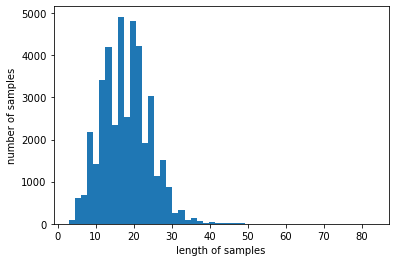

In [5]:
import matplotlib.pyplot as plt

print('문장의 최대 길이 : %d' % max(len(sample) for sample in encoded_sentences))
print('문장의 평균 길이 : %f' % (sum(map(len, encoded_sentences))/len(encoded_sentences)))
plt.hist([len(sample) for sample in encoded_sentences], bins=50)
plt.xlabel('length of samples')
plt.ylabel('number of samples')
plt.show()

### 정답 데이터 전처리

In [6]:
list_BigT = []
list_SmallT = []
print("데이터 개수 : {}\n" .format(len(raw_target_category)))

# 싫음 카테고리로 변환 및 리스트로 저장

for word in raw_target_category:
    word = word.replace(" " , "")
    if word=='불안' or word=='분노' or word=='슬픔' or word=='상처' or word=='당황':
        word = word.replace(word, '싫음')
        
    list_BigT.append(word)
    
print(len(list_BigT))

# 정수 인코딩
from tensorflow.keras.preprocessing.text import Tokenizer

tokenizer = Tokenizer()
# tokenizer.fit_on_texts(list_BigT)
# print(tokenizer.word_index)
# print(tokenizer.word_index['불안'])
### 7개로 인코딩 된 것을 6개로 바꿈
tokenizer.word_index['싫음'] = 0
tokenizer.word_index['기쁨'] = 1
print(tokenizer.word_index)

encoded_BigT = []
for word in list_BigT:
    encoded_BigT.append(tokenizer.word_index[word])
    
print(f"인코딩 결과 : {encoded_BigT}\n")  # 토큰화한 문장들을 정수 인코딩

데이터 개수 : 40879

40879
{'싫음': 0, '기쁨': 1}
인코딩 결과 : [1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0

In [7]:
# 원핫인코딩

from tensorflow.keras.utils import to_categorical

onehot_BigT = to_categorical(encoded_BigT)
print(onehot_BigT)
print(len(onehot_BigT))
print(len(onehot_BigT[0]))

[[0. 1.]
 [1. 0.]
 [1. 0.]
 ...
 [1. 0.]
 [0. 1.]
 [1. 0.]]
40879
2


# OOV 방지를 위해 FastText 이용

FastText는 단어 사전에 없는 단어도 유사한 단어와 비교를 통해 유사도 벡터를 추출할 수 있다. 이 점을 이용해서 OOV를 처리해보자.

In [8]:
from gensim.models import FastText


# size = 워드 벡터의 특징 값. 즉, 임베딩 된 벡터의 차원.
# window = 컨텍스트 윈도우 크기
# min_count = 단어 최소 빈도 수 제한 (빈도가 적은 단어들은 학습하지 않는다.)
# workers = 학습을 위한 프로세스 수
# sg = 0은 CBOW, 1은 Skip-gram.

model_FT = FastText(tokenized_sentences, window=5, min_count=0, workers=4, sg=1)
model_FT.vector_size=100

In [9]:
model_result1 = model_FT.wv.most_similar("현미밥")
print(model_result1)

[('현미', 0.9594131112098694), ('부쳐져', 0.9546623229980469), ('사도', 0.9530240893363953), ('일절', 0.9522511959075928), ('뜯어낼', 0.9518554210662842), ('덤벙대', 0.9512796401977539), ('이랬', 0.9510113000869751), ('머신', 0.9497647881507874), ('휘감', 0.9492982625961304), ('머뭇거렸', 0.9490904211997986)]


In [10]:
print(vocab)

{'아내': 1726, '가': 20130, '드디어': 315, '출산': 223, '하': 15036, '게': 5519, '되': 2627, '어서': 2566, '정말': 1887, '신': 264, '이': 27837, '나': 12823, '.': 49180, '당뇨': 181, '랑': 1011, '합병증': 46, '때문': 1704, '에': 13035, '먹': 1023, '어야': 194, '할': 1836, '약': 215, '열': 138, '가지': 206, '넘어가': 24, '니까': 593, '스트레스': 632, '야': 4245, '고등학교': 109, '올라오': 11, '니': 1535, '중학교': 31, '때': 1381, '보다': 770, '수업': 101, '갑자기': 688, '어려워져서': 20, '당황': 1069, '스러워': 1747, '재취업': 24, '돼서': 380, '받': 2665, '된': 537, '첫': 95, '월급': 116, '으로': 2163, '온': 186, '가족': 951, '외식': 42, '을': 16959, '예정': 34, '너무': 7989, '행복': 259, '해': 6818, '빚': 108, '다': 2493, '갚': 154, '이제야': 47, '안도감': 19, '들': 9187, '어': 19661, '이제': 955, '곧': 248, '은퇴': 747, '시기': 64, '었': 3497, '내': 8084, '먼저': 193, '를': 10439, '고': 11341, '육': 90, '개월': 43, '후': 467, '남편': 1577, '도': 6562, '그러면': 10, '둘': 149, '하루': 146, '종일': 55, '함께': 263, '있': 6320, '겠': 1975, '네': 2783, '생각': 1607, '만': 2864, '해도': 409, '숨': 42, '막혀': 9, '사': 783, '십': 448, '대': 

In [11]:
print(vocab_sorted)

[('.', 49180), ('이', 27837), ('가', 20130), ('어', 19661), ('을', 16959), ('하', 15036), ('는', 14404), ('에', 13035), ('나', 12823), ('고', 11341), ('를', 10439), ('들', 9187), ('는데', 8826), ('내', 8084), ('너무', 7989), ('친구', 7442), ('아', 7017), ('해', 6818), ('도', 6562), ('있', 6320), ('했', 5865), ('지', 5850), ('은', 5844), ('게', 5519), ('것', 4814), ('같', 4543), ('에서', 4264), ('야', 4245), ('없', 3838), ('한', 3600), ('안', 3508), ('었', 3497), ('좋', 3377), ('않', 3229), ('해서', 3113), ('일', 2947), ('만', 2864), ('네', 2783), ('받', 2665), ('되', 2627), ('어서', 2566), ('다', 2493), ('았', 2484), ('사람', 2463), ('에게', 2435), ('보', 2343), ('회사', 2276), ('아서', 2260), ('오늘', 2246), ('요즘', 2208), ('기', 2207), ('말', 2193), ('로', 2189), ('으로', 2163), ('님', 2098), ('의', 2080), ('겠', 1975), ('던', 1928), ('돈', 1902), ('정말', 1887), ('다고', 1849), ('할', 1836), ('거', 1825), ('면', 1818), ('잘', 1816), ('걱정', 1791), ('못', 1766), ('스러워', 1747), ('주', 1739), ('싶', 1737), ('아내', 1726), ('때문', 1704), ('수', 1660), ('건강', 1656), ('한테'

In [12]:
print(word_to_index)

{'.': 1, '이': 2, '가': 3, '어': 4, '을': 5, '하': 6, '는': 7, '에': 8, '나': 9, '고': 10, '를': 11, '들': 12, '는데': 13, '내': 14, '너무': 15, '친구': 16, '아': 17, '해': 18, '도': 19, '있': 20, '했': 21, '지': 22, '은': 23, '게': 24, '것': 25, '같': 26, '에서': 27, '야': 28, '없': 29, '한': 30, '안': 31, '었': 32, '좋': 33, '않': 34, '해서': 35, '일': 36, '만': 37, '네': 38, '받': 39, '되': 40, '어서': 41, '다': 42, '았': 43, '사람': 44, '에게': 45, '보': 46, '회사': 47, '아서': 48, '오늘': 49, '요즘': 50, '기': 51, '말': 52, '로': 53, '으로': 54, '님': 55, '의': 56, '겠': 57, '던': 58, '돈': 59, '정말': 60, '다고': 61, '할': 62, '거': 63, '면': 64, '잘': 65, '걱정': 66, '못': 67, '스러워': 68, '주': 69, '싶': 70, '아내': 71, '때문': 72, '수': 73, '건강': 74, '한테': 75, '생각': 76, '?': 77, '남편': 78, '우리': 79, '이번': 80, '힘들': 81, '니': 82, '과': 83, '결혼': 84, '때': 85, '라고': 86, '많이': 87, '집': 88, '서': 89, '직장': 90, '기분': 91, '마음': 92, '돼': 93, '!': 94, '학교': 95, '아들': 96, '와': 97, '많': 98, '적': 99, '모르': 100, '봐': 101, '엄마': 102, '당황': 103, '준비': 104, '해야': 105, '슬퍼': 106, '먹': 1

In [13]:
embedding_vec = model_FT.wv.vectors
print(embedding_vec)
print(len(embedding_vec))

[[-1.74499199e-01  1.17021784e-01 -1.22411378e-01 ... -1.07141845e-01
   5.99170551e-02  1.17890760e-01]
 [-1.93062127e-01  1.79254591e-01  5.52647635e-02 ... -1.61156282e-01
  -1.61136106e-01  3.37802649e-01]
 [-2.14170545e-01  1.47731509e-04 -6.84001669e-02 ... -4.75132316e-02
  -8.96371305e-02 -7.11808652e-02]
 ...
 [-1.28601924e-01  1.26723737e-01  1.10400386e-01 ... -1.55595452e-01
   2.08683480e-02  4.13392000e-02]
 [-9.16077271e-02  9.55314785e-02  6.75255731e-02 ... -1.98338240e-01
  -3.69673632e-02  5.33377789e-02]
 [-1.70631513e-01  9.67331007e-02  5.13124168e-02 ... -1.84010983e-01
  -7.66768903e-02  3.27112265e-02]]
12415


In [14]:
import numpy as np

embedding_dim = 100
embedding_matrix = np.zeros((vocab_size, embedding_dim))
print('임베딩 테이블의 크기(shape) :',np.shape(embedding_matrix))

for word, i in word_to_index.items():
    embedding_vector = model_FT.wv[word]
    print(i, word, end=" ")
    print(embedding_vector)
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector
        
print(embedding_matrix)

임베딩 테이블의 크기(shape) : (12416, 100)
1 . [-0.1744992   0.11702178 -0.12241138  0.01722148 -0.19339333 -0.06271788
  0.0273437   0.39140454 -0.10484897 -0.07921884  0.11885804 -0.27741978
  0.04151271  0.24801049  0.2238065   0.13658434  0.03104257 -0.04995428
 -0.09584544 -0.17198637  0.06221879  0.13281918  0.24488762  0.02026361
  0.30652535  0.17425436 -0.00692314  0.06259281 -0.2978615  -0.08678161
  0.21192434 -0.18949051  0.32308462 -0.29515582  0.04766133  0.07576851
  0.22969858  0.1958321   0.20301904 -0.10460627  0.09052233  0.16786869
 -0.3327048   0.15865573 -0.02867225 -0.05299541 -0.24506316  0.16458462
  0.02242955  0.12876315  0.0775002   0.13165632 -0.05767017  0.0547048
  0.04158806  0.02900979  0.22753355  0.22195879 -0.13977346  0.23298006
 -0.20566265 -0.00993665  0.05105885  0.03729411  0.12822735  0.00956252
  0.07355804  0.03419007 -0.14644615 -0.05458143 -0.16662152  0.10516888
  0.13608159 -0.15186131  0.10064326 -0.1957702  -0.00530801 -0.037955
 -0.00484595 -0.

  0.17392415 -0.34709322 -0.35182336 -0.0971429 ]
44 사람 [ 0.17352362  0.22141647 -0.17365202  0.2890193   0.30622953 -0.04663275
  0.52175844  0.28036633 -0.53210795 -0.34093136  0.15622592 -0.20847267
  0.34205607  0.46024016  0.43372685 -0.01530162 -0.03608688  0.17247745
 -0.27006868 -0.4984772  -0.03068199  0.00777381  0.11113651  0.29013428
  0.13256656  0.05590714 -0.14427136 -0.39748776 -0.02577218 -0.2163471
  0.4955135   0.01868216  0.385832   -0.37810072 -0.5032231   0.18480566
  0.3187259  -0.19822636  0.21406572  0.3378892  -0.20649312 -0.25524035
  0.2151234   0.14993747 -0.33153382 -0.15251842  0.33204883  0.48756683
  0.0742217  -0.06773515  0.08976181  0.08148739 -0.2306276   0.24169792
 -0.4109232  -0.270221    0.33900583  0.24773204 -0.19211033  0.2423028
  0.10557076 -0.19613612  0.296834   -0.15255366 -0.08402617  0.37295032
 -0.12634985  0.03645982 -0.67721075 -0.04799119  0.02177993 -0.12084448
  0.4136712   0.03055938 -0.03298913 -0.17783181 -0.07221846 -0.208082

55 님 [-0.2633217  -0.08117816  0.12672433  0.2888187  -0.446324   -0.0883871
  0.19251014  0.43082294 -0.18458213 -0.18181573 -0.03108765 -0.33709466
  0.02071282  0.13571173  0.14943066 -0.24098627  0.06730438 -0.26305768
 -0.32629755 -0.16967855  0.3057249   0.07461356 -0.03011993 -0.04077238
  0.06239789  0.0274265   0.04745065 -0.08059595 -0.2337201  -0.5467855
 -0.29031447 -0.07479832  0.08791483  0.15327755  0.20999147 -0.3224235
 -0.01037349 -0.08685801 -0.02331659 -0.07714734  0.41681772 -0.18967374
 -0.4570908  -0.13226713 -0.12513395 -0.29862797  0.09762122  0.11943904
 -0.04888423 -0.26051247  0.07850945 -0.3992403   0.04501472  0.06511628
 -0.1349325   0.11970869  0.15424974 -0.19287851  0.09465378  0.11057222
 -0.02601172  0.1424905  -0.3818127  -0.03473153 -0.22623506  0.25412303
 -0.06619338 -0.19518843 -0.1097296   0.21350949  0.4490703   0.2272198
  0.16047986  0.2648007   0.17457849 -0.03162478  0.4833262  -0.49100444
 -0.12599374 -0.02744002 -0.14084193 -0.03846468 -

64 면 [-1.19711809e-01  7.01687694e-01 -4.89011467e-01 -4.85326275e-02
  5.04452139e-02  3.02664824e-02  1.33924305e-01  3.07795465e-01
  7.95759633e-02  7.88078904e-02 -4.72076423e-02 -2.32323810e-01
 -1.87560007e-01  3.41638088e-01  1.78785529e-02 -8.99009779e-02
  6.37621284e-02  1.44914016e-02  1.84718654e-01 -6.29954219e-01
  6.97407499e-02 -8.12756829e-04 -1.65536553e-01 -2.03027979e-01
 -8.87979288e-04  2.01243401e-01 -5.64663783e-02 -7.33517436e-03
 -7.90532082e-02 -2.55966902e-01  1.52194485e-01 -9.04224142e-02
 -5.21078855e-02 -2.54447132e-01 -6.53186813e-04 -1.87049150e-01
 -9.39973593e-02  6.43854588e-02  1.21815354e-01  5.07310368e-02
  2.80104876e-02 -1.82456240e-01 -2.58890569e-01  7.48354867e-02
  2.55042642e-01 -6.01493865e-02 -2.51973540e-01  8.37485958e-03
  5.59914708e-02  6.46348372e-02 -1.64656788e-01 -2.88695186e-01
  3.27343568e-02  1.83680087e-01 -2.64655739e-01 -2.93240286e-02
  1.94889888e-01  2.14201445e-03 -6.36008531e-02  3.16984147e-01
 -1.98389679e-01 -7.

 -0.01148059 -0.22420382  0.05447364  0.07639974]
70 싶 [ 6.67787567e-02  2.01576613e-02  5.11330590e-02 -8.03938955e-02
 -4.25601780e-01  1.63337260e-01  1.54536024e-01  4.79503155e-01
 -3.11165094e-01 -1.26704544e-01 -1.02524810e-01 -1.45884063e-02
 -1.00517794e-01 -3.46870631e-01 -6.49951585e-03  3.95263033e-03
  3.27493325e-02 -8.71070661e-05 -3.20457906e-01 -7.66351581e-01
  1.22044019e-01  2.66250789e-01  2.27718130e-02  3.85527313e-03
  3.15759271e-01  1.72170728e-01 -1.70989230e-01  2.37606049e-01
  2.00345621e-01  3.23072463e-01  3.87286782e-01 -1.18628956e-01
  2.84431595e-02  1.16086034e-02 -6.30417466e-02 -1.11876458e-01
  2.21338719e-01  4.23378378e-01 -4.97492179e-02  2.10763857e-01
 -1.15253791e-01 -3.50909270e-02 -8.17054231e-03 -1.65791392e-01
 -7.56014287e-02 -3.56200896e-02 -2.41499975e-01  4.84697133e-01
 -5.85058868e-01  1.21849164e-01 -1.31031364e-01 -2.72369385e-01
  2.56813347e-01 -1.57111496e-01 -6.85508773e-02 -1.48754314e-01
 -1.46228739e-03 -7.39236325e-02 -4

  4.01584804e-01 -7.39016056e-01  1.20540299e-01  5.71287036e-01]
116 짜증 [-0.17542467  0.44241765  0.11772209  0.5202631  -0.29130694 -0.2640385
  0.52594686  1.0150713  -0.03960078 -0.12039134  0.31335777 -0.5759673
  0.73576134  0.0374528  -0.07501683 -0.41013575  0.02550247  0.07875881
 -0.02391431 -0.37216553  0.15727866 -0.11426404  0.37688366 -0.41679615
  0.28078106  0.28736347 -0.25082254  0.02958671 -0.45480865 -0.12659734
 -0.11410546 -0.16904987  0.22310084 -0.17847289 -0.08646397  0.34659657
  0.06266351  0.09003963 -0.08305125  0.01845573  0.13603015  0.40913355
 -0.21152438 -0.02728638  0.12125222  0.00661935  0.00466457  0.30058432
 -0.31018853  0.39177072  0.34450972 -0.26239008 -0.25252134 -0.15751922
  0.04438766 -0.141605    0.15776601  0.35539484 -0.4671697   0.31629068
  0.1789545  -0.22402827  0.20379145 -0.06045952 -0.00280429  0.18382496
  0.09801424  0.6178452  -0.37303793  0.5154836   0.2873299  -0.38331085
  0.14099051  0.03417664  0.26823002 -0.2952053   0.0

 -0.06090251 -0.05411676  0.1599984  -0.12914415]
129 걸 [-4.35982347e-01  1.17565669e-01 -2.26930846e-02 -5.24013937e-02
  1.47773132e-01 -9.62707177e-02  3.65831345e-01  2.60842860e-01
 -6.57463446e-02  8.39691460e-02  1.54920220e-01 -3.59973937e-01
 -1.65124182e-02  6.72511384e-02  4.44674581e-01 -8.70137438e-02
 -1.57730818e-01  2.40275040e-01  4.72735241e-02 -3.44740480e-01
  1.51286602e-01 -3.43719870e-02  4.29174490e-02  1.74950749e-01
  4.10097912e-02 -1.59761563e-01  8.23573321e-02 -1.74771801e-01
 -5.96064925e-02 -4.19948548e-01  3.30290705e-01  6.85261264e-02
  2.73523718e-01  2.15648353e-01 -1.21467216e-02 -2.75305986e-01
  3.38455975e-01 -3.42320688e-02  3.20469379e-01  3.46676886e-01
  3.04889487e-04 -1.78111158e-02 -2.14787304e-01  1.18950576e-01
  2.40857959e-01  1.03169261e-03 -2.00468495e-01  2.58040965e-01
 -2.97049224e-01  3.32970619e-01  1.75340831e-01  2.72492588e-01
  2.05354869e-01  1.36928275e-01  1.06468856e-01 -1.94059253e-01
 -2.57162869e-01  2.16797829e-01  

  0.31963876 -0.19580774  0.21150641 -0.15784903]
143 지금 [-0.33941072 -0.08213902 -0.21563186  0.19456689 -0.064623   -0.23834468
  0.25967115  0.58858263 -0.1940631   0.23592009  0.23936063 -0.6499035
  0.46948212 -0.04424637  0.37685242  0.27552563  0.26464635  0.11047576
 -0.21114817 -0.5009985  -0.01314795 -0.15857229  0.06115045 -0.34527144
  0.19913284 -0.07950437 -0.12676735 -0.04972592 -0.31665668 -0.03500187
  0.6563511  -0.13556485  0.0976133  -0.23753047  0.13523155 -0.28439373
  0.24288274  0.10573652  0.09643817  0.3355719  -0.33893707  0.03728428
 -0.42853284 -0.26579276 -0.15649247 -0.5398081   0.1636419   0.06724029
 -0.23019996 -0.08387287 -0.0273314  -0.10761733  0.2671038  -0.13346803
 -0.05025751  0.01396213  0.10061461  0.1383366   0.08885826  0.5629765
 -0.17327051 -0.04163031 -0.0270463  -0.19664186 -0.23109445  0.22043638
 -0.04774993  0.23523602 -0.10679418 -0.3225487   0.20387393 -0.06855574
  0.3415218  -0.12575346  0.16961646 -0.1312391   0.1219414  -0.51046

  3.2250959e-01 -5.4469243e-02 -3.8224317e-02 -2.7571267e-01]
153 몸 [ 0.03795113  0.2429314  -0.22909237  0.0883908   0.16472432 -0.05747383
 -0.01002558  0.32937017 -0.36075202  0.05484064  0.00458589 -0.04908901
  0.05662202  0.15077598 -0.12442411 -0.0356946  -0.10768398  0.32588425
 -0.3331087  -0.23792791  0.35693088  0.16536695  0.07254064 -0.27269918
  0.16545849 -0.2624132  -0.1985599   0.1531454   0.01550058 -0.16310367
  0.579676   -0.15010488  0.24727964 -0.18100004 -0.08611664 -0.01048334
 -0.19300379 -0.39306894  0.25845078 -0.09497631 -0.28533947 -0.0241493
 -0.23442155 -0.02267013  0.0408491   0.00733399 -0.19327205 -0.246418
  0.14107738  0.21987183 -0.01768198 -0.28509817 -0.23526464  0.13019885
  0.12186341 -0.11308729  0.0082369   0.1092626  -0.01713419  0.37766987
  0.02296065  0.15787958 -0.22773132  0.17390607 -0.14455251  0.2400571
 -0.09781644  0.12322327 -0.04038207  0.15899485  0.09242433 -0.38808337
  0.224894    0.3554642  -0.09112256  0.06692387  0.02461277

  0.63667977 -0.4003193  -0.21777585 -0.13963464]
195 년 [-0.35591114  0.11620352 -0.05574115  0.08298106  0.02087777 -0.17859408
  0.00605612  0.42998743 -0.63123375 -0.20931394  0.292279    0.0644948
  0.00356452  0.00289319 -0.02899882 -0.25030828  0.45536703 -0.5405863
 -0.09869926 -0.27425128 -0.2590988  -0.25714344  0.18599501 -0.08982325
 -0.0503892   0.22284004 -0.07845873  0.44127205 -0.30355483  0.11748782
  0.3669964   0.16386315  0.01190314  0.3837591   0.09680641 -0.03996308
  0.04172053 -0.06089056  0.0559007   0.04116511 -0.21276566  0.1092343
 -0.2582414   0.20360452 -0.03638642 -0.03685028 -0.18215793 -0.08446095
 -0.20965366 -0.1788781  -0.39754498 -0.19195011  0.28435794 -0.08238715
 -0.17816074 -0.3923327   0.10497838  0.16903149  0.25240475  0.44288468
 -0.13357681  0.14596426 -0.20069802  0.04372466 -0.45759293  0.30949697
  0.00503276  0.01567314  0.08435529  0.2792144  -0.38904047  0.06367528
  0.01245401 -0.1797828   0.12037911  0.2973532  -0.11233581 -0.5677805

  0.3885175  -0.63954437 -0.00144822  0.38817164]
211 동료 [-0.1505417   0.23892576  0.0621659   0.30565047  0.17234349  0.25200784
  0.5061986   0.23154896 -0.74669147 -0.17209187  0.34953573 -0.4112128
  0.30779183  0.34906214  0.16596147  0.22163951 -0.00216942 -0.09285859
  0.14767829 -0.3418939   0.05824511  0.02685119  0.03238932  0.08795005
  0.29227853  0.13514088 -0.4430991   0.05355194 -0.35762584 -0.19054756
 -0.16601852  0.06001823  0.45449144 -0.22437209 -0.00165421  0.5626138
  0.28448996 -0.10668763 -0.28854537  0.39631635 -0.03101679 -0.22831732
 -0.2212207  -0.10892891 -0.1468643  -0.32663834 -0.00272908  0.48628545
 -0.3095733  -0.17098278 -0.0637842  -0.19316906 -0.00534044  0.3098696
  0.03959746 -0.10162184 -0.07634971  0.4829879  -0.4936731   0.4141652
  0.3704153  -0.08169529  0.46001798 -0.03359309 -0.04159499  0.03509069
 -0.11637198  0.3196254   0.02280797  0.23697402 -0.04799996 -0.01845408
  0.48276109  0.32711497 -0.13797364  0.3866875   0.13423353 -0.3096426

  0.18438496  0.20158151 -0.27034497  0.07030285]
221 해도 [-0.27120784 -0.01540523 -0.05069929  0.28954613  0.07679429 -0.01155363
  0.1226908   0.83011425  0.05606673 -0.08870073  0.12184718 -0.20051119
 -0.44085678  0.44326174 -0.06387048 -0.18008322  0.24455518  0.06238197
  0.15097496 -0.6082729  -0.0639535  -0.43440464  0.38711107 -0.15117367
 -0.02955516  0.33231577 -0.48995054 -0.36620516 -0.25454494  0.08768108
  0.34121144 -0.0286648  -0.30134547 -0.33833227  0.14206493 -0.21624652
 -0.35315114  0.09020961  0.38878527  0.20930725  0.191135   -0.38144967
 -0.32402822  0.27035394  0.04261515 -0.67306685 -0.38090107  0.01557663
 -0.11838742  0.1545052  -0.2883113  -0.21937579 -0.13740174 -0.02050582
 -0.37532407 -0.15546057  0.47454548 -0.03512072 -0.29746598  0.21319039
 -0.11773302  0.01698103  0.17783672  0.08516204 -0.3019186   0.54376125
  0.10219331  0.14693817 -0.288105    0.30271757 -0.16213605  0.0257493
  0.17710884  0.32264614 -0.02127861 -0.72740734  0.1876452  -0.1997

  0.10598245 -1.0656176  -0.42738652 -0.44000188]
231 아니 [ 0.1463719   0.49440366 -0.3015594   0.28154093 -0.20420307 -0.2846862
  0.14820546  0.44992942 -0.38237643  0.11773936  0.10408942 -0.38414276
  0.30598167  0.3372066  -0.04734141 -0.36861682 -0.23871331 -0.30842447
 -0.16105227 -0.0102612  -0.00117756  0.34772733  0.40421355  0.0480059
  0.11483734 -0.30380273 -0.29646304 -0.12428038  0.02689249  0.03478292
  0.6588879  -0.00879836  0.12431204 -0.01672662  0.32679164 -0.01512771
  0.18294398  0.493501    0.56624365 -0.24037105 -0.29224387 -0.21263702
 -0.6515895  -0.4031896  -0.10473982  0.253457   -0.18853235  0.23911111
 -0.1463212  -0.10467268 -0.2958638  -0.16682218 -0.22866496 -0.27209118
 -0.42405212 -0.03214147  0.28759408  0.03539373  0.04567328  0.20257851
  0.12214429 -0.20660901 -0.4080684  -0.32073987  0.2774374   0.3593774
  0.16534092 -0.2594795  -0.2159845   0.31723008 -0.30539387 -0.03416376
 -0.15568864  0.47456253 -0.20403567 -0.25397876  0.02022571 -0.645513

  0.11351594  0.17782587 -0.15180622 -0.13101667]
284 괴로워 [-0.5808183   0.28092006  0.05320448  0.12391613 -0.12552892 -0.17905678
  0.34427592  0.6267355  -0.5652525  -0.12866578  0.27448505 -0.51347816
  0.52551305  0.15434338 -0.23391877 -0.12732872  0.53235656  0.2778612
 -0.05958552 -0.74772996 -0.08166762  0.4064493   0.24279228 -0.51790816
  0.23203254  0.3275971   0.00291619  0.08365355 -0.15367423 -0.07971401
  0.53604954 -0.10631794  0.23245832 -0.05441508 -0.26693514 -0.21055958
  0.58077365 -0.03918963  0.10326825  0.00855836  0.5213395   0.06858905
 -0.28137356  0.13094202  0.1733037  -0.17682932  0.14590466  0.26952785
 -0.07867908  0.47402915  0.15359281 -0.31787506  0.10983369 -0.1371912
 -0.25293705  0.22887854  0.0856944   0.46597248 -0.32553363  0.35749814
  0.22441255 -0.08991649  0.0842305   0.01930924  0.17584585  0.00962252
  0.05718106 -0.03358341 -0.36616912  0.66512394  0.09811864 -0.34837487
  0.2576871   0.22798626  0.3311767  -0.48803332  0.05684135 -0.0957

  0.13495532 -0.1782026   0.50640863 -0.49017784]
295 으니 [-0.16666551  0.08987072 -0.11983304  0.03711683  0.3715695   0.00907265
  0.41500586  0.42373592 -0.4422071  -0.13788752  0.31073663 -0.23377492
 -0.02399158  0.61878467  0.258953   -0.12703553  0.06494035 -0.0608847
 -0.02848357 -0.8486383   0.31968033 -0.23042545  0.08547638 -0.71521276
  0.2860498  -0.15713108 -0.5021818   0.08003577 -0.3132363   0.01108483
  0.6469025  -0.14901893 -0.08839563 -0.20402354  0.07472824 -0.02177633
  0.23051336 -0.2900859  -0.05381735  0.11849226 -0.43175048 -0.18136825
 -0.18523447  0.24320592  0.49680972 -0.2748415  -0.16976161  0.20856139
 -0.01078242  0.432914   -0.23170051  0.25497565 -0.18868682  0.21430455
 -0.01799677 -0.18797168  0.3508811   0.29102534 -0.27551016  0.03457947
 -0.27390093 -0.00331726  0.12403068 -0.15972756  0.007705    0.16930705
 -0.13504024 -0.1492245  -0.15998891  0.02573171 -0.01832172  0.34267247
  0.4585811   0.15912439  0.24677926 -0.22474852  0.11843773 -0.1788

  0.35932994 -0.48586115  0.31425357 -0.4154788 ]
309 이나 [-0.5762621   0.46043006  0.0179548   0.05183714 -0.05797456 -0.195963
  0.39996496  0.31269708 -0.38997486 -0.22742589  0.12950994  0.02259133
  0.08472621  0.36446828 -0.09493086 -0.11127277 -0.0221269  -0.40814868
 -0.05524029 -0.0775117  -0.06612431 -0.14146262  0.14377865 -0.17223614
  0.26841307  0.29159948 -0.36265576  0.29719558 -0.29245836  0.15907922
  0.26543233 -0.27023742 -0.34688854  0.06406651  0.15958878 -0.3137724
  0.24698986  0.0859476  -0.3064602  -0.24757256 -0.09372936  0.29446566
 -0.09231419  0.26217267 -0.07417364 -0.19691539 -0.03147626  0.246537
  0.02420707  0.07012558 -0.2698574  -0.34955227 -0.17811435 -0.32668933
 -0.19336303 -0.55458385 -0.00346772  0.5391536   0.13745882  0.49078047
 -0.12465666 -0.13678658  0.00929392  0.09690729  0.02220758  0.03325579
 -0.16634366  0.29329988 -0.370208   -0.01050023 -0.4210819  -0.02691775
  0.4164261   0.11537498 -0.07053889  0.13343568 -0.06779275 -0.15765068

  0.09832693 -0.20419908 -0.29865488 -0.20537668]
319 외로워 [-4.05724555e-01  2.42019251e-01 -7.39685744e-02  3.87738973e-01
  7.46840320e-04  9.36342329e-02  3.73960465e-01  8.44482720e-01
 -8.45785141e-01  2.98571646e-01  7.58001447e-01 -6.09807789e-01
  6.58839226e-01  7.01316953e-01 -9.75558609e-02  3.26951705e-02
  7.11651981e-01  5.89515306e-02 -2.78511018e-01 -1.07365322e+00
 -2.44606808e-01  1.98885694e-01  1.80221900e-01 -6.98346257e-01
  2.08149299e-01  1.47068813e-01  2.64291167e-01  1.57999247e-01
 -1.48247465e-01 -6.45303056e-02  7.12431788e-01 -1.88169926e-01
  7.55546009e-03 -1.12251893e-01 -4.08740729e-01  2.00519353e-01
  8.84202302e-01 -1.79078177e-01  1.77909017e-01  1.08024850e-01
  1.98420256e-01 -5.61977439e-02  1.54821709e-01  2.14227661e-01
 -5.85045572e-03 -2.78641552e-01  1.29456162e-01  5.43108404e-01
 -1.72505602e-01  4.28581893e-01 -8.41055736e-02 -4.04732972e-01
  9.58503261e-02 -2.20013112e-01 -2.12970123e-01 -1.93699077e-01
  5.72030433e-02  7.43148744e-01

  0.49386704 -0.5452006   0.2644427   0.00732211]
359 입원 [-0.1168447   0.10050482 -0.33912838 -0.26306313  0.16035809  0.2281725
  0.07169805  0.16673195 -0.98098123  0.14912301  0.3340202  -0.09862007
  0.10143615  0.07852852  0.31770378 -0.23228954  0.08913116 -0.18014513
 -0.13774641 -0.45643693 -0.02358515 -0.08824216  0.14515583 -0.20476973
  0.4675855  -0.4729504  -0.05396438  0.45246148  0.02284792 -0.3591542
  0.52323604 -0.12643307  0.39287797 -0.24299717 -0.18150079 -0.08031743
 -0.12405302 -0.17235035  0.4403248  -0.03144796 -0.23425809 -0.04817728
 -0.27520964 -0.30409452  0.6134435  -0.13665411  0.32923517 -0.17964335
  0.27703455  0.03969072 -0.04552855 -0.3285861  -0.15054494  0.13103348
 -0.00640884  0.36687717  0.1473891   0.4388937  -0.4432839   0.3744829
  0.33585212  0.4134031  -0.08927094  0.07399245 -0.46951902  0.29522067
  0.3947005  -0.1654233  -0.01212829  0.03916865 -0.15335324 -0.15396586
  0.24623121  0.19629356  0.34741879 -0.00229436  0.20193788 -0.345115

 -0.14822605 -0.22355253  0.16524099  0.14431266]
377 김 [ 2.45388802e-02 -1.53285973e-02  7.34162480e-02  1.64065748e-01
 -1.23730851e-02  2.84808159e-01  4.56099600e-01  2.22039044e-01
 -3.10121059e-01  2.79060543e-01  1.84740573e-01 -2.84942269e-01
  6.53012991e-02 -4.33168560e-02  1.56609312e-01 -2.76392698e-01
 -1.85060725e-01  1.25474736e-01  1.68031931e-01 -2.07726315e-01
  3.57129395e-01 -2.71979511e-01  1.04000144e-01  6.58201575e-02
  1.76731974e-01  3.81270275e-02 -2.30706304e-01 -3.14868875e-02
 -1.25729263e-01 -8.02032501e-02  1.04519576e-01 -6.60899803e-02
  2.28783578e-01  5.61599433e-02  6.82742670e-02  1.96176514e-01
  2.48606671e-02 -2.21831035e-02 -1.76169686e-02  8.42047331e-04
  6.86966926e-02  3.00333835e-02 -2.29170412e-01 -3.58950049e-01
  3.56402636e-01 -3.00968558e-01  2.80843973e-01  2.78803170e-01
  2.03961015e-01 -4.27161008e-01  2.39598025e-02 -4.78072822e-01
 -2.21965432e-01  3.22698414e-01 -1.09133668e-01 -1.22981831e-01
  3.63138944e-01  2.79858828e-01 -

  0.2077519  -0.43242902  0.12722741  0.10391247]
392 나오 [-0.60707974  0.1366928  -0.02026884 -0.03759744  0.10482471 -0.07763688
  0.02563258  0.1680802  -0.34752727  0.01392648  0.3314796  -0.20773402
 -0.249812    0.4397529   0.00298661 -0.2027006  -0.05018921 -0.3938722
 -0.14819051 -0.31519198  0.07273835  0.08339192  0.37335944 -0.3183648
 -0.44905877  0.22258374 -0.0620238  -0.0538705   0.19813137  0.18153585
  0.45465276 -0.2129826   0.4891742  -0.11599417 -0.07764588 -0.05302606
 -0.27704197  0.50123334  0.32492727  0.11216643 -0.09874268 -0.12887745
 -0.7113489   0.09433448  0.10749678 -0.6751943  -0.16898765  0.0417119
 -0.10728254  0.1087383  -0.33524495 -0.12229581  0.0851084   0.15950978
 -0.3846507  -0.07511151 -0.1414662   0.03787005 -0.31870925  0.3063711
 -0.18061808 -0.03620587 -0.09603523  0.35751712 -0.01073049  0.28575438
  0.38288024  0.29389566 -0.00965507  0.09460917  0.19226258 -0.30685657
  0.32582784  0.39601225  0.07033208 -0.26183915 -0.00189668 -0.0950986

 -0.14569691 -0.07272553  0.11345759 -0.05881399]
400 아파서 [-4.23759073e-01  3.29894781e-01 -3.69451493e-01 -1.36275157e-01
  5.06478012e-01 -9.39299390e-02  1.00760095e-01  3.61835629e-01
 -5.64376950e-01  1.40188411e-01  2.73906197e-02 -2.81945616e-01
  1.82440162e-01 -1.00164101e-01  4.32846934e-01  1.76577438e-02
  1.67297572e-01  1.80648804e-01 -1.02784835e-01 -3.56267452e-01
  4.45293278e-01 -2.17567489e-01  1.30366012e-01 -5.24317086e-01
  4.78338093e-01 -6.75148964e-02 -3.46162289e-01  6.13205731e-01
  2.09490910e-01  1.18519723e-01  3.49636734e-01 -1.07986018e-01
  2.25831553e-01 -1.05713770e-01 -2.30015188e-01  2.63209969e-01
 -2.16214672e-01 -1.48751333e-01 -2.01285519e-02  1.86337247e-01
 -1.83158025e-01  1.32033825e-01 -3.72783810e-01  1.86134800e-01
  6.82047725e-01  1.63345829e-01 -2.61377729e-02  1.48490325e-01
  1.87388495e-01  2.11704448e-01 -1.48407459e-01 -6.82089269e-01
 -3.72907966e-01  1.59829780e-01  1.44127384e-01  6.49495865e-04
  2.43439749e-01  8.17559958e-02

  2.37736925e-01 -5.68445772e-04 -2.08000541e-01 -2.06420779e-01]
446 출근 [ 0.15718794  0.35125986  0.34664917  0.03562152 -0.12949087  0.3858103
  0.25047588  0.45793903 -0.5087027  -0.04153384  0.36552066 -0.630151
  0.14477488  0.07155724 -0.08746792 -0.12701909  0.2969633  -0.458809
 -0.1467949  -0.01153695 -0.06731291  0.0850981   0.17795075 -0.36723763
  0.21628883 -0.28860378  0.17468582  0.41142496 -0.3048478  -0.15533939
  0.20286906 -0.14364083  0.2973201  -0.25051737 -0.24384001 -0.04819149
  0.0352076   0.54861367 -0.02116747  0.01725534  0.13310906 -0.18519524
 -0.3950229   0.13224699  0.27162135 -0.35936522  0.08304489 -0.07363542
 -0.15482487  0.07332915  0.16284363 -0.45622456 -0.24160868 -0.1967659
  0.10619996 -0.02285123  0.3000103   0.0383986  -0.24069433  0.17895085
 -0.537836   -0.1316292   0.11042873 -0.15053059 -0.52802277  0.2530079
  0.09080045  0.05167777 -0.07478841  0.2450341  -0.00187416 -0.12752515
  0.7005199   0.3039475   0.02710954 -0.11056757  0.046037

  0.29083008 -0.49493134 -0.00381736 -0.10829106]
461 용돈 [-0.07199884  0.34720242  0.20948586 -0.1062739  -0.09741154 -0.38293466
  0.24631488  0.37200394 -0.38833928 -0.08265412  0.31427363 -0.31721282
 -0.22419964 -0.16990514  0.25395685 -0.41694248  0.1077204  -0.3897075
 -0.42077142 -0.52862465  0.5367143  -0.49997795 -0.22456329 -0.34865135
  0.16516885 -0.23893794 -0.21863984 -0.09345335 -0.15660796 -0.26002532
 -0.06080354 -0.29145062  0.03670001  0.03555309 -0.25484914 -0.19051464
 -0.24811926  0.22627246  0.13483599  0.13825876  0.19588809 -0.12382444
 -0.08264466  0.09187687  0.27567586 -0.18901093  0.00525488 -0.06604135
  0.31336525  0.17717803  0.31696916 -0.00844622  0.41871223 -0.03712711
 -0.33740658  0.00727474  0.02139615  0.1892352  -0.30560905  0.50140154
 -0.2436513  -0.0531052  -0.44238445 -0.16729325  0.01987191  0.3027135
  0.4466711  -0.0451557  -0.32102644  0.17150466 -0.07325812  0.03785501
  0.22947279  0.12942834  0.2199991   0.17175062 -0.38670713 -0.25984

 -0.12623999 -0.08644984 -0.29784074  0.08216579]
474 오랜만 [-1.02203250e-01  2.09532186e-01 -1.12792850e-01  2.98981249e-01
  2.19337747e-01  3.47171396e-01 -8.28780010e-02  3.51415724e-01
 -7.99598515e-01 -3.12161935e-03  3.07017505e-01 -3.51248980e-01
  5.13440728e-01 -1.62145849e-02  8.50836456e-01 -2.95596153e-01
  8.34144875e-02  1.66144118e-01 -6.44775331e-01 -7.54742503e-01
  9.94073153e-02 -1.28634796e-01  2.97157913e-01 -1.25000104e-01
  2.28398204e-01  1.37787774e-01  4.01149899e-01  4.62387800e-01
  3.12921852e-01 -4.02142733e-01  1.18044116e-01 -1.05462514e-01
 -3.62711884e-02  1.24997839e-01 -3.58370394e-01  7.34453872e-02
  2.10154504e-01  1.26342743e-03 -2.82050925e-03  6.59434378e-01
  4.73136865e-02 -6.95606694e-02  2.49299839e-01  1.36453941e-01
  8.26978609e-02 -9.36348066e-02  1.80452257e-01 -2.36466658e-04
  3.60006601e-01 -1.00555435e-01 -3.08689028e-01 -1.08170219e-01
 -9.80785713e-02  9.47227925e-02 -1.16758063e-01 -1.53882891e-01
  3.28648418e-01  2.36502543e-01

  9.15624052e-02  1.96442515e-01  1.69387817e-01 -1.38635533e-02]
484 만족 [-0.3421299   0.08532784 -0.00179271  0.13501917  0.1960436  -0.6802028
  0.07738703  0.70391494 -0.45044214 -0.31681937 -0.06891818 -0.11078757
 -0.13888536 -0.05579299  0.26208168  0.0140507   0.18061554 -0.18091547
 -0.44021162 -0.8614947  -0.35659736  0.08757962  0.32340392 -0.28237024
  0.01630369 -0.03047464  0.05051845 -0.09569883 -0.31731784  0.15608269
  0.2768373   0.35251322 -0.16452561 -0.463929    0.09911732 -0.14627059
  0.8674774   0.40346563  0.16891834  0.13013834  0.20738605  0.00489409
 -0.5508466  -0.15340242 -0.26030523 -0.6348391  -0.22098942  0.05510722
 -0.11391587  0.5762407  -0.25781113 -0.5105229   0.05356873  0.14638422
 -0.39751968  0.257841    0.15533738  0.49739832  0.01134962  0.26044917
  0.01322652  0.23070383  0.02321318 -0.14353766  0.28841406  0.28007394
 -0.05558117 -0.073586    0.30552268  0.09001258  0.06548825 -0.21839023
 -0.10884024  0.09504104  0.06014883  0.15585387  0.

 -0.16990724 -0.00455512  0.6284856  -0.05977612]
519 옆 [-0.03584342  0.06915371  0.16770823  0.02576879 -0.15470324  0.15594967
  0.30661055  0.11569543 -0.2017637   0.31402898  0.23880208 -0.3942269
 -0.270617    0.20189188  0.15231429  0.00227754 -0.18471438  0.00307996
 -0.10382585 -0.35166207  0.16077223 -0.23341888  0.07959397 -0.1221319
  0.13216951 -0.12673953  0.10719325  0.09677836  0.09579863 -0.10382875
  0.22465655 -0.20036     0.06052245 -0.04257789 -0.06449065  0.11075151
  0.05838547 -0.06954818 -0.18477161  0.03958801  0.09024718  0.08692554
 -0.03097889 -0.02816538  0.3063976  -0.10810036  0.1014343   0.09526802
 -0.14778864  0.11165054  0.15624398 -0.369463   -0.24339426  0.03743944
 -0.16076551 -0.07016186 -0.1788097   0.2119124  -0.2076917   0.0271791
  0.1940493  -0.1588356   0.15182361  0.10132449 -0.01078307  0.28247172
 -0.14830117 -0.14553112 -0.13264109  0.09391386 -0.05655804 -0.02189722
  0.08562527  0.3467308   0.09571002  0.03415877  0.23512314 -0.3503639

  0.0699797   0.10774506 -0.11579194  0.03672805]
534 주말 [ 0.07151522  0.53462994  0.27795902  0.10266244 -0.069902    0.7970615
  0.46371257  0.4430164  -0.6534232   0.10960347  0.19973604 -0.33777472
  0.1494655   0.13577864  0.4395767  -0.24974725  0.02922026 -0.29004875
 -0.30534118 -0.69514763  0.0214966  -0.41898456  0.18617141 -0.2953499
  0.19746168  0.13636589  0.15108125  0.31506655  0.0885843  -0.16067392
  0.15078728 -0.2651103  -0.21679118 -0.14144617 -0.6226402  -0.24180643
 -0.01892137  0.19604196  0.20077893  0.43666145  0.3065831  -0.10515105
  0.09288099 -0.079516    0.1381924   0.00294664  0.155945   -0.22878674
  0.13416575  0.08933397 -0.23662788 -0.50428426 -0.15219297  0.04015267
 -0.16233864 -0.00208809 -0.03902973  0.02972269 -0.2254486   0.3611505
 -0.12343816  0.08378633  0.06220078 -0.02877416 -0.22660682  0.26802686
  0.19556446  0.33236217  0.09047281  0.03567662 -0.25984156  0.10310025
  0.15068536  0.16903259  0.2878964   0.21696565 -0.31199116 -0.340818

 -0.04649518 -0.40400562 -0.22827604 -0.05192612]
549 대인 [-0.19381958  0.19206515 -0.19574556 -0.00384677  0.11650895 -0.6082108
  0.22074144  0.46682325 -0.48609105 -0.2365616  -0.00341783 -0.6777256
  0.48692423  0.47995353  0.28719503  0.49519473 -0.25329593 -0.08159196
  0.13602991 -0.70962423 -0.04135977  0.3500416   0.5545683  -0.35222697
  0.23143412  0.14720972 -0.04973288 -0.29793784 -0.4199775  -0.19858423
  0.6339054   0.15245     0.00183155 -0.2643101  -0.30486917  0.16512376
  0.5913123  -0.01725251  0.1377183  -0.38835552 -0.165813   -0.09138308
 -0.01268222 -0.23942506  0.07434399 -0.36889616 -0.3205498   0.18037629
  0.1252868   0.06858669 -0.4250552  -0.17587727 -0.24727152  0.16653349
  0.00333217  0.04938918  0.3406626  -0.22997749 -0.25517502  0.35750806
  0.3789478  -0.0439804   0.07753272  0.1255422   0.14695135  0.01746449
 -0.22392872  0.22124782 -0.3224726   0.43477112 -0.18426523 -0.56824744
  0.3277949   0.08735485  0.01616139 -0.0568613   0.2192816   0.06696

559 경제 [-2.96980739e-01  2.05974549e-01  7.83636943e-02 -3.43730045e-03
  2.24880248e-01 -2.26375073e-01  1.38689756e-01  1.89610541e-01
 -8.05450976e-01 -1.48404405e-01  9.33419317e-02 -2.64199615e-01
  5.85099980e-02 -5.22082075e-02 -4.84488904e-02  1.21681236e-01
  1.33484155e-01  8.75993371e-02 -2.74090886e-01 -6.64995432e-01
 -3.16051066e-01 -2.16005836e-02  1.32305384e-01 -7.71241903e-01
  1.85642749e-01 -2.72282124e-01 -3.79928678e-01 -1.08494282e-01
 -3.34702969e-01 -4.58923765e-02  5.42385101e-01 -1.81165546e-01
  2.09541216e-01 -1.34152636e-01 -8.59727710e-02 -5.81757948e-02
  3.47058058e-01  1.62783742e-01  2.12675512e-01  1.13040440e-01
 -2.61894137e-01 -5.15071750e-01 -2.44268104e-02 -8.32458615e-01
  1.10350244e-01 -3.10047477e-01 -1.34221539e-01 -3.68124507e-02
  6.28722534e-02 -1.26886100e-01 -1.24203257e-01  1.17259085e-01
 -4.42226268e-02 -1.68415934e-01 -4.38444972e-01  2.88005114e-01
  4.92227972e-02 -2.16393352e-01  3.06642186e-02 -1.43695623e-03
 -2.62913316e-01  

  0.20254453 -0.0393602  -0.05485632  0.13588914]
605 뭘 [-0.03690657  0.31021938 -0.23473683 -0.0739329  -0.10750511 -0.2928816
  0.32725766  0.76272184 -0.2743      0.02730072  0.15650627 -0.08031522
 -0.01165184  0.1910689   0.00643703  0.0753618   0.05505718  0.1838322
  0.05476898 -0.36863133 -0.2853245   0.0332327   0.15075074  0.3917825
  0.00256867  0.15452752 -0.24222088 -0.14076251 -0.1538286   0.01161211
  0.18393001 -0.16614154  0.34079078 -0.2358295   0.23505653  0.12141933
  0.08745439  0.06390129 -0.04088129 -0.04106212 -0.11444312  0.19855675
 -0.12149036  0.02661206  0.15456331 -0.13996744 -0.22016816 -0.12880704
 -0.11375594  0.05019875 -0.09386579 -0.20046291  0.06715843 -0.01097371
 -0.08069497 -0.03762314 -0.14349926 -0.05124121  0.11776483  0.09279814
 -0.03370875 -0.04814599 -0.0223199  -0.12264267 -0.28905812  0.09011681
  0.29920322  0.05173287 -0.35093167  0.12789235 -0.10640728  0.00250036
  0.16012375  0.31772605 -0.1031863  -0.219235    0.01410163 -0.1017459

  0.3191898  -0.02192202 -0.07324306 -0.17808291]
619 가게 [-7.67853677e-01  3.95101532e-02  2.86655009e-01 -2.84873784e-01
  8.16976428e-02  1.27545983e-01 -6.37623891e-02  1.11347325e-02
 -6.17573023e-01 -6.12533055e-02  1.22225605e-01 -5.20926774e-01
 -1.74713045e-01 -2.13185206e-01  4.56682503e-01  2.50882536e-01
  6.28132939e-01 -2.67658442e-01  1.08325675e-01 -6.56816900e-01
  1.95983440e-01 -4.43300068e-01  1.89767376e-01 -9.03182924e-02
  1.75697297e-01 -7.35791922e-02 -2.26985186e-01  5.13719283e-02
  1.21671170e-01  1.38317436e-01  2.52681732e-01  3.64072248e-02
  7.14995265e-02 -2.85974354e-01 -1.31350115e-01  7.87643790e-02
  1.79259360e-01  6.37245737e-03 -2.31913310e-02  2.68946111e-01
  3.43537964e-02  6.64677024e-02 -1.27578666e-02  1.29989507e-02
 -1.03627853e-01 -6.30292371e-02  3.25127430e-02 -5.07436544e-02
 -1.93667207e-02  1.21751525e-01 -1.51077565e-02 -1.23909719e-01
  5.33082113e-02 -5.98192625e-02  3.84030095e-03  1.44660681e-01
 -5.77675225e-03  1.85126692e-01 

  0.4756538  -0.34770185 -0.22708522 -0.04534967]
628 동네 [-0.02806686  0.14965148 -0.06090594  0.39601526  0.29101726  0.13917041
  0.17108986  0.04233669 -0.65654826  0.21679561  0.23552287 -0.22072272
 -0.04458166  0.2936952   0.5580523   0.08743017 -0.3438117   0.0794185
 -0.03553459 -0.37467292 -0.1121235  -0.5262796   0.1035451   0.11525602
  0.2722814  -0.08309415 -0.12292827 -0.25703686  0.12178852 -0.39288077
  0.43241665 -0.03379484 -0.22633682 -0.0753732  -0.10941121  0.1437123
  0.20917907 -0.2369782  -0.03594775  0.22558379 -0.03157255  0.11699645
  0.01303777 -0.17514205 -0.21898183 -0.02451688  0.25478134  0.08862153
  0.17493936 -0.33943993  0.05092585 -0.5176834  -0.15046993  0.39764166
 -0.32992193 -0.07673894  0.15316966  0.05933495 -0.15088472  0.16722946
  0.24830869 -0.00773423 -0.05834775  0.07932043 -0.10787885  0.30974185
  0.12723228  0.10480122 -0.26450294  0.3307288  -0.3235473   0.18337989
  0.0773716   0.14903432  0.32710236 -0.03143351  0.17603427 -0.33766

  4.89534624e-02 -1.28301084e-01  1.44498736e-01 -2.61492372e-01]
641 힘 [-8.65092129e-02  1.79456785e-01 -4.92685810e-02  1.22744769e-01
  1.30538508e-01 -7.72466511e-02  2.81764239e-01  2.88658202e-01
 -2.67611980e-01 -3.47227021e-03  1.42479077e-01 -5.91045842e-02
  1.00443356e-01  8.55300128e-02  4.34940830e-02 -8.17040354e-02
  2.09879920e-01 -5.75096495e-02 -1.69134155e-01 -2.44506955e-01
  2.36965850e-01 -1.25375330e-01  2.10667364e-02 -2.29499325e-01
  3.09781849e-01  3.29517899e-03 -1.35702461e-01 -4.15519997e-02
 -2.27422222e-01 -1.34884462e-01  3.35062861e-01  3.67138833e-02
 -2.54954845e-02 -2.72949159e-01 -1.28281653e-01  6.31062016e-02
  1.33723229e-01 -5.08244149e-02  3.07605378e-02 -4.64186887e-04
 -1.03438176e-01 -5.57085983e-02 -1.20575249e-01 -1.58994362e-01
 -6.50960132e-02 -1.59114599e-01 -5.20605445e-02  1.77083969e-01
 -7.53849670e-02  1.39129177e-01  1.22502826e-01 -1.75107911e-01
 -8.98163840e-02  1.19603239e-01 -4.10922430e-02 -2.24280339e-02
  1.82541519e-01  

  0.29256287 -0.2399771   0.10967832  0.03295794]
677 성 [-0.1184209   0.08578465  0.18845317  0.20301859  0.07414767 -0.15694457
  0.13739635  0.13040097 -0.190091   -0.10178049 -0.32667413 -0.2752631
  0.14779878  0.13552871  0.1331571   0.12434316 -0.5493146   0.16600026
 -0.01838632 -0.17105706  0.01760567  0.17421627  0.17552842  0.03590562
 -0.3186571  -0.1164397   0.02714029 -0.03047529 -0.11826052 -0.03187563
 -0.00922366  0.11251454  0.08501136 -0.2074489   0.07846469  0.28489536
  0.23964316  0.01505932  0.0772941   0.15679516  0.14097857 -0.21305566
 -0.04688976 -0.25774884 -0.12008198 -0.3120381   0.07454436 -0.1200188
  0.12264988 -0.02348669 -0.02456673 -0.17009676 -0.11586327 -0.0628114
 -0.09425986  0.05889647  0.21886048 -0.24560791 -0.12061939  0.14350137
  0.04623865 -0.00346999 -0.10001566  0.28434357  0.12580955  0.03395884
 -0.01681029 -0.16612586 -0.09261663  0.21085563  0.12131329 -0.10695702
 -0.12971923  0.07484397 -0.04038912 -0.00856689  0.26623034 -0.2660908

  0.36050713 -0.62418735 -0.06200686  0.03026424]
691 이후 [-2.24903837e-01 -3.04289460e-02  2.97465101e-02  2.47578584e-02
  7.02425092e-02  1.39021769e-01  2.54871398e-02  2.89889812e-01
 -7.36601949e-01 -1.05870456e-01  4.13108289e-01 -4.00375068e-01
  1.26384571e-01 -1.27087161e-03 -6.56646192e-02 -1.45460472e-01
  3.28203142e-01 -2.16911845e-02 -9.01233479e-02 -3.97494137e-01
 -8.81030113e-02 -3.31894219e-01  1.76972210e-01 -2.23352432e-01
  5.27663827e-02 -4.43825796e-02 -2.97461987e-01 -1.02760494e-01
  1.26580298e-01 -4.04290892e-02  6.11782253e-01  2.71746088e-02
  1.40646324e-02 -2.18724877e-01  2.45507061e-01  2.55481780e-01
  4.00355667e-01 -6.15958124e-05  8.40471685e-03  2.87607521e-01
 -3.15710343e-02 -1.57679901e-01 -2.88191557e-01  1.11540437e-01
  1.89035743e-01 -1.16769008e-01 -2.97135651e-01 -7.06831515e-02
 -1.48404799e-02 -2.83557177e-01 -2.42525250e-01  5.25728017e-02
 -1.25995725e-01 -1.53454378e-01  4.45712246e-02 -1.27200916e-01
  2.47386187e-01 -2.31934309e-01 

 -0.09492932 -0.3524998   0.32003438  0.10010105]
706 버려진 [ 3.43870409e-02  2.20246539e-01  2.76575297e-01  3.29551131e-01
  2.78695315e-01  2.73132652e-01  4.77675974e-01  6.83916688e-01
 -9.03411865e-01  3.38768288e-02  6.03133976e-01 -4.16963845e-01
  2.14342132e-01  9.19600308e-01  3.22661012e-01 -1.99086919e-01
  5.70134640e-01 -2.24088669e-01 -4.11436707e-01 -7.14878976e-01
 -2.91192144e-01  2.69314229e-01  3.10682565e-01 -7.66611695e-02
  6.24828458e-01 -1.16658762e-01  3.08120161e-01  2.51265883e-01
 -2.48675108e-01 -1.02372825e-01  3.44058573e-01 -4.63468373e-01
  3.54278237e-01 -1.01389058e-01 -1.60376340e-01  3.39509487e-01
  9.01568711e-01  4.65010703e-02  3.09289992e-01 -2.44907632e-01
 -1.03979759e-01 -2.64328182e-01 -1.25758737e-01  2.11070538e-01
 -4.61491436e-01 -1.46504357e-01 -2.96186119e-01  2.38362595e-01
  1.99796602e-01  3.07547618e-02 -4.48987260e-03  6.92897593e-04
 -7.15409145e-02  8.98987725e-02 -1.42138660e-01 -8.87091979e-02
  2.30645657e-01  2.58558542e-01

  0.3447551  -0.3724264   0.2938871  -0.276933  ]
721 손주 [-0.26018536  0.33231267 -0.11440923  0.17599109  0.34877694  0.16142169
  0.1060243   0.08217835 -0.4951005  -0.14331937  0.03366447 -0.06414141
  0.09645156  0.07620493  0.48622295 -0.12927884 -0.07903884 -0.33622444
 -0.34194025 -0.58448267  0.38161054 -0.36409065 -0.31562185 -0.06739078
  0.28820285  0.22168277  0.01240879 -0.0639367   0.0838885  -0.43450677
  0.02802328 -0.28941137  0.07185201 -0.07050942 -0.14279304 -0.16592795
 -0.14609013 -0.11315039  0.06002374  0.25929582 -0.00320722 -0.17371552
  0.12655905  0.21419992 -0.11735213  0.00120816  0.06275994 -0.06626114
  0.17041564 -0.01375101  0.01088964 -0.21375711 -0.04446231  0.12003236
 -0.34091893 -0.1104495   0.14688231  0.19604011 -0.10576456  0.5755459
  0.05989537  0.1536268  -0.1640012   0.179802   -0.13769053  0.34813285
  0.11613138  0.4221754  -0.24860361  0.29588258 -0.14240289 -0.03226703
  0.41761616 -0.11715574  0.12486792  0.17688811 -0.07961569 -0.2513

  0.54153705 -0.23602869 -0.18743932 -0.3177356 ]
750 근데 [-0.2888328  -0.05359827  0.02800808  0.19771504 -0.16023499 -0.15854701
  0.13420153  0.562419   -0.3653777  -0.05240635  0.16730486 -0.0144439
  0.18364705  0.08278744  0.3026701  -0.16175854  0.24493755  0.08740409
 -0.16028862 -0.39501876  0.07337937 -0.08558945  0.12833011  0.00804296
  0.3626314   0.14118415 -0.07223663 -0.01074002  0.14375034  0.00818728
  0.33859536 -0.16660957  0.20819154 -0.20761454  0.27407002 -0.12020882
  0.01260307  0.19809791  0.04393342  0.23661819 -0.26605493 -0.02699284
 -0.3696902   0.20913121  0.07802097 -0.09964797 -0.25903878  0.0183264
 -0.0888054   0.05598939 -0.01022551  0.1128341  -0.15652253  0.02035943
 -0.2224696  -0.07871598 -0.03124742  0.09694713 -0.06229214  0.13252999
 -0.18583733 -0.0391474   0.10706437 -0.07644494 -0.18740113  0.15753756
  0.18803737  0.20722476 -0.4615888   0.07640227 -0.28513604  0.1230302
  0.00637572  0.07593973 -0.00636906  0.07801046  0.31749833 -0.149506

 -1.2072207e-01 -4.2042112e-01  4.1683342e-02 -3.8064805e-01]
759 그만 [-0.32888338  0.23687634 -0.03856498  0.07819369 -0.27214488  0.00804274
  0.2571511   0.67086744 -0.4175482  -0.14008407  0.38766208 -0.27536434
  0.20110136  0.21544164  0.21379524 -0.06071081  0.00635608 -0.29654402
 -0.15233463 -0.24108997  0.14122085  0.16842091  0.34671932 -0.14121574
  0.14393187  0.00576905 -0.383967    0.26930788 -0.11287316 -0.20267108
  0.6587235  -0.24999525  0.15760396 -0.43064785 -0.15595604 -0.07273408
 -0.07571618  0.30939278 -0.07744613 -0.01707932 -0.27034777  0.20654711
 -0.14747933  0.09461567  0.0525942   0.07095239  0.12115221  0.13248955
 -0.42869067  0.06426115 -0.23506443 -0.3271829  -0.12810571 -0.21728665
 -0.19781624 -0.22564816 -0.02581464  0.27288443 -0.26242232  0.14527181
 -0.4492379  -0.18650262  0.3159109  -0.13262367 -0.36586785  0.09223811
  0.01595266  0.04560608 -0.00458314  0.39136633 -0.07810915  0.37528068
  0.23403592  0.32722723  0.02151644 -0.08397257  0.028

 -2.11404599e-02 -6.06798887e-01  4.69780453e-02  1.90672785e-01]
773 걸린 [-0.4032614   0.352931   -0.158337   -0.2376932   0.1603824   0.06090011
  0.17230724  0.17603533 -0.62442744  0.0182669  -0.17830595 -0.2921978
  0.3269494   0.08321307  0.16011736 -0.23230696 -0.28562176 -0.03528601
  0.11336488 -0.5245991  -0.19465992 -0.1589803   0.19950467 -0.33781594
  0.30387127 -0.03056332 -0.31047574  0.26331714 -0.02618507 -0.23612022
  0.40851972 -0.18687034  0.3020899  -0.04476944 -0.20852053 -0.01739813
  0.10831067 -0.11355482 -0.11453749 -0.33776733 -0.23872112  0.18013367
 -0.03597951 -0.31804305  0.51643574 -0.17536822 -0.05137747 -0.38223737
  0.3050885   0.02351126 -0.24372049 -0.09709799  0.08287282  0.07947677
 -0.08716394 -0.00909624 -0.08050601  0.1967254  -0.2644664   0.4187298
  0.17811054 -0.06898703 -0.26498932  0.0050625   0.2100594   0.23118344
  0.26742226  0.30560684 -0.33886513  0.27270856 -0.10708274 -0.06241215
 -0.5737114   0.11821127  0.3626119   0.06165279  0.1

  0.3239612  -0.46369833  0.07274564 -0.11898629]
783 무엇 [-0.47731617  0.32009107 -0.36897823  0.13570164 -0.36871293 -0.5944673
  0.47835836  0.9440644  -0.58352935 -0.01612838  0.01245827 -0.12789871
  0.10526392  0.15102598  0.16426668  0.22892004  0.02861091  0.06579032
 -0.11967536 -0.49178624 -0.19265947  0.04858693  0.09254128  0.21895172
  0.11303413  0.10342979 -0.6513527  -0.27039948 -0.27540547 -0.06587499
  0.28493983 -0.00815331  0.19506185 -0.28161505 -0.0048586   0.02792661
  0.14302483  0.19608897 -0.23648068  0.08810426 -0.2010189   0.10626737
 -0.06741338 -0.11804957  0.152154   -0.2048375  -0.17853485 -0.21686065
 -0.13782005  0.02626712 -0.03607599 -0.4140766   0.0707518  -0.13353127
 -0.2141034  -0.14082968 -0.10909243 -0.49670547  0.00707797  0.17767394
 -0.2241911   0.09226985  0.02106122 -0.50594497 -0.41498035  0.44719434
  0.12043414 -0.1286593  -0.40162563  0.1202874  -0.12705041 -0.0486341
  0.16274844  0.17235443 -0.17621808 -0.18194775 -0.04702343  0.03335

 -0.36431643  0.17898996  0.03095827  0.0573433 ]
819 혈압 [-0.11228346  0.04790495 -0.38326907  0.11783765  0.19704062 -0.33779043
 -0.02720327  0.23744917 -0.7776092   0.11464697  0.04781482  0.01422566
  0.11820742  0.02052885  0.35048237  0.02258802 -0.05888504 -0.05808447
 -0.15219773 -0.26756278  0.3220782  -0.06410779  0.26384434 -0.36370355
  0.4295563   0.02219432 -0.57471067  0.22994877 -0.07494303  0.19201638
  0.61008483  0.06184852  0.24135756 -0.06966743 -0.24653839  0.10418981
 -0.1479043  -0.04879884  0.5023407  -0.21989763 -0.27259174  0.29777688
 -0.2471174  -0.35704052  0.46202764 -0.5122161   0.12127702 -0.20768923
  0.06762926  0.23398763  0.05802768 -0.24707901 -0.17215203  0.3153032
 -0.09109427  0.2760947   0.0858929   0.39348033 -0.27514488  0.5715014
  0.17121628  0.14858916 -0.2628495   0.27081487 -0.03183575 -0.02761505
  0.07405803  0.36174712 -0.08286573  0.2765339  -0.20132916 -0.17964391
 -0.12398899  0.08649867 -0.32245088 -0.09937541  0.33293712 -0.23338

  0.31032223 -0.1933387   0.16446097 -0.02507663]
831 소개 [ 1.64101988e-01  9.16007385e-02 -7.11200684e-02  3.02341044e-01
 -2.86034822e-01 -2.33618706e-01  3.01918030e-01  4.08700615e-01
 -5.02067566e-01 -3.95323262e-02  2.89400369e-01 -4.51491982e-01
  1.08201385e-01  2.50837803e-01  5.46823502e-01 -7.60600809e-03
 -1.02464922e-01 -7.22091421e-02 -3.77085716e-01 -5.40351868e-01
  3.68679821e-01 -4.37796801e-01 -7.28316046e-03 -1.70487627e-01
  9.62258279e-02 -5.73905051e-01 -1.62518434e-02 -1.06568441e-01
 -2.94438154e-02 -1.26060665e-01  5.31514958e-02 -2.66956151e-01
  1.20353468e-01 -3.96693170e-01  1.58852369e-01 -8.27519596e-02
  1.41874805e-01 -2.27008760e-01  2.24133715e-01  4.14463598e-03
  9.71536618e-03 -4.39489745e-02 -2.82756627e-01  1.99100047e-01
  6.32302985e-02 -3.36062431e-01  1.73772678e-01  4.58040982e-02
  6.65320978e-02 -2.16210425e-01  2.44255364e-02 -2.96768267e-02
 -1.03292897e-01 -2.59846359e-01 -2.76688665e-01 -3.35239470e-02
 -1.35955274e-01  5.91980457e-01 

 -0.01988531 -0.48272255  0.01116148  0.03889653]
848 결정 [-0.45546418  0.2766176   0.17033426 -0.10120482 -0.36312342 -0.41145194
  0.1049962   0.5195668  -0.4960112  -0.46430194 -0.25061488 -0.3481691
  0.19241306  0.05038688  0.06139634  0.16940825  0.04424132 -0.18741259
 -0.3024407  -0.36591017  0.03341478  0.14110985  0.13458559  0.04747272
 -0.13512895  0.00289887 -0.09838682 -0.20812514 -0.15872449  0.00334637
 -0.08676485 -0.06973571 -0.03785033 -0.17601132  0.05390734 -0.08870611
  0.25289732  0.41432905  0.02587469  0.02641869  0.08015741 -0.20095861
 -0.26585758  0.01772832  0.11590877 -0.3969206  -0.25509733 -0.23585102
 -0.15695965 -0.1606146  -0.14896362 -0.19104467  0.08225384 -0.24909106
  0.00088412  0.17150635  0.03795816 -0.33068484 -0.07513797  0.20186722
 -0.28193417  0.10048345  0.02547305 -0.2357316  -0.15377042  0.34864527
  0.3328374  -0.123857   -0.3594528  -0.0117174   0.05580381 -0.08531313
  0.13523021  0.14767843  0.2055833  -0.28023225 -0.11592358 -0.2774

  0.0873511  -0.19482192 -0.13200852 -0.19936973]
859 어머니 [-0.48031458 -0.07496431  0.02426415 -0.14553018 -0.06003841  0.08958965
 -0.03085535  0.38728863 -0.6167864  -0.004917   -0.10051557 -0.3122824
  0.02299929 -0.09895223  0.02906659 -0.3848743  -0.12919071 -0.17372002
 -0.26778194 -0.14255783  0.47940034 -0.06533311 -0.11663232 -0.15086909
  0.39925766 -0.32479063  0.12181284 -0.05682708 -0.12858748 -0.5722049
  0.22725749 -0.26762107  0.19946882  0.2151093   0.20354645 -0.38841787
  0.0227338   0.18546472  0.02058112  0.07837253  0.37639427 -0.08391716
 -0.47167423 -0.08579513  0.17915885 -0.19975522  0.14866029 -0.24533841
  0.12535278 -0.22614418  0.1104029  -0.35635763  0.06491523  0.5389438
 -0.06618511  0.14780049  0.09196712 -0.15702966  0.00168232  0.59195244
 -0.22215523  0.28663483 -0.13676618 -0.15002532  0.05821875 -0.19762112
  0.18761127  0.19030163 -0.31811336  0.45686862  0.24200812  0.01650156
  0.25720662 -0.17938876  0.3331048  -0.00380224  0.45674965 -0.33862

906 비싼 [-1.15196668e-01  1.35124207e-01 -9.32431873e-03  4.77932990e-02
  3.77210602e-02 -1.93108112e-01  2.28450477e-01  3.54540288e-01
 -4.60486114e-01  1.47637591e-01 -9.45510343e-04 -4.60175127e-02
  7.10031018e-05 -4.32561412e-02  1.75530598e-01 -8.10783952e-02
 -2.28981048e-01 -1.09753773e-01 -1.94125772e-01 -5.44132352e-01
  5.36711097e-01 -5.02462983e-01 -2.66874712e-02  1.52731150e-01
  2.66794920e-01 -2.32199013e-01 -3.13342422e-01  9.04264301e-02
  3.05177033e-01  1.50186107e-01  1.59321919e-01 -6.72979951e-02
 -9.44296829e-03 -1.63075507e-01 -3.37991379e-02  1.25408560e-01
 -5.90647906e-02  1.67835560e-02 -5.81478886e-02 -1.27393678e-01
 -9.27214026e-02  7.36380741e-02 -1.36566479e-02  9.28207487e-02
  7.46438503e-02 -2.13079780e-01  9.45868641e-02  2.98598129e-02
  6.16265982e-02  2.08842494e-02  1.24741033e-01 -1.04929544e-01
  8.05087164e-02 -2.48405524e-02 -3.12587917e-01 -2.33511493e-01
  9.85199958e-03  2.94440508e-01 -1.73171237e-01  4.06910688e-01
  2.39582494e-01 -

  0.35373673 -0.24540699  0.04051499 -0.1745751 ]
923 올랐 [-3.1175846e-01 -2.3267698e-01  6.5878585e-02  3.4514722e-01
  6.4428903e-02 -6.0992157e-01 -1.5526965e-01  4.8403722e-01
 -4.4092715e-02  6.2096674e-02 -2.0853898e-02 -3.5989377e-01
  8.6405084e-02 -3.5835076e-02  2.6398635e-01 -2.3490691e-01
  1.4174886e-01 -1.0633573e-01 -2.0217738e-01 -3.8493809e-01
  4.0104496e-01  4.2307250e-02  1.3517864e-01  2.4238503e-02
  3.8431755e-03  9.4203800e-02 -1.2458655e-01 -1.6330142e-01
 -1.8444144e-03  1.0622530e-02 -2.6187750e-02  1.7388508e-02
 -7.8110476e-03  7.8794532e-02  1.1054225e-02  1.5436634e-01
 -2.1827303e-01  5.0349307e-01  1.2243076e-01  1.8246642e-01
  1.4121269e-01  1.0346765e-01 -6.1486673e-01 -1.6210589e-01
 -1.2679662e-01 -4.5811266e-01 -3.7363571e-01 -5.6877293e-02
 -8.3917513e-02  6.5259440e-03 -3.5149317e-02 -2.9537469e-01
 -7.1416922e-02  1.6973478e-01 -4.5053047e-01 -7.2127290e-02
  3.4111017e-01  4.9229634e-01 -2.3181543e-01  8.2846588e-01
 -7.9092458e-02  5.5784591e-

  1.14800707e-01 -6.79744661e-01  3.88403274e-02  7.15629682e-02]
936 의심 [-1.63537771e-01  1.18241496e-01  5.32349497e-02  6.39164448e-02
 -2.04854950e-01 -4.53949153e-01  3.75470407e-02  4.56703544e-01
 -4.84834313e-01 -2.41615325e-01 -2.88470909e-02 -4.15770769e-01
  1.59865230e-01  4.58268762e-01  9.27335694e-02 -2.35613585e-02
  1.64546669e-02 -1.47778727e-03 -5.08502871e-02 -2.58266270e-01
  3.10985856e-02  9.94399041e-02  2.71429941e-02 -2.64913440e-02
  1.58181012e-01 -3.01690288e-02 -4.77655046e-02 -3.50115076e-02
 -3.23973566e-01 -2.25958481e-01  3.60148609e-01 -3.82576138e-02
  3.14828098e-01 -3.54812473e-01  1.87589914e-01 -1.43074006e-01
  3.56402725e-01  1.29016027e-01  1.42313108e-01 -9.02084336e-02
 -9.81918052e-02  1.37527689e-01 -3.08912635e-01 -1.83257610e-02
 -2.29395274e-02 -3.23238730e-01 -1.43059924e-01  1.69879626e-02
 -3.03230166e-01  4.85165161e-04 -8.37214515e-02  4.31444347e-02
  6.64274208e-03 -9.20690596e-02 -2.28424147e-02  6.12200191e-03
 -6.93034828e-02 

  0.21492572 -0.5858799  -0.27065375 -0.18083805]
950 혼 [-0.46923086  0.10813421  0.25867084 -0.03160253 -0.16016597 -0.16384892
  0.27119917  0.39910156 -0.18490513 -0.03703191  0.20188007 -0.49652812
  0.17197086  0.20908192  0.01275428 -0.20217171  0.01352707  0.02901914
 -0.10984185 -0.0605141   0.09830505 -0.14812493  0.09242205  0.05636086
  0.26060078  0.00942873 -0.15625094 -0.02124    -0.39803743 -0.31671438
 -0.0005013  -0.07848536  0.2771209   0.01234357  0.31158713  0.11725666
 -0.02992676  0.24914187  0.05101065 -0.03254424  0.02868441  0.071018
 -0.2107517  -0.13627839  0.03509203 -0.15865633 -0.12514019  0.19317323
 -0.21192212  0.02524058  0.15286408 -0.1218375  -0.1554904  -0.01550327
  0.00683779  0.05888988  0.20257048  0.0413112  -0.15079963  0.25756723
 -0.1894281  -0.10765529  0.043545   -0.09628557  0.05237453  0.07219215
  0.18631814 -0.00447952 -0.30442208  0.27298924  0.2603958  -0.01935899
 -0.1034581   0.22467369  0.10910475 -0.05253105  0.14389028 -0.197315

 -0.06148637 -0.3322859  -0.07155781  0.1119866 ]
986 아끼 [-8.25207904e-02  1.68929935e-01  7.83241019e-02  1.40559226e-01
  5.68500198e-02 -2.54831493e-01  2.64614463e-01  2.65025258e-01
 -4.10297275e-01  2.00604931e-01  3.22678894e-01 -2.85487026e-01
  4.00030874e-02  9.52597409e-02  1.81809932e-01 -1.33833289e-01
 -8.83611068e-02 -1.40306707e-02 -2.20634624e-01 -4.09141064e-01
  1.56199485e-02 -4.29540932e-01  1.61606055e-02  5.26470505e-02
  1.32895932e-01 -2.32161909e-01 -2.57694244e-01  3.83741446e-02
  6.42964467e-02  2.07072701e-02  2.46430606e-01  2.78890654e-02
  2.01388374e-01  1.00974357e-02  2.99794693e-03  5.72302826e-02
  3.09936181e-02  2.45909199e-01 -7.36572519e-02  2.54740566e-01
 -5.43219643e-03  1.80876628e-03 -1.41010851e-01  9.32486057e-02
  1.91901505e-01 -2.78535783e-01  7.17426883e-05  1.00289188e-01
 -2.40434229e-01 -1.40248969e-01 -2.08327204e-01 -2.00604811e-01
  3.48944925e-02  3.18002589e-02 -3.29393148e-01 -2.14026138e-01
 -9.22038853e-02  1.10172078e-01 

  0.34192428 -0.5785242  -0.06971756  0.15860868]
998 백 [-0.21065925  0.00430963 -0.00995401  0.25254023  0.04839415 -0.28099915
  0.06701731  0.41662818 -0.19959058 -0.13319114  0.29296967 -0.150229
  0.10508057  0.09422921  0.02892977 -0.04995666 -0.00268225 -0.20834826
 -0.10877746  0.06874318  0.06649104 -0.2722614  -0.06018468 -0.02118157
 -0.14410833 -0.07017563 -0.15852414  0.06894684 -0.17272095  0.07197241
  0.10354853  0.00439409 -0.15921453  0.1045112   0.00597773 -0.11523575
 -0.08685042 -0.12476237  0.00958226  0.04048312 -0.23135231  0.08081956
  0.03454689  0.02552173  0.01368618 -0.1583369  -0.1021966  -0.14262147
 -0.03550936 -0.03180772 -0.1929892  -0.2487947  -0.08183175  0.00271137
 -0.19576216 -0.27497667 -0.08082128  0.1935279   0.19881715  0.5676435
 -0.12373529  0.08909699 -0.20698965 -0.15922931  0.05956992  0.09507582
  0.19719817  0.16343662 -0.04666309 -0.14410192 -0.2742101  -0.05459912
 -0.05236686 -0.26234046 -0.27149948  0.08193274  0.07750546 -0.3282087

  1.0590470e-01  9.5676417e-03 -7.9293936e-02 -9.1645986e-02]
1011 롭 [-6.43739477e-02  1.49334565e-01  4.46581095e-02 -8.69826674e-02
  1.05907157e-01 -4.07114401e-02  2.48280883e-01  2.25810945e-01
 -4.16660666e-01 -2.17048109e-01  9.51983035e-03 -1.52703255e-01
  2.51818486e-02 -9.77039412e-02 -5.63592650e-03  6.35011047e-02
  2.28369534e-01 -1.30876154e-01 -9.32320505e-02 -2.84818918e-01
 -2.05598906e-01  9.43103060e-02  1.71021551e-01  1.03894576e-01
 -2.39593759e-02 -2.04564393e-01 -1.35105968e-01 -4.10302617e-02
 -9.77049917e-02 -4.81934063e-02  2.34685123e-01  5.34881689e-02
  1.26635758e-02 -3.44977021e-01 -3.85351539e-01  8.91428888e-02
  4.87207592e-01  1.13731071e-01 -4.65895981e-04  1.29090138e-02
 -2.59447038e-01 -1.52662694e-02 -8.03966671e-02  1.46470722e-02
  1.08610891e-01 -7.54302889e-02 -2.34497279e-01  1.32304981e-01
 -1.44418748e-02  2.20598906e-01 -3.13447714e-01  2.60510277e-02
  9.12839174e-02 -3.78883556e-02 -1.49756700e-01 -1.91311240e-01
  2.18265414e-01  8.5

  2.86317587e-01 -7.84251690e-02 -5.86107746e-02 -7.08514526e-02]
1022 열등 [-0.05407918  0.5461378   0.11885999  0.3403669   0.06810061 -0.45324814
  0.44925773  0.41566613 -0.3965122   0.01557165 -0.10301007 -0.36864734
  0.03181671  0.5835765   0.49643022  0.13154824  0.07923067 -0.06436996
 -0.22341245 -0.69503117  0.02890387  0.17638361  0.34080014 -0.21278057
  0.27366984  0.2619686   0.14675549  0.05560461 -0.45698553 -0.34869462
  0.3509091  -0.05849908  0.36811095 -0.19737858 -0.11066367 -0.0444647
  0.5146388  -0.03799956 -0.09774927  0.1948214   0.1991055  -0.07079139
 -0.17532337  0.05823021 -0.24247935 -0.2177364  -0.14718948  0.09334479
 -0.11104867  0.34030575 -0.19155768  0.00610186  0.07266397  0.19331571
 -0.16180305 -0.0976595   0.23599395  0.26231518 -0.27876368  0.36604092
  0.37242904 -0.08678383  0.25745013  0.07738807  0.16455242  0.6120044
 -0.04894193  0.32475048 -0.37845477  0.6513703   0.20264336 -0.13572471
  0.594103    0.16118485  0.03946795 -0.04023356 -0.

1063 될지 [-3.4388971e-01  2.6035702e-01 -8.5195251e-02 -1.5623492e-01
 -4.6910722e-02 -1.4029272e-01  3.1229550e-01  1.0022838e+00
 -3.5467738e-01  9.8391391e-02 -1.1460817e-01 -5.2759606e-01
  2.0045410e-01  1.3049865e-01  2.2136949e-01  3.1345043e-02
  2.6304585e-01 -9.8078605e-04 -1.9711930e-01 -4.8132047e-01
 -2.3060353e-01  4.1141883e-01  1.5453032e-01  8.2213096e-02
 -8.5281149e-02  1.9558740e-01 -4.5373493e-01 -1.5813513e-01
 -3.6418343e-01 -2.1099816e-01  4.5708862e-01 -4.0104455e-01
  3.9608687e-01 -4.1799313e-01  2.1097665e-01  1.6329336e-01
  4.0243235e-01 -1.0219888e-02 -5.5837035e-02  4.9018584e-02
 -1.8064171e-01 -2.6528327e-02 -4.3683714e-01 -7.0866175e-02
 -1.5328476e-01 -2.4727184e-01 -1.6469340e-01 -1.1623856e-01
  1.0635103e-01  9.3101054e-02 -1.3237146e-01  7.8595178e-03
  3.2745016e-01 -1.6800252e-01 -1.8144885e-02 -1.5342966e-01
  6.1258547e-02 -3.2093617e-01 -3.0453148e-01  6.4891353e-02
 -1.4115548e-01 -8.9263722e-02  2.7907629e-02 -3.7630394e-01
 -2.2992738e-01 

 -2.84378119e-02 -2.83578843e-01 -8.43586400e-02  1.82109311e-01]
1080 쓰러졌 [-0.16568148 -0.13834368  0.14535044 -0.31351596  0.10095774  0.29676172
  0.08930845  0.10138214 -0.9506854   0.19836256  0.3525007  -0.22400372
  0.29515988 -0.09197365  0.1722939  -0.20822264  0.34416437  0.10385285
 -0.17269757 -0.08882476  0.3741212  -0.09729914 -0.08899295 -0.15251991
  0.41835275 -0.35122424 -0.23517096  0.36469153  0.08908618 -0.36571604
  0.5085634  -0.11186082  0.15266803 -0.03600962 -0.07279798  0.23536256
  0.11373734  0.10195916  0.18922976 -0.03231095 -0.22144866  0.15594305
 -0.143695    0.06535383  0.21302836 -0.14983033 -0.10011273  0.03697238
 -0.03051725 -0.26951456 -0.34681985 -0.55082387 -0.01994614 -0.10719259
 -0.0421953  -0.00585689  0.07605553  0.4728763  -0.3600958   0.4895948
  0.09063621  0.193226    0.0233116   0.16360816 -0.09987617 -0.17920135
  0.2342451  -0.0313465  -0.29821482  0.45176917 -0.22230491  0.11473971
 -0.2431768   0.04391572  0.02518855  0.23549852  

  0.03860478 -0.4624186   0.03345134  0.19899152]
1094 평가 [-0.15790969  0.10524071  0.12787955  0.40889385 -0.23587519 -0.19105996
  0.06678247  0.2526574  -0.39313275 -0.01429554  0.18495792 -0.7353849
  0.01846436  0.09411274  0.07845472  0.37438053 -0.08898406 -0.17411178
 -0.27157065 -0.3386249   0.07890314 -0.06214196  0.06625632  0.17545207
 -0.31260264 -0.02314563  0.03437339 -0.27660924 -0.04832892 -0.05137941
  0.19787298 -0.09665457  0.22809722 -0.35830426  0.28249463  0.04422843
  0.2534522   0.12090351  0.22807571 -0.02450692 -0.06762071 -0.08429445
 -0.11855756 -0.30440214 -0.03000028 -0.6552495  -0.21543145 -0.03303048
 -0.24103756 -0.09660491  0.03986073 -0.36626405 -0.26050666  0.15905459
 -0.155315    0.18529837 -0.27080792  0.02271573 -0.22174288  0.5693118
  0.20871241  0.01243012  0.29416528  0.26348197 -0.07270181  0.23845473
  0.06594214  0.04762128 -0.00920948  0.03434628 -0.03102096 -0.0852607
  0.07925044  0.12814015 -0.20067248 -0.21189237  0.24066353 -0.15007

  0.27973497  0.06642677 -0.09520095 -0.1886519 ]
1105 프러포즈 [-3.34431678e-01 -1.40591562e-01  1.11442678e-01  4.29825097e-01
 -5.69605172e-01 -2.08669201e-01  1.96658373e-01  6.52202666e-01
 -9.20467436e-01 -1.18610337e-01  3.56483907e-01 -6.14635944e-01
  4.32772189e-01  1.90264985e-01  3.99312139e-01 -9.58105773e-02
  5.20259500e-01 -3.78822029e-01 -5.49798667e-01 -5.54301679e-01
 -8.28552002e-05  7.69666629e-03  3.10212523e-01 -1.51107848e-01
  6.65341094e-02 -1.70913085e-01  1.69605434e-01  6.55982420e-02
 -1.35755330e-01 -3.56088102e-01 -4.18951921e-03 -1.27766773e-01
  3.36347282e-01 -3.25017571e-01  2.98473120e-01 -1.00666650e-01
  4.13983256e-01  1.63208440e-01  2.49858320e-01  1.47060707e-01
 -4.21671309e-02  4.67987433e-02 -5.64100027e-01 -9.02946144e-02
  2.61257887e-02 -5.20418227e-01 -3.39284569e-01  1.22085698e-01
 -2.63629913e-01  2.73335166e-02 -6.54605553e-02  1.09058283e-01
 -6.18042201e-02 -1.57358512e-01 -3.37411433e-01 -3.00360143e-01
 -5.68634331e-01  4.95962024e-

  0.22920865 -0.3816169   0.00094288  0.08705551]
1144 서러워 [-0.5034409   0.33293706  0.01688564  0.08819873 -0.20803772 -0.26841444
  0.31559667  0.6836515  -0.44234386 -0.00706337  0.3023674  -0.51753885
  0.38680735  0.19037141 -0.00803473 -0.21596225  0.38173366  0.14990994
 -0.1372955  -0.5319842   0.1890292   0.13249229  0.12353267 -0.28351668
  0.31986958  0.19974887 -0.09581129 -0.00628552 -0.18585023 -0.12074888
  0.6121895  -0.16178708  0.10394099 -0.11796678  0.11832387 -0.0759683
  0.37328652 -0.12162434  0.05683218 -0.11874603  0.296623    0.07457574
 -0.2689232   0.2164434   0.0389873  -0.15305018 -0.08810443  0.30608657
 -0.10937066  0.41043496  0.23229429 -0.14733164  0.10655248  0.04370512
 -0.15800071 -0.15606274  0.07225017  0.5869651  -0.33702216  0.38516498
  0.20907493 -0.29310527 -0.22737847 -0.00234844  0.26374885  0.24409188
  0.22563961 -0.03700596 -0.3992599   0.48964044  0.06371079 -0.24326618
  0.291465    0.32049465  0.32060176 -0.29307508 -0.06471161 -0.01

  1.10829510e-01 -2.04187423e-01 -4.62909341e-02  7.18756765e-03]
1159 해져서 [-2.53603607e-01  1.90743893e-01  2.02626914e-01  1.43463850e-01
  4.97168124e-01 -3.34608495e-01  7.88732618e-02  1.38326079e-01
 -4.13504571e-01 -6.81719109e-02 -2.54520357e-01 -4.21465129e-01
  2.74417810e-02  1.24255888e-01  3.98753583e-01  3.54737230e-02
  2.51021944e-02 -1.83100149e-01 -1.55829668e-01 -6.81842148e-01
  2.81807721e-01  3.45562994e-02  2.47526035e-01 -3.78895611e-01
  3.27065498e-01  2.90925115e-01 -2.44609758e-01 -7.28995427e-02
 -1.63543388e-01 -1.88033089e-01  5.66594064e-01 -1.78348035e-01
 -3.22968629e-03 -3.94899815e-01 -9.68273729e-02  9.22843739e-02
  5.33776022e-02 -2.46205553e-01  1.68962821e-01  1.89754114e-01
  9.03350956e-05 -1.91284314e-01 -6.82816878e-02 -6.63673207e-02
  3.12203437e-01  8.35360661e-02 -1.90855131e-01 -5.18349372e-02
  3.96336973e-01  1.97266221e-01 -5.87634623e-01 -3.82943414e-02
 -1.15798436e-01  3.25813621e-01  2.78842300e-01 -2.13088305e-03
  5.32664597e-0

1172 감기 [-0.18390676  0.10130253 -0.20716327 -0.07421301  0.0853136  -0.00996579
  0.14296499  0.19121234 -0.24905847  0.01056199  0.11629972 -0.28904557
  0.21705861  0.23285809  0.27027136 -0.12546188 -0.01100983 -0.12332466
 -0.0681067  -0.03352264  0.07285653  0.08150983  0.14425781 -0.18523347
  0.28682977 -0.09461519 -0.05605191  0.34086087 -0.09755718 -0.20576844
  0.49284464 -0.09070238  0.08543797  0.1267823  -0.13262059 -0.04050656
  0.07876454 -0.22572868  0.36280954  0.01356725 -0.10501987  0.07370809
 -0.21906094 -0.25773954  0.3982751  -0.06110321  0.12634943 -0.19258931
  0.21517986  0.02913852 -0.31548315 -0.12757125 -0.27638543 -0.00339359
  0.02343815  0.08909275  0.2427981   0.21818188  0.03684464  0.68125457
  0.08257061 -0.01587554 -0.2895605  -0.22891565  0.21695407  0.02968401
  0.13390443  0.24515729 -0.25178114  0.16361359 -0.2242069  -0.1835467
 -0.2699182  -0.08510251 -0.17885797 -0.12352318  0.07879421 -0.4228232
 -0.22407717  0.03800841 -0.30426818 -0.27301

  0.1170282  -0.18612227 -0.07166527  0.08783389]
1184 아이디어 [-0.38675138  0.44133702  0.29236096  0.38687542 -0.06188263 -0.09475409
  0.29535177  0.23266865 -0.37809315 -0.003316    0.2644818  -0.782202
 -0.02992577  0.18291987 -0.0326443   0.01814343 -0.09895234 -0.23285775
 -0.05951258 -0.36879414 -0.01255161 -0.11651309  0.06067267  0.10791836
 -0.2015377  -0.2377802  -0.03099345  0.01472867 -0.3717536   0.01379268
  0.1487065   0.08364094  0.3308213   0.02859385  0.2607334   0.29808998
  0.32004425  0.1125573  -0.03717631  0.0820704  -0.06743757 -0.24113864
 -0.20941414 -0.2901889  -0.06600885 -0.33296582  0.0122934  -0.00652666
 -0.41629216 -0.35881156 -0.10654264 -0.1932971  -0.4398697  -0.2044515
 -0.28017548  0.11188317 -0.09946719 -0.06833634 -0.21568847  0.2511277
  0.07122553  0.09453916  0.17021465  0.00439371  0.01631455  0.11004374
  0.16422962  0.17635264 -0.0520895   0.5280216  -0.05162443  0.03016812
  0.08967119  0.2843927  -0.07436931 -0.1531577   0.14949755 -0.7448

 -1.36379823e-01 -5.89454882e-02 -1.82815492e-02  3.18921469e-02]
1227 관 [-0.24713156  0.02338455 -0.13142246  0.34317583  0.08391934 -0.12072697
  0.35422865  0.03285918 -0.27454922  0.13879871  0.19452986 -0.08652414
  0.10488927  0.26810694  0.5180788   0.05698711 -0.06638874 -0.01041397
 -0.05914808 -0.23327556  0.01049178 -0.02556256  0.16135155  0.08205321
 -0.06125019 -0.08757391  0.16349709  0.13176191 -0.00469471 -0.10989417
  0.03614401 -0.25828767  0.1453821  -0.01265841  0.07645986 -0.09296013
  0.11091711 -0.04568231 -0.08306769  0.14526005 -0.1339176  -0.10855854
 -0.04352907  0.19252881 -0.1644431  -0.09664597 -0.10523051  0.12626457
 -0.01230171 -0.0515194  -0.1112682  -0.32859814 -0.07057655 -0.01576794
 -0.14412422  0.16774483 -0.00913161  0.20623268 -0.1530051   0.21453191
  0.02299544 -0.11276317  0.01723515  0.28317326 -0.06599415  0.20367695
 -0.03308314  0.20599167 -0.05678579  0.15212579  0.05103594  0.11850047
  0.09535467  0.13414545 -0.0981333  -0.07820791  0

 -0.01753335 -0.09566799  0.10213574 -0.00190231]
1242 시댁 [-0.32803103  0.32215214  0.15533786 -0.04830334  0.09757167  0.29766172
  0.23617862  0.5305823  -0.32185733  0.10448328  0.05426344 -0.05724137
  0.01342192  0.08104169  0.32609355 -0.31119716 -0.12491234 -0.24017757
 -0.18156946 -0.4187855   0.04951547 -0.3617424   0.10937662  0.0177723
  0.13060057  0.03303619 -0.01264629 -0.07836555 -0.05634931 -0.23376866
 -0.00237229 -0.23289587  0.0412204  -0.00871523 -0.13955766 -0.1939723
  0.08964597  0.37727812  0.04235985  0.21050492  0.16330735  0.11133505
  0.01162461 -0.02395896  0.06546747 -0.22995418  0.07580727 -0.17132209
  0.09862341 -0.2345958   0.0148839  -0.27125314  0.01489062 -0.07334083
 -0.20357716 -0.17859441  0.16629314 -0.03344543 -0.09878764  0.31544837
 -0.06496084  0.13772859 -0.02287746 -0.12841545 -0.07975949  0.11399592
  0.35729942  0.26149043 -0.21839555  0.16370049  0.01814373 -0.10789173
  0.10922467  0.07513109  0.25579903  0.05884796 -0.06065158 -0.3859

1256 경로당 [-1.97685122e-01  1.73411459e-01  1.98244557e-01  6.18319027e-02
  1.13070831e-01  1.11768775e-01  4.08080928e-02  2.87519515e-01
 -5.59800327e-01 -1.29026864e-02  2.72000343e-01 -2.93589026e-01
  6.23685122e-02  2.98346013e-01  4.38269317e-01  6.36079162e-02
 -1.98938727e-01  9.83835664e-03 -1.52100354e-01 -3.53892386e-01
  1.11858353e-01 -3.01028877e-01  1.48602262e-01 -5.72984591e-02
  1.60829991e-01  1.73047669e-02  3.60309370e-02  8.99536982e-02
  7.31743127e-02 -3.61699909e-01  1.91393346e-01 -1.97304815e-01
 -9.40976813e-02 -7.10674450e-02 -1.25478566e-01  2.65768707e-01
  2.71140307e-01 -4.01764624e-02 -4.41520214e-02  8.78984332e-02
 -9.78387967e-02  3.17576267e-02  2.63113575e-03  1.02819748e-01
 -1.70596719e-01 -1.24155544e-01  1.95323806e-02  1.02121376e-01
  1.10697910e-01 -1.94044560e-01 -6.53014407e-02 -4.61276770e-01
 -1.58771291e-01  8.40754360e-02 -1.73875451e-01 -6.85852095e-02
  1.40779227e-01  2.82222956e-01 -3.47229302e-01  1.74023747e-01
  2.67177880e-01

  0.13557331 -0.43712682  0.3432227   0.23047121]
1273 활동 [-0.2519189   0.19678187 -0.07636687  0.04213154 -0.00161907  0.05870812
  0.23695256  0.244438   -0.37188894 -0.21169785  0.16134149 -0.06162079
 -0.00553309 -0.176892    0.19812106  0.12840854 -0.01172285 -0.03901977
  0.03786284 -0.33894107 -0.04514257 -0.12512869 -0.02859855 -0.18528238
 -0.01668333 -0.19145432 -0.05194569  0.16773169  0.04573572  0.16894554
  0.2754924  -0.08035363  0.10746727 -0.16520146 -0.08629727 -0.11713876
  0.28105927 -0.002689   -0.02445824  0.10599578 -0.03952878 -0.1747692
  0.02775498 -0.08792356  0.13261509 -0.2508724   0.00642942 -0.01422625
  0.1868086   0.04924813 -0.18498604 -0.10427932 -0.10183105 -0.12407809
 -0.15093084  0.1012941   0.04912772 -0.02706787 -0.12699601  0.06888133
 -0.06095961  0.22012953 -0.26639277  0.07752477 -0.19022663  0.36666492
  0.00407331  0.06866119 -0.11500664  0.24347511  0.06307925 -0.13416624
  0.268367    0.1325658  -0.14870642 -0.13450404  0.21691126 -0.358

  0.15582074 -0.08852397  0.3003664   0.03368716]
1314 위로 [-0.1617921   0.23512508  0.18763521 -0.09727395 -0.19874242 -0.30515477
  0.19660324  0.57056063 -0.3285173  -0.1550217   0.02384918 -0.34765375
  0.10728522  0.10350589  0.07388519 -0.11756298  0.18294205 -0.11306057
 -0.5007932  -0.558257    0.20118693 -0.16930361  0.04985229  0.05751553
  0.19298202 -0.26840928  0.11231463 -0.02906981 -0.06848121 -0.24278475
 -0.00908799 -0.32656825  0.32187027 -0.33672678  0.32479686 -0.17991315
  0.40516445  0.02557197 -0.01229048 -0.01527146  0.16786039 -0.05036701
 -0.18929687  0.11159971  0.10705274 -0.3479846  -0.11834937 -0.08878393
  0.06086452  0.11103813  0.3333915   0.02756369  0.07773586 -0.06899801
  0.03611267  0.12790412 -0.01224764  0.29695708 -0.11852905  0.10500675
  0.06204898 -0.36876157 -0.02655817 -0.19316536 -0.08956166  0.25202817
  0.50474054 -0.06702685 -0.24560045  0.10576601  0.06069607  0.12837556
  0.35402095  0.15117799  0.37532127 -0.0824597   0.08062799 -0.11

  0.34524068 -0.61130863 -0.03745672 -0.07007314]
1327 차별 [-0.16402481  0.3328767   0.3063883   0.01257246 -0.14889374 -0.04096575
  0.20709223  0.32225433 -0.4446348  -0.16712002  0.0528192  -0.46575353
  0.19165063  0.28523546  0.05612953 -0.00259872 -0.09816721  0.03852589
 -0.07415979 -0.50627756  0.17067245 -0.22034091  0.21056712 -0.05948171
  0.07215799 -0.12824291  0.04298132 -0.00845629 -0.2606894  -0.25771594
  0.12103145 -0.24006177  0.06350159 -0.25831068 -0.05866677 -0.04678437
  0.34809485  0.12101307 -0.01733868 -0.21957031  0.23353651  0.11391921
 -0.07816646  0.07034596  0.01926538 -0.26295727  0.02664033  0.14834163
  0.0515323  -0.18662618  0.21183987 -0.42708808 -0.06471482  0.05217439
  0.07503151  0.01961955  0.06846503  0.20361209 -0.20315091  0.2321099
  0.38537166 -0.02543958  0.11592006  0.0931365   0.02220305  0.32821384
  0.19846937 -0.14952447 -0.38106063  0.17919974  0.03041131  0.09941362
  0.1036181   0.0216383   0.18035473 -0.1850647   0.08686557 -0.132

  0.10385647 -0.5722752  -0.1448553   0.19832486]
1339 지병 [-4.70433384e-01  7.67696351e-02 -6.03482388e-02 -2.67779201e-01
  1.47356629e-01  7.83329532e-02  1.86303601e-01  2.60061860e-01
 -6.82229996e-01 -6.51232302e-02  1.48966819e-01 -1.24599971e-01
  1.16961338e-01  1.40955038e-02  3.27235103e-01 -1.49670541e-01
  2.09140986e-01  1.52311996e-01 -1.80624444e-02 -2.51646399e-01
  1.33717194e-01 -6.41416088e-02  1.33148536e-01 -1.65604517e-01
  4.09480274e-01 -2.37227902e-01 -3.52096587e-01  3.60658884e-01
 -1.66682199e-01 -4.91270907e-02  4.44205701e-01 -8.74614865e-02
  1.15143254e-01 -4.19497117e-03 -2.06856787e-01  4.09647264e-02
  2.89349675e-01 -1.54174748e-03  1.96707219e-01  2.81048082e-02
 -1.19710006e-01  2.55888924e-02 -4.78634238e-02 -2.46681482e-01
  8.01427960e-02 -1.44328058e-01  4.42449749e-02 -1.77109316e-01
  1.23341251e-02 -1.10822625e-01 -1.98566496e-01 -1.62736356e-01
  6.82424381e-02 -7.63506023e-03 -2.16546610e-01  3.36125903e-02
  5.93941770e-02 -6.47919327e-02

  0.26984787 -0.3835424  -0.12071238  0.11564218]
1346 은지 [-0.31782442  0.2680725  -0.1270079   0.10505045  0.0081126  -0.31321314
  0.38485554  0.9606532  -0.46692944 -0.0402467  -0.06624735 -0.33283246
  0.20745474  0.15867731  0.18291207  0.18252665 -0.05597168 -0.06224887
 -0.07889929 -0.4342114  -0.01406659  0.06953038  0.157159   -0.18301694
  0.1582115   0.23865026 -0.42969948 -0.23225656 -0.29406124 -0.07484461
  0.5105516  -0.21398708 -0.02060599 -0.54898083 -0.04301541  0.01783138
  0.05106561  0.07452407 -0.01305289  0.02177176 -0.15910432 -0.02609863
 -0.21701956  0.07034406  0.38245803 -0.05451505 -0.30746245  0.03540111
  0.13132057  0.06228889  0.19012117 -0.22868565 -0.15962234 -0.12497158
 -0.09850749 -0.12587878  0.13186315 -0.273637   -0.33338833  0.24940331
 -0.15241377 -0.15661816 -0.05854271 -0.14393021 -0.06071969  0.2409491
 -0.0839861  -0.07352777 -0.31329998 -0.1257089  -0.08503123 -0.06474309
  0.34820265  0.01330447 -0.04100218 -0.16382778  0.11240831  0.155

  3.03837478e-01 -1.57841384e-01  2.48599172e-01 -1.32650912e-01]
1383 척하 [-0.23031378  0.28158677  0.12349485 -0.01343035 -0.07050296 -0.29258615
  0.37283772  0.44231248 -0.3438124   0.05192873  0.26156792 -0.36618847
  0.21795094  0.38585287  0.09165912  0.08382381 -0.07969356  0.34943047
 -0.0103497  -0.40680274  0.16183698 -0.02958029  0.07273483  0.15309754
  0.17355669 -0.07749168 -0.07858726 -0.16149428  0.0644749  -0.23144794
  0.13287929  0.00428799  0.3652167   0.02829979  0.10583185  0.09688528
  0.28476715  0.20677516  0.09270699  0.08823127 -0.04985613  0.08564182
 -0.11968923  0.1675188  -0.02420945 -0.02468478 -0.08058236  0.419971
 -0.3123325  -0.02315775  0.18143691 -0.22623926 -0.11308298 -0.22345033
 -0.05679486 -0.16043124  0.02665224  0.16374052 -0.11346497  0.18914741
  0.24661766 -0.1459602  -0.16109443 -0.13221203 -0.05109258  0.22540003
  0.3843147  -0.12188666 -0.3391088   0.04133006  0.09416997  0.25946295
  0.17382818  0.23239002  0.23857927 -0.14797215  0.

  0.02864329 -0.16178082 -0.16196698 -0.04638491]
1396 정작 [-0.1174072   0.05655441 -0.26128328  0.0716904  -0.03899212 -0.31763113
  0.23009166  0.4892885  -0.24709593  0.1698295   0.14042631 -0.16482864
  0.07612391  0.19246264  0.2934417  -0.02038024  0.07956554 -0.11682551
 -0.24172163 -0.42107373  0.13942601 -0.23334171  0.24990591  0.12405175
  0.05534543  0.04590661 -0.17688105 -0.14227839  0.06281504 -0.20869455
  0.24973169 -0.07469472  0.08372501 -0.16857964  0.14242634 -0.0757194
  0.10859463  0.07920836  0.03993928  0.02412574 -0.00552403 -0.13630761
 -0.22472598  0.00098745  0.07764976 -0.12486769 -0.08476816  0.04404412
  0.1321812   0.14887053 -0.05720322 -0.04932265 -0.04310893 -0.08494547
 -0.04525558 -0.04330504 -0.01448893  0.23660031  0.02527176  0.2608697
 -0.01544703 -0.12686671 -0.27844787 -0.1509713  -0.14952908  0.31783268
  0.33983916  0.12747446 -0.21455668  0.1090536  -0.02968335 -0.01206612
  0.13522112  0.13331021 -0.08191602 -0.01553618 -0.21889225 -0.5198

  0.00990529 -0.15169305  0.09834237 -0.01513806]
1411 수입 [-0.11689137  0.0438214   0.01145422  0.17132768  0.04972172 -0.1261669
  0.2720343   0.27255222 -0.4400713   0.05646734  0.12527755 -0.35095832
  0.02348953  0.13809036  0.12357079 -0.10710184  0.27420214 -0.15260892
 -0.2921406  -0.32610777 -0.13266817  0.00480955  0.19192585 -0.3894198
  0.12533721 -0.03261066 -0.2072988  -0.0807682  -0.20999908 -0.01963271
  0.34435555  0.00209766  0.13073984 -0.25607133 -0.17746596  0.11127882
  0.39379936 -0.07368171  0.12922333  0.09890109 -0.12736027 -0.2774255
 -0.17638649 -0.2597362   0.24585094 -0.24766235 -0.11564192 -0.06800908
  0.15487225  0.18875147 -0.06362077 -0.01675411  0.01192107 -0.00095694
 -0.13472617  0.06339346  0.17588171  0.09477741 -0.102253    0.29580235
 -0.05447701  0.1224721  -0.10245692 -0.03197806  0.01167032  0.1733694
  0.01224296  0.06315474 -0.18912825  0.32915336  0.00648505 -0.17508821
  0.11479124  0.00851693 -0.0432494   0.00433412 -0.03680133 -0.266871

  0.09237802 -0.1057088  -0.41356245 -0.14880931]
1422 정기 [-0.3215077  -0.08613888 -0.07874832  0.0747149   0.02893784 -0.01230147
  0.09980343  0.06577951 -0.70486706 -0.14152494  0.15958588 -0.05725488
  0.15645705 -0.14022696  0.29332167 -0.06337444 -0.12288397 -0.1920904
 -0.16050489 -0.17251293  0.18617246 -0.21821836  0.05863078 -0.4934585
  0.07781947 -0.18486232 -0.11014454  0.36216292  0.08120395  0.02796361
  0.5163917  -0.12795204  0.05912071  0.0421725   0.06177755 -0.20465173
  0.10523228  0.1422763   0.42755353 -0.02839354 -0.23614861 -0.04510738
 -0.39160785 -0.3242156   0.17475955 -0.48915663  0.017056   -0.19873993
  0.40425926  0.0272523  -0.1842327   0.13888778 -0.16887292  0.30149537
 -0.21180165  0.03349937 -0.1817238   0.2349633  -0.19500428  0.70540994
 -0.14489366  0.07821554 -0.02611458  0.03988648 -0.11778951 -0.17570865
 -0.0604816   0.3956958  -0.08088304  0.11830219 -0.19278908 -0.11986741
 -0.14106059  0.05221107 -0.25331777 -0.08477888  0.4455931  -0.3257

  0.12623286 -0.0154889   0.10037713 -0.06224895]
1463 짐 [-0.2393615   0.2679987   0.09679501 -0.17331107  0.03053385 -0.02334632
  0.20307195  0.30596992 -0.12089838 -0.01357138 -0.0985226  -0.13248876
 -0.03000135  0.05715709  0.22652026 -0.08632624  0.05244346 -0.06346485
 -0.06697597 -0.4810161   0.12167591 -0.15692264 -0.02156123 -0.06617679
  0.269958    0.05319306 -0.1787909   0.06588718 -0.11562431 -0.13331237
  0.08528429 -0.172175    0.11300348 -0.12258905 -0.14097217  0.00188204
  0.14744155 -0.03036168 -0.11262482 -0.02761474 -0.03560635 -0.00522078
 -0.04925526  0.15989392 -0.00935922  0.10809986  0.19311683 -0.03529125
  0.2164691   0.01526041  0.00966914  0.05879661  0.09516866 -0.20659192
 -0.04803569  0.09240203  0.01759045  0.09408599 -0.20829087  0.06314064
 -0.06916973  0.02848127 -0.25753617 -0.17550121 -0.05888174  0.11153072
  0.10192446 -0.0073538  -0.22271484  0.25382942 -0.07993311  0.09563593
  0.10655031  0.06456693  0.17761199 -0.09925303 -0.0580523  -0.129

1471 표정 [-0.15793768  0.18862334 -0.0863225   0.0733977  -0.15987498 -0.30584508
  0.06170961  0.3905217  -0.6176793  -0.08241776  0.12195805 -0.1425192
  0.10301819  0.30525938  0.25497952 -0.052686   -0.00351305 -0.02990036
 -0.20615797 -0.31305128  0.3103572   0.12190168 -0.06486043  0.00654325
  0.09788619 -0.02159218  0.01233971 -0.02688232 -0.06665842 -0.28441817
  0.36909103 -0.241169    0.21430075  0.16692105  0.31903836 -0.11599627
  0.12490346  0.04966296  0.14423737  0.1307935  -0.06364916 -0.11338571
 -0.18456386  0.09503648 -0.02082614 -0.22574314 -0.25144765 -0.08569618
 -0.24163613  0.07340871  0.13941234  0.02139758 -0.08490214  0.12066426
 -0.10650925 -0.20053232  0.13945773  0.26070562 -0.2251783   0.2635665
 -0.25801605  0.0449984   0.01799248  0.00899345  0.11758056  0.2510107
  0.3219649   0.09579417 -0.17028993  0.16535306  0.18347299  0.00207305
  0.14602593  0.14403117  0.03454819 -0.08006433  0.35531965 -0.2715388
 -0.07781077 -0.24772644 -0.06136239 -0.0516219

  0.21147214 -0.18563034  0.08398524 -0.10934356]
1483 등급 [-0.24047807  0.07728351  0.2944095   0.4949301  -0.13818645 -0.28144422
  0.16915374  0.22687846 -0.14366126 -0.17220323 -0.00582498 -0.23852049
 -0.08224291 -0.11031457  0.11619411  0.02481952 -0.0133328  -0.27450126
 -0.15858936 -0.19856024  0.14163704 -0.14808357 -0.09213693 -0.0688478
 -0.22583397 -0.08365688 -0.05321116  0.0588166  -0.2073604   0.03007215
  0.18937917  0.07346372 -0.0130395   0.10557874  0.05946098 -0.21284361
  0.1027409   0.09559011  0.31158197  0.04380423  0.02030267  0.00254307
 -0.28912848 -0.12116446  0.01639683 -0.53291434 -0.2641284  -0.18540342
  0.16872555  0.02600497 -0.14275445 -0.23367697 -0.17017558  0.18996552
 -0.12265186  0.2312705  -0.07592385  0.21334663 -0.11469673  0.6949639
 -0.06980245 -0.05188621 -0.2458242   0.33380076  0.20179285  0.23960175
 -0.17514345  0.08252967  0.08544423  0.08208007 -0.17077778 -0.14413242
 -0.09381542  0.02117277 -0.21841685 -0.2594047   0.07563703 -0.3620

  1.4118999e-01  5.7857573e-02 -1.7656578e-02 -1.0126363e-01]
1498 되게 [-0.1447686   0.10685039  0.09679572  0.21911249 -0.09468963 -0.40008113
  0.14607824  0.34488642 -0.19800709  0.02267722  0.1111172  -0.38452557
 -0.02615185  0.28653735  0.19890307  0.02491465 -0.00063572 -0.06943425
 -0.13219953 -0.23565778  0.11868026  0.26761428  0.14337301 -0.04041801
  0.05288675 -0.11436085 -0.11210472  0.16308105 -0.1175786  -0.185583
  0.22533946  0.00470374  0.15566751 -0.20012188  0.19466615  0.01668442
  0.31588307  0.32965156  0.11352673  0.0113411   0.14570065 -0.1455194
 -0.33458465  0.02697335 -0.1164839  -0.31245786 -0.13521832  0.10502101
 -0.05658876  0.16041264 -0.02246863 -0.05833206 -0.19020283  0.09410644
  0.04763645 -0.03607631  0.09127434  0.28762734 -0.20328228  0.31804836
 -0.09726576 -0.29727903 -0.02618861 -0.09867885  0.1477507   0.1614915
 -0.01812622  0.02727859 -0.04137779 -0.10526854  0.06618803  0.07862937
  0.11256287  0.14679635  0.04945713 -0.01110402  0.257132

1538 안도 [-0.21502104  0.06878629  0.05273617 -0.09400727 -0.1422797  -0.204184
  0.1340326   0.45283175 -0.42283222 -0.19196641 -0.01916047 -0.16537584
  0.13739838  0.10746672  0.27640787 -0.03217271  0.3440809  -0.12939936
 -0.20404983 -0.27563134  0.2061138   0.09678908  0.26902413 -0.0628951
  0.3243392  -0.05307295  0.0181192   0.10089455 -0.14436226  0.02504097
  0.38002872 -0.06061467  0.25040922 -0.27453294  0.29933876 -0.19354177
  0.36549374  0.1567921   0.16668054  0.05562558  0.11267901 -0.01260961
 -0.3721789  -0.05029827 -0.0892232  -0.3955602   0.02806618  0.05291701
 -0.11185233  0.26772743  0.02631893  0.17851214 -0.10132089  0.03817334
 -0.04724405  0.08107104  0.10532405  0.49612027 -0.17143016  0.29140952
  0.05682321  0.19312571 -0.19387347  0.03639947  0.08468828  0.12636508
  0.1825518  -0.10441244 -0.19286989  0.36446735  0.00440485 -0.12061886
 -0.08886546  0.15431398 -0.03184762  0.01759512  0.12092073 -0.2631726
 -0.20153792 -0.18766095 -0.34869325 -0.1347358

  0.23190437 -0.36311895  0.01691863  0.23855847]
1550 어쩌면 [-6.55654818e-02  4.02642697e-01 -1.57107323e-01  7.18714371e-02
  5.42104766e-02 -1.22935079e-01  1.56238943e-01  8.08055937e-01
 -5.49197853e-01 -9.28349420e-02  8.81132483e-02 -1.54111177e-01
 -5.09340689e-02  4.17447537e-01 -2.34516412e-01 -1.93336066e-02
  3.94723825e-02 -6.79156557e-03 -1.94768324e-01 -3.87687355e-01
  8.75789151e-02  2.62700707e-01 -2.02055842e-01 -3.31541598e-02
 -1.97839849e-02  8.46091956e-02 -2.03391984e-01 -3.14307690e-01
 -3.75267506e-01 -2.21515298e-01  7.07518935e-01 -2.39767507e-01
  4.14114982e-01 -3.97214264e-01  2.59275883e-02  5.44291139e-02
  1.66807756e-01  1.19387580e-03  1.17012575e-01 -4.06455509e-02
 -1.58314630e-01 -2.36351460e-01 -6.46498024e-01  1.04046427e-01
  2.58764356e-01 -5.11777461e-01 -3.52294028e-01 -4.12688181e-02
 -5.02887182e-02  2.37587288e-01  7.05351755e-02  1.90152660e-01
 -2.74868701e-02 -5.89358471e-02 -3.93275499e-01 -3.45481664e-01
  1.81909919e-01  1.83039054e-0

  0.24729428 -0.01005642  0.12900068 -0.03413897]
1560 사수 [-1.14191778e-01  3.25169712e-02  2.57457197e-01  2.66471893e-01
 -3.07248712e-01 -6.86873570e-02  3.95731151e-01  3.34392816e-01
 -4.11049902e-01  9.38658416e-03  2.74106383e-01 -6.88425064e-01
 -9.60279331e-02  1.05514184e-01  1.27579510e-01  1.82692230e-01
 -5.52407540e-02 -2.34223753e-01  5.50756529e-02 -2.97310650e-01
  7.32751563e-02 -5.71967885e-02  1.60292447e-01  7.52028078e-02
  1.49035946e-01  7.18195736e-02 -9.62611586e-02 -1.20362602e-01
 -2.51296759e-01 -1.69664651e-01  2.06352025e-01  9.10459608e-02
  1.48992777e-01 -2.09301144e-01  1.22742631e-01  1.45196065e-01
  1.69581234e-01  2.85938457e-02  3.09392307e-02  3.75440046e-02
 -8.61957576e-03 -1.19000986e-01 -1.33854181e-01 -7.93668777e-02
  1.10428087e-01 -2.88194627e-01  4.44500297e-02  2.74822235e-01
 -1.83879361e-01  1.66607890e-02  5.38105518e-03 -3.37932825e-01
 -3.10689181e-01 -5.13474345e-02 -5.65990955e-02  1.08131953e-01
 -9.06832814e-02  1.85128719e-01

  0.12747286 -0.21621145  0.25520417  0.03142825]
1571 써야 [ 0.00693095  0.2242068  -0.05315486  0.17302078 -0.04247187 -0.33146152
  0.36255485  0.3132032  -0.21364585  0.28557888  0.15107441 -0.30529162
  0.02224297  0.3234591   0.05599896 -0.05202036  0.0302177  -0.22048968
 -0.06374435 -0.5226152   0.15450421 -0.31869948  0.12759525 -0.3508446
  0.0987248  -0.17476287 -0.39105403 -0.04722348  0.02172234 -0.08697328
  0.2736571   0.00996351  0.09837049 -0.4201908  -0.3136884  -0.25662926
  0.36882365  0.10855561 -0.06791759  0.0487379  -0.2245388   0.1697976
 -0.40839344  0.01330278  0.26266256 -0.17046086 -0.1283572  -0.11614564
  0.27352095  0.24672018 -0.17275622 -0.09809717 -0.0208619  -0.08447973
 -0.07991121 -0.14399734  0.03239888  0.17031732 -0.178216    0.10376716
  0.15219884 -0.24751651 -0.06948036 -0.26026505 -0.3294909   0.42791602
  0.32494372 -0.0647369  -0.32628313 -0.02420356  0.08573125 -0.2469172
  0.09479393  0.06000806 -0.03380241 -0.10915498 -0.08294377 -0.10777

  0.00535396 -0.27705365  0.05477976  0.11264479]
1611 시장 [-0.25848824  0.14532278  0.07334992  0.06729135  0.26255053  0.08423325
  0.15959723  0.57938075 -0.4113751  -0.05477314  0.04043391 -0.40224433
  0.17402807  0.10520241  0.10490946 -0.03004332  0.25477165 -0.27861434
 -0.07999387 -0.49767157 -0.08625923 -0.0266516   0.1843439  -0.2787977
  0.05921508  0.27612504 -0.16773663  0.03581952 -0.16168992  0.16943493
  0.15265048 -0.08422241  0.03512896 -0.03344236 -0.28578848 -0.08003476
  0.29795784 -0.06448675  0.2064157  -0.07990261  0.09169017 -0.03430813
 -0.21781749 -0.07881235 -0.15344898 -0.13216463 -0.18974113  0.04539173
  0.26464865 -0.10901587 -0.29675853 -0.36197925 -0.17368221 -0.08113545
 -0.12217884  0.09479833  0.25284675 -0.0876244  -0.19775344  0.28150195
 -0.0523425   0.24868047 -0.13292071  0.01469358 -0.04778669 -0.11293345
 -0.20818944  0.10455536 -0.1037937   0.16605662 -0.41565764 -0.35695255
  0.01526421 -0.01077895 -0.00486114 -0.04375247 -0.18334603 -0.211

  0.10880782 -0.41376713 -0.05539833  0.17007479]
1621 바 [-2.86688000e-01  8.92327130e-02 -5.44476286e-02 -1.02929197e-01
 -4.32137251e-02  9.86208841e-02  2.70236105e-01  4.54774797e-01
 -7.12114275e-02  3.04588545e-02 -6.61262050e-02 -2.48530865e-01
  6.84738718e-03  3.17105949e-02  1.71556607e-01  1.55751243e-01
  1.04163304e-01 -8.47229511e-02  1.72293149e-02 -3.47751468e-01
 -1.09871455e-01  1.11785501e-01  1.49915703e-02  1.30059689e-01
 -6.32103831e-02 -2.39353795e-02 -2.76130326e-02  8.83047190e-03
 -1.22582391e-01 -6.22213893e-02  4.00157541e-01 -1.10412687e-01
  2.58245207e-02 -1.91073552e-01 -1.17519237e-01  9.49860364e-02
  2.05902755e-01  1.98918916e-02 -1.01768924e-03  8.66725817e-02
  3.59192267e-02 -7.16499891e-03 -1.49101272e-01 -9.74362269e-02
  2.06803218e-01 -1.55979037e-01 -2.12292314e-01 -6.16130903e-02
  1.51584089e-01  1.00194976e-01 -1.64442081e-02 -5.02818311e-03
  2.92369742e-02  5.67540564e-02  5.34575395e-02 -3.73745188e-02
  8.12833384e-03 -2.33883057e-02 

  0.08031824 -0.30527925 -0.08855713  0.00536224]
1636 금액 [-0.22782892  0.10964119  0.07359216 -0.07895046  0.11139059 -0.3044694
  0.22325136  0.21206994 -0.30808094 -0.15108317  0.0694399  -0.24644783
  0.02026397 -0.07268465  0.30652857 -0.17469722  0.14926702 -0.3380521
 -0.16925567 -0.3393392   0.0793284  -0.23106606  0.19324066 -0.09397934
 -0.04747786 -0.15479928 -0.41812208 -0.09351157  0.0837662   0.01277524
  0.08382732  0.07338886  0.10368671 -0.24716212 -0.0947191  -0.00847714
  0.21448971  0.31571728  0.08666499  0.10788438 -0.21827713 -0.00176261
 -0.3622664  -0.12086779  0.03557286 -0.1781556  -0.10793966 -0.09794258
  0.27316737  0.0194378  -0.24986339  0.08731928 -0.01175021 -0.17790014
 -0.26910752  0.15254025  0.29311308  0.19252637 -0.09496638  0.23619165
 -0.13667923  0.01507115 -0.11090405 -0.23284201 -0.20009786  0.11224442
  0.12541458  0.05708389 -0.09613962  0.17603786 -0.02541296 -0.09707309
 -0.05117083 -0.11070129 -0.14064111 -0.11285654  0.06417936 -0.3300

  3.16739827e-01 -2.79526830e-01 -7.95175210e-02 -1.27730435e-02]
1649 언제나 [ 0.00790112  0.35858613  0.03459859  0.14244117 -0.05839632 -0.01169127
  0.32670245  0.38074166 -0.4590183   0.02834714  0.0637426  -0.22496876
  0.00395193  0.18194501  0.30686942 -0.11435954 -0.00551565 -0.06117325
 -0.338209   -0.574657    0.0774598  -0.3968864   0.06045194 -0.06752546
  0.10457002 -0.19670692 -0.11697931 -0.21778102 -0.06817241 -0.07906799
  0.02207347 -0.11721779  0.14014585 -0.22391549  0.19481453 -0.10797476
  0.301513    0.06703492 -0.05610235  0.08924289  0.08620442 -0.16060339
 -0.2922171   0.01517054  0.06057135 -0.20971398  0.09118446 -0.01838059
  0.1622992  -0.1515167   0.02446749 -0.09598295  0.04437744 -0.05800429
 -0.226714   -0.12763554 -0.12098923 -0.09392626 -0.06895678  0.235625
  0.16545045 -0.17463799 -0.04365874 -0.15729769  0.01827392  0.28655353
  0.21412756 -0.07018451 -0.25630805  0.17254443 -0.11350238  0.02813583
  0.18857542  0.05428114  0.13273405 -0.02095807  0

 -4.0458131e-04 -2.4733290e-01 -7.6192521e-02 -1.5288761e-01]
1688 물려주 [-0.4006464   0.24553773  0.30132034 -0.17876165  0.05036487 -0.15671419
  0.2920049   0.3020909  -0.6004072  -0.12749176  0.03566451 -0.14350308
  0.10775447 -0.06929981  0.22294389 -0.16147664  0.16689381 -0.17546387
 -0.29692298 -0.6803629   0.24427155 -0.36734205  0.19817595 -0.08870748
  0.27744773 -0.3150396  -0.22869383 -0.08655493 -0.07652643 -0.06808416
  0.06909297 -0.31521636  0.11951097 -0.132042   -0.01465573 -0.01457326
  0.22581373  0.3009821   0.03696469  0.08147307 -0.05661936 -0.09007002
 -0.2280031   0.09636414 -0.05842865 -0.33482838 -0.01108058 -0.02124468
  0.07252876  0.04570217  0.09416308 -0.12528983  0.18055008 -0.15542856
 -0.35159037  0.10052371  0.13646226  0.03958184 -0.16219585  0.1699499
 -0.33124065  0.10229975 -0.27018246 -0.06959474  0.03436717  0.40906408
  0.46562323  0.02706637 -0.15291628  0.2453587   0.09888174  0.1439836
  0.34844857  0.11935513  0.0892712  -0.11720423  0.053

  0.20847291 -0.35727924 -0.35200277 -0.06027541]
1702 조건 [-0.13399993  0.17758541 -0.00358494  0.42543685 -0.07977829 -0.07841437
  0.32447493  0.4278311  -0.39741558 -0.05567701  0.02887488 -0.35324427
 -0.02783548  0.11542422  0.17530152  0.1310524  -0.09245732 -0.03506245
 -0.3844077  -0.52706844  0.06822538 -0.08618835 -0.02371934 -0.15363398
 -0.04559692 -0.02369207 -0.14026706 -0.11148801 -0.09509084 -0.05463154
  0.206096   -0.01387175  0.1431218  -0.1682435   0.03967784 -0.06417705
  0.16312312  0.09106825  0.09297747  0.09943317 -0.00932177 -0.23807952
 -0.15052888 -0.30106607 -0.00388514 -0.4049712  -0.01873498 -0.02338563
 -0.2056865  -0.07376796 -0.06487975 -0.21252754 -0.16920929  0.02081035
 -0.28208387 -0.01409467  0.0949844  -0.02648512 -0.08463997  0.25356466
 -0.07906023  0.13859949  0.09287424 -0.04177857 -0.18981536  0.04423856
  0.10990124  0.03029156 -0.03178903 -0.00615635  0.04539721 -0.05293713
  0.14774004  0.18956265 -0.1803736  -0.04309614  0.21430932 -0.30

1716 한다니 [-0.3832317   0.44894114 -0.32200974 -0.1969934   0.20491989 -0.13812497
  0.35766354  0.6186234  -0.33135775 -0.03275685  0.15225329 -0.25617185
  0.25559425  0.00086723  0.13617553 -0.37173417  0.22033222 -0.29249015
 -0.13205929 -0.4672509   0.01111375  0.05902603  0.4273884  -0.19023405
  0.07535197  0.24116711 -0.37720495  0.09639277  0.02413225  0.12828662
  0.58100194 -0.15660188  0.09936323 -0.06194963 -0.30669874 -0.05395652
  0.06307606  0.2732281   0.04263827 -0.18600646 -0.20918526 -0.01331635
 -0.44208935 -0.10450689  0.11126138 -0.13628991 -0.3309393   0.22386023
  0.20733067  0.37338462 -0.3709319   0.03217657  0.09453317 -0.19039004
 -0.09399637 -0.09484816  0.28866458 -0.02105738 -0.29875252  0.51535803
 -0.25669888 -0.14561817  0.11777633 -0.36675772 -0.31207713  0.0025449
 -0.07538908  0.06552143 -0.13153094 -0.11269399 -0.30554876  0.06656154
  0.16829944  0.01692621  0.05647979 -0.33762708 -0.00818329 -0.1684661
 -0.09102454  0.09316222 -0.11878894  0.0738

 -0.04498158 -0.27170518 -0.13602011  0.13892448]
1731 서른 [-0.28358787  0.24893807 -0.1605506   0.14843409  0.06414156 -0.037592
  0.25237083  0.38553476 -0.4343217  -0.11670792  0.20511185 -0.02835645
  0.22450887  0.11043602  0.01811361  0.09380455  0.04930459 -0.45133543
 -0.12247085 -0.35806185 -0.10100414 -0.16752812 -0.05398943 -0.26519635
  0.06096783  0.10417217 -0.3590179   0.12792753 -0.0113981  -0.05588255
  0.38408798 -0.01346244 -0.11764104 -0.03006768 -0.20719273 -0.05971443
  0.13050053 -0.10202487 -0.1856817   0.19776937 -0.40097144  0.10717809
 -0.16790742  0.04271674  0.05050706 -0.07957135  0.02447649 -0.0675007
  0.04597942  0.00552911 -0.5394242  -0.2778903   0.00816561 -0.19199643
 -0.16675577 -0.22317041  0.0601639  -0.08626008  0.25069252  0.35696244
 -0.2122271   0.23059362 -0.18366462 -0.11471014 -0.269701    0.15436839
  0.13447717  0.16597123 -0.19618961  0.21484113 -0.21046567  0.03705465
  0.14064924  0.02847286 -0.17919508 -0.10542923 -0.06760846 -0.33270

  0.23888047 -0.14725348 -0.0656988   0.07202026]
1776 하늘 [-0.12401102  0.20713587  0.06197307 -0.12238991  0.07754547 -0.04781374
  0.12357979  0.38537362 -0.50800663 -0.04369798  0.07657211 -0.28269622
  0.16985156  0.09829253  0.12636307 -0.08218297  0.08754853  0.01212906
 -0.15224445 -0.25413388  0.19768596  0.09076788  0.16790709  0.06217536
  0.19263987  0.00719633  0.02397648  0.07690112 -0.03610612 -0.27382097
  0.3178859  -0.1549283   0.02911875 -0.09532685 -0.05985621  0.00740392
  0.27221465  0.06746559  0.22608191 -0.12884471  0.12511301  0.02019987
 -0.09366472  0.13639373 -0.00158178 -0.12665568 -0.09941157  0.14396438
  0.14420995 -0.0694399  -0.15082614 -0.25812298  0.02285483  0.02796103
 -0.06586835 -0.06276827  0.17789002  0.10270271 -0.23554985  0.34879825
  0.21216464  0.01998095 -0.09540283  0.07847288  0.11593232  0.04187393
 -0.00130071  0.1829139  -0.27442363  0.256485    0.0455153  -0.12149823
  0.01449075 -0.02433653  0.0656565  -0.09726134  0.14239937 -0.10

  0.2768564  -0.21002834 -0.0603702   0.08708175]
1792 장애 [-0.35577875  0.10216806 -0.01475708 -0.0684824   0.02120108 -0.08796286
  0.07090182  0.21130945 -0.5103935  -0.07704216  0.00582159 -0.3633694
 -0.00717113  0.12574777  0.14850317  0.11778329  0.14524743 -0.05213739
 -0.1105042  -0.39756072  0.07152036  0.01659923  0.01286209 -0.16477102
  0.2884858  -0.09045301 -0.17978679 -0.09663297 -0.06375784 -0.19619668
  0.35066932  0.01529224  0.12064803 -0.09825647  0.05178564 -0.04612196
  0.36423755 -0.09315286  0.10715362  0.13055143  0.04582435  0.00507353
 -0.1943372  -0.17526981  0.14048637 -0.13101989 -0.07096496 -0.07462291
 -0.12034222 -0.08305891 -0.16251394 -0.07343046 -0.00484103 -0.09374185
 -0.2071338  -0.05184333 -0.06893904 -0.01249204 -0.03846195  0.20244847
  0.09578367  0.16620697 -0.03345054 -0.16477972  0.06997021  0.04679841
  0.12588096 -0.09511681 -0.30597     0.20054382 -0.10683688  0.01608174
 -0.0458518  -0.12190007  0.11247389 -0.07068755  0.20512857 -0.293

1808 편해졌 [-0.10642781 -0.0223657   0.04333749  0.05822531 -0.0241614  -0.46815634
  0.07878918  0.4402613  -0.3022895  -0.00448599 -0.08375352 -0.35512203
  0.25377792  0.01153857  0.16851553 -0.15082993  0.29415822 -0.07422281
 -0.2100831  -0.421215    0.31916282  0.21536866  0.19555508 -0.19707036
  0.21481283 -0.01948365 -0.13407315  0.02592625 -0.23993686 -0.25310162
  0.30234447 -0.02908181  0.20967405 -0.3073924   0.12410042  0.01660439
  0.4147142   0.08410212  0.24653722  0.08666348  0.01884285 -0.14798376
 -0.41674185  0.08248084 -0.0186307  -0.29536852 -0.11424969 -0.0045449
  0.10902405  0.37293935 -0.06695726  0.0775253  -0.07337912  0.05340828
 -0.07743876 -0.02968734  0.42356008  0.49039084 -0.1319394   0.46698627
  0.02975733 -0.07970788  0.0985158   0.05646392  0.01467496  0.18406442
  0.00310664 -0.0474383  -0.15816739  0.63146985  0.04719707 -0.20580575
  0.28589073  0.24507664  0.10691235 -0.04411385  0.2490445  -0.11536442
  0.02364566 -0.3249108  -0.12373029 -0.035

  0.40783998 -0.19436643  0.01569256  0.14756027]
1826 씁쓸 [-0.18771905  0.2587697   0.09465166 -0.07204708 -0.09153613 -0.265238
  0.22774327  0.49301022 -0.32255626 -0.20366958  0.03372188 -0.3123433
  0.13402478  0.16398168  0.06930338 -0.04540204  0.13917515 -0.24262722
 -0.05049587 -0.3594115   0.02599243  0.11945428  0.25047818  0.05135588
  0.12558854 -0.06003756 -0.15623805 -0.00860284 -0.17780915 -0.12021528
  0.32133216 -0.14261843  0.12800282 -0.405554    0.07828103 -0.08966465
  0.37026718 -0.01142176  0.1332064  -0.06204741 -0.11222129  0.03309687
 -0.38664392  0.10531859  0.01995719 -0.24118997 -0.28020787  0.0865246
 -0.05936692  0.19735835  0.0245852  -0.02689599  0.01612825  0.02916429
  0.00920462 -0.11124475  0.3854799   0.51074106 -0.25566226  0.28642413
  0.0428967  -0.13671568 -0.0309191   0.02059053  0.02999358  0.3677029
  0.21976028  0.02333942 -0.14352661  0.21347241  0.03061287 -0.06719458
  0.19727668  0.14260574  0.10197964 -0.20946084  0.0208057   0.0280935

 -0.00419822 -0.2647629  -0.10412586  0.10563159]
1861 공원 [-0.09085939  0.21472177  0.0525858  -0.00746166  0.18678936  0.27848786
  0.02754195  0.28540176 -0.58031625  0.11082674  0.3119648  -0.13866572
  0.07883483 -0.02163304  0.3652081  -0.0424425  -0.00822314 -0.00440846
 -0.08326137 -0.34608158  0.17639433 -0.26960233  0.03664614  0.02450981
  0.15822777 -0.00885062 -0.03489153  0.14998366  0.2746857  -0.27470365
  0.1723039  -0.09087168 -0.07019234 -0.05777238 -0.2945428   0.1096068
  0.16381447  0.11628888  0.07496282  0.1238765  -0.01169741  0.07540259
  0.10014144  0.2554397   0.18057662 -0.12908325  0.08953404  0.03677418
  0.24327475 -0.08412453 -0.26536584 -0.35092458  0.0147353  -0.0174842
 -0.09733576 -0.11714251  0.11625111 -0.06974557 -0.18680534  0.28683376
  0.2065803   0.14949146  0.08309098  0.00856493 -0.32141107  0.01355726
  0.05993783  0.3720988  -0.15455818  0.17021653 -0.14657062  0.05145952
  0.05113363 -0.00235989  0.1946076   0.17285065  0.35449004 -0.3767

  0.03703356 -0.20970859 -0.09982838 -0.03792095]
1871 교실 [-0.18385682  0.11173919  0.2558802  -0.0166935  -0.03025516  0.16142204
  0.19402719  0.36834466 -0.33657032  0.01773484  0.25893435 -0.37200952
 -0.01104602  0.19927534  0.06854106  0.11452352  0.06757146  0.11261547
  0.00940494 -0.2712652   0.10961558 -0.16851671  0.05735683  0.06977265
  0.05624248  0.03292234 -0.04411356  0.06559458 -0.0271554  -0.33535004
  0.20052792  0.00464771  0.03978031 -0.00082814 -0.04542392  0.10512491
  0.21960181  0.00810872  0.05123077 -0.09438934  0.01095069  0.13564782
 -0.04657946  0.03523703 -0.1309265  -0.14075693 -0.09912695  0.20624107
  0.06138429 -0.04933849 -0.07794145 -0.32352465 -0.17883863 -0.0041412
  0.05221295  0.00288707 -0.13040629 -0.03205804 -0.1907795   0.23000337
  0.11262228 -0.00892818 -0.17799568  0.05806649 -0.1168825   0.08320805
 -0.09246337 -0.00417564 -0.21609718  0.1303004  -0.09361771  0.08360939
  0.09204564  0.05763249  0.06069072 -0.02946312  0.294852   -0.409

  5.28073981e-02 -2.90752411e-01 -3.27985454e-03  2.44343784e-02]
1885 영업 [-0.08617666  0.08463757  0.29527962  0.08840333 -0.20711437 -0.02281522
  0.21023816  0.27576613 -0.51026213 -0.11735351  0.15235046 -0.34540102
 -0.01976435 -0.013844    0.06350745  0.06105269 -0.03042077 -0.17451611
 -0.14941935 -0.18979457 -0.04121918 -0.11594376 -0.01793503 -0.0263675
  0.03178276 -0.12767968 -0.00401967  0.01102782 -0.18086176 -0.02130669
  0.14395894 -0.04695819  0.0858248  -0.15654583  0.01964664  0.11185892
  0.17882615  0.04768565  0.1466888  -0.02290267 -0.04941071 -0.17938799
 -0.10828986 -0.02699502  0.17947134 -0.2679655  -0.08952424 -0.05239018
  0.01874193 -0.09781236 -0.0710611  -0.15587556 -0.2735853  -0.02884846
 -0.09629121  0.04026245  0.04994087  0.20984204 -0.23717713  0.18826233
 -0.01837924  0.004626   -0.01179982  0.07289162 -0.01891505  0.18211421
  0.04672536  0.06893688  0.03414653  0.19076037 -0.10906681 -0.01190673
  0.0334185   0.12165512 -0.0689933   0.21943773  0

1892 어려움 [-0.17331456  0.17109144  0.21927169  0.17373775  0.11857235 -0.13918816
  0.35826868  0.37261435 -0.5394598   0.03355145  0.00621121 -0.60962
  0.10868949  0.07696479 -0.01267229  0.10569704  0.13105924 -0.12529449
 -0.04686564 -0.55758667 -0.10688473  0.04468101  0.31777927 -0.19871287
  0.17345273  0.00112916 -0.2660005   0.02191657 -0.32548198 -0.13653709
  0.24767736  0.11032195  0.07276431 -0.21267207 -0.20874238 -0.12305837
  0.5703301   0.02039504  0.03328172 -0.04318719  0.08651232 -0.12471735
 -0.19650766 -0.22921574 -0.15683866 -0.28486446 -0.12260332  0.15279983
  0.06466638 -0.08217549 -0.23665962 -0.2468371  -0.13363895 -0.14677547
 -0.2833705   0.26031515  0.02266085 -0.1971512  -0.11892164  0.08160265
 -0.04370622 -0.13106403 -0.15807472  0.1133288   0.0756271   0.09829341
 -0.16381928 -0.23885234 -0.18917148  0.34578624 -0.08619547 -0.26158193
  0.13837877  0.00478232  0.02444315 -0.18648337 -0.05754901 -0.12809673
 -0.44975504 -0.18638976  0.03885454  0.06166

  0.04970881 -0.20227815  0.07903294 -0.11638971]
1928 바람피우 [-3.03762555e-01  1.69353589e-01  1.01772971e-01 -1.14491507e-01
 -1.19887784e-01 -7.63820484e-02  2.49745473e-01  4.44232255e-01
 -7.09717512e-01  1.26816690e-01  1.48597285e-01 -5.29123366e-01
  2.20502600e-01  4.06923473e-01  1.97721392e-01 -5.39450645e-02
 -8.22045840e-03  1.24460645e-01 -8.15388747e-03 -4.84170169e-01
  7.65571520e-02  7.56877959e-02  2.35449120e-01  1.84328541e-01
  2.26313591e-01 -7.29514658e-02 -1.39265418e-01  7.68091753e-02
 -1.56054795e-01 -2.37483606e-01  3.61531883e-01 -1.83753762e-02
  1.67992398e-01 -2.01691538e-01  1.06085233e-01  3.65685374e-02
  2.34471545e-01  1.10200427e-01  1.17556425e-02 -1.00392560e-02
  1.71275675e-01  1.09539062e-01 -1.44331917e-01  1.81687787e-01
  3.57948959e-01 -2.20161676e-01 -1.97914883e-01  2.52475254e-02
 -4.42535192e-01 -4.37170900e-02 -3.27932090e-02 -2.40658984e-01
  3.05317026e-02 -8.74981582e-02 -1.38407603e-01 -4.34053719e-01
 -1.49859548e-01  2.56905645e-

  9.83816311e-02 -2.17321247e-01  5.15845120e-02  1.02301836e-01]
1940 바꿔 [-0.26421764  0.1465705   0.20033993 -0.12471963 -0.09144352 -0.22134066
  0.23060922  0.41112542 -0.42232105 -0.02410204  0.03349103 -0.34274432
 -0.07234574 -0.02626098  0.13135456 -0.23047379 -0.12551737 -0.03785808
  0.03138138 -0.32428822  0.31252843 -0.26109087 -0.11971258  0.1088193
  0.10609323 -0.17684932 -0.0777632   0.16753875 -0.02367239 -0.11499278
 -0.10753269 -0.13445425  0.08071645  0.04459028  0.01563082 -0.010408
 -0.03565378  0.27860382  0.12988447  0.02911281  0.25889185 -0.05087017
 -0.12741797  0.20875832  0.32487953 -0.21452819 -0.08516622  0.03847722
 -0.00089365 -0.16605917  0.07305652 -0.08965334  0.1102545   0.09843153
 -0.10549292 -0.01002509  0.0286502   0.29495525 -0.22292402  0.39162427
 -0.01719694 -0.18675843  0.04717211 -0.11038733  0.06995406  0.21008457
  0.23662008  0.07500707 -0.15298116 -0.00943963  0.08352888  0.22234301
  0.08764591  0.02713425  0.19016501 -0.01295732  0.1

  0.09392846 -0.32080528 -0.05033538  0.05859594]
1953 골다공증 [-2.61024147e-01  5.12696169e-02  1.14630848e-01 -2.45174654e-02
  3.12075503e-02 -4.03725915e-02  2.49019757e-01  2.32947960e-01
 -4.73031431e-01  5.52192191e-03  1.72430724e-01 -3.28018308e-01
  6.79225698e-02  5.32427691e-02  2.40127549e-01 -6.89522102e-02
 -1.29800081e-01 -4.55709873e-03  1.00872010e-01 -2.34946206e-01
  1.82485715e-01 -1.84416771e-01  3.49386521e-02 -1.47684678e-01
  1.63758174e-01 -1.73160792e-04 -2.91537642e-01  1.33608580e-01
 -6.45740032e-02 -1.81794599e-01  2.84443706e-01  2.93726437e-02
  1.36764959e-01 -6.78434409e-03 -2.33803228e-01  6.47148713e-02
  1.41089126e-01 -9.73420590e-02  1.45050049e-01  7.49999210e-02
 -1.08328843e-02  1.58188924e-01 -4.99006733e-02 -6.59786686e-02
  3.16803008e-01 -1.62555262e-01  7.17450976e-02 -7.33147189e-02
  5.82811683e-02 -7.63128139e-03 -1.73345745e-01 -3.27613324e-01
 -8.78425539e-02 -1.48697905e-02 -1.75611630e-01  7.86620677e-02
  1.41531199e-01  4.69195470e-

  1.02973543e-01 -2.20856696e-01 -3.52441072e-02  1.21461913e-01]
1966 자부 [-9.5921040e-02  1.0123843e-01 -2.3746787e-01  2.0667809e-01
 -4.7141124e-02 -2.7321619e-01  2.8073907e-02  4.1038138e-01
 -3.9424807e-01 -2.6436714e-02  2.7464695e-02 -1.2047607e-03
  4.8090201e-03  6.0576051e-03  2.4689615e-01  8.0024719e-02
  9.4281986e-02  5.4415390e-02 -3.5300586e-02 -5.9440225e-01
  4.0044254e-01 -9.2076495e-02  2.6342726e-01 -1.4465017e-03
  5.4041538e-02  2.0386912e-02 -1.6867250e-01  2.7648482e-02
 -3.7614629e-02  1.2513998e-01  4.7876105e-01 -9.1566846e-02
 -2.7934466e-02 -2.8096387e-01  1.0711409e-01 -1.5653291e-01
 -5.4053675e-02  2.1710256e-01  1.0776247e-01  8.8445351e-02
  1.6042119e-01  1.3004516e-01 -3.7176731e-01 -1.9002846e-01
  1.6228110e-01 -4.0593898e-01  2.8025396e-02 -1.3658831e-01
  6.0373046e-02  1.7838560e-01 -2.2940677e-01 -9.5139414e-02
 -2.4932384e-01  2.1086487e-01 -1.4043911e-01 -9.3225583e-02
  9.0683028e-03  3.5349268e-01 -2.2789447e-01  4.3983302e-01
  3.5793241

 -0.04102135 -0.26139808 -0.16191791  0.17308879]
2001 노트북 [-0.190264    0.19978783  0.21339495 -0.05178148 -0.0677022  -0.13931476
  0.37892824  0.4769618  -0.2696473   0.09390635  0.16578086 -0.305383
 -0.14644036  0.01248759  0.16840228 -0.06305719 -0.19025359 -0.03464466
 -0.07068077 -0.3053368   0.22425094 -0.28714123 -0.18669249  0.17387307
  0.00522782 -0.17044994 -0.23702373  0.05495989 -0.01222698 -0.1287748
  0.05759158 -0.06344675  0.12131621 -0.03046299 -0.0284946   0.10158037
  0.08950088 -0.04716154 -0.06248913 -0.03043076  0.02769302  0.17918722
 -0.00693522  0.02038111  0.17561427 -0.09321918  0.02927865 -0.02119427
  0.05242334 -0.13539739  0.01970776 -0.21147998  0.02586288 -0.06436332
 -0.12965918 -0.08990188 -0.01261519 -0.01075874 -0.1903968   0.39349148
  0.03401294 -0.19521883 -0.12697224 -0.18499534  0.01096068  0.13465197
  0.31142467  0.20499857 -0.20125127  0.06991734 -0.06174231  0.10071199
  0.06166295 -0.00508544  0.03222717 -0.06735132  0.17578426 -0.4358

  0.190066   -0.18350431  0.00411072 -0.16799177]
2015 소중 [-0.11531003  0.1629531   0.09935541 -0.06811523 -0.03232127 -0.3293116
  0.19915834  0.1811687  -0.42349166 -0.00109424  0.07952531 -0.29522875
  0.02748876  0.07278187  0.15543763 -0.05522826  0.07458905 -0.04159828
 -0.03187532 -0.31096607  0.03421124 -0.00570744  0.05116854  0.00968475
  0.08548726 -0.22506288 -0.15275216 -0.03882602 -0.04934194 -0.3061793
  0.38759726 -0.08853043  0.07896034 -0.17141604  0.10805727 -0.08742395
  0.33241656 -0.04829911 -0.01708405  0.06959133 -0.09435254  0.00811841
 -0.17521183  0.10304016  0.08506283 -0.17083637 -0.10770428 -0.05476496
  0.02835248  0.00330079 -0.19014013 -0.10081556  0.02719506  0.01886673
 -0.15331301 -0.06536328  0.09428513  0.26015487 -0.0728685   0.15592238
  0.13039216 -0.18837667  0.02292255 -0.11239357 -0.03057442  0.26169786
  0.16387224  0.15981787 -0.19296882  0.21496162  0.01985634  0.07431015
  0.18180622 -0.00611578  0.08804235  0.0160961   0.14100727 -0.1247

  3.1124192e-01 -4.6008132e-02  3.3686776e-02 -1.9583832e-01]
2030 꺼려 [-0.15062883  0.28945422 -0.03537366  0.04006053  0.10598579 -0.0075545
  0.20076156  0.37840968 -0.6235513  -0.2269941   0.1076413  -0.26444316
  0.04282891  0.19938567  0.11367783 -0.03884985  0.21813387 -0.07333567
 -0.04790571 -0.58709663  0.10807395  0.14875737  0.26415265 -0.10694382
  0.19462557  0.00150934 -0.12420152 -0.01172629  0.02436396 -0.20392692
  0.4453739  -0.11208235 -0.08112003 -0.25530905 -0.34131712 -0.05127967
  0.2434106   0.06568952  0.11894736  0.01688755  0.05567048 -0.10554572
 -0.22727527  0.36822572  0.09805785 -0.10954545 -0.20121285  0.34102684
 -0.0583974   0.10750795 -0.30680573 -0.22615798  0.12569311  0.00613946
 -0.14516991 -0.15163076  0.2837547  -0.00577587 -0.04070279  0.2594658
  0.08623712 -0.15144601  0.1756468   0.14310622 -0.08366434  0.22167747
  0.04462327  0.2136675  -0.21756601  0.26691607 -0.02638267 -0.21190001
  0.25188547  0.08899918  0.27609324 -0.12634584  0.0774

2043 라는데 [-0.37848583  0.26811036 -0.23394997  0.01715356 -0.10009396 -0.22867349
  0.21111803  0.71948093 -0.25903407  0.07234319  0.18558712 -0.37223592
  0.13350134  0.25820988  0.17551477 -0.43100792 -0.1493753  -0.19235547
  0.14784701 -0.3738804   0.11716049 -0.24421227  0.09767861 -0.07328822
  0.00388995  0.13984482 -0.36252996  0.06657935 -0.04464753  0.02708684
  0.27465716 -0.21294203 -0.11047748 -0.18166132  0.01901655 -0.23887911
 -0.14358954  0.16356368 -0.03528388 -0.01332108 -0.0790244   0.0232186
 -0.46327147  0.05284939  0.05566471  0.0233557  -0.19698265  0.08952646
  0.05892054  0.07530209 -0.11965904 -0.13122599  0.13293168 -0.00944508
 -0.10957192 -0.11224837  0.02161369  0.01787604 -0.29088157  0.31655917
 -0.17321728 -0.2443148   0.04922479 -0.2076781  -0.12207993  0.2644628
  0.12172759  0.04377313 -0.29774788 -0.03037835 -0.09673566  0.10092417
  0.13686554  0.08728679  0.10634441 -0.18423004  0.0732056  -0.21636145
 -0.11671519 -0.13249934 -0.323011    0.2000

  0.1588977  -0.25123602  0.12555137  0.14617236]
2089 나누 [-0.21482314  0.11232631  0.1097089  -0.00794689 -0.1469858  -0.11880664
  0.13893585  0.2619617  -0.50848496  0.05777544 -0.11128738 -0.33225936
  0.11603221  0.16676393  0.23606166 -0.00324354 -0.03310613 -0.06315073
 -0.15519743 -0.43464145  0.08264968  0.02897297  0.27793044  0.09289806
  0.0074055   0.14654775 -0.29488233 -0.22111112  0.04484231 -0.20761365
  0.0964877  -0.07541704  0.17260516 -0.30946735  0.10803027  0.18698408
  0.30929166  0.13474363  0.16180275  0.1819931   0.05078806 -0.13348272
 -0.1126864   0.0722523   0.06828714 -0.09634835 -0.04392117 -0.07549225
 -0.13845402  0.00466101 -0.19898768  0.0457243   0.13989498 -0.00215229
 -0.02470947 -0.2644959   0.0274304  -0.0811973  -0.05409595  0.24554083
  0.14165841  0.07481705  0.11981279 -0.11271951 -0.08475008  0.21846743
  0.10204881  0.00804229 -0.2533424   0.17213011  0.06555619  0.10323235
  0.1779273  -0.01117396  0.18075377  0.04475191  0.20681998 -0.21

  8.68733302e-02 -1.38071746e-01 -4.20503244e-02 -6.26695752e-02]
2105 만만 [-0.24537225  0.22930685  0.07981359  0.09546524  0.01330759 -0.2229147
  0.16535583  0.28225714 -0.31680137 -0.00754258  0.16500828 -0.3286626
  0.03216436  0.04810303  0.06472082  0.0181173   0.08043873 -0.19836874
 -0.04333762 -0.31225184  0.11810788 -0.01914103  0.19060773  0.03638237
  0.10835868 -0.02920919 -0.17434573 -0.03686064  0.07494321 -0.10828228
  0.26022464 -0.05108738  0.16743654 -0.13939081  0.09157591  0.04846381
  0.08362123  0.00417033  0.03885986  0.0227763  -0.18868786  0.16850021
 -0.29951656 -0.03364611  0.031399   -0.23735255 -0.20272873  0.11406407
 -0.15505502  0.14019004 -0.1482745  -0.03011625  0.03572129  0.04751629
 -0.18999664  0.0325124   0.09309603  0.14239348 -0.25302902  0.1902389
  0.04166694 -0.1693465   0.03027377  0.11784689  0.08448435  0.1692753
  0.2564361   0.09999974 -0.09669226  0.24393037 -0.0271878  -0.12518056
  0.12874204  0.18880424  0.0913913  -0.18395084  0.08

  0.30363092 -0.08115217 -0.00677703  0.01573762]
2116 정말로 [-1.40681893e-01  2.55648822e-01  9.03961658e-02  1.84076652e-01
 -2.31817104e-02 -1.07565627e-01  1.91491947e-01  3.78513068e-01
 -4.40449059e-01 -1.32602960e-01  6.52754903e-02 -4.37150210e-01
  2.94428747e-02  2.42355868e-01  3.03817987e-01  6.38897866e-02
 -4.78439592e-02 -2.56142151e-02 -1.35551602e-01 -3.20278704e-01
 -9.38668940e-03  5.66849038e-02  7.03132804e-03  2.15723999e-02
  8.16667229e-02 -2.62717571e-04 -2.51437992e-01 -7.88938254e-02
 -1.61931962e-01 -1.67727873e-01  1.52573243e-01 -1.01825066e-01
  1.35230318e-01 -6.60261363e-02 -2.20869295e-02  1.41199678e-02
  1.64395377e-01  7.15921447e-02  7.67012089e-02  8.54429007e-02
  1.37908265e-01  3.44151184e-02 -1.27048030e-01 -1.09087890e-02
  9.34674814e-02 -2.83078969e-01 -1.33398384e-01  8.46148282e-02
 -1.35802597e-01 -6.00335039e-02  2.39331145e-02 -2.27267727e-01
 -6.15703464e-02  4.12373915e-02 -1.86568573e-01 -1.68998212e-01
  6.27030358e-02 -2.89168063e-0

  0.36264196 -0.06550236 -0.22856584 -0.11722821]
2132 거부 [-2.24539205e-01  1.81193143e-01  1.42368406e-01  2.89523019e-03
 -4.48579493e-04 -1.58838019e-01  1.92689598e-01  3.05414438e-01
 -2.10147277e-01  1.12754488e-02  8.98011029e-02 -2.87376791e-01
  2.20069233e-02  1.86376512e-01  1.12960577e-01  1.29788416e-04
  7.58251995e-02 -1.20497577e-01  7.72370771e-03 -4.61693674e-01
  5.60991801e-02  5.36484793e-02  8.97795334e-02 -3.08553521e-02
  1.85065180e-01  9.79172215e-02 -1.03242427e-01  3.20643149e-02
 -1.03988975e-01 -2.30281189e-01  2.57129699e-01 -1.64641276e-01
  1.85900614e-01 -2.11577833e-01  4.26022187e-02  7.41161965e-03
  1.90697968e-01  1.53779209e-01  1.08856512e-02  1.97931938e-03
 -5.47850039e-03  1.72518820e-01 -1.80728137e-01  4.69768867e-02
 -2.64681298e-02 -2.16916472e-01 -8.21606517e-02  7.85731003e-02
  8.41309410e-03  1.55217066e-01 -1.81430757e-01  1.86208244e-02
 -5.34741506e-02 -1.42045543e-01 -6.75294688e-03 -3.81441265e-02
  9.85276625e-02  1.21855408e-01

  0.12803735 -0.07455476  0.0725726  -0.28669354]
2175 장래 [-3.49321425e-01  1.05095454e-01  2.13038132e-01  5.53240627e-02
 -1.58583462e-01 -7.38738552e-02  1.89083964e-01  3.51357579e-01
 -1.50664419e-01  5.15590459e-02  1.07005209e-01 -3.13864857e-01
  5.51151112e-02  2.33568341e-01  2.97396909e-04 -3.17813493e-02
 -4.93064187e-02  2.88578849e-02 -8.18470214e-03 -1.70613170e-01
  8.00380483e-03 -5.51325828e-02 -7.25252703e-02  9.72415432e-02
 -6.73174858e-02 -2.34461904e-01 -2.09129184e-01  1.37818292e-01
 -8.24147016e-02 -1.95935264e-01  3.83101963e-03 -3.82543765e-02
  1.20221414e-01  1.59600139e-01  9.30281878e-02 -3.91923301e-02
  1.86652958e-01  2.45212868e-01 -1.61119670e-01  5.21840043e-02
  8.53006495e-05  8.35768357e-02 -2.43013203e-01 -1.21313885e-01
 -9.51331109e-02 -1.92053199e-01 -1.28859449e-02 -1.38716232e-02
  8.59566033e-02 -1.26594111e-01 -1.50905162e-01 -2.17537731e-01
 -2.13763677e-02 -1.25021517e-01 -1.05507903e-01  1.70456856e-01
 -1.37567282e-01 -2.20073327e-01

  2.16742054e-01 -2.45955497e-01  9.35893878e-02 -1.83275230e-02]
2186 수행 [-0.23820102  0.06181626  0.24441756  0.31273818 -0.11813635 -0.18373224
  0.25005093  0.2329763  -0.33858284  0.03154691  0.18436162 -0.53625053
 -0.13600938  0.01677822  0.00764275  0.28934178 -0.09781466 -0.20120372
 -0.03693909 -0.1682168  -0.00825932 -0.19831932 -0.00137379  0.00519119
 -0.19918682 -0.05147106 -0.06164214 -0.1406918  -0.02267789 -0.01124664
  0.14743489  0.05489174  0.07004245 -0.13150859  0.03647484  0.11432347
  0.19342989 -0.0401678   0.07152701  0.01391995 -0.0170043  -0.10894579
 -0.15682775 -0.11920089  0.11072794 -0.3497278  -0.17624134 -0.0558137
 -0.09012762  0.0177947  -0.15745807 -0.27507368 -0.17888978  0.01416728
 -0.0621987   0.05791212 -0.10288037 -0.09914235 -0.10458975  0.40752846
  0.03799982 -0.05155829  0.13217404  0.10903148 -0.08109304  0.24832255
  0.00302774  0.10244571 -0.1143007   0.13579006 -0.06376007 -0.10818776
  0.12177531  0.05062983 -0.19312066 -0.06697795  0

 -0.03714546 -0.33384013 -0.14302538 -0.00185258]
2194 탔 [-0.15563816  0.0165852   0.16983065 -0.04093528 -0.04708683 -0.03373086
  0.04720249  0.03229228 -0.17456573  0.0845775   0.05623247 -0.22342329
  0.04658145  0.06482361  0.12683786 -0.02967247  0.0896605  -0.14268321
 -0.02624099 -0.08265287  0.24348821 -0.02092267 -0.02402075  0.04765446
  0.03147677 -0.04088672 -0.06137629  0.08759242  0.04176354 -0.08916368
  0.12623215 -0.00388665  0.05352731 -0.11019821 -0.10551271  0.15325722
  0.08991948  0.05755905  0.11454676  0.01725455 -0.05616082  0.02337108
 -0.04307869  0.14157388  0.107608   -0.12850624 -0.04851663  0.05544807
  0.05696226  0.05939582 -0.12872666 -0.04281293 -0.09495243 -0.01302099
 -0.04977548  0.03079057  0.03628125  0.21245456 -0.1815209   0.3050658
  0.05255895  0.00206978  0.00893043  0.08176789 -0.06458364  0.02246751
  0.00361913  0.05391616  0.04239899  0.12188307 -0.0498388   0.03970829
 -0.08096242  0.00648045  0.01923192  0.04808559  0.2201332  -0.2016

  0.1981101  -0.0680012  -0.0465689   0.05348874]
2208 답장 [-0.19262855 -0.05684096  0.00330922  0.13449115 -0.05792748 -0.21467519
  0.07712372  0.37849247 -0.4591216  -0.07619655  0.24621801 -0.30167365
  0.09889542  0.29423848  0.19477981 -0.08000439  0.25600877 -0.14093944
 -0.16294175 -0.4201348   0.10976843  0.08481038  0.17848757 -0.11729448
  0.16673373 -0.02894177 -0.10846725 -0.10962968 -0.09109248 -0.20774084
  0.11231484 -0.10925844  0.17149006 -0.11893296  0.04925316 -0.00572161
  0.2924023  -0.02262701  0.04448657  0.20837986 -0.00442115 -0.07419929
 -0.1459468   0.30549622  0.03786365 -0.20504078 -0.1905235   0.10260865
 -0.21408585  0.28179726  0.06384367 -0.04249198 -0.05318128 -0.016643
  0.0815454  -0.24008411  0.23530546  0.3975532  -0.19678159  0.25619015
 -0.09933656 -0.06054479 -0.01799319 -0.21972317 -0.06289848  0.25380763
  0.26227626  0.22083393 -0.30873877  0.14238948  0.09035511  0.02677905
  0.05941773  0.0731448   0.23051724  0.01987639  0.09360756 -0.2752

  1.58872828e-01 -1.91087440e-01 -9.87467170e-02 -5.45711927e-02]
2243 안쓰러워 [-0.3849808   0.2714341  -0.01184165 -0.01595924  0.01932514 -0.11420471
  0.19532627  0.4953245  -0.4382962   0.05645992  0.14848524 -0.423837
  0.18466224  0.14694332  0.2336095  -0.10499775  0.11658616  0.09921854
 -0.05201842 -0.46628925  0.13524619  0.04609412  0.14331034 -0.09788721
  0.09488535 -0.0031464  -0.06706455 -0.01412398 -0.0642355  -0.11261875
  0.31449366 -0.03211549  0.12482213 -0.07140929  0.03959921 -0.07099321
  0.27895007  0.10061497 -0.03765816  0.04676816  0.14444472  0.07071342
 -0.16528544  0.1983016   0.13288732 -0.16692661 -0.10485668  0.0523755
 -0.00180224  0.09460015 -0.08844876 -0.24249263  0.05486048 -0.08115835
 -0.20302725 -0.01242852  0.03617022  0.1841578  -0.19015485  0.33597872
  0.05723972 -0.09014303 -0.1214209  -0.00145638  0.03141735  0.13307267
  0.13149975  0.06798614 -0.2357812   0.30361092 -0.06708832 -0.10884625
  0.09037416  0.14579657  0.15513918 -0.12253471  0

  1.49189204e-01 -1.04347490e-01  2.13487417e-01  6.96113408e-02]
2256 정시 [-2.55321801e-01  2.58415520e-01  5.95246032e-02  1.29372209e-01
 -1.53501719e-01  2.80892015e-01  2.91968048e-01  4.32550311e-01
 -3.87332588e-01  1.67552661e-02  2.92300910e-01 -3.27921331e-01
  3.30834873e-02  3.37717831e-02  1.20258659e-01  4.65102345e-02
  1.15077227e-01 -2.67977715e-01 -5.72747141e-02 -4.38804090e-01
 -1.64571092e-01 -1.54050767e-01  1.70648605e-01 -1.34410322e-01
 -1.46957841e-02  5.39585724e-02 -9.29260626e-03  7.16862530e-02
 -1.37871236e-01 -1.67478353e-01  1.72779262e-01 -1.24997102e-01
 -2.03647520e-02 -1.39684483e-01 -1.82676107e-01  1.73942428e-02
  1.29591823e-01  9.11783203e-02  4.95353341e-03  6.79777414e-02
  1.23202749e-01 -8.59312564e-02 -8.68630260e-02 -4.34679687e-02
  1.38545722e-01 -2.15217516e-01 -1.09869897e-01  5.65570816e-02
 -3.01871076e-03 -2.01058597e-03 -1.23312205e-01 -3.09108049e-01
 -9.42177474e-02 -1.71069019e-02  2.81777792e-02 -1.11989401e-01
 -6.69129705e-03

  0.18103965 -0.15811414  0.04994109 -0.08543015]
2268 돌렸 [-0.23313066  0.049638    0.23037788 -0.02411731 -0.05737228 -0.10428594
  0.14046372  0.23350888 -0.37840933 -0.0258928   0.10071196 -0.35436845
  0.2395587   0.14742343  0.17039865 -0.08395982  0.15961882 -0.06786428
 -0.24419573 -0.30494088  0.22965592  0.05775123  0.14422971  0.08185501
  0.23967606 -0.04402066 -0.08307879  0.16172333 -0.04655255 -0.26131353
  0.0585841  -0.14711133  0.16467926 -0.10276635  0.06721991  0.08535116
  0.21039283  0.21949202  0.02630223  0.07723428  0.00698781 -0.01001708
 -0.19007793  0.22306493 -0.02349001 -0.22012651 -0.12596479  0.1935609
 -0.14301386  0.006153   -0.05867053 -0.0151595   0.00483631 -0.12204626
 -0.21744996 -0.17041959  0.11349764  0.31720212 -0.21690488  0.4151432
  0.03460911  0.02055491  0.02772626 -0.11407226 -0.05214937  0.13499802
  0.08851232  0.0004386  -0.21296056  0.1388916  -0.14151613  0.16707194
 -0.00265853 -0.02220353  0.05149317  0.10266165  0.2872118  -0.1410

  0.07100366 -0.13646     0.09193975  0.02303527]
2281 어쩜 [-2.57878972e-04  2.69743592e-01 -8.00423510e-03  6.22049607e-02
  7.90352095e-03 -1.22084580e-02  2.89440334e-01  5.46300054e-01
 -1.85548380e-01  2.64031664e-02 -3.58722843e-02 -2.84457266e-01
 -6.46554977e-02  2.07688823e-01  4.31741737e-02 -4.54293303e-02
 -1.22461049e-02  3.69850546e-02 -6.70489669e-02 -2.46005759e-01
  2.56328098e-02  3.84722278e-02 -3.65458131e-02 -3.96306217e-02
  1.27731323e-01  6.97384402e-02 -1.27375036e-01 -1.62565619e-01
 -1.42513692e-01 -4.85502370e-02  4.15173948e-01 -1.25109017e-01
  1.72922805e-01 -2.08657056e-01  6.22521192e-02  4.60227765e-03
  1.87759131e-01 -4.01312374e-02  3.44319679e-02 -9.67596769e-02
 -2.25288849e-02  2.11375183e-03 -3.22726786e-01  5.34832813e-02
  2.56919652e-01 -2.50955939e-01 -9.44292545e-02  3.46995853e-02
  7.28812665e-02  2.17621431e-01 -4.94234338e-02  9.57685560e-02
 -1.62928000e-01 -1.00301191e-01 -1.25730619e-01 -2.10050032e-01
  6.00506179e-03  1.38277978e-01

  2.32305780e-01 -3.79284561e-01  1.69892721e-02  1.51010426e-02]
2327 공평 [-0.0745234   0.26613635  0.11385075  0.00600183 -0.07691437 -0.13762082
  0.28140724  0.39964142 -0.28366232 -0.06871053 -0.01273576 -0.35738686
  0.16644603  0.07391506 -0.05416299 -0.11628286 -0.04815152 -0.08971362
 -0.12317227 -0.4811696  -0.15257324  0.18322022  0.07197613  0.03295134
  0.06917302 -0.10798569 -0.0821862  -0.09365526 -0.30465323 -0.12413736
  0.2678517  -0.11026406  0.07735546 -0.33240417  0.03025841 -0.12789062
  0.42201176  0.100061    0.09831358 -0.13929717  0.06506909 -0.04526872
 -0.31557024 -0.04456977  0.02464124 -0.3065701  -0.17475896  0.03936997
  0.21310721  0.025017   -0.04128687 -0.18797883 -0.09429151 -0.07626095
 -0.07995881 -0.08039428  0.20566095  0.18264069 -0.06468389  0.3718891
  0.04726829 -0.22272015 -0.09127492 -0.14630848  0.1992215   0.12791197
  0.15762597  0.01215709 -0.1952323   0.13424423 -0.07221867 -0.07140802
 -0.00060732  0.04197299 -0.10194962 -0.23695004  0

  0.22504799 -0.128206   -0.12351243  0.0402652 ]
2341 단순 [-0.2510419   0.13986647  0.0110898  -0.01710282  0.04537489 -0.12380495
  0.17543131  0.16957463 -0.23138055 -0.00310859  0.07006194 -0.2854753
  0.08845161  0.11830957  0.11135632 -0.13339353 -0.11089838 -0.12148514
 -0.05246459 -0.14907351  0.10500512  0.03357812  0.02436789 -0.11394769
  0.10236287 -0.18222798 -0.09203099  0.07899423  0.00423676 -0.12313825
  0.33578357  0.01368295  0.11590773 -0.00996635 -0.02967257 -0.07005274
  0.11563797  0.01133626  0.21702483  0.02618671 -0.06056593 -0.03287805
 -0.23735493 -0.10514359  0.2635402  -0.13501713 -0.03299915 -0.14130284
  0.23215403  0.03566449 -0.2523595  -0.12918255 -0.22293648 -0.01993161
  0.00768987  0.11725792  0.18531117  0.20348519 -0.03804905  0.52069473
 -0.01139386 -0.07027148 -0.11977506 -0.12649994  0.05952867  0.08359812
  0.1698456   0.11542626 -0.20440915  0.15607744 -0.13615736 -0.11976206
 -0.13583353  0.05110323 -0.01397902 -0.11130513  0.0741933  -0.347

  0.1138012  -0.1814477   0.07661678 -0.03443543]
2359 불러서 [-0.24623016  0.22752179  0.31639263  0.00635078 -0.11319573 -0.0434529
  0.2185398   0.3796224  -0.3370449   0.04323349  0.138184   -0.46840113
  0.00211499  0.2564349   0.13488296 -0.0560699  -0.22527517 -0.09887433
 -0.04951537 -0.34399238  0.3287542  -0.17942868 -0.01339434  0.03019934
  0.14600883 -0.06330303 -0.12124998  0.04887876 -0.02103556 -0.27288988
 -0.05361873 -0.17846516  0.02823506 -0.04701463  0.06334076  0.0326851
  0.00140337  0.11251017  0.01009076 -0.00756959  0.04844015  0.02697563
 -0.17424934  0.23787905  0.14867823 -0.12846704 -0.06963473  0.10183863
 -0.00852673 -0.09052404  0.00917891 -0.2523339  -0.09132813 -0.00340011
  0.03627966 -0.01153637  0.06387907  0.02766959 -0.24665679  0.4028947
  0.06645413 -0.17817529  0.11396764  0.02742304 -0.06457809  0.18422161
  0.1176948   0.01876389 -0.29098102  0.14100054 -0.00223761  0.12802503
  0.21661474  0.09243875  0.18680952 -0.10603081  0.24114914 -0.3024

  0.20949098 -0.2155209  -0.033944   -0.11041801]
2375 끊겼 [-0.01974134 -0.01717527  0.0543174   0.14156476  0.02579287  0.00209173
  0.19651428  0.18632457 -0.37947598  0.06063391  0.04341054 -0.338886
  0.15732282  0.23140849  0.19555429 -0.16584684  0.15234107 -0.05579018
 -0.13983734 -0.29496256  0.09081877 -0.06361598  0.02263573 -0.13326925
  0.10914236 -0.08798616 -0.16853303  0.10610551  0.05906443 -0.10435198
  0.11077033 -0.05706025  0.08730116 -0.08034991  0.00334102  0.07106427
  0.11461173  0.00384119  0.03615143  0.14530167 -0.09645586 -0.0566284
 -0.14106993  0.14055008  0.09089273 -0.08286459 -0.06512712  0.00307108
  0.12260412  0.020188   -0.33848736  0.05255651 -0.02784664 -0.11270761
 -0.17266765 -0.1967422   0.13247257  0.31478095 -0.09243847  0.3260255
  0.02221734 -0.01555946 -0.01486414 -0.02069414 -0.07473411  0.10283549
  0.09304424  0.1354642  -0.22384669  0.16759163 -0.12791008  0.06456589
 -0.0205255   0.03465224  0.12482515  0.17171262  0.07866827 -0.267416

  0.05151895 -0.29417363  0.00524212  0.00068842]
2415 갈까 [-0.33174554  0.26761618  0.19306782  0.05608235  0.03002034 -0.12633173
  0.24067461  0.22440594 -0.16234845  0.0756073  -0.06480674 -0.33090246
  0.01730597  0.2583234   0.16961846  0.00543124  0.06543303 -0.2794394
 -0.04667972 -0.38142073 -0.03446472  0.05124751 -0.07466099 -0.2144843
  0.20585513  0.1676319  -0.3359663  -0.01935093 -0.0381737  -0.28682372
  0.22753274 -0.2031259   0.14694498 -0.06130683 -0.0560002  -0.24068937
  0.11387747  0.04432514  0.00311028  0.0519485  -0.03709473  0.1472106
 -0.39478156  0.23033762  0.00092565 -0.20164415 -0.19032611  0.0439946
  0.11200033  0.12662789 -0.32866472  0.11821384  0.11089125 -0.15921998
 -0.08006661  0.08312316  0.21397042 -0.0072124  -0.179789    0.3433006
 -0.14245111 -0.11098635  0.00672904 -0.02552637 -0.00552367  0.10086314
  0.2766958   0.0502441  -0.18479657  0.2956762  -0.2484675  -0.01807998
  0.19418411  0.10794818  0.07023107 -0.1712648  -0.0455323  -0.165059


  0.15837672 -0.34174842 -0.12088619  0.09110983]
2428 내기 [-0.21148896  0.11410379  0.11762817  0.01542197  0.07958963  0.06240661
  0.03141879  0.21662232 -0.45629603  0.12280802  0.15225886 -0.27017555
  0.03337769  0.09686759  0.16840294 -0.00340641 -0.07595827 -0.11476508
 -0.00992635 -0.40058637  0.21524702 -0.22315025  0.04423074  0.06116299
  0.1778166  -0.03571627 -0.24476793  0.10107012  0.11704221 -0.20492566
  0.0294621  -0.11208463  0.01113927 -0.17374067 -0.08353476 -0.02364997
  0.02362298  0.1365211   0.03842677  0.10281839  0.05169092  0.11702562
 -0.03399241  0.01116299  0.18010524 -0.15805063 -0.06618263 -0.03831498
 -0.00485107 -0.11096115 -0.21910171 -0.19900459 -0.14892957  0.00471727
  0.10604616 -0.16758734  0.07978197  0.05375303 -0.13961223  0.39814594
  0.09451133 -0.02791233  0.11588997 -0.12427659 -0.18736023  0.05666079
  0.24254468  0.13970289 -0.11199635  0.09568337 -0.00518298  0.01486754
  0.06217337  0.01328641  0.10854298 -0.00635406  0.17234424 -0.42

 -1.62930802e-01 -3.53671938e-01 -5.29136136e-02  2.79011369e-01]
2441 잃어버린 [-0.260258    0.07429421  0.13077168 -0.15960135 -0.05414725 -0.2249864
  0.31111634  0.45596513 -0.3799261  -0.02981386  0.18713899 -0.42726624
  0.01337114  0.10597575  0.16400936 -0.00685181  0.12700191 -0.11688187
 -0.11530989 -0.29889894  0.14324343  0.00856989 -0.0318711   0.17469376
  0.1286986  -0.17521225 -0.153279   -0.01790253 -0.06844199 -0.1352307
  0.35142824 -0.09798317  0.0747953  -0.11116726 -0.12806052  0.03772651
  0.24794954 -0.00480969  0.04806534  0.07363741 -0.10121176 -0.08737048
 -0.09716117  0.15552586  0.32051536 -0.2731711  -0.10696861  0.12419827
  0.15000606  0.11140347 -0.1484362   0.1021221   0.07860823 -0.06483589
 -0.24076733 -0.12638061 -0.10515568  0.28254083 -0.15510865  0.43219185
  0.06297875 -0.09787865 -0.29497898 -0.16308218  0.21950783  0.28138858
  0.1787922   0.08186913 -0.11849678  0.05424008 -0.08069857  0.12937133
 -0.31196907 -0.04058778 -0.10836473 -0.05070201  

2453 구직 [-0.30286074  0.25679457  0.08308555  0.02108802 -0.07604963 -0.01836257
  0.14341322  0.30318514 -0.28135338 -0.05820287  0.16561659 -0.17755379
  0.08351833  0.08199944  0.04949805 -0.02231953  0.01651344 -0.23035908
 -0.11528508 -0.18254344 -0.03832466 -0.04922838 -0.02708886 -0.12411575
 -0.084692   -0.08595794 -0.15966892  0.18119466 -0.03091372 -0.04704247
  0.02196886 -0.06139902  0.01974171 -0.11611328 -0.128651   -0.06861774
  0.13406599  0.19098002  0.03420491  0.1161634  -0.09931108 -0.01892767
 -0.1965573  -0.09216611  0.10318427 -0.22153068 -0.09288774 -0.17372324
 -0.02901301 -0.02647587 -0.30648756 -0.23823622 -0.05968171 -0.2212847
 -0.07431442  0.06254636 -0.00595714 -0.08389066 -0.1263333   0.31772187
 -0.09950682  0.11521162 -0.00625966 -0.11401735 -0.2240162   0.12087935
  0.05911107  0.04741112 -0.07685316  0.13478567 -0.10555767 -0.04566753
  0.05388594  0.08369092 -0.13688645 -0.06915495  0.01278848 -0.44103345
 -0.29158705 -0.11149647 -0.2130214   0.0108

  0.19635537 -0.26787987 -0.19800203  0.03358624]
2496 스펙 [-0.24594547  0.22171755  0.05060364  0.20984039 -0.05093481 -0.32413235
  0.25461832  0.22141695 -0.2580183   0.01647296  0.13202779 -0.37743247
  0.05024261  0.05031285  0.17708468 -0.02771434  0.04197263 -0.14511207
 -0.03470289 -0.39813524 -0.0255029  -0.00220746  0.09412729 -0.0548592
 -0.08657416  0.0506217  -0.02740154 -0.0510041  -0.10636246  0.01741298
  0.09642972  0.00090765  0.03295139 -0.09666999 -0.0561663  -0.02304323
  0.15763606  0.10690261  0.01447644  0.01336308 -0.05961891 -0.08319325
 -0.15490745 -0.04945746 -0.00267519 -0.1942453  -0.11223797 -0.01914478
  0.07051866 -0.02856395 -0.19613075 -0.17130989 -0.147279   -0.14193258
 -0.09669158  0.05421998  0.16386627  0.08277796 -0.05129644  0.30914867
 -0.03159029 -0.02543304  0.0145381   0.04533933 -0.1213702   0.13047014
 -0.02229431  0.1521705  -0.10303541  0.18861212 -0.06847502 -0.17264114
  0.07688533  0.16099943 -0.05622234 -0.03868153 -0.03745757 -0.289

  1.59830377e-01 -2.01909438e-01 -1.12101771e-01  9.05220285e-02]
2511 소홀히 [-1.90367430e-01  1.82676926e-01 -7.94946495e-03  1.08500175e-01
 -7.76420981e-02 -4.22724396e-01  2.16166973e-01  2.19384506e-01
 -4.30791408e-01 -1.31706595e-02  2.10698436e-05 -2.42096320e-01
  1.23739652e-01  4.85316217e-02  5.19428812e-02  6.56941980e-02
  5.32706343e-02 -2.32099980e-01  9.52807516e-02 -4.08375978e-01
  2.81152695e-01 -1.48157090e-01  2.65159130e-01 -1.28988177e-01
  8.12015086e-02  3.63861360e-02 -3.07949632e-01 -4.10282053e-02
 -3.74446884e-02 -7.19716772e-02  3.40321600e-01  7.39005730e-02
  6.38167858e-02 -3.25626701e-01  7.14313984e-02 -5.36277220e-02
  2.22177282e-01 -4.94591184e-02  8.41725394e-02 -9.98512581e-02
 -9.55573171e-02  5.07397838e-02 -3.14606339e-01 -1.78367794e-02
  9.94933173e-02 -2.44447440e-01 -1.16623037e-01 -8.74707177e-02
  2.24334493e-01  6.37682006e-02 -2.77316749e-01  2.43786145e-02
 -4.90441546e-02  8.46798271e-02  1.22044180e-02  6.13893615e-03
  1.26450047e-0

 -0.0778017  -0.46465388 -0.18593216  0.09111957]
2526 래서 [-0.25109088  0.11979367  0.11430707  0.01797494  0.03025242 -0.30091697
  0.17218891  0.39281258 -0.25094473 -0.01276971  0.1999787  -0.29504848
  0.06039882  0.24397293  0.14288019 -0.08851688 -0.00525356 -0.11719614
 -0.05525171 -0.31542075  0.13759398  0.06529538  0.15271483  0.05815603
  0.1367398   0.02572254 -0.1331696   0.05969462 -0.05765705 -0.10496438
  0.20097062 -0.14866641  0.14923343 -0.17117211  0.15754    -0.01667646
  0.18657163  0.10894284  0.01453015  0.01962356 -0.05526457 -0.03162811
 -0.30175847  0.1353676   0.12185069 -0.15359128 -0.31822282  0.25581935
  0.00979814  0.15725645 -0.09277601 -0.01944088 -0.1040007   0.10003451
  0.0982177  -0.05372087  0.02147161  0.15188175 -0.26653987  0.32908276
 -0.07553248 -0.23567648  0.03705024 -0.07895246 -0.02812221  0.116597
  0.07472227  0.04657815 -0.18537754 -0.07685891  0.01289565  0.12814307
  0.03043469  0.08393706  0.18584108 -0.12533024  0.1960192  -0.2123

  0.08073317 -0.20816468 -0.021565    0.13614115]
2548 과정 [-0.2510268   0.07855888  0.10455511  0.02678778 -0.01402999 -0.12091465
  0.17364922  0.24628717 -0.32461494 -0.01287322  0.14933625 -0.3071953
  0.06918718  0.10919999  0.12804967 -0.00577829  0.07089925 -0.19576715
 -0.08060306 -0.21700507 -0.04647185  0.02217874  0.10434189 -0.02893933
  0.03428153 -0.05890158 -0.12767877 -0.00780082 -0.04492487 -0.04818431
  0.14148024  0.00618273  0.08613391 -0.13275081  0.02501334 -0.05449687
  0.28285545  0.08154096  0.02073546  0.11163295 -0.02385487 -0.10026363
 -0.22175755 -0.0279376   0.04671825 -0.11638804 -0.14543839 -0.00432165
  0.04236808  0.01627823 -0.18417443 -0.02563462 -0.01541856 -0.0568414
 -0.08594504 -0.0979943   0.09874257  0.01783627 -0.03590482  0.2914393
 -0.12302677 -0.00433822  0.03460288 -0.16719247 -0.058717    0.0215531
  0.02021259  0.0020014  -0.10131763  0.12637866 -0.11200975 -0.10668381
  0.04393845 -0.01668767 -0.0416587  -0.04080949  0.0894819  -0.270765

  0.11775857 -0.22234626  0.06229296  0.04531881]
2582 법 [-0.07672415  0.13238494  0.04810503  0.15364887 -0.00796255 -0.18850066
  0.21211083  0.2111183  -0.0687082  -0.03926845  0.09113885 -0.19494237
 -0.04257113  0.1473321   0.02073846 -0.01495487  0.00111364 -0.08867007
 -0.02150727 -0.21957205  0.00960807 -0.01224658  0.03058374 -0.013132
  0.01145098 -0.06285291 -0.10037429 -0.08521087 -0.04895397  0.00474731
  0.21699344  0.13007978  0.02458613 -0.11631539 -0.1081785   0.03238918
  0.19720224  0.04344436  0.04341117  0.02159094  0.10993735 -0.0903246
 -0.14149326 -0.02512898  0.1081581  -0.169455   -0.06989398 -0.00406701
  0.06571756  0.09407601 -0.047788   -0.08191986 -0.0604642   0.00144813
 -0.10236433 -0.08359696  0.03010026  0.07674588 -0.01114554  0.14408591
  0.01137856 -0.05681861 -0.13272832 -0.16169596 -0.00893349  0.16007653
  0.03657273  0.01717868 -0.15882307 -0.01712222 -0.04851885  0.01343177
  0.03668596  0.0581334  -0.00648587 -0.18773715 -0.03629579 -0.159641

  0.09298906 -0.05253768 -0.04296539 -0.03718961]
2596 휠체어 [-0.2918649   0.11855233  0.16802578 -0.16087198  0.00436392 -0.13287559
  0.24572416  0.2197264  -0.29715183  0.0156442   0.10248934 -0.3504848
 -0.03105376 -0.00055107  0.17905296 -0.06227738 -0.08773763 -0.08720932
 -0.03714326 -0.26386252  0.24242589 -0.18560556 -0.10406033  0.05149069
  0.07806624 -0.16337645 -0.18258215  0.08503509  0.08672234 -0.171198
  0.17728461 -0.04865569  0.13466816 -0.01562009  0.03928906  0.10595084
  0.13928126 -0.00120269  0.01890287 -0.02351403 -0.04922159  0.10342477
 -0.06741629  0.07235432  0.17243154 -0.04452096 -0.02029204  0.04591658
  0.2080042   0.00816097 -0.1289679  -0.09480504 -0.06583371  0.01774499
  0.04790793 -0.02617575  0.13454022  0.19040807 -0.22183014  0.45556045
  0.13284163 -0.14783087  0.03620839 -0.13184327 -0.00847186  0.02969261
  0.1136009   0.16334395 -0.17079689  0.06794404 -0.04851441  0.09368615
  0.00858111  0.00809719  0.0775554   0.00807412  0.24481286 -0.3630

  0.09425896 -0.16275948  0.01200374  0.05228631]
2605 다던 [-0.29522792  0.08709261  0.03478361 -0.18946314 -0.12066042  0.04071672
  0.19816922  0.47788513 -0.51000386 -0.03713298  0.17925869 -0.1525359
  0.2030324  -0.11831518  0.25953907 -0.18015328  0.05437214 -0.15377621
 -0.11600216 -0.29614967  0.13421647 -0.23087376 -0.01470798 -0.00834073
  0.12904343 -0.11287387 -0.18042101  0.19484581  0.09513692 -0.11029242
  0.2488589  -0.2055588   0.10008893 -0.12526436  0.0435743   0.01942613
  0.09363572 -0.03136916  0.03347908  0.05451173 -0.01975597  0.14471108
 -0.18110234  0.09540461  0.21658331 -0.04749911  0.10386078 -0.03751279
  0.21394129 -0.09712002 -0.047539   -0.00189378 -0.00395315 -0.11165804
 -0.03271489 -0.15627868 -0.09548608  0.11417389 -0.21664894  0.19792804
 -0.131066   -0.09420627 -0.05511519 -0.19401988 -0.12514497  0.15042497
  0.2023167   0.21660158 -0.23130822  0.07740784 -0.06300118  0.16639555
  0.06517587 -0.08453853  0.18326612  0.0877274   0.18410978 -0.227

  0.11118697 -0.25388366  0.14489864 -0.00959936]
2629 프로그램 [-0.28791502  0.19845389  0.14705144  0.05563829 -0.0505602  -0.0814345
  0.29621685  0.23907514 -0.47057626 -0.02140637  0.14806467 -0.41532344
  0.01971945  0.07697315  0.18425107  0.0389824  -0.05883067 -0.23482037
  0.05138982 -0.3246631   0.04413893 -0.15761147  0.0202251   0.05447021
 -0.06014161 -0.04484588 -0.23189391 -0.00451838 -0.07493149 -0.11945079
  0.15647273 -0.01087263 -0.05316462 -0.10856902 -0.11054599  0.02984191
  0.21821569  0.07956206  0.06645209  0.08549124 -0.0114912  -0.09299932
 -0.15650891 -0.00482887  0.09318409 -0.23420148  0.00297622 -0.00173514
 -0.0330437  -0.10753892 -0.23947316 -0.23791848 -0.07417356 -0.03209388
 -0.16963314 -0.006012   -0.00658593 -0.02266782 -0.12744415  0.3379207
  0.02763641  0.00420044 -0.09502517 -0.05140182 -0.10403346  0.24258159
 -0.03075735  0.1290341  -0.07585973  0.14806466 -0.09428782 -0.00425462
  0.10157196  0.13935448 -0.07709926  0.02685755  0.18492322 -0.35

  1.91914171e-01 -2.81568229e-01  3.86620313e-02  3.75372954e-02]
2665 느라고 [-3.3882537e-01  1.0523977e-01 -1.3125609e-01 -2.3045891e-03
 -1.0094021e-01 -1.9676350e-01  2.3048988e-01  4.3044376e-01
 -3.7603673e-01 -8.5684014e-03  1.6748264e-01 -1.6672753e-01
  1.7029199e-01  2.1500299e-02  2.0308898e-01 -2.2564539e-01
  5.9235454e-02 -3.3163589e-01 -3.5231706e-02 -4.3579307e-01
  1.9622664e-01 -3.7121624e-01  1.2535091e-01 -2.1439813e-01
  1.1232985e-01  3.4183856e-02 -2.9361603e-01  6.4466968e-02
  2.3142377e-02  8.7116301e-02  3.6425611e-01 -1.1261845e-02
 -5.6311574e-02 -1.5696360e-01 -3.1228980e-02 -2.0085523e-01
  1.4978279e-01  1.0736531e-01 -8.6675838e-02  1.2087213e-01
 -6.8598457e-02  5.0649261e-03 -2.9769897e-01  2.2201041e-02
  1.4667170e-01 -1.3545094e-01 -2.5694111e-01  1.1049609e-01
  2.4444635e-01  7.8897282e-02 -2.0709333e-01 -2.4184423e-02
  6.7828402e-02  3.0537967e-02 -7.9067275e-02 -1.0700607e-01
 -7.8634266e-03  2.4097173e-01 -1.9895734e-01  3.2379001e-01
  9.956521

  0.09238385 -0.1742968  -0.03644364  0.04717018]
2675 다정 [-0.10691473  0.21732397  0.11841746  0.03431682 -0.0546946  -0.1335547
  0.14357927  0.20594458 -0.4174533   0.03777783  0.13382193 -0.36383098
  0.07711817  0.16200748  0.13223597  0.02516852 -0.02212597 -0.00313938
  0.03446048 -0.3648223   0.07263653 -0.03129171  0.05629489  0.01448681
  0.06451887 -0.18432096 -0.19772318 -0.04340057 -0.03621811 -0.3292606
  0.22803766 -0.00572122  0.08146463 -0.12625447 -0.01162606  0.01046199
  0.2976575   0.0876962  -0.01392989  0.15185344  0.02422345  0.04655048
 -0.03876719  0.12701158 -0.0500628  -0.05296491 -0.0631244  -0.03495289
 -0.07530005 -0.12549014 -0.13021743 -0.20966686  0.01112718 -0.02744919
 -0.08328056 -0.0958709   0.05591283  0.16268805 -0.07614861  0.25558466
  0.08407084 -0.04346992  0.03490686 -0.06640624 -0.11198275  0.27109054
  0.17959696  0.05765153 -0.19684051  0.13217783  0.02959746  0.08550663
  0.05796701  0.0547101   0.13341886  0.01990779  0.21274678 -0.2527

  0.2832455  -0.16271439  0.05983157 -0.00332153]
2689 우유 [-0.15560022  0.1309013   0.03462885  0.08328705  0.01726064 -0.10807735
  0.17701586  0.4142856  -0.36717767 -0.01503877  0.14858045 -0.1710743
 -0.02777865  0.12295734  0.0407701  -0.00698541 -0.04042292  0.02833735
  0.00573236 -0.32014823  0.3133123  -0.13906284  0.03820433  0.01901916
  0.09835821 -0.04813918 -0.20817325  0.08888449 -0.06826759 -0.12390995
  0.32056    -0.08657722  0.16144253 -0.06450883  0.03978539  0.0624934
  0.07209504  0.00591117  0.03196237 -0.01526133 -0.02732011  0.0722229
 -0.12566209  0.10560338  0.13044935 -0.21378599 -0.14726213  0.0938497
 -0.0338769   0.00716508 -0.04856767 -0.09020876 -0.13564287  0.07966502
 -0.06629094 -0.07004763  0.11704373  0.12878048 -0.16707042  0.29977876
  0.03482269 -0.13306837  0.00696375 -0.04474089 -0.05800282  0.03463373
  0.03215491  0.17539209 -0.16641393  0.11235739 -0.06407772  0.06500892
  0.16518077  0.08412188 -0.03697181 -0.00390882  0.23973738 -0.217730

  0.04555416 -0.13145274  0.03125584  0.08910497]
2712 동시 [-0.2162624   0.11018769  0.0011367   0.09865223 -0.0128682  -0.03101599
  0.16049625  0.30120537 -0.32264572 -0.02366709  0.08857575 -0.3894978
  0.15060203  0.1612162   0.26308703  0.00758073  0.10919582 -0.1391591
 -0.11126247 -0.33097634 -0.00457313  0.05018154  0.0438544  -0.08736976
  0.03555946 -0.04613557 -0.08443385  0.07662626 -0.09446885 -0.15915439
  0.22040415 -0.11342625  0.10487886 -0.06440581 -0.11737063 -0.10163306
  0.36477876 -0.00478385  0.06112896  0.18769263  0.06085607 -0.06359984
 -0.06280299 -0.01597718 -0.02029829 -0.16607691 -0.00573476 -0.03115718
 -0.02785375 -0.06797408 -0.12802567 -0.07345615 -0.06992973 -0.0420986
 -0.01861409 -0.12799652 -0.00380635  0.02018959 -0.0744257   0.4165924
 -0.05181319  0.06237202  0.15165466 -0.02240103 -0.06818052  0.16859646
  0.02675943  0.09911413 -0.13214833  0.13404772 -0.04261955  0.00044739
 -0.02946231  0.00070896  0.06508721 -0.00528031  0.22852543 -0.288341

2751 올라오 [-0.29907423  0.17721899  0.19940755  0.11843991  0.03581215 -0.06897525
  0.21601973  0.24008615 -0.26331213  0.14221148  0.17124243 -0.4188733
  0.09272616  0.19923875  0.23162234 -0.02835374 -0.0631438  -0.20009372
 -0.05091133 -0.2673518   0.1810797  -0.0124028   0.1179805  -0.00183808
 -0.02565641 -0.11083002 -0.05067044  0.15900879  0.00450799  0.01643109
  0.18453567 -0.02229473  0.11630116  0.02470011 -0.12959962  0.06291598
  0.14339647  0.11714877  0.026779    0.03661823 -0.00795267  0.11972672
 -0.22018538 -0.020987    0.05019615 -0.2921007  -0.05668648 -0.0525187
  0.02417112 -0.10847383 -0.17696813 -0.3848359  -0.08592113  0.19005692
 -0.16095951  0.03826254 -0.0189292   0.16076712 -0.15076219  0.51249224
  0.18226051  0.04618579 -0.02432389  0.16215883 -0.07231998  0.21500959
  0.01008734  0.16186795  0.00265839  0.27082247  0.02684578 -0.13111277
  0.09570714  0.13611868 -0.12032484 -0.09941446  0.24730596 -0.36288264
 -0.07389104 -0.18432999 -0.04770814 -0.0412

  0.19563723 -0.32456693 -0.2507861  -0.03548485]
2767 병동 [-0.22185811  0.0892189   0.17962454 -0.10799816 -0.0184946   0.01833743
  0.16639504  0.23313864 -0.25155836 -0.05989989  0.04166266 -0.31720594
 -0.05798044 -0.05698214  0.06157736 -0.01454752 -0.12051065 -0.15673326
 -0.00736919 -0.23233339  0.02648208 -0.07034993 -0.0289043  -0.03477988
  0.11204752 -0.05400227 -0.09793524  0.0857161  -0.02474341 -0.11911479
  0.20450503 -0.00731514  0.11638085 -0.0208937  -0.12899312 -0.02869876
  0.23554331 -0.01371968  0.12929857 -0.02212521 -0.06886848  0.01646183
 -0.08334689 -0.12047879  0.15550001 -0.21861419 -0.02968013 -0.13674515
  0.18101326 -0.08443473 -0.20031208 -0.0038751  -0.03589798 -0.00725643
 -0.10097495  0.01817056  0.06742562  0.02979379 -0.14878127  0.29552764
  0.016443    0.06452683 -0.07050256 -0.01316058  0.06479488  0.03564516
 -0.0027832   0.09228977 -0.11779899  0.1210766  -0.06095966 -0.05783353
 -0.0421949   0.02195432  0.01546562 -0.09010367  0.22363704 -0.31

  0.04370224 -0.18085314 -0.01111152  0.06845216]
2781 서글프 [-0.23401372  0.26764402 -0.00285373 -0.15458202  0.0522928  -0.20231299
  0.32405737  0.4847048  -0.36873788 -0.01492675  0.09881536 -0.16548182
  0.20972075  0.20189798  0.03814826 -0.06477347  0.1117347  -0.06505626
 -0.11469633 -0.44319513  0.10558052  0.14964305  0.15557759 -0.02370833
  0.16160013 -0.02988373 -0.16175263  0.02978043 -0.07862337 -0.16963546
  0.356575   -0.14298928  0.1182465  -0.28930053 -0.12169171 -0.009513
  0.3309311   0.04677036  0.09818289  0.02093547 -0.0834264   0.04580285
 -0.18451193  0.10461665  0.02382468 -0.12321583 -0.18252805  0.09547459
  0.04974012  0.21951512 -0.10951058 -0.17512846  0.00894791 -0.09654271
 -0.02964686 -0.15149061  0.3166397   0.28396836 -0.16662872  0.29920372
  0.03940503 -0.06363703 -0.13319047 -0.04331478 -0.02305066  0.26041335
  0.10394727  0.0027751  -0.1482503   0.205627    0.07247989 -0.02112397
  0.23775516  0.08683191  0.0892986  -0.1392664   0.05727587 -0.090

2795 지저분 [-0.24504484  0.22714056  0.08114623 -0.06615587 -0.01511696 -0.10315021
  0.12936218  0.40462187 -0.27319115 -0.01046139  0.0895879  -0.4093923
  0.03054697  0.20669056  0.0993638  -0.01682465 -0.06319968 -0.13513766
 -0.01304148 -0.24085377  0.09691983  0.06050882  0.06231398 -0.08174754
 -0.00224589 -0.05138477 -0.17587411  0.03341917 -0.10140927 -0.10605954
  0.1961946  -0.02080005  0.08319502 -0.2543265  -0.0880389  -0.03343619
  0.19183613  0.11035547 -0.00736864  0.04161775 -0.02590092  0.03266485
 -0.20073797  0.06585561  0.1662728  -0.09045079 -0.15821724  0.06266694
  0.03047435  0.07708941 -0.14754152 -0.24987365  0.02985999  0.0436879
  0.0229474  -0.03324421  0.04017154  0.12818795 -0.13805492  0.29597417
 -0.01814044 -0.11193248 -0.07047563 -0.08155775 -0.04139573  0.21362533
  0.11061566  0.0292073  -0.25118747  0.10755526 -0.02713975 -0.04978425
  0.17040761  0.08250791  0.02457602 -0.02140878  0.09793126 -0.2545624
 -0.19481741 -0.16802907 -0.03154674  0.02414

  0.14346576 -0.05544253  0.03411265  0.15589626]
2830 전이 [-0.2664652   0.11937593  0.16597074 -0.04897718  0.0889217  -0.06848203
  0.04995409  0.25084925 -0.35593015 -0.15272553  0.15498191 -0.37564474
  0.09235282  0.08547367  0.17009869 -0.07263056  0.1627908  -0.1515377
 -0.1397356  -0.09318307  0.04368465 -0.01582035 -0.03433702 -0.10627372
  0.13998243 -0.08799204 -0.15859869  0.08382517  0.01799667  0.02265571
  0.34244537 -0.01628506  0.10430898 -0.18049143  0.02931145  0.07817131
  0.23260912 -0.01547033  0.1920073   0.04130645 -0.07840018 -0.04162513
 -0.2156366  -0.12133747  0.02409595 -0.15509328 -0.03367954 -0.01928714
  0.03611488 -0.08221382 -0.24038419 -0.06062434 -0.0558481   0.00255234
 -0.07135457  0.0745669   0.11479706  0.09884672 -0.07934321  0.33328432
 -0.01577469  0.14127526 -0.06606107  0.06244067 -0.05018944 -0.09213191
 -0.0055651   0.07245931 -0.13568287  0.26022843 -0.18551432 -0.10143907
  0.00684264  0.01715793  0.0598109  -0.11934886  0.12141178 -0.272

  0.06750292 -0.11921039  0.00255937  0.01802489]
2842 출퇴근 [-0.17673163  0.21848512  0.1939199  -0.08211619 -0.00518939  0.11391564
  0.21082173  0.32273152 -0.47747537 -0.05665044  0.19519565 -0.27236253
  0.06612293  0.15436701  0.05203637  0.00967018  0.05409388 -0.23687662
 -0.08680733 -0.24302076  0.03212101 -0.14294977  0.08480354 -0.09086339
  0.08684566 -0.04665725 -0.19216272  0.11138079 -0.04760615 -0.1548773
  0.26090124 -0.0523047  -0.03492088 -0.19490671 -0.19245203  0.04633001
  0.21402113  0.10568524  0.06168525  0.04440261 -0.03798913  0.04764089
 -0.06726746  0.12463535  0.26403624 -0.10809231 -0.01749336 -0.043237
  0.06584996  0.04811362 -0.28030553 -0.28700373 -0.02750248 -0.04650869
  0.02014276 -0.0943891   0.14024004  0.11126183 -0.06618332  0.32243827
  0.08554321  0.00352634 -0.04095998 -0.03825739 -0.09946273  0.15424646
  0.06964601  0.07920802 -0.13252781  0.1706592  -0.00186287 -0.12582768
  0.25697836  0.06169769 -0.08898441 -0.04278934  0.14900815 -0.3652

 -2.34924275e-02 -2.99880475e-01 -4.12979983e-02  1.42411754e-01]
2855 어야지 [-1.60352632e-01  2.89855659e-01 -3.54274921e-02 -6.51257858e-02
  3.78279127e-02 -6.00998588e-02  3.24026912e-01  5.55005908e-01
 -3.42902809e-01  4.86379974e-02  1.09716497e-01 -1.73296943e-01
  9.11177173e-02  9.17447656e-02  7.48894289e-02 -4.33172584e-02
  6.05190806e-02 -1.17897071e-01  1.66674610e-02 -4.67311651e-01
  1.29384965e-01 -4.49884273e-02  3.93736623e-02  2.11816132e-02
  2.33891487e-01 -2.76360847e-02 -3.01560909e-01  5.94061613e-02
 -5.09692356e-02 -6.06909990e-02  4.44286406e-01 -7.98505396e-02
  1.27854109e-01 -2.08819777e-01  5.40436208e-02  2.48451531e-02
  1.90543860e-01 -2.81684250e-02  5.25701568e-02 -1.57532655e-02
 -2.55288240e-02  3.82687785e-02 -2.63154238e-01  7.71128610e-02
  2.46295944e-01 -2.13998049e-01 -1.15566328e-01  5.04536293e-02
  1.69653863e-01  1.07601345e-01 -1.82715535e-01  6.84956461e-02
 -4.92594503e-02 -2.11930163e-02 -8.11449513e-02 -2.38168240e-01
  7.27642775e-0

  0.30409655 -0.08256461  0.00445323 -0.01155033]
2876 차장 [-0.24446845  0.20253365  0.31405655  0.10640304 -0.07903567  0.08590139
  0.21476156  0.25223064 -0.38758248 -0.00351831  0.07841216 -0.38886118
  0.03845154  0.11771424  0.12826595 -0.02384211 -0.14239432 -0.06862295
 -0.07339939 -0.20717841  0.11994522 -0.2096988   0.00217296  0.00422841
  0.08254921 -0.0703021  -0.13766837  0.01409776 -0.10893493 -0.18605407
  0.06335843 -0.08367615  0.00079379  0.06068947  0.02273527 -0.04986005
  0.18156779  0.12947029  0.11905992  0.1502743   0.07768859 -0.02195362
 -0.11342055 -0.01765018 -0.01785643 -0.20229255  0.01586335 -0.03431756
 -0.06265444 -0.17335469 -0.03652241 -0.39351004 -0.1506547   0.02186587
 -0.12348883  0.12879428  0.03434491 -0.02163307 -0.14340988  0.3606488
 -0.02375867  0.03980973  0.00276487  0.1483758   0.01851619  0.12382388
  0.10331075  0.0259106  -0.10918663  0.11079939 -0.11426678  0.01345068
  0.08486556  0.11312926 -0.03585256 -0.02806543  0.14324673 -0.366

  1.31535813e-01 -2.87372291e-01 -1.46921918e-01  3.46559770e-02]
2909 마쳤 [-0.28777185  0.12724832  0.04657801  0.0620204  -0.0719137  -0.1494214
  0.17943245  0.20024587 -0.31863117 -0.05012158  0.19656199 -0.27114108
  0.1639081   0.02263413  0.11855244 -0.05967392  0.1242485  -0.2107761
 -0.06769541 -0.32632536  0.01384671  0.0122442   0.15438816 -0.09134345
 -0.04893719  0.00497369 -0.17968647  0.00642688 -0.01288667 -0.01386375
  0.04579937 -0.04549821  0.03425679 -0.11354702 -0.02698448 -0.0232381
  0.16417316  0.14981462  0.0472619   0.13578874 -0.06614599 -0.11257513
 -0.23910372 -0.03970675  0.03491103 -0.17594191 -0.25013286  0.04146106
  0.07012373  0.04767789 -0.24005856 -0.08153231 -0.03460985 -0.09350636
 -0.11916842  0.01577354  0.02482564  0.08650004 -0.04676426  0.3851656
 -0.13705783 -0.02743252  0.07267708 -0.12611987 -0.0466991   0.09335327
  0.0525922   0.05253791 -0.07968445  0.08811673 -0.07627755  0.03398811
  0.0878338   0.04945138 -0.0359921   0.0275359   0.06

  0.07008974 -0.22281218 -0.12811115  0.08003823]
2922 주제 [-0.17045598  0.16567056  0.18363248  0.07218644  0.05366684 -0.11930072
  0.06075824  0.34294692 -0.3241128  -0.00231654  0.04857771 -0.3332131
 -0.06314939  0.17287053  0.15564671  0.07270141 -0.07099798 -0.0727583
 -0.07856849 -0.23420414 -0.00182293 -0.00684957 -0.048961    0.02045611
 -0.01394161 -0.01584105 -0.17150798 -0.09443197 -0.05156239 -0.15509067
  0.10265565 -0.09055463  0.115362   -0.16082019  0.02561103  0.11284394
  0.17156018 -0.00586718  0.01964692  0.12638208  0.02320956 -0.02184048
 -0.11886908 -0.019721    0.07919574 -0.18272828 -0.06796592 -0.05285479
 -0.05900605 -0.11284526 -0.0994425  -0.12260673 -0.01498738  0.06142439
 -0.10693571 -0.10716414 -0.01529372 -0.12166097 -0.06224966  0.31170344
  0.02677507  0.04389251 -0.00197267 -0.09187928 -0.00265137  0.17174456
  0.1468162   0.06033006 -0.21720968  0.13544117 -0.10155735  0.00702356
  0.14588928  0.0625586   0.06301203 -0.04845998  0.11920891 -0.2919

  0.14814156 -0.14275151 -0.1097395   0.02776473]
2939 빌릴 [-0.07232932  0.04672422 -0.00446773  0.15148968  0.11021794 -0.13524544
  0.32635447  0.3392022  -0.22488183  0.14344203  0.1421364  -0.147403
  0.02190983  0.25597277  0.15467985 -0.1421488   0.10347014 -0.13556398
 -0.1697906  -0.40383595  0.20326969 -0.060954    0.10611692 -0.19809522
  0.17137325 -0.10162687 -0.29600775  0.05433463  0.06147244 -0.01286141
  0.26400036 -0.04714739  0.09069382 -0.20977587 -0.23204339 -0.07268815
  0.2161546   0.02466417 -0.07694634  0.05307603 -0.10647424  0.03372115
 -0.30125073  0.08778923  0.08307065 -0.0929387  -0.01682549  0.0477841
  0.21430522  0.2651104  -0.10238765 -0.06729076 -0.01429366 -0.05163695
 -0.11667131 -0.04826079  0.08272012  0.1652076  -0.13106416  0.06022455
 -0.03444862 -0.17839533 -0.14166854 -0.11772089 -0.02711625  0.16396469
  0.21179621  0.007062   -0.23945732  0.16941403  0.0392916   0.0010019
  0.0710033  -0.02357396  0.11791284 -0.1670707  -0.0297244  -0.301143

 -0.017547   -0.2505799  -0.10746284  0.13872556]
2962 갈등 [-1.90548286e-01  1.74114272e-01  2.01676860e-01 -6.29744306e-02
  4.33769636e-02 -6.54597208e-02  1.86332911e-01  3.08060229e-01
 -4.83660191e-01 -3.69047374e-02  6.80379048e-02 -2.65819460e-01
  1.10752564e-02  7.35256076e-02  8.64841715e-02 -1.48568638e-02
  2.15786342e-02 -1.61250681e-01 -8.77739564e-02 -2.40748450e-01
  2.39510834e-02 -1.31495073e-02  1.48490733e-02 -9.09642130e-02
  1.59365535e-01 -3.05566341e-02 -2.37213984e-01  6.03579096e-02
 -1.56713113e-01 -1.08729094e-01  1.82669312e-01 -7.10066035e-02
  5.38797975e-02 -9.06280726e-02 -1.59496944e-02 -3.01136402e-04
  2.56586552e-01  7.11118951e-02  5.18230684e-02  4.28109914e-02
 -2.90478263e-02 -2.51593292e-02 -1.25635356e-01  3.47087905e-02
  1.91491880e-02 -1.73449278e-01 -5.87199777e-02 -4.19761911e-02
 -1.21154919e-01 -6.42037168e-02 -1.76449209e-01 -1.11240670e-01
 -4.07999121e-02 -2.86565591e-02 -5.31952456e-02 -3.80688272e-02
  1.40232682e-01 -9.48283076e-02

  0.20794879 -0.19547307  0.01835672  0.05354114]
2999 여겨 [-0.21335791  0.30168313  0.09365351 -0.10981293  0.03696637 -0.16368495
  0.1490404   0.38803166 -0.2891913  -0.01870518  0.16220188 -0.23463014
  0.00933904  0.18318734  0.10324842  0.00278187  0.07433724 -0.03831115
 -0.11694886 -0.3395753   0.09469528  0.05824848  0.00151406  0.06045926
  0.10859472  0.01297334 -0.13845018 -0.01524892 -0.13812238 -0.12013361
  0.3233455  -0.20396379 -0.038984   -0.12779751 -0.07128929  0.04173012
  0.23074278  0.05845354  0.1278514  -0.06766645  0.00867083 -0.07345226
 -0.19248265  0.05251477  0.0685762  -0.19225115 -0.13287066  0.0904741
 -0.02069877 -0.04293028 -0.10849316 -0.08406304  0.02017169  0.01202506
 -0.1454899  -0.0600071   0.18833348  0.0888494  -0.18284264  0.28612092
  0.1036889  -0.09686118 -0.02796364 -0.07116614  0.06253348  0.20728448
  0.05041238  0.03515515 -0.1715539   0.2435967  -0.07497273 -0.03075678
  0.2123366   0.1310455   0.02400789 -0.1186915   0.12375814 -0.201

3013 목적 [-0.23381218  0.06296401  0.02287847 -0.05064456  0.00708507 -0.14836341
  0.2873334   0.20150995 -0.30580842  0.01650139  0.20513596 -0.18220416
 -0.02032713  0.01136001  0.1343068  -0.09974945  0.00675058 -0.11205377
 -0.0415808  -0.31515902  0.11553172 -0.11551487  0.01845755 -0.02632678
  0.16398577 -0.13338462 -0.29827288  0.04815093  0.01457273 -0.01539929
  0.22887033 -0.01195419  0.10336062 -0.09397642 -0.06439988  0.03132752
  0.2820342   0.01798067  0.0194329   0.05577144 -0.20005466  0.01397843
 -0.15774235 -0.11670783  0.13468988 -0.21070912 -0.02342733  0.00925874
  0.24944662 -0.01940073 -0.18950313 -0.01703429  0.00487381 -0.09309198
 -0.1588872  -0.04342915  0.00246272  0.01649116 -0.09583434  0.17115413
 -0.00963426 -0.01465568 -0.08181153 -0.10949714 -0.06220154  0.08413948
  0.10415147  0.09955819 -0.209361    0.06523625 -0.0688388   0.01749114
 -0.00314954 -0.03983511 -0.00713114 -0.09727984  0.15369636 -0.32267764
 -0.21339993 -0.11352117 -0.17296521 -0.055

  0.16172983 -0.01066419  0.04231935  0.1372253 ]
3027 돌려주 [-0.37198836  0.22455977  0.17792492 -0.07855814 -0.05960815 -0.19861005
  0.26232392  0.3746688  -0.38678932 -0.1357668   0.2296969  -0.30444813
  0.05885503  0.22148533  0.05306774 -0.2602324   0.16731586 -0.19778363
 -0.11211925 -0.28375107  0.26068076 -0.06434752  0.04578135 -0.12340821
  0.09995226 -0.18084209 -0.13707171  0.09970329 -0.06522032  0.01192105
  0.11949918 -0.24537529  0.14306422 -0.01919074 -0.0273675   0.12736581
  0.08949     0.14801207  0.05008105 -0.0535717  -0.01786883  0.07169135
 -0.3233464   0.23902154  0.09444741 -0.24564007 -0.20245144  0.15504847
 -0.01338479  0.13125904 -0.04273338 -0.15011813  0.04734629 -0.07900139
 -0.09704028 -0.08949752  0.04351773  0.293252   -0.28063774  0.33566403
 -0.14637055 -0.10016654 -0.08639228 -0.11614842  0.03867282  0.3242434
  0.24202122  0.15377896 -0.16901425  0.10621072  0.09149892  0.05326125
  0.11585704 -0.01437454  0.19833627 -0.17191744  0.10390526 -0.27

  0.13481143 -0.09382085  0.1550383   0.06850662]
3048 시켜야 [-3.32184404e-01  2.84318149e-01  7.27120116e-02  8.11742023e-02
  1.46836238e-02 -2.72935122e-01  2.88131148e-01  5.10394931e-01
 -2.69579977e-01 -8.66857618e-02 -1.64748393e-02 -3.16210926e-01
  1.25017360e-01  1.25344932e-01  9.64694843e-02 -1.62944749e-01
  1.14231430e-01 -1.98524952e-01 -8.58056694e-02 -3.79959971e-01
 -2.17105784e-02  1.04857003e-02  1.37269214e-01 -5.84414825e-02
 -2.37538125e-02  7.91144930e-03 -3.39395672e-01 -2.16777576e-03
 -2.64484547e-02 -9.19018015e-02  9.36432481e-02 -9.69583541e-02
  5.34620546e-02 -2.68728286e-01  1.21395225e-02  4.75826347e-03
  1.61963060e-01  1.67443752e-01  9.37090814e-03  4.88526858e-02
  1.97785832e-02 -6.83036968e-02 -3.87902319e-01 -3.29826698e-02
 -3.02619189e-02 -2.36905757e-02 -1.90226838e-01 -2.45943964e-02
  1.33456796e-01 -3.07239592e-04 -1.60132214e-01 -4.06918414e-02
  3.52585837e-02 -1.29352644e-01 -1.28831193e-01 -1.07399821e-01
  8.80956501e-02 -8.81895423e-0

  0.09589183 -0.23205    -0.04817671  0.09362574]
3083 이겨낼 [-1.31956071e-01  2.23152906e-01  1.11935154e-01  1.77144520e-02
 -3.56527157e-02 -8.93642232e-02  3.59252393e-01  3.32378119e-01
 -3.20729464e-01 -4.70765233e-02  1.82755925e-02 -3.77927750e-01
 -7.07856044e-02  1.26051456e-01  7.00443015e-02 -1.28888786e-01
  1.43890277e-01 -1.05499566e-01 -1.05616577e-01 -4.71804053e-01
  3.70906517e-02  5.48173254e-03 -5.98469516e-03 -3.84303108e-02
  1.08306758e-01 -1.72142029e-01 -1.46071643e-01 -1.37458360e-02
 -1.93047300e-01  1.03673294e-01  2.98123300e-01  7.93712139e-02
  1.73721075e-01 -1.34916916e-01 -5.73772676e-02  4.10670862e-02
  3.39449108e-01  7.50131607e-02  3.92526388e-02 -1.92895800e-01
  1.31736517e-01 -1.20860506e-02 -2.83946306e-01 -8.19535628e-02
  1.01108730e-01 -2.99017012e-01  1.94133986e-02 -5.93907423e-02
  2.07160309e-01  1.06796913e-01 -1.03303410e-01  4.21702638e-02
 -1.30678922e-01 -1.22900851e-01 -1.51976451e-01  4.22773883e-04
 -1.90408215e-01  8.80050063e-0

  0.22436889 -0.16796869 -0.0295302   0.01991162]
3097 최대한 [-0.29020157  0.16678195  0.15445398 -0.06388677 -0.02691913 -0.13323417
  0.22941482  0.23137939 -0.31483874 -0.08280288 -0.02645664 -0.21312174
 -0.04473364  0.12951149  0.15789042  0.00825455 -0.08634991 -0.21617688
 -0.03232319 -0.3547434   0.1398038  -0.13973752  0.12075794 -0.10743473
  0.12380706 -0.08105581 -0.13568912  0.03521759  0.02974155 -0.17826547
  0.16495578 -0.03943742  0.09619988 -0.08204967 -0.04449627 -0.09999209
  0.28782937  0.04385987  0.02196001  0.0916053  -0.00803001 -0.03221302
 -0.14005558  0.11747269  0.10417742 -0.14753827 -0.06747192 -0.07229971
  0.15701924 -0.03266334 -0.19575636 -0.03069177 -0.02802791 -0.07632006
 -0.05367527 -0.01533442  0.09498352  0.00852787 -0.20103912  0.27995238
 -0.00351121 -0.0681565   0.0199876  -0.04275441  0.02250717  0.14670171
  0.09276736  0.1207907  -0.10204096  0.12680271 -0.03587148 -0.04196589
  0.08499364  0.07076018  0.05559468 -0.03541879  0.1676718  -0.3

  0.10658246 -0.20798506 -0.14384235 -0.09931689]
3115 이야 [-0.19893512  0.04749955  0.14319074  0.01278705 -0.00675848 -0.14491545
  0.07743267  0.26948446 -0.15726915  0.03805851  0.02363908 -0.35096508
  0.05043472  0.19894774  0.12190354 -0.01897489  0.0529296  -0.15973267
 -0.11836786 -0.26810747  0.07772458  0.09664395  0.05377525 -0.0789624
  0.0057686  -0.06117885 -0.1740749   0.08495507 -0.17181252  0.00555638
  0.18523204 -0.09921621  0.19259581 -0.20570192  0.13437143 -0.08845639
  0.22000316  0.10209529  0.02817431  0.02389072 -0.06976341 -0.06115608
 -0.27788517  0.00550132  0.11635663 -0.20492178 -0.16606574  0.04317876
  0.08013979 -0.06284903 -0.0996957   0.11558216 -0.04283572  0.02782624
 -0.01421081  0.01343313  0.15640649  0.10864668 -0.04177572  0.34444126
 -0.02868962 -0.06083209  0.13147756 -0.02938392  0.00750874  0.10740084
  0.02179698 -0.14222728 -0.15252875  0.3009901  -0.13866238 -0.03216559
  0.01404209 -0.08328807  0.02912064 -0.16675211  0.12044093 -0.142

  0.1704189  -0.14618738  0.07865926  0.06784441]
3132 어휴 [-0.1037256   0.101922    0.12081579  0.06923077  0.09473006 -0.11831708
  0.14319825  0.35126764 -0.2743621   0.06939474  0.08882767 -0.3406448
  0.08211785  0.22322738  0.09178862 -0.12017845  0.02917053 -0.08736657
 -0.07263657 -0.28106707  0.03000133  0.09850637  0.04307364 -0.10533683
  0.15833378  0.0225245  -0.18010771 -0.00847976 -0.12450965 -0.11756744
  0.13305697 -0.06830762  0.06828021 -0.13795123 -0.00555916  0.00904505
  0.11035453  0.15051357  0.03685379  0.04379119  0.01922983 -0.01696668
 -0.23281974  0.01641633  0.12838879 -0.11409579 -0.17270395  0.00587913
  0.0459007   0.04491181 -0.08007089 -0.16759644 -0.101209    0.02148472
 -0.1204737  -0.04755877  0.11240393  0.10126098 -0.1345616   0.31303084
 -0.08401113 -0.01324832  0.01811    -0.14534643 -0.02372788  0.11571269
  0.09099107  0.03041573 -0.21095727  0.12556931 -0.11792527  0.01260269
  0.00668261  0.02605917  0.10354197 -0.05137488  0.07718299 -0.184

  0.25666803 -0.3408073  -0.11214703  0.06840672]
3167 정직 [-0.12682094  0.19631328  0.11065743  0.12091402  0.01947221 -0.04746254
  0.176821    0.23975942 -0.29692847 -0.03634436  0.10960834 -0.259625
  0.01847994  0.04398055  0.0900678  -0.01943404 -0.09710225 -0.09407447
 -0.04705698 -0.2659107   0.0290399  -0.15230982  0.03897472  0.07715525
 -0.0043968  -0.09736648 -0.11022179  0.0111818  -0.07832532 -0.04614475
  0.22781332 -0.06096429  0.05017687 -0.10780828  0.01236124  0.04959111
  0.19548629  0.04751328  0.06802317  0.00272643  0.00884627 -0.00402822
 -0.14330201 -0.09551743  0.06961031 -0.20255129 -0.05828116  0.00589022
  0.06271352 -0.11022681 -0.1108762  -0.19042742 -0.12971969  0.02181769
 -0.14786325 -0.02149646  0.03481814  0.10015359 -0.1317186   0.24619228
  0.02551807 -0.05011186 -0.04843329  0.04945406  0.0362529   0.22232886
  0.10889082  0.0370958  -0.09662101  0.13431364 -0.11933218  0.01863367
  0.03732673  0.06985509 -0.01100291 -0.06167859  0.1457412  -0.2804

  0.21005878 -0.26445252 -0.0125981   0.06433135]
3179 접촉 [-0.19207564  0.13259913  0.15852754 -0.09079941  0.0702352  -0.03154444
  0.10583241  0.15981743 -0.35307264 -0.02745917  0.12253106 -0.33699763
  0.0409405   0.11060677  0.111269   -0.06678034  0.05534239 -0.09274034
 -0.00949205 -0.21380092  0.11437449 -0.01776912  0.05396569 -0.04847642
  0.18554121 -0.108917   -0.15420489  0.10623319 -0.0166403  -0.15408365
  0.2682804  -0.03686851  0.12480988 -0.13845125 -0.04845782  0.08535799
  0.2470504  -0.03545785  0.10441107 -0.01197287  0.00521131  0.05102891
 -0.11311755  0.03922081 -0.05753312 -0.02532689  0.05849918  0.06127158
  0.09147131 -0.11609499 -0.15117472 -0.13612463 -0.13133976 -0.02966297
 -0.02326447  0.06864636  0.14412233  0.03119224 -0.08954751  0.18812464
  0.07574376 -0.05920194  0.00488927  0.0027218  -0.02540747 -0.00761139
  0.0607543   0.0985181  -0.15775037  0.22311276 -0.08100952  0.02302452
  0.01101006  0.00644051  0.1097459  -0.02497883  0.26155898 -0.27

  0.1778852  -0.35219148 -0.16524673  0.04004037]
3193 권하 [-0.18168247  0.12326318  0.15144552 -0.00549349  0.07430662 -0.09362852
  0.26795518  0.13156217 -0.3360329   0.03443035  0.09822153 -0.23427299
 -0.03220244  0.05468684  0.08017548 -0.07363686 -0.03955578 -0.11393905
  0.03309205 -0.2001978   0.13359526 -0.18331094  0.0370906  -0.01376353
  0.00180197 -0.03660887 -0.2147246   0.03883598  0.02369174 -0.04278323
  0.19130296 -0.07719737  0.06912775 -0.07735432 -0.04725113  0.11773741
  0.10705417 -0.020549    0.11155313 -0.04736564 -0.06293336 -0.04830106
 -0.18970317  0.02326113  0.1532797  -0.23206839 -0.17257246 -0.0031065
  0.12636061  0.04780074 -0.24882296 -0.00463531 -0.00550172  0.00689949
 -0.0317453  -0.03604092  0.10525495  0.02372037 -0.1820634   0.2687982
 -0.01819534 -0.13274044  0.04300647 -0.04664336  0.00136044  0.08824327
  0.08640932  0.15947363 -0.09654003  0.04905647 -0.05083209  0.02075398
 -0.03133326  0.05664133  0.01857135  0.02167375  0.16170098 -0.3181

  0.02254764 -0.2441685  -0.06693284  0.00676416]
3210 가져왔 [-0.22601311  0.16529404  0.11666674 -0.05139262  0.01369313 -0.13538037
  0.25614235  0.38632435 -0.3139375   0.07436667  0.12271274 -0.1591734
  0.03899597  0.13747157  0.1177184  -0.10791612  0.00769574 -0.01461249
 -0.00792633 -0.40264645  0.26590714 -0.21684696 -0.03312369  0.07328306
  0.17965342 -0.11337191 -0.26262668  0.03297601 -0.00237622 -0.14225814
  0.04668493 -0.10377062  0.14646749 -0.04402357  0.0110421   0.08156635
  0.04807458  0.11811496  0.01594683  0.02091025 -0.05908015  0.06905405
 -0.2253004   0.14489675  0.20179501 -0.24124941 -0.13609053  0.03789657
  0.06245748  0.01327088 -0.14837195 -0.04971582 -0.06158391 -0.06157176
 -0.22253843 -0.1953964   0.06332552  0.2080555  -0.25313124  0.30841354
  0.04458705 -0.15572406 -0.07450329 -0.17534485  0.01135514  0.1233225
  0.27223864  0.07837468 -0.18246934  0.0624123  -0.0522797   0.12977454
  0.06962214  0.00084835 -0.0219879   0.02062605  0.20451017 -0.351

  0.19764829 -0.19549991  0.05107814  0.05458371]
3248 졸 [-0.1537785   0.06883661  0.30216926 -0.03304346 -0.11751914  0.12108319
  0.140454    0.0820338  -0.22810437  0.01900311  0.12542069 -0.19538417
 -0.05939244  0.1529107   0.04647046 -0.09448635 -0.01070013 -0.1931417
 -0.14694732 -0.16293983  0.13440257 -0.17749617 -0.02810436  0.03106898
  0.00740487 -0.09588254 -0.09309222  0.14539191  0.09100263 -0.10271236
 -0.07637392 -0.05612946  0.06864043  0.0576263   0.01071913 -0.04392964
  0.15364784  0.10799996  0.10190286  0.10445285 -0.01175125  0.00556976
 -0.12536871  0.15572876  0.17609516 -0.18834369  0.041417   -0.10391175
  0.04877765  0.01133042 -0.16595684 -0.16650599 -0.1194528  -0.11654103
  0.03291425 -0.02246847 -0.11630691  0.02084078 -0.07959726  0.3533581
  0.0220982  -0.01802103 -0.04250725 -0.02764088 -0.02492424  0.07506455
  0.00767087  0.05370395 -0.04009809 -0.01491364 -0.07453863  0.04952486
 -0.01767832 -0.00712507 -0.0063057  -0.06297498  0.1495285  -0.40153

  0.21201485 -0.2668453   0.07264447  0.12392544]
3260 기능 [-0.11638422  0.10811928  0.11227807 -0.00124663  0.09266137 -0.02947779
  0.11046796  0.1540017  -0.4062261  -0.08606681 -0.00774466 -0.13957725
 -0.02086001  0.00830453  0.11437511 -0.04496888 -0.12557979 -0.11041152
 -0.05258025 -0.1362631   0.14907813 -0.17618635 -0.01522104 -0.11502071
  0.11831527 -0.05701168 -0.22442886  0.09763743  0.00055787 -0.03241429
  0.25652027 -0.05351877  0.07484398 -0.08755852  0.01027355  0.05968562
  0.1366584  -0.00483069  0.15251781 -0.02406782 -0.10086402 -0.02538091
 -0.21609725 -0.0733458   0.13202816 -0.18127349  0.00297003 -0.12229958
  0.22029004 -0.0720522  -0.18916966 -0.04856799 -0.10880838  0.03063326
 -0.05595399 -0.01476472  0.08368629  0.0014363  -0.14475718  0.36874518
  0.03826809  0.01620153 -0.06191656  0.03873765  0.03453555  0.02040344
  0.0419426   0.09087003 -0.10753755  0.11259449 -0.14354277 -0.09812568
 -0.02790032 -0.00449479 -0.05610291 -0.01243676  0.27680677 -0.33

  0.14841244 -0.32926735 -0.10538657  0.0696376 ]
3275 급히 [-0.21734996  0.12443915  0.12104402 -0.10835733  0.0374047  -0.03566165
  0.20219493  0.18260327 -0.2402628  -0.01375086  0.13930348 -0.21573666
 -0.02366903  0.0216026   0.12576309 -0.14427783 -0.07240087 -0.12954585
 -0.03111412 -0.16953719  0.16622965 -0.17279877 -0.02938623 -0.10219857
  0.10070482 -0.07661482 -0.16281217  0.19792917  0.13384202 -0.06717278
  0.1614917  -0.04190007  0.0617772  -0.06295201 -0.1292925   0.01430983
  0.05014557  0.08445032  0.06964666 -0.02989897 -0.04873911  0.1277299
 -0.16310346  0.00324248  0.16063942 -0.09751579  0.03718124 -0.03732079
  0.24251664  0.05949714 -0.23960775 -0.11176832 -0.0456531  -0.05221991
 -0.05791928  0.06548215  0.1866093   0.11430779 -0.21149774  0.33624268
  0.01249777 -0.0647741  -0.03087109 -0.01069043 -0.04255838 -0.01628631
  0.07026824  0.15432994 -0.12216416  0.15214506 -0.01073491 -0.06350136
  0.04289205 -0.01381316  0.05131822 -0.06664819  0.16344628 -0.346

  1.93457976e-01 -1.10835530e-01  3.50523107e-02  1.40615441e-02]
3294 결핵 [-0.26285064  0.17558813  0.04537078 -0.13232547  0.05468139 -0.12192535
  0.14949945  0.17857759 -0.30551392 -0.03958977  0.06563126 -0.24217506
  0.07492457  0.10969772  0.19296929 -0.04710475 -0.01208388 -0.08961394
 -0.07619622 -0.19145371  0.14827715  0.02260857  0.09562034 -0.06576869
  0.04428332 -0.07444993 -0.06053425  0.12439523  0.03154656 -0.15932027
  0.28837234 -0.13151446  0.12211934 -0.08994467 -0.01308424  0.05774939
  0.27306667 -0.000783    0.15480655  0.00969889 -0.1256109   0.03915105
 -0.13099483 -0.07961721  0.07174285 -0.12561405  0.00893132 -0.02474451
  0.12622657  0.00572087 -0.19025391 -0.08954643 -0.08626477  0.06645155
 -0.06307662  0.06248878  0.11703078  0.15143234 -0.15540105  0.36080185
  0.0610045  -0.01610911 -0.07174718  0.04625383  0.05795365  0.01957995
 -0.02387868  0.10446303 -0.11489506  0.11888613 -0.05843243 -0.01574472
 -0.04273514  0.03913476 -0.04648305  0.01065874  

  1.72084481e-01 -2.09025994e-01 -3.54545973e-02 -4.50578257e-02]
3325 섞 [-0.11274454  0.08071315  0.04526912  0.08568183  0.00576953 -0.14435849
 -0.0190708   0.21067782 -0.36058325 -0.0603225   0.05070073 -0.13967034
  0.06984632  0.14880122  0.06708926 -0.08746004  0.04064791 -0.05355566
 -0.09409989 -0.23701864  0.02198763 -0.06914797 -0.03998942  0.01186287
  0.16759008  0.08816355 -0.0942172  -0.07656612  0.03864244 -0.10175906
  0.21924977 -0.166656    0.15735716 -0.06952965  0.12823334  0.05407514
  0.03475769  0.03920075  0.11717455  0.00518105  0.02078052 -0.08364822
 -0.17212644  0.12903573  0.07681058 -0.2343599  -0.18370494  0.03876501
 -0.12459321  0.08181809 -0.03719261  0.04095548  0.01917658  0.01181043
 -0.01020497 -0.14912763 -0.00324359  0.06998297 -0.1850652   0.13704464
 -0.00377521 -0.00368026 -0.02332324 -0.06364968  0.02406279  0.11814576
  0.22090708  0.08419833 -0.18623538  0.07348873 -0.052636    0.061602
  0.13341573  0.08681215  0.2564624  -0.01708406 -0.0

  0.21138905 -0.16867898  0.00663328 -0.05463913]
3339 혼주 [-2.31495515e-01  2.40937546e-01 -2.62789913e-02  2.86087841e-02
  9.18544158e-02 -1.10881113e-01  3.15190017e-01  2.33487040e-01
 -3.67809385e-01  1.46493278e-02  6.07813895e-02 -2.25384548e-01
  1.49985086e-02  1.32381752e-01  1.35006994e-01 -1.11932807e-01
 -1.26444921e-01 -2.21400917e-01 -1.47155747e-01 -2.17391714e-01
  1.32803932e-01 -1.00589983e-01  5.34869954e-02 -8.34124088e-02
  1.42234519e-01 -6.64853901e-02 -1.03786290e-01  1.36519177e-02
  1.12430274e-01 -1.00074783e-01  1.71842501e-01 -6.67547733e-02
  1.18225038e-01 -9.60084200e-02 -9.06104669e-02 -1.33158922e-01
  1.32498741e-01  2.58338754e-04  9.41054747e-02  4.60339859e-02
 -1.30303204e-01  4.89265434e-02 -2.47612506e-01 -5.52820750e-02
  3.91126797e-02  1.92402173e-02 -2.87338309e-02 -7.51002729e-02
  1.01828605e-01 -6.52161893e-03 -2.43479595e-01 -1.50913686e-01
 -6.09627664e-02 -4.99512851e-02 -1.04694270e-01 -6.08352646e-02
  1.34042650e-01 -9.73931774e-02

  0.11773479 -0.10964452  0.03869526  0.01162435]
3352 온다 [-0.23206979  0.16094622  0.02019398 -0.15206915  0.12226341  0.00371708
  0.0904786   0.25886106 -0.35188922 -0.04499755  0.1577786  -0.24591583
  0.07491569  0.134026    0.18993397 -0.2204345   0.09216312 -0.20125967
 -0.14767163 -0.2769561   0.1506118  -0.05736517  0.04901489 -0.11214641
  0.16643968  0.03221129 -0.11403687  0.08934081  0.06553519 -0.10818037
  0.16516419 -0.10188705  0.04544054 -0.11422876 -0.16018073 -0.05669935
  0.06558304  0.08899752  0.09108059  0.0944138  -0.08232938  0.04582206
 -0.3087563   0.13623607  0.13336499 -0.08743318 -0.10518131  0.03662728
  0.0731755   0.11858942 -0.16020015 -0.13560101 -0.08530426 -0.01679733
 -0.04092924 -0.02830201  0.32964373  0.2607263  -0.16954453  0.36876976
 -0.08311129  0.0015743  -0.03765335  0.00341594 -0.08582659  0.12981671
  0.19927655  0.159177   -0.06752331  0.07510564 -0.03608691  0.02601144
  0.13672394  0.02571441  0.07174276  0.09239571  0.13606857 -0.28

  0.21154828 -0.24387208  0.1662357   0.00695717]
3375 머릿속 [-0.2215723   0.1656673   0.06397238 -0.03073142  0.03856858 -0.20976625
  0.12986198  0.3461823  -0.35274965 -0.04430872 -0.00576404 -0.3419369
  0.04878402  0.16688225  0.13101022 -0.06949515 -0.0127716  -0.04908253
 -0.10935515 -0.2684649   0.11356704  0.09923892  0.08480555 -0.06411677
  0.07557655 -0.07708936 -0.17471042  0.06527591 -0.11022986 -0.11452222
  0.2547631  -0.05493062  0.1770928  -0.15732725  0.11968423  0.01870495
  0.22333     0.0948353   0.13510533  0.02361808 -0.00490331 -0.09834196
 -0.25236136 -0.00616791  0.05945667 -0.15123294 -0.14186834  0.0012121
  0.0754777   0.00705416 -0.11255927 -0.10961213 -0.02268141  0.07377289
 -0.05444879  0.00510571  0.12079746  0.06211603 -0.21510115  0.32117224
 -0.04061938 -0.08608852  0.02534753 -0.0188163   0.05723538  0.10051249
  0.07524414  0.05533645 -0.15878257  0.11923227 -0.04339675 -0.02366165
  0.09712998  0.04353666  0.02992894 -0.02649948  0.25802863 -0.163

  0.1414607  -0.24145344 -0.00330513 -0.00620263]
3410 될까봐 [-0.2819728   0.40154067  0.30647     0.01945806 -0.04721435 -0.13852637
  0.24559548  0.34298357 -0.3507569  -0.00169538  0.11361519 -0.32574204
 -0.10009595  0.3152562   0.00752994  0.15782721  0.2442699  -0.12380653
  0.01632706 -0.58103997  0.13666229  0.04300331  0.05094849  0.01335985
  0.1151816   0.04399971 -0.19133519 -0.14902654 -0.17974724 -0.19854458
  0.5461818  -0.07980566  0.20506136  0.04565004  0.03806867 -0.19359174
  0.30719757 -0.00591526 -0.02212278  0.07413846 -0.09631753  0.10024785
 -0.55604345  0.2195354  -0.01291968 -0.27118707 -0.35777453  0.12582943
  0.00894217  0.1600661  -0.19123861  0.10119612  0.21547341 -0.08283743
 -0.10003465  0.02340523  0.01996049 -0.20689665 -0.3226761   0.25845566
 -0.01043585 -0.00725458 -0.01761151 -0.03470685  0.01779778  0.4012835
  0.060114   -0.29169774 -0.36177304  0.30728108 -0.23162459 -0.02595136
  0.07901134 -0.00503699  0.13351604 -0.31511006  0.26846403 -0.23

  0.11964781 -0.19557837 -0.03412615 -0.00489885]
3423 제품 [-0.16957837  0.13093603  0.30596268 -0.00819898 -0.02595023 -0.1282188
  0.15610783  0.21697003 -0.29317832 -0.04088039  0.03401189 -0.37466383
 -0.02535967  0.01925128  0.13622165  0.01360219 -0.09759608 -0.19886598
 -0.02182488 -0.2137729   0.09089704 -0.01277941  0.0315609   0.04267311
  0.01931815 -0.11673725 -0.10389838  0.01730769 -0.15729633 -0.1285992
  0.02400738 -0.0754588   0.07100417 -0.04660746  0.00847539 -0.03239053
  0.17932294  0.08381266  0.05939166  0.0556386   0.04628883 -0.02691475
 -0.19334064 -0.07703654 -0.0189468  -0.2120564  -0.00747133 -0.063976
  0.07301147 -0.12929313 -0.13264777 -0.14107063 -0.11038797  0.06265267
 -0.0886995   0.12536308  0.17190394  0.04389531 -0.12423294  0.30145088
 -0.06783752 -0.02883497 -0.05059564  0.05627715  0.05158296  0.07855259
  0.03657583  0.03272265 -0.03381314  0.1543675  -0.04497339 -0.05409122
  0.13853866  0.0497586  -0.051214   -0.04283224  0.23403922 -0.315445

  1.61909848e-01 -2.05367759e-01  9.53238755e-02  1.54358931e-02]
3434 복 [-0.06780377  0.16793884  0.09143014  0.11434459  0.0086953  -0.01686334
  0.18661602  0.24903622 -0.14036836  0.01222678  0.03614005 -0.22849496
  0.06167422  0.15460879 -0.01780051 -0.02374811  0.00262217 -0.09224183
 -0.0781921  -0.23011775  0.02332102  0.02433321  0.00477151 -0.06775438
  0.08195204 -0.00917755 -0.0705876  -0.07228076 -0.07641777 -0.0746558
  0.20828193 -0.01267296  0.04852055 -0.17274442 -0.01368525  0.01637591
  0.17922264 -0.02207807  0.01214168 -0.08891356  0.00388031  0.0346982
 -0.14265442  0.00112353 -0.01481811 -0.11613117 -0.07972288  0.02393881
 -0.00686901  0.04551984 -0.06169302 -0.08626738 -0.01386676 -0.01552521
 -0.12105224 -0.03621799  0.07559406  0.06169538 -0.04006384  0.1645792
  0.06867362 -0.04901732 -0.05990975 -0.04205129  0.08704778  0.12592553
  0.06279133 -0.0377723  -0.14514224  0.2143917  -0.02987469 -0.02756058
 -0.02166793  0.0335995  -0.01410916 -0.10905177 -0.01

  0.24478866 -0.32835475 -0.01342308 -0.04028232]
3455 새엄마 [-0.27782542  0.09443557  0.1157918  -0.03166531 -0.01251978 -0.13527848
  0.03957666  0.36755663 -0.251559    0.00693309  0.01194332 -0.35742337
  0.06429751  0.09397973  0.13183723 -0.04158594 -0.13094151 -0.08013207
 -0.03352281 -0.2478935   0.09534422  0.07114836  0.04949202  0.11000117
  0.07522585  0.04334732 -0.08905856  0.00256086 -0.07050692 -0.25714582
  0.1093661  -0.08537053  0.10046852 -0.13741603  0.00779079 -0.06827152
  0.13171461  0.09652187  0.03614255  0.088358    0.12623283  0.07220308
 -0.11113806  0.03779385  0.12545896 -0.14045118 -0.04897543 -0.01673393
 -0.00062115 -0.04838835 -0.15249927 -0.23307128 -0.0641147   0.14213423
 -0.11502926 -0.04820286  0.06143504 -0.01004962 -0.04779774  0.38958073
  0.01285328 -0.03883323 -0.09551971 -0.09483965  0.06537693  0.09599978
  0.1555164   0.15290281 -0.17194821  0.10150567 -0.01299686 -0.02705319
  0.15809266  0.02344835  0.05878013 -0.04499254  0.22261555 -0.2

  0.13986655 -0.10398641  0.02172626 -0.04522724]
3489 넘어갔 [-0.25979948  0.07703391  0.11813989 -0.05064713  0.03580039 -0.04015995
  0.15264294  0.18715172 -0.41868404  0.1400087   0.08653222 -0.3216413
  0.1230371   0.10919529  0.16466196  0.02290537  0.01301585 -0.06364704
 -0.09148629 -0.27672973  0.17740934 -0.01163732  0.01682628 -0.03649185
  0.08591966 -0.06432063 -0.25506178  0.02380107  0.08065765 -0.18665694
  0.24589883 -0.07513493  0.1293258  -0.04803992  0.00225789  0.16156602
  0.17690682  0.1058429   0.11045307  0.01993403 -0.09268604  0.01447867
 -0.2155175   0.08488309  0.10283987 -0.23786871 -0.07071763  0.08409353
 -0.02729931 -0.04798298 -0.14398374 -0.09981988 -0.04976082 -0.02863622
 -0.10427374 -0.07126846  0.00369477  0.13176362 -0.20033689  0.38397723
  0.0805278   0.08569753 -0.03438592 -0.04288966 -0.12426937  0.20160796
  0.05746595  0.02877093 -0.23688252  0.17023836 -0.10874801  0.12917686
  0.05724009  0.09862071  0.0534813   0.12186564  0.23264253 -0.35

  0.18199903 -0.20429659  0.06649183  0.05135975]
3501 슬퍼져 [-0.3140103   0.2757412   0.05408031 -0.08679159 -0.04248061 -0.09554369
  0.22736922  0.45850322 -0.38931152 -0.08339769  0.09980976 -0.29854208
  0.21393578  0.11570317 -0.01770639 -0.08398465  0.08786    -0.01445139
 -0.09314157 -0.43190566  0.03300786  0.1624564   0.09945434 -0.09829338
  0.12170988 -0.00143162  0.02249177  0.02160259 -0.14726259 -0.12586485
  0.37899527 -0.17388792  0.17412189 -0.08883413  0.00471338 -0.11186185
  0.3133664   0.03415588  0.08478423  0.05600417  0.12500492 -0.01360358
 -0.20098129  0.1807258   0.17558096 -0.18568842 -0.11263883  0.13714404
  0.07011818  0.12099887 -0.02814238 -0.05358109  0.09073024  0.02848398
 -0.07127918 -0.07627759  0.09937759  0.21420923 -0.21961334  0.3526995
  0.08480652 -0.02796049 -0.05666959 -0.05888926  0.11454348  0.1386496
  0.13476647  0.02804775 -0.24355341  0.27909738  0.01422905 -0.07917944
  0.13505788  0.12567219  0.07206061 -0.16988899  0.13442735 -0.146

  0.17761223 -0.2750911  -0.04940555  0.11593891]
3519 심 [-0.11482973  0.09007798  0.14663857 -0.0497858   0.02856623 -0.08234975
  0.1665069   0.17310682 -0.19507399 -0.00304297  0.06268302 -0.19424568
  0.0256435   0.04200687  0.01541921  0.00153254  0.04859991 -0.06435756
 -0.03691185 -0.17146394 -0.01850216 -0.00932084  0.06878532 -0.05450743
  0.1042727  -0.08723702 -0.149768    0.01661447 -0.10361876 -0.16866021
  0.08013567 -0.00346849  0.04635936 -0.09802862 -0.05508038  0.00279499
  0.19729471  0.05562226  0.04573407  0.05892292  0.03456709 -0.0014786
 -0.10834727 -0.06104395  0.02157299 -0.10118237 -0.03731424  0.03692548
  0.04307551 -0.06725187 -0.07085233 -0.08917177 -0.06192689 -0.07572464
 -0.04463038  0.01965928  0.07404847 -0.02916194 -0.07505172  0.14133637
  0.02195096 -0.1213113   0.01868451 -0.01398387  0.00772483  0.0578631
  0.06497453  0.02314089 -0.09004257  0.08061019  0.00893516 -0.02400444
  0.12293172 -0.03259329  0.02062557 -0.04569707  0.09942207 -0.14651

  0.0731061  -0.20796652 -0.25340223 -0.04328196]
3539 내려오 [-0.2578275   0.13717124  0.20103116 -0.25227812  0.02871505  0.04031505
  0.21630661  0.35644466 -0.33511823 -0.01942682  0.09701364 -0.3142166
  0.05569142  0.10042305  0.08472507 -0.1253637   0.06927996 -0.18750104
 -0.06958438 -0.26253226  0.11557619 -0.04442576  0.00813024  0.05929493
  0.08996318 -0.04010813 -0.1371969   0.06347542  0.00839583 -0.14208639
  0.24119054 -0.15051536  0.08192568 -0.14943703 -0.10303955  0.04991967
  0.230883    0.12206449  0.0895729   0.02088009 -0.07522196  0.07844783
 -0.24225925  0.10280442  0.15061077 -0.18415783 -0.05475558  0.02445482
  0.06848647 -0.05068595 -0.23632245 -0.07434106 -0.00150392 -0.11437843
 -0.0628426  -0.05575802  0.11408387  0.07129102 -0.18393922  0.35038948
 -0.01204167  0.05821007 -0.03987535 -0.09813828 -0.03403518  0.16411439
  0.13929518  0.12865756 -0.22510408  0.14457598 -0.06644578  0.03410531
  0.07423778  0.00215502  0.06798124 -0.06495633  0.24249573 -0.32

  0.0930128  -0.18780425  0.00722799  0.0111948 ]
3568 꾸지람 [-2.4201117e-01  1.9893132e-01  1.5959682e-01 -1.2615708e-03
 -1.4080019e-01 -9.9738829e-02  2.7953243e-01  3.3380470e-01
 -3.3751154e-01  2.7812542e-02  8.7802038e-02 -3.1538701e-01
  3.9093953e-02  1.9051722e-01  1.3132428e-01 -1.8965023e-02
 -8.9728214e-02 -6.9607213e-02 -2.4699869e-02 -3.3100471e-01
  1.6592820e-01 -9.8027572e-02  4.1993611e-02  9.0338569e-03
  8.8006027e-02 -5.5697929e-02 -1.5929687e-01  1.0154391e-01
 -9.1289572e-02 -1.0662557e-01  8.2593955e-02 -1.6071106e-01
  1.7026995e-01 -6.2808350e-02  1.1675763e-01  1.3501582e-02
  2.2301351e-01  1.2603231e-01  5.5290514e-04 -5.7080485e-02
 -1.4367858e-02 -5.2642770e-02 -7.6847300e-02  4.3111909e-02
 -4.7566686e-02 -1.7384151e-01 -3.2578807e-02  4.6235405e-02
 -2.5583679e-04 -2.6875565e-02 -4.6542700e-02 -9.6607089e-02
 -8.0865897e-02  6.7782676e-04  3.4000811e-03 -8.1646934e-02
  1.2969979e-02  1.4612821e-01 -1.7853618e-01  3.4899098e-01
  4.0958174e-02 -1.4372124

  1.55001163e-01 -1.58135206e-01 -4.12471499e-03  2.45788996e-03]
3577 네트워크 [-0.17509198  0.15884946  0.17855132 -0.09293607  0.0140521  -0.08726564
  0.17305113  0.2371326  -0.2867418   0.00825415  0.06195489 -0.26028156
  0.0497803   0.09296591  0.13215499  0.00163211 -0.14675316 -0.10587706
  0.01951883 -0.20249796  0.08849779 -0.07312223 -0.02096148  0.02011503
  0.02293241 -0.03657955 -0.1917678   0.08813579  0.02812704 -0.15537845
  0.15146774 -0.10629992  0.02239144 -0.0397726  -0.07100263  0.03570577
  0.20080172 -0.00202587  0.0467024   0.0539393  -0.08494574  0.01916979
 -0.02902114  0.05414791  0.11392658 -0.12912585 -0.03626315 -0.04211056
  0.16049388 -0.08450092 -0.24774481 -0.08897348 -0.05237746 -0.03965957
 -0.09888401 -0.0820168   0.12233658  0.04936545 -0.11186095  0.3823993
  0.08295153 -0.04504443 -0.02539023  0.01031823 -0.01492798  0.12904555
  0.03139097  0.20298997 -0.16529697  0.11964957 -0.12008028  0.04509157
  0.06521756  0.02895609  0.02391163  0.00847094 

  0.14468394 -0.2525803   0.01174638  0.05693096]
3589 뀌 [-0.19379655  0.05624124  0.08850804 -0.08291413 -0.03854068 -0.03934142
  0.14826578  0.19111699 -0.21614254  0.08481743  0.0570555  -0.27129224
  0.05272686  0.04516484  0.10315313 -0.01753316  0.03019824 -0.05477396
 -0.02628437 -0.14613236  0.07931053  0.01415406  0.09152298  0.04427732
  0.07066825  0.03077256 -0.15833512  0.05466142 -0.05661006 -0.0561504
  0.1123386  -0.06159619  0.10455993 -0.1074222   0.01034076  0.08410652
  0.14096147  0.05471402  0.02963323 -0.07563707 -0.07065557  0.05362472
 -0.07482342 -0.01029198 -0.05865481 -0.03916833 -0.0364818   0.01915696
  0.02509099 -0.00790233 -0.02965298 -0.02119468 -0.01614349 -0.04557093
  0.0342026  -0.03084251  0.06278633  0.00297531 -0.10510974  0.14316317
  0.00864598 -0.0397896   0.01761161 -0.08781622  0.01338735 -0.00768992
  0.01280181 -0.04643889 -0.18030718  0.10425648 -0.06835309  0.03503308
  0.04801259  0.02502357  0.02202371 -0.07193325  0.18301836 -0.1320

  0.09697673 -0.22238925 -0.04498671  0.07901911]
3611 날씬 [-1.79429919e-01  1.28169522e-01  7.89139122e-02 -1.84666738e-02
  2.44913846e-02 -1.28239378e-01  1.24451950e-01  2.27827117e-01
 -3.55534971e-01 -5.90608269e-02  1.14490502e-01 -1.70718998e-01
  2.40151421e-04  6.52608946e-02  9.51288640e-02 -1.94741995e-03
 -6.61248118e-02 -1.37458146e-01 -6.40598759e-02 -2.48581380e-01
  7.23896101e-02 -6.63041770e-02  5.26023544e-02 -4.20917012e-02
 -9.32894275e-03 -7.95983821e-02 -8.09721798e-02 -1.92403719e-02
 -3.97234187e-02 -1.01815268e-01  2.09529907e-01 -8.60908702e-02
  9.68612283e-02 -1.17903367e-01  4.87708859e-02 -2.81725973e-02
  1.28323853e-01  5.29328287e-02 -4.87758638e-03  4.92697768e-02
 -9.65850651e-02 -2.24916264e-02 -1.97138757e-01  6.39036223e-02
  1.19367115e-01 -2.09765464e-01 -9.94950309e-02 -6.01936281e-02
  5.93571924e-02  2.18294133e-02 -1.18451133e-01 -7.67783672e-02
 -2.69018710e-02  9.51718073e-03 -6.80264905e-02 -2.19233967e-02
  3.78365368e-02  9.91424322e-02

  0.19182515 -0.12947595  0.01168289  0.03415754]
3637 센 [-0.10703041  0.12366103  0.16134419  0.03158737  0.02426703  0.00068234
  0.15739976  0.13595077 -0.25522768  0.01660395  0.07856464 -0.23270048
  0.01666732  0.12137955  0.12887312  0.06907609 -0.07449219 -0.05675881
  0.01697265 -0.16837534 -0.01330901 -0.15438965  0.08715662 -0.07581595
 -0.02779647 -0.00565271 -0.0916475   0.03759102 -0.03340786 -0.06497847
  0.07104369  0.00170647 -0.06360426 -0.05630728 -0.00362537  0.08417647
  0.12399644  0.01263739 -0.03769427 -0.00491381 -0.03384111  0.00959941
 -0.02098091 -0.02326819 -0.04418587 -0.04269932  0.03147746  0.01518407
 -0.03296451 -0.0910268  -0.15219234 -0.21439448 -0.08107278 -0.057898
 -0.06871314 -0.01713427  0.03143785 -0.02162252 -0.07099907  0.1523859
  0.01486335 -0.059738    0.02987809  0.09393365 -0.03648749  0.11716877
  0.01650314  0.02157382 -0.05275388  0.13058566 -0.04561448 -0.01059513
  0.06328468  0.12645574 -0.01110142  0.05286708  0.12083793 -0.233588

  0.08790281 -0.12003223 -0.00659676  0.11726639]
3647 앞집 [-0.1643334   0.10699521  0.1519567   0.01301063  0.00410863 -0.01901738
  0.13254553  0.20877974 -0.28536382  0.03937684  0.0851424  -0.266079
  0.00519235  0.05472499  0.10655417 -0.10690489 -0.15005523 -0.07885887
  0.00724732 -0.17141083  0.1229365  -0.19046816 -0.04962917 -0.04536047
  0.05401567 -0.1208721  -0.20763631  0.13297316  0.01177711 -0.1332932
  0.11049516 -0.06248213  0.02283717  0.02256529 -0.04399801  0.01171295
  0.08769224  0.08259618  0.0308846   0.0818323  -0.04724087  0.05259805
 -0.09288948  0.00186327  0.08973898 -0.08435659  0.07858109 -0.09081978
  0.13297749 -0.14930145 -0.1395693  -0.16614212 -0.05867629 -0.01455032
 -0.12165578 -0.01043492  0.08583508  0.03457195 -0.10326932  0.26907748
  0.01629863 -0.0564311  -0.02070523 -0.02227626 -0.02053109  0.06607392
  0.13144895  0.10267977 -0.11138563  0.1440146  -0.04399828  0.05330319
  0.06026779  0.02373193  0.03403812  0.01588969  0.20155296 -0.36302

  0.08692531 -0.14119436 -0.07924494 -0.0474899 ]
3658 시계 [-0.17695925  0.07562146  0.17835289 -0.08898136  0.01058768 -0.05666471
  0.17337714  0.21703224 -0.33294362  0.00876236  0.1251417  -0.27670866
 -0.04859418  0.0420694   0.1316329  -0.05658392 -0.02067383 -0.11471412
 -0.06809069 -0.17667651  0.18448403 -0.14067747 -0.04700692  0.01053806
  0.06911973 -0.15399799 -0.16951594  0.04684527  0.1038785  -0.13296281
  0.11022531 -0.08716352  0.06755607 -0.05714847 -0.00892243  0.08577832
  0.17369537  0.00301407  0.03282048 -0.02728804 -0.02904144  0.0812685
 -0.1092726   0.09592775  0.10746536 -0.1103967  -0.01938906 -0.01990806
  0.11558424 -0.07052891 -0.12439197 -0.07851686 -0.0163813  -0.07493335
 -0.05453916 -0.07079384  0.0671176   0.03375856 -0.17678326  0.34852755
  0.03957522 -0.07256372 -0.00847339 -0.07996898 -0.02995005  0.02367044
  0.14031899  0.14081602 -0.19971055  0.11598537 -0.06127721 -0.00534618
  0.0462286  -0.07050084  0.07874189  0.00465919  0.1795658  -0.349

  0.2557904  -0.3208363  -0.0081012   0.05836719]
3677 인스턴트 [-1.69935033e-01  2.35226974e-01  1.62914935e-02 -3.70411202e-02
  6.39207736e-02 -1.08909771e-01  2.57600576e-01  3.70420277e-01
 -4.30237323e-01 -1.42380828e-02  6.86235875e-02 -1.53250813e-01
  1.81426276e-02  4.01856191e-02  3.91617976e-02  8.18667561e-03
 -8.35012347e-02 -8.71494189e-02 -6.00250019e-03 -4.70128328e-01
  1.51335478e-01 -1.86387017e-01 -1.02582332e-02 -6.43645898e-02
  1.71543941e-01 -1.16746537e-01 -3.49829197e-01  1.10881492e-01
  7.49107003e-02 -9.34953764e-02  2.31267974e-01 -8.64606276e-02
  4.38620783e-02 -1.16248868e-01 -2.79866997e-02  4.63638157e-02
  8.41466859e-02 -4.05679867e-02  2.83493102e-02  6.65178010e-03
 -5.26068546e-02  4.63496000e-02 -1.67624608e-01  1.02850489e-01
  2.51676649e-01 -1.68489724e-01 -5.11714779e-02  2.03759894e-02
  1.37144729e-01  8.36635605e-02 -1.84219792e-01 -1.21703437e-02
 -4.97995764e-02  3.05371396e-02 -3.18806618e-02 -1.16703205e-01
  5.63979037e-02  1.88743025e-

  0.21235304 -0.16349784 -0.11404052  0.07315003]
3705 실제 [-0.2066213   0.06662619 -0.02391504  0.18918665  0.00354261 -0.29472542
  0.26152614  0.13152057 -0.34925443  0.09891651  0.11383465 -0.22789006
  0.01369084  0.10771603  0.2116539   0.11808483 -0.08775648 -0.15645733
 -0.06450917 -0.20485172  0.06458496 -0.10577829  0.09598973 -0.11484185
  0.14144036  0.01505462 -0.23104116  0.04713748  0.02063304 -0.02406037
  0.3677455  -0.00805069  0.0064642  -0.06097343  0.04285698  0.03689093
  0.10493231  0.03614384  0.01411549  0.02145979 -0.19950038  0.02067883
 -0.19546136 -0.11556291  0.11770003 -0.19883592  0.07380526  0.04603198
  0.02350649 -0.09503529 -0.2814593  -0.2107445  -0.12771842  0.09071355
 -0.1428721  -0.02713277  0.03222021  0.09897307  0.02883432  0.37029046
  0.02567275 -0.02651704  0.09430528  0.0094319  -0.04684996  0.23485386
  0.02601141  0.18466419 -0.1896227   0.22669706 -0.04160944  0.08814521
  0.1686341   0.10239248 -0.1934069   0.05118879  0.1262867  -0.28

3718 상관없 [-2.34739944e-01  2.04586402e-01  2.07366943e-01  4.37222160e-02
 -2.46885009e-02 -2.24727392e-02  1.96338177e-01  1.58404827e-01
 -4.20776308e-01 -3.14450748e-02  7.65530691e-02 -4.17528152e-01
  6.73141032e-02  5.49774691e-02  1.08550064e-01  3.08569260e-02
  1.64376330e-02 -2.11914793e-01  4.02146988e-02 -2.87297457e-01
  6.83637634e-02 -3.66714993e-03  4.56681326e-02  1.75135005e-02
  4.88852337e-02 -2.24300660e-02 -1.19682483e-01 -7.80658843e-03
 -5.90410456e-03 -1.47049993e-01  1.77942008e-01 -1.08192734e-01
  4.91366312e-02 -1.79593816e-01 -5.84690496e-02  4.25959639e-02
  2.48120949e-01 -1.36221424e-02  7.72281513e-02  8.74868259e-02
  2.51831114e-02 -6.82642832e-02 -1.28305629e-01  1.59555506e-02
  1.59608591e-02 -2.26923570e-01 -3.44341472e-02 -2.61230282e-02
 -4.90019210e-02 -8.00644979e-02 -1.88163251e-01 -2.22337946e-01
 -6.93280026e-02 -2.46888230e-04 -3.20158117e-02 -8.82204250e-02
  7.69837350e-02 -3.92894037e-02 -8.77414718e-02  3.33976805e-01
  4.07679081e-02

  8.78942981e-02 -2.67552793e-01 -4.33109701e-02  3.66388746e-02]
3730 느니 [-0.2486729   0.22569384  0.01509418 -0.17201012 -0.00446789 -0.07859074
  0.23495823  0.35409772 -0.2286817  -0.00448354  0.04765705 -0.29318124
  0.0373746  -0.03899214  0.04677885 -0.03155534  0.05793323 -0.08328383
 -0.01059149 -0.30393237  0.07979739 -0.02639195  0.02777942  0.00401582
  0.12898926  0.06922805 -0.27715915  0.0511861  -0.01600013 -0.09774631
  0.338008   -0.11302466  0.0903551  -0.1606909  -0.08842486 -0.0561516
  0.1732974  -0.03684867  0.01715141  0.06182206  0.05580322  0.04568768
 -0.11489649 -0.01765217  0.23567876  0.00825281 -0.08041928  0.06363878
  0.1669739   0.00297788 -0.13760372 -0.03106425  0.07792924  0.01242657
 -0.09748053 -0.1198393   0.12188151  0.08847307 -0.13711749  0.25879022
  0.0350709  -0.1359859  -0.06327335 -0.04866649 -0.08423246  0.15468648
  0.04095966  0.11925498 -0.23271221  0.08167111 -0.07156159 -0.0508514
  0.12064981 -0.01950471  0.11581696 -0.08274294  0.

  0.23569024 -0.16107121  0.03305279  0.0381471 ]
3751 기억력 [-9.46953148e-02  1.80853620e-01  4.01766710e-02  1.19904913e-01
  9.81393605e-02 -1.75702244e-01  1.18572630e-01  1.92195013e-01
 -4.23267424e-01  9.24889650e-03  1.64183993e-02 -2.41773605e-01
 -2.60330401e-02  1.70255572e-01 -1.34175355e-02  1.16829649e-01
 -2.90062968e-02 -5.84826805e-02 -5.07929102e-02 -2.68984973e-01
  7.36563951e-02  1.26490416e-02  1.91207528e-02 -9.67580304e-02
  7.69819617e-02  4.54400592e-02 -1.91132441e-01  9.77215916e-03
 -5.03252409e-02 -1.33854464e-01  2.40672633e-01 -5.50666638e-02
  1.29642755e-01 -8.78465176e-02  2.14745733e-03  1.73764117e-02
  1.57124311e-01 -6.13101525e-03  4.42910194e-02  5.67471310e-02
 -1.02384038e-01 -3.97989415e-02 -1.45454198e-01  7.56457448e-02
  1.29072025e-01 -1.99124724e-01 -3.69557664e-02 -7.06469342e-02
 -1.33218272e-02  2.28291415e-02 -1.36149183e-01 -1.77083924e-01
 -4.46176939e-02  6.33700863e-02 -8.64113420e-02 -6.41922206e-02
  4.65169512e-02  3.39472666e-0

  0.09009422 -0.16088596 -0.06542775  0.00193937]
3788 하마터면 [-0.19056624  0.16230185  0.18643275 -0.01038471  0.0382099  -0.0734342
  0.22863217  0.23487963 -0.22673707  0.0378924   0.06791616 -0.34493056
 -0.04786079  0.0899158   0.08464033 -0.16577253  0.010623   -0.12591916
 -0.10439448 -0.15309776  0.09530154 -0.05967828 -0.08533449  0.07319995
  0.0615651  -0.0951618  -0.18233274  0.03706401  0.06387439 -0.13819562
  0.15715303 -0.05813434  0.17729205 -0.1036231   0.03801686  0.04073071
  0.2154893   0.07438604  0.0752604   0.02160329  0.04088815  0.00771034
 -0.24788827  0.11147625  0.13565625 -0.13407145 -0.02409871 -0.03479788
  0.1836573   0.03566171 -0.17782134 -0.12571691 -0.11276133 -0.08899561
 -0.07395037 -0.00461154  0.08514372  0.04626109 -0.10507421  0.46752653
  0.04631126 -0.11316641 -0.02428097 -0.08644473 -0.04427503  0.07042381
  0.09541571  0.01991764 -0.1452443   0.14860636 -0.10332639  0.02021169
  0.03850405 -0.01380329  0.08356418 -0.1112076   0.21806307 -0.3

  1.02740332e-01 -1.65850446e-01  8.40806067e-02  5.20717725e-02]
3801 위염 [-1.70653135e-01 -1.43612809e-02  1.67906396e-02  4.99161407e-02
  2.35426752e-03 -9.64094773e-02  9.87827182e-02  2.17476800e-01
 -2.65158117e-01 -3.69980708e-02  5.00004552e-02 -1.93299770e-01
  2.94718542e-04  1.44354850e-02  1.16318330e-01 -2.94363662e-03
  1.41406506e-02 -8.42786580e-02 -9.81987193e-02 -1.59595683e-01
  1.84688926e-01 -6.78707287e-02  1.49665098e-03 -1.53191537e-01
  6.24976680e-02 -2.01102346e-03 -1.61727935e-01  1.04741625e-01
 -2.57494561e-02  3.04321256e-02  2.61205494e-01 -5.20907342e-02
  1.66660041e-01 -5.19575775e-02  7.49772601e-03  1.26276454e-02
  1.43937469e-01  5.69004044e-02  1.77548975e-01  2.84086466e-02
 -4.31330763e-02  2.34237891e-02 -2.17475325e-01 -1.16719566e-01
  1.46089941e-01 -2.62754738e-01 -3.51757631e-02 -7.27448687e-02
  9.93800610e-02  6.44732118e-02 -1.01082474e-01 -6.52069449e-02
 -9.93968993e-02  3.43988128e-02 -1.38734147e-01  5.86099848e-02
  6.60386533e-02

  1.05345987e-01 -2.04563066e-01  5.72076216e-02 -1.17751453e-02]
3817 들여다보 [-0.23687845  0.18108512  0.17266077 -0.08963228  0.07811446 -0.10863686
  0.20072983  0.19094084 -0.3718113  -0.00190602  0.0692507  -0.27041137
 -0.01285651  0.17646542  0.1835813  -0.0356802  -0.0519302  -0.18549334
 -0.0225077  -0.3644714   0.14910501 -0.0973113   0.07098656 -0.00720655
  0.04588027 -0.1049558  -0.2542018   0.05546062  0.01835353 -0.07195896
  0.19854409 -0.09226716  0.11467928 -0.15631613 -0.08379047  0.0784158
  0.17337257  0.00279009  0.0981265   0.00402344 -0.07435746  0.01262167
 -0.13540937  0.1387446   0.11363745 -0.13855736 -0.05521921 -0.05487317
  0.11498633  0.00200687 -0.19626641 -0.05546892  0.01618825 -0.00747094
 -0.06313924 -0.07021318  0.06980381  0.09174176 -0.16569073  0.3950031
  0.1163023  -0.01657848 -0.08956739 -0.03339375 -0.00649107  0.23230243
  0.14306726  0.11915951 -0.12136599  0.20564276 -0.0056887   0.03953288
  0.07682101 -0.02487846  0.06618384 -0.08753181  

  0.21194123 -0.260979   -0.00505     0.03099607]
3835 스카우트 [-0.20309797  0.09996518  0.30299142  0.0590047  -0.04018083 -0.0559451
  0.23797373  0.24249367 -0.3519723  -0.03616649  0.07063328 -0.44076127
  0.06116971  0.04054261  0.17889626  0.08324108 -0.11839927 -0.20933968
 -0.08520715 -0.2059276   0.01510767 -0.14584698  0.01425016 -0.02173252
 -0.07398403 -0.11772657 -0.15139307  0.09533244  0.0163574  -0.09062482
  0.14248241 -0.08384722  0.14415309 -0.13658747  0.08634826  0.06990569
  0.2937372   0.11736469  0.032472    0.03175137 -0.19141509 -0.02465941
 -0.10451677 -0.09713178 -0.00636125 -0.211644   -0.03391508 -0.03195387
  0.13435219 -0.11417277 -0.10511737 -0.13315296 -0.10282663 -0.01960259
 -0.13707477  0.07073727 -0.05805949  0.02462926 -0.2066965   0.32804206
 -0.02085016 -0.13262446  0.03277423  0.02416033 -0.01790673  0.00070794
  0.01396352  0.0613284  -0.09590356  0.10372129 -0.177408    0.00180559
  0.14249164  0.01766039 -0.05322501 -0.02190651  0.33464897 -0.4

  0.17119305 -0.12540933  0.02612274  0.01747359]
3871 냥 [-0.16701475  0.1224114   0.12636769 -0.04902908 -0.0496838  -0.14765799
  0.12801528  0.20892367 -0.090995   -0.03809278  0.06408083 -0.27364624
  0.04243097  0.1609352   0.07294013 -0.0438416  -0.0472957  -0.08641285
  0.04981804 -0.09969397  0.15145288  0.03551317  0.10710005 -0.00456235
  0.08484511  0.04302885 -0.07692537  0.06232049 -0.07380398 -0.10284454
  0.02726219 -0.01310409  0.1036839  -0.01136539  0.0599012  -0.00458313
  0.06226381  0.08475617  0.01747174 -0.01332294  0.01044537  0.09284567
 -0.11585435  0.01766578  0.05990338 -0.04994647 -0.06815252  0.12771775
  0.03246123  0.0204142  -0.08999623 -0.13647771 -0.05262872  0.05463464
  0.03052717 -0.02090031  0.00844773  0.1070281  -0.16138661  0.20191094
  0.0375483  -0.1404204   0.02407769 -0.05747547  0.01571082  0.02880159
 -0.01959064  0.11518163 -0.10549878 -0.00335992 -0.02853361  0.05287416
  0.08678232  0.03835455  0.04969028 -0.03968722  0.16759789 -0.120

  0.20408168 -0.17982969  0.0083055  -0.06009232]
3886 위자료 [-2.57974744e-01  1.29935041e-01  8.91820192e-02 -1.29069954e-01
 -7.29173273e-02 -1.03676692e-01  1.78377882e-01  3.88187170e-01
 -3.34126770e-01 -9.78568941e-03  1.14022888e-01 -4.17386144e-01
  2.81461738e-02  7.42684603e-02  1.67933971e-01  8.73436220e-03
  1.37961924e-01 -9.76232290e-02 -7.15608522e-02 -2.88149118e-01
  2.08343372e-01 -5.61473630e-02  1.79510284e-02 -1.90697182e-02
  7.91550055e-02 -7.90424868e-02 -2.07693070e-01  5.35898563e-03
 -2.96804477e-02 -1.21306539e-01  1.73811704e-01 -6.73313960e-02
  1.20324627e-01 -1.82238966e-01 -2.54278146e-02  9.08740014e-02
  2.93752760e-01  1.27753034e-01  1.60771739e-02  3.88845727e-02
 -3.55037191e-04  2.62644496e-02 -1.21863253e-01  4.96265478e-02
  2.03974590e-01 -1.39022917e-01 -1.68089077e-01  1.31830564e-02
  8.28278586e-02  6.57113194e-02 -9.53990668e-02 -1.08414404e-01
 -2.95174718e-02 -1.60787553e-01  2.31881924e-02 -1.63000356e-02
  4.75968234e-02  3.77244242e-0

  0.12154976 -0.2978549  -0.04242408 -0.02490978]
3896 협심증 [-2.12049171e-01  2.60066204e-02  9.47600231e-02  1.13365417e-02
  3.59588079e-02 -1.13741711e-01  1.55161619e-01  2.10896328e-01
 -2.69953489e-01 -5.64118363e-02  6.26794845e-02 -1.61694303e-01
 -2.96901399e-03  8.37573037e-02  1.42888591e-01 -5.93192056e-02
 -1.16864100e-01 -6.93357214e-02 -3.79377045e-02 -2.01058239e-01
  1.26844868e-01 -9.56877917e-02 -1.32349404e-02 -9.04907510e-02
  6.67763352e-02 -5.31565733e-02 -1.46817356e-01  1.19239137e-01
 -7.10244244e-03 -6.04990982e-02  2.09541351e-01 -4.41387855e-02
  6.41243458e-02 -4.40536439e-02 -6.37629703e-02 -1.88050065e-02
  1.32832021e-01  1.05898185e-02  1.12323500e-01  6.37159273e-02
 -7.54349753e-02 -2.11070772e-04 -1.92153603e-01 -7.22188950e-02
  1.49909705e-01 -2.04326481e-01 -4.59705964e-02 -1.13748543e-01
  1.95396185e-01  2.19092518e-02 -1.40492663e-01 -6.48244396e-02
 -9.46765170e-02  1.30427312e-02 -7.14416131e-02  5.99009469e-02
  1.07408948e-01  9.80342701e-0

  0.28661197 -0.23720962  0.08864373  0.07092678]
3914 그거 [-0.17325127  0.13948742  0.07820194 -0.01928289  0.02392242 -0.12506707
  0.15399757  0.34671646 -0.29498547 -0.11057171  0.05966922 -0.11501036
  0.03608367  0.06708303  0.10867788 -0.07315774 -0.1071427  -0.05925789
 -0.01721455 -0.20300612  0.11547558 -0.10074991 -0.03588681  0.00621786
  0.04550982 -0.0135156  -0.17771538  0.10933693  0.01677156 -0.09517716
  0.2234781  -0.09317994  0.08291874 -0.06357913 -0.0249547  -0.00562311
  0.07351104  0.00652742  0.06796047  0.04964569 -0.03027154  0.01084311
 -0.15589255 -0.02047721  0.12219399 -0.18422037 -0.03622297 -0.11361499
  0.09101203 -0.00902926 -0.17445387 -0.02102275 -0.03364651 -0.01060419
 -0.12028382 -0.02428105  0.12926047  0.09917721 -0.08828335  0.30128282
  0.03098805 -0.05159907 -0.08514719 -0.08832227 -0.02339671  0.16164783
  0.12217325  0.16713528 -0.17876601  0.14858651 -0.11782862  0.02892007
  0.05814817  0.06759597 -0.0087335  -0.02077642  0.07332904 -0.29

  0.22374587 -0.26287898  0.06862658  0.02525431]
3946 경과 [-2.51240343e-01  1.18044749e-01 -4.23953161e-02 -3.43685523e-02
 -4.10842262e-02 -1.12982333e-01  1.05648801e-01  2.72669315e-01
 -3.04947793e-01 -2.19913907e-02  6.57360777e-02 -2.27028787e-01
 -7.05354661e-03  2.56769471e-02  1.45681158e-01 -5.80939427e-02
 -6.56776503e-02 -9.06189680e-02 -8.08475018e-02 -2.24905014e-01
  2.09929198e-01 -8.17106813e-02  1.96835920e-02 -3.50266732e-02
  6.17332682e-02  2.67984159e-03 -6.65181279e-02  5.84484488e-02
  9.19965804e-02  1.93845686e-02  2.20024884e-01 -6.37079999e-02
  9.05866250e-02 -1.32305652e-01  7.53125548e-02 -2.80078258e-02
  5.46987019e-02  1.35693580e-01  1.67831600e-01 -1.24297738e-02
 -6.18338212e-03 -6.72408119e-02 -2.47411788e-01 -9.30576324e-02
  1.36840075e-01 -2.06928164e-01 -7.34356791e-02 -8.03293437e-02
  1.19149454e-01  1.02160975e-01 -1.39287233e-01 -6.55724481e-02
 -1.09772392e-01  3.01866438e-02 -3.62123214e-02  9.39556630e-05
  7.99770504e-02  1.06211364e-01

  0.20717713 -0.28794786  0.02083307  0.02116962]
3958 퇴근길 [-1.48045346e-01  1.75256178e-01  1.90768689e-01 -3.08541078e-02
 -6.12648670e-03  7.19301775e-02  1.61759615e-01  3.26352298e-01
 -3.55704635e-01  7.31186802e-03  1.81389228e-01 -3.16124976e-01
  7.15175197e-02  8.35301131e-02  9.30493549e-02 -4.90360223e-02
 -1.55905290e-02 -2.39421874e-01 -9.01463777e-02 -2.26021960e-01
  5.05115315e-02 -1.13158815e-01  7.71244392e-02 -9.08571482e-02
  9.10426974e-02 -1.54035371e-02 -6.93999007e-02  1.23468705e-01
 -6.95426613e-02 -1.90316126e-01  1.14184342e-01 -7.08328262e-02
  1.84229929e-02 -5.20731583e-02 -1.16442986e-01 -2.70894053e-03
  1.78161144e-01  1.27306551e-01  7.07660168e-02  1.03451386e-01
 -3.69247831e-02  3.69860120e-02 -5.39580844e-02  4.25710864e-02
  1.31066144e-01 -1.90400437e-01 -4.91723344e-02 -5.85115552e-02
  7.51343593e-02  3.13091874e-02 -1.27096742e-01 -2.28397027e-01
 -9.35394764e-02  1.45296959e-04  8.62507802e-03 -7.53215775e-02
  9.04253051e-02  1.62535161e-0

  1.31769553e-01 -1.35798797e-01  2.63523646e-02  6.87412992e-02]
3971 들어갈수록 [-1.60865590e-01  3.57061237e-01 -1.30148362e-02  2.68988788e-01
  1.76268816e-01 -1.79950401e-01  3.71672630e-01  2.52600163e-01
 -5.41144490e-01  8.92570093e-02 -7.14448513e-03 -2.91351020e-01
  9.52477977e-02  3.39587659e-01  1.28241003e-01  1.20951816e-01
 -6.98508811e-04 -2.20079646e-01 -2.34634578e-02 -4.95403856e-01
  2.72110314e-03  4.70713200e-03  2.59240806e-01 -3.54167759e-01
  2.48152122e-01  1.70072883e-01 -3.18970561e-01 -6.36909753e-02
 -1.47746041e-01 -7.88153633e-02  5.33535063e-01 -4.09103110e-02
 -2.54684314e-02 -2.28279024e-01 -9.08683687e-02 -3.50490846e-02
  2.30892673e-01 -1.21527575e-02 -4.26337263e-03  1.13279566e-01
 -1.07575655e-01 -8.45573917e-02 -4.42039192e-01  5.98598905e-02
  2.09402993e-01 -2.09124982e-01 -2.27479041e-02  9.44103580e-03
 -4.67253588e-02  1.32366344e-01 -3.38126719e-01 -2.29509771e-01
 -1.08015858e-01  4.40918058e-02 -1.12639755e-01 -2.91391350e-02
  1.63196325e

  0.23977244 -0.23988944 -0.07219187  0.05591913]
3995 안전 [-1.09713286e-01  1.17533967e-01  1.36988521e-01  7.76582062e-02
 -3.79427224e-02 -9.24069285e-02  1.24435559e-01  1.93093747e-01
 -3.12509418e-01 -3.09910066e-02  7.61776343e-02 -2.81125188e-01
 -2.67509297e-02  9.49612111e-02  3.75191420e-02 -2.83152461e-02
 -4.12008427e-02 -8.39111209e-02 -5.87915778e-02 -2.76842684e-01
  7.02893585e-02 -8.66222233e-02  3.84854749e-02  8.45960900e-02
  3.39727732e-03 -1.17601298e-01 -1.38225973e-01 -8.88906419e-04
 -9.82302707e-03 -3.78522575e-02  1.31247997e-01  5.79129308e-02
  5.91555648e-02 -1.24251448e-01  2.95672547e-02  6.64113089e-03
  2.23340750e-01  5.09598553e-02  7.36338124e-02  1.84600167e-02
 -2.82223485e-02 -3.94859985e-02 -1.70934409e-01 -5.97712398e-02
  6.06575385e-02 -1.90760151e-01 -8.35078880e-02 -4.73222136e-02
  1.36622041e-01 -2.70312689e-02 -1.37840331e-01 -1.47490218e-01
 -6.86589628e-02  1.40896980e-02 -1.02620915e-01 -7.13971443e-03
 -1.07695907e-02  7.75702149e-02

  1.34112209e-01 -1.73591942e-01 -1.44445477e-02  8.04790780e-02]
4025 근심 [-0.07624661  0.15162633  0.12675357  0.085909    0.09405733 -0.08870193
  0.13944258  0.22175492 -0.19882569  0.01857023  0.05402157 -0.27137163
  0.02666271  0.18014266  0.03412994  0.0012354  -0.11373125 -0.11336751
 -0.08564343 -0.14642672  0.04643086  0.01757986  0.10870358 -0.15176344
  0.09840713  0.00596303 -0.157384    0.04604407 -0.062036   -0.12912111
  0.20409484 -0.01306442  0.0668866  -0.07206148 -0.01819694 -0.00362721
  0.16636382  0.06382591  0.12052268 -0.02738131 -0.07654752 -0.06230898
 -0.20461214 -0.02590794  0.03892857 -0.12330135 -0.13136017 -0.04232547
  0.11211872  0.06095615 -0.07413892 -0.1873279  -0.14529236  0.04098142
 -0.05501229  0.05596164  0.17840677  0.00339599 -0.15676612  0.30031565
 -0.01316831  0.00421048 -0.05218346  0.08579716  0.01715336  0.05106141
  0.01762357 -0.00080723 -0.11034848  0.19018559 -0.08634025 -0.10979175
  0.07154566  0.05318542 -0.06672295 -0.15477556  

  0.01536798 -0.22803113 -0.00652585  0.01990242]
4037 쟤 [-0.10987803  0.13577788  0.12348031  0.0423091  -0.02509832  0.02533023
  0.15266469  0.19299865 -0.22649541 -0.05549919  0.06810407 -0.18761738
 -0.01706234  0.04536308  0.07364852 -0.04391111 -0.06636093 -0.08921331
 -0.042071   -0.13048068  0.04624807 -0.04605532 -0.02542544  0.02455682
  0.05081888 -0.05922137 -0.05820329  0.03849133 -0.04851248 -0.07291535
  0.12941803 -0.02164871  0.02076364 -0.00574029 -0.05520368  0.02950901
  0.07795982  0.00769266  0.06863719  0.03543959  0.01301429 -0.00401864
 -0.0852174   0.03881248  0.06107384 -0.08491861  0.00185198 -0.01147995
  0.02130633 -0.08049404 -0.10825742 -0.16837409 -0.08246523 -0.01440734
 -0.05504749  0.00379972  0.0213339  -0.03094945 -0.05283458  0.21481605
  0.02591555  0.00491349 -0.04124595  0.0273494  -0.00586316  0.04069627
 -0.0380859   0.06130642 -0.06217616  0.08997083 -0.05992301 -0.03640375
  0.03056462  0.01319756 -0.00626702 -0.02987785  0.07926382 -0.219

  0.1525068  -0.24055526 -0.02353125 -0.02520747]
4050 호흡기 [-0.17211781  0.19150256  0.12215079 -0.00720569  0.11049873 -0.10207094
  0.16093342  0.15925024 -0.3190331   0.03523653 -0.01631836 -0.23576745
  0.01369026  0.06111991  0.14240237  0.04456351 -0.12554398 -0.08592995
  0.02764666 -0.24695505  0.09727552 -0.06470556  0.04386749 -0.16414936
  0.08715536 -0.07997759 -0.2401308   0.1560015  -0.00805428 -0.06960465
  0.2522784  -0.0483259   0.07858094 -0.04405307 -0.09321148  0.02665238
  0.17609175 -0.00284828  0.05040631  0.05550553 -0.08659523 -0.00642444
 -0.12567495 -0.06839268  0.14224224 -0.12334193 -0.05084845 -0.09173281
  0.16054113 -0.00979207 -0.21812047 -0.09655052 -0.07208036  0.02577282
 -0.07865405  0.04891475  0.14333971  0.00211461 -0.08967103  0.3436389
  0.03993302  0.03434724 -0.05408817  0.10405983  0.04222565  0.11578296
  0.01574089  0.05838136 -0.10077207  0.21041965 -0.07325097 -0.06210877
  0.08527861  0.0391111  -0.04938776 -0.04615151  0.21337922 -0.33

4068 체크 [-1.80282891e-01  1.02310807e-01  9.60328579e-02  7.46093169e-02
 -1.64915416e-02 -6.05791286e-02  1.67742789e-01  1.84973866e-01
 -3.52497071e-01 -5.25471494e-02  1.41629400e-02 -2.79271334e-01
  3.25155593e-02  2.15744916e-02  1.03316791e-01  7.51805753e-02
  7.11512845e-03 -1.28658056e-01  9.87472162e-02 -1.91866443e-01
  1.27727076e-01 -8.85148644e-02  1.18069515e-01 -1.35083169e-01
  4.63274829e-02 -3.67069766e-02 -1.69537783e-01  1.02719679e-01
 -9.70747098e-02 -1.38496188e-03  2.66110182e-01  8.78737494e-03
  1.89524591e-02 -1.48898929e-01  1.89614054e-02 -2.42451578e-02
  1.54609472e-01  2.95912102e-02  1.08617738e-01 -3.34235802e-02
 -9.39713791e-03 -1.19663393e-02 -1.88574851e-01  1.02208694e-02
  1.47154406e-01 -1.62550896e-01 -6.50144219e-02 -1.42028714e-02
  7.62402117e-02  2.27856021e-02 -1.99082553e-01 -1.06619895e-01
 -1.00521669e-01 -3.50279617e-04 -3.15929367e-03  1.16560422e-02
  5.59354872e-02  8.35074857e-02 -1.20976612e-01  2.89395809e-01
  2.86713778e-03 

  0.18693238 -0.20404212  0.00521753  0.08978985]
4096 어느덧 [-0.28612328  0.2395803  -0.13503635 -0.02732933  0.02020043 -0.15834999
  0.28079087  0.27174827 -0.36327806 -0.03467146  0.18245076 -0.23758152
  0.06951391  0.15115161  0.1859317   0.03295688  0.15104973 -0.2245528
 -0.01966294 -0.28066123  0.01475316 -0.04222667  0.13569218 -0.03103952
 -0.02568912  0.010019   -0.20180164  0.00462354  0.085123   -0.13216235
  0.30293727 -0.08020393 -0.03334233 -0.16333099 -0.01332166 -0.02628177
  0.30316553 -0.02190269 -0.01046779  0.19299729 -0.1954535   0.00865194
 -0.19924136  0.00180325  0.01813803  0.02307042 -0.14525554  0.0442601
  0.01429186  0.01768665 -0.38114637 -0.19239782  0.00355985 -0.05730859
 -0.16093145 -0.09708371  0.16618647  0.02144083  0.04120729  0.35250518
 -0.10029036  0.06735204 -0.00065911 -0.0221743  -0.1517549   0.25533867
 -0.04618426  0.14016645 -0.11096903  0.1909093  -0.01908972 -0.03152665
  0.18835592  0.09866885 -0.09509359 -0.06675357  0.17417215 -0.368

  1.61980495e-01 -1.30930185e-01 -1.44005418e-02  2.93960124e-02]
4110 난청 [-0.14824547  0.14474106  0.11972663 -0.00256062 -0.00053456 -0.05144809
  0.19547006  0.21776795 -0.23483121 -0.02142906  0.1080944  -0.30566424
  0.00033512  0.1681456   0.07287078  0.00041256 -0.0426     -0.08412348
  0.02261439 -0.21124497  0.06658068 -0.05810019 -0.00845082 -0.01112447
  0.04351158 -0.05277193 -0.15446952  0.0694415  -0.05275727 -0.12324297
  0.20202217  0.02897434  0.07759278 -0.07516899 -0.06726044  0.02083889
  0.20900628 -0.02650094  0.04116294 -0.01289693 -0.03806581 -0.00177954
 -0.11667125  0.01209781  0.09753164 -0.17683637 -0.05905972  0.00616512
  0.13379498  0.01169431 -0.1043996  -0.03729444 -0.06246755 -0.06373928
 -0.07461159  0.00524174  0.02870531  0.04062634 -0.12551107  0.27552772
  0.12126371 -0.05186543 -0.07053789 -0.00149329  0.02665116  0.10681157
  0.01211551  0.07701848 -0.1584107   0.11047409 -0.06095634 -0.0282132
  0.04535581  0.03293374  0.00391835 -0.08692247  0

  1.00368671e-01 -2.93377519e-01 -7.76688159e-02  9.03176740e-02]
4123 올수록 [-2.07821980e-01  3.48169833e-01  7.36423954e-02  7.22790286e-02
  1.09203637e-01 -2.04214305e-01  2.25716084e-01  2.84599125e-01
 -4.39879388e-01  2.16046572e-02 -1.80408545e-02 -2.56488413e-01
  4.70754206e-02  2.80048668e-01  8.42267349e-02  4.11877409e-02
 -8.98773503e-03 -2.39917517e-01 -5.09219691e-02 -4.09425318e-01
  7.39667788e-02 -6.79311994e-03  9.87922922e-02 -1.22205317e-01
  7.25563914e-02  7.89237171e-02 -2.94197768e-01 -8.61904845e-02
 -9.57768038e-02 -2.14465544e-01  4.04868394e-01 -9.17690620e-02
  1.08073354e-02 -1.81624919e-01  1.62281059e-02 -4.74162772e-02
  2.52827674e-01 -6.05347333e-03  3.69500481e-02  1.06956020e-01
 -8.57220516e-02 -5.07808141e-02 -3.21602553e-01  2.24692583e-01
  2.14112893e-01 -1.33229047e-01 -1.54561251e-01 -6.21350817e-02
  3.91321667e-02  1.03264466e-01 -3.85363966e-01 -1.47502035e-01
 -7.87852630e-02 -3.60093638e-02 -2.50007454e-02 -1.03151284e-01
  2.20762178e-0

  0.11740006 -0.17589681  0.03509106  0.07831571]
4147 걷기 [-0.1372351   0.03422894  0.10263462  0.00086868  0.03742164 -0.1199474
  0.12882085  0.1865647  -0.33847642 -0.02501578  0.01453653 -0.10698118
 -0.00464391 -0.01595783  0.12634553  0.04571135 -0.06868004 -0.13596855
  0.00613509 -0.19169973  0.13444167 -0.15865041  0.053156    0.02476585
 -0.02018277 -0.03121084 -0.20509075  0.12052871  0.07555285 -0.02628133
  0.2644195  -0.0401795  -0.02209223 -0.06104211 -0.0513971  -0.00680714
  0.10763632  0.06693935  0.0970753   0.05419709 -0.03088181 -0.05699234
 -0.1419058   0.05555853  0.09824137 -0.19836375 -0.01634242 -0.11235496
  0.20554656 -0.03293199 -0.27941963 -0.10057313 -0.07741725  0.00328138
 -0.03275765 -0.04073526  0.12698133  0.04186785 -0.07500331  0.352236
  0.08685973 -0.03627025  0.01207715  0.00967491 -0.16364932  0.18318868
  0.00132793  0.22320355 -0.08780351  0.06999754 -0.10130829 -0.11518428
  0.13552885  0.05354629 -0.0465258   0.0012927   0.12873842 -0.32898

  0.17673287 -0.16990967  0.13956304  0.04480154]
4179 완벽히 [-0.1945504   0.18374762  0.14724731 -0.00631495 -0.04550696 -0.18385015
  0.2636584   0.32180223 -0.2510422  -0.04922465  0.08477668 -0.3448344
 -0.03165126  0.11169954  0.07232698  0.035226    0.00165647 -0.17224307
  0.03314874 -0.30697343  0.10798252 -0.08031464  0.0578204   0.01093173
  0.02473414 -0.07828417 -0.19570044 -0.03749136 -0.0860759  -0.03548854
  0.08153026 -0.02410387  0.09774011 -0.1852987   0.04443812 -0.00820995
  0.22718008  0.06069521 -0.01064311  0.02601911  0.02076107 -0.01705378
 -0.1598302   0.0241049   0.06770011 -0.21347381 -0.15421292 -0.00938073
  0.0270544   0.0197035  -0.17158024 -0.0871504  -0.02340589 -0.05353948
 -0.12976296 -0.00267092 -0.01092164  0.11401615 -0.13665089  0.31864497
 -0.01108015 -0.11164892  0.00466585 -0.08359917  0.00995548  0.2330989
  0.13029926  0.0318639  -0.08735894  0.1428938  -0.02813703 -0.04108059
  0.13437454  0.04332461 -0.02980364 -0.08940451  0.10838973 -0.321

  0.15343969 -0.22009183  0.06205462  0.0742472 ]
4186 뵐 [-0.1089166   0.01282606  0.17625742  0.06567726 -0.0267199  -0.08125192
  0.11055916  0.23486821 -0.01414751 -0.00946103 -0.04819416 -0.13124391
  0.00342711  0.13264263  0.05754679 -0.06538092 -0.02484716 -0.01175989
 -0.08600287 -0.08217321  0.13473916  0.00756459 -0.00225164 -0.07014105
  0.07865934 -0.07521746 -0.05886817  0.06091223 -0.10108706 -0.12433897
 -0.01726219 -0.0191723   0.04839341  0.04485442  0.0433398  -0.05361686
  0.16830909  0.1098709  -0.06780836  0.11121453  0.09408054 -0.05609832
 -0.14688107  0.07557578 -0.00062083 -0.08063496 -0.020827   -0.03187447
  0.10223515 -0.0009272   0.00681602 -0.13060865  0.01143335 -0.04637839
 -0.00368792  0.0296987   0.12599961 -0.00762108 -0.01025553  0.20000282
 -0.04505701  0.03380013 -0.12155113 -0.00952437  0.03933743  0.12488844
  0.04711229 -0.02957178 -0.20035307  0.12292103  0.01211417  0.00723455
  0.05849635 -0.01543676  0.02884608 -0.1053506   0.05256445 -0.235

 -0.00557349 -0.16124718  0.03710645  0.04034934]
4196 몇몇 [-1.55485332e-01  1.83427185e-01  2.33016253e-01  9.27171707e-02
 -3.51168029e-03 -2.96627283e-02  1.95278570e-01  1.77537233e-01
 -2.52594471e-01  2.26303004e-02  1.55474782e-01 -2.45154172e-01
 -2.64755078e-02  1.43491253e-01  1.49440348e-01 -2.63559967e-02
 -1.07535556e-01 -1.17091559e-01 -4.56023291e-02 -2.04963237e-01
  4.05057073e-02 -1.68532461e-01 -6.10990170e-03  4.06508334e-05
 -4.24856655e-02 -7.46628940e-02 -1.34111434e-01  6.63953274e-02
  3.71596366e-02 -1.25678152e-01  2.74431892e-02 -8.60924199e-02
  3.47688347e-02 -4.18487415e-02  5.16332388e-02  7.00886622e-02
  1.01357400e-01  4.36760299e-02 -4.81911004e-02  5.53178564e-02
 -1.61724240e-02  4.52897213e-02 -1.23482764e-01  7.29474723e-02
 -4.39184066e-03 -7.65137896e-02  4.50135209e-03  2.00992655e-02
  4.76021357e-02 -1.02339514e-01 -2.01266557e-01 -1.88985646e-01
 -1.42196909e-01 -6.94948435e-02 -1.09524727e-01 -3.38649228e-02
  5.38025051e-02  7.04641044e-02

  0.18855612 -0.22338212  0.02507955  0.15826935]
4208 합의금 [-0.20107317  0.08712765  0.23425324 -0.10033811 -0.0499432  -0.04905551
  0.18124321  0.24783829 -0.2610257  -0.10752433  0.10090347 -0.30710772
  0.01145379  0.00435195  0.0565043  -0.07440073  0.04334523 -0.14383623
 -0.11271195 -0.27200124  0.10564061 -0.13850637 -0.01578432 -0.03987876
  0.12566778 -0.06645145 -0.15064716  0.03381224 -0.09352995 -0.17056431
  0.14646766 -0.05546379  0.12080187 -0.04997031  0.0203966  -0.0352027
  0.22511935  0.06120763  0.03083505 -0.00442884 -0.01173609  0.09609197
 -0.19815709 -0.0267472   0.09801131 -0.14721353 -0.06298272  0.06189866
  0.2321279  -0.01400426 -0.12849961 -0.06024867 -0.03849786 -0.04493759
 -0.10937618  0.08107392 -0.0036922   0.0168375  -0.15249278  0.28162524
 -0.04150339 -0.03933838 -0.14075777 -0.04657918  0.07158341  0.03349854
  0.03642937 -0.01796951 -0.24665378  0.08699887 -0.1268663   0.02574233
  0.011515   -0.06769312  0.03437864 -0.07709701  0.23808524 -0.35

  0.24045828 -0.21438885  0.06215374  0.01783093]
4242 변했 [-0.1879961   0.13228852  0.06405593 -0.01538776 -0.02836348 -0.07244862
  0.11787574  0.2595827  -0.28729776  0.02273669  0.03722544 -0.27228788
  0.09719416  0.10952115  0.08400478 -0.13567805  0.01369195 -0.08943775
 -0.06649865 -0.27960706  0.09396237  0.00921225  0.09776076 -0.02765151
  0.11440914  0.01191546 -0.06203862  0.03064308 -0.00938637 -0.09711544
  0.10864396 -0.08408535  0.07177363 -0.12869301 -0.00432565 -0.0333241
  0.12031361  0.14808086 -0.01605949  0.06357428  0.01248103 -0.02648049
 -0.2066173   0.07378902  0.12892294 -0.09224744 -0.1575314   0.05419147
  0.02229603  0.05771533 -0.11496606 -0.05159258  0.02119059 -0.08246851
 -0.10685854 -0.13910614  0.10141439  0.15525684 -0.1502587   0.2938074
  0.01111413 -0.06907459  0.07721323 -0.13818726 -0.0520828   0.13136172
  0.10527653  0.0889479  -0.17514318  0.15646712 -0.01623918  0.00541427
  0.03089632  0.02106887  0.08264815 -0.02418031  0.11539357 -0.1962

  0.16880083 -0.19432609 -0.09674524  0.05595178]
4258 체험 [-0.22004062  0.153449    0.16149977 -0.04124899 -0.00623842 -0.06652436
  0.12271202  0.21021762 -0.2642088  -0.04025808  0.06973232 -0.21056241
  0.01727596  0.02197656  0.15613295 -0.01579708 -0.02881444 -0.09000408
 -0.04801915 -0.1891883   0.09678003 -0.03311941 -0.01193762  0.04323071
  0.0358504  -0.09085399 -0.13026944  0.11102111  0.00296499 -0.15481652
  0.14980763 -0.04301354  0.1147735  -0.05623225 -0.0249421  -0.041578
  0.16618995  0.0576167   0.0781465   0.06737693 -0.06913372  0.01457887
 -0.14902118  0.04583628  0.06746866 -0.162365   -0.0824561  -0.07904443
  0.10401192 -0.02053475 -0.18943849 -0.09037055 -0.08767135 -0.01686325
 -0.05050142  0.02010648  0.07546785 -0.00497649 -0.13275315  0.32017025
  0.02085809 -0.01410589 -0.03797501 -0.01523643 -0.01573405  0.10202571
  0.05699515  0.11134729 -0.09619104  0.10227482 -0.07766156 -0.0111171
  0.03895276  0.06971881  0.01581672 -0.04581443  0.21335372 -0.25030

  0.12749302 -0.14958905  0.04985425 -0.04022898]
4273 악한 [-0.197948    0.16193433  0.15469855  0.04627455  0.05247767 -0.04477707
  0.29507792  0.2398025  -0.29668608 -0.02282925  0.05094869 -0.24954969
  0.05421165  0.24429052  0.05748679  0.04099914 -0.01383193 -0.05849552
  0.02180148 -0.27804235  0.00698799  0.02809878  0.11483572 -0.03781564
  0.06651714  0.00153537 -0.0508435   0.04373079 -0.14616863 -0.15412912
  0.19683474 -0.03616574  0.0482266  -0.1023514  -0.05734888  0.01057882
  0.25939137 -0.0291265   0.05393652 -0.05624103  0.0130361  -0.03840384
 -0.17788973  0.0741989   0.02622595 -0.11943107 -0.02651912  0.05537248
  0.08116349 -0.0522165  -0.0843392  -0.14127022 -0.05586771 -0.02284471
 -0.06468613 -0.02739029  0.03758852  0.08747181 -0.12057822  0.25834727
  0.14523457 -0.04887453  0.00185519 -0.01134902  0.0230031   0.14791125
  0.01090788 -0.04380003 -0.1568987   0.20986626 -0.08853184 -0.080456
  0.10763082  0.01476969 -0.00232396 -0.15224971  0.1458373  -0.2096

  1.46696284e-01 -2.86493480e-01  1.56273358e-02  8.90495032e-02]
4283 언짢 [-0.1493654   0.0854113   0.19994886  0.04357339 -0.01621698 -0.03141078
  0.15193395  0.36058652 -0.20978181 -0.03619367  0.05522653 -0.24049428
  0.08338128  0.08572356  0.07944933 -0.04487746 -0.02997286 -0.11851168
 -0.05357213 -0.10685642  0.09634934 -0.01568741  0.10406607 -0.03915611
  0.1208709  -0.04774015 -0.11565791  0.0982419  -0.06361368 -0.05853671
  0.09942706 -0.10745531  0.03131271 -0.11747649  0.07820677  0.04511803
  0.16935143  0.10005744  0.12310853  0.01681254 -0.0193696  -0.06654643
 -0.26880372 -0.00743174 -0.00820247 -0.17970127 -0.06795564  0.00855918
  0.03673566 -0.01198995 -0.02359007 -0.15490419 -0.07435942 -0.00468469
 -0.0306967  -0.01028212  0.14298753  0.12381509 -0.15191095  0.3443306
 -0.02578166 -0.07746223  0.03904817  0.03976725  0.05053589  0.08657889
  0.05241557  0.03291744 -0.11288618  0.16936743 -0.08102477 -0.02275922
  0.14173359  0.07375289  0.01629963 -0.10938703  0

  0.0618932  -0.1301266  -0.01093971  0.02452531]
4314 다녀도 [-0.23458576  0.15018521  0.00860325  0.07369248  0.13877562  0.04051051
  0.2193973   0.2662343  -0.3552526   0.05974969  0.09835972 -0.28127283
  0.17159986  0.19405667  0.16531324 -0.04878866 -0.07784289 -0.2023702
 -0.18617682 -0.5026268   0.05635192 -0.08248488  0.06873997 -0.11640251
  0.12816456 -0.02373224 -0.19973409  0.1184674  -0.0739799  -0.03606299
  0.2374059  -0.05834046  0.02117703 -0.12099709 -0.12650652  0.04509824
  0.05554806  0.11357196  0.10581167  0.05180517 -0.01478233 -0.02924166
 -0.17732601  0.13296029  0.13374244 -0.12391896 -0.01917181  0.13392186
  0.10139699  0.05604449 -0.09678262 -0.13212691 -0.1194661  -0.00567796
 -0.09018018  0.06443527  0.09850765 -0.01294546 -0.16960697  0.40577045
 -0.02298024  0.0049865  -0.01206256  0.0223816  -0.08143796  0.15307748
  0.08163916  0.02690709 -0.09370744  0.12675385 -0.11763953  0.05125977
  0.15482698  0.11715156  0.04855269 -0.16077253  0.23693483 -0.22

  0.21437724 -0.21845019  0.05181927  0.07270808]
4325 해산물 [-0.13952644  0.080267    0.10926746 -0.04206353 -0.03512115 -0.10593504
  0.1517133   0.21362105 -0.29020554 -0.03144911  0.05649755 -0.18620539
  0.05473018  0.00334543  0.11271966  0.00086471 -0.03512237 -0.07510931
 -0.00826869 -0.2543215   0.13984084 -0.12141455 -0.0487889   0.00730874
  0.08234072 -0.04263219 -0.16935916  0.05127064  0.03686674 -0.06180643
  0.10803398 -0.05447727  0.07341177 -0.01455458  0.00630886  0.03310386
  0.07347631  0.02283509  0.01502569  0.07526477 -0.01542235  0.02314073
 -0.1488587   0.0685276   0.19510917 -0.19728698 -0.07481889 -0.03590173
  0.08363254  0.02693113 -0.14591242 -0.05030963 -0.0976062  -0.01146419
 -0.03927117 -0.035933    0.02105643  0.08235521 -0.13288352  0.361185
  0.01714651 -0.06100051 -0.06462662 -0.02817236 -0.03543874  0.17233427
  0.13356404  0.09289172 -0.1010757   0.07473928 -0.06963229  0.02706799
  0.04563839  0.05956548  0.03707543 -0.004643    0.08791076 -0.362

  0.14585495 -0.25886184  0.00141872  0.12029306]
4343 따지 [-0.24508144  0.18732217  0.11013654 -0.06686139 -0.03778075 -0.12966032
  0.2119115   0.29316133 -0.24505976 -0.00206959  0.05661004 -0.24408151
  0.01575498  0.09563438  0.07428105  0.0188568  -0.023161   -0.12643436
 -0.00759117 -0.18001525  0.02822626 -0.02168012  0.04368058  0.04300189
  0.0534855  -0.04924988 -0.13686252  0.04355213 -0.03993127 -0.11496571
  0.16141124 -0.14319271  0.08126479 -0.12206613  0.03461529 -0.00921064
  0.16053778  0.10061085  0.06174915 -0.01694534 -0.09351879  0.0191595
 -0.19164427  0.10470009  0.04734071 -0.12520593 -0.13100086  0.0040217
 -0.04031347  0.0140553  -0.1409226  -0.06482975 -0.01731889 -0.06063055
 -0.08269987 -0.07874826  0.08164561  0.04495181 -0.1251613   0.26790428
 -0.06885808 -0.07024493 -0.04241844 -0.01998151  0.0226555   0.19834767
  0.10631569  0.09459193 -0.14337195  0.14565834 -0.03361979  0.0306226
  0.11078074  0.04945627 -0.0808925   0.00243367  0.12371084 -0.26322

  0.05626777 -0.20800473 -0.05250111  0.1306323 ]
4354 미역국 [-0.14066379  0.1524404   0.20725136 -0.08012234  0.00133067 -0.08836361
  0.20523085  0.26871783 -0.18012111  0.00130887  0.06288205 -0.2533594
 -0.07973178 -0.03525433  0.09728329 -0.08763342 -0.08302082 -0.09404175
 -0.06747298 -0.16980563  0.2019305  -0.16098301 -0.11334287  0.0494595
  0.08929621 -0.11638921 -0.18462196  0.11795342  0.02329326 -0.16221425
  0.05355524 -0.06247352  0.08563627 -0.00909784  0.01335758  0.03709103
  0.12069239  0.04790501  0.01025443  0.0330843   0.02478685  0.04874355
 -0.12883762  0.00681276  0.10132116 -0.11216668  0.04238065 -0.08025078
  0.21018203 -0.04079837 -0.09138165 -0.0763255  -0.05606139 -0.04668
 -0.06135762 -0.01705802  0.06414946  0.09210818 -0.12821709  0.358844
 -0.00596349 -0.12795086 -0.07100002 -0.07912336  0.04652212  0.06720398
  0.09700609  0.13592274 -0.09984781  0.14696324 -0.05802494  0.05825708
  0.08469439 -0.01953426  0.05071531  0.01190263  0.15156566 -0.3895548


  1.00939587e-01 -2.84506530e-01 -4.44554985e-02  1.59605607e-01]
4387 어라 [-0.17042232  0.12091254  0.04232999 -0.06465673  0.00739662 -0.00784048
  0.2606679   0.32445586 -0.22682226 -0.02005311  0.09457385 -0.13697745
  0.09424355 -0.04161872  0.00837179 -0.01367524  0.07490627 -0.04224853
  0.01165207 -0.3017869   0.07527282 -0.07049654  0.08717842 -0.08561975
  0.1181737   0.01031576 -0.24018493  0.11901887 -0.09834294 -0.0543375
  0.29022408 -0.02990416  0.11281092 -0.14220265  0.00648749 -0.03931637
  0.16841717  0.00393772  0.02014865  0.09590138 -0.0660058   0.0343737
 -0.15612464 -0.01173499  0.12191922 -0.12214839 -0.10415014  0.0513894
  0.20361157  0.04348059 -0.20015316 -0.05824477 -0.00430803 -0.04700035
 -0.08862832 -0.08359987  0.16575274  0.12457696 -0.09617727  0.31591946
  0.0200955  -0.15048487 -0.07172325 -0.01574977 -0.04861074  0.07225838
  0.07257688  0.16100995 -0.11466483  0.14814645 -0.08569583 -0.04078095
  0.10527363  0.08465368 -0.00111287 -0.06883354  0.0

  0.16055885 -0.14040413 -0.05975318  0.02753788]
4400 꾸미 [-0.13084185  0.13282827  0.1187367  -0.00812937  0.0075142  -0.1014761
  0.13106793  0.18577749 -0.20238265  0.00266996  0.04621531 -0.17451039
 -0.06109878  0.08806298  0.12105441  0.01647031 -0.1188077  -0.06622736
 -0.04217434 -0.1546064   0.10778648 -0.05985744  0.03176252  0.01085329
  0.02838569 -0.02586261 -0.16623768  0.07033676  0.05134331 -0.07011192
  0.19346592 -0.02177995  0.02709708 -0.1283667  -0.04200866  0.04664965
  0.19985098  0.0572554   0.01344535  0.07922076 -0.08859869 -0.01987276
 -0.08816777  0.0655182   0.09906406 -0.07893883 -0.02355891  0.00203441
  0.05221025 -0.0176407  -0.15274325 -0.03495993  0.06770822  0.01513771
 -0.07843468 -0.1511389   0.04945439  0.03788157 -0.06857941  0.24516085
  0.04217596 -0.06348209 -0.06539086 -0.03663878 -0.03222612  0.16552685
  0.01951765  0.16283894 -0.11888149  0.06956858 -0.00605068  0.00942132
  0.13135467  0.03655194 -0.02863627  0.00845321  0.12522243 -0.272

  2.06744879e-01 -1.40144780e-01  5.52127473e-02  8.78255516e-02]
4423 수다 [-0.21619922  0.18302126  0.1072588   0.03450232  0.00213548 -0.01464172
  0.178914    0.2525447  -0.35762817  0.00464076  0.17907265 -0.27329534
  0.04857254  0.06416104  0.13175265  0.02942681 -0.02707156 -0.08145344
  0.01747456 -0.28628397  0.11980159 -0.14634879  0.04303307  0.02700086
  0.02362774 -0.12283655 -0.1303034   0.07056043  0.05659848 -0.17475595
  0.19624355 -0.06886271  0.01013536 -0.05737976 -0.06659152  0.00806439
  0.12330818  0.04024652  0.04529726  0.05146738 -0.02637546  0.0120538
 -0.04621381  0.05678775  0.07995278 -0.10790776 -0.03327542  0.02344617
 -0.04969948 -0.0624203  -0.19511786 -0.15327317 -0.08627759 -0.08063641
 -0.02896713 -0.11460098  0.09220449  0.03972133 -0.08337905  0.29172957
  0.10413327 -0.03627829  0.02138853 -0.05450948 -0.09766547  0.08071451
  0.11363142  0.1280077  -0.12790573  0.08947795 -0.08201804  0.03828233
  0.06519965  0.00862959  0.04164328 -0.04248879  0

  0.0816981  -0.23031195 -0.05620109  0.06656127]
4439 못살 [-0.20748124  0.21467054  0.13011266 -0.01918179 -0.05692416 -0.08683151
  0.22795117  0.28468096 -0.2609138   0.03132972  0.10528327 -0.27942097
  0.03193013  0.13069266  0.05629356 -0.07993884 -0.0435277  -0.10830959
  0.00707806 -0.20488007  0.06688629 -0.00731283  0.12165789  0.01487878
  0.05760555 -0.03158798 -0.13986097  0.06365209 -0.06111392 -0.10974743
  0.11842558 -0.10578682  0.07329941 -0.13690688 -0.00381645  0.00115198
  0.15334865  0.08015605  0.00961637 -0.01472445 -0.05426306  0.04297097
 -0.21576999  0.07315798  0.04279296 -0.06790728 -0.05081102  0.04471496
 -0.05195411  0.01077917 -0.1183482  -0.11498038 -0.02329073 -0.03902064
 -0.05478739 -0.08605148  0.07513326  0.10963248 -0.12223531  0.18491557
  0.01549405 -0.11781889  0.0550846  -0.02987441 -0.02688242  0.15966292
  0.1147273   0.03976506 -0.17424475  0.14250833 -0.02396755  0.01630903
  0.09278303  0.05391813  0.07623939 -0.0411083   0.09166762 -0.19

  0.18963471 -0.14579727  0.01652122  0.0467454 ]
4473 두려웠 [-1.84111044e-01  1.33423313e-01  1.17481180e-01  4.76612449e-02
 -5.55271991e-02 -4.62145805e-02  2.14839607e-01  2.52025425e-01
 -2.85180092e-01  2.40834821e-02  9.38297901e-03 -3.33779365e-01
  2.30164025e-02  5.86231276e-02  8.66518393e-02 -4.07431535e-02
  1.53487712e-01 -2.79897749e-02 -3.81915979e-02 -3.08565319e-01
  9.37400311e-02  9.37810466e-02  4.34487537e-02 -1.23109631e-01
  9.27048922e-02  5.16648591e-02 -9.26191434e-02  8.70710239e-02
 -1.56483781e-02 -1.39809206e-01  2.89493620e-01 -4.84057367e-02
  1.30162209e-01 -1.15881681e-01 -2.51339637e-02 -6.83128983e-02
  2.78549612e-01  1.10369124e-01  9.15535074e-03  6.16847165e-02
  2.42960956e-02  6.46487856e-03 -1.91688523e-01  6.76581487e-02
  3.43363360e-02 -1.91204071e-01 -7.68593624e-02  5.00516817e-02
  3.13261226e-02  1.12698875e-01 -1.86927631e-01 -7.19429925e-02
  6.89527541e-02 -5.57002164e-02 -1.32893100e-01  1.84612628e-02
  8.86401162e-02  6.66790158e-0

  0.16586779 -0.158476    0.07649604  0.10577541]
4486 깜빡깜빡 [-2.32752129e-01  1.63009271e-01  1.75319135e-01 -5.79808801e-02
 -2.85465945e-03 -1.27372786e-01  1.81897581e-01  2.50023782e-01
 -2.53803194e-01  3.10384203e-02  1.24561496e-01 -3.06854844e-01
  5.45001775e-02  1.17985420e-01  8.85255039e-02  1.42748890e-04
 -8.23465139e-02 -1.14192002e-01 -5.65098086e-03 -2.20784664e-01
  1.03085354e-01 -1.59424674e-02  3.29567939e-02 -1.36611871e-02
  3.37211266e-02 -5.93936704e-02 -1.94747150e-01  6.45070076e-02
 -4.26877402e-02 -1.67713597e-01  1.53051510e-01 -3.23745087e-02
  8.82288441e-02 -6.90442249e-02  6.18025381e-03  1.69656910e-02
  1.76371053e-01  1.61823351e-02  2.58599445e-02  1.15942962e-01
 -8.68895575e-02  2.99330596e-02 -1.46990210e-01  9.65587422e-02
  8.24321583e-02 -1.40028581e-01 -3.42453010e-02 -9.66618210e-03
  2.78188810e-02 -2.84652356e-02 -1.98318541e-01 -9.97572392e-02
 -5.95466942e-02 -1.33239981e-02 -5.36241978e-02 -2.23426800e-02
  9.54227969e-02  9.96780917e-

  0.11607995 -0.16665491 -0.06916201  0.10071705]
4505 고독사 [-1.87375069e-01  2.19026208e-01  1.27061591e-01 -7.21032694e-02
  1.20615112e-02 -7.96794519e-02  1.55407220e-01  3.55047762e-01
 -3.08951378e-01 -4.70286869e-02  1.32665426e-01 -3.26821595e-01
 -3.55421973e-04  1.62844464e-01  4.01859805e-02  4.14189370e-03
 -8.07944871e-03 -1.42279819e-01 -7.60444673e-03 -2.74732232e-01
  1.16494603e-01 -2.00504120e-02  2.65598148e-02 -5.13338065e-03
  3.22884694e-02 -6.63949996e-02 -1.57643825e-01  7.28230998e-02
 -4.14784849e-02 -1.43479183e-01  2.35201016e-01 -8.88244659e-02
  3.20436917e-02 -1.41012549e-01 -7.01601431e-02 -4.16258350e-02
  2.32090503e-01  2.99424529e-02  5.76928779e-02  1.29510118e-02
 -2.90102493e-02  3.73938642e-02 -1.49103522e-01  8.87358710e-02
  8.24383870e-02 -8.43570605e-02 -8.24456289e-02 -2.75291968e-02
  1.18808992e-01 -7.09358882e-03 -1.97666362e-01 -1.26431182e-01
 -8.01862683e-03 -4.16724458e-02 -4.41892780e-02 -7.34991627e-03
  2.00635523e-01  3.80604789e-0

  0.08171527 -0.26556727 -0.05733595  0.08328129]
4517 자제 [-0.21552444  0.19086134  0.14445676 -0.07081242 -0.04840297 -0.10390608
  0.20778698  0.29613084 -0.20201741  0.02381958  0.06754592 -0.28054485
  0.00927001  0.09522221  0.0623584   0.00326651 -0.04095281 -0.05805687
 -0.00684812 -0.20357724  0.10524134 -0.04499786 -0.0030229   0.02623767
 -0.00209983 -0.00210127 -0.1565026   0.1008063  -0.03030085 -0.1256726
  0.09148693 -0.07844427  0.09089009 -0.10912012  0.0547014   0.01440225
  0.15694004  0.13426483  0.0512585  -0.00511081 -0.03288925  0.07686689
 -0.17505944  0.01782243  0.08757771 -0.14311528 -0.05384694 -0.00933714
  0.0200564  -0.0051307  -0.07415698 -0.06824813  0.03778124 -0.0386843
 -0.05290509 -0.004103    0.01591632  0.07116766 -0.11739092  0.27826995
 -0.0176384  -0.05974656 -0.02487236 -0.06656779 -0.06795439  0.13755004
  0.109099   -0.03551887 -0.11628247  0.11926986 -0.03530439  0.05735018
  0.13260147  0.09809282  0.02328462 -0.15626799  0.17597382 -0.2543

  0.0867572  -0.19173089 -0.0323214   0.14193092]
4551 쪽방 [-0.24197498  0.07691809  0.20084764 -0.106583    0.00087003  0.01233304
  0.18839562  0.20091    -0.26997226  0.03822437  0.13455947 -0.21768229
 -0.03905624  0.0644571   0.07798842  0.03641378  0.0286565  -0.0536711
  0.0325994  -0.27555433  0.08038684 -0.12461156 -0.00523214  0.07440028
 -0.03471402 -0.07529686 -0.19469605  0.09165456  0.05068079 -0.12659043
  0.12148764 -0.03696619  0.03653753 -0.05419752 -0.06080617 -0.00637797
  0.2064158   0.05291173  0.03906851  0.02444932 -0.03337617  0.08793306
 -0.05971181  0.04925646  0.04441871 -0.09451671 -0.07723006  0.05736774
  0.16135983 -0.0064438  -0.20551564 -0.09575261 -0.00959738 -0.01713808
 -0.03340136  0.02672575 -0.00328171  0.0412488  -0.10518452  0.28430966
  0.04769378 -0.02306787 -0.09697565 -0.03776394 -0.05740719  0.04374265
  0.02778044  0.09861152 -0.05965232  0.09031634 -0.05972397  0.02898405
  0.08880643  0.00890124 -0.01897349 -0.09773165  0.1648738  -0.329

  1.95056885e-01 -2.82227904e-01 -1.09486384e-02  1.13558121e-01]
4565 미용실 [-0.17894085  0.11097707  0.20392838  0.02348945  0.0540431  -0.09372968
  0.13041666  0.20716895 -0.23819266 -0.00728828  0.02984008 -0.26007268
 -0.03190029  0.04950309  0.17919984 -0.06102195 -0.12731843 -0.12853488
 -0.02261295 -0.14973566  0.143809   -0.14565174 -0.0201009   0.05094351
  0.06035778 -0.10863541 -0.19487478  0.07329933  0.00589708 -0.11963385
  0.09868564 -0.07596516  0.06658404 -0.09147359  0.02542497  0.06568008
  0.14503042  0.02170053 -0.01812378  0.03209316 -0.05543113  0.02488053
 -0.16255082 -0.011546    0.06614228 -0.12975498  0.00810133 -0.03598673
  0.15543827 -0.0911711  -0.16252126 -0.14080283 -0.08479782 -0.00537436
 -0.09754112 -0.01304053  0.14341415  0.08909387 -0.11556705  0.32649022
  0.02966787 -0.07453757 -0.02069773 -0.01511997  0.05444881  0.03291447
  0.11514544  0.1159608  -0.13384368  0.15169203 -0.12463214  0.00404371
  0.06639738 -0.01138056  0.07873694  0.06546156 

  0.16991986 -0.21002467 -0.00590183  0.04317165]
4584 설 [-0.07590288  0.08289059  0.07841763  0.10254981 -0.01680594  0.0207739
  0.1653566   0.12539569 -0.15390411  0.0134713   0.04130371 -0.14462982
  0.01449591  0.02688553  0.08174094  0.00189631 -0.03604616 -0.10189114
 -0.08761325 -0.17005609  0.03251401 -0.10333642 -0.03922461 -0.03308142
 -0.01679978  0.00107901 -0.05675187  0.02468921  0.0089061  -0.09164541
  0.03482363 -0.02803747  0.01770838 -0.03106082 -0.07789169  0.00309898
  0.10086133  0.02046148  0.02555285  0.05290709 -0.00545693 -0.03681148
 -0.04709285  0.01661668  0.09946549 -0.09797572 -0.01439555 -0.06763086
  0.11777522 -0.01312783 -0.11107502 -0.09076591 -0.07241484 -0.02672327
 -0.07188253 -0.01079946  0.01040763  0.11179218 -0.02799438  0.26604033
  0.00518363  0.00659584 -0.09214622 -0.03418765 -0.01213284  0.09833847
  0.03302883  0.06950126 -0.10573497  0.05221846 -0.06683794 -0.02223112
  0.00887974  0.03000022 -0.01637212  0.05014252  0.0417306  -0.2186

  0.19381002 -0.0660734  -0.05244967 -0.03334329]
4594 물품 [-0.16004409  0.09883766  0.12205181 -0.01183377  0.00232856 -0.14339638
  0.16553526  0.21150023 -0.23222019 -0.02425341  0.09734675 -0.24324091
 -0.00286053  0.07370427  0.11871711 -0.07805388 -0.02914397 -0.11604194
 -0.00163374 -0.17094314  0.05525914 -0.06982106 -0.03000997 -0.00192237
 -0.00772056 -0.09679826 -0.14001781  0.00660654 -0.05289406 -0.0841313
  0.1825572   0.00664281  0.08802788 -0.11170629 -0.01823289  0.07564016
  0.26897514  0.05905708  0.07046254  0.04882031 -0.04875039 -0.0364516
 -0.16493388  0.02122916  0.12982985 -0.11124413 -0.10170622 -0.02321469
  0.16618326 -0.00062181 -0.17926776 -0.00505649 -0.102198   -0.01236067
 -0.06452188 -0.05728002  0.13222519  0.08833992 -0.13588096  0.26673654
  0.0415809  -0.03507541 -0.04187773 -0.10732934 -0.02017936  0.0815385
  0.05109017  0.04150796 -0.17172107  0.10210088 -0.08521515 -0.05518766
 -0.0288197   0.05258888 -0.00242468 -0.03898843  0.11157186 -0.27813

  0.11481594 -0.0837493   0.0443881  -0.0262664 ]
4630 극도 [-0.18212834  0.11206963  0.09268723 -0.04026393  0.06022313 -0.07626023
  0.1428942   0.19735384 -0.26358312 -0.00460175  0.00296995 -0.28254688
  0.02526115  0.08512529  0.09040646  0.02949194 -0.03562009 -0.11762277
 -0.04653738 -0.20248775  0.16451463 -0.0215525   0.02394566 -0.08236055
  0.08807999 -0.06072477 -0.18941973  0.08898404 -0.0078065  -0.08905864
  0.18276584 -0.06220562  0.02728623 -0.13748969 -0.04535206  0.00790414
  0.16752565  0.02133707  0.09430027 -0.02382335 -0.01148514 -0.01699959
 -0.17404293 -0.03642885  0.10140476 -0.11211091 -0.0685733  -0.08334409
  0.19344872 -0.03704111 -0.15495397 -0.02289288 -0.05218987  0.03163484
  0.02274995  0.0209198   0.13046227  0.0133475  -0.14660867  0.3251795
  0.01174038 -0.00190226  0.04468262 -0.04080376  0.00250778  0.06573991
  0.02090537  0.12226157 -0.12472005  0.20712104 -0.05426947 -0.08838095
  0.09918116  0.02583946 -0.03110193 -0.06854139  0.20220849 -0.254

  0.08153094 -0.18759765  0.00370657  0.05352296]
4646 해약 [-1.49598867e-01  9.30513740e-02  1.22456715e-01 -1.02213971e-01
  1.95852276e-02 -1.43604323e-01  1.77266642e-01  2.36109704e-01
 -2.16561243e-01 -6.45753229e-03  1.05961926e-01 -1.96956247e-01
  3.18895876e-02  7.45567121e-03  1.85843110e-01 -1.02013670e-01
  6.59691840e-02 -1.62207872e-01 -4.39205095e-02 -1.66810483e-01
  1.05845042e-01 -8.52963328e-02 -8.26985016e-03  1.88232325e-02
  4.86521646e-02 -1.13229766e-01 -2.12578654e-01  6.16124496e-02
  2.47329678e-02 -3.27099562e-02  8.62562731e-02 -5.50899841e-02
  1.13455147e-01 -1.57815546e-01  1.64267141e-02  5.13099171e-02
  2.25094125e-01  2.72319429e-02 -2.73298491e-02  3.01945582e-02
 -9.42599773e-02  6.81662112e-02 -1.74267754e-01  4.61470485e-02
  8.51397440e-02 -1.13905519e-01 -9.70127285e-02 -6.11144230e-02
  2.60242879e-01 -1.54617177e-02 -1.23440564e-01  4.46495712e-02
 -8.36099777e-03 -6.07159398e-02 -3.92935425e-02 -1.03759882e-03
  8.96988660e-02  1.23810321e-01

  0.12243122 -0.24092744  0.03629031  0.10509736]
4664 이석 [-0.20298193  0.07849735  0.15302975 -0.08724397  0.00726244 -0.04397234
  0.16533276  0.13655882 -0.17196518 -0.0324392   0.05070896 -0.19513252
 -0.0327115   0.00061248  0.08550231 -0.00672969 -0.03964163 -0.09291683
  0.01830976 -0.13156538  0.08561126 -0.04481535 -0.04861182 -0.04754398
  0.04697932 -0.11950109 -0.18949902  0.12612528  0.01495979 -0.03207877
  0.1581265  -0.00991997  0.0757197  -0.02450011 -0.05130687  0.01151109
  0.16831404 -0.01377086  0.06594799  0.04873124 -0.05216847  0.02130055
 -0.06208216 -0.02867573  0.12732814 -0.09390826  0.00804144 -0.06431155
  0.15246966 -0.03387259 -0.17415893 -0.02202647 -0.0388332  -0.02905739
 -0.07311381  0.02794204  0.05908584  0.04053248 -0.08874558  0.26125965
  0.03218472  0.00168214 -0.07918322 -0.01934739  0.04524628  0.04913112
  0.0223088   0.08830845 -0.08406754  0.12082805 -0.063987   -0.0364035
  0.01660787 -0.0152925  -0.03150896 -0.04706525  0.1701054  -0.271

  0.1786163  -0.200699    0.08063318  0.04581584]
4678 고사하고 [-0.12808417  0.10943574  0.1201679   0.01473766  0.03191612 -0.07051321
  0.19271293  0.29818764 -0.31248358 -0.02503492  0.07782478 -0.21155693
  0.04746116  0.12157523  0.09975985  0.00340343 -0.02533335 -0.1127601
 -0.0682012  -0.26953796  0.03474034 -0.0720833   0.05385749 -0.01719443
  0.08060601 -0.00340576 -0.23073463 -0.00229603 -0.0157573  -0.11416147
  0.20230575 -0.04714213 -0.00471633 -0.10305369 -0.07233492  0.02310556
  0.22576088 -0.0270891   0.06518808  0.07189646 -0.05919279 -0.02824691
 -0.09736329  0.03021864  0.05029465 -0.17777117 -0.03167188 -0.02206434
  0.03796701 -0.04852413 -0.19603938 -0.14417353  0.02712309 -0.05636682
 -0.12747139 -0.1551612   0.07822298  0.03328015 -0.08520015  0.31897536
  0.08577741 -0.00264577 -0.07204519  0.00528896 -0.02229567  0.1716411
  0.09827449  0.1073548  -0.13426258  0.12139173 -0.05260278 -0.08978187
  0.04920971  0.01514278 -0.0072604  -0.01386077  0.11946923 -0.27

  0.19166109 -0.2443232  -0.0637751   0.10020617]
4710 말문 [-0.18837884  0.09770476  0.13923547 -0.12740168 -0.02103265 -0.14475685
  0.10581621  0.2627379  -0.1491162  -0.01473071 -0.0073693  -0.25612247
 -0.00390157  0.12952358  0.04173102 -0.0684312  -0.11614638 -0.08883496
 -0.03062664 -0.10819283  0.1570892   0.03789981 -0.00326641  0.05839034
  0.03118464 -0.08863145 -0.14429097  0.07090881 -0.00708314 -0.12503557
  0.12785661 -0.03503601  0.12355438 -0.08130866  0.00447512  0.00914169
  0.14748526  0.08042249  0.04456089  0.02957061  0.01867283  0.05424114
 -0.13522808  0.08293176  0.06581108 -0.05641911 -0.05884038  0.00147112
  0.10037259  0.01168249 -0.16231064 -0.10611234 -0.04813685 -0.01963175
 -0.00516719 -0.01359406  0.1025624   0.06791347 -0.12502182  0.33373305
  0.00103823 -0.11924569  0.00070971 -0.06113818  0.05402452  0.07319903
  0.07082158  0.04130353 -0.12832007  0.0691641  -0.03050381  0.04529428
  0.02075071 -0.01605096  0.03516978  0.00390448  0.2073898  -0.22

  0.12500875 -0.18248662  0.05248846  0.06891078]
4728 간다는 [-3.88441235e-01  3.05037588e-01 -3.62872444e-02 -2.53556948e-02
  1.14515595e-01  1.32645115e-01  1.20848306e-01  3.81497234e-01
 -5.85535467e-01  1.68885589e-01  2.55136918e-02 -4.46593344e-01
  1.70793667e-01  2.02651665e-01  8.29050541e-02 -1.56349078e-01
  1.52909517e-01 -1.52820826e-01 -2.48363465e-01 -5.61640441e-01
  2.18715146e-01 -5.61443008e-02  1.63497776e-01  4.74661067e-02
  1.35630727e-01 -9.32833999e-02 -1.81487933e-01  1.50723442e-01
 -1.20585635e-01 -1.42212838e-01  4.68120426e-01 -2.31484938e-02
  8.03797990e-02 -2.19119027e-01 -3.60550359e-02  6.77444115e-02
  3.53634328e-01 -1.12222964e-02 -7.96477273e-02  2.14696731e-02
 -3.61674838e-02 -1.13351001e-04 -3.64596784e-01  1.08838081e-01
 -5.17737642e-02 -2.27294922e-01 -9.93378162e-02  2.33944282e-01
  4.44581136e-02  8.28895438e-03 -1.87117547e-01  9.97821242e-02
  1.17065057e-01 -4.32841256e-02 -8.24491531e-02 -2.33072825e-02
 -2.58743344e-03  1.26004294e-0

  0.2049006  -0.10844453 -0.00670499  0.02928544]
4745 대수롭 [-0.22257037  0.12301748  0.09293766  0.00204714  0.01673499 -0.19416021
  0.16534005  0.27033564 -0.2545286  -0.02533168  0.04481403 -0.2324254
  0.01204672  0.09422091  0.0011913  -0.02504399 -0.02678068 -0.12626772
 -0.06861236 -0.26211116  0.04019766  0.00238172  0.03401145 -0.01864541
  0.08807768 -0.05776082 -0.1436001   0.00454191 -0.06732599 -0.15746929
  0.23145382 -0.0752815   0.11391511 -0.09775739  0.05155194  0.00670706
  0.18566123  0.0292716   0.03914024  0.04172214 -0.06377111 -0.02315763
 -0.28135672  0.05469256  0.11682588 -0.2532126  -0.09930538  0.00504115
 -0.01674663  0.07911024 -0.14978948  0.04226372  0.01450988 -0.01598428
 -0.10731309 -0.03692785  0.06953265  0.08269428 -0.10629003  0.25895432
 -0.03267503  0.00778342 -0.05285072 -0.00808383  0.07374542  0.19349131
  0.11047577  0.06194645 -0.18200532  0.1472212  -0.00252775 -0.03327712
  0.1467563   0.04738384  0.04351593 -0.082141    0.10211645 -0.26

  0.06815042 -0.12379451  0.00764082  0.04510953]
4758 늘어났 [-0.18866687  0.14106846  0.06030712  0.01634664  0.00066272 -0.14321522
  0.2444153   0.3590888  -0.22682264  0.08519335  0.09486219 -0.27146438
  0.09201725  0.16645338  0.11907841 -0.02966396  0.06539158 -0.1212701
 -0.07487535 -0.33093306  0.0926633  -0.03574619  0.09681218 -0.09358194
  0.11384455 -0.01759232 -0.23002222 -0.01763176 -0.07032435 -0.13827617
  0.20201743 -0.05310822 -0.00122387 -0.14267722 -0.06138369  0.01858397
  0.19205819  0.08749579  0.04946203  0.03731237 -0.07457238  0.00861167
 -0.22463074  0.0054467   0.09956588 -0.10707562 -0.14963852  0.01109266
  0.13278249  0.08045137 -0.1767149  -0.15805028 -0.0538385  -0.0995151
 -0.11320281 -0.06381932  0.09731493  0.1080498  -0.14158587  0.29693985
 -0.01197713 -0.08788378 -0.1103489  -0.07405348 -0.02099812  0.16223146
  0.08526188  0.0089272  -0.22525081  0.2225026  -0.08039237 -0.03076736
  0.11872245  0.07472616 -0.02114209 -0.06660067  0.0808356  -0.253

  0.17311697 -0.2229912  -0.01791961  0.0100053 ]
4788 하굣길 [-0.13418396  0.11486896  0.22057608  0.00260041 -0.00287906 -0.0199248
  0.16164099  0.20590256 -0.3116482  -0.00268808  0.15619898 -0.29616982
 -0.0368844   0.09470971  0.09670146 -0.02962812 -0.04171592 -0.08298371
 -0.06123995 -0.2039748   0.08861477 -0.1178536  -0.0078026   0.06554642
  0.00397342 -0.07453538 -0.09250897  0.04596603 -0.0097391  -0.11595222
  0.13570786 -0.03294363  0.1117426  -0.02226193 -0.00244749  0.01868295
  0.19191304  0.00816298 -0.00080882  0.0614414  -0.01383707  0.03580727
 -0.12704377  0.07235032  0.06266593 -0.12773141 -0.02371733 -0.01340389
  0.09252835 -0.09339765 -0.15314494 -0.13279538 -0.08174405 -0.02787252
 -0.11395521  0.01600191 -0.000661    0.0146207  -0.0639975   0.29853034
  0.05078892 -0.02860418  0.00313435 -0.00313734 -0.04697065  0.1319413
  0.06276644  0.07728729 -0.15657184  0.1511639  -0.0990424   0.0642929
  0.04999554 -0.02294634  0.0492393   0.00147339  0.18572755 -0.3467

  0.13868427 -0.1927047  -0.03894695  0.02775975]
4800 응급 [-0.23380478  0.07778262  0.12207974 -0.08955391  0.01756207 -0.02362714
  0.14275795  0.17072198 -0.2907163   0.01278282  0.06644819 -0.25905362
  0.03504595  0.01842623  0.14878961 -0.07036734 -0.0690299  -0.11564527
 -0.0108379  -0.17484486  0.13402857 -0.10580156  0.02320742 -0.01940274
  0.10201147 -0.12492672 -0.15590858  0.14555989  0.01955002 -0.07808429
  0.16705072 -0.06868951  0.12192237 -0.06127349 -0.0226125   0.0384022
  0.15711993  0.01280912  0.06658863  0.04392157 -0.03927864  0.04830857
 -0.12547919 -0.04505992  0.10656445 -0.11021677 -0.01547319 -0.06293863
  0.19557907 -0.02778075 -0.17912889 -0.10635152 -0.08276261  0.00587774
 -0.05441268  0.07517247  0.08898212  0.07591889 -0.17228568  0.31837997
 -0.01353149 -0.03787219 -0.05849859  0.00821216  0.01434096  0.01442264
  0.04973022  0.11453988 -0.11250739  0.11927893 -0.07193379 -0.03794028
 -0.03486592  0.0134237   0.05515273 -0.0279827   0.23175639 -0.339

  0.05691136 -0.10924996  0.01765516  0.07487341]
4822 추억 [-1.61187738e-01  7.06653595e-02  1.22299023e-01 -2.48473957e-02
  2.33617760e-02 -7.85728693e-02  1.56372100e-01  1.89647958e-01
 -2.43878931e-01 -1.02768950e-02  7.44123906e-02 -1.97397679e-01
  3.31764296e-02  9.77709703e-03  9.26122069e-02  1.28934179e-02
 -3.04050315e-02 -8.90121982e-02 -3.68436612e-03 -1.82268441e-01
  5.65028796e-03 -4.26768288e-02  2.23298892e-02  2.95490511e-02
 -8.72184429e-03 -9.30323079e-02 -1.56908721e-01  5.57325557e-02
 -1.29758031e-03 -8.07525665e-02  1.25453830e-01 -2.44507305e-02
  6.46805987e-02 -6.18215948e-02 -4.26293425e-02  1.40966326e-02
  1.95238739e-01  6.20818213e-02  5.06012887e-02  7.78245106e-02
 -2.63823476e-02 -5.85365901e-03 -9.32231471e-02  3.61868441e-02
  4.14277762e-02 -1.12199917e-01 -2.28121523e-02  3.27220396e-03
  9.42758918e-02 -3.97276729e-02 -1.42395258e-01 -6.50186986e-02
 -4.42834571e-02 -4.12184969e-02 -1.04050919e-01 -2.18295120e-02
  8.08097646e-02  5.70375770e-02

  0.16061087 -0.20780866  0.03283702  0.11611354]
4834 핵심 [-0.16444938  0.09257053  0.18181607  0.03018631  0.03944714 -0.01279167
  0.15229571  0.20920087 -0.26326603 -0.0113853   0.05360165 -0.3149496
 -0.06882625  0.04106893  0.10238359  0.02871629 -0.07449673 -0.15234236
 -0.03528839 -0.11567565  0.03135594 -0.08797926 -0.02167992  0.01466379
 -0.01187923 -0.0884029  -0.12985523  0.0638845  -0.01107216 -0.09266777
  0.1112006  -0.01490029  0.03558199 -0.06471078  0.03263075  0.05878354
  0.18954366  0.03366328  0.03403813  0.05541064 -0.0364118  -0.02987566
 -0.07973176 -0.04702124 -0.00156212 -0.08000538  0.00332486 -0.04621957
  0.06679056 -0.1462068  -0.15264627 -0.174306   -0.147726    0.01244568
 -0.08092186  0.05595249  0.06270716  0.00215992 -0.10314335  0.26391125
 -0.03287715  0.0218466  -0.06134098  0.02256574 -0.02333169  0.03146058
 -0.00169141  0.08284064 -0.03015379  0.12520757 -0.09775078 -0.01234661
  0.07662909  0.02625408 -0.04022092 -0.00123725  0.1830353  -0.370

  0.14316319 -0.23851195  0.02599437  0.06218402]
4861 역사 [-0.13803294  0.1783817   0.122721    0.0922149   0.03934481 -0.10666172
  0.19725043  0.24910015 -0.3922025  -0.01497383  0.07108261 -0.26032728
 -0.00371108  0.17341246  0.13371806  0.03757887 -0.04259344 -0.07457551
 -0.09012265 -0.29426366  0.05176117 -0.08858623  0.07039972 -0.00200254
  0.08267451 -0.01495538 -0.13358746 -0.07614905  0.01382202 -0.10841605
  0.12251176 -0.08904518  0.00993536 -0.18696928 -0.02847429 -0.01922382
  0.19734327  0.04620072  0.06057414  0.0144774  -0.03245623 -0.01897653
 -0.13358474  0.03080903  0.02634303 -0.20027027 -0.03381451 -0.05038873
  0.04623276 -0.06851505 -0.13872746 -0.15169612 -0.07434011 -0.06605972
 -0.1287353  -0.02045815  0.07819063 -0.04746705 -0.11399958  0.25455967
  0.03368972 -0.0044583  -0.03560128 -0.01101179 -0.02447676  0.15431267
  0.15623745  0.03939567 -0.1709729   0.17518318 -0.06052929 -0.07331303
  0.08245617  0.02462008  0.03671611 -0.05519195  0.1230386  -0.27

  0.1559149  -0.23357865 -0.06043031  0.02181677]
4876 족구 [-0.10652805  0.07249955  0.21960975  0.04319045  0.03655452  0.12839977
  0.2109341   0.10299272 -0.2617799   0.02664884  0.08887414 -0.20831822
 -0.05968505  0.05157498  0.1126454   0.019187   -0.15329179 -0.09142786
 -0.01638902 -0.19043969  0.07883464 -0.15728265 -0.03127548  0.04029871
  0.02306836 -0.04122313 -0.11315161  0.11727723  0.06387499 -0.07096949
  0.12882204 -0.06898005  0.04038855 -0.00468523 -0.07719316  0.07527835
  0.11556181 -0.01864182  0.03542019  0.06435919 -0.00428573 -0.00278613
 -0.10228597  0.03495643  0.11611117 -0.1456939   0.04822224 -0.01127714
  0.16935368 -0.06716856 -0.2042147  -0.160971   -0.12639505  0.01370655
 -0.11343189 -0.00944049  0.04394868  0.01692475 -0.10592015  0.33040026
  0.10426426 -0.02977758 -0.01565095  0.05329521 -0.01799982  0.08937739
  0.0061488   0.08360659 -0.07576499  0.1304912  -0.13367254  0.01509943
  0.05218511  0.06245181 -0.00640257 -0.00880033  0.19899827 -0.37

4891 알아봐 [-2.67358243e-01  2.64732271e-01  1.71390817e-01 -3.80943483e-03
 -3.06121306e-03 -1.16046496e-01  2.86828250e-01  3.04613858e-01
 -4.01529282e-01 -1.40023857e-01  6.98258653e-02 -2.89820492e-01
  1.06523402e-01  1.69008732e-01  1.47239730e-01 -9.75335836e-02
  5.43686152e-02 -1.04129992e-01 -1.52153388e-01 -4.44568843e-01
  1.21384010e-01 -4.56019454e-02  1.02840580e-01 -2.54210252e-02
  8.61449912e-02 -5.84461130e-02 -1.25385940e-01  2.91979481e-02
 -3.88804376e-02 -5.90855591e-02  1.45345896e-01 -2.17092738e-01
  1.16447367e-01 -1.72613889e-01 -2.99636740e-02  4.34931926e-02
  1.89321965e-01  6.07505031e-02 -1.65852346e-03 -1.31227178e-02
 -3.24903913e-02 -5.24802506e-02 -2.46065244e-01  1.11709647e-01
  1.27540529e-01 -2.31718153e-01 -1.03754424e-01  8.84971097e-02
  6.86137453e-02  8.93018991e-02 -6.93564862e-02 -5.56565262e-02
 -2.09578481e-02 -1.23593457e-01 -3.44507173e-02 -5.94035313e-02
  6.54468834e-02  1.66070476e-01 -2.31898323e-01  2.83586115e-01
  4.93825600e-02

  6.77995309e-02 -1.96212858e-01 -5.18171228e-02  5.53046819e-03]
4904 꿀 [-1.19618446e-01  1.16646029e-01  4.38183472e-02  2.75052972e-02
 -3.16799767e-02 -3.57196145e-02  1.75832897e-01  2.18504101e-01
 -1.26357824e-01 -6.49236143e-02 -2.65195337e-03 -1.12511650e-01
 -1.03240851e-02  6.13223799e-02  5.21527007e-02  9.33926785e-05
  1.72554813e-02 -5.82533479e-02 -5.73728755e-02 -2.11652771e-01
  5.63067757e-03  2.35763863e-02 -4.14948259e-03 -6.63376078e-02
 -5.51086152e-04 -4.65774611e-02 -9.66917574e-02 -4.51554619e-02
 -1.47509817e-02  1.20673310e-02  1.14729770e-01 -2.86459476e-02
  6.77730143e-02 -6.21762425e-02 -3.58206034e-02 -3.83706465e-02
  1.81434020e-01  1.81394219e-02 -1.38878236e-02  4.58305441e-02
  3.38079892e-02  2.45682267e-03 -1.34915695e-01  3.02626733e-02
  1.22657858e-01 -8.74639004e-02 -4.70298566e-02  2.15609707e-02
  1.29520774e-01  8.60894471e-02 -8.61275569e-02 -2.76520960e-02
 -1.05215958e-03 -8.25878456e-02  4.14088182e-03 -3.94276381e-02
  9.35535319e-03 

  0.1106272  -0.24342933  0.03091699  0.13770352]
4947 다시피 [-0.22296669  0.19370304  0.01910459 -0.00089492 -0.0021101  -0.02858905
  0.20145677  0.24222971 -0.38336644 -0.0230712   0.07082038 -0.30994305
  0.04103869  0.02163353  0.09424214 -0.00650147 -0.01396998 -0.16087098
 -0.05117566 -0.2592953   0.11637749 -0.12065734  0.04820566  0.00289671
  0.07145919 -0.04438917 -0.12341715 -0.00239732 -0.01823558 -0.12976524
  0.24769303 -0.05516559  0.06752406 -0.11352595 -0.02711608 -0.08821679
  0.17608105  0.04747817  0.08130629  0.04793099 -0.00801609  0.03750946
 -0.13358401  0.06888885  0.1594163  -0.14462829 -0.01123933 -0.00950946
  0.10471209  0.02809019 -0.16958411 -0.1467003   0.02105143 -0.02466025
 -0.08291887 -0.00576169  0.08744753  0.07202401 -0.12279619  0.36452335
  0.04571519  0.01079086  0.0167869  -0.01757452 -0.11933907  0.12941524
  0.03710725  0.07826909 -0.16242263  0.14862762 -0.07397539 -0.0272349
 -0.01112345  0.01105336 -0.03095728 -0.14835024  0.15132453 -0.27

  0.13801181 -0.21250233  0.01219526  0.11899949]
4958 아까워 [-0.17315292  0.19277205  0.073297    0.01067839 -0.00767415 -0.05063086
  0.2240701   0.2503276  -0.35436365  0.02415328  0.06624446 -0.27405092
  0.03143243  0.11899561  0.05123186 -0.03327859  0.01913309 -0.13941957
 -0.03353415 -0.30695388  0.05138734 -0.06143358  0.06878316 -0.07505355
  0.06106073 -0.03233635 -0.12136946  0.02583063 -0.05205231 -0.08043141
  0.24532785 -0.05828563  0.09133015 -0.14249489 -0.018197   -0.01599613
  0.2338272   0.01895471  0.08181186  0.00558639  0.01368308  0.00201598
 -0.2107221   0.07121573  0.10991875 -0.19566803 -0.10860442  0.02779369
  0.00581338  0.05614067 -0.12305997 -0.1633342  -0.00144426  0.01268573
 -0.06053166 -0.02742686  0.04265241  0.15156592 -0.10336254  0.34443644
  0.06278621 -0.06028405 -0.04368929  0.01361713  0.01231775  0.1748532
  0.05638271  0.00314761 -0.08749775  0.13590673 -0.01512378 -0.082722
  0.07428118  0.10616807  0.00654284 -0.16288829  0.12878415 -0.2286

  9.31011215e-02 -1.95199266e-01  3.03524919e-02  6.68043345e-02]
4980 멀리서 [-1.83712766e-01  1.05372153e-01  1.18438341e-01  4.61604074e-02
 -1.38572021e-03 -7.81990215e-02  1.09989412e-01  1.86952069e-01
 -4.09565598e-01 -1.90500617e-02  8.29088837e-02 -2.63292104e-01
  6.42844960e-02  9.55764726e-02  1.60921827e-01  1.36882905e-02
 -3.53493877e-02 -9.72063914e-02 -4.47578914e-02 -2.60524303e-01
  9.45849493e-02 -1.24975480e-01  2.33208183e-02 -7.77036604e-03
  8.72009620e-02 -7.05909505e-02 -1.67379424e-01  5.68950363e-02
  3.75094712e-02 -1.46654859e-01  1.47579819e-01 -7.94569701e-02
  8.31997022e-02 -8.73319432e-02 -3.56140872e-03  2.67376751e-02
  1.35694295e-01  6.26758148e-04  1.21294986e-04  9.13484022e-02
 -5.03361411e-02  2.97813565e-02 -6.24031052e-02  4.00246754e-02
  9.97775942e-02 -8.16457123e-02 -5.56302294e-02 -6.09996133e-02
  6.55731782e-02 -4.49754596e-02 -1.93000630e-01 -1.77555755e-01
 -4.60682921e-02 -2.52390895e-02 -7.66795501e-02 -7.71868080e-02
 -4.56216931e-0

  2.00879276e-01 -2.14533478e-01 -3.27585032e-04  6.31568953e-02]
4992 악취 [-0.15551767  0.14737305  0.16746725 -0.01333105 -0.02259646 -0.03130889
  0.19770539  0.22799008 -0.21119922  0.02087596  0.074827   -0.30703795
  0.0081944   0.14636146  0.09691834  0.02855832 -0.08559722 -0.07649264
 -0.0300785  -0.14613879  0.05386516 -0.04423603  0.02726925 -0.03812699
  0.03536801 -0.049603   -0.12127986  0.12132322 -0.00621112 -0.13249192
  0.1156043  -0.07029561  0.11376113 -0.08320938 -0.02071872  0.05972547
  0.14294162  0.0503736  -0.01813991  0.00451988  0.02674714  0.02940855
 -0.11329794  0.00286436  0.12838098 -0.10772409  0.01024927 -0.02085999
  0.08630789 -0.0402097  -0.146714   -0.1525764  -0.05767594 -0.01873361
 -0.00484772 -0.00831878  0.03190926  0.05405112 -0.12527946  0.2991771
  0.07377831 -0.05566678  0.00709212 -0.00625335 -0.00041081  0.09852555
  0.05289751  0.07240143 -0.1446009   0.16791844 -0.05424342 -0.01189821
  0.04917447  0.03469494  0.00534006 -0.03463793  0

  0.10401366 -0.12284105 -0.0137309   0.0618899 ]
5024 태산 [-0.08254775  0.12964737  0.05800749  0.03056232  0.05877071 -0.09598286
  0.11176963  0.19132203 -0.14615169  0.01279524 -0.01580473 -0.2267776
 -0.02407772  0.0868704   0.06962229 -0.02189301  0.00227361 -0.12419833
 -0.04850029 -0.13319843  0.01292252  0.05792217  0.02350031 -0.07745148
  0.07657075  0.00450351 -0.17144021  0.02033107 -0.04419575 -0.04391927
  0.15037547  0.00616039  0.12810239 -0.04633142  0.01412175 -0.01144223
  0.14390299  0.02186557  0.09595098  0.00296501 -0.05121388 -0.01110576
 -0.22590412 -0.0385133   0.01801857 -0.11273974 -0.07263593 -0.1155256
  0.09354432  0.05316482 -0.11753115 -0.02686058 -0.04249788  0.01203011
 -0.04260276  0.05706671  0.12177067 -0.04228057 -0.0941536   0.22846006
 -0.08330998 -0.01868818 -0.057083   -0.00493767  0.03858109  0.05127755
  0.03826298  0.01417457 -0.09459899  0.16866319 -0.11010216 -0.08862588
  0.0365668   0.03722899  0.01669563 -0.1378029   0.08508401 -0.1717

  0.19142444 -0.20661128  0.0198102   0.04637427]
5037 헬스클럽 [-0.23184401  0.12976423  0.06666958 -0.02756883  0.01478942 -0.07975242
  0.1575051   0.28407243 -0.3698412  -0.06328148  0.1228333  -0.21438451
 -0.00092152  0.03314054  0.16378492  0.02642112 -0.00885135 -0.18250231
  0.04535652 -0.20856038  0.13785456 -0.15034331  0.02604718 -0.02861878
 -0.02706447 -0.06040139 -0.2003811   0.14335407  0.02373134 -0.02580236
  0.27751955 -0.03555986  0.03837395 -0.08743645 -0.11275392 -0.05557866
  0.1899196   0.00964459  0.05862512  0.06112735 -0.07392597  0.03480172
 -0.11987991  0.01811015  0.16247994 -0.19628301 -0.0355008  -0.10852262
  0.08416162 -0.01656106 -0.30082834 -0.14219487 -0.08699622  0.01413676
 -0.04324998 -0.03315777  0.08483143  0.0915262  -0.10828742  0.3452782
  0.04102692  0.04668488 -0.11850718 -0.07169327 -0.089765    0.15749681
 -0.01998637  0.20783892 -0.06270909  0.10517225 -0.12026584 -0.0522097
  0.06955677  0.06620511 -0.09480386  0.00900277  0.1691672  -0.37

  1.51204854e-01 -1.62062824e-01  6.80605788e-03  8.91703144e-02]
5060 황망 [-0.15612537  0.08471511  0.10341439 -0.08120801 -0.03415652 -0.0300543
  0.11023687  0.24764206 -0.21591453 -0.01038499  0.08845183 -0.19287434
  0.0767124   0.01529647  0.05745284 -0.04706182  0.00399508 -0.0655282
 -0.04295529 -0.19120288  0.09103526 -0.01145089  0.01833048  0.02680629
  0.07602079 -0.04730375 -0.13121468  0.05366084 -0.04449882 -0.11055556
  0.14526375 -0.11336132  0.11662818 -0.07235586  0.02583355 -0.02523184
  0.1291019   0.02111156  0.03273113  0.03723655 -0.00199868  0.05388644
 -0.15271357  0.04501334  0.04281041 -0.09254175 -0.04400029  0.02846046
  0.09028655 -0.00265088 -0.07352158 -0.09230608 -0.01038856  0.02409454
 -0.0474984   0.00243106  0.10506286  0.05633284 -0.12252127  0.23129278
 -0.0073163  -0.03545975 -0.05480684 -0.02203062  0.01231385  0.07615922
  0.0496163   0.08644995 -0.09944698  0.12627041 -0.06278636  0.00286816
  0.09720076  0.00668401  0.06042887  0.00653394  0.

  0.13336958 -0.2082351  -0.01914853 -0.03478525]
5074 엎 [-0.09703994  0.05896373  0.12900245 -0.018365   -0.03023919 -0.08197834
  0.14986768  0.18387093 -0.16357782  0.04914328  0.02822831 -0.19538188
  0.06843324  0.03461413  0.06947821 -0.03861067 -0.02871206 -0.06171785
 -0.02589359 -0.14293058  0.07049792  0.01528891  0.01790958  0.02072737
  0.09312823  0.01046406 -0.09565231  0.0429747  -0.00764272 -0.09641122
  0.07716837 -0.08356325  0.04439329 -0.02998772 -0.0192303   0.02995877
  0.09100074  0.09576543  0.00936795  0.01616045 -0.05238856  0.03121708
 -0.02361566  0.05630783  0.05541669 -0.09974388 -0.06369668  0.04290728
  0.06408824 -0.01719132 -0.07271115 -0.05347485 -0.04746473  0.0021404
 -0.07534318 -0.0637908   0.06485258  0.10652626 -0.10454394  0.21433875
  0.01949291 -0.03019698 -0.03291527 -0.01284688  0.00236384  0.04906452
  0.00445901  0.04985549 -0.09959345  0.09795041 -0.00659073  0.0427677
  0.05911385  0.02595112  0.00653322  0.02750478  0.10003211 -0.12876

  0.1827319  -0.30913287 -0.00884047  0.15912397]
5099 지나쳐서 [-2.89253265e-01  1.75015733e-01  2.10853249e-01 -9.00257379e-02
  1.43272523e-02 -1.87766224e-01  2.09570974e-01  2.92134851e-01
 -2.29784682e-01 -3.25822434e-03  1.31792530e-01 -3.56699497e-01
  3.24714631e-02  1.43479496e-01  1.18334576e-01 -1.14480712e-01
  6.42405450e-02 -1.35370076e-01 -5.77310883e-02 -2.34160677e-01
  1.70795381e-01  4.80092727e-02  3.26794498e-02 -4.03020270e-02
  1.01212405e-01  6.17594272e-03 -1.57074228e-01  1.16613552e-01
 -3.95608470e-02 -1.45888329e-01  1.97084174e-01 -1.11938238e-01
  1.18912987e-01 -8.22190195e-02  3.85252796e-02  6.86829956e-03
  1.48783445e-01  1.18809268e-01  6.68702424e-02  3.62866335e-02
  1.13258809e-02  3.18705998e-02 -2.47835770e-01  1.72936782e-01
  1.60082117e-01 -1.12617753e-01 -1.57633558e-01  7.85882100e-02
  1.14728905e-01  8.60740393e-02 -1.79758802e-01 -7.93078616e-02
 -9.77667049e-03 -3.16998834e-04 -1.40124373e-02 -7.66893178e-02
  1.66492969e-01  1.45861223e-

  0.12245041 -0.1110422   0.04951566  0.07648483]
5111 탕진 [-0.17898232  0.12888432  0.09641019 -0.09619607  0.05590985 -0.06174813
  0.15881377  0.17561021 -0.24296188  0.02914041  0.08831332 -0.22393249
  0.02704114  0.03074939  0.1211316  -0.07862781 -0.00593909 -0.11180461
 -0.02546195 -0.27511263  0.08647446 -0.08209127  0.01798664 -0.03688884
  0.05321153 -0.11432854 -0.22269489  0.03549429 -0.01171752 -0.0436206
  0.11830834 -0.02991637  0.05882113 -0.1178126  -0.04455283 -0.01058442
  0.19075054  0.07258908  0.04375742  0.05654414 -0.09068398  0.0278412
 -0.11580888 -0.01871536  0.0911916  -0.09697818 -0.06725136 -0.09638466
  0.19483587 -0.03985054 -0.15104927 -0.06318898 -0.04049996 -0.09050095
 -0.09635493  0.0146466   0.0966172   0.01002824 -0.09450547  0.25724524
 -0.04202942 -0.02690742 -0.03280566 -0.09477626 -0.03818493  0.06488273
  0.08359253  0.06788041 -0.14250177  0.14236026 -0.07494339  0.00066414
  0.02704575 -0.0084331  -0.00120771 -0.0575553   0.12636109 -0.2656

  1.60064459e-01 -2.30141819e-01 -1.76857598e-03  8.43290463e-02]
5128 배경 [-0.17454386  0.07286865  0.15726992  0.05081955 -0.02000866 -0.09716263
  0.15850313  0.2336233  -0.21223938 -0.03659393  0.06358917 -0.20085292
 -0.01418292  0.16248804  0.09077872  0.03517645  0.00187859 -0.05933098
 -0.03085901 -0.23443714  0.04660565 -0.01966267 -0.02043454  0.05166883
  0.01188312 -0.03946412 -0.14301898  0.02667112 -0.10041546 -0.08799496
  0.14823768 -0.04438657  0.12517329 -0.02693161 -0.01210455  0.0404138
  0.18402046 -0.01290489  0.0130729   0.08554243 -0.0295298  -0.00624921
 -0.15465172  0.01625847  0.02335066 -0.1530171  -0.08118646 -0.00656946
  0.05568973 -0.06805978 -0.08936681 -0.0397011  -0.02496195 -0.02214963
 -0.08337142 -0.02904285 -0.00722423  0.07728308 -0.08292387  0.22860613
  0.04331087  0.05281457 -0.08167322  0.00436484  0.02242034  0.14664291
  0.04139225 -0.00822123 -0.10689655  0.119855   -0.11329906  0.00224212
  0.051304    0.00127238  0.01511059 -0.05565863  0

 -0.01584936 -0.0851028  -0.00849582 -0.01070675]
5140 어리석 [-0.16750012  0.11177367  0.05891559 -0.0122381  -0.00947127 -0.1271049
  0.1495646   0.24372946 -0.26118597  0.00187653  0.03604895 -0.22938435
  0.01883269  0.06688563  0.10538529 -0.01841899 -0.07109691 -0.08649205
 -0.02694291 -0.20725287  0.08724796 -0.02072768  0.05929506 -0.00772958
  0.06246549  0.01480355 -0.17123897  0.0459058  -0.02101391 -0.13240395
  0.19745994 -0.04962248  0.07352483 -0.04293829 -0.02037743  0.00850249
  0.14216684  0.04017156  0.00578613  0.04935789 -0.06478858 -0.00317406
 -0.12455047 -0.00433963  0.09837185 -0.11098752 -0.03831594  0.00372753
  0.03473099 -0.03799709 -0.16324201 -0.10046362 -0.01489761  0.04118365
 -0.05173255 -0.03710161  0.10557625  0.06118784 -0.09398673  0.28302878
  0.06931663  0.01623226 -0.020091   -0.00251432  0.01558756  0.09697662
  0.06681785  0.08351829 -0.15122184  0.16085829 -0.02595193 -0.00272726
  0.091693    0.01815811 -0.04768904 -0.02432564  0.15410689 -0.23

  0.13352218 -0.27112228  0.00912075  0.11487529]
5176 마늘 [-0.15787742  0.11407088  0.10533503 -0.00387903  0.0546459  -0.07128608
  0.16998681  0.21784703 -0.20534587  0.00215162  0.06040978 -0.23707077
 -0.01522118 -0.0014786   0.08699296  0.00971032 -0.10246874 -0.09874167
  0.01428412 -0.16457772  0.02752081 -0.07391781 -0.05599439 -0.00285509
  0.01615085 -0.05015365 -0.21198054  0.02565409 -0.00119107 -0.06168548
  0.13625112  0.00310085  0.06134272 -0.07860796 -0.02888729  0.02932632
  0.14535177  0.02742838  0.0351081   0.00553367 -0.04556254 -0.01496794
 -0.12537143 -0.01896486  0.14238727 -0.12555692 -0.03346337 -0.04646517
  0.16178341  0.00629567 -0.14629549 -0.04115434 -0.09336076  0.01890368
 -0.09481932 -0.02194987  0.07588165  0.03135305 -0.09171518  0.28302017
  0.02629009 -0.0341152  -0.02382738 -0.04992976 -0.01194515  0.11119774
  0.04031556  0.09914746 -0.11155768  0.11124939 -0.07306229 -0.03042441
  0.07091256  0.03029536 -0.01141024  0.0059992   0.12990092 -0.24

  0.15762538 -0.20937307 -0.02153264  0.04675764]
5191 종류 [-1.85317725e-01  1.06141470e-01  1.37231886e-01  6.24046847e-02
  5.00266515e-02 -1.22096822e-01  1.65145636e-01  1.38779059e-01
 -3.29250485e-01 -1.94000229e-02  8.33935291e-02 -2.28386968e-01
  3.95724177e-02  4.02591052e-03  1.28301367e-01 -2.48270016e-02
 -7.25247562e-02 -1.94474697e-01 -2.62495559e-02 -2.46878937e-01
  1.12830207e-01 -1.27157375e-01  3.14466506e-02 -3.40792835e-02
  1.90078150e-02 -1.01343513e-01 -1.70447797e-01  3.76639664e-02
  3.16408128e-02 -7.45103508e-02  1.47404253e-01  6.25629444e-04
  3.49378809e-02 -1.20819427e-01 -1.90265626e-02  2.50810347e-02
  1.28488198e-01  2.64336374e-02  4.51151431e-02  9.66953933e-02
 -9.76438969e-02 -3.47375721e-02 -1.05838917e-01 -1.09665655e-02
  1.72294617e-01 -1.33817881e-01 -4.92390282e-02 -1.15461044e-01
  1.31125823e-01  2.63314378e-02 -1.41273469e-01 -1.38090193e-01
 -1.42245218e-01  1.15678879e-02 -7.63860494e-02  2.58219726e-02
  1.27551541e-01  1.54093176e-01

  0.17262927 -0.2028073  -0.07248599  0.05022935]
5207 가스 [-1.68526918e-01  1.44518346e-01  7.82787055e-02  1.25691704e-02
  5.05309664e-02 -2.03650799e-02  1.61134750e-01  2.39183545e-01
 -2.74161041e-01  1.26375547e-02  5.64154983e-02 -2.59999275e-01
  2.68919785e-02  6.28937706e-02  1.04907274e-01 -2.18989849e-02
 -5.22125885e-02 -1.19878858e-01 -5.25331236e-02 -2.54731089e-01
  6.14069030e-02 -2.25980282e-02 -8.02199841e-02 -8.13980028e-02
  4.08137590e-02  1.07110842e-04 -1.81354180e-01  1.91357378e-02
 -2.37224018e-03 -9.05446857e-02  1.73272222e-01 -9.76053625e-02
  3.67257297e-02 -5.07396571e-02 -9.48752537e-02  5.92605211e-02
  7.75821656e-02  1.39051145e-02  4.60767373e-02  4.99699339e-02
 -4.13476266e-02  1.52625777e-02 -1.79173708e-01  1.52528174e-02
  1.38437986e-01 -1.49938628e-01 -6.01313040e-02 -7.58154988e-02
  4.65883873e-02  1.86353289e-02 -1.67820722e-01 -1.96520299e-01
 -5.34529313e-02 -6.18841760e-02 -2.46455036e-02 -4.38658819e-02
  1.10172674e-01  4.70218062e-02

  0.05780774 -0.2630991  -0.0794594  -0.05803082]
5222 깨워서 [-0.37894848  0.32940498  0.06197045 -0.15739158  0.08427087 -0.0246986
  0.23528433  0.4787175  -0.47857648  0.00921792  0.08603321 -0.4874951
  0.15042149  0.19384278  0.2038109  -0.11406847  0.01191819 -0.1385302
 -0.08471336 -0.39932582  0.17150578  0.01058516  0.11973505 -0.17039306
  0.30018583  0.0184383  -0.20681801  0.1575192  -0.04910712 -0.24697444
  0.26269683 -0.20420791  0.11527993 -0.17920007 -0.12343664 -0.1419814
  0.13066664  0.22138987  0.12342282  0.0814517   0.05128242  0.07494937
 -0.21154317  0.15889283  0.29677653 -0.00840786 -0.19767627  0.11118522
  0.07649732  0.01354962 -0.1413611  -0.1871133  -0.09095643  0.01969793
  0.06846123 -0.16345075  0.07635038  0.03696162 -0.25743625  0.41059262
 -0.11120319 -0.18938194  0.11665998 -0.09954934 -0.12637587  0.17907503
  0.06910369  0.02114439 -0.21084058  0.01075779 -0.0634245   0.05293872
  0.28085548  0.06613807  0.2139244  -0.10953646  0.15560427 -0.28217

5248 언론 [-1.41345114e-01  4.62133586e-02  1.63748145e-01  7.86146522e-03
  7.28956936e-03 -1.43731143e-02  1.19442523e-01  1.66208804e-01
 -2.79420733e-01 -5.93084656e-02  9.25719216e-02 -2.11017519e-01
  6.16198312e-03  4.96970639e-02  1.25075251e-01 -1.67848468e-02
 -4.89209741e-02 -1.14599422e-01 -5.76861352e-02 -1.85381547e-01
  9.69180614e-02 -1.18261285e-01 -2.60852277e-02 -2.18373407e-02
  3.18832323e-02 -3.18895355e-02 -1.36087492e-01  7.17376918e-02
 -3.56436446e-02 -1.39149085e-01  1.19351186e-01 -4.70452867e-02
  8.94457698e-02 -5.82344607e-02 -1.66597217e-02  3.80780250e-02
  1.66328922e-01  5.36410287e-02  2.11937111e-02  3.45906019e-02
 -2.66815685e-02  4.20739166e-02 -1.01105101e-01 -4.07342240e-02
  6.88214740e-03 -1.52314901e-01  3.09315324e-02 -1.80140156e-02
  8.53868723e-02 -7.49877468e-02 -1.10561751e-01 -1.11514099e-01
 -9.12710950e-02 -2.30916729e-03 -9.84386131e-02  2.58679315e-02
  2.70450227e-02  3.15927826e-02 -1.59099057e-01  2.54934639e-01
  4.90601622e-02 

  4.36582416e-02 -1.75015301e-01 -1.81476790e-02  3.31992358e-02]
5260 확대 [-0.14701542  0.16532183  0.17797792  0.04142136 -0.04323556 -0.09342283
  0.21984622  0.30806574 -0.23506136 -0.02573337  0.09959022 -0.29003733
  0.02973545  0.07080213  0.06710923 -0.06135774 -0.07455884 -0.16754463
 -0.04573475 -0.25825953  0.03377475 -0.1533666  -0.01733808  0.07758861
 -0.02766854 -0.14960596 -0.1153276   0.06100873 -0.13663903 -0.05190286
  0.09929688 -0.04755767  0.08555441 -0.13738039  0.07712632  0.01532213
  0.2730229   0.0908158   0.0485962  -0.05026093  0.03530537 -0.05001425
 -0.19978248 -0.06088576  0.03922421 -0.23680168 -0.06961902 -0.06606355
  0.16424744 -0.13715287 -0.16607791 -0.1224075  -0.14441974 -0.05278707
 -0.11758944  0.04617199  0.06785766  0.08679916 -0.15016413  0.30392212
  0.00064365 -0.09527752 -0.05348618 -0.05531935  0.0217325   0.14952661
  0.11012783  0.01215135 -0.09404645  0.1534594  -0.0867687  -0.01263603
 -0.01034696  0.05149847 -0.05013867 -0.0952701   

  0.06611373 -0.13998671  0.0123523   0.11500527]
5278 사돈 [-1.23838820e-01  9.90153700e-02  1.32135913e-01 -2.92083025e-02
  6.63737506e-02 -5.54956123e-02  7.33162090e-02  1.64902896e-01
 -2.63618797e-01 -2.52315085e-02  1.64149273e-02 -1.88074261e-01
 -1.14664966e-02  3.51538509e-02  1.62511528e-01 -3.80750895e-02
 -3.49831134e-02 -1.02149837e-01 -5.85076511e-02 -1.91849649e-01
  3.81776802e-02 -1.06453784e-01 -1.82161629e-02 -2.88695134e-02
  5.77058047e-02 -3.28837149e-02 -2.11285040e-01  3.34769487e-02
  1.67574883e-02 -1.05754375e-01  1.70941636e-01 -8.06293190e-02
  7.89890885e-02 -5.04164807e-02 -1.99252777e-02 -1.48904976e-04
  1.33143827e-01  2.84405500e-02  2.43337974e-02  5.64857125e-02
 -2.58924384e-02  1.78569425e-02 -9.36392397e-02 -1.80204250e-02
  8.01301003e-02 -1.17510289e-01  2.90266350e-02 -9.73916203e-02
  1.70189023e-01 -7.98051804e-02 -1.98844627e-01 -9.00576785e-02
 -6.80499077e-02 -1.35940835e-02 -9.78241265e-02 -2.65458114e-02
  7.29363635e-02 -4.29626508e-03

  0.2525516  -0.26600036 -0.03381582  0.04451391]
5295 외할머니 [-1.91902936e-01  7.16249421e-02  1.24457739e-01 -7.30853826e-02
  9.16181784e-03  3.66349779e-02  1.16281956e-01  2.81066328e-01
 -2.22402394e-01  8.49420279e-02 -1.25705599e-04 -2.36749172e-01
  2.43074466e-02  9.94926039e-03  6.69369996e-02 -1.60687208e-01
 -2.21942008e-01 -7.53967045e-03 -9.03848857e-02 -1.42182365e-01
  2.72009373e-01 -1.10839345e-01 -8.30147937e-02  7.77832121e-02
  1.46867082e-01 -1.99363515e-01 -1.40986457e-01  2.32996121e-02
 -3.40620317e-02 -3.18866789e-01  1.67708248e-01 -1.62909076e-01
  9.04219151e-02  4.55800667e-02  1.81593932e-02 -1.30312666e-01
  5.51329628e-02  7.49126747e-02  8.32955260e-03  1.23142831e-01
  1.29461497e-01 -1.27242766e-02 -2.24318027e-01  8.31223372e-03
  1.91920772e-01 -1.70629203e-01  1.39895588e-01 -4.13239002e-04
  7.50643089e-02 -1.38444409e-01 -2.74354108e-02 -3.07168037e-01
 -7.01171719e-03  2.50120342e-01 -9.64809731e-02  9.92644299e-03
  1.51469231e-01  8.39228928e-

  0.17852516 -0.24422465  0.00835573  0.05374653]
5323 떠날까 [-0.27908954  0.3121732   0.28192654  0.00937313 -0.01910056 -0.14910051
  0.23300171  0.27416545 -0.19330117  0.06034819  0.02992854 -0.3660965
 -0.01798871  0.21426822  0.05711467  0.02586653 -0.01021017 -0.15165499
 -0.03849336 -0.32942635  0.06490867  0.05981749 -0.04175845 -0.02071002
  0.12916303  0.0540064  -0.16997814 -0.03440481 -0.07585155 -0.23112471
  0.2816328  -0.10040127  0.1789582  -0.13004178 -0.01493439 -0.08939576
  0.16673787  0.07948356  0.01028281  0.03622288  0.0217172   0.14816332
 -0.31117052  0.17351617  0.03641975 -0.17609076 -0.16688849  0.00264669
  0.02034966  0.07682633 -0.22103143  0.00754601  0.02286289 -0.06702261
 -0.10984274  0.00052261  0.1464963  -0.04789194 -0.15026346  0.3337652
 -0.0340689  -0.10192323  0.06906123 -0.08573973  0.03988149  0.22648609
  0.20351158  0.01869513 -0.26247746  0.27485225 -0.08765548 -0.01286486
  0.13152678  0.06292329  0.05197769 -0.18634994  0.11187957 -0.222

  0.16867241 -0.21173841 -0.02302662  0.04680701]
5336 씌우 [-0.13742118  0.07619973  0.18426391  0.03802379 -0.01417927 -0.10178958
  0.20246284  0.18649589 -0.2624857  -0.00597558  0.03141506 -0.22918022
 -0.0321339   0.05553514  0.07824618 -0.04270777 -0.07777134 -0.05683258
 -0.02656848 -0.21640997  0.10723512 -0.08176763  0.00263087  0.01521369
  0.09375968 -0.10617262 -0.16828021  0.08737282 -0.01097361 -0.11315502
  0.08076029 -0.01954769  0.06113183 -0.04804963  0.01113054  0.05392196
  0.19873032  0.02146178  0.02736275  0.0095933  -0.00656463  0.00417684
 -0.13068041  0.00885912  0.00066748 -0.11966746  0.00046531 -0.01497857
  0.04312325 -0.04951176 -0.09605379 -0.09010851 -0.097158   -0.03897488
 -0.07618754  0.01845138  0.07208037  0.05684872 -0.12060191  0.2818668
  0.02946416 -0.03113526 -0.0389268   0.00708613  0.02682518  0.08280575
  0.0506782   0.04084554 -0.14154132  0.12460005 -0.02512733  0.02605605
  0.00425055  0.02818798  0.01547554 -0.03163837  0.19200125 -0.284

  0.16231793 -0.19831467  0.01714747  0.04482451]
5354 돌아갔 [-2.32950404e-01  1.17317595e-01  1.29542977e-01 -2.69258916e-01
  3.17621604e-02  9.17518213e-02  2.14788750e-01  2.93831021e-01
 -4.41083699e-01  5.08219935e-02  1.20107241e-01 -2.70937473e-01
  1.66510105e-01  7.87182525e-02  1.13624550e-01 -2.07819328e-01
  3.25216986e-02 -4.96929809e-02 -1.92422956e-01 -3.47677797e-01
  1.95330933e-01 -3.00214030e-02  6.38428377e-03 -2.21582930e-04
  2.46039256e-01 -1.74691483e-01 -5.03762886e-02  9.36359167e-02
 -4.45835926e-02 -2.82955706e-01  1.45132899e-01 -1.87866598e-01
  1.00986794e-01 -3.17863328e-03 -9.17451754e-02 -7.07655177e-02
  1.80273265e-01  2.22938254e-01  1.02392323e-01  1.05410218e-01
  1.32660598e-01  3.70830484e-02 -1.41990319e-01  1.62839249e-01
  2.02816889e-01 -1.76178604e-01 -2.06145481e-03  4.24003825e-02
  6.68638200e-02 -6.95027038e-02 -9.57663283e-02 -2.65366971e-01
  1.29022524e-02  2.45878547e-02 -4.68083993e-02  1.25365639e-02
  9.23077613e-02  1.84094384e-0

  0.1970994  -0.24153975  0.01421892 -0.00239403]
5368 들이 [-0.28828737  0.17541885  0.20796068 -0.07495686 -0.02691701 -0.08039978
  0.18989699  0.25486216 -0.38943946 -0.08498353  0.09047105 -0.33728534
  0.03634326  0.09830461  0.09589654 -0.0450819  -0.04077359 -0.16643496
 -0.01835189 -0.2693649   0.12164877 -0.09001073 -0.00196362  0.01128837
  0.02794759 -0.06355061 -0.19395371  0.07434452 -0.02956825 -0.19896364
  0.16692105 -0.08034415  0.1191824  -0.10863114 -0.07776494 -0.01643158
  0.18317364  0.04194881  0.09329519  0.02507292  0.0122948   0.02915111
 -0.17561078  0.00974276  0.13720769 -0.19782636 -0.08930509 -0.03656482
  0.06521902 -0.03613055 -0.21223626 -0.07672488 -0.06118648 -0.05679751
 -0.02432644 -0.03931666  0.07809269  0.02058931 -0.18190804  0.36704528
  0.0104393   0.00971889 -0.00916252 -0.03334229 -0.01906474  0.11260325
  0.11965925  0.11110426 -0.16989696  0.10702562 -0.06056332 -0.0154554
  0.05079891 -0.00172925  0.08279075 -0.05883602  0.2314356  -0.363

  1.1422783e-01 -1.5718928e-01  3.2583173e-02  3.2366954e-02]
5400 보낼까 [-2.19298527e-01  2.47819752e-01  1.66832551e-01 -3.57619524e-02
  3.81878503e-02 -6.75551072e-02  1.98874936e-01  2.25413159e-01
 -1.59526184e-01  5.06812409e-02  4.53171432e-02 -2.95235604e-01
  3.81627269e-02  1.31342903e-01  7.76699334e-02  1.83156785e-02
  3.58089581e-02 -2.26423055e-01  1.52274594e-02 -2.56604016e-01
  6.80553541e-02  1.06077362e-02 -2.49755718e-02 -1.34217786e-02
  5.00833988e-02 -3.61044928e-02 -2.00000927e-01  3.14090750e-03
 -4.20247875e-02 -1.48923114e-01  2.09287480e-01 -6.23578504e-02
  7.95583054e-02 -1.35365650e-01 -2.25441772e-02 -5.15648052e-02
  1.62538573e-01  2.85975896e-02  4.36731204e-02  4.00858140e-03
 -5.18940277e-02  6.48296252e-02 -2.73292124e-01  7.37349242e-02
  7.23374486e-02 -1.91793442e-01 -1.46273866e-01 -5.09690717e-02
  1.06880166e-01  6.46112561e-02 -2.42280513e-01  2.03815401e-02
  2.53792759e-02 -9.11015123e-02 -1.07183255e-01  9.80996629e-05
  1.02143951e-01  2

  0.14018247 -0.14862251  0.00519898  0.06192189]
5413 공황 [-0.1406448   0.11278986  0.13984524 -0.00230805  0.03823213 -0.07628018
  0.16396473  0.15241367 -0.18827242  0.01295805  0.0503367  -0.22222725
 -0.03416074  0.06507544  0.0825576   0.02920479 -0.03255542 -0.07111932
 -0.04120905 -0.16890132  0.06651728 -0.02358276 -0.03573035 -0.04456045
  0.05840915 -0.04001348 -0.15495709  0.05691697 -0.01647713 -0.12021545
  0.16918327 -0.02381785  0.07406379 -0.08484781 -0.04847773  0.04459017
  0.19074702  0.02179175  0.04691906  0.02785792 -0.0416597  -0.00508976
 -0.14210534 -0.05211684  0.07438046 -0.12032181 -0.00649684 -0.02907972
  0.1128016  -0.03377131 -0.15714836 -0.0297941  -0.03897035 -0.03444375
 -0.06564449  0.02507044  0.06001638  0.02620032 -0.06790169  0.23636581
  0.05387429 -0.0199025  -0.04752644 -0.0316759   0.02313759  0.06653316
  0.03443278  0.0372046  -0.11930112  0.17575115 -0.06848511 -0.03651178
  0.05767491  0.03040522 -0.02152862 -0.03497082  0.12894507 -0.24

  0.10326733 -0.14243785  0.00761443  0.13656494]
5431 사진관 [-0.18419623  0.1167473   0.16511928 -0.08386571  0.01496877  0.00476514
  0.13595119  0.20108594 -0.24116504 -0.03170116  0.07880159 -0.18364945
  0.01923084  0.00930336  0.11652919  0.0297047  -0.05803743 -0.11064446
 -0.02476838 -0.15901557  0.10495906 -0.08718074 -0.03833648  0.04769989
  0.01544494 -0.03884903 -0.09629982  0.09019583  0.04670551 -0.12929647
  0.09930725 -0.06315129 -0.01784133 -0.02961692 -0.08029752  0.03026698
  0.16368009  0.00049326  0.02092328  0.08190383 -0.02408138 -0.01113945
 -0.01352802  0.08732714  0.09227429 -0.10413776  0.0147569  -0.03355255
  0.08782291 -0.08041544 -0.15754713 -0.04344556 -0.05005537 -0.01848781
 -0.08777679 -0.07211611  0.09358754 -0.00597664 -0.10200637  0.27424294
  0.00896009  0.04441282 -0.09177817  0.00899285 -0.05250054  0.09240117
  0.01700168  0.1204855  -0.07415637  0.10072504 -0.08407093 -0.00095545
  0.0746753   0.0107132   0.03053463  0.05109886  0.17221546 -0.2

5446 깨닫 [-0.1590336   0.16091324  0.05680646 -0.07129522  0.00641463 -0.08647588
  0.14892605  0.2044651  -0.16498151 -0.02686836  0.05308433 -0.23268175
  0.0141916   0.10668544  0.06770206  0.00712158 -0.01574413 -0.03989447
 -0.00410041 -0.15140574  0.12293935  0.0133554   0.01230964  0.01670484
  0.05546711 -0.07576456 -0.10078083  0.06414183  0.00600671 -0.12598023
  0.16804226 -0.07357087  0.07884529 -0.07036079  0.00044216  0.00571714
  0.1838782  -0.01510272  0.03852853  0.0221969  -0.05454     0.01880214
 -0.1238554  -0.04132449  0.04279175 -0.08863865 -0.05339058 -0.03154893
  0.04040447 -0.00423762 -0.0848107  -0.03345789 -0.03944486  0.00338438
 -0.0336927  -0.01151123  0.04407181  0.06474768 -0.10794137  0.24198198
  0.02706158 -0.02277318 -0.0858501   0.03700895  0.03181753  0.15117186
  0.02316146  0.04588375 -0.11746982  0.14882396 -0.00272476 -0.00177025
  0.00091339  0.01095718 -0.02117773 -0.07407168  0.15081361 -0.27406916
 -0.09942313 -0.09506648 -0.0921592  -0.061

  1.33345604e-01 -2.02750489e-01  2.01917272e-02  2.13371180e-02]
5480 시행 [-0.20520599  0.08704565  0.14205918  0.01293643  0.00072956 -0.0145004
  0.14390546  0.18164763 -0.23881723 -0.00083025  0.10914832 -0.2378781
  0.01886022  0.0086721   0.10743519 -0.01908183 -0.01587907 -0.13561672
  0.01018151 -0.14791232  0.04356388 -0.05878684  0.00691767 -0.01961758
  0.03233301 -0.07469717 -0.11246616  0.10875162 -0.02435056 -0.05980538
  0.09465777 -0.0258971   0.03631138 -0.06435371 -0.0625074   0.00047463
  0.18255726  0.1127695   0.05063989  0.03321081 -0.04629754 -0.0152302
 -0.12841353 -0.06412527  0.03606891 -0.16108072 -0.03950822 -0.04367968
  0.10323576 -0.11053265 -0.169067   -0.15347667 -0.07687511 -0.03618079
 -0.05029126  0.0257083   0.04842665  0.08431599 -0.11032725  0.27190584
  0.00048775 -0.03343202 -0.02646002 -0.03970711 -0.0235986   0.03220886
  0.01670194  0.07768574 -0.06809165  0.10958277 -0.13444732  0.00971152
  0.0089017   0.0308938   0.00264571 -0.00507514  0.1

5494 맑 [-0.08605437  0.143392    0.01565099  0.00888703  0.04203038 -0.07693081
  0.09005315  0.22176899 -0.16317612  0.01418118  0.04641094 -0.16586524
  0.07457938  0.07948121  0.05564002 -0.00751653  0.00094294 -0.03966301
 -0.04966699 -0.18531622  0.06401267  0.02746637  0.06514239 -0.03626066
  0.07048759 -0.02340814 -0.08835107  0.01708399 -0.02633385 -0.06799456
  0.18072718 -0.06401804  0.07084837 -0.10092203  0.02842791  0.00923027
  0.13318169  0.03610497  0.07120101  0.03454249 -0.05448243 -0.03370287
 -0.14700271  0.00662973  0.05424538 -0.10135605 -0.10237321  0.02881293
  0.00189948  0.04048791 -0.07032733 -0.09538417 -0.01751357  0.0210053
 -0.05591945 -0.05893245  0.11992808  0.07501107 -0.09579608  0.236438
  0.05408691 -0.00591328  0.00347822  0.04139674 -0.00297647  0.11761616
  0.04711547  0.01855564 -0.05249674  0.12202836 -0.00415955 -0.05038727
  0.08800896  0.06268732  0.01405743 -0.05578218  0.0841102  -0.09267407
 -0.05140294 -0.075759    0.00486796 -0.0144678

  0.1726079  -0.19247024  0.03012048  0.01246905]
5515 안타까운 [-0.16746747  0.12133288  0.08803909 -0.01873983  0.02841244 -0.00771697
  0.19433212  0.26644096 -0.26010805  0.01184166  0.08940581 -0.19240323
  0.06667268  0.06823299  0.12619244 -0.04138904  0.07809658 -0.07655561
 -0.05818386 -0.25182506  0.07942396  0.01340491  0.06616826 -0.08172737
  0.08203402 -0.09633232 -0.130773    0.11072909 -0.04743717 -0.10568066
  0.2243608  -0.06541317  0.05801619 -0.09330971 -0.02363461  0.04285342
  0.26493815  0.04270845  0.01788775  0.04665988 -0.01035706  0.02814217
 -0.18169977  0.0105944   0.04970842 -0.1367968  -0.04731144  0.05809079
  0.07224245  0.0576934  -0.14604087 -0.09292271 -0.02632617 -0.0222235
 -0.07535429 -0.06290318  0.08206081  0.12496292 -0.10214292  0.2693069
  0.02708464 -0.00698408 -0.08379549 -0.02662972  0.04053825  0.11247499
  0.03656678  0.0355325  -0.10703807  0.1930798  -0.03884441 -0.01293083
  0.03467566  0.1029148   0.02892805 -0.06223475  0.18294197 -0.28

  1.23441517e-01 -1.99381128e-01 -1.66077055e-02  7.03598857e-02]
5529 샘 [-0.11015236  0.10844944  0.07130907  0.0637848  -0.03210083 -0.03036586
  0.08770293  0.14577663 -0.17745674 -0.00799643  0.05705516 -0.13084373
  0.05994758  0.01759604  0.09588625 -0.0310249  -0.00923883 -0.07031813
 -0.02213291 -0.15322317  0.01916671 -0.01463985  0.01890212  0.01601261
  0.0225107  -0.00142171 -0.05210374  0.04363673 -0.02110686 -0.04916455
  0.10177489 -0.05458303  0.02301821 -0.03670193 -0.00545918  0.00953205
  0.05868438  0.07232666  0.00388535  0.01542031  0.00821128  0.01846435
 -0.08222372 -0.01619217 -0.00197041 -0.10954343 -0.01663612 -0.0056791
  0.03586375 -0.02355629 -0.09633448 -0.08009335 -0.06608145 -0.0129095
 -0.06056026 -0.02317562  0.06192105  0.0710089  -0.07977107  0.19632173
  0.03368101 -0.00739943  0.01281087  0.00822756 -0.01520479  0.07064567
  0.01865589  0.07000279 -0.07887432  0.1363124  -0.02706417 -0.01209768
  0.05511022  0.03083297  0.02221007 -0.00364815  0.0

5558 아들내미 [-0.24094409  0.05889727  0.10977402  0.04413396  0.05984168  0.02475582
  0.10598898  0.28043926 -0.3687537   0.0158409   0.08486772 -0.28376895
  0.04103789 -0.00322438  0.1423187  -0.08676373 -0.04904408 -0.12940548
 -0.12609576 -0.2604038   0.16620797 -0.19297212 -0.04254963  0.03017744
  0.09591389 -0.03331654 -0.24098177  0.01767095  0.04279275 -0.14652415
  0.07399478 -0.05199393  0.10014732 -0.03173624  0.02306023  0.06172569
  0.07897246  0.02931092  0.0193821   0.0716166   0.05562875  0.08460271
 -0.16274719  0.03715828  0.05817262 -0.14170498  0.01637498  0.00394449
  0.0832042  -0.09423347 -0.11550114 -0.18433486 -0.05360293  0.01092261
 -0.14374445 -0.06706137  0.04220781  0.07895956 -0.13814853  0.380538
 -0.0257171  -0.00402329 -0.03157846 -0.07401531 -0.00293183  0.03802731
  0.14098603  0.14954457 -0.16974837  0.14141512 -0.08409419  0.02903613
  0.03477525 -0.01487967  0.08347514  0.08360935  0.12691785 -0.38047358
 -0.13383283 -0.1533219  -0.13926198  0.025

  0.13853845 -0.13794713 -0.01923433  0.00349479]
5571 적당 [-1.38380662e-01  1.13523670e-01  1.45838410e-01  4.69282791e-02
 -5.22454865e-02 -6.24882020e-02  2.66422451e-01  2.12051675e-01
 -2.79499084e-01 -1.50037475e-03  8.41524526e-02 -3.55889976e-01
 -1.52839022e-03  3.38643268e-02  4.96416613e-02 -6.55623153e-05
 -4.72932495e-03 -1.67339444e-01  4.64189537e-02 -2.38716856e-01
  6.66324645e-02 -7.39872530e-02  6.17712401e-02 -5.37198409e-02
  3.05657350e-02 -1.19221702e-01 -1.93287298e-01  5.76902106e-02
 -3.97965685e-02 -8.84648710e-02  1.64899245e-01 -3.36730033e-02
 -9.69959609e-03 -1.14846200e-01 -6.30090758e-02  9.54934582e-03
  1.97888166e-01  5.27865514e-02  7.55714774e-02  2.16611512e-02
 -6.24422799e-04 -3.30587737e-02 -1.11155644e-01  5.91616658e-03
  8.32345337e-02 -1.42607287e-01 -8.78872722e-02 -1.85868125e-02
  2.18255091e-02 -2.04320699e-02 -1.62305191e-01 -1.81223646e-01
 -4.61155064e-02 -4.28395122e-02 -5.41344509e-02  2.26958096e-02
  8.41302425e-02  6.90228045e-02

  1.56879812e-01 -1.68049812e-01 -3.12117506e-02  6.36038631e-02]
5590 무대 [-0.2198027   0.11232741  0.15149692 -0.0158623  -0.06727112 -0.0640723
  0.1380119   0.23489237 -0.17744417  0.01413271  0.03420031 -0.24220625
  0.03461473  0.06584191  0.05809111 -0.03798045 -0.01490209 -0.07425754
 -0.02721297 -0.14602989  0.08761156 -0.04285488  0.0197396  -0.00348198
  0.02379463 -0.04813658 -0.06776085  0.03333241 -0.04495361 -0.1009017
  0.11460888 -0.02496778  0.05909709  0.00894474  0.01199728 -0.02921279
  0.16323873  0.09000205  0.04437413  0.0741423   0.02543063  0.02544926
 -0.14248613  0.01962534  0.03840777 -0.13368052 -0.01720912 -0.03108545
  0.04405418 -0.03911039 -0.11138505 -0.0986214  -0.03850263 -0.05071361
 -0.0720913   0.04354424  0.01077003  0.02206855 -0.08989041  0.26733178
  0.03224575  0.00363563 -0.02811725  0.01727108 -0.03639983  0.11293038
  0.0363219   0.0079677  -0.08585726  0.10270318 -0.03758419 -0.02782015
  0.02883814  0.06033006  0.05085195 -0.1051039   0.

  0.11858125 -0.16026905  0.00958395  0.05497663]
5606 척추 [-0.20110387  0.06353191  0.05699243 -0.07242799  0.04801173 -0.03068078
  0.09308062  0.15880822 -0.27420974 -0.01257586  0.06548369 -0.15278842
  0.04054471 -0.02527107  0.1301528  -0.06425464 -0.06716503 -0.09593586
 -0.02215413 -0.12390474  0.11178375 -0.09734488 -0.01605541 -0.0466574
  0.05696287 -0.05735973 -0.15645137  0.12325144  0.08052999 -0.06314635
  0.11899337 -0.05133     0.06635156 -0.06326715 -0.05495556  0.01818809
  0.07371457  0.01992463  0.05642854  0.04333348 -0.04628989  0.04758113
 -0.11977588  0.00936599  0.12690634 -0.07661825 -0.01509407 -0.06440722
  0.14361385 -0.0385846  -0.17941387 -0.14336443 -0.05809554 -0.03098961
 -0.03211624  0.01277353  0.11039808  0.03302982 -0.12963349  0.31126124
 -0.00126351  0.0036498   0.01027298  0.00721672 -0.06002859  0.02356625
  0.09237418  0.12436247 -0.10058452  0.07996964 -0.05549685 -0.05551357
  0.00091224 -0.00839878  0.03418134  0.00714131  0.1383298  -0.296

  0.15045518 -0.18228917 -0.01477069  0.0348991 ]
5631 얹혀 [-0.19870773  0.154003    0.11577069 -0.04370136  0.0205814  -0.0589716
  0.18938294  0.25512776 -0.28224736 -0.02512225  0.10760666 -0.2146619
 -0.00532761  0.10697544  0.11093218 -0.014487   -0.0144873  -0.11759199
 -0.03637879 -0.2928869   0.04500505 -0.16436371  0.02260429 -0.03758159
  0.08138876 -0.06963979 -0.1509231   0.0068683  -0.01568408 -0.05073967
  0.21327391 -0.0760209   0.02131233 -0.1137295  -0.06425685 -0.03029198
  0.09112899  0.05768844  0.00265756  0.0865933  -0.02161948  0.05568563
 -0.11821681  0.02208196  0.17017797 -0.10216457  0.00639951 -0.05267622
  0.10627122  0.00223158 -0.17858273 -0.1273144  -0.02019767 -0.03071828
 -0.11023327 -0.01138065  0.06561086  0.02212606 -0.06037434  0.26075467
 -0.00081267  0.02572106 -0.06442785 -0.01648655 -0.01850012  0.12531707
  0.15969852  0.10605125 -0.13555847  0.13730553 -0.10672584  0.01098116
  0.07581177  0.03944103  0.01891887 -0.06799789  0.13155058 -0.2838

  0.06977125 -0.11520908 -0.0232872   0.04912055]
5649 져도 [-0.1567162   0.1373546   0.09540851  0.01459619  0.03647879 -0.05938096
  0.17198947  0.21485618 -0.24855202  0.01298565  0.0838727  -0.23786084
 -0.06923239  0.11182526  0.10279259  0.05756292 -0.00701702 -0.00846277
 -0.03769916 -0.19963412  0.06200118 -0.082062    0.00549957 -0.0265768
  0.02683583 -0.07359798 -0.15458441  0.01356529 -0.02229836 -0.06783351
  0.17899331 -0.01789207  0.09024129 -0.0791694  -0.00743577  0.04221497
  0.17386417  0.00875419  0.00455793  0.0468725   0.00294849 -0.01924227
 -0.14190497  0.04525416  0.11675197 -0.09596575 -0.02695733  0.02458477
  0.08279068  0.02622132 -0.08586383 -0.09359524 -0.06837463 -0.05511323
 -0.11093748 -0.04495242  0.03334681  0.00052485 -0.06183249  0.22774607
  0.04600644  0.00390451 -0.05180035 -0.00932926  0.01181355  0.19611914
  0.04368275  0.01998287 -0.17861561  0.13466157 -0.08666264  0.01099275
  0.04482315  0.01882492  0.01772922 -0.03668816  0.12481633 -0.291

  0.19003943 -0.21492258  0.04854583  0.09646393]
5667 추워져서 [-0.22073273  0.06348961  0.12759747  0.02706231  0.19822922 -0.18202396
  0.12479243  0.18157817 -0.30785382  0.09825142  0.00259265 -0.37888333
  0.00746078  0.10622738  0.32119435 -0.00572511  0.03208899 -0.2112646
 -0.06771524 -0.3259021   0.09460941  0.02479169  0.1198713  -0.18773027
  0.14204083  0.01924733 -0.23456722  0.10505325 -0.01920434 -0.02468494
  0.28422457 -0.14309265  0.14564677 -0.15253492 -0.03927587  0.01281509
  0.08457823  0.04160073  0.05894237  0.12436903 -0.10420267  0.00426058
 -0.24289422 -0.04473466  0.25402734 -0.11001886 -0.12309194 -0.0331052
  0.2363443   0.00342609 -0.36921874 -0.20543891 -0.12930642  0.08349748
  0.0530301   0.1235277   0.1404532  -0.02402456 -0.19859098  0.45232755
 -0.1271195  -0.12254026  0.11514962  0.03547039 -0.07391733  0.05926545
 -0.07339115  0.0183793  -0.14694375  0.0942446  -0.10032701  0.00152809
  0.12818533  0.00446413  0.07667741 -0.05031115  0.2354385  -0.27

  0.14069206 -0.15068875  0.02398278  0.02695759]
5681 숨겨놨 [-0.22217655  0.04959763  0.14647777 -0.0284478  -0.0304978  -0.08538913
  0.17723455  0.23590198 -0.36022568  0.03286364  0.07950453 -0.2811415
  0.04414487  0.08982886  0.15272494 -0.01226476  0.00899908 -0.04372472
 -0.10669564 -0.3079202   0.17975639 -0.09208445  0.01208303  0.01430522
  0.12228775 -0.12064924 -0.19475673  0.08203826  0.02449933 -0.10532912
  0.1549104  -0.07663632  0.15227237 -0.05606656  0.0420582   0.05059478
  0.19254439  0.08368094  0.02492118  0.09859686  0.01581842  0.04460978
 -0.10736834  0.03599747  0.12988783 -0.19255812 -0.06105748  0.00460055
  0.05759768 -0.0143406  -0.1000249  -0.12752387 -0.03018484 -0.00141324
 -0.09478796 -0.02419786 -0.01736212  0.13898295 -0.16168545  0.38187075
  0.0636017  -0.00690714 -0.03617651 -0.04597792 -0.00403114  0.09069885
  0.09571868  0.01718652 -0.15199013  0.10592318 -0.0549897   0.06267884
 -0.06919753  0.00557113  0.01544537  0.00552397  0.2221472  -0.31

  0.14677116 -0.16950715  0.0296492   0.07963979]
5713 기형 [-2.13556826e-01  8.15918222e-02  9.04638767e-02 -4.62031141e-02
  1.66833226e-04 -1.51101202e-02  1.05318800e-01  1.74938977e-01
 -2.41814315e-01 -6.50201738e-03  1.20149314e-01 -1.38537809e-01
 -1.30110420e-02  1.94036886e-02  1.25793621e-01 -4.56380509e-02
 -6.47649467e-02 -9.66808945e-02 -2.04874501e-02 -1.46587253e-01
  1.13093950e-01 -1.16163880e-01 -5.40332310e-02 -1.06012942e-02
  4.74369079e-02 -6.90465569e-02 -1.00566559e-01  9.68364030e-02
  9.88381729e-02 -1.05135456e-01  1.64893672e-01 -7.12698773e-02
  8.03750306e-02 -2.58145891e-02 -1.72757991e-02  1.22011891e-02
  1.31902367e-01  1.66025702e-02  1.01825826e-01  1.10751148e-02
 -8.00469220e-02  4.40897904e-02 -1.03708521e-01  5.13853505e-04
  8.23949054e-02 -1.65542692e-01 -3.25404108e-02 -7.23911077e-02
  1.03462525e-01 -1.06361769e-02 -2.27406308e-01 -8.89071077e-02
 -4.44764271e-02  1.03287976e-02 -5.52104563e-02 -2.27054302e-02
  2.82673147e-02  1.40857939e-02

  0.17752232 -0.15788348  0.02699158  0.0352203 ]
5726 패턴 [-0.13711604  0.15376364  0.12135093  0.06184763  0.04902314 -0.04169523
  0.1380589   0.21478406 -0.23162822 -0.0485192   0.07229184 -0.23271993
  0.00387119  0.08190022  0.05278768 -0.00835154 -0.057326   -0.13951822
 -0.01064169 -0.13526487  0.01699235 -0.05541725  0.03186232 -0.06508701
 -0.01709545 -0.03864627 -0.15405115  0.10460345 -0.05232005 -0.08650191
  0.0926604   0.00496987  0.03314322 -0.1279394  -0.0612219   0.02664435
  0.17539564  0.04518349  0.03051171  0.04445627 -0.03837811 -0.0391787
 -0.12754907  0.03146299  0.00880587 -0.08148065 -0.06158593 -0.04911676
  0.08517378 -0.05338428 -0.224828   -0.10289897 -0.0460575  -0.08024043
 -0.06596363 -0.00091182  0.11038594 -0.01768253 -0.10980686  0.26069945
  0.01586153 -0.03048266  0.01085687  0.00033386 -0.00622482  0.09005941
  0.00877321  0.09838952 -0.04060205  0.142839   -0.0689638  -0.03598639
  0.06306159  0.04419525 -0.00738116 -0.03183465  0.09092122 -0.253

  0.20437793 -0.15226406  0.01341803  0.04894142]
5751 사경 [-0.17071854  0.05546644  0.1617956  -0.04802208  0.01138256 -0.02744438
  0.12426862  0.17121911 -0.22031294 -0.0473984   0.07054867 -0.15134296
 -0.01409777  0.03113673  0.08073151 -0.04194234 -0.04726145 -0.08030155
 -0.04499876 -0.16398048  0.09401602 -0.13196552 -0.05356576 -0.02138407
  0.00402298 -0.07095571 -0.10611603  0.0812005   0.02872286 -0.09386048
  0.15420812 -0.05116477  0.08781255  0.03610294  0.02344603  0.02411098
  0.16240934  0.04040599  0.04831438  0.05197271 -0.04568231  0.02359969
 -0.10149691  0.00485058  0.10391525 -0.13529836 -0.05818216 -0.03214835
  0.13135181 -0.00870039 -0.12324409 -0.02813792 -0.04232729 -0.00526992
 -0.08876701 -0.00118571  0.01375429  0.04757616 -0.11769332  0.25423497
 -0.00163296  0.02095335 -0.06590353 -0.02455029  0.00769181  0.06028335
  0.01832392  0.05924613 -0.10814665  0.07482102 -0.06968622  0.03729993
  0.0218516   0.00454544 -0.00395055 -0.04210705  0.19136539 -0.28

  0.19309744 -0.18700808  0.06152584  0.05142247]
5761 의구심 [-0.1156951   0.09323396  0.07762714  0.0160309  -0.00584095 -0.09034225
  0.13839729  0.18090488 -0.20709284  0.01168603  0.02406149 -0.20682825
  0.07714934  0.10938984  0.05202299  0.00048201 -0.03160931 -0.04780969
 -0.0324676  -0.20148376  0.04460692 -0.02277988  0.02545816  0.00683144
  0.05909232  0.00828759 -0.13694994 -0.02943581 -0.05507138 -0.08507238
  0.14623669 -0.04107079  0.04923754 -0.06506784 -0.02292446  0.03539761
  0.15467696  0.01589185 -0.00546614  0.01461678 -0.02052409 -0.00607539
 -0.08177006  0.04323519  0.03252864 -0.10093135 -0.08791047  0.02310077
  0.03028016 -0.00581053 -0.05072534 -0.06523534 -0.02247659 -0.03827403
 -0.05866716 -0.05360427  0.00998948  0.02891545 -0.08743294  0.22333403
  0.06843066 -0.03489981 -0.04163441 -0.00623276  0.0053127   0.12624118
  0.05386796  0.03151399 -0.14906143  0.11490702 -0.05513022 -0.01107348
  0.06209578  0.0220331   0.01023548 -0.03696208  0.09264804 -0.1

  0.12261814 -0.16744335  0.01343664  0.05248921]
5793 병드 [-1.47582620e-01  1.43549442e-01  4.22761440e-02 -2.14401074e-02
  6.43819869e-02 -1.12462513e-01  1.50868699e-01  1.56727999e-01
 -1.94521338e-01 -1.08166961e-02  5.09355403e-02 -1.29949033e-01
  6.07808009e-02  1.09390244e-01  9.26158577e-02  1.65504273e-02
 -5.58191985e-02 -5.80451712e-02 -5.80275357e-02 -1.99132532e-01
  1.10572457e-01 -3.65870469e-03  4.57119420e-02 -4.58857156e-02
  6.62188232e-02 -1.17363641e-02 -9.45231616e-02  2.30063312e-02
  2.56129131e-02 -1.30385071e-01  2.14839295e-01 -7.03662932e-02
  2.12239735e-02 -4.29102853e-02 -3.11695226e-02  3.73962969e-02
  1.37724504e-01 -2.21141018e-02  3.27314325e-02  3.36870886e-02
 -7.32469410e-02  2.30623502e-03 -7.63628632e-02  5.07523715e-02
  1.84518099e-02 -3.32261659e-02 -3.00607271e-02  2.97900178e-02
  8.65352377e-02  1.94049515e-02 -1.25125214e-01 -7.06271529e-02
 -1.16626630e-02 -3.93051188e-03 -1.09611563e-01 -4.08719517e-02
  1.01582512e-01  1.63492039e-02

  6.52424693e-02 -5.29353134e-02  2.61300057e-02  2.50564218e-02]
5805 증진 [-1.33783042e-01  8.92388895e-02  1.27963558e-01  1.91658363e-02
  7.90955797e-02 -1.03509068e-01  1.29722103e-01  1.89639553e-01
 -2.24110484e-01 -1.01974066e-02  4.07886691e-02 -1.79042518e-01
  1.52719580e-02  1.00015178e-01  4.00026664e-02  9.87968408e-03
 -7.11681321e-02 -1.11357197e-01 -2.20185071e-02 -1.42092153e-01
  7.59100839e-02 -4.05061767e-02 -2.47826800e-04  1.22618722e-02
  4.31768931e-02 -4.19169813e-02 -1.37578100e-01  8.47715437e-02
 -4.70189750e-02 -6.45526648e-02  1.76652312e-01 -2.24425970e-03
  6.04090393e-02 -8.61647278e-02  8.71781260e-03  2.14790516e-02
  1.48535103e-01 -1.21812457e-02  1.04083829e-01  2.95677241e-02
 -3.82373631e-02 -3.57290506e-02 -1.10217199e-01  1.89281888e-02
  7.40303993e-02 -1.24214306e-01 -7.41495416e-02 -5.70805073e-02
  1.13975115e-01 -5.55103868e-02 -1.69735000e-01 -6.46986067e-02
 -1.04377955e-01  2.64677238e-02 -6.43235371e-02 -1.66752040e-02
  1.05446868e-01

  0.17111032 -0.23651266  0.02434652  0.06540217]
5824 영원 [-1.08649209e-01  1.14975221e-01  9.30495560e-02  6.79516494e-02
 -9.04118177e-04 -4.76947464e-02  2.04584479e-01  2.19505191e-01
 -2.66305953e-01 -3.31022255e-02  5.13308272e-02 -2.17147723e-01
 -1.48467841e-02  1.31425321e-01  7.69837722e-02 -1.47542832e-02
  1.82451811e-02 -5.15779071e-02 -9.32035446e-02 -2.75562525e-01
  2.70410366e-02  1.65281463e-02  3.80521119e-02 -3.30769569e-02
  6.29187226e-02 -9.05056968e-02 -1.07577629e-01 -3.08824256e-02
 -7.95565173e-02 -7.95894116e-02  2.11197823e-01 -3.14824283e-02
  1.08609244e-01 -8.91620368e-02 -3.01267803e-02 -4.96237911e-03
  2.65343815e-01 -2.72042453e-02  4.35376726e-02  4.92438376e-02
  9.20708105e-02 -3.10460906e-02 -1.23628423e-01  1.88067947e-02
  1.41638696e-01 -1.83507830e-01 -2.40564235e-02  2.15276075e-03
  1.28656819e-01  9.72011499e-03 -7.95251727e-02 -8.13101456e-02
 -8.23210180e-02 -4.83961888e-02 -7.10667297e-02 -6.69921488e-02
  7.41557479e-02  7.98183084e-02

  0.12447695 -0.19538867 -0.0216721   0.10474017]
5839 약장수 [-0.15666325  0.10930051  0.12008063  0.00127401  0.01430175 -0.02614711
  0.18003511  0.2169456  -0.24851443  0.00154068  0.06129662 -0.2487755
 -0.00587875  0.08196134  0.10381083 -0.00774938 -0.07224303 -0.06112311
 -0.0139999  -0.20835733  0.07960705 -0.10502768 -0.02106957  0.00297798
  0.04963588 -0.05546417 -0.16524363  0.04858952  0.0085567  -0.11031111
  0.1454861  -0.03236871  0.06080618 -0.09151345 -0.02206812  0.03752118
  0.1588641  -0.01157133  0.01730645  0.04492106 -0.03467197  0.01679069
 -0.09300692  0.01843514  0.10205866 -0.11213367 -0.01238006 -0.00108621
  0.09783711 -0.02693385 -0.13181089 -0.11462197 -0.04407845  0.00103488
 -0.07094453 -0.03325996  0.04407122  0.02459459 -0.09917176  0.2748855
  0.0449397  -0.06227852 -0.03086843 -0.03182628 -0.03117468  0.09809592
  0.08629121  0.0959483  -0.12878871  0.10540191 -0.05495374  0.00905879
  0.0858463   0.02843343  0.01692284 -0.03589984  0.17603502 -0.271

  0.11649507 -0.11894865 -0.00960861  0.05795096]
5875 집구석 [-0.13918583  0.16506135  0.07513132 -0.02394243  0.02213512 -0.1294227
  0.182763    0.253606   -0.22447154 -0.02833943  0.0558243  -0.21107273
  0.01893059  0.08939682  0.09897383  0.01564616 -0.04073947 -0.08802847
 -0.01869954 -0.19957325  0.02820767  0.01248575 -0.0079108  -0.01499862
 -0.00382014  0.0088855  -0.12292556  0.03046338 -0.05958999 -0.08977686
  0.1927199  -0.09343236  0.04950347 -0.08400868 -0.01533537  0.02687358
  0.18658905 -0.00543999  0.00897575  0.00453815 -0.06226129 -0.00632816
 -0.15648444  0.01488558  0.08090429 -0.11784023 -0.07791196 -0.01853891
  0.09335157  0.02666815 -0.12002879 -0.11002028 -0.01135124 -0.00914747
 -0.04428601 -0.04798966  0.09513994  0.04467773 -0.0827636   0.2517675
  0.01887549 -0.05972293 -0.04296089 -0.03217961  0.01648753  0.13849327
  0.0616993   0.05641321 -0.14827561  0.11286371 -0.0426135  -0.02170474
  0.14343892  0.05403695  0.02241259 -0.11227851  0.09583984 -0.155

  0.1276017  -0.21729286  0.07855369  0.0304055 ]
5891 그리워서 [-0.2105524   0.2057159   0.06906997 -0.01291703  0.0656734  -0.05360476
  0.19380504  0.3597781  -0.44405213  0.04937392  0.08558717 -0.3752365
  0.16683263  0.19027549  0.18545927 -0.04882566  0.08788231 -0.05484506
 -0.1059185  -0.36015174  0.09913778  0.00401508  0.09174678 -0.19337912
  0.25610358  0.03265116 -0.19546914  0.03957051 -0.0462612  -0.19937429
  0.27882132 -0.16334723  0.10896575 -0.12366566 -0.02644983 -0.06406686
  0.16684067  0.06304963  0.02441974  0.1224292  -0.02056526  0.04211012
 -0.19589129  0.15988451  0.21377344 -0.06110446 -0.12243983  0.09166323
  0.05393676 -0.00543492 -0.14768279 -0.10604631 -0.02240809  0.03430054
 -0.0479579  -0.13784257  0.08278351  0.04528452 -0.15097815  0.34020597
 -0.01301119 -0.11908934  0.10103958 -0.06223988 -0.0612247   0.1615941
  0.10731948  0.02288443 -0.24654223  0.1392867  -0.09785784  0.03319201
  0.21132575  0.05869965  0.1655692  -0.02778984  0.16344431 -0.19

  0.12382001 -0.13717654  0.00324657  0.03042181]
5909 축의금 [-0.17930731  0.08764193  0.19031855 -0.00238794 -0.02912125 -0.01816619
  0.16642836  0.21040313 -0.2833113  -0.01029699  0.04314313 -0.24789836
  0.04027454  0.04980107  0.11285804 -0.01999429  0.00397117 -0.13250642
 -0.04812076 -0.197596    0.03219935 -0.0548022  -0.01174218 -0.00397451
  0.01973926 -0.05009516 -0.17671347  0.08055305 -0.04179931 -0.10302923
  0.11316971 -0.07613657  0.08979972 -0.07353365 -0.03798584 -0.01377518
  0.17506664  0.0373996   0.01235639  0.04995587 -0.03761621  0.02942027
 -0.15857698  0.01171706  0.12179565 -0.15987341 -0.06007149 -0.06946114
  0.12692988 -0.03606144 -0.14120285 -0.09697603 -0.05087011  0.00345499
 -0.08140047  0.01502141 -0.03596052 -0.00780704 -0.10309678  0.29089305
 -0.0205211   0.03135858 -0.08163953 -0.01974952 -0.01584295  0.10032886
  0.0704513   0.01905131 -0.14026925  0.0812031  -0.11797149  0.01076437
 -0.03119171 -0.01914301  0.03566957 -0.06057724  0.18388097 -0.2

  0.11973149 -0.16181503  0.04587574 -0.02261405]
5924 처우 [-1.65757924e-01  1.24996156e-01  1.48647547e-01  1.19418302e-03
 -4.00146917e-02 -1.02183618e-01  1.68169796e-01  2.51661390e-01
 -2.65340865e-01 -4.41995561e-02  1.06603891e-01 -2.70923048e-01
  4.93297949e-02  6.62932396e-02  7.15011954e-02  1.19709950e-02
  1.18039809e-02 -1.46660313e-01 -8.43240507e-03 -1.91783249e-01
  8.98047537e-02 -4.15773690e-02  3.58412564e-02 -2.61695888e-02
  3.07331397e-03 -2.65425332e-02 -1.41411886e-01  4.61147502e-02
 -3.23057100e-02 -1.13672130e-01  1.49596035e-01 -2.53100730e-02
  5.13010211e-02 -7.39528835e-02  4.25553955e-02  2.26940066e-02
  1.94784120e-01  5.41191064e-02  7.83341080e-02  6.87295292e-03
 -1.02295347e-01  7.54350331e-05 -1.32868901e-01  1.95359974e-03
  4.47052717e-02 -1.36318669e-01 -9.11886245e-02  5.62377647e-02
  3.29752378e-02  8.26449017e-04 -1.51003093e-01 -6.27411678e-02
 -7.19202757e-02 -2.86077932e-02 -2.48781964e-02 -1.58826448e-02
  7.98266903e-02  9.35680345e-02

  1.49384454e-01 -2.73046583e-01 -1.33107975e-02 -3.58918332e-03]
5962 령기 [-0.16068253  0.10943177  0.10822257  0.03037554  0.01201033 -0.09185477
  0.16183773  0.22128268 -0.20002568 -0.05825543  0.02502048 -0.2370645
  0.03012063  0.08264843  0.04502916 -0.02177601 -0.04088771 -0.14675626
 -0.05902838 -0.15792832 -0.01093674 -0.00940925  0.00411757 -0.1098294
 -0.02868555 -0.06848015 -0.15254667  0.07074977  0.00438002 -0.12080158
  0.10542377 -0.07120992  0.02451935 -0.03712959  0.0074688  -0.02989283
  0.13318123  0.00864988 -0.00940853  0.06701516 -0.05539918 -0.01941338
 -0.16280118 -0.03387575  0.03142307 -0.06983126 -0.01566346 -0.05534795
  0.10273509 -0.05397855 -0.17518952 -0.00847838 -0.04983694 -0.05924099
 -0.122836   -0.05839663  0.08237702  0.00527744 -0.00552395  0.2745897
 -0.04171862 -0.0544107  -0.04543854 -0.06925362  0.03545424  0.03715815
  0.09039275  0.08626723 -0.10979876  0.13214414 -0.02467546 -0.03438325
  0.06433923 -0.03036577 -0.00279349 -0.05720117  0.0

  5.82535714e-02 -1.73976287e-01 -6.84166402e-02  8.04199055e-02]
5973 적절 [-0.17819756  0.09278151  0.15764947  0.0308336  -0.02245049 -0.08735242
  0.20834845  0.12141383 -0.29609364 -0.01718735  0.00848337 -0.23877284
  0.02072813  0.02802035  0.12393212  0.00105235 -0.11994258 -0.11013247
  0.07200149 -0.1789827   0.08511551 -0.13504714  0.04039875 -0.00857812
 -0.01501439 -0.11801431 -0.22625786  0.04349776 -0.003431   -0.06930009
  0.11060242  0.01580304  0.00876795 -0.05008331  0.06011054  0.01845697
  0.17053291  0.0056591   0.0506952   0.10043965 -0.06508084 -0.05978502
 -0.11273778 -0.00116559  0.03726178 -0.10141729 -0.02261867 -0.11845994
  0.12410931 -0.1155266  -0.2204453  -0.08328722 -0.075012   -0.02838745
 -0.05780094 -0.01477     0.07761639  0.02411001 -0.08766326  0.3066005
  0.00500228 -0.05953836  0.00470969 -0.0103448  -0.06947348  0.09767757
  0.06400785  0.10344143 -0.05738251  0.06696378 -0.06761201 -0.00753839
  0.04616626  0.03671369 -0.03291827  0.00143799  0

  0.17717248 -0.14830518  0.02687732  0.03290488]
5990 터질 [-0.0936603   0.11103794  0.14336634  0.01515738 -0.02545314 -0.03384641
  0.16874585  0.21080554 -0.18538435 -0.00079998  0.01631027 -0.26221985
  0.0265355   0.05840559  0.04494363 -0.0148917   0.01999067 -0.1344044
 -0.03664616 -0.16124316  0.05252559  0.03620528  0.03265658 -0.02435874
  0.0342922  -0.02209056 -0.08454067  0.07137241 -0.06449605 -0.0750562
  0.15729833 -0.02922455  0.11252753 -0.07222897 -0.0005918   0.01288145
  0.17688403 -0.00764818  0.07111286 -0.01676485  0.0022881  -0.01361144
 -0.13692419  0.04844181  0.07176438 -0.14248258 -0.03262862 -0.03831007
  0.12312102 -0.00639769 -0.11690637 -0.0587129  -0.01942828 -0.02246834
 -0.02925627 -0.02870711  0.07769117  0.06730972 -0.09109896  0.2879861
  0.0725593  -0.05641965 -0.07374872 -0.01320728  0.04158724  0.08947204
  0.04953116  0.05021103 -0.12466173  0.16370648 -0.04034897 -0.03817733
  0.04003676 -0.04004103 -0.04932071 -0.07446541  0.11529122 -0.21558

  0.11189445 -0.17532475  0.04881565  0.10244706]
6002 끌려가 [-0.22415471  0.18535729  0.15514517 -0.10663319  0.00338385 -0.06365403
  0.18348749  0.25227782 -0.33286384 -0.06142945  0.18175162 -0.21003589
  0.06365855  0.0805997   0.07406133 -0.03390477  0.06025251 -0.09358106
 -0.04969393 -0.22643122  0.0670322  -0.03798473  0.04453021  0.02585085
  0.06900118 -0.05210453 -0.08995494  0.10127073 -0.02703284 -0.10268731
  0.16943505 -0.09771656  0.04517686 -0.10185676 -0.05916689  0.02905612
  0.1724836   0.14701666  0.09686767  0.01763692 -0.01714019  0.03527725
 -0.14585127  0.07403468  0.09414057 -0.19314833 -0.06382765  0.04382451
  0.08125757  0.01098278 -0.15988114 -0.10890514 -0.01701387 -0.04827973
 -0.0401989  -0.02185304  0.12718968  0.14435336 -0.21215269  0.2778109
  0.01678218 -0.00995665  0.0095501  -0.04977475 -0.02137114  0.11355565
  0.09207128  0.11991499 -0.10258044  0.13511275 -0.01498957 -0.03072735
  0.10310429  0.08291053  0.02333011 -0.05413177  0.16457663 -0.24

  0.00224262 -0.17255174 -0.02800049  0.08662606]
6035 두드러기 [-0.16688754  0.14394404  0.13838328 -0.00486272  0.0176065  -0.07365902
  0.15011571  0.19876155 -0.27342904  0.00349669  0.03068018 -0.29276294
  0.0058439   0.12603863  0.11005569  0.00665369 -0.0820296  -0.11434469
  0.0026429  -0.20505728  0.09297475 -0.05183631  0.03286238 -0.08018167
  0.06340187 -0.0071644  -0.12458253  0.06195826 -0.00216491 -0.11045763
  0.12101181 -0.06057822  0.10266118 -0.04649852 -0.04941428  0.02720251
  0.12245432  0.02562991  0.01711061  0.0403646  -0.01801559  0.02119163
 -0.11790495  0.00546587  0.12141218 -0.12109094 -0.00739102 -0.02168811
  0.09968621 -0.0574077  -0.19513622 -0.17008458 -0.05699072  0.00398204
 -0.03416103 -0.01544367  0.08560794  0.00490682 -0.12088615  0.2875845
  0.05939099 -0.03959795  0.01457653 -0.01132211  0.02396686  0.04447142
  0.039552    0.11795416 -0.12181956  0.12797666 -0.07663162 -0.03744209
  0.0293035  -0.01027453  0.03551923 -0.00071504  0.14309552 -0.2

  0.1340874  -0.21269181 -0.03725175  0.02309165]
6050 야속 [-0.08435632  0.09696757  0.09088533 -0.01955855  0.00159252 -0.04873886
  0.11645599  0.1894337  -0.16610575 -0.00422047  0.05001377 -0.18940443
 -0.00393054  0.07439014  0.07318339 -0.02867467 -0.08464932 -0.1009957
 -0.01133888 -0.14660537  0.06633942 -0.03917895  0.00379836  0.018617
  0.00453269 -0.05045515 -0.0836505   0.02390295 -0.02259434 -0.1102732
  0.09734492 -0.05221986  0.07411797 -0.04634961 -0.01663472  0.02558577
  0.10244693  0.00697838  0.01850106  0.02294435 -0.02234866  0.02053823
 -0.11172032  0.04605377  0.04634924 -0.08807144 -0.03569326 -0.00733533
  0.10024609 -0.04245959 -0.11616805 -0.09300679 -0.01917225 -0.01505154
  0.00284185  0.00121078  0.04706592 -0.0046751  -0.10349214  0.21664304
  0.02599306 -0.09679935  0.00210097 -0.00990472 -0.01139458  0.0685515
  0.06245884  0.04545109 -0.08884963  0.08848049 -0.04941697 -0.00312076
  0.05517613 -0.00728539  0.02593758 -0.01169389  0.11697716 -0.1980568

  0.13237685 -0.09116355  0.00953349  0.02944758]
6070 안정제 [-0.14904751  0.12997939  0.0755849   0.00792231  0.05375142 -0.15404849
  0.15272395  0.24322715 -0.17611916 -0.09133343  0.05252107 -0.222173
  0.02488242  0.10010824  0.06930517 -0.04713232 -0.04849556 -0.10732516
 -0.02995473 -0.16326162  0.0614058   0.03028007 -0.02286076 -0.05405133
  0.05685148 -0.14856085 -0.12967862  0.1507311  -0.07171421 -0.02190441
  0.20008186 -0.06508903  0.11366314 -0.08128495  0.00670151 -0.07285964
  0.2721891   0.05153664  0.09564849  0.01584953 -0.05037357 -0.11703723
 -0.19415942 -0.12118603  0.03257155 -0.17442124 -0.0414476  -0.03502491
  0.12978621 -0.0702645  -0.13059554  0.00269792 -0.11767542 -0.008563
 -0.10671395  0.06027416  0.07777967  0.0718412  -0.06621425  0.27989504
 -0.00942468 -0.05650262 -0.07714716 -0.00687843  0.08664592  0.08882307
  0.02646668  0.07515355 -0.10549808  0.15492074 -0.09288865  0.017828
  0.05209864  0.022644   -0.0596959  -0.10924264  0.09600032 -0.2803629

  0.12422259 -0.14839217  0.00848204  0.03463987]
6087 무안 [-0.15205361  0.11168246  0.11294702 -0.02777638  0.00176155 -0.04812888
  0.11185969  0.20071393 -0.19534388 -0.02263446  0.07987185 -0.20012487
  0.01062666  0.0482926   0.07378623 -0.03876119 -0.07684892 -0.12142295
  0.00662978 -0.21314216  0.06158475 -0.05898456 -0.00995682  0.03446596
  0.03929083 -0.08332143 -0.10015809  0.04867416 -0.0174491  -0.11865279
  0.15330657 -0.06179132  0.0599685  -0.10030711 -0.02933219  0.03756608
  0.1391993   0.09065108  0.04924548  0.03555768 -0.05118575 -0.01397059
 -0.14429562 -0.00494512  0.08495032 -0.17173034 -0.10549642  0.01238582
  0.06661236 -0.02562745 -0.11837287 -0.08069441 -0.00622929  0.00149142
 -0.05992164 -0.04895065  0.09099302  0.10084201 -0.13491349  0.27438962
  0.03974827 -0.03233936 -0.06980979 -0.04542125 -0.0107648   0.12402312
  0.0597536   0.04247173 -0.09823238  0.10876709 -0.06848467  0.02695034
  0.0689058   0.04722778  0.02174105 -0.04573201  0.11285821 -0.20

  0.13600662 -0.15654455  0.03709703  0.07455195]
6123 강남 [-0.12887928  0.13111101  0.12342768 -0.00712836  0.00396659  0.01871496
  0.16530357  0.2003787  -0.2338277   0.01583143  0.08467723 -0.22856492
  0.04163677  0.06120885  0.18104093  0.01398428 -0.08227753 -0.11371142
 -0.0264483  -0.23644646  0.04601611 -0.08838222  0.0198974   0.03685295
  0.04521281 -0.0814344  -0.1067263   0.07607817 -0.0165127  -0.05106388
  0.04943736 -0.05809674  0.02589337 -0.08515488 -0.0697708   0.05540548
  0.1365552   0.00812454  0.05011887  0.05360727 -0.09293246  0.05240174
 -0.09409752  0.01170383  0.05727042 -0.11454428 -0.01239848 -0.0134375
  0.05708353 -0.07789689 -0.13703872 -0.15478227 -0.08270629 -0.11118466
 -0.10145912 -0.0029724   0.08203062  0.08232719 -0.09709229  0.25066262
  0.00120665  0.0429712  -0.05630697  0.02126764 -0.00963161  0.02666086
  0.02260957  0.06937721 -0.07353666  0.10548866 -0.12539655  0.02048518
  0.02161994  0.05710014  0.0195348   0.01452759  0.15842167 -0.256

  0.15988478 -0.08291947 -0.01087744 -0.01036114]
6135 나아졌 [-0.17216377  0.1388706   0.12705792  0.01699358  0.10526527 -0.11930447
  0.1633002   0.26926488 -0.2913099  -0.04204959  0.03965161 -0.18426695
  0.03293879  0.08462918  0.0617387  -0.03535198 -0.01221117 -0.1631982
 -0.06843026 -0.23811278  0.07812215 -0.0083889   0.02239699 -0.09404009
  0.02805291 -0.05461972 -0.16747974  0.08649652 -0.02682555 -0.07750529
  0.26612368 -0.1077434   0.06639861 -0.10717137 -0.03213099 -0.01127637
  0.18259336 -0.01399599  0.08885346  0.0624561  -0.1094415  -0.08760107
 -0.2038701   0.00852271  0.12571393 -0.17046264 -0.12831798 -0.06726729
  0.14871354  0.02675457 -0.18918268 -0.0552738   0.01224931  0.05734577
 -0.08269601 -0.06498878  0.17124204  0.07188047 -0.08658671  0.3962536
 -0.00990301 -0.01291523 -0.08205371  0.01841194  0.0373699   0.20355651
  0.08403479  0.09450521 -0.11552514  0.19816276 -0.05464647 -0.1140083
  0.1742909   0.03831636  0.00920756 -0.1259046   0.13661323 -0.2439

  0.07398462 -0.17475778 -0.04667741  0.03647784]
6151 분해서 [-0.31436893  0.11497416  0.13438308  0.05195069  0.16079666 -0.21605423
  0.06632728  0.39764675 -0.41250443  0.00445465  0.04818355 -0.37561053
  0.16676767  0.09652102  0.19746332 -0.1334786   0.09967428 -0.06617384
 -0.08371002 -0.52072304  0.05171856  0.07621597  0.3019338  -0.09015854
  0.14034238  0.1214642  -0.20293446  0.16386011 -0.13787176 -0.06566705
  0.17180221 -0.10606299  0.12943032 -0.20097724  0.08686396 -0.03151507
  0.15490985  0.14434056  0.06743862  0.05647297  0.06672468 -0.07295503
 -0.28531146  0.1352087   0.12350261 -0.1444012  -0.24745777  0.11353433
  0.13293476  0.04086534 -0.1681272   0.02662047 -0.0610644   0.13655886
  0.061566   -0.08924709  0.05102324 -0.02449767 -0.2770999   0.3529376
 -0.09835882 -0.13937412  0.17193732 -0.09115793 -0.11210829  0.15196757
  0.08680222 -0.03187472 -0.26351127  0.09764268 -0.11862438  0.08371281
  0.10058421  0.14550307  0.27928692 -0.055802    0.17652161 -0.21

  0.12403093 -0.13882543  0.01892891  0.04244916]
6160 알선 [-0.17278431  0.09938195  0.15903677  0.04513132 -0.00732797 -0.07632348
  0.17798325  0.18959303 -0.25895324 -0.0360005   0.08289376 -0.28522506
  0.05808578  0.02192499  0.14489932 -0.02139703  0.01129894 -0.10981696
 -0.00987292 -0.2114739   0.04039471 -0.08317347  0.037935   -0.02432189
  0.03308362 -0.05662599 -0.11112863  0.07827508 -0.08767237 -0.0656004
  0.07223845 -0.00675751  0.051858   -0.07544165  0.00652859  0.04533836
  0.15598625  0.02618308  0.01253846  0.06017314  0.00133221 -0.02143761
 -0.12830456 -0.00827309  0.01614312 -0.12539826 -0.04364502  0.00126134
  0.08102766 -0.08418543 -0.1454654  -0.0316541  -0.06427907 -0.0525617
 -0.07907517  0.02784837  0.04793006  0.08388872 -0.10344608  0.23957151
 -0.0050989  -0.09018656  0.01769869 -0.03015886 -0.00798066  0.06152161
  0.04713527  0.04892903 -0.07753796  0.09556093 -0.08419964 -0.01701033
  0.0288227   0.0531195   0.00656314 -0.00689352  0.11050333 -0.2452

  1.24516837e-01 -1.92163244e-01 -2.37973239e-02  6.86611980e-02]
6195 흉흉 [-0.16542566  0.08615528  0.11310291 -0.01662209  0.02454449 -0.07448081
  0.1186382   0.13671142 -0.20378004  0.02050941  0.01080106 -0.24048728
  0.0100846   0.08829606  0.07456769  0.01612767 -0.11188495 -0.11289264
  0.02114772 -0.1394878   0.08828184 -0.05401102  0.01841917 -0.01992446
  0.00562766 -0.0913187  -0.1659223   0.05297023  0.01945375 -0.10496062
  0.13959663 -0.00789973  0.09791179 -0.08522682 -0.00560444  0.00677896
  0.15540586  0.02381296  0.00443739  0.04169185 -0.02422473  0.01234948
 -0.12311333 -0.00138824  0.06446316 -0.09339064 -0.01732007 -0.04515466
  0.14630686 -0.02827503 -0.16849771 -0.10071162 -0.05970744  0.02382024
 -0.0539498   0.02738729  0.07704347  0.02752908 -0.11822838  0.25436115
 -0.00099792 -0.03594436 -0.00830501  0.05480273 -0.01746075  0.04517678
  0.05982624  0.12435663 -0.07083     0.09459169 -0.04875647 -0.03455563
  0.03763391  0.00898328  0.01783666 -0.02671279  

  0.08843916 -0.18031311 -0.01190517  0.07195936]
6209 기록 [-0.16044545  0.09978571  0.15635681 -0.04034048 -0.01672735 -0.07877912
  0.16585307  0.17801706 -0.22333157 -0.01454386  0.08920652 -0.23780908
  0.00264232  0.04301646  0.07400355  0.03446107 -0.04661802 -0.08279881
  0.00862712 -0.16573066  0.06458139 -0.0668152  -0.00406898  0.02941931
  0.01563947 -0.03668976 -0.16432521  0.03521537 -0.00167834 -0.10616832
  0.14487389 -0.00857851  0.04807695 -0.03700238 -0.04657721  0.00873478
  0.19052377  0.06564779  0.04751179  0.04602906 -0.06580085  0.01349237
 -0.06589884  0.01646077  0.07366369 -0.132539   -0.06544097 -0.02109807
  0.16977146 -0.02943747 -0.1683123  -0.03220502 -0.04374418 -0.07801502
 -0.10260278 -0.01680889  0.09231275  0.01795756 -0.12687105  0.2246958
  0.01712822 -0.06608471 -0.05055225  0.00419025 -0.01260303  0.04180126
  0.04351219  0.1047013  -0.0990323   0.10890462 -0.07059892 -0.03049424
  0.02839259 -0.00079088 -0.0311056  -0.00703432  0.15762508 -0.263

  0.15499157 -0.17377718  0.01056621  0.03138592]
6227 흑자 [-0.12338682  0.07946886  0.12239613  0.01270993  0.03808739 -0.08991872
  0.14152715  0.1776057  -0.14949042 -0.01338985  0.04216141 -0.22962187
 -0.01489064  0.04548113  0.11987182 -0.03987076 -0.03838928 -0.09981728
 -0.00560538 -0.11274135  0.08205237 -0.00486514  0.01282967  0.00444211
  0.00058096 -0.04187877 -0.12182008  0.0594867  -0.02207952 -0.07027551
  0.12363328 -0.01762962  0.03398298 -0.05678484 -0.05110925 -0.0088651
  0.11436336  0.05739403  0.06114688  0.02765586 -0.06135137 -0.00728577
 -0.14661251 -0.00795025  0.07448888 -0.11472095 -0.06557501 -0.08078961
  0.13946125 -0.00782103 -0.13223669 -0.03357195 -0.0453326   0.01712465
 -0.08753806 -0.03418842  0.13133106  0.05864874 -0.07684238  0.30852288
 -0.01198894 -0.03780872 -0.05881665 -0.00851505  0.01596641  0.08330674
  0.01370889  0.11440308 -0.08586063  0.11874557 -0.06648003 -0.04677458
  0.03125416  0.00968214 -0.00627566 -0.04481876  0.13365659 -0.198

  0.1610273  -0.20907798  0.02795713  0.02988945]
6241 필 [-0.02550415  0.05792113  0.07477193  0.02894344  0.00381366 -0.00473322
  0.20201454  0.11528156 -0.1595055   0.01545905  0.02179367 -0.17013222
  0.00828043  0.10697686  0.05682227  0.01442672 -0.05003609 -0.05982612
 -0.00852938 -0.13024771  0.04407838 -0.02857981  0.01239028 -0.08338912
  0.07445057 -0.05038122 -0.10797559  0.04472374 -0.05368954 -0.00909302
  0.15725747 -0.01844248  0.05396758 -0.09948615 -0.03573431  0.01028261
  0.113209   -0.01003475  0.02108291 -0.05965766  0.01363794  0.02698985
 -0.09666242 -0.00863033  0.10341201 -0.07850655 -0.01055503  0.03093421
  0.07778937  0.0479036  -0.07817076 -0.04651513 -0.07282511 -0.01293555
 -0.02646878  0.0137208   0.02778913  0.05368813 -0.09124163  0.1769698
  0.01691847 -0.06780718 -0.00517414  0.0117579   0.01212024  0.0638161
  0.01587537 -0.00690315 -0.09962117  0.10901339 -0.02997628 -0.01614453
  0.03811004  0.03872848 -0.02201262 -0.08189976  0.1335232  -0.17455

  0.1141212  -0.20798275 -0.0437065   0.11929533]
6281 아야지 [-2.21802682e-01  1.68180302e-01  5.40399319e-03  2.83406954e-02
  3.77497561e-02 -1.14713557e-01  2.44071245e-01  3.89041632e-01
 -2.56442189e-01  4.30598529e-03  7.49230012e-02 -2.53554761e-01
  6.37133643e-02  5.24411127e-02  1.09075822e-01 -3.25578973e-02
  5.00828028e-02 -1.18455224e-01 -1.24693559e-02 -2.56580323e-01
 -3.31128463e-02 -4.76074144e-02 -2.29327288e-02 -7.82731101e-02
  1.09273739e-01 -5.85787855e-02 -1.98254853e-01 -1.56951807e-02
 -7.15277195e-02 -8.87334198e-02  3.76919538e-01 -6.69225827e-02
  4.23949063e-02 -1.75513059e-01 -1.92942582e-02  3.90858715e-03
  2.42642090e-01  3.87951843e-02  4.18308787e-02 -1.18996203e-02
 -1.46467775e-01  2.79163267e-03 -2.29286224e-01 -7.57452426e-03
  5.23319282e-02 -2.13037297e-01 -1.59999251e-01  5.09084687e-02
  1.10538296e-01  1.01630397e-01 -2.06362247e-01 -2.90212664e-03
 -5.55930519e-03 -2.53251791e-02 -5.57494573e-02 -7.89589211e-02
  1.13203473e-01  2.85471436e-0

  0.09319244 -0.21048294  0.06850903  0.07277519]
6295 양호실 [-0.13767892  0.1271333   0.07801569 -0.04988196  0.03401276  0.06262142
  0.13004178  0.22639515 -0.22905612 -0.00527069  0.10778027 -0.16485298
  0.00883125  0.06899925  0.08354653  0.01352063 -0.0151622  -0.11614418
  0.02375411 -0.20489158  0.0586953  -0.06639563 -0.00290769 -0.05670622
  0.08323981 -0.01901021 -0.15021865  0.15432228  0.00051331 -0.05118285
  0.18063262 -0.05797648  0.0557629  -0.02332662 -0.0831623   0.01564752
  0.12449087 -0.00437371  0.05712504  0.00916498 -0.01926996  0.06125575
 -0.0680882   0.00038542  0.13845128 -0.10823262 -0.01973099 -0.02151587
  0.10563523  0.01073246 -0.17667094 -0.08476285 -0.07412641  0.00449336
 -0.01564994 -0.03755029  0.06731919  0.06680899 -0.08602662  0.2777854
  0.04125253  0.0111844  -0.08030318  0.00764456 -0.00275242  0.04361137
  0.01772156  0.07389825 -0.06748972  0.13686001 -0.08104479 -0.04520942
  0.07316786  0.07422773  0.00375629 -0.06804439  0.13455032 -0.28

  0.13448389 -0.21120024 -0.00719668  0.06825399]
6313 할인 [-0.12809967  0.10965186  0.13741606 -0.03352267 -0.02750201 -0.1059563
  0.13461876  0.19380184 -0.16524927 -0.06886617  0.06124208 -0.18932915
  0.00219104  0.04031833  0.04533754 -0.05422647 -0.03437514 -0.12586518
 -0.03768087 -0.15636067  0.04806022 -0.05501248 -0.03193709 -0.01038746
  0.01399074 -0.06870542 -0.09820658  0.0525905  -0.02618027 -0.09963243
  0.10269523 -0.04844984  0.08394429 -0.05928244  0.00474848 -0.03031571
  0.18218     0.01223385  0.03981731  0.02125301 -0.03566709 -0.02290348
 -0.1621899  -0.00932176  0.04781528 -0.14806654 -0.08821468 -0.04703929
  0.10436478 -0.01803756 -0.09628471 -0.00826154 -0.03421944 -0.0267803
 -0.05136507  0.01676442  0.06008793  0.05029664 -0.09023459  0.23424117
 -0.00286982 -0.06797998 -0.05916053 -0.0210635   0.02947104  0.08900499
  0.04121125  0.04589247 -0.10192248  0.10304405 -0.05184288 -0.027838
  0.09835588  0.02667614  0.01126626 -0.08544572  0.08787698 -0.218858

  0.18939471 -0.21184137  0.02046009  0.04254455]
6331 팬 [-1.01014353e-01  4.01802622e-02  8.67643580e-02 -5.78196114e-03
 -3.75872338e-03 -5.36286309e-02  7.45928735e-02  1.23536572e-01
 -1.81307316e-01  5.24583040e-03  9.49682016e-03 -1.45956025e-01
 -1.44347083e-02  4.39680368e-02  8.38675350e-02 -1.84247969e-04
 -4.33716737e-02 -5.62911332e-02 -4.04866636e-02 -8.90454650e-02
  6.36939704e-02 -7.20950365e-02 -6.69776276e-03  1.74784977e-02
  5.17562032e-02 -5.18389195e-02 -1.21261328e-01  4.78070751e-02
  2.71474011e-02 -8.65435004e-02  6.71482384e-02 -3.83276343e-02
  6.47703409e-02 -2.56599411e-02  3.30489129e-02  2.26947758e-02
  1.20212130e-01 -6.60683960e-03  2.83637010e-02  8.31839517e-02
 -3.74599099e-02 -6.24948414e-03 -3.89821678e-02  2.05416679e-02
  5.06382957e-02 -5.80189340e-02 -2.46074982e-03 -4.25285846e-02
  2.12398693e-02 -4.48822826e-02 -9.96606424e-02 -3.60657014e-02
 -2.19071284e-02  2.07260880e-03 -3.17010581e-02 -5.59149347e-02
  8.54061637e-03  2.11134087e-02 

 -0.03741132 -0.11484855 -0.02514501 -0.01451905]
6359 사귄다고 [-2.96659440e-01  1.28960952e-01 -2.99193747e-02  5.22115193e-02
 -2.79132416e-03 -6.95442259e-02  4.13315557e-02  3.49333763e-01
 -4.55472767e-01  1.44920930e-01  3.26916911e-02 -3.37082297e-01
  9.12656337e-02  1.25274107e-01  2.13970184e-01 -1.06576398e-01
 -5.53860180e-02 -1.61129519e-01 -7.56599903e-02 -3.62884283e-01
  6.75717443e-02 -1.77007958e-01  6.50585219e-02 -5.31861465e-03
  1.13094263e-01  7.74869509e-03 -8.45700279e-02 -5.14531694e-03
  1.82561437e-03 -1.88434184e-01  2.31017113e-01 -1.20658509e-01
  1.55110478e-01 -8.97554159e-02  1.80438995e-01 -4.95049730e-02
  6.72557950e-02  1.60023868e-01 -4.62835468e-02  6.99545220e-02
 -7.68493555e-05 -4.16448377e-02 -3.08334768e-01  4.95071448e-02
  9.40564573e-02 -1.57014847e-01 -1.03995115e-01  7.45742917e-02
 -6.82920776e-03  2.23110858e-02 -1.38551086e-01 -1.42558590e-01
 -3.85151766e-02  2.10999958e-02 -5.41654602e-02 -1.62302449e-01
  1.40002102e-03  1.97005615e-

  0.14636147 -0.09116773  0.00508663  0.04478521]
6373 니스 [-0.11917555  0.06187595  0.15220907  0.01326177 -0.01621435 -0.00512436
  0.11949371  0.12553321 -0.15055203 -0.01223934  0.0594345  -0.15430495
 -0.03534328  0.02468395  0.06092574  0.00598968 -0.08424367 -0.09910774
  0.00073299 -0.11755642  0.0618424  -0.09541672 -0.01691603  0.00839898
 -0.00388809 -0.03227429 -0.09579508  0.07868709  0.01523763 -0.05053272
  0.0498061  -0.01923099  0.01908543 -0.01798509 -0.02430553  0.0174095
  0.09479661  0.01301814  0.02215883  0.04376147 -0.01814292  0.00171879
 -0.09611784 -0.00225831  0.06928805 -0.08966643 -0.02245117 -0.02818384
  0.09443797 -0.04241506 -0.12719978 -0.08641694 -0.06313381 -0.01038979
 -0.05390367  0.01247564  0.01266955  0.01221902 -0.08326708  0.21520567
 -0.00087333 -0.02536921 -0.02051504 -0.01682986 -0.02062616  0.06940182
  0.02084391  0.06898698 -0.08040547  0.06377216 -0.09053028  0.0034769
  0.02059374  0.01544905 -0.0139109  -0.01082963  0.10901333 -0.2407

  8.51204991e-02 -1.32070661e-01  1.35805625e-02  7.59490877e-02]
6395 눈뜨 [-9.90037546e-02  8.42723399e-02  8.79600793e-02 -1.79534834e-02
  4.42653196e-03  5.81994839e-03  9.90055054e-02  1.51589692e-01
 -1.43083572e-01  1.33718979e-02  5.44224717e-02 -1.55157492e-01
 -1.93743268e-04  1.60360150e-02  3.84061746e-02 -1.15341116e-02
 -1.62055716e-04 -5.94450608e-02 -3.32929287e-03 -9.63362753e-02
  6.16282597e-02  6.52602501e-03  2.06530597e-02  1.86228100e-02
  2.80531310e-02 -1.44550009e-02 -9.13860723e-02  4.66139540e-02
 -1.65516604e-02 -1.00595534e-01  7.12242797e-02 -1.50273424e-02
  4.19267975e-02 -3.54130939e-02 -3.00252382e-02 -1.31645342e-02
  7.81127810e-02  5.44575378e-02  1.68092102e-02 -4.67393547e-03
  3.64306830e-02  4.93128188e-02 -9.46102813e-02  4.67520691e-02
  5.62457219e-02 -6.38667047e-02 -2.28476487e-02  1.81196816e-02
  5.40211461e-02  6.44116662e-03 -1.20437086e-01 -1.08393669e-01
 -3.13122235e-02 -2.14120597e-02 -2.72415988e-02 -1.07430536e-02
  3.67962383e-02

  0.12550813 -0.10985691  0.00713582  0.0083517 ]
6413 편이 [-0.0928857   0.0811172   0.13306226 -0.01762137 -0.01995729 -0.09354576
  0.1386261   0.2042177  -0.21631843 -0.00271146  0.05567713 -0.20758511
  0.00353996  0.04167169  0.09047304 -0.00222748 -0.00860425 -0.03896698
 -0.03236583 -0.18403915  0.07050294 -0.08727437 -0.02508734  0.01919202
  0.08871555 -0.07057896 -0.12647524  0.06627341 -0.02256048 -0.0953876
  0.10012038 -0.06410139  0.08434126 -0.04039992  0.00954194  0.01655492
  0.13669758  0.04058668  0.04618243  0.04902193  0.04277052 -0.00047152
 -0.07953735  0.05986932  0.06929322 -0.09915914 -0.01673866 -0.02492259
  0.0312752  -0.07349156 -0.08199191 -0.01971431 -0.02984983 -0.03537855
 -0.09932283 -0.02023607  0.06259479  0.09199633 -0.10890222  0.21072581
  0.00700864 -0.04462539 -0.05375061 -0.0298905  -0.02215097  0.12293469
  0.06370905  0.05494474 -0.09197967  0.1232559  -0.04772019  0.03624998
  0.09174298  0.03496565  0.03784397 -0.04963909  0.13014218 -0.189

6442 들이받 [-0.11898201  0.09505001  0.12753187 -0.03755051  0.02067808 -0.02447078
  0.12425023  0.17639862 -0.21844295  0.00303486  0.05836679 -0.19707923
  0.00074022  0.06069982  0.07338952 -0.01248258 -0.03199227 -0.10566919
 -0.02394537 -0.16381073  0.06226584 -0.08455414  0.01860293 -0.01069454
  0.02860853 -0.01705988 -0.12486935  0.08271421 -0.00742113 -0.0924809
  0.11669768 -0.05216477  0.07890262 -0.05554983 -0.05280932  0.0041747
  0.11247217  0.0056838   0.06920423  0.01750605 -0.02305485  0.03530856
 -0.09785598  0.01040968  0.08606803 -0.10875511 -0.029066   -0.01646087
  0.07108197 -0.02335061 -0.16275151 -0.10716976 -0.06586533 -0.02106934
 -0.03153124 -0.02364647  0.07873243  0.0314158  -0.10686264  0.2499259
  0.02613411 -0.003744   -0.0307783   0.0047797  -0.0180507   0.0726751
  0.05269695  0.07745449 -0.08879001  0.09603076 -0.05472115 -0.03004644
  0.03963127 -0.00759333  0.01352016 -0.01867841  0.1577561  -0.23705363
 -0.08676522 -0.12102936 -0.07692692 -0.051287

6457 급사 [-0.12408327  0.05928003  0.09729581 -0.00666146  0.05929664  0.02944461
  0.06011684  0.1401572  -0.25851524 -0.00792789  0.12359012 -0.14626232
  0.06391951  0.02743573  0.0442541  -0.04014841 -0.03838489 -0.11123069
 -0.02653307 -0.02771902  0.0721385  -0.03852976 -0.0060531   0.02039759
  0.040202   -0.04215861 -0.13176015  0.13509806  0.01645037 -0.09511842
  0.1422477  -0.00952633  0.06226779 -0.03995427  0.00895455  0.03814521
  0.11065303  0.02394409  0.03544473  0.04666438 -0.05346398  0.03296051
 -0.14252535 -0.00089151  0.10382555 -0.0909522  -0.01568579 -0.00595065
  0.07435581 -0.11524981 -0.203977   -0.16836916 -0.07185079  0.01691166
 -0.08404243 -0.02998171  0.05796025  0.05968943 -0.04808576  0.31355745
  0.00471475  0.08306812 -0.05073264 -0.01263623 -0.0201965   0.01414714
  0.0396053   0.14135076 -0.09992221  0.12753083 -0.10890959  0.01204726
  0.03700616 -0.00889921 -0.00580946  0.05206663  0.15575227 -0.2849859
 -0.15020674 -0.10311125 -0.05312095 -0.0082

  0.08839273 -0.11394015 -0.01114582  0.05526891]
6474 지름길 [-0.16690479  0.08836048  0.07316144 -0.02577764 -0.00184263 -0.08981866
  0.16170695  0.26030064 -0.18531394 -0.02614127 -0.03107063 -0.22531581
  0.02257034  0.06039954  0.12102032  0.03059288 -0.03831393 -0.06423705
 -0.01169603 -0.17988014 -0.01709019  0.02899386 -0.00046159  0.0142103
 -0.00905207 -0.02197501 -0.13114953 -0.00350957 -0.06985252 -0.03694632
  0.0897188  -0.09087743  0.05150103 -0.10204525 -0.00638417  0.04315415
  0.13876696  0.00434401 -0.00075116  0.05624174  0.01175504 -0.03386971
 -0.12310183 -0.00310462  0.08670454 -0.07840847 -0.06457318 -0.07178471
  0.0972422  -0.02830438 -0.07261562 -0.09319874 -0.04341146 -0.03845909
 -0.02964714 -0.02388574  0.04304084 -0.00434119 -0.05522555  0.22471787
 -0.04416022 -0.02898606 -0.04455561 -0.06951114  0.00571927  0.09301452
  0.06921795  0.00448271 -0.18711211  0.05266037 -0.09354158  0.02625909
  0.03642809  0.00947417  0.05131626 -0.06797137  0.07657374 -0.16

  0.11184199 -0.11627162  0.02128205  0.05149432]
6488 잊어버릴까 [-2.80965507e-01  2.17498124e-01  1.82811171e-01 -4.10130657e-02
 -1.61139723e-02 -1.09751917e-01  1.94266766e-01  2.69271344e-01
 -2.17496425e-01  6.47312626e-02  3.95032801e-02 -3.04973990e-01
  4.17511240e-02  1.71402961e-01  4.80865277e-02  1.00350780e-02
 -7.47515913e-03 -1.64725140e-01 -1.04294522e-02 -2.92651564e-01
  1.12269238e-01  3.41809876e-02 -5.36730438e-02 -6.24939054e-02
  1.38878867e-01  2.58364324e-02 -2.19141155e-01 -4.74414136e-03
 -4.10695598e-02 -2.08891585e-01  2.84791142e-01 -1.22552477e-01
  1.23090640e-01 -1.22369170e-01 -1.18342147e-03 -7.21935853e-02
  1.53364524e-01 -2.20253668e-03  9.63136647e-03  3.26324143e-02
 -4.96474095e-02  9.84508619e-02 -2.82633424e-01  1.42179891e-01
  7.74415731e-02 -1.79558933e-01 -1.63815588e-01 -6.94815535e-03
  6.40736297e-02  6.36031926e-02 -2.58158028e-01  1.91375613e-04
  3.78065221e-02 -1.03591435e-01 -1.15259781e-01 -7.16449544e-02
  1.70016274e-01  3.98259610e

  0.11544615 -0.1493214   0.01925848  0.08009315]
6526 흔쾌 [-0.16461426  0.13073918  0.08459026 -0.05760792 -0.02878781 -0.10496016
  0.15209222  0.25472373 -0.26418337 -0.00144815  0.04846015 -0.22904435
  0.00656584 -0.01677979  0.05808926 -0.08435529  0.01162769 -0.11278532
 -0.08175569 -0.27067348  0.15171124 -0.13076359 -0.05419287  0.02268723
  0.07314165 -0.13196912 -0.06457019  0.00071586 -0.01708057 -0.09515613
  0.06417714 -0.07138807  0.06003971 -0.05660696 -0.01884449 -0.05114308
  0.11439125  0.09897141  0.06266725  0.05802336  0.12426686  0.00156853
 -0.15133114  0.1355791   0.1705617  -0.16292372 -0.08781893  0.01445371
  0.0871515  -0.02192392 -0.01308312 -0.1336419   0.03207098  0.01459301
 -0.05772723  0.00253104  0.08774499  0.11756189 -0.14149046  0.3290149
  0.00331942 -0.10844375 -0.0506248  -0.06252652  0.02795267  0.12892656
  0.18243706  0.03399536 -0.06780678  0.027156   -0.0183091   0.04499516
  0.07965927 -0.00364768  0.07556205 -0.0281267   0.12220293 -0.228

  0.11696143 -0.15619493 -0.00143077  0.0201815 ]
6541 생애 [-1.36205032e-01  1.13448389e-01  1.04005724e-01  1.62369423e-02
  1.54560292e-02 -1.13637662e-02  1.61149129e-01  1.76013753e-01
 -1.84242278e-01  2.10834621e-03  5.80531023e-02 -1.87690258e-01
  1.25596877e-02  4.19120118e-02  7.27494806e-02 -1.69886872e-02
  8.89782608e-03 -8.98701549e-02 -4.52443399e-02 -2.16982737e-01
  3.72042395e-02 -9.64207947e-03 -2.41615921e-02  6.86916988e-03
 -1.02930339e-02 -2.97801141e-02 -1.00617558e-01  4.90604118e-02
 -2.09056623e-02 -6.50465935e-02  8.64608884e-02 -5.15900031e-02
  5.92469722e-02 -8.39420259e-02 -5.40515371e-02  1.67055912e-02
  1.16165936e-01  7.00394809e-02  8.37702304e-03  5.97690716e-02
  4.76662535e-03 -1.70604941e-02 -1.36838868e-01  2.85379067e-02
  8.08489025e-02 -1.36795729e-01 -8.95297378e-02  1.44547019e-02
  8.25239345e-02  3.02239042e-03 -1.62842810e-01 -8.38424638e-02
 -3.70603353e-02 -3.93647701e-02 -7.89466277e-02 -3.25798206e-02
  7.36986548e-02  6.32525906e-02

  0.10132012 -0.15423468 -0.0051774   0.06682707]
6561 본사 [-0.10535     0.06508842  0.1324319   0.0084483  -0.00521303 -0.0419727
  0.09613883  0.11504956 -0.14364263 -0.00827689  0.04397614 -0.15554056
 -0.00099442  0.05553757  0.03437334 -0.02293875 -0.07216509 -0.07282745
 -0.01286768 -0.08288622  0.06004302 -0.05940378 -0.00812661 -0.00777861
 -0.00178363 -0.01811681 -0.07215543  0.05120065 -0.00681298 -0.08851134
  0.05658416 -0.04506648  0.02986787 -0.00188312 -0.0058334   0.01394903
  0.08678582  0.02685839  0.0155409   0.04457846 -0.03494655 -0.00634509
 -0.08229131 -0.0040079   0.03054101 -0.07800955 -0.03860246 -0.03956848
  0.07626361 -0.03592612 -0.07588538 -0.07640772 -0.03746821 -0.01261593
 -0.03906148 -0.00543956  0.04513326  0.01138182 -0.09792751  0.18816805
  0.00107951 -0.03816867 -0.0105817  -0.00177048  0.0375318   0.03242872
  0.01341637  0.04044038 -0.06250108  0.05977297 -0.03623048  0.01470779
  0.00256332  0.00129529  0.012269   -0.00730353  0.14318275 -0.184

  0.14870724 -0.24189034 -0.00296717  0.03854031]
6579 셔도 [-0.1307869   0.09177418  0.10088693 -0.0074787  -0.04330363 -0.07458022
  0.10988762  0.2098603  -0.21811754 -0.04919481  0.02318722 -0.19590129
  0.0050465   0.06909922  0.01940911 -0.00937395 -0.06316698 -0.05766317
 -0.03483889 -0.17700484  0.11879165 -0.06842363 -0.01916911  0.00918082
 -0.0026924  -0.04004681 -0.11920795 -0.01185231 -0.05723724 -0.102385
  0.12102647 -0.03468902  0.04228405 -0.09977686  0.05832704  0.00789952
  0.12935221  0.02835493  0.03162917  0.04496745  0.02641847 -0.02363032
 -0.1079207   0.01257651  0.07734582 -0.12150531 -0.02698769 -0.0365195
  0.0624225  -0.04533742 -0.07475186 -0.08905175 -0.07283391  0.00831916
 -0.02331885 -0.00220458  0.03531589  0.05711148 -0.11262612  0.24193108
  0.00574855 -0.02583315  0.02127108  0.01570778 -0.03521917  0.11063789
  0.02647779  0.04668074 -0.10213688  0.10688722 -0.04932725  0.01543983
  0.08573708  0.0373102   0.01204435 -0.03947498  0.12487527 -0.22389

  0.12817596 -0.12910675 -0.01271485  0.02070164]
6610 이래라 [-0.23231545  0.21278389  0.14197582  0.09496435 -0.00910769 -0.14832743
  0.24452479  0.43367913 -0.3047506   0.03707819  0.07610533 -0.39566302
  0.04206469  0.17918941  0.10127842 -0.07396786 -0.07593951 -0.14000922
 -0.00105342 -0.3509012   0.07693803 -0.07653617  0.03292698 -0.02986952
  0.07339498  0.00825505 -0.23717184 -0.00636978 -0.10192299 -0.18957828
  0.15868153 -0.14470592  0.14221619 -0.1580303   0.0192629  -0.00809608
  0.1627404   0.07658233 -0.0191253   0.033994   -0.03090554  0.03112159
 -0.20686825  0.03098886  0.09646983 -0.18183775 -0.11385499 -0.0004611
  0.01808791  0.04151567 -0.14762649 -0.14281966 -0.06914628 -0.02413263
 -0.11398792 -0.06970624  0.07574987  0.07623486 -0.15108277  0.41701502
 -0.00968965 -0.10366721 -0.02018807 -0.11369636 -0.01033126  0.19734171
  0.14811599  0.10744353 -0.26803482  0.19859532 -0.06684807  0.01517061
  0.14352773  0.0885539   0.06508753 -0.0972532   0.15427123 -0.31

6621 제공 [-0.12666857  0.08029141  0.09491422  0.05033769  0.03046419 -0.07529464
  0.18151224  0.13657996 -0.2283022  -0.04149035  0.08096509 -0.17288783
 -0.01500189  0.06877841  0.1036931  -0.01429099 -0.05937856 -0.09270769
 -0.05636679 -0.17177919  0.07125468 -0.09341131 -0.00384227  0.03815541
  0.02673928 -0.10411966 -0.12455224  0.04665959  0.00437893 -0.07770683
  0.06139211 -0.06810916  0.05037878 -0.08112737  0.04677661  0.02000833
  0.14912921  0.04231502  0.00330436  0.02995382 -0.02501046 -0.04420823
 -0.09164932 -0.02183494 -0.01820497 -0.12455743  0.00659593 -0.02176591
  0.07331169 -0.09824136 -0.1163574  -0.03367446 -0.04185918  0.04190196
 -0.11202516 -0.01048703  0.03155511  0.04011359 -0.0887708   0.1870119
 -0.00516192 -0.01797806 -0.01816025 -0.02098169 -0.04259833  0.05776825
  0.02104332  0.04324785 -0.09077155  0.1246184  -0.07223526  0.02105268
  0.08881308  0.0345184   0.00943715  0.0080845   0.10412237 -0.22124195
 -0.16295056 -0.10227884 -0.07177164  0.0374

  1.04555771e-01 -7.69801214e-02  4.32504751e-02  2.92267334e-02]
6641 분기 [-0.10918209  0.04792047  0.16003075  0.01992714 -0.01473267 -0.02098039
  0.1111255   0.11095827 -0.2011838  -0.01200082  0.07168668 -0.18875541
  0.00253228  0.06629805  0.08041383  0.03122598 -0.0565992  -0.08705671
 -0.02886398 -0.14625236  0.06342532 -0.08957568 -0.00479922  0.00624907
  0.00163621 -0.04002209 -0.09223769  0.03131392  0.00177033 -0.05459354
  0.09177551 -0.00464837  0.0296517  -0.03634794 -0.01133303  0.01202053
  0.12452339  0.02749484  0.05203939  0.03880546 -0.03949611 -0.00964458
 -0.08870014 -0.01906749  0.04388139 -0.1211054  -0.01480318 -0.0274996
  0.05872963 -0.05793202 -0.13682348 -0.10516852 -0.08599624 -0.0214189
 -0.06287516  0.02709017  0.03064447 -0.0022809  -0.05771396  0.19877407
  0.01029307  0.0109867  -0.02907091  0.01017444  0.00385442  0.04864177
  0.02528428  0.02672705 -0.06383413  0.07491855 -0.08694394 -0.00543138
  0.0037343   0.03188417 -0.02510307 -0.0158781   0.

  0.10248812 -0.15219977 -0.01364934  0.05493087]
6655 주연 [-0.17177187  0.12045474  0.12957647 -0.02392171 -0.03314283 -0.07969508
  0.14056882  0.24312669 -0.19102757 -0.01621659  0.04734407 -0.20970878
  0.00475343  0.08091272  0.07083384 -0.00861143 -0.03077182 -0.05716342
 -0.02966559 -0.15746982  0.11093484 -0.07206239 -0.01959672  0.00513951
  0.04493618 -0.07159591 -0.11734454  0.03789328 -0.03823996 -0.07765867
  0.11018015 -0.05033339  0.06346617 -0.02906116 -0.00652872  0.00613958
  0.15981197  0.04084106  0.04630094  0.05402929  0.01417909  0.02442685
 -0.10929995  0.02480204  0.05403494 -0.11810132 -0.01502332 -0.01542518
  0.04448047 -0.04652409 -0.07001096 -0.08155567 -0.02589245 -0.04126959
 -0.03653697  0.00242299  0.04205633  0.04607864 -0.06929257  0.2050811
  0.01448788 -0.00732796 -0.05467437 -0.02933536 -0.01309575  0.09330114
  0.05611511  0.03378694 -0.10919508  0.11238547 -0.03289526  0.02815683
  0.04158518  0.04541127  0.04955344 -0.07967253  0.12420797 -0.209

  0.1225271  -0.15955591 -0.03293228  0.03557094]
6687 못할까봐 [-0.20145044  0.25313404  0.18669824  0.02992938  0.00494511 -0.14955443
  0.14173295  0.300239   -0.2546027  -0.04381172  0.07151251 -0.28091672
 -0.06340192  0.19680043  0.02622553  0.06273497  0.09062043 -0.27265376
 -0.04056408 -0.4239764   0.03611137  0.03580485  0.00962432 -0.02986067
  0.04680524  0.07950257 -0.19007882 -0.06976121 -0.11492892 -0.10346892
  0.3418028  -0.10294554  0.14863859 -0.08913637 -0.03218108 -0.14688316
  0.15916052  0.03228338  0.03217941  0.0597854  -0.03959472 -0.06303363
 -0.39679062  0.18155722  0.06133334 -0.22173981 -0.2719412   0.10317211
  0.08092406  0.12927924 -0.2714659   0.09242985  0.1282201  -0.04324838
 -0.06624834  0.03334741  0.11277784 -0.12921467 -0.19599661  0.31560624
 -0.10398659 -0.10060601  0.05064366 -0.04997905  0.05504908  0.19222277
  0.10631046 -0.05746211 -0.11609166  0.19345865 -0.1677738  -0.0725629
  0.0471202   0.03914709  0.11174845 -0.21774082  0.0834289  -0.1

  0.07700856 -0.09445509  0.00159926  0.02726942]
6701 강조 [-1.56538442e-01  1.09240897e-01  1.29979149e-01  3.13687744e-03
 -6.43782243e-02 -9.18211788e-02  1.40309304e-01  2.03847110e-01
 -1.77125037e-01 -1.52196418e-02  6.01854771e-02 -2.25159198e-01
  3.89223024e-02  6.96485937e-02  4.84564006e-02 -4.79869917e-02
 -2.83099171e-02 -9.76207331e-02 -1.44570228e-03 -1.76103607e-01
  6.55308515e-02 -6.17710426e-02  1.87171400e-02 -3.39501724e-02
 -1.00323725e-02 -4.71562818e-02 -1.21131591e-01  5.05209565e-02
 -3.92849036e-02 -6.91865236e-02  5.77911101e-02 -3.49589810e-02
  2.31365431e-02 -3.40004452e-02  1.20289605e-02 -8.73875152e-03
  1.24959849e-01  4.55368273e-02  2.95737367e-02  2.66135186e-02
 -4.61999979e-03 -1.37107158e-02 -1.08771011e-01  4.93380018e-02
  3.92114669e-02 -8.29053596e-02 -6.24756813e-02 -1.58640333e-02
  3.51026990e-02 -9.29856207e-03 -1.14006594e-01 -1.18287653e-01
 -5.10747880e-02 -1.16875358e-02 -2.30496675e-02 -2.63173506e-02
  6.60249963e-02  5.04119098e-02

  0.04460044 -0.21441792 -0.09165876 -0.00432048]
6718 돈다고 [-0.36608908  0.21085119 -0.18266742 -0.04828255  0.02551385 -0.24752586
  0.05509931  0.4259913  -0.45192432  0.18493901  0.00115124 -0.33051232
  0.12612002  0.09977169  0.20012401 -0.14064895 -0.14543653 -0.23048042
 -0.06349224 -0.3787226   0.18763426 -0.16746393  0.16459022 -0.01104208
  0.03859908  0.0174788   0.00617254 -0.10324023  0.05586687 -0.16218568
  0.33263397 -0.08086128  0.15584461 -0.08451561  0.20669578 -0.10485858
  0.07114121  0.25132096 -0.01869767  0.01506591 -0.06719771 -0.06149183
 -0.4474443   0.0677925   0.11204588 -0.18512788 -0.1316711   0.08886189
  0.14954181  0.17127995 -0.09717407 -0.11988384 -0.01562952  0.07930101
 -0.07073    -0.01830765  0.15673396  0.3332902  -0.2195561   0.39607975
  0.02071497 -0.05725271  0.04131127 -0.01241281 -0.1397848   0.29464403
  0.3017239   0.27330536 -0.24262236  0.10619979  0.04004319  0.09116139
  0.24806617  0.10646802 -0.00796479  0.04073408  0.1320392  -0.4

  0.14131941 -0.1933478  -0.01846918 -0.00963782]
6729 조처 [-0.17355242  0.03734781  0.13905577 -0.01600391 -0.0147613  -0.09204239
  0.10856203  0.13683085 -0.18859293 -0.05065373  0.05895671 -0.21546675
  0.01157116  0.04154326  0.04258382 -0.0094318  -0.02584363 -0.09428326
 -0.01300648 -0.11372297  0.09125838 -0.03609538 -0.0041715  -0.02206472
  0.05308444 -0.04312208 -0.11819254  0.04585988 -0.04887673 -0.04557808
  0.14308766 -0.04447941  0.08191147 -0.06732091  0.01472711 -0.01735993
  0.1752361   0.05548182  0.08109323 -0.00323346 -0.03954263 -0.01522149
 -0.14967227 -0.00116093  0.05970767 -0.15371656 -0.06305841  0.01363441
  0.10353987 -0.01421759 -0.09291457 -0.00172362 -0.03555468 -0.01103072
 -0.06005874  0.00111396  0.01109447  0.06319344 -0.10338861  0.2600545
 -0.00358682 -0.06185086 -0.0038274  -0.02634698  0.03087005  0.03453468
  0.02286759  0.01665198 -0.11564292  0.0953261  -0.1057864   0.01499488
 -0.00282744 -0.00746662  0.00542595 -0.02979572  0.1640546  -0.216

  0.15695335 -0.14136697 -0.04301524  0.06578325]
6761 고된 [-1.03001446e-01  6.14561774e-02  1.15544990e-01 -2.20557395e-03
  5.78525523e-03 -3.54605056e-02  1.23728275e-01  1.22476906e-01
 -1.18774384e-01 -5.71604185e-02  1.03517873e-02 -1.42246306e-01
 -1.43568926e-02  2.05045845e-02  2.22149212e-02  1.25177838e-02
 -3.74599211e-02 -6.45175204e-02 -6.13982556e-05 -7.15860054e-02
  5.80047374e-04 -9.14652180e-03 -9.03209089e-04 -3.07977162e-02
  6.41834177e-03 -1.03176041e-02 -1.24231562e-01  4.48710434e-02
 -1.66496858e-02 -7.75183216e-02  7.83927739e-02 -2.95313951e-02
  4.57664579e-02 -5.21212444e-02 -2.86790654e-02  5.83471218e-03
  1.01922490e-01 -3.04251211e-03  4.50267792e-02  1.64088178e-02
 -2.93931849e-02  5.13554085e-03 -9.69157368e-02 -3.81788611e-03
  5.05475551e-02 -4.98265624e-02 -4.92108315e-02 -1.92809906e-02
  6.48995489e-02 -1.67209879e-02 -1.13885388e-01 -8.34629834e-02
 -4.88171093e-02 -2.51631327e-02 -2.26900075e-02  2.56120204e-03
  8.09850320e-02  2.81414408e-02

  0.09797379 -0.22171536 -0.01760963  0.07800087]
6776 사연 [-1.30774751e-01  8.12129900e-02  1.14257328e-01  4.35748044e-03
 -7.94519857e-03 -2.23389026e-02  9.48199481e-02  1.44715190e-01
 -1.79291368e-01  1.01413522e-02  6.68735653e-02 -1.83786392e-01
  1.19114872e-02  9.31317508e-02  6.93471134e-02 -5.83888125e-03
 -5.40281869e-02 -5.63839860e-02 -3.05071007e-05 -1.45514354e-01
  5.88876978e-02 -7.10859373e-02  6.28128927e-03 -8.65520258e-03
  4.13491279e-02 -2.45581362e-02 -9.95206833e-02  3.89911458e-02
 -1.32846860e-02 -9.10527483e-02  1.08514823e-01 -3.57645899e-02
  2.83756871e-02 -5.54067232e-02  3.01334020e-02  3.74197145e-03
  1.41310975e-01  4.75044781e-03 -1.57635435e-02  4.45263311e-02
 -4.97918427e-02 -2.33943891e-02 -9.78283882e-02  3.59593555e-02
  2.21978985e-02 -7.73917437e-02 -3.41710337e-02  3.47395893e-03
  6.52465001e-02 -3.37817594e-02 -1.12419181e-01 -5.17548248e-02
 -9.42414068e-03 -2.13357639e-02 -4.97019887e-02 -3.69698852e-02
  1.89098082e-02  2.63701491e-02

  0.15587126 -0.12219119 -0.06338216  0.02942581]
6797 민지 [-0.1003067   0.0716878   0.11105052  0.01009283 -0.01937461 -0.01954388
  0.07951809  0.16126968 -0.20691743  0.00809167  0.05010849 -0.15669534
 -0.00051374  0.06756638  0.07647261 -0.01789943 -0.03466763 -0.07798798
 -0.0474126  -0.13095725  0.05195395 -0.04668176 -0.03556235  0.0034699
  0.0674271  -0.0354599  -0.09636009  0.04114424 -0.00218965 -0.10084306
  0.0570984  -0.06544695  0.06779861 -0.03669967  0.02124961  0.0336388
  0.11099097  0.049945    0.01077089  0.03526626 -0.01059492 -0.0023776
 -0.09546049  0.06000845  0.05941343 -0.12045096 -0.05164648  0.02590893
  0.02989035 -0.01271632 -0.10118596 -0.09506694 -0.03795252 -0.03027514
 -0.05644904 -0.02919452  0.02628412  0.0719263  -0.06791132  0.24926497
  0.0242377  -0.04314636  0.01602397 -0.02941216 -0.00706054  0.02542112
  0.09017281  0.06042422 -0.0953064   0.07799782 -0.06988882  0.01096194
  0.0486031   0.0353956   0.04249035  0.03450389  0.10864026 -0.21447

  9.93072465e-02 -1.05011098e-01  4.05420251e-02  1.65692472e-04]
6812 정신머리 [-1.56435147e-01  2.04352796e-01  3.63165364e-02 -3.44849117e-02
  5.29969484e-02 -9.15008560e-02  1.96498215e-01  3.35643828e-01
 -2.88317293e-01  1.06469961e-02  6.28117919e-02 -3.35880876e-01
  6.64517209e-02  4.00309451e-02  9.35261175e-02 -6.51806518e-02
  2.06008460e-02 -5.44330738e-02 -5.48090376e-02 -2.62015045e-01
  4.23842818e-02 -8.11758684e-04  6.10104948e-02 -9.35026482e-02
  1.10708781e-01 -3.67721170e-02 -1.01975746e-01  3.76715139e-02
 -5.77323996e-02 -9.85411704e-02  2.37787306e-01 -8.20093788e-03
  1.27154827e-01 -1.36656374e-01  1.20147178e-02  4.86054532e-02
  1.93784252e-01 -1.40124885e-02  1.19218878e-01 -6.89432025e-04
 -3.78027968e-02 -1.66621655e-02 -1.48085937e-01 -3.78057249e-02
  9.38679725e-02 -1.11276574e-01 -5.57517558e-02 -3.20571326e-02
  7.27458298e-02  5.21319769e-02 -1.25092283e-01 -1.11784816e-01
 -7.65308067e-02  1.21646617e-02 -8.71523470e-02 -1.96653474e-02
  1.61482155e-

  0.11278284 -0.14620532 -0.05324971  0.02426608]
6845 한글 [-0.08901867  0.05501773  0.06388927 -0.03228702  0.01901628 -0.01351559
  0.08521526  0.12473635 -0.13139175  0.00319962  0.04920253 -0.09832926
 -0.00368921  0.03436773  0.03185806 -0.00210644 -0.02754654 -0.03717102
  0.01859371 -0.12862292  0.04436066 -0.05886877 -0.00450037 -0.0182758
  0.02109202 -0.00796368 -0.08898354  0.02822566 -0.00141304 -0.04143224
  0.10552433 -0.0294029   0.01316175 -0.03021163 -0.0309746   0.00265393
  0.0774668   0.02254461  0.02005455  0.01843844 -0.01343645  0.03721741
 -0.05787805  0.02961309  0.07218141 -0.05292338 -0.04164188 -0.00043002
  0.07763469  0.00452057 -0.11676555 -0.05781711 -0.03368173 -0.04935564
 -0.04802525 -0.03340495  0.06233954  0.00798711 -0.06367636  0.17074619
 -0.00076345  0.00256985 -0.05212835 -0.01274392  0.0132098   0.05466358
  0.02104979  0.06025372 -0.05989657  0.06124824 -0.05489701 -0.01140249
  0.01628244 -0.00657703  0.00138398 -0.02736512  0.0857432  -0.189

  0.11125699 -0.10930818 -0.00263606  0.03024779]
6859 따라오 [-0.19584024  0.19907919  0.1153838  -0.01685968  0.01780015 -0.07947616
  0.19752836  0.29959613 -0.31363395  0.02841609  0.13306627 -0.30417344
  0.03407067  0.15187272  0.11239348 -0.01625236 -0.0240417  -0.07324471
 -0.09137715 -0.3104209   0.05899489 -0.05355233  0.06898683  0.00147194
  0.05526749 -0.0482921  -0.11287095  0.05345099  0.00169923 -0.10839492
  0.1868414  -0.05416634  0.05764796 -0.10910561 -0.05659257  0.04620777
  0.17885245  0.09839011  0.02326945 -0.02528036  0.00188882  0.01403977
 -0.11261562  0.05400002  0.10225983 -0.15195002 -0.07211019 -0.00971875
  0.01993356  0.03594794 -0.10872186 -0.17528425 -0.08170984 -0.05103839
 -0.1085301  -0.04886809  0.07656822  0.07037782 -0.13410711  0.2669268
  0.06571773 -0.03493053 -0.02376075  0.00755967 -0.00149896  0.17807321
  0.11744656  0.05449871 -0.14898111  0.17481677 -0.01504591 -0.04655093
  0.13739035  0.12302744  0.01015957 -0.10301677  0.1290611  -0.29

  0.14647277 -0.18581419  0.00073952  0.04369149]
6883 꾹 [-9.67090800e-02  7.50884041e-02  8.85305852e-02 -5.09914793e-02
  3.06333378e-02  3.31612583e-03  1.04559369e-01  1.38669059e-01
 -1.81391895e-01 -1.77345499e-02  5.40670753e-02 -1.50435805e-01
  8.34351033e-03  2.19274759e-02  8.34419057e-02 -2.07925104e-02
  3.08697484e-02 -4.97789867e-02 -2.78689363e-03 -1.40132353e-01
  4.69271392e-02 -8.42290595e-02  1.65616982e-02 -5.20493984e-02
  4.05586362e-02 -1.38646737e-02 -9.47995186e-02  5.47014736e-02
 -1.13369490e-03 -3.44057307e-02  1.12521335e-01 -3.03595401e-02
  3.92168090e-02 -7.34426528e-02 -2.22094096e-02  4.16720286e-02
  7.23735541e-02  2.95217405e-03  3.82214263e-02  3.45822200e-02
 -1.15883574e-02  2.15899423e-02 -8.56716484e-02  5.17890379e-02
  5.83970807e-02 -4.99353111e-02 -6.20508380e-02 -8.36846605e-03
  4.80300188e-02 -9.32728872e-05 -1.15226708e-01 -5.50410673e-02
 -5.06364554e-03  4.04971465e-02 -2.96659470e-02 -3.18119163e-03
  6.10662848e-02  4.96730693e-02 

  1.5317316e-01 -1.8901138e-01 -6.5227170e-03 -4.2205617e-02]
6897 실업자 [-2.11536139e-01  9.00148898e-02  1.46922126e-01 -2.77001318e-02
 -4.39985953e-02 -8.26294348e-02  2.10425749e-01  2.65943259e-01
 -2.39250183e-01 -4.11957093e-02  8.44635591e-02 -2.30854228e-01
  2.22279094e-02  7.41052255e-02  1.16801910e-01 -5.52694872e-03
 -2.76458133e-02 -8.76895338e-02 -2.54935920e-02 -1.83102161e-01
  5.91622777e-02 -7.76652917e-02  4.71064560e-02 -9.24469251e-03
 -1.42748863e-03 -7.96707869e-02 -1.76730320e-01  5.35734333e-02
 -2.30473615e-02 -3.93306948e-02  1.33060694e-01 -7.02508613e-02
  8.19420069e-02 -1.17565885e-01  3.56450006e-02  2.94549130e-02
  1.56517357e-01  2.94478070e-02 -3.15842219e-03  5.75683042e-02
 -6.34314343e-02  1.52449552e-02 -1.68568134e-01 -4.89033107e-03
  8.32294375e-02 -1.10458903e-01 -2.10553408e-02 -2.56369915e-02
  9.95022431e-02 -3.51836383e-02 -1.04029112e-01 -6.23568669e-02
 -1.81315280e-02 -5.96686900e-02 -7.16797858e-02 -6.19939975e-02
  7.20750215e-03  3

  9.78431180e-02 -1.49516851e-01  1.11001311e-04  3.63114774e-02]
6937 착해 [-1.12527370e-01  6.14629276e-02  7.02701733e-02 -7.57155893e-03
  6.09804131e-03 -3.45988646e-02  8.44351053e-02  1.52104199e-01
 -1.44426316e-01  1.31066581e-02  5.35791367e-02 -1.70790032e-01
  3.15892473e-02  4.80971821e-02  5.38688675e-02 -5.37111564e-03
 -3.19848061e-02 -4.52505797e-02 -1.09562930e-02 -1.35495514e-01
  5.16281202e-02 -5.15120961e-02  6.10487862e-03 -2.33892724e-03
  2.66158283e-02 -3.49719375e-02 -9.72875431e-02  2.58054654e-03
 -1.80063304e-02 -6.68410584e-02  8.74153376e-02 -1.80189498e-02
  6.15688320e-03 -3.47515568e-02 -1.07338764e-02 -1.40499538e-02
  8.38190615e-02  1.72892362e-02  4.40447545e-03  4.52484824e-02
 -2.77209021e-02  8.96944955e-04 -8.96631926e-02  6.86729047e-03
  3.90204191e-02 -6.33860528e-02 -3.88814434e-02 -2.63323076e-02
  4.61402163e-02 -3.90227735e-02 -8.66323262e-02 -6.03357181e-02
 -4.91291508e-02 -1.92929413e-02 -6.10504560e-02 -9.73775610e-03
  4.60509323e-02

  0.09128013 -0.11829747  0.05279998  0.08232265]
6952 큰일날 [-0.12934098  0.0661641   0.08468729  0.04752705  0.00121915 -0.02330738
  0.17095855  0.26797408 -0.1948168  -0.00363721  0.16942929 -0.22968714
  0.03659113  0.04388236  0.10612454 -0.17400083  0.10893022 -0.06573939
 -0.10846751 -0.1080598   0.06312408 -0.03134535  0.04770426  0.03296894
  0.09711708 -0.05759857 -0.10056382  0.02404013 -0.05029463 -0.06861436
  0.10729396 -0.0025299   0.14404576 -0.06497344  0.05460366  0.03027759
  0.10053544  0.07510021  0.06664248  0.00202265 -0.01644879  0.0109229
 -0.25034806 -0.00445921  0.05667077 -0.09712184 -0.04452131 -0.03093304
  0.12395891  0.05925066 -0.07071317 -0.1083221  -0.164878   -0.07404534
 -0.06240951  0.03196298  0.1209835   0.05061398 -0.08236325  0.28201362
 -0.01812754 -0.00477578 -0.03911944 -0.02227318  0.03677971  0.00817572
  0.09622128  0.05049655 -0.1696603   0.14893319 -0.07931531 -0.03850316
 -0.03586721  0.01344507  0.04138653 -0.04845291  0.07779019 -0.25

  0.10464299 -0.10450319  0.03504194  0.03351114]
6973 디자이너 [-1.41411796e-01  9.09149423e-02  1.76232979e-01  4.62607294e-02
 -2.28199773e-02 -2.29104813e-02  1.76965624e-01  1.52258173e-01
 -2.18096912e-01 -1.08763473e-02  7.07485601e-02 -2.44519800e-01
 -2.55773440e-02  6.54317215e-02  8.57943296e-02 -1.61644835e-02
 -1.12169929e-01 -9.19393823e-02 -5.89381577e-03 -1.61640063e-01
  8.06317106e-02 -1.24001451e-01 -3.58796827e-02  5.29187452e-03
  1.76370963e-02 -1.05531313e-01 -1.53338209e-01  8.19596499e-02
 -4.70810228e-05 -9.91742536e-02  5.93110435e-02 -3.95753533e-02
  7.36370012e-02 -1.75805856e-02  8.48839059e-03  9.51254554e-03
  1.54174343e-01  3.74021381e-02  2.20189448e-02  6.71017170e-02
 -2.82571428e-02 -2.33215038e-02 -1.06321409e-01  1.36214551e-02
  6.18065447e-02 -1.07089996e-01 -2.67051999e-03 -4.19865102e-02
  1.03374630e-01 -7.75889680e-02 -1.39424264e-01 -1.03975512e-01
 -1.03214592e-01 -2.04363167e-02 -4.74667586e-02  2.59566233e-02
  6.28505871e-02  3.39027755e-

  1.36173457e-01 -1.57027692e-01  3.98139283e-02  4.56921384e-02]
6987 모셔 [-0.16164923  0.10967794  0.14920916 -0.03924582 -0.04763307 -0.07739949
  0.11238252  0.22111121 -0.175112   -0.02453003 -0.00856869 -0.23171353
  0.01552493  0.02090029  0.04859903 -0.04252245 -0.03714444 -0.04268262
 -0.01441624 -0.13633566  0.14919446 -0.07021105 -0.01281589 -0.00320477
  0.04579462 -0.09337429 -0.08565552  0.01885951 -0.03919324 -0.11980569
  0.06566129 -0.04282951  0.00416375 -0.00902729  0.04566923 -0.04632274
  0.15375367  0.10152318  0.01449681  0.07129819  0.04006376 -0.01763061
 -0.18184519  0.03611646  0.03652803 -0.08859708 -0.07626978 -0.0436237
  0.07986511 -0.04848517 -0.02349102 -0.07732004  0.03015274 -0.00676331
 -0.07004187 -0.00931885  0.09817766  0.00069219 -0.07519941  0.26317888
 -0.02987346 -0.04712546 -0.01507227 -0.02032538  0.02490005  0.12532426
  0.05185053  0.00933819 -0.11744116  0.11581829 -0.00328678 -0.00400114
  0.0759825   0.03794334  0.06188405 -0.05233332  0

  0.11199455 -0.13427301  0.00440826  0.02651344]
7022 아이폰 [-2.51059979e-01  2.01159939e-01  7.12397334e-04 -1.39510827e-02
  3.73375253e-03 -4.77960445e-02  9.57270786e-02  2.08639771e-01
 -2.32993096e-01 -4.35403511e-02  8.89816955e-02 -1.58220604e-01
 -2.28730887e-02  4.28805426e-02  3.92304398e-02 -2.34678593e-02
 -5.40797450e-02 -1.48444206e-01 -6.51647300e-02 -2.53948629e-01
  9.05169919e-02 -9.11071822e-02 -1.50116170e-02  5.98175190e-02
  6.36880696e-02 -4.43754531e-02 -1.93088084e-01 -6.27801269e-02
 -4.33336906e-02 -6.89950585e-02  1.55189544e-01 -1.45775778e-02
  1.22301146e-01 -3.28839011e-02  7.91597558e-05  5.56220626e-03
  1.43588632e-01  7.02480152e-02 -3.55639532e-02  8.45438167e-02
 -6.04421571e-02  3.32319587e-02 -3.94193418e-02  1.72816479e-04
  3.15067992e-02 -4.93378527e-02 -1.82262864e-02  9.87666659e-03
 -3.82979214e-02 -1.52720092e-02 -5.82930073e-02 -1.22658685e-01
 -8.27593580e-02 -3.46775614e-02 -9.75201204e-02 -4.93005179e-02
  2.63262298e-02 -3.66831757e-0

  0.08327639 -0.04392798  0.03909171  0.05135139]
7035 겠다며 [-1.92561463e-01  8.72000828e-02  5.07024527e-02 -6.37628660e-02
 -3.19482945e-02 -8.84228796e-02  1.63184747e-01  2.95799673e-01
 -2.63862878e-01 -2.41321325e-02  9.25603136e-02 -2.33260527e-01
 -7.39604887e-03  3.10751293e-02  1.03797816e-01 -5.89257069e-02
 -1.70578528e-02 -1.28907040e-01  5.18979356e-02 -1.96322277e-01
  1.40290648e-01 -9.16151181e-02  6.55216947e-02 -4.13524769e-02
  8.85603949e-02 -2.14414112e-02 -1.77748561e-01  8.12148452e-02
 -1.15163177e-02 -8.14891830e-02  1.75992519e-01 -4.01733145e-02
  4.63098399e-02 -7.14769736e-02  7.18807336e-03  4.01831828e-02
  8.51884559e-02  4.20998335e-02  1.68258585e-02  3.71209867e-02
  1.35132354e-02  3.34500968e-02 -1.31539628e-01  1.21350452e-01
  1.47452131e-01 -4.17260528e-02 -1.27598317e-02  4.43258882e-02
  1.10090114e-01  2.89473794e-02 -1.61245316e-01 -4.14252877e-02
 -3.73558663e-02 -3.14821936e-02 -6.52719941e-03 -6.67588040e-02
  9.62029621e-02  1.01256825e-0

  0.07064946 -0.14173444 -0.12617531  0.04970495]
7056 혼인 [-1.55667245e-01  8.99165943e-02  1.35340422e-01 -3.60248908e-02
 -2.06601694e-02 -4.25888114e-02  1.29740328e-01  1.63443163e-01
 -1.48330584e-01 -3.86953279e-02  5.55074811e-02 -1.41795486e-01
 -6.55487832e-03  5.68578839e-02  4.40770388e-02 -2.38335654e-02
 -7.83089828e-03 -7.82203376e-02 -1.12165883e-02 -1.44380271e-01
  4.56052274e-02 -6.03353679e-02 -2.56509110e-02 -7.85158554e-05
  2.50011310e-02 -3.54136825e-02 -9.54933167e-02  3.20019536e-02
 -1.11875124e-02 -6.34378642e-02  9.85220373e-02 -4.68594059e-02
  5.92456087e-02 -4.70332913e-02 -3.15243960e-03  3.44036520e-03
  1.31617233e-01  3.58921699e-02 -6.50738087e-03  3.74229364e-02
  1.71014443e-02  7.50625227e-03 -1.29400328e-01  3.35716493e-02
  5.02920523e-02 -8.50438848e-02 -3.34831327e-02 -4.96566878e-04
  1.02122754e-01 -3.97239439e-03 -9.65301916e-02 -6.05000630e-02
 -3.55967954e-02 -4.30258885e-02 -6.43999502e-02  1.46840615e-02
  3.77864949e-02  3.64123918e-02

  1.62122950e-01 -1.90133646e-01  2.56063025e-02  5.56175187e-02]
7069 제목 [-0.1460329   0.1256397   0.09617051 -0.03360182  0.00053705 -0.08214755
  0.1478264   0.20766103 -0.18909147 -0.03469638  0.05590664 -0.17318377
 -0.0392382   0.05965904  0.09059098 -0.00031082 -0.06705792 -0.05298771
 -0.0165646  -0.1514888   0.08943812 -0.0323739  -0.0118637   0.03322395
 -0.00984424 -0.04682252 -0.09673642  0.02764474  0.01769551 -0.07795964
  0.11014631 -0.06859314  0.05540805 -0.05804557 -0.00380912  0.00790282
  0.14320675  0.0239659   0.05048287  0.01606999 -0.03510668  0.02026336
 -0.11937775  0.0337782   0.06028939 -0.10909542 -0.05337782 -0.03255171
  0.071463    0.00549615 -0.12107065 -0.05006006 -0.02817244 -0.02122118
 -0.0727386  -0.03591818  0.08854739  0.04839173 -0.08426303  0.23720336
  0.00943741 -0.01831604 -0.04314499  0.00227619  0.01968105  0.09794497
  0.02307149  0.08005676 -0.09397225  0.10932377 -0.05818131 -0.00445077
  0.0488741   0.01565371 -0.00259625 -0.07646674  

  0.09916702 -0.11768415  0.01600504  0.02913088]
7103 인테리어 [-0.15567675  0.09110713  0.1513618  -0.02003007 -0.02789462 -0.06396131
  0.14611238  0.19435531 -0.221792   -0.04468507  0.06146403 -0.20117325
 -0.00260467  0.08733042  0.04010755 -0.04992644 -0.02529657 -0.10646886
 -0.04860647 -0.14607531  0.10176942 -0.06512412  0.04467863  0.0184001
  0.02930861 -0.05285076 -0.1189656   0.0576719  -0.01695096 -0.09036758
  0.13499981 -0.04903537  0.07395713 -0.09277122  0.0134633   0.00945453
  0.14076142  0.02896781  0.0431231   0.03139187 -0.0926611  -0.01394289
 -0.14547879  0.03910714  0.08466566 -0.12380517 -0.05922973 -0.02128034
  0.09570034  0.00074267 -0.12260055 -0.04037321 -0.03009729 -0.02074307
 -0.0681608  -0.05423868  0.05970057  0.06311768 -0.12313416  0.2655659
  0.01170602 -0.03706761 -0.0522812  -0.01504676  0.00934873  0.12130871
  0.05733571  0.0790733  -0.11921798  0.09825725 -0.07837495 -0.00204471
  0.05214682  0.01941439  0.01059654 -0.02131094  0.13856949 -0.24

  0.1261491  -0.23321642  0.03048697  0.13404052]
7116 금메달 [-0.17359106  0.09773897  0.10012543  0.00159152 -0.02456356 -0.03455722
  0.12430244  0.16870204 -0.20711207 -0.02496587  0.08350234 -0.19732572
  0.03500251  0.03978639  0.09684294 -0.02370736  0.00719439 -0.08663175
 -0.0357339  -0.14686613  0.09639899 -0.04839845  0.00784999  0.01444743
  0.04346683 -0.03561095 -0.08765429  0.06275585  0.00632798 -0.09100371
  0.08427209 -0.02673605  0.04861915 -0.06201507 -0.01870934 -0.00159892
  0.12592992  0.05672822  0.03870169  0.03451797 -0.0223786   0.01859547
 -0.09329993 -0.00505033  0.03447078 -0.09727527 -0.02404158 -0.01033217
  0.07872681 -0.01761299 -0.13294326 -0.07276437 -0.04567973 -0.01233358
 -0.05965117 -0.00274092  0.05452553  0.07303282 -0.08470254  0.23341276
  0.01393357 -0.00106481 -0.03569341 -0.0235606  -0.05021641  0.04637232
  0.02092177  0.10879468 -0.08589601  0.11195309 -0.06274556 -0.00977896
  0.02359634  0.016148    0.00726911 -0.03048277  0.1184668  -0.2

  0.04991997 -0.10112777 -0.07161153  0.00448684]
7131 개봉 [-0.11833672  0.06072223  0.06028797  0.00406974  0.01396622 -0.03297102
  0.10697545  0.13844337 -0.17651281 -0.00673719  0.09427804 -0.18528968
  0.01662849  0.02877225  0.08921289 -0.03187588 -0.00027148 -0.05963156
  0.00295481 -0.11710443  0.06274204 -0.04178352 -0.00392657  0.04196011
  0.0125682  -0.04996997 -0.08853411  0.05873608 -0.00391774 -0.07705906
  0.08749484 -0.05070706  0.04476301 -0.03378685 -0.01893807  0.01151932
  0.11135056  0.05322341  0.00042888  0.05947839  0.02089248 -0.00873915
 -0.05817002  0.06315782  0.05789807 -0.06882536 -0.05033848  0.01210901
  0.06052984  0.00091166 -0.09997805 -0.07788403 -0.00152923 -0.02236736
 -0.06904959 -0.01442089  0.05593139  0.0075613  -0.06572635  0.215336
  0.01605264 -0.00956598 -0.00521909 -0.01439617 -0.0119931   0.03121708
  0.03322765  0.06430861 -0.08399677  0.09502193  0.00138811  0.00343774
  0.04489688 -0.0031997   0.0352972  -0.02958819  0.1628313  -0.1871

  0.11728995 -0.10568714  0.00083189  0.02754618]
7144 어지러움 [-0.19043526  0.09748483  0.15670596 -0.03868341  0.0173423  -0.08039058
  0.14177121  0.18888491 -0.22238612  0.00777715  0.06331798 -0.2401153
  0.02253415  0.0775004   0.13027234 -0.03872557 -0.04233049 -0.10932776
 -0.02843047 -0.1439758   0.12377872 -0.03285217  0.03666807 -0.05807109
  0.05756302 -0.02160325 -0.14761993  0.14224988 -0.03182169 -0.07930396
  0.17384893 -0.02007092  0.09428418 -0.10409787  0.00620128  0.02360872
  0.17638184  0.04190759  0.05935653  0.0103524  -0.04467109  0.01490012
 -0.18148921  0.01546429  0.09743709 -0.1074921  -0.01091577 -0.03239711
  0.13653217  0.00851102 -0.20769186 -0.11265803 -0.08765399  0.01939646
 -0.01268191  0.02283815  0.06721076  0.09149615 -0.14825219  0.37690994
  0.03341294 -0.04378923 -0.03234641 -0.03596603  0.01184125  0.05907032
  0.01374821  0.0945704  -0.08475315  0.09621505 -0.06274557 -0.05545942
  0.02127397  0.02302294 -0.0244077  -0.014605    0.22531265 -0.2

  0.12669049 -0.17970869  0.05846067  0.09260872]
7177 시킬까 [-0.16686821  0.18066159  0.13221097  0.02364627 -0.01273333 -0.13483275
  0.21339239  0.21673693 -0.13815834  0.02725548  0.00561007 -0.25195566
  0.01200227  0.11484934  0.07156021  0.06411579  0.00552791 -0.11449429
  0.02090418 -0.2428991   0.06511614  0.00732425 -0.01144004 -0.05831214
  0.04026778  0.01872807 -0.2028997  -0.00786457 -0.04486253 -0.14822607
  0.21175286 -0.05245394  0.07384668 -0.0831462  -0.00771361 -0.07001669
  0.15055704 -0.01741779  0.03165004  0.01784818 -0.03335542  0.02951598
 -0.20297246  0.04371171  0.0272729  -0.12839074 -0.12886582 -0.02739394
  0.10597837  0.07162237 -0.17182466  0.03004404  0.01070762 -0.04426632
 -0.0401565  -0.02086197  0.11512909  0.03050074 -0.08246056  0.27917662
 -0.02149913 -0.08927878 -0.04340011 -0.02424299  0.03316129  0.12955864
  0.09048568  0.01532436 -0.10456903  0.1807036  -0.12353238 -0.05414864
  0.0827051   0.06442674  0.00131386 -0.12410136  0.09263214 -0.1

  0.07766177 -0.12686731 -0.00593756  0.05474167]
7189 뛰어오 [-0.23036893  0.18795674  0.21430227 -0.07199667  0.02414824 -0.01671413
  0.19770458  0.19633324 -0.329487    0.01015896  0.12758903 -0.2614128
 -0.00815091  0.11569973  0.10128391 -0.02311486 -0.08111303 -0.13179836
 -0.01222331 -0.23615631  0.07978487 -0.13394691  0.0719692  -0.00518002
  0.04942685 -0.02176922 -0.10485457  0.01423632 -0.01533177 -0.1284421
  0.16744187 -0.07953374  0.04643937 -0.06312997 -0.07864466  0.0358299
  0.13562477  0.04630777  0.02310171  0.0179     -0.03482473  0.05016794
 -0.10810709  0.08575908  0.13235429 -0.13639069  0.00913714 -0.01329294
  0.00902788 -0.03196956 -0.12196837 -0.17499295 -0.02740136  0.00884177
 -0.04617912 -0.04050856  0.09050865  0.0618465  -0.0992018   0.28790793
  0.07174655 -0.01427833 -0.00928652 -0.01203527  0.04142689  0.08668441
  0.11048436  0.08921999 -0.09903091  0.1431592  -0.06523579 -0.02064271
  0.08513366  0.05132905  0.04153498 -0.00373338  0.15225482 -0.2252

7208 기저 [-1.8171264e-01  1.0617618e-01  9.1152288e-02 -5.4795854e-02
  4.1981876e-02 -4.2520702e-02  1.2846628e-01  1.3233709e-01
 -2.0567870e-01 -1.5089183e-02  3.6906518e-02 -1.5776499e-01
 -7.6183206e-03  2.9066039e-02  9.0224028e-02 -6.9255349e-03
 -7.8779355e-02 -6.9498114e-02  5.3601652e-02 -1.5859859e-01
  6.8205170e-02 -8.6432748e-02 -6.1722095e-03 -8.1652731e-02
  4.8025995e-02 -5.2461464e-02 -1.6973363e-01  7.8480244e-02
  1.5447229e-02 -3.4734152e-02  1.4677301e-01 -2.5528256e-02
  4.6131834e-02 -3.0640123e-02 -4.0237531e-02  1.6069593e-02
  1.0535614e-01  2.2292577e-03  1.4476733e-02  4.1148804e-02
 -4.6674367e-02  1.8387180e-02 -8.3673984e-02 -5.2024223e-02
  1.6088237e-01 -7.6205537e-02 -1.2990050e-03 -7.1886338e-02
  1.5988429e-01 -2.6963994e-02 -1.5395465e-01 -9.0614207e-02
 -2.3343479e-02  1.1564491e-03 -2.0924136e-02  8.6779837e-03
  3.1939287e-02 -4.8654177e-03 -7.5557686e-02  2.3105410e-01
  5.0987780e-02 -2.9824853e-03 -5.0004512e-02 -3.8681485e-02
  2.8133791e-02 

  1.34203762e-01 -1.30848497e-01  2.45545320e-02  4.26212959e-02]
7221 헤어질까 [-0.22097121  0.09894526  0.28864363  0.15935399 -0.04539607 -0.09264451
  0.05955167  0.31326798 -0.3528085   0.05640258 -0.01978986 -0.40919927
  0.1210186   0.2503283   0.13259421  0.03062595  0.07555579 -0.19766583
 -0.07494783 -0.27798718 -0.0065468   0.21259122 -0.04376635 -0.12559405
  0.17024933  0.0501993  -0.19616409  0.03949409 -0.08738322 -0.3212337
  0.1906157  -0.15832713  0.1877252  -0.1043146  -0.00888266 -0.13395856
  0.18884262  0.05096386  0.06504443  0.14714627  0.09106817  0.06970962
 -0.3182511   0.19846998  0.05512512 -0.2036379  -0.19421306 -0.10194334
 -0.1025856   0.00175756 -0.31362912 -0.0627754  -0.02821267 -0.08118094
  0.00130933 -0.17005025  0.10988722  0.03151326 -0.0691772   0.4470031
 -0.02139689  0.06728573  0.17774068 -0.09894704 -0.1532982   0.0539273
  0.22761492  0.03393468 -0.26655257  0.22852169 -0.16883743 -0.02847252
 -0.00191914 -0.02295794  0.17754562  0.02223246  0

  0.07101    -0.17295483 -0.130169   -0.03113721]
7255 자면서 [-0.18993518  0.0912512   0.07511645  0.12760274 -0.01308094 -0.13467728
  0.17395082  0.33687496 -0.34504792  0.05705858  0.23696743 -0.34122318
  0.00832421  0.18460199  0.10547181 -0.05232824 -0.02612499 -0.04391081
  0.04467507 -0.31054983  0.11232986 -0.18425858  0.09907781 -0.01975933
  0.10733376  0.00927523 -0.21384294  0.04027602 -0.06090406 -0.11846923
  0.18717103 -0.07094506  0.05361889 -0.07389192  0.0541927  -0.00569954
  0.0914141   0.00885338  0.01829266  0.11820333  0.00711459  0.04545588
 -0.15105394  0.13088293  0.11405451 -0.09556963 -0.08229996  0.10012664
 -0.03344323 -0.03113123 -0.09966541 -0.0944611  -0.01844882  0.03690297
 -0.09492268 -0.12256142 -0.03304835  0.1369332  -0.07144038  0.32258204
 -0.00530009 -0.10919105  0.06219751 -0.06978989 -0.06399363  0.15510882
  0.08747595  0.10090691 -0.20581034  0.14334825 -0.03621974  0.14000534
  0.07176705  0.04505823  0.06875868 -0.04601166  0.11301231 -0.3

  0.09200462 -0.10781047  0.0106487   0.00088742]
7270 새삼 [-0.09592982  0.06694715  0.12706429 -0.01843314  0.01034959 -0.06907437
  0.11042523  0.12481395 -0.16803865 -0.02180129  0.02041484 -0.14337464
 -0.02053663  0.03074116  0.06912939 -0.02170051 -0.01981904 -0.04962043
 -0.03930374 -0.1364617   0.10219261 -0.07405739 -0.00227112  0.01385377
  0.07372896 -0.07073168 -0.10504316  0.0252769  -0.01591428 -0.10895532
  0.04772449 -0.0237224   0.0199764  -0.04456648  0.00676486  0.04336681
  0.11721999  0.03644348  0.02153304  0.02665951  0.04546097 -0.01863569
 -0.09929068 -0.00336577  0.03153026 -0.07591616 -0.02317639 -0.03434795
  0.08990189 -0.03285768 -0.08370791 -0.04750484 -0.03089072 -0.00987301
 -0.03890832 -0.02188791  0.05976704  0.05551814 -0.062181    0.19809599
 -0.01306363 -0.02823106 -0.03917275 -0.02741979  0.02210319  0.08272203
  0.01919935  0.02641884 -0.07546298  0.04614688 -0.03817132  0.0183535
  0.0228798  -0.02777012  0.02527466  0.03388948  0.10179124 -0.223

7289 손댈 [-0.08800256  0.11938405  0.1130592  -0.00844238  0.01717494 -0.04615327
  0.18351     0.2385826  -0.17102525 -0.01012727 -0.02579632 -0.20165135
 -0.03061436  0.1473257   0.05715575  0.00170584 -0.07642427 -0.10517853
 -0.0448048  -0.1907606   0.04755622 -0.08000813  0.01421946 -0.06075644
  0.03473339 -0.02326948 -0.13305588  0.01345491 -0.02486176 -0.0415091
  0.11544588 -0.04816842  0.06630117 -0.06203831 -0.03586631  0.01686063
  0.15688589 -0.0076942   0.0132267  -0.0073602   0.02764581  0.00480128
 -0.09026925  0.09116315  0.0888328  -0.08819336 -0.01260815 -0.05340543
  0.13984242  0.02571242 -0.10373442 -0.06912889 -0.02867191  0.00468014
 -0.01664043 -0.05068915  0.00139735  0.02093271 -0.09250372  0.25507107
  0.0526286  -0.07429156 -0.05980762 -0.03963172  0.08353707  0.14449905
  0.06423463  0.05531386 -0.10822934  0.0824191  -0.01852154  0.00278362
  0.01410588 -0.01788407 -0.00303843 -0.08842222  0.09024748 -0.21539229
 -0.06766839 -0.07852896 -0.06227233 -0.0452

  0.13451661 -0.21759494  0.02001464  0.06126321]
7302 파토 [-1.19723603e-01  5.86460941e-02  1.30308330e-01 -1.35096405e-02
  1.42931174e-02 -8.25776607e-02  1.36075944e-01  1.41045317e-01
 -1.66251600e-01 -1.06676286e-02  6.54271245e-02 -2.33637810e-01
  2.80507635e-02  6.86798394e-02  2.84526851e-02 -1.75646171e-02
 -3.35474545e-03 -7.82248974e-02 -2.59399898e-02 -1.37764782e-01
  7.46044889e-02 -1.68504417e-02  2.70742290e-02 -7.05072731e-02
  7.35620111e-02 -5.34474775e-02 -8.03114697e-02  2.82324795e-02
 -4.55976278e-02 -5.02481088e-02  1.18075803e-01 -2.96117906e-02
  5.85353374e-02 -5.00022434e-02 -6.19101897e-03  1.03881182e-02
  1.51919901e-01 -1.22922892e-03  2.48264819e-02 -5.14563173e-03
 -4.11941297e-03  1.28096249e-02 -1.33421123e-01 -4.35144454e-03
  8.79012793e-02 -7.77687132e-02 -5.80614209e-02  1.85022410e-02
  9.76320282e-02 -1.05909887e-04 -6.23525605e-02 -4.93089780e-02
 -6.08776435e-02  5.87532204e-03 -5.73209953e-03 -4.53525316e-03
  8.07760954e-02  8.62339884e-02

  0.12380331 -0.1024923   0.05626712  0.04026479]
7337 처하 [-0.15186355  0.08954247  0.08472921 -0.02275764 -0.02388029 -0.04464588
  0.10014315  0.19660336 -0.1936939  -0.01272575  0.0437592  -0.22169584
  0.03862046  0.03342399  0.07740842 -0.03858484  0.00123863 -0.09146083
 -0.00885637 -0.15140122  0.04365337 -0.02995868  0.02936269 -0.01919992
  0.03790992 -0.02917956 -0.10100397  0.05832935 -0.0325059  -0.05930893
  0.12498657 -0.01426305  0.05698122 -0.06767608 -0.0057635   0.01440504
  0.13480341  0.03431386  0.01860382  0.0219567  -0.01538694  0.00024408
 -0.09573332 -0.02127036  0.01510752 -0.09323829 -0.03283478 -0.02655968
  0.04554031 -0.03085349 -0.12611315 -0.06916054 -0.04364758 -0.02523808
 -0.03636025 -0.00402466  0.07926265  0.04684842 -0.08411085  0.20953378
  0.02726537  0.00097366 -0.00046506  0.00146214 -0.00878088  0.04834789
  0.04454376  0.04682116 -0.07897156  0.12171555 -0.0614837  -0.02993036
  0.01514876  0.03805973  0.03096131 -0.0152192   0.10572925 -0.19

  0.09852964 -0.21562715 -0.00226633  0.1325202 ]
7352 음악가 [-0.1568675   0.10219026  0.12146018 -0.03766215 -0.01515092 -0.02269419
  0.11422469  0.18367197 -0.20326439 -0.06219923  0.03347676 -0.1640869
 -0.00268688  0.03836581  0.05948907  0.00227829 -0.0443151  -0.07581061
 -0.00273706 -0.14367862  0.06259637 -0.08200779 -0.06213427  0.02788361
  0.02759536 -0.05241925 -0.09844096  0.03647129  0.01805611 -0.05121962
  0.10372443 -0.02334748  0.01593604 -0.06903168 -0.02100782 -0.00984391
  0.13291906  0.06425922  0.05094167  0.05065542 -0.01155817  0.01281715
 -0.06477262  0.01650443  0.1044962  -0.09111966 -0.03202019 -0.0233316
  0.04433567 -0.07521386 -0.12538518 -0.0846364  -0.0802621  -0.06106322
 -0.05893753 -0.02566862 -0.00139444 -0.01442429 -0.07344536  0.18154074
 -0.01008162  0.00987023 -0.05140505 -0.02935943 -0.03395334  0.03357463
  0.0111783   0.04812799 -0.08056293  0.07412736 -0.06309889 -0.00923455
  0.04234251  0.0345089   0.02787882 -0.08100832  0.14760916 -0.232

  0.09435792 -0.12641396  0.0120212   0.04033118]
7363 쩔뚝이 [-1.16330624e-01  1.50555089e-01  1.18290700e-01  2.04029940e-02
  3.06187570e-02 -6.72849938e-02  1.52126640e-01  1.93701699e-01
 -2.05502555e-01 -2.60805581e-02  8.20706859e-02 -2.01427490e-01
  3.72600555e-02  1.17257811e-01  5.00831939e-02 -7.26354271e-02
 -9.07896087e-02 -1.02651514e-01 -5.39681986e-02 -1.85310334e-01
  5.97228073e-02 -6.00287616e-02  4.28747124e-04 -2.94398163e-02
  4.90867719e-02 -7.54063278e-02 -8.65514874e-02  1.03366479e-01
  1.80040742e-03 -1.23756126e-01  1.10567987e-01 -6.63327575e-02
  8.27549770e-02 -5.88008091e-02 -1.67512223e-02  2.98726074e-02
  1.15847349e-01  6.38741255e-02  2.42662635e-02  3.25119495e-02
 -2.76484806e-02  4.08843830e-02 -1.06910907e-01  1.67449974e-02
  8.63789394e-02 -7.25943819e-02 -7.23584369e-03 -1.94137432e-02
  6.26214296e-02 -7.48751536e-02 -1.53670624e-01 -7.73492530e-02
 -6.09291121e-02 -6.73962161e-02 -5.98233156e-02 -5.45414276e-02
  7.21299276e-02  1.66056044e-0

  0.09029851 -0.14574376 -0.01899776  0.03485148]
7377 쏠쏠 [-0.11179805  0.06549966  0.1114663   0.0154521   0.00475435 -0.07636071
  0.11744913  0.11069366 -0.14593765  0.01290536  0.04306    -0.1598116
  0.00125713  0.03926761  0.04841913 -0.00676056 -0.00790723 -0.12210163
  0.00607596 -0.12636444  0.07720207 -0.06219637  0.00029225 -0.0049999
 -0.0077922  -0.05366115 -0.13506176  0.01873323  0.02911478 -0.05489113
  0.05716575 -0.01479665  0.03488541 -0.06514986 -0.01551199  0.0127038
  0.13540974  0.00955114  0.01497228  0.03171043 -0.04335236  0.02859366
 -0.12811694  0.00037868  0.04789221 -0.09695239 -0.05429016 -0.04868947
  0.1098897  -0.03916028 -0.17627151 -0.0619867  -0.03612574 -0.03792563
 -0.03519515  0.02662969  0.06015783  0.02221731 -0.03918707  0.21385646
  0.01043851 -0.04959651  0.00448727 -0.0247499  -0.02646551  0.04273628
  0.03012555  0.06662793 -0.07563406  0.1078843  -0.040545   -0.02704055
  0.04032655 -0.01437716 -0.00954489 -0.03487944  0.1132227  -0.20382

  0.14346263 -0.13999607  0.03724958  0.04279841]
7410 으셔야 [-0.16097474  0.06679328  0.09953257  0.01959241 -0.00897481 -0.11913997
  0.11580997  0.25284094 -0.27887163 -0.07509794  0.02662109 -0.19301377
  0.0025906   0.06147991  0.00613474 -0.04767873  0.01461341 -0.08589111
 -0.08039924 -0.22540784  0.10753471 -0.05571836 -0.02962274 -0.1092118
  0.0676365  -0.06403552 -0.15128542  0.00086662 -0.05175774 -0.06814107
  0.22316113 -0.08628279  0.10448685 -0.0954928   0.04074873 -0.02343509
  0.13360731  0.05303969  0.0835361   0.046276    0.00130897 -0.02354261
 -0.19813094  0.04697863  0.1841209  -0.18077298 -0.12347003  0.02725051
  0.02813199  0.04752923 -0.05640372 -0.00793449  0.0045925   0.04391987
 -0.05122663 -0.01789946  0.03025323  0.08749274 -0.16035445  0.28408965
 -0.02350207 -0.08739819 -0.00480932 -0.04502454  0.00248011  0.13878001
  0.0967733   0.02815068 -0.11644907  0.07951515 -0.03181913  0.01350097
  0.08679802  0.04322381  0.07258375 -0.09786088  0.1679938  -0.20

  0.12951294 -0.09482245 -0.01474537  0.01546771]
7423 끙끙대 [-0.09351051  0.08232706  0.0554727  -0.03583685  0.02421763 -0.04121488
  0.11355603  0.13180456 -0.13572024  0.01334374  0.03118811 -0.15002744
  0.00888733  0.02670595  0.0676591  -0.0082791  -0.06763671 -0.05791803
  0.00461635 -0.12780339  0.05551464 -0.03843075  0.00484232 -0.03512499
  0.04683691 -0.01691016 -0.12644397  0.04776264  0.00548332 -0.07377464
  0.11901794 -0.03706053  0.04184518 -0.05006472 -0.02893756 -0.00513673
  0.10442372 -0.01080026  0.01945921  0.00038049 -0.03430737  0.03119206
 -0.08657137  0.03188854  0.05057869 -0.03762111 -0.00542854 -0.01916893
  0.08553156  0.01374799 -0.09367789 -0.07575197 -0.03039217 -0.01349704
 -0.02708547 -0.00132897  0.07934719  0.02615978 -0.07876529  0.17814156
  0.00100223 -0.01884875 -0.02260209  0.01269898  0.0164225   0.06947558
  0.02560141  0.05995176 -0.08559203  0.09129272 -0.03923389 -0.01099434
  0.05152863  0.02506711  0.00784492 -0.02528327  0.07208467 -0.1

  0.11174826 -0.20437598  0.02572722  0.07350527]
7444 베껴서 [-0.15849508  0.1019871   0.12959772 -0.00225488 -0.00673157 -0.11524226
  0.13625066  0.19478826 -0.15945718 -0.03025565  0.07185052 -0.2139801
 -0.01213005  0.06702963  0.05811494 -0.02546669 -0.06221483 -0.09996837
 -0.00893952 -0.17836444  0.11959022 -0.07500742  0.00676598  0.02474885
 -0.0284932  -0.04399169 -0.13706647  0.04653701 -0.00648184 -0.05825799
  0.04713015 -0.04184459  0.05759674 -0.08325604  0.00854134  0.04949324
  0.09272743  0.02572174  0.02539099 -0.00058391 -0.00989285 -0.02345485
 -0.1364261   0.04685593  0.09413484 -0.0955792  -0.10363723 -0.01009807
  0.14000109 -0.0219052  -0.12828645 -0.05938264 -0.05855107 -0.02783141
 -0.01507365 -0.01493918  0.07590789  0.08357336 -0.09938037  0.3088478
  0.02871211 -0.11532777  0.02556451 -0.05062126 -0.03684865  0.11057566
  0.07486763  0.08815362 -0.10165959  0.05387709 -0.05853992  0.00673661
  0.03523238  0.02070822  0.0356977  -0.04137221  0.10300194 -0.237

  0.08143611 -0.2152729   0.06742599  0.04546962]
7456 빠져드 [-0.14210796  0.10886625  0.07535472  0.00394653  0.03185672 -0.08424314
  0.2023216   0.2553776  -0.22079135  0.03700573  0.04563663 -0.26938993
 -0.00267195  0.12202214  0.08538292  0.02076039 -0.05199635 -0.07710473
  0.0150471  -0.2498692   0.08844148 -0.03823587  0.10112656 -0.07548696
  0.08094563  0.03624867 -0.17588481  0.0021282  -0.042278   -0.05758961
  0.17165263 -0.04896116  0.06624912 -0.08482648 -0.07657477 -0.00659006
  0.09241552  0.00805451  0.03696895 -0.00576806 -0.015607    0.04648098
 -0.11819513  0.06238272  0.14976136 -0.13622257 -0.05460794 -0.00168599
  0.10341481  0.0449445  -0.16449033 -0.14790417 -0.03023253  0.0670557
 -0.01708557 -0.04987467  0.09619591  0.0525695  -0.10731537  0.3292663
  0.0716501  -0.05366092 -0.01249189 -0.00173362 -0.00869442  0.100634
  0.03547595  0.11043184 -0.11650897  0.07091022 -0.05838212 -0.07860867
  0.10535482  0.05497381  0.01806008 -0.07878544  0.06275312 -0.19753

  0.11222764 -0.11712398  0.01485845  0.01132332]
7486 해자 [-0.18989426  0.15688077  0.24074736 -0.03051768  0.02733066  0.0309613
  0.15495706  0.18599492 -0.20270176 -0.02481265  0.18256277 -0.25729263
 -0.16361234  0.3136971  -0.02671508 -0.04951689  0.0549861  -0.01062836
 -0.17291358 -0.27322763  0.23544385 -0.13065432 -0.05493184  0.16399527
  0.18203393 -0.13290298 -0.05271085  0.0628399  -0.04286814 -0.30741328
  0.0985166   0.03401995  0.25867325  0.04457767  0.05966762 -0.02677029
  0.2754974   0.06247387 -0.15028106  0.0566439  -0.02092546  0.06221428
 -0.1884446   0.08942697 -0.10388158 -0.16837275 -0.00040445  0.11810498
  0.13076292  0.0204151  -0.09106144 -0.08617514 -0.05288749 -0.04583121
 -0.08679939  0.1470512  -0.16345981 -0.02806781  0.00149507  0.1422949
  0.12878731  0.00689129 -0.2073364   0.04300473 -0.01470604  0.0584356
  0.01100942 -0.11926056 -0.29458383  0.21947943 -0.02567723  0.13332352
  0.09397489 -0.08532633  0.06730083 -0.11536725  0.18295386 -0.37192

  0.08949281 -0.14881396  0.01140285  0.01179521]
7506 협회 [-1.41781583e-01  3.53148300e-03  8.54381323e-02  4.28523496e-02
 -4.06733640e-02 -6.12547062e-02  1.42777935e-01  1.11840606e-01
 -2.45128497e-01 -2.27658860e-02  6.49181157e-02 -1.39867038e-01
 -2.35988274e-02 -1.68864038e-02  6.41462505e-02  1.90975312e-02
 -6.03068359e-02 -1.64697215e-01  6.61873724e-04 -1.05948687e-01
  1.22809246e-01 -1.38631701e-01  1.13373082e-02 -5.28901257e-02
 -5.40457200e-03 -4.56382148e-02 -1.26751408e-01  9.33745056e-02
  1.89739875e-02  2.61811912e-02  2.00974986e-01 -2.63380092e-02
  5.54825850e-02 -6.85550794e-02  3.63956578e-02 -2.25890987e-02
  1.36392280e-01 -9.73186828e-03  9.85042900e-02  9.33332602e-04
 -1.06175229e-01 -8.56332667e-03 -1.47605538e-01 -2.44861431e-02
  7.19259605e-02 -1.97233737e-01 -3.77893522e-02 -9.46340039e-02
  1.46344453e-01 -4.99070156e-04 -1.68058187e-01 -2.26597898e-02
 -4.22671288e-02  3.67339328e-02 -6.42979294e-02 -2.71586683e-02
 -3.59170139e-02  4.67092246e-02

7524 냉담 [-0.09523176  0.06269657  0.1053099   0.01369093 -0.0072173  -0.07139979
  0.10517605  0.14613844 -0.13946453 -0.018872    0.06545882 -0.15150112
  0.0356706   0.04590106  0.03172865 -0.01653972 -0.0170561  -0.08311377
 -0.00558806 -0.17820749  0.03931285  0.01513275  0.01987734 -0.01620203
  0.02458517 -0.03823494 -0.06564771  0.04098097 -0.06040671 -0.05385248
  0.095836   -0.05581372  0.06312887 -0.04772962 -0.01423689  0.01233643
  0.14125581 -0.00809072  0.0406983   0.02344218 -0.00950295 -0.00900471
 -0.11138947  0.04422536  0.06164237 -0.10339082 -0.07269534 -0.00529607
  0.06409723 -0.01289979 -0.08106843 -0.02810431 -0.04527258  0.00038388
 -0.02923447 -0.002877    0.09991394  0.0665455  -0.08873563  0.23499984
  0.00790697 -0.06741078 -0.03027589  0.0011236   0.03356011  0.07853136
  0.03129945  0.07422513 -0.0445579   0.1054706  -0.03887437 -0.02791245
  0.04339201  0.01632924  0.02660106 -0.03575538  0.08674781 -0.15691397
 -0.06668776 -0.09070333 -0.02337897  0.015

  0.13036707 -0.14038756  0.02273998  0.04177045]
7538 더구만 [-0.08432246  0.07181218  0.10366787  0.02269874  0.04044693 -0.05259333
  0.07652611  0.12877265 -0.14900494  0.00143384  0.03429068 -0.16213979
 -0.00031123  0.05376279  0.06420339 -0.01790777 -0.0760636  -0.06517802
 -0.01004325 -0.09109597  0.03946872 -0.03912314 -0.01083453  0.00175339
  0.00021855 -0.03056729 -0.08795153  0.02067682 -0.0055275  -0.06822141
  0.07761807 -0.01976154  0.02616439 -0.03615682 -0.00401957  0.02076856
  0.1197632   0.01158105  0.02684683  0.01800815 -0.04072184 -0.01932113
 -0.07850815  0.02039017  0.0193314  -0.06985537 -0.03060509 -0.03912633
  0.08570838 -0.04265495 -0.11200447 -0.03262317 -0.04838508 -0.00817864
 -0.06220014 -0.00786824  0.08843806  0.0040561  -0.05593804  0.21134046
 -0.00023653 -0.00626992 -0.00841113 -0.01271793  0.01185468  0.05659907
  0.03604317  0.05968634 -0.06748001  0.09101089 -0.0490026  -0.02728057
  0.06213103 -0.00277859  0.00766458 -0.01990983  0.10770004 -0.2

  0.16527237 -0.18139161  0.01402601  0.08197887]
7571 정해진 [-0.2433678   0.13684858  0.18490468  0.11050896 -0.1317173  -0.15801115
  0.1424883   0.2599026  -0.43999317 -0.09195956  0.05137781 -0.38192177
  0.14662136  0.13779294  0.13160853  0.0277464   0.06484741 -0.11800577
 -0.11824162 -0.37539917  0.04879256  0.03626881  0.15908313 -0.05661973
 -0.01210184 -0.0156663  -0.04615393  0.04662289 -0.04691214 -0.101343
  0.09998196 -0.11265577  0.07181973 -0.17168774  0.08196771  0.05290901
  0.29376292  0.04324325  0.10863688  0.04699653 -0.00081465 -0.04785188
 -0.2025191   0.09169026  0.02547768 -0.25736246 -0.1264457  -0.01505123
 -0.03485253  0.03474719 -0.20643921 -0.15688841 -0.02199747 -0.01687318
 -0.03308159 -0.04227696  0.02608021  0.07790561 -0.14339711  0.3891337
  0.06410383 -0.0735252   0.09873945  0.03786484  0.00563598  0.14031328
  0.08175789  0.00846526 -0.17007098  0.09675736  0.00972233 -0.03147828
  0.01048357  0.03633693  0.07420922  0.00721551  0.2192367  -0.2551

  0.11391127 -0.1202105   0.04174099  0.01437339]
7586 잡혔 [-0.09247082  0.06677533  0.09599728 -0.01652035  0.02087145 -0.02626941
  0.07941974  0.12585922 -0.17141792  0.03025582  0.0408017  -0.17049396
  0.01562846  0.02747926  0.06657348 -0.05528291 -0.01409065 -0.0568395
 -0.01754245 -0.11829534  0.0559701  -0.07735116 -0.01157533  0.01629645
  0.05432458 -0.06069178 -0.13783519  0.06352142  0.00295512 -0.07554451
  0.10120869 -0.0369922   0.09059896 -0.01626637  0.03201089  0.04794133
  0.09730777  0.03422116 -0.00102845  0.03952163 -0.00317211  0.04358055
 -0.11634645  0.00816355  0.0670521  -0.06489698 -0.01173804 -0.00453499
  0.04311647 -0.06691127 -0.1237878  -0.07060429 -0.04228123 -0.00126385
 -0.07321762 -0.02398852  0.0376725   0.03334173 -0.08000943  0.21998152
  0.00835559 -0.01466396 -0.00985706 -0.06659348  0.01935645  0.03276758
  0.07255191  0.03688778 -0.08367303  0.07315428 -0.07843897  0.03940979
  0.00906969 -0.0180487   0.0239503   0.03027335  0.12826274 -0.235

  1.17979117e-01 -1.37455717e-01  2.36975960e-02  9.97274369e-03]
7605 는대서 [-0.18242879  0.08081341  0.07958654 -0.03257066  0.07496124 -0.18658945
  0.09420677  0.24195828 -0.23962161 -0.0600373   0.02559924 -0.24975082
  0.01683966  0.1341857   0.10038288 -0.07754314  0.00037071 -0.10979395
 -0.07865052 -0.21068093  0.14720161  0.03169223  0.06270663 -0.07151742
  0.0700875  -0.03651269 -0.12249784  0.07922452 -0.04104402 -0.00642638
  0.19692412 -0.08390225  0.19720602 -0.16468799  0.05166725  0.0423343
  0.10676312  0.03286831  0.07505932  0.00568666 -0.02195146 -0.03452734
 -0.24838412  0.05830637  0.15288833 -0.12310196 -0.09199787  0.03894592
  0.04755589  0.06239832 -0.08942973 -0.01536025 -0.06358909  0.04751812
  0.03778289 -0.01905686  0.09318476  0.07915445 -0.18476526  0.30676937
 -0.0485948  -0.10983921  0.05855854 -0.03607064  0.03126549  0.0894562
  0.07053129  0.1113047  -0.1229298   0.00370301 -0.04701814  0.048711
  0.0453045  -0.00776681  0.13503751 -0.05714198  0.1

  0.12758705 -0.18519346 -0.00263151  0.01103568]
7618 생소 [-0.0826712   0.06117532  0.0767668   0.02876804 -0.02500414 -0.05043421
  0.12878227  0.08518918 -0.11063029 -0.008056    0.02847819 -0.14988069
 -0.00899769  0.03965022  0.05010856  0.04840451 -0.03030106 -0.07384727
  0.00336517 -0.1208289   0.03155015 -0.05703638  0.02558349 -0.02229239
  0.00874895 -0.03922517 -0.0701241   0.00308504 -0.00641458 -0.04459657
  0.08053426 -0.01773104  0.01060527 -0.04294321  0.00340441 -0.00353021
  0.11459322 -0.00936414  0.00885274  0.03710061 -0.0179037  -0.01142261
 -0.06094928 -0.03340121  0.02215973 -0.08112331 -0.04251074 -0.02294426
  0.04968958 -0.04673692 -0.11382949 -0.0681489  -0.06180719 -0.01412106
 -0.03078002  0.02254459  0.02758507  0.00815601 -0.03913811  0.16633502
 -0.0010676  -0.02332978  0.03085363  0.02561493  0.02130489  0.0619899
  0.00235524  0.03101553 -0.05166278  0.07251257 -0.04971094 -0.0209503
  0.03333093  0.00870034 -0.05247541 -0.02125585  0.04873456 -0.1866

  0.07630818 -0.11713156 -0.05516091 -0.05767803]
7651 약혼자 [-0.1748732   0.05917958  0.05247525 -0.00646207  0.00500102  0.05512707
  0.13269     0.22178027 -0.16370742  0.00165595  0.11367711 -0.14773753
  0.04437435  0.12988764  0.01092328 -0.01688202  0.07169325 -0.05509027
  0.000492   -0.12780645  0.00112362  0.01222025  0.07618644  0.03931005
  0.08402639 -0.01601617 -0.03170876  0.08752636  0.01745287 -0.14785811
  0.10421085 -0.09463244  0.06852642 -0.09262191 -0.06436571  0.06298019
  0.14013658  0.02757189  0.06389527  0.07049256  0.01985572  0.02202217
 -0.0451662   0.04411369  0.1272007  -0.04771736 -0.01320831  0.04316239
  0.02782498  0.01999499 -0.1007575  -0.03790465 -0.01289859  0.01387567
 -0.05733314 -0.03956592  0.08218037  0.07998739 -0.09290143  0.2028292
  0.0086907   0.00896671 -0.05393657 -0.12339658  0.00836476  0.04850695
  0.05443218  0.08831853 -0.08518011  0.11544101 -0.05773761  0.03069271
  0.03778771  0.01955716  0.09884246 -0.10298616  0.11979999 -0.18

  0.17107105 -0.18569487 -0.01742766 -0.05970411]
7661 뒤떨어진 [-0.12061806  0.16874526  0.18886828  0.18624544 -0.03591064  0.0049634
  0.20216443  0.26959875 -0.3379085   0.04227518  0.08835569 -0.3133135
  0.06210582  0.26355568  0.07900243  0.05629461  0.01564208 -0.12527035
 -0.05997731 -0.31787413 -0.06750891 -0.04693131  0.07549641 -0.02372734
  0.05771011  0.0038351  -0.03342984  0.04199143 -0.12487864 -0.00390564
  0.1568862  -0.07908268  0.02976921 -0.09843735 -0.04114665  0.05099791
  0.23060484 -0.00577798  0.12080511 -0.03850937  0.01388028 -0.08415241
 -0.19906443  0.03506679  0.01808138 -0.23253947 -0.14233541  0.04467154
  0.05922172 -0.04720866 -0.15230244 -0.16587311 -0.0824626   0.01375719
 -0.12761518 -0.02463148 -0.01344225  0.04695372 -0.07837518  0.34463984
  0.13237083 -0.01391562 -0.04380005  0.10522899  0.05339943  0.18476318
  0.03455421  0.03142396 -0.10608096  0.1764205  -0.09641319 -0.00062335
 -0.02574931  0.07551423 -0.02248601 -0.10349664  0.09984981 -0.27

 -3.58726829e-02 -2.33201608e-01 -5.32844849e-02  9.41021293e-02]
7680 공문 [-0.14433163  0.08240561  0.15149169 -0.03077168  0.00426214 -0.03661036
  0.14240293  0.14231098 -0.17445484 -0.01889054  0.05185865 -0.18575564
 -0.01273318  0.00706796  0.05545347  0.00861569 -0.04002818 -0.09003586
 -0.00364008 -0.09951513  0.07800765 -0.06782807 -0.02413827  0.02562471
 -0.00190671 -0.05107839 -0.08386794  0.06843457  0.01286665 -0.08787551
  0.09696724 -0.03505585  0.05811875 -0.02906578 -0.00389955  0.05067778
  0.12810048  0.00895037  0.04323952  0.04525593 -0.02561051 -0.02539346
 -0.05820852  0.01006174  0.08021957 -0.08583287 -0.00828554 -0.0387662
  0.06115563 -0.01646009 -0.1281538  -0.06792162 -0.02845824 -0.01177441
 -0.03045096  0.00093546  0.0878455   0.05972528 -0.0752845   0.24610701
  0.03322518 -0.00990465 -0.03333296 -0.03100176  0.02881603  0.05956244
  0.02719637  0.07053588 -0.06343714  0.06547815 -0.0490363  -0.02723565
  0.04358578 -0.01970745 -0.02035218 -0.01997392  0

  0.13068026 -0.18695226  0.00862612  0.10714263]
7695 겨 [-0.09913205  0.10295939  0.0788848   0.01980077  0.02299528 -0.04877221
  0.10330732  0.1682217  -0.20416747  0.00027836  0.04118669 -0.15814543
  0.00176824  0.03346168  0.07425107  0.03010899 -0.05729786 -0.05809842
 -0.01076735 -0.10452294  0.06803216 -0.05046755 -0.00375594  0.00299141
 -0.03236275 -0.01701563 -0.0751641   0.02368532  0.00245821 -0.0552169
  0.12704432 -0.04027107  0.03877202 -0.06092638  0.00144053  0.01297461
  0.09684483 -0.00906618  0.04418712  0.01434192 -0.0025449   0.02224336
 -0.09834988  0.04417619  0.0564309  -0.08457284  0.01299879 -0.02308739
  0.08345298 -0.03469342 -0.05040638 -0.04993095 -0.03193007 -0.00345532
 -0.07206449 -0.05014984  0.03463277  0.03096889 -0.07965378  0.1900908
  0.00868136 -0.01482545  0.01388534 -0.01377824 -0.04479452  0.08779132
  0.01557841  0.08606201 -0.04755932  0.07244506 -0.04354324 -0.01875863
  0.09021054  0.00235451  0.05261566 -0.00862967  0.126336   -0.15587

  0.10863627 -0.09333752  0.03997356  0.04895575]
7728 자질 [-0.11021981  0.10705057  0.11123289  0.02749008 -0.01055332 -0.09969332
  0.15648983  0.17439419 -0.14304402 -0.00299695  0.03698386 -0.19850937
 -0.01321217  0.0783762   0.06757329 -0.00762547 -0.01271673 -0.07846117
 -0.01909277 -0.16525368  0.02767044 -0.02461527  0.02163624 -0.00509051
  0.01272613 -0.00798832 -0.06583601 -0.00953195 -0.01732549 -0.08040057
  0.1403547  -0.02049882  0.0474489  -0.05132864  0.01249567  0.00749971
  0.16241229  0.02472463  0.02174873  0.01304194 -0.01604581 -0.00506874
 -0.11468069  0.01481687  0.02270335 -0.11539533 -0.05232227 -0.00056802
  0.04462407  0.01482177 -0.10750165 -0.01977326 -0.03569532 -0.05047079
 -0.06709755 -0.01406447  0.0774433   0.05471849 -0.07217046  0.16701317
  0.04586145 -0.04187174 -0.01975267 -0.02146829  0.00666822  0.07687061
  0.03520778  0.01705555 -0.11124763  0.10445827 -0.04626945 -0.02261086
  0.02246063  0.04263949  0.01026083 -0.03606517  0.06027173 -0.17

  0.11493155 -0.16159548  0.03708828  0.0172109 ]
7741 남겨져 [-0.14434478  0.13046654  0.18524387 -0.00654128  0.04568098  0.00747751
  0.18236546  0.2541001  -0.24067557  0.02627019  0.11412441 -0.21147653
  0.05361987  0.19948938  0.07511054 -0.08180545  0.07932452 -0.10128524
 -0.05132556 -0.2526529   0.01900822 -0.0142561  -0.0033366  -0.07776739
  0.10822888 -0.03013103 -0.10797026  0.07763605 -0.08489156 -0.03753089
  0.20450309 -0.109868    0.03815315 -0.08364854 -0.02248044  0.02847431
  0.22321466  0.06901715  0.07546382  0.0050065  -0.02163618 -0.02910776
 -0.14630067  0.06304557  0.05974687 -0.127682   -0.09193619  0.07194883
  0.14116426  0.01413212 -0.15147932 -0.0461003  -0.01513626  0.01030211
 -0.06603952 -0.03477118  0.09319559  0.13165793 -0.08817673  0.30506516
  0.08068665 -0.02070823 -0.08670551 -0.06451692  0.05228621  0.08068262
  0.01153336  0.01419004 -0.1153788   0.16225095 -0.10728633  0.01714014
  0.11124213  0.02062584  0.0351009  -0.14859588  0.07794186 -0.2

  0.08384221 -0.11437456 -0.07110219  0.0651755 ]
7760 박혀 [-0.13271144  0.08752032  0.12373398 -0.04124205  0.02476665 -0.02911865
  0.13968608  0.21866068 -0.16961545  0.00643463  0.06811807 -0.24584252
 -0.01642824  0.11942868  0.04005041 -0.00174917 -0.00671786 -0.10457906
 -0.01365403 -0.21062458  0.05416646 -0.03671862  0.04437646 -0.03940024
  0.09489985 -0.00100459 -0.10727617  0.10377142 -0.05509369 -0.05900442
  0.13808998 -0.09533378  0.11268958 -0.0607126  -0.01392385  0.01479001
  0.04879348  0.04113115  0.04851456  0.04466101  0.04878436  0.04524396
 -0.09934799  0.05380361  0.15730667 -0.09620774 -0.05363474  0.06256964
  0.06603811  0.01227591 -0.10566986 -0.07341898 -0.04626931  0.03935038
 -0.02205545 -0.03145288  0.03202496  0.07843675 -0.13503718  0.25628388
  0.0234726  -0.05355351 -0.04036223 -0.00878662  0.01404883  0.09142064
  0.02943264  0.0640551  -0.06666699  0.04354134 -0.06110736 -0.00113514
  0.10108403  0.03239001  0.06327173 -0.07986616  0.12930949 -0.21

  0.11487043 -0.16295785 -0.00405619  0.04358967]
7776 아픈게 [-0.1000778   0.10233294 -0.04592228  0.07597899  0.12134624 -0.05746138
  0.17639402  0.1733824  -0.2251933   0.1084161   0.05369711 -0.12136911
  0.06050069  0.11307021  0.02911164 -0.01514133 -0.03114099 -0.05213965
 -0.10307287 -0.16897865  0.14541292 -0.13424304  0.00999369 -0.12004046
  0.15683936 -0.036968   -0.17850535  0.0259984   0.04917644 -0.0608106
  0.22967698 -0.08168686  0.03268592 -0.11378448 -0.05005828  0.01789379
  0.04005538 -0.03233006  0.00357949 -0.00845068 -0.11897548 -0.01542478
 -0.07806733 -0.03302513  0.10317581 -0.02331641 -0.04630828 -0.00837678
  0.13985005  0.08888937 -0.05796814 -0.14776698 -0.01688024  0.00885233
 -0.06369977 -0.00911297  0.09222452  0.0287183  -0.08807909  0.22865172
  0.03795217 -0.06871595 -0.13087215  0.04337491  0.01057793  0.16518164
  0.09215827 -0.00753722 -0.14201015  0.1517471   0.04190453 -0.0799615
  0.09092424  0.06863353 -0.00723082 -0.12205683  0.0214334  -0.177

  0.15584697 -0.2256556   0.00769593  0.01262141]
7815 아프리카 [-0.09656557  0.06397317  0.0846622  -0.03940717  0.03646415 -0.0034883
  0.06361765  0.11874846 -0.12690987 -0.00572497  0.03776608 -0.09614754
  0.02613175  0.01605796  0.04971258 -0.00403912 -0.00467015 -0.04102321
 -0.07092217 -0.09081868  0.11719169 -0.05237918 -0.00681603 -0.0496515
  0.02080973 -0.04143659 -0.08391336  0.05782744  0.01657408 -0.06971097
  0.0829713  -0.02389461  0.01862969 -0.03949638 -0.05095305  0.00507
  0.07835083  0.01235947  0.04177282  0.03058869 -0.02569288  0.03158234
 -0.10090937 -0.01206123  0.05693727 -0.05966882 -0.05478314 -0.02952635
  0.05983495 -0.00878948 -0.10995512 -0.09587812 -0.04649384 -0.0170081
 -0.01171511  0.0413072   0.08524129  0.01072363 -0.07238709  0.18203168
  0.02333644  0.00199817 -0.00238413  0.02149382 -0.00552762  0.06483703
  0.04222726  0.05332907 -0.08087707  0.08983796 -0.02855707 -0.03017508
  0.01429438  0.04034718 -0.02168193 -0.01432221  0.05478621 -0.143202

  0.20470338 -0.2063239  -0.00678158 -0.00529403]
7832 둘지 [-0.13284358  0.07905012  0.05536783 -0.05725576  0.00713385 -0.11936636
  0.1725948   0.22801894 -0.11510709  0.01401733 -0.0178121  -0.13491194
  0.01826321  0.09112139  0.08869413  0.01457389 -0.06012141 -0.04237948
 -0.01233816 -0.11891832  0.02369407  0.01898664  0.00931134  0.02721639
  0.00116379  0.00217923 -0.17453758  0.01369602 -0.02208543 -0.0302083
  0.10045591 -0.1101326   0.07058129 -0.10969055 -0.00771669  0.0533943
  0.10956001  0.00494576  0.04284639  0.01621211 -0.06306119  0.03222232
 -0.1230153   0.01863679  0.02703151 -0.05597619 -0.04298728  0.00353121
  0.05735196 -0.00470473 -0.06723493 -0.06235661 -0.00778401 -0.0579704
 -0.04170341 -0.05704664  0.09108949  0.00478983 -0.09787548  0.17891021
 -0.02956676 -0.0371158  -0.05083348 -0.0520817   0.03890474  0.12346441
  0.03338807  0.02557421 -0.15181917  0.01468325 -0.07129733  0.06495042
  0.04531142 -0.00730158  0.00799285 -0.06917793  0.0809228  -0.11309

  0.06764077 -0.23864499 -0.0637475   0.08373635]
7856 민수 [-9.92262214e-02  5.06852567e-02  7.83386528e-02  4.64137830e-02
 -7.28723407e-03 -6.39903620e-02  1.26332879e-01  1.16018161e-01
 -1.23159550e-01  1.39728086e-02  7.99504519e-02 -1.46726444e-01
 -1.22610200e-02  4.67234179e-02  4.20183167e-02 -2.17623618e-02
 -4.60187942e-02 -6.29237518e-02  5.55666862e-03 -1.25754297e-01
  6.72461838e-02 -6.07306659e-02 -1.39039839e-02  3.05832252e-02
  1.67950746e-02 -4.77505662e-02 -1.09950818e-01  4.10078280e-02
 -2.43131220e-02 -6.05166480e-02  8.61166865e-02 -8.08176678e-03
  1.52516961e-02 -1.37819592e-02 -1.78821338e-03  2.61445623e-02
  8.23130757e-02  1.16973640e-02  1.50738303e-02  2.32193246e-02
 -2.37263087e-02 -1.54147074e-02 -1.07306637e-01 -6.93120155e-03
  2.39927489e-02 -8.19992647e-02 -3.26612107e-02  1.06637031e-02
  5.15687205e-02 -2.48045474e-02 -9.26918015e-02 -5.93541972e-02
 -5.24396449e-02 -1.94429047e-02 -7.54040629e-02  5.77528728e-03
  2.62517072e-02  1.78585388e-02

  6.49884194e-02 -8.53194892e-02 -2.16347538e-02  5.05723469e-02]
7866 환승 [-0.14992854  0.07443094  0.12982067 -0.02045581  0.01530258 -0.0817102
  0.11897495  0.11926362 -0.13856675 -0.02302994  0.05180189 -0.19189161
  0.01341683  0.02426694  0.06568426  0.01057272 -0.02875067 -0.07036961
  0.01198779 -0.10588667  0.01677024 -0.01986756 -0.00817567 -0.02773361
 -0.00463467 -0.06548871 -0.14419663  0.03266164 -0.02151321 -0.0919397
  0.08653142 -0.00224958  0.05088584 -0.05546854  0.00670827  0.02907488
  0.13163148 -0.00247155  0.02775717  0.05108739 -0.03243916  0.0048619
 -0.10572911 -0.02575225  0.04211153 -0.0618328  -0.0339932   0.01474425
  0.1083329  -0.05722341 -0.1517435  -0.01642472 -0.03505579 -0.02643719
 -0.03295234  0.03477418  0.02413463  0.0222709  -0.04634757  0.19923127
  0.0182741  -0.04351388 -0.0221077   0.010605   -0.00053864  0.02537823
  0.0032282   0.05538316 -0.07505532  0.10368222 -0.05615948  0.00213941
  0.01556996 -0.00542214 -0.01305076 -0.01287956  0.1

  0.1085685  -0.10840995 -0.07311171  0.00299501]
7898 하녀 [-9.53599811e-02  1.46275312e-01  8.11580941e-02  5.21050245e-02
  2.47015916e-02 -9.55115184e-02  1.70315832e-01  1.78707495e-01
 -2.08474010e-01 -6.89409021e-03  7.01672584e-02 -2.06431702e-01
 -1.34222666e-02  1.19071826e-01  8.12522396e-02  1.86241083e-02
 -6.77146167e-02 -2.24857219e-02 -1.81160457e-02 -1.86657608e-01
  3.93855423e-02 -4.82432432e-02  2.06830967e-02  4.85538170e-02
  4.22987808e-03 -4.31794114e-02 -6.87763318e-02 -1.83836799e-02
  4.36313637e-03 -8.62199068e-02  1.50402650e-01 -2.87307538e-02
  4.86390293e-03 -7.11809546e-02 -1.01592513e-02  1.48808863e-02
  1.65497184e-01  3.35248583e-03  6.40774705e-03  1.41926575e-02
 -6.07130826e-02 -6.03796914e-02 -6.28779083e-02  1.03807896e-02
  4.22131158e-02 -1.11504242e-01 -2.34874524e-02  2.18115225e-02
  8.03086758e-02 -2.20205318e-02 -1.22780643e-01 -6.01982474e-02
 -4.24045101e-02 -3.69031951e-02 -1.15335196e-01 -5.28507829e-02
  2.80800704e-02  2.68004239e-02

  0.06246312 -0.22776304 -0.05546779  0.12428027]
7910 신다는데 [-0.26158267  0.13567203  0.0317879   0.05000737 -0.05755919 -0.14482762
  0.18502517  0.52102816 -0.3040808   0.01400843  0.13728099 -0.27711365
  0.03586942  0.08532228  0.11937142 -0.14284264 -0.05959029 -0.03741597
 -0.03218409 -0.39417726  0.14656931 -0.31538352  0.00610774 -0.04094618
  0.10665412 -0.02453254 -0.21260287 -0.05800458 -0.04333275 -0.12711567
  0.11813081 -0.08157855 -0.01417385 -0.07901385  0.15210974 -0.10547209
  0.10426152  0.09790654 -0.01367733  0.07869419 -0.01557995 -0.02120657
 -0.27016827  0.05483152  0.09717644 -0.11431522 -0.12063148 -0.01603735
  0.08398425 -0.01351213 -0.0458631  -0.11283517 -0.00069349 -0.03603499
 -0.19263425 -0.00596072  0.05155274  0.00941098 -0.17024434  0.28237554
 -0.10611963 -0.08639645 -0.06325318 -0.09778745 -0.06109808  0.21716799
  0.0829628   0.02669226 -0.22266234  0.10560164 -0.09739003  0.10368159
  0.18023252  0.07911325  0.10390947 -0.10204601  0.12058786 -0.

  1.50454327e-01 -1.46533802e-01  3.16031165e-02 -4.46614325e-02]
7935 더럽혀 [-0.09291004  0.10903032  0.15041898 -0.07121765  0.03046053 -0.01068166
  0.15997162  0.2137975  -0.17940772  0.0176239   0.06859562 -0.22177616
  0.00937617  0.02796064  0.04679155 -0.071508   -0.00329614 -0.0661603
  0.00490445 -0.09143106  0.06914585  0.01145199 -0.00699046 -0.01444614
  0.04326288 -0.05241453 -0.17155528  0.12063723 -0.05342196 -0.09978309
  0.1498193  -0.03179044  0.08939651 -0.04396977 -0.02395018  0.02840081
  0.11830457  0.01740788  0.04762128 -0.00381865  0.01349938  0.04713759
 -0.10107132  0.0564501   0.10314636 -0.05066397 -0.00559676  0.00104514
  0.09635925 -0.03087009 -0.14267287 -0.08910585 -0.01849757  0.02235435
 -0.02175319 -0.0264008   0.09841573  0.0506548  -0.10279097  0.2706433
  0.04649941 -0.03942111 -0.0048383  -0.01838985  0.02435573  0.06354746
  0.01241299  0.04799836 -0.10661829  0.15087602 -0.04098801 -0.01391743
  0.08115731  0.03314707  0.01587976 -0.02617015  0

7952 들어 [-0.38918576  0.32194346  0.14084703  0.07078952  0.0758383   0.16228792
  0.36855662  0.3086468  -0.60859317  0.28566033 -0.08566339 -0.5011407
  0.23340483  0.29874784  0.29013267  0.05087768 -0.11580899 -0.33666328
  0.02366627 -0.6347409  -0.06379595  0.03750976  0.40185884 -0.5387226
  0.21087818  0.1559338  -0.32077906  0.09330502 -0.23853597 -0.02265245
  0.4627525  -0.13326529 -0.03910346 -0.08226416 -0.5547606   0.08619509
 -0.10717545  0.29260844  0.08883361  0.3065185   0.00862542  0.01013618
 -0.38677165  0.0141269   0.46467087 -0.32798997  0.13508022 -0.01053673
 -0.2803985  -0.02992972 -0.24781571 -0.34493536 -0.00210852  0.07694772
 -0.05874481  0.1000784   0.14722867  0.08722157 -0.09929516  0.21288624
 -0.18118493  0.07592752 -0.07596582  0.19436099 -0.01912735  0.37055945
  0.10849535  0.09411767 -0.06147403  0.1829093  -0.08928111  0.01081068
  0.18843353  0.44488692 -0.11429897  0.04290803  0.09285263 -0.3025473
 -0.2200821  -0.17874312 -0.01209045  0.018918

  0.26068774 -0.18805191 -0.05903985  0.01126978]
7986 밥풀 [-0.11202782  0.07241995  0.090502   -0.01931363  0.00346695 -0.06630452
  0.10283032  0.17897345 -0.13868955 -0.00460424  0.00371803 -0.14093176
 -0.03361882  0.05627603  0.08341391 -0.02696467 -0.11162803 -0.04556469
 -0.02349023 -0.12700358  0.09245981 -0.07000207 -0.00931667  0.01296965
  0.03215619 -0.06460029 -0.1440678   0.09430116  0.01460415 -0.06021119
  0.08537576 -0.03776114  0.04027659 -0.02270378 -0.00776488  0.01053216
  0.04123146  0.0366278   0.02174015  0.0533233   0.01147629  0.06586269
 -0.06821364  0.00325639  0.10649973 -0.06943692 -0.0277687  -0.03537457
  0.06947733 -0.01560222 -0.08905043 -0.08181713 -0.03959478 -0.00918338
 -0.05521652 -0.03978928  0.04301116  0.02488478 -0.09884764  0.26640645
 -0.01159173 -0.03735008 -0.00542436 -0.02752608  0.0318853   0.07760359
  0.08439216  0.06640074 -0.11169838  0.0384372  -0.03869113  0.02635119
  0.02199299  0.00312059  0.0273124  -0.03173552  0.11769548 -0.25

  0.06415154 -0.11950275  0.00657789  0.04241624]
7996 청렴 [-7.44580179e-02  4.17966582e-02  1.23709522e-01 -2.31585419e-03
 -4.30934888e-04 -4.54519317e-02  8.96975696e-02  1.00257270e-01
 -1.37445375e-01 -2.05345824e-02  4.06869501e-02 -1.53366610e-01
 -5.71605284e-03  1.90857556e-02  2.22789124e-02  1.47278989e-02
 -4.58280817e-02 -5.88629246e-02 -1.50015457e-02 -5.27065434e-02
  4.49644774e-02 -4.64245826e-02 -2.03825254e-02  2.43982933e-02
  3.13097499e-02 -6.03454486e-02 -1.11632094e-01  3.40438820e-02
  1.59667376e-02 -6.79056793e-02  7.66014010e-02 -1.18934102e-02
  7.79231563e-02 -1.40405633e-02  5.25165275e-02  3.65573689e-02
  1.06680624e-01  3.30306739e-02  2.11490653e-02  2.93538347e-02
 -2.29627732e-02 -1.86803006e-02 -9.06935036e-02  3.11123747e-02
  6.08604252e-02 -6.39887899e-02 -2.27937140e-02  2.63205431e-02
  3.98000255e-02 -5.66907823e-02 -7.66578987e-02 -4.00366075e-02
 -8.34793150e-02 -3.12347058e-03 -4.47372682e-02 -4.68331296e-03
  6.09635860e-02  2.94262953e-02

  0.08024253 -0.16672726 -0.01233006  0.04148209]
8018 경미 [-0.12460041  0.05084913  0.08900487 -0.03841878 -0.02327959 -0.03757536
  0.1076061   0.09922679 -0.12466696 -0.00577276  0.02566073 -0.11507136
  0.00584234  0.00053066  0.0503149  -0.01314378 -0.04451011 -0.09025189
  0.01537815 -0.14185388  0.03715762 -0.04959762  0.02124082 -0.00253634
  0.01902122 -0.07039237 -0.09288333  0.03836075 -0.00494291 -0.07161334
  0.07600867 -0.0208034   0.0327177  -0.03465553 -0.00104562  0.01250733
  0.11601305  0.04263707  0.02494272  0.00449535 -0.00526241 -0.00494194
 -0.05716056  0.0200662   0.0578128  -0.07589888 -0.02365348 -0.03399602
  0.12010811  0.00382119 -0.10890352 -0.0601972  -0.02616895 -0.02454451
 -0.02627111  0.02127981  0.05057864  0.0639155  -0.1143976   0.19015625
  0.02094471 -0.0127138  -0.00909133 -0.01234584 -0.01931025  0.07553314
  0.07039145  0.05358548 -0.08108223  0.09650287 -0.04180848 -0.035912
  0.03008464  0.0232634   0.01493708 -0.0116527   0.05488173 -0.1966

  0.16249776 -0.15893734 -0.01848937  0.0271132 ]
8040 투여 [-1.23159580e-01  8.46271813e-02  7.89271668e-02 -3.27171385e-02
 -6.48079533e-03 -4.35854755e-02  1.10329337e-01  1.43703431e-01
 -1.51192904e-01 -2.88140997e-02 -8.42695590e-05 -1.42391354e-01
  4.74351365e-03  1.80124920e-02  4.64962162e-02 -2.97477506e-02
 -6.44407943e-02 -9.03023779e-02 -2.22972818e-02 -9.22388136e-02
  4.25684527e-02 -9.67731178e-02 -3.63450050e-02 -1.02882516e-02
  1.84084736e-02 -4.22025174e-02 -1.29585788e-01  1.46190226e-02
  1.46973412e-02 -3.78335901e-02  1.44926593e-01 -5.28962947e-02
  3.58518362e-02 -3.27184536e-02  1.53240254e-02 -2.62536434e-03
  9.18444097e-02 -1.09171961e-02  3.00211273e-02 -5.12296427e-03
 -6.33897185e-02  7.29651097e-03 -1.13395900e-01 -1.57797486e-02
  9.23062116e-02 -1.12489708e-01 -1.65497102e-02 -3.05968449e-02
  8.67850780e-02 -1.98536050e-02 -1.22399546e-01  2.02985434e-03
 -2.27214694e-02 -2.84632444e-02 -7.86169171e-02 -3.64866108e-02
  1.18722469e-02  9.60336626e-03

  0.11377212 -0.14825912 -0.00418559  0.02309982]
8068 어지르 [-2.02881336e-01  1.50048956e-01  1.68038949e-01 -8.44270661e-02
  3.08746360e-02 -3.22417058e-02  1.94234267e-01  2.45179877e-01
 -3.20818156e-01  1.38253598e-02  8.01152661e-02 -3.05665463e-01
  6.20870069e-02  1.05754264e-01  1.02102816e-01 -2.78701801e-02
 -3.87071446e-02 -1.00836881e-01  4.34903689e-02 -2.64127016e-01
  1.15124337e-01 -5.64973094e-02  9.82803479e-02 -6.74164817e-02
  1.19477741e-01  8.96500237e-03 -2.17172012e-01  8.26982185e-02
 -2.74890903e-02 -1.38401642e-01  1.54535666e-01 -6.61135688e-02
  6.90915361e-02 -1.33513987e-01 -4.29429896e-02  5.63337095e-02
  1.39650270e-01  5.89378551e-02  5.53648882e-02 -7.38641573e-03
 -3.23401508e-03  7.58387223e-02 -1.16025142e-01  3.61156650e-02
  1.64008707e-01 -7.06706569e-02 -4.69571538e-02 -5.32650622e-03
  8.22400004e-02 -1.32318987e-02 -1.51500970e-01 -1.35884836e-01
 -3.26440819e-02  1.64501946e-02 -1.91995203e-02 -4.42764349e-02
  5.30611575e-02  3.78615446e-0

  0.11402889 -0.18574171  0.00709565  0.06814977]
8082 착실히 [-1.73162192e-01  1.20870121e-01  5.56868874e-02  1.09307468e-02
  3.10184564e-02 -1.34664148e-01  1.88832000e-01  2.00831205e-01
 -2.57691532e-01 -1.29404049e-02  1.10324636e-01 -1.94370613e-01
  2.71121468e-02  5.53582050e-02  8.31976086e-02  2.81800814e-02
  2.88725588e-02 -1.53064415e-01  2.80402843e-02 -2.24623889e-01
  7.46399686e-02 -9.18985605e-02  6.13258369e-02 -5.13723418e-02
  7.76246842e-03 -4.88620326e-02 -2.37312526e-01  1.86868049e-02
 -5.35785919e-03  1.59017202e-02  1.83337644e-01  1.86669268e-02
  3.31139229e-02 -1.57883734e-01  1.80117786e-05 -5.23305265e-03
  2.00022846e-01  1.84739067e-03  1.43115614e-02  7.21661001e-02
 -1.05146743e-01 -1.76407527e-02 -2.17291251e-01 -1.06923375e-02
  1.08434543e-01 -1.35919243e-01 -1.04546450e-01 -4.61094342e-02
  1.09051742e-01 -7.46464310e-03 -2.38191128e-01 -6.85114712e-02
 -3.73075828e-02 -1.78956222e-02 -1.04721859e-01 -4.45806570e-02
  5.90992495e-02  6.46939799e-0

  1.78780138e-01 -1.49950221e-01  5.74728847e-02  6.19776547e-02]
8105 병환 [-0.11213011  0.06003785  0.10937721 -0.04124042 -0.00461501 -0.02461109
  0.13220292  0.15906192 -0.1821053  -0.01005844  0.03218623 -0.16581765
  0.02115863  0.06915753  0.08207047 -0.02379246  0.00322791 -0.06217312
 -0.00754447 -0.13657734  0.06102284 -0.0141448  -0.00192549 -0.02842957
  0.05188446 -0.07203423 -0.14543745  0.10082841 -0.00848065 -0.08348668
  0.12944768 -0.06598412  0.03103681 -0.05492807 -0.03010116  0.01179086
  0.13359834  0.01106751  0.0087658   0.03683898 -0.03518404  0.01304505
 -0.07997929 -0.00739238  0.07119293 -0.05970072 -0.01864734 -0.02822563
  0.07822761 -0.01868179 -0.15167011 -0.05114392 -0.01399971 -0.02654848
 -0.06198384 -0.04233277  0.06837323  0.03680742 -0.07621124  0.20383674
  0.00940114  0.00358063 -0.02980164 -0.03117509 -0.0509618   0.05294987
  0.01804724  0.05148765 -0.1204163   0.1100646  -0.04011381  0.00193131
  0.02259762 -0.00704888  0.02844473 -0.02287661  

  0.16851342 -0.15227804  0.01282842  0.07219916]
8124 오라 [-0.14927635  0.08728619  0.1184798  -0.02298996 -0.02581778 -0.07094124
  0.12937555  0.1844082  -0.15449911  0.01282412  0.03013935 -0.1921044
 -0.00893109  0.07498181  0.02583087 -0.04535327 -0.10547027 -0.06039318
 -0.01024381 -0.13503046  0.07740572 -0.08552389 -0.00758806 -0.03197472
  0.02905113 -0.02434835 -0.12676519  0.01822842 -0.00703861 -0.0878978
  0.08435004 -0.04650474  0.05521248 -0.07517596 -0.01624101  0.0229838
  0.09385505  0.04517005  0.02654964  0.01016412 -0.00159722  0.0284561
 -0.12576252  0.05699549  0.09155733 -0.0608009  -0.07483283 -0.02208894
  0.05743527 -0.00408783 -0.1050729  -0.06867452 -0.02306056 -0.02753835
 -0.03822466 -0.06921263  0.08217263  0.00580645 -0.11121312  0.22938949
  0.02131458 -0.06213228  0.05644062 -0.03467333  0.00427467  0.07863027
  0.06424972  0.06112715 -0.14473766  0.07135905 -0.01269411 -0.01279195
  0.07351652  0.0047144   0.03641124 -0.05428358  0.10309316 -0.228245

  0.0888747  -0.02953251 -0.0087373   0.01851343]
8153 갑상선암 [-0.1266654   0.03570736  0.07144963  0.01149747 -0.00721817 -0.0774819
  0.08100248  0.15304115 -0.15804552 -0.03401357  0.03635542 -0.1291487
 -0.01284504  0.01998919  0.06215017 -0.03246955 -0.01487662 -0.05860658
 -0.04993394 -0.10331268  0.08279738 -0.040608    0.00446125 -0.00436027
  0.02607372 -0.04743644 -0.08773189  0.05627294  0.00360856 -0.03787484
  0.15871955 -0.04888843  0.06061949 -0.04445657  0.04932801  0.00669241
  0.08368598  0.03242235  0.05845812  0.04133781 -0.03846951  0.00708727
 -0.15026546 -0.03796275  0.05707961 -0.12222264 -0.02226549 -0.03577159
  0.07148513 -0.00459588 -0.11934099 -0.04034643 -0.04565649  0.00176016
 -0.08391746 -0.02747141  0.0376512   0.06283334 -0.10516458  0.2507025
 -0.00896352 -0.00622305 -0.03713099 -0.01115869  0.01219864  0.03438286
  0.04859303  0.08711428 -0.0652371   0.07484079 -0.08534256 -0.03224117
  0.01109707  0.01104835 -0.02968927 -0.01467432  0.14061543 -0.230

8167 빼앗기 [-0.15887155  0.06455407  0.15062526  0.0224578  -0.03570392 -0.05237688
  0.17649068  0.16918345 -0.22227974 -0.00622959  0.12417537 -0.2496927
  0.04084608  0.07220429  0.05755445 -0.02509694  0.01845472 -0.07871421
 -0.03305348 -0.20946845  0.074763   -0.0503294   0.06948046 -0.01228182
  0.07632257 -0.04024562 -0.10222165  0.02102865 -0.04420932 -0.07512207
  0.11377276 -0.03252569  0.09477521 -0.09314125 -0.0272523   0.02035869
  0.1722553   0.04864066  0.05830541  0.0251161  -0.02371529  0.04510798
 -0.16786708  0.01322929  0.03602153 -0.1341846  -0.06902553  0.01299555
  0.08584843  0.01022107 -0.07469032 -0.07738347 -0.01985199 -0.02939213
 -0.0644382   0.00075165  0.04653911  0.09902199 -0.1368824   0.26929787
  0.03206504 -0.02684869 -0.01135984 -0.00746862 -0.01815836  0.05760269
  0.05626452  0.03260605 -0.13206843  0.10744344 -0.05527694 -0.04396101
  0.05469442  0.03013031  0.02454578 -0.07147516  0.1183328  -0.20751595
 -0.07917793 -0.09646382 -0.03263868  0.040

8191 투덜거려 [-0.14781937  0.12687789  0.1044758  -0.02444053  0.01827592 -0.08766451
  0.14881063  0.2061782  -0.12837929 -0.01462257  0.03170677 -0.17657894
  0.01040465  0.09208237  0.07357574 -0.04668836 -0.01949196 -0.05634168
 -0.01509618 -0.1542123   0.10252429 -0.01090429  0.03339051 -0.02817512
  0.05788083 -0.00304552 -0.08955188  0.04535782 -0.03426483 -0.08774591
  0.12351763 -0.06416463  0.05387309 -0.08530734  0.01711099  0.011408
  0.09724846  0.04133268  0.01520567  0.03349796  0.00137949  0.02879548
 -0.12342802  0.00780201  0.07073471 -0.05663764 -0.02367835 -0.00165762
  0.02438773  0.01831924 -0.09552117 -0.06083254 -0.02353644 -0.00133208
 -0.04595584 -0.04569835  0.07808043  0.07931112 -0.10386234  0.23760718
  0.00833109 -0.03877752  0.00084401 -0.04609735  0.0377367   0.09954032
  0.06019155  0.05318525 -0.12168522  0.12759162 -0.03117714 -0.00981028
  0.06165912  0.02781141  0.04000241 -0.06575818  0.08472552 -0.18640822
 -0.08076869 -0.09952274 -0.07518906 -0.038

  7.9436965e-02 -2.4062127e-02  3.3961426e-02 -4.8027720e-04]
8213 산책로 [-6.16006330e-02  1.17529996e-01  5.94538115e-02 -4.58504297e-02
  4.93020900e-02  4.02723551e-02  8.87492970e-02  9.97323021e-02
 -1.73660398e-01 -1.67379808e-02  8.68886188e-02 -1.02024741e-01
 -2.85664829e-03  2.80379970e-02  7.49352425e-02  3.53441923e-03
 -1.24184070e-02 -1.48931295e-02  2.79738363e-02 -1.06221840e-01
  3.03651281e-02 -3.49268317e-02  2.24990286e-02  1.48932571e-02
  4.71946709e-02  1.27438763e-02 -6.97207302e-02  5.36462627e-02
  3.58609855e-02 -6.24425188e-02  5.57206385e-02 -5.03469110e-02
 -3.84392915e-03 -9.60930586e-02 -8.39904994e-02  5.85067179e-03
  4.09684069e-02  3.11391521e-02  1.05864918e-02  4.49317088e-03
  1.94497705e-02  3.92538235e-02 -7.71861477e-03  6.45110384e-02
  8.13055709e-02 -3.38980220e-02  2.41611861e-02  7.28267850e-03
  7.28936046e-02  1.82308760e-02 -1.02478527e-01 -9.69250575e-02
 -2.36791987e-02 -1.37729943e-02 -1.81831140e-02 -4.64274213e-02
  6.21620044e-02  2

  0.03669645 -0.19841033 -0.09745989 -0.05132559]
8239 우르르 [-0.07497618  0.04660103  0.09576875  0.01770456 -0.00039931 -0.00508549
  0.10010012  0.10384839 -0.12239604  0.00407482  0.04718516 -0.11369144
  0.02908591  0.0739515   0.03194918 -0.00552145 -0.0087429  -0.0479568
 -0.01426646 -0.08774173  0.02515841 -0.03364161  0.00491691 -0.02647199
  0.01459085 -0.01522175 -0.05554223  0.04485146 -0.0023502  -0.06007223
  0.0512262  -0.0308385   0.00852749 -0.01727601  0.00585708  0.02281913
  0.09123532  0.00471269  0.01017782  0.0122948  -0.01829782 -0.00759876
 -0.05384656  0.04780259  0.0308377  -0.04877127 -0.0015776   0.00031533
  0.03841488 -0.01656749 -0.09080068 -0.05788528 -0.03269888 -0.00470369
 -0.03086564 -0.03268595  0.02556861  0.02924294 -0.02501308  0.14817274
  0.02321055 -0.01441758 -0.02351943  0.00167282  0.01262375  0.04187057
 -0.00118689  0.04201264 -0.04560388  0.05366306 -0.0363465   0.0074944
  0.05484559  0.01678704  0.0105802  -0.01447879  0.07552864 -0.135

8253 멋 [-0.07515082  0.05976145  0.03830754 -0.01808156 -0.00034464 -0.00095871
  0.07578265  0.0930875  -0.09230962  0.01862035  0.01302192 -0.09585035
 -0.0043418   0.03971976  0.05250526 -0.00378487 -0.01743067 -0.049977
 -0.01343334 -0.07204397  0.02983039 -0.00374695  0.00749992 -0.01969896
  0.00668268 -0.02873415 -0.06325926  0.04089826 -0.0017966  -0.06330003
  0.09326401 -0.05427827  0.03421342 -0.02207776 -0.02552343 -0.01176983
  0.05581379  0.0365346   0.00676076  0.03839274 -0.00812404  0.02552946
 -0.06264208  0.01721786  0.05127748 -0.03416536  0.00260413 -0.00645284
  0.02826991 -0.01182457 -0.09935957 -0.04412355 -0.00728583 -0.01185338
 -0.01672256 -0.03059002  0.05360532  0.0219452  -0.02400784  0.12526017
 -0.00179434 -0.01104399 -0.02846617 -0.02439265 -0.01226959  0.03387866
  0.00666437  0.0396877  -0.02118443  0.04239205 -0.048754   -0.01081203
  0.04753641  0.01311418 -0.00190142  0.0132089   0.10434131 -0.12744907
 -0.07644923 -0.07776935 -0.02820683 -0.003292

  0.07008241 -0.09859833 -0.0039141   0.0167757 ]
8273 파괴 [-0.11513897  0.05560789  0.10764436 -0.0314898   0.02513478 -0.03526165
  0.09988737  0.10970648 -0.10762621 -0.02433675  0.01710849 -0.12216651
 -0.02324809  0.03673216  0.04975543 -0.00270432 -0.07055962 -0.04679433
  0.04156408 -0.0909081   0.0661073  -0.01574363 -0.00117956  0.01192287
  0.02338655 -0.02829325 -0.09658086  0.05612766  0.00163111 -0.05563601
  0.0826785  -0.02362008  0.0274633  -0.04623292 -0.01708714  0.01309157
  0.10846087  0.01227525  0.0249433   0.01635095  0.00723095 -0.00266108
 -0.08227693  0.00155589  0.0792525  -0.05785024 -0.01887158 -0.02837826
  0.06090929 -0.03549479 -0.10560569 -0.02294619 -0.02363298  0.04041931
 -0.02120033 -0.01409917  0.0399236   0.02798658 -0.0823826   0.17524174
  0.03963651 -0.01009677 -0.02559628 -0.00673799  0.0048018   0.04353211
 -0.00300328  0.04138796 -0.06854641  0.06610672 -0.04745361 -0.0059597
  0.00768076 -0.00557635  0.02318686 -0.01632312  0.10324781 -0.168

  0.07277471 -0.12858954  0.00389028  0.05280447]
8292 끄떡없 [-7.48932362e-02  6.00009374e-02  5.86214140e-02  2.84398790e-03
  9.22622066e-03 -1.62291192e-02  9.64381546e-02  1.24110766e-01
 -1.14640571e-01  8.63860827e-03  4.94314320e-02 -1.44198105e-01
  1.87335964e-02  5.64821362e-02  3.94877829e-02 -4.30028439e-02
 -1.28070833e-02 -5.03679700e-02 -1.70952119e-02 -1.04128063e-01
  3.27519253e-02 -1.54965520e-02 -2.90415413e-03 -3.19749643e-06
  4.11810651e-02 -1.15299765e-02 -7.13376924e-02  2.54365075e-02
 -2.80345343e-02 -3.84796932e-02  1.06306501e-01 -2.49068737e-02
  3.84923816e-02 -4.61811721e-02 -1.26296226e-02  1.03838444e-02
  5.50089739e-02  2.78727151e-02  1.85203906e-02 -5.37237106e-03
 -1.06973220e-02 -7.41424970e-04 -8.27533677e-02 -1.04442630e-02
  3.71796861e-02 -5.77336177e-02 -2.86175013e-02 -1.42709296e-02
  4.01573554e-02 -1.33966161e-02 -7.65281692e-02 -4.15786803e-02
 -4.07197066e-02 -8.80202092e-03 -1.40992124e-02 -2.02404261e-02
  3.70948128e-02  2.95500699e-0

  0.06034512 -0.0688706   0.00666421 -0.00335349]
8317 킥 [-0.08030187  0.05910097  0.07837717 -0.00208486  0.00150912 -0.04881886
  0.08708786  0.12495191 -0.12730041 -0.01324388  0.03759723 -0.12459783
  0.00021175  0.04230786  0.04178799 -0.03253068 -0.02480531 -0.04978989
 -0.02443535 -0.0843491   0.0489585  -0.04586313 -0.00060011 -0.02543637
  0.03889508 -0.04790244 -0.10360195  0.04073742 -0.01393379 -0.03860541
  0.07882402 -0.00887796  0.03998841 -0.04053316 -0.00802758  0.02641877
  0.10145741  0.02157252  0.0088908   0.01050641 -0.01169183  0.01086175
 -0.08846     0.00351623  0.05591402 -0.07329269 -0.01091809 -0.02745953
  0.08970947 -0.01524594 -0.07412422 -0.04892395 -0.02879377 -0.01175375
 -0.03060441  0.00967472  0.03276167  0.01849623 -0.05408877  0.1460263
  0.00846174 -0.01030697 -0.04501107 -0.0187321  -0.00506186  0.03932955
  0.02757126  0.04105607 -0.08859486  0.08209576 -0.04239545 -0.00872191
  0.01656754  0.00134119  0.00470801 -0.01211931  0.07766564 -0.1709

  0.06318355 -0.07056104 -0.00301668 -0.00207241]
8337 반딧불이 [-0.0878875   0.05023902  0.09148694 -0.00449895  0.01654147 -0.02272385
  0.0761143   0.0931428  -0.12033918 -0.0075667   0.03599047 -0.14307043
 -0.01605167  0.03087476  0.03983934 -0.0103386  -0.03893081 -0.04770661
  0.00752602 -0.104495    0.0251028  -0.02830102 -0.00420001  0.01898765
  0.00948505 -0.00797145 -0.06444588  0.03843625 -0.01955567 -0.0682879
  0.06745723 -0.03183044  0.02826183 -0.04467923 -0.02327601 -0.00541117
  0.08252385 -0.00601801  0.01555647  0.03777324  0.00989279 -0.00353383
 -0.03848022  0.01430912  0.02549504 -0.07125545 -0.00417494 -0.01632718
  0.03893743 -0.03332992 -0.08065578 -0.06890175 -0.02013616 -0.00420418
 -0.03773271  0.00200826  0.02566829 -0.00802305 -0.05556764  0.17258862
  0.023925   -0.01798473  0.00938739 -0.00254388  0.02067093  0.04514412
  0.02453458  0.05027254 -0.05032484  0.06539645 -0.04171708  0.01377715
  0.01024801 -0.01290111  0.02387745 -0.00749619  0.11625984 -0.1

  0.14895868 -0.18126905 -0.04054793 -0.00390063]
8356 수유 [-1.00021943e-01  8.34271088e-02  3.93192545e-02 -3.28141265e-02
  2.17769737e-03 -4.18766662e-02  6.32133633e-02  1.14626735e-01
 -1.50561556e-01 -1.24932816e-02  3.89625914e-02 -9.55656990e-02
 -3.31521127e-03  2.76080668e-02  7.59377405e-02  1.11421046e-04
 -2.64495686e-02 -3.51346880e-02 -3.21933553e-02 -1.15670145e-01
  4.93281335e-02 -3.73018011e-02  5.72006032e-03 -2.05990300e-02
  3.69101390e-02 -4.73294333e-02 -7.13991374e-02  3.07068676e-02
  1.34722954e-02 -6.15458637e-02  1.11739859e-01 -3.53413746e-02
  4.21246551e-02 -6.59897178e-02 -5.49877854e-03  1.53421843e-02
  8.48323181e-02  9.98772308e-03  2.53465567e-02  5.11451811e-02
 -3.20138521e-02 -1.07840840e-02 -3.96469273e-02  3.10994200e-02
  7.68374652e-02 -4.49430794e-02 -3.35663036e-02 -1.21876001e-02
  2.06642244e-02 -3.62553215e-03 -6.86029941e-02 -5.27855530e-02
 -1.97889172e-02 -3.18876691e-02 -4.30832431e-02 -4.29823101e-02
  4.59739603e-02  4.14030515e-02

  0.10263761 -0.14738758  0.05044744  0.08326463]
8375 귀티 [-7.63541907e-02  4.58590314e-02  2.59453617e-02 -7.55465473e-04
  5.67259686e-03 -5.27022704e-02  7.47430474e-02  9.19484422e-02
 -1.14618875e-01  2.47983914e-03  1.79462098e-02 -9.89573747e-02
  1.45952143e-02  3.60012800e-02  6.95127472e-02 -1.49311135e-02
 -1.08848140e-02 -3.39347497e-02 -2.55769622e-02 -1.22265443e-01
  5.81454784e-02 -1.74220651e-02  2.90173478e-03 -1.21327676e-02
  4.51466106e-02 -2.29422748e-02 -7.87644237e-02  3.00910007e-02
 -6.48877630e-03 -6.14639483e-02  6.56387061e-02 -3.58302742e-02
  3.75335664e-02 -4.08921875e-02  1.23191089e-03  5.14302682e-03
  7.26943612e-02  7.64116412e-03  1.93267912e-02  3.03163528e-02
 -2.73923427e-02 -7.39997905e-03 -7.99565166e-02  6.89350069e-03
  1.79480314e-02 -5.42172529e-02 -3.15068997e-02  8.84529389e-03
  3.20811532e-02  5.33454586e-05 -7.14346915e-02 -3.07422243e-02
 -2.42481455e-02 -1.00594191e-02 -2.96298657e-02 -6.20338274e-03
  6.21161088e-02  6.70306012e-02

  1.01873122e-01 -9.68383849e-02  7.37711554e-03  1.91667937e-02]
8403 손위 [-0.08781797  0.0515797   0.05930664 -0.00520107  0.02540598 -0.01428744
  0.08371042  0.09183779 -0.14994502 -0.0081048   0.05126222 -0.09895756
 -0.0029803   0.03693289  0.07971571 -0.02483048 -0.03359913 -0.07346136
 -0.00971974 -0.11148481  0.04447686 -0.06402023  0.01051834 -0.00253246
  0.02835029  0.00324749 -0.06372297  0.01645886 -0.00278232 -0.05311938
  0.07632078 -0.02339502  0.04151938 -0.03052466  0.00139312 -0.00021656
  0.0644715   0.0295685   0.01440012  0.03004959 -0.01967143  0.01325907
 -0.0702235  -0.00586485  0.05093355 -0.05710704 -0.01547265 -0.01606817
  0.03784021 -0.01387448 -0.11008678 -0.06751799 -0.04650623 -0.00663135
 -0.05377501 -0.02086274  0.02598732  0.03064234 -0.04987504  0.16244602
  0.00415738  0.01557927 -0.0247805  -0.01535373  0.00297571  0.05571521
  0.02953888  0.06556799 -0.06102937  0.06536609 -0.02985261 -0.00856459
  0.03759194 -0.01141613  0.00669469 -0.0236681   

  0.06126148 -0.13474908 -0.02487148 -0.00252175]
8419 거니와 [-0.07856166  0.04252344  0.09723823  0.01224202 -0.00212036 -0.0446212
  0.10142133  0.11054908 -0.13715495 -0.01111502  0.03884008 -0.15579233
 -0.00901261  0.0202602   0.03117077  0.0011404  -0.02243723 -0.07374077
 -0.00286042 -0.07720592  0.05571481 -0.03991736  0.00811709 -0.02716772
  0.01285176 -0.03165334 -0.06608907  0.03194591 -0.00395309 -0.0658978
  0.06642795 -0.02591974  0.02767456 -0.05147097 -0.01514147  0.00521794
  0.11613117  0.02092285  0.02496401  0.01715266 -0.02081447 -0.00260309
 -0.07107875  0.00529501  0.06031398 -0.03491191 -0.03517755 -0.00463241
  0.06916872 -0.0270009  -0.07801646 -0.05710495 -0.05399292 -0.01308463
 -0.02277457  0.0210908   0.03663417  0.0218505  -0.06959602  0.16518445
  0.00456515 -0.04060325 -0.00418482  0.00079619 -0.00420427  0.05206487
  0.00227998  0.04521444 -0.05880358  0.04739823 -0.03162305 -0.0134008
  0.02694632 -0.00181127 -0.00076368 -0.0161963   0.09529821 -0.1567

8434 싸울까 [-0.11787009  0.13458142  0.10469154  0.01238556  0.00639025 -0.05075705
  0.1441288   0.16501844 -0.19047494  0.02543781  0.01290762 -0.19599159
  0.01594241  0.08893088  0.07504099  0.00567914 -0.02377363 -0.07990718
 -0.04551481 -0.22169082  0.04501446 -0.04435156  0.00581533 -0.06581229
  0.08472037 -0.00430357 -0.13708414  0.00988733 -0.01065842 -0.11284053
  0.14571354 -0.0425452   0.08323521 -0.09757306 -0.01963532 -0.01853555
  0.16252403  0.0365683   0.04383177  0.02328744 -0.00469824  0.02241572
 -0.11589511  0.01725001  0.04103147 -0.09949636 -0.04571215 -0.03496592
  0.06166593  0.01214118 -0.11052524 -0.04987818 -0.02670258 -0.02708431
 -0.07084141 -0.02505932  0.0617702   0.04224082 -0.07216064  0.21475017
  0.02683881 -0.02236309 -0.01366398 -0.02770783  0.00438437  0.08689921
  0.07491274  0.06226911 -0.09795477  0.15164204 -0.05698151 -0.00658558
  0.05162777  0.03608125 -0.00436844 -0.05489219  0.08325145 -0.22182377
 -0.08484261 -0.11455122 -0.05866331 -0.03

  0.114092   -0.09583872  0.01324413  0.00523548]
8449 미역 [-0.10892256  0.10537341  0.10500424 -0.03239481 -0.01641486 -0.06282277
  0.13754883  0.17542961 -0.12507257 -0.00289456  0.05031221 -0.20896243
 -0.03236584 -0.0132806   0.0816318  -0.0347134  -0.040096   -0.05859839
 -0.03146669 -0.12662382  0.09823315 -0.08069851 -0.03198573  0.02530184
  0.04544951 -0.05319026 -0.11354748  0.03735676 -0.03934417 -0.1084087
  0.09509747 -0.03597813  0.05685327 -0.02683537  0.01121349  0.01909845
  0.09201908  0.00457798  0.01335946  0.03426652  0.00467137  0.01638366
 -0.0795228  -0.00503804  0.06562705 -0.10536035  0.00145364 -0.01342012
  0.11305827 -0.01411302 -0.06729764 -0.02660747 -0.00452646 -0.02180683
 -0.04128157 -0.02221516  0.06253912  0.07044984 -0.09254039  0.23510149
  0.01873936 -0.08599174 -0.01434574 -0.04974397  0.04204326  0.05782276
  0.05798988  0.07497253 -0.06675009  0.10500144 -0.03894332  0.02806226
  0.0479088  -0.00479202  0.01798178  0.0047931   0.11460291 -0.213

  0.05033989 -0.10154144 -0.00285416  0.03511811]
8477 바람나 [-1.4761493e-01  1.1186496e-01  1.0580776e-01 -9.8350130e-02
 -1.6533539e-02 -2.2076545e-02  1.6322525e-01  2.1941589e-01
 -2.8546745e-01 -6.2838295e-03  7.9031818e-02 -2.9491472e-01
  7.7607334e-02  1.2798721e-01  1.2930915e-01 -6.7751385e-02
  3.2609046e-02 -6.7808097e-03 -2.4947997e-02 -1.8350294e-01
  3.0092908e-02 -2.6258092e-02  3.2087553e-02  5.1898682e-03
  1.1633015e-01 -4.3903261e-02 -9.8139457e-02  4.3366026e-02
 -7.7482887e-02 -8.7537996e-02  1.8331787e-01 -2.3009002e-02
  9.7563989e-02 -3.9973564e-02  2.1789376e-02  6.2308174e-02
  1.3802941e-01  2.7745023e-02 -1.7410377e-02  6.2589236e-02
  5.6662697e-02  1.4442780e-02 -6.8131074e-02  2.0931203e-02
  1.8961288e-01 -5.4275006e-02 -1.0192050e-01  3.4760884e-05
 -2.4189385e-02 -4.7592051e-02 -3.4885786e-02 -8.1027515e-02
  5.0713080e-03 -5.7647498e-03 -6.0409661e-02 -1.3291414e-01
  6.9980468e-03  9.3510702e-02 -6.8557598e-02  2.4687409e-01
  3.9622672e-02  2.8275063

  0.05987102 -0.08286697  0.00344833  0.01641411]
8488 온댔 [-0.08944827  0.04072331  0.05173396  0.0242734  -0.01723277 -0.04021515
  0.07316677  0.123473   -0.08695621  0.00624038  0.04637949 -0.12508722
  0.04462409  0.05580169  0.04063762 -0.02591389  0.01751248 -0.04874318
 -0.00419078 -0.09755922  0.03394245 -0.01702171  0.01236725  0.01113322
  0.01855035 -0.00203256 -0.06026345  0.01967563 -0.02768687 -0.03031103
  0.06297147 -0.02544164  0.04085835 -0.02714544  0.01751733  0.00509324
  0.07446828  0.03455503  0.01929009  0.01829059 -0.01046235  0.01262112
 -0.0810573   0.01060932  0.00318445 -0.07403137 -0.03979116  0.02172231
  0.01692358  0.01454189 -0.07705154 -0.03529949 -0.04180234 -0.01013149
 -0.04122318 -0.00728831  0.01289113  0.02198928 -0.0455421   0.15055709
 -0.00708517 -0.01137936 -0.00677509 -0.01724075 -0.00977345  0.05239706
  0.01186313  0.01937465 -0.0342618   0.05944799 -0.02970889 -0.00841028
  0.02383881  0.0156345   0.01955165 -0.03362789  0.07977977 -0.10

  0.07782782 -0.08667337  0.00881109  0.02469342]
8515 와서야 [-0.12582372  0.12119507  0.0312614  -0.05415613  0.01150513 -0.03073551
  0.11721952  0.13504915 -0.1459517   0.01334848  0.0487954  -0.16098602
  0.04404331  0.06644075  0.01979569 -0.03942483 -0.03194904 -0.0981045
  0.01138753 -0.15216883  0.09430887 -0.02642486 -0.01544921 -0.08207066
  0.02234087 -0.03533602 -0.09192087  0.07325279  0.01065845 -0.10872676
  0.14154378 -0.04171607  0.05331187 -0.06040878 -0.03102306 -0.03886935
  0.09898668  0.00639429  0.00408024  0.04901192 -0.05030833  0.03971766
 -0.11429904  0.06591932  0.09124941 -0.00807893 -0.05167747 -0.00455087
  0.07141081  0.03360834 -0.13517508  0.01490583  0.01217469 -0.00147567
  0.03613142 -0.02105029  0.07392297  0.04747167 -0.13435277  0.23634665
 -0.04988594 -0.08147124 -0.02303372 -0.02506903 -0.02003768  0.04949651
  0.06713586  0.07394326 -0.05374357  0.06859115 -0.04186585  0.01399569
 -0.02467622  0.02083202 -0.01105075 -0.00234009  0.11895578 -0.13

  1.66058868e-01 -2.44550943e-01  2.88578868e-02  4.31527458e-02]
8529 어쩐 [-0.11237535  0.11777175  0.11488129 -0.001128   -0.0141736  -0.03720133
  0.1636344   0.22665857 -0.17426166 -0.01260728  0.0442789  -0.1964934
  0.02305857  0.06327157  0.07287119 -0.02326591 -0.02383208 -0.07845183
 -0.01511906 -0.1327833   0.0622313  -0.05398431  0.02408394 -0.05078727
  0.04024202 -0.05408248 -0.12957808  0.05037181 -0.03701391 -0.07561536
  0.14409384 -0.04055379  0.02580421 -0.0955829  -0.00759024  0.02785408
  0.1410341   0.02393742  0.03684994  0.02628012 -0.01254885 -0.01041276
 -0.13117255  0.00955055  0.07520406 -0.07788247 -0.0225247  -0.00717106
  0.08290441 -0.04657036 -0.12748955 -0.08906568 -0.05859243 -0.02803794
 -0.03048083 -0.03826702  0.06379318  0.04030798 -0.08287613  0.20251285
  0.02402562 -0.07491435 -0.02333868 -0.01691438  0.02035564  0.11138746
  0.0271321   0.04879139 -0.08852492  0.10878722 -0.06243255 -0.00952371
  0.04917544  0.03303799  0.01955272 -0.04684354  0

  0.10203239 -0.22533612 -0.04732297  0.07384915]
8552 뇌사자 [-1.10550679e-01  9.89561006e-02  1.04689837e-01  5.46931801e-03
  1.59156640e-04 -8.80403370e-02  9.54794511e-02  1.61673501e-01
 -1.52765110e-01 -1.79834105e-02  2.88499258e-02 -1.76707759e-01
  2.48247869e-02  2.48349644e-02  2.33242083e-02 -5.22064790e-02
 -4.09263000e-02 -5.80504872e-02 -2.63930969e-02 -1.33871004e-01
  6.86297491e-02 -1.81506667e-02 -8.64503812e-03  1.31123150e-02
  3.87131050e-02 -5.60360365e-02 -8.39871690e-02  5.21535203e-02
 -3.34773585e-02 -8.70982930e-02  7.37511143e-02 -1.12287253e-02
  5.76104298e-02 -3.80262360e-02 -4.26630350e-03 -1.01310331e-02
  1.19776323e-01  2.93326806e-02  2.71464977e-02  2.33116448e-02
  1.08371424e-02 -9.03709419e-03 -1.00901790e-01  7.46016041e-04
  1.78489182e-02 -7.03013316e-02 -1.31629836e-02 -8.82418267e-03
  6.20527342e-02 -5.16277477e-02 -9.27071199e-02 -7.73748681e-02
 -4.46572974e-02  4.05348837e-03 -4.06823047e-02  2.54236851e-02
  1.15090832e-01  4.78925183e-0

  1.03175618e-01 -9.51612070e-02  8.96854047e-03  4.22586538e-02]
8564 간헐 [-0.08811919  0.07887346  0.09306838 -0.02570417  0.01596296 -0.05480221
  0.10052343  0.08974974 -0.14442565  0.00167379  0.02700485 -0.17396185
  0.03624515  0.04368302  0.02778183 -0.00163343 -0.04786457 -0.04942941
  0.00297423 -0.0893253   0.02142583 -0.0035687  -0.00137436 -0.01786259
  0.00526287 -0.07629957 -0.10753298  0.03608783 -0.00223771 -0.09244899
  0.09635845 -0.03403492  0.04510534 -0.03119187 -0.01703929  0.00849454
  0.10401423  0.00233786  0.04514058  0.00840846 -0.03699653 -0.01033568
 -0.07338038 -0.02252125  0.05664668 -0.04589768 -0.04312025 -0.01535289
  0.0658562  -0.05318722 -0.09605754 -0.04455125 -0.03855852  0.01209438
 -0.01162109  0.01127729  0.04962346  0.02418802 -0.06129006  0.18481359
  0.04733466 -0.02861355 -0.04677287 -0.00349319  0.00903726  0.03727521
  0.02564038  0.04180383 -0.06700689  0.10842761 -0.02449741 -0.0241538
  0.04964339 -0.00541484  0.00611801 -0.00601062  0

  9.23908725e-02 -1.19897455e-01 -1.50531461e-03  3.11761834e-02]
8590 황혼기 [-0.11912262  0.11629464  0.09404089 -0.01475501  0.01953716 -0.06927621
  0.12420566  0.15650778 -0.17012462 -0.0224492   0.06268092 -0.13917477
 -0.00578189  0.07004081  0.03969914 -0.01876161 -0.03362107 -0.07295112
 -0.0236328  -0.13834615  0.03932595 -0.00988629  0.00574204  0.00679824
  0.03942939 -0.03058715 -0.11815844  0.02874706 -0.01719663 -0.07783674
  0.10445183 -0.03465654  0.0514513  -0.06594721 -0.02553837 -0.00023959
  0.13037406  0.01784627  0.00806246  0.04422313 -0.03473973 -0.00884869
 -0.09813084  0.00731143  0.03841204 -0.07517999 -0.01155496 -0.03666574
  0.07592637 -0.02178779 -0.13069823 -0.05100902 -0.0379382  -0.02691996
 -0.06392412 -0.03555662  0.07624692  0.00072256 -0.05188169  0.19017343
  0.00146072 -0.02021484 -0.03386853 -0.06240608  0.01221728  0.06228283
  0.06131858  0.04964951 -0.08840363  0.1115343  -0.03683831 -0.00722747
  0.05714777  0.00963794 -0.0066074  -0.02147661 

  0.10786562 -0.11298027  0.03233927  0.01527094]
8605 꿰 [-0.07786591  0.06481886  0.0339297   0.00274412 -0.01770729 -0.02917168
  0.07286462  0.09019339 -0.08569168  0.0039136   0.03920265 -0.10001396
 -0.00729581  0.02726079  0.02934756 -0.02281116 -0.01010294 -0.03894112
 -0.0189702  -0.09014226  0.02375894 -0.00455544 -0.00633242  0.0018269
  0.01461682 -0.02855032 -0.06210566 -0.01533976 -0.01230307 -0.03200459
  0.07185651 -0.02539741  0.05403678 -0.04948182  0.0186024  -0.0061318
  0.07117497  0.00186846  0.03604221  0.02594699 -0.0073232  -0.00750758
 -0.08221888  0.02206938  0.04945294 -0.06047706 -0.03568158  0.0044399
  0.02297495  0.00120978 -0.03598602 -0.00998584 -0.0124032  -0.00247238
 -0.01896459 -0.02938104  0.03968593  0.02251562 -0.06013177  0.10299112
  0.01929077 -0.01961806 -0.0325058  -0.0375544  -0.00543619  0.06011697
  0.02264076  0.00901933 -0.04173815  0.02852652 -0.00951808 -0.00384216
  0.03588828  0.01456015  0.02014388 -0.0129564   0.06918882 -0.094699

  0.09375197 -0.09815518  0.01206358  0.0250496 ]
8628 근질근질 [-0.03642575  0.0237058   0.01821169  0.01545976  0.00201221 -0.02283214
  0.04797664  0.06149266 -0.06448496  0.00759861 -0.00024524 -0.05167916
  0.0193819   0.01157635  0.03226006 -0.00027655 -0.0031953  -0.01766051
 -0.00386476 -0.07134943  0.01506878 -0.01162445  0.01021968 -0.0323497
  0.03625878 -0.01534262 -0.04317734  0.017334   -0.00492374 -0.03674921
  0.05404778 -0.01547197  0.01776976 -0.02142197  0.0116178   0.00084667
  0.05065084  0.00090713  0.01078542  0.03294412 -0.01658744 -0.01015824
 -0.0456726   0.01425301  0.02944764 -0.03301349 -0.02734035  0.00076021
  0.00560045  0.01064861 -0.03994865 -0.01873791 -0.00405362 -0.00229011
 -0.01794381 -0.00833354  0.04646225  0.02890076 -0.02707351  0.08319049
  0.01104826 -0.00273454  0.01217412  0.00115442 -0.00360384  0.03051743
  0.01266265  0.00975312 -0.02630106  0.04470225 -0.0102769  -0.01174125
  0.03073813  0.01163468  0.00309947 -0.00588106  0.03451836 -0.0

  0.06130078 -0.07893705  0.00487075  0.01664676]
8642 큰지 [-0.09940517  0.02428093  0.04841241  0.00498746  0.00073507 -0.01840542
  0.09460183  0.1259369  -0.12086718  0.00069774  0.0408513  -0.12013187
  0.01015164  0.03052899  0.0341758  -0.04039597  0.01255855 -0.04913839
 -0.02523195 -0.0932463   0.03628454 -0.02064323 -0.00197014 -0.02859118
  0.04989231 -0.01574895 -0.07884719  0.03403039 -0.03406842 -0.04245943
  0.08478261 -0.05025868  0.04648542 -0.02923892  0.00641442  0.00123426
  0.0734604   0.00764007  0.02241565  0.02496668 -0.02377082 -0.01608304
 -0.08093703  0.02290018  0.02857658 -0.06795522 -0.03906609  0.01994079
  0.03194859 -0.00704698 -0.04688334 -0.02453578 -0.01742404 -0.00939845
 -0.02837601 -0.02945979  0.04582084  0.03828348 -0.05421839  0.12106988
 -0.02298125 -0.02766407 -0.04417187 -0.00389453  0.02481962  0.04000563
  0.00544886  0.02851292 -0.06180577  0.03982186 -0.04909729  0.00158798
  0.02504408  0.00741042  0.03366155 -0.00627828  0.07181366 -0.12

  1.05235986e-01 -9.87972766e-02  1.19891074e-02  3.49289924e-02]
8665 비출 [-0.06622012  0.09458995  0.06657012  0.01551276 -0.00475188 -0.03500742
  0.10335907  0.1420434  -0.15155429 -0.02429145  0.0548625  -0.12600324
 -0.00106398  0.05395112  0.02656433 -0.03246158 -0.02152831 -0.06026049
 -0.03821179 -0.12989219  0.03629584 -0.01356921 -0.00354296 -0.00535306
  0.0233564  -0.02964882 -0.06832681  0.02716588 -0.03106676 -0.04932032
  0.07397219 -0.01376499  0.04360501 -0.02972948 -0.02726639 -0.01438206
  0.09305622 -0.00107951  0.05123321  0.00265131 -0.00514625 -0.00796174
 -0.06771384  0.04327001  0.04633727 -0.07834338 -0.03378515 -0.01798625
  0.05436166  0.00036808 -0.06327694 -0.06305148 -0.03090956 -0.02077964
 -0.02749137 -0.02754399  0.05771706  0.03812032 -0.04658906  0.1741451
  0.02879804 -0.02129455 -0.0318914   0.00757603  0.00396907  0.06462908
  0.02959973  0.03687452 -0.07279085  0.06246148 -0.0138241  -0.00594174
  0.00362487  0.0073656   0.02387634 -0.03218178  0

  0.1685193  -0.09281886 -0.03258255 -0.03979997]
8680 퇴자 [-0.12003289  0.09848221  0.06043316  0.03591986 -0.0070935  -0.04055852
  0.12105289  0.15970442 -0.16398613 -0.0035185   0.05852731 -0.15853038
  0.02493439  0.05214899  0.07573403  0.00610215 -0.03946917 -0.09193507
 -0.03433626 -0.15359408  0.02243535 -0.06653628  0.01627255 -0.01332733
  0.0069543  -0.03622077 -0.07759956  0.02397442 -0.01288808 -0.06842579
  0.10944243 -0.03077676  0.03775397 -0.04522572 -0.01234184 -0.01162159
  0.12879166  0.01932597  0.00134074  0.02017343 -0.03041178  0.00078981
 -0.08118409  0.00665692  0.05226389 -0.10179673 -0.01757711 -0.0157124
  0.06445383 -0.01474539 -0.09232122 -0.07557683 -0.02258194 -0.02353018
 -0.04282234 -0.02275455  0.04011027  0.03641503 -0.07155345  0.18568383
  0.01447665  0.00436473 -0.01624822 -0.01446474 -0.01635968  0.06249345
  0.04184469  0.02889979 -0.0920308   0.078474   -0.03167494 -0.00490504
  0.07940147  0.03063512 -0.00766995 -0.03784874  0.06967932 -0.187

  0.06799628 -0.13400272 -0.02149476  0.0401567 ]
8704 파스타 [-0.14234264  0.07238046  0.0760559   0.00970972  0.01381865 -0.03145913
  0.09990945  0.14533421 -0.1814644   0.02180553  0.08285657 -0.1993135
  0.02680334  0.05090949  0.10750549 -0.00181793 -0.04770482 -0.02927694
 -0.02855406 -0.11815755  0.02224815 -0.03213013 -0.01859067  0.04699443
 -0.00101064 -0.04810218 -0.09110833  0.04457815 -0.00474629 -0.08994367
  0.08617289 -0.03587006  0.05653426 -0.03634025 -0.00824385  0.03321664
  0.10767363  0.01422089  0.04122861  0.03733638 -0.01860212  0.00857474
 -0.03877717 -0.00362438  0.05076492 -0.07680275 -0.04758519  0.00342883
  0.03948358 -0.08287568 -0.10422749 -0.05934931 -0.04445238 -0.00945306
 -0.05003641 -0.02955449  0.01407216  0.04735227 -0.03795355  0.23271544
  0.03461521 -0.0472386  -0.02978593 -0.02632287 -0.01224018  0.04241155
  0.05275694  0.06836989 -0.07041397  0.06611085 -0.05152559  0.03983117
  0.00910383 -0.00383753  0.02097023 -0.0147004   0.12514697 -0.20

  0.04131363 -0.07984576 -0.00890745  0.00866637]
8721 권력 [-0.05747008  0.07378371 -0.00693742  0.00206936  0.02570705 -0.06362684
  0.07432569  0.11951263 -0.10002416  0.00127234  0.03904851 -0.10656979
  0.009302    0.05691715  0.05588659 -0.00343243 -0.02744338 -0.04048038
  0.00108365 -0.09839366  0.03966869 -0.02168279  0.00986401 -0.02418066
  0.04309039  0.00171024 -0.09413686  0.01128803 -0.0054781  -0.04923939
  0.09488207 -0.02148899  0.02194465 -0.04231298  0.02162507 -0.00134552
  0.07946683  0.00692046  0.00921272  0.01856019 -0.04040577  0.01042144
 -0.11476925 -0.00821276  0.04404228 -0.046919   -0.03827539  0.00275826
  0.02888292  0.0062707  -0.0845613  -0.04704586 -0.03797644 -0.02040119
 -0.04042175 -0.01840476  0.05985016  0.02302831 -0.03338999  0.1357567
 -0.00160861 -0.01442762 -0.00937918 -0.0275982   0.02181564  0.04446513
  0.02317242  0.01746805 -0.07752096  0.04938429 -0.02821381  0.00291535
  0.02913291  0.02809586 -0.02073058 -0.03056925  0.05927696 -0.132

  0.16917576 -0.1725906   0.0053717   0.00425346]
8749 과금 [-0.08356945  0.05057237  0.08333415 -0.00086377 -0.0017582  -0.04872008
  0.05537477  0.10893217 -0.09047163 -0.01860702  0.02828265 -0.1307394
  0.00271261  0.02248766  0.0508651  -0.00304243 -0.02524856 -0.03696853
 -0.01155324 -0.06509222  0.03795177 -0.0267144  -0.00615953  0.00292447
  0.01228167 -0.03770612 -0.06463596  0.03512507 -0.03943957 -0.0346539
  0.05263592 -0.00787828  0.05101785 -0.03033383 -0.00718572  0.00310164
  0.08051866  0.0125491   0.0227419   0.02553658  0.00234821  0.01036147
 -0.05807541 -0.02682055  0.02993203 -0.07236188 -0.00419382 -0.02900513
  0.05491869 -0.0241232  -0.05126119 -0.04180133 -0.04518262  0.00865468
 -0.04614127  0.02105193  0.0263103   0.03682004 -0.05811547  0.14797439
  0.02102802 -0.00118095 -0.02152005  0.00315398  0.016659    0.02109961
  0.02432993  0.02781866 -0.04283005  0.07129116 -0.04732788 -0.01496422
 -0.00361582  0.01736662 -0.01633865 -0.03396813  0.10396652 -0.1384

  7.43706077e-02 -1.03093937e-01  7.41842669e-03  2.39614546e-02]
8761 챙겨올 [-6.15538023e-02  1.46336660e-01  8.92697461e-03  4.10904922e-02
  3.85868028e-02 -1.08817451e-01  1.58208638e-01  2.25502923e-01
 -2.39223957e-01  5.55177815e-02  5.53578399e-02 -1.56794116e-01
  3.63356285e-02  6.13480136e-02  8.58602375e-02  3.10502364e-03
  6.89610970e-05 -4.56354916e-02 -1.42511474e-02 -1.97321400e-01
  1.37345120e-01 -1.11466952e-01  3.20272297e-02 -1.85141619e-02
  9.55201164e-02 -3.97448018e-02 -1.59272820e-01  2.47169621e-02
 -1.75882485e-02 -5.14768735e-02  1.27964601e-01 -4.89190705e-02
  2.22788453e-02 -7.37958327e-02  1.81003921e-02  7.42689297e-02
  4.85048518e-02  3.64963971e-02  5.97228147e-02 -2.37826854e-02
  2.00098217e-03 -6.48575649e-02 -1.13782756e-01  4.14445065e-02
  1.05237663e-01 -1.03885256e-01 -4.64502685e-02 -2.06702333e-02
  6.49377480e-02  3.23990174e-02 -1.65432971e-02  5.23326220e-03
 -2.32466459e-02 -2.65232194e-02 -3.81506681e-02 -7.54607245e-02
  4.91657667e-0

  0.07773083 -0.09648073 -0.01049552  0.03267509]
8783 쿵쿵대 [-0.09580625  0.06516878  0.0854033  -0.01349582  0.00023625 -0.0167728
  0.09473906  0.12191377 -0.10287937 -0.01107653  0.04424484 -0.13406353
  0.01757129  0.04422077  0.02415639 -0.01678403 -0.04828387 -0.06646433
  0.0111986  -0.08262973  0.02106991 -0.04738656 -0.00916847 -0.0196935
  0.00787098 -0.01098994 -0.09537295  0.04686758 -0.02914914 -0.0561817
  0.05095804 -0.02352473  0.02548147 -0.03340929 -0.02147955  0.00698923
  0.05215146 -0.01381357  0.01403335  0.00458542  0.00402214  0.02284265
 -0.06268412  0.01472791  0.06117378 -0.04466105 -0.01620249 -0.02989267
  0.05105721 -0.01179508 -0.06375631 -0.06109879 -0.03029432 -0.00112969
 -0.02357966 -0.00220932  0.03804518  0.00924709 -0.06411331  0.16747832
  0.00982582 -0.0309815  -0.01366304  0.00526985 -0.00375301  0.0246755
  0.01442888  0.04691631 -0.05926373  0.04981086 -0.03532397 -0.0203479
  0.03748401  0.0233023   0.01273597 -0.02171205  0.0367244  -0.125555

8794 기여 [-0.12667558  0.05164542  0.09227824 -0.01302257 -0.02432693 -0.04843193
  0.11068875  0.12229007 -0.13693735 -0.00928006  0.04519747 -0.14218172
 -0.00686044  0.02098051  0.04537419 -0.01452248 -0.05175352 -0.06356275
 -0.01364235 -0.09573366  0.06665031 -0.05096521  0.00811992  0.01120211
 -0.0070272  -0.03103982 -0.07693973  0.03905729  0.01144623 -0.06657867
  0.02369056 -0.03300624  0.04576264 -0.01454951  0.00706247  0.0049717
  0.09027728  0.04434714  0.02008388  0.02604302 -0.02221055  0.00360484
 -0.06697938  0.00427322  0.03611448 -0.08608621 -0.01903184 -0.03024045
  0.04629534 -0.04532348 -0.07869511 -0.06701621 -0.02148322 -0.01239539
 -0.03595099  0.011092    0.03455434  0.0172187  -0.07006161  0.18612525
  0.01182569  0.00429245 -0.03066817 -0.00178905 -0.02716722  0.05877737
  0.02597123  0.03872873 -0.0546024   0.05882802 -0.0177857  -0.01520112
  0.02906342  0.02867356 -0.01922959 -0.01533611  0.08511982 -0.17865784
 -0.0903234  -0.08858529 -0.07174435  0.0109

  0.10127759 -0.09121378  0.00223048  0.02958485]
8820 매니큐어 [-0.1161421   0.06282502  0.08909357 -0.01647236 -0.01320724 -0.03619819
  0.10118475  0.12893736 -0.15665013  0.01779927  0.0524706  -0.16113362
  0.00153757  0.0437814   0.03976466 -0.0030683  -0.02760521 -0.05963111
  0.01096987 -0.13250373  0.05054906 -0.04561538  0.00520626  0.01175951
  0.01924862 -0.0287851  -0.12191313  0.02252617 -0.01520777 -0.08535179
  0.07067952 -0.0359566   0.05416339 -0.02622957 -0.01441146 -0.00508369
  0.09030438  0.02708144  0.02487175  0.03960381 -0.03706061  0.01452023
 -0.08646616  0.0132881   0.05979328 -0.07281648 -0.0461321  -0.02798384
  0.03083044 -0.03975075 -0.11626428 -0.07123525 -0.02444813 -0.01627764
 -0.04385433 -0.03251105  0.02019644  0.01161563 -0.04513897  0.19368505
  0.00317543 -0.01444079 -0.01503437 -0.0237804  -0.02057993  0.07949444
  0.05054818  0.04607997 -0.08752132  0.05929995 -0.04834067 -0.00494819
  0.04216291  0.00849919  0.01446444 -0.00359811  0.11100703 -0.

  0.06511676 -0.09587449  0.04051634  0.03513946]
8838 높여서 [-0.16802716  0.11301492  0.08119338 -0.00921834  0.04597527 -0.17147866
  0.1144095   0.24468146 -0.26439038  0.03714041  0.08210293 -0.2627337
  0.09953032  0.1782011   0.17581654  0.02520284 -0.035468   -0.06964381
 -0.03018212 -0.2596809   0.08606721 -0.03121636  0.11308461 -0.09964625
  0.16839257 -0.00950947 -0.21694414  0.04278451 -0.10488082 -0.07530564
  0.23393448 -0.09236388  0.12876835 -0.16854177  0.06176853  0.02542646
  0.1338797  -0.01319095  0.0497165   0.0871371  -0.05349562  0.02445762
 -0.23509791  0.08725294  0.07842262 -0.1285444  -0.12226275  0.08588362
  0.05655058  0.02793217 -0.11206006 -0.0295472  -0.03450699  0.06936101
  0.02346237 -0.03338456  0.06494789  0.03467024 -0.23407826  0.28129965
 -0.05057953 -0.12633741  0.06202611  0.0353994  -0.01461741  0.11088393
  0.03720249  0.03701486 -0.11506367  0.06975965 -0.0810818   0.10376962
  0.10189997  0.03245058  0.05762313 -0.03312939  0.19089887 -0.19

8863 구순 [-0.11040486  0.06935287  0.10333022 -0.02615555 -0.01951734 -0.01556517
  0.09747384  0.13155524 -0.14498028 -0.01554017  0.05393626 -0.15250367
  0.01805468  0.02667379  0.0440514  -0.0253263  -0.04609526 -0.04592689
 -0.00969795 -0.07964612  0.04208632 -0.04793987 -0.04027864  0.00495552
  0.0275103  -0.06406858 -0.08049356  0.05116443 -0.00582979 -0.07714467
  0.0549854  -0.04057244  0.03217737 -0.02756316 -0.00896045  0.02226419
  0.08228607  0.0115284   0.02270052  0.04773836  0.00591481  0.00670965
 -0.06271797  0.01477337  0.04226717 -0.05845804  0.00798477 -0.0327475
  0.05933964 -0.05068664 -0.07135254 -0.06606203 -0.02076692 -0.01840588
 -0.06503362  0.00341668  0.03395158  0.02097545 -0.04702093  0.16460277
  0.00891785 -0.03393892 -0.03584048 -0.0037258  -0.00052256  0.0414995
  0.05027029  0.01177649 -0.06296267  0.08854898 -0.03364792  0.01228411
  0.04690543  0.01572432  0.01361253 -0.0141733   0.10924965 -0.19518465
 -0.08912761 -0.09814329 -0.05134886  0.02451

8872 차비 [-0.08525905  0.05574183  0.05495214 -0.0062548  -0.01459723 -0.02036018
  0.08769003  0.09573817 -0.09109049 -0.00033854  0.04981928 -0.11440267
 -0.01089309  0.02177462  0.05447846 -0.01871597 -0.00324325 -0.03441383
 -0.02212004 -0.09424553  0.05732834 -0.05175212 -0.00468178  0.00550527
  0.00921484 -0.03888684 -0.06295782  0.03708635  0.00336681 -0.04547948
  0.02959635 -0.0141482   0.04059113 -0.02628125 -0.00291246  0.00659544
  0.06396224  0.03407184  0.02303489  0.01798415 -0.00801984  0.0050451
 -0.04447687  0.0181876   0.03046356 -0.05991635 -0.01417998 -0.01894518
  0.02293744 -0.00090824 -0.05075216 -0.04159603 -0.02291235 -0.03626134
 -0.02939673 -0.00952923  0.03268152  0.04631227 -0.03862827  0.12118588
  0.01586626 -0.02427616 -0.02190849 -0.04072551 -0.01057073  0.04239905
  0.04142131  0.04101785 -0.04830058  0.04541444 -0.01430999  0.01628847
  0.03873329  0.01947163  0.00872053 -0.02862412  0.06392027 -0.13254097
 -0.05408917 -0.07783951 -0.06768535 -0.0173

  0.0572391  -0.08944137 -0.00441695  0.03233604]
8904 기억났 [-0.16364093  0.09626738  0.08868182  0.01864058  0.00489383 -0.05485578
  0.09985288  0.1582388  -0.2895406  -0.01866551  0.12902553 -0.20776632
  0.05755886  0.07197227  0.02303979  0.05845245  0.06356833 -0.0574508
 -0.03221063 -0.14482485  0.0367639   0.00093118  0.05158809  0.00601197
  0.01051218 -0.05816041 -0.11003798  0.07428075 -0.00760384 -0.11067508
  0.08945666 -0.07966699  0.12183843 -0.09095384  0.02584359  0.03260755
  0.12555085  0.13804154  0.02410346  0.05232089 -0.05774703 -0.00909311
 -0.10750153  0.05504269  0.0952585  -0.14614947 -0.0517881  -0.00258205
 -0.00492858 -0.02267691 -0.08678455 -0.07770546 -0.02458983 -0.02106649
 -0.02768582 -0.00810243  0.00595602  0.12788074 -0.12654927  0.14349842
  0.00083656 -0.0009302  -0.05009141 -0.01070013 -0.06313248  0.13827342
  0.07060701  0.09366301 -0.08433515  0.16167578 -0.04492996 -0.00847047
  0.08478852  0.12713996 -0.02565073  0.00833063  0.05944701 -0.21

8915 재건 [-0.06668911  0.06066464  0.0695957   0.01219852 -0.02717269 -0.04186888
  0.0871847   0.11522246 -0.11284427 -0.01867896  0.01138132 -0.1287952
 -0.00057647  0.03430216  0.06236649 -0.01701404 -0.01255838 -0.05578863
  0.01077024 -0.10722186  0.00590342 -0.02674775  0.00432545 -0.03384762
 -0.01033725 -0.03949741 -0.0314917   0.01272274 -0.04012626 -0.02884258
  0.04325329  0.00085078  0.02996016 -0.03635595 -0.01171414 -0.00989443
  0.10837232  0.04232919  0.00812117  0.02083123  0.02772569 -0.00589038
 -0.07766578  0.03424545  0.0734555  -0.05174599 -0.0304532  -0.0125245
  0.06724007 -0.01044145 -0.08974389 -0.00872357 -0.0427517  -0.03669232
 -0.02122438 -0.00681342  0.00454391  0.01368795 -0.03369192  0.11931235
 -0.01035218 -0.02461689  0.0115284  -0.03863684 -0.01634628  0.07714465
 -0.00465423  0.00633807 -0.07728267  0.07790376 -0.01939466 -0.02448946
  0.02990889  0.02503285  0.0167829  -0.00206542  0.07605176 -0.14256325
 -0.11291448 -0.06399211 -0.04845139 -0.00151

  0.08981034 -0.09179784  0.02704294  0.03116826]
8946 된대서 [-0.13122228  0.07944068  0.06698527  0.04308511  0.08393435 -0.14724179
  0.07729325  0.24528252 -0.24218342 -0.00902908  0.03553082 -0.22933224
 -0.02008314  0.08101643  0.12627707 -0.04448637  0.01531822 -0.10412537
 -0.07355829 -0.20283066  0.13216147  0.02330179  0.05109435 -0.06533533
  0.04544589 -0.02234283 -0.17932034  0.02144999 -0.03364801  0.03381142
  0.15745804 -0.05634796  0.1470968  -0.12652835  0.02132315  0.04999673
  0.08801488  0.05950088  0.10371565  0.04206626 -0.00631855 -0.06540625
 -0.27004987 -0.01916802  0.1352633  -0.1520029  -0.0763318   0.01006633
  0.08597182  0.04004689 -0.06240408 -0.01986122 -0.04997441  0.03780613
 -0.0422684  -0.04167023  0.07500114  0.01994611 -0.14719641  0.30092832
 -0.05649717 -0.05486251  0.0619081  -0.06972719 -0.02659634  0.08309481
  0.04243528  0.08213492 -0.10028832  0.03022281 -0.11653378  0.02274014
  0.06870497  0.03780133  0.07881346 -0.02915789  0.12446608 -0.1

  0.10172083 -0.17518415  0.01548024  0.01859991]
8954 회서 [-0.05814766  0.01756799  0.05567011 -0.00851469  0.01520091 -0.03753911
  0.04350283  0.06523183 -0.10400782 -0.00204331  0.04248049 -0.08906752
 -0.00217931  0.00645502  0.02020789 -0.00193075 -0.03564644 -0.03491679
  0.00066791 -0.06542704  0.03368784 -0.04551319 -0.00778897 -0.01855161
  0.00894117 -0.03363701 -0.04741251  0.01722347 -0.00568613 -0.02019821
  0.07366956 -0.01770447  0.03252236 -0.02340788  0.01329329  0.00925336
  0.0715697   0.00642233  0.03901569  0.01009389 -0.03332836 -0.0127693
 -0.0615806  -0.00449778  0.05844019 -0.07437616 -0.02482755 -0.0217723
  0.03712928 -0.02023436 -0.0648945  -0.05127621 -0.02048244  0.01617685
 -0.02926726  0.01096774  0.03109752  0.03094477 -0.05188278  0.12278018
  0.00192366 -0.01079012 -0.00755223  0.01583998  0.02156873  0.03423267
  0.03610195  0.04804431 -0.02164856  0.0556566  -0.01901929 -0.01575039
  0.0224389   0.02533732  0.01076142 -0.01279538  0.08187619 -0.1196

  0.11252048 -0.10142038  0.03605227  0.0297316 ]
8983 독수공방 [-0.11097999  0.10501143  0.0469345  -0.01080242  0.01004872 -0.05272949
  0.10952154  0.12386901 -0.16688128 -0.00139454  0.03900156 -0.14744462
  0.00737125  0.06462438  0.06841279 -0.00672175 -0.01762009 -0.03862228
 -0.00802379 -0.16796347  0.05349447 -0.04542278  0.00910368 -0.01715378
  0.01828184 -0.01597016 -0.07415821  0.03013292  0.01118331 -0.0510118
  0.09272929 -0.02890102  0.03321743 -0.07168975 -0.0328822   0.00449336
  0.12421591 -0.00232258  0.0118035   0.01538176 -0.02362942  0.00370104
 -0.07974621  0.032887    0.02799821 -0.04651403 -0.01934166 -0.01216762
  0.05574038 -0.02935559 -0.08683899 -0.0628398  -0.01229836 -0.02634368
 -0.04739561 -0.01238947  0.05192365  0.02855273 -0.0677664   0.14428364
  0.04381458 -0.02496469 -0.0335049  -0.00065289 -0.01382357  0.07964505
  0.04644052  0.05614789 -0.07254678  0.07591739 -0.00759122  0.00565318
  0.02777062  0.02198169  0.00152879 -0.02978181  0.08461254 -0.1

  0.07246345 -0.08757697 -0.0128466   0.02252434]
8998 못했으니 [-1.66190818e-01  9.66396034e-02  4.93463054e-02  4.32296656e-02
 -3.72370295e-02 -8.28001574e-02  1.87463388e-01  2.20498428e-01
 -2.17051983e-01 -1.29596889e-02  1.22497886e-01 -2.10495040e-01
  3.03340387e-02  1.04765274e-01  5.17941266e-02 -7.15058595e-02
 -2.29256172e-02 -1.58248037e-01 -7.65843466e-02 -2.71725476e-01
  1.30470380e-01 -1.18516594e-01 -6.91901587e-05 -4.15012166e-02
  2.64715869e-03 -1.41622610e-02 -1.69050395e-01  2.98016910e-02
  2.58699488e-02 -7.97001123e-02  6.72220737e-02 -6.07427992e-02
  5.36320694e-02 -6.84845373e-02  3.96057330e-02 -4.53105718e-02
  1.38258979e-01  8.10926035e-03 -2.80351815e-04  6.71496168e-02
 -6.21541850e-02 -9.14379135e-02 -1.76729381e-01  7.23960027e-02
  9.54157189e-02 -1.18008643e-01 -1.28280744e-01  5.88573180e-02
  1.00325391e-01  4.86342572e-02 -1.56704843e-01 -2.30482947e-02
  1.77078415e-02 -2.38072053e-02 -6.55154213e-02 -3.36072668e-02
 -1.01180831e-02  6.01242669e-

  0.0826486  -0.07256119  0.02110485  0.02553341]
9041 고픈데 [-9.49836299e-02  1.04375906e-01 -1.31336710e-04  1.38574541e-02
  8.38648304e-02 -6.23593517e-02  1.33480877e-01  1.62815675e-01
 -2.32503727e-01  3.14078778e-02  8.32203776e-02 -1.13460243e-01
  6.17275760e-02  6.90103397e-02  6.21507205e-02 -6.04642928e-02
 -3.39843668e-02 -3.70525457e-02 -2.84020249e-02 -2.09139034e-01
  8.40483084e-02 -1.10199198e-01  3.63171324e-02 -1.14359453e-01
  1.59094572e-01 -2.90110260e-02 -1.61089048e-01  7.05830231e-02
  2.73834281e-02 -6.52868897e-02  1.72938108e-01 -2.57920362e-02
  7.70710036e-02 -4.71045710e-02  5.26983198e-03 -1.56707526e-03
  5.46213575e-02 -3.43763903e-02  1.95193272e-02  6.29113168e-02
 -6.53589666e-02 -1.07384752e-02 -1.14293113e-01 -7.85340182e-03
  1.09105624e-01 -2.66880561e-02 -8.66492186e-03  7.78761227e-03
  9.75520983e-02  5.00643738e-02 -5.73775358e-02 -8.67021605e-02
 -3.94730829e-02  4.04974893e-02 -7.63530657e-03 -2.53939293e-02
  6.15863204e-02  6.33578822e-0

  0.10547063 -0.12972191  0.02733987  0.03402742]
9052 영진 [-0.09011723  0.06732035  0.0580157  -0.03351466  0.00902397 -0.00273979
  0.08819588  0.11876653 -0.13275653  0.02206909  0.04362597 -0.13456345
  0.00310313  0.03989591  0.04374037 -0.03346554 -0.02096611 -0.04481351
 -0.03240952 -0.09831563  0.03859169 -0.04953159 -0.0053347  -0.00409289
  0.03385306 -0.02295419 -0.08705578  0.06070752 -0.00621533 -0.08286495
  0.07730177 -0.01932891  0.04946388  0.00262053 -0.00579576 -0.00310111
  0.0674164   0.02317742  0.00956724  0.01905965 -0.02347583  0.03454021
 -0.07528409  0.01641992  0.0356664  -0.053948   -0.02397504 -0.00063475
  0.0641352   0.01443073 -0.09881484 -0.07572286 -0.01896195 -0.00971842
 -0.03894705 -0.00779457  0.01377465  0.03636106 -0.05816557  0.16410697
  0.01074739 -0.02029656 -0.03224539 -0.0004829  -0.03403558  0.04603916
  0.03206687  0.02803047 -0.08308784  0.07541458 -0.02242689  0.0088987
  0.01672795  0.00560866  0.00261619 -0.01770183  0.09903945 -0.151

  0.07050642 -0.08253531 -0.00449237  0.02932508]
9075 콜록콜록 [-0.04648979  0.02468474  0.0325278   0.04812418  0.02054523 -0.03541641
  0.06791832  0.10302365 -0.08137906  0.01959815  0.0396155  -0.1295306
  0.03719383  0.0231396   0.03892479  0.03125108  0.00374947 -0.01300415
 -0.02343591 -0.10074528 -0.00118746 -0.01837897  0.01245065 -0.05862532
  0.02390303 -0.00304702 -0.0431648   0.00551225 -0.03935057 -0.02233556
  0.10214942 -0.01944266  0.02114302 -0.0370493   0.00241737 -0.02817767
  0.07667417 -0.00258639  0.02423382  0.0291004  -0.02498771 -0.00715875
 -0.07761191 -0.03159636  0.01148542 -0.08171265  0.01463849 -0.00696218
  0.01214515 -0.01464345 -0.02950826 -0.04273117 -0.01383031 -0.00609322
 -0.02923485 -0.00015674  0.03261369  0.00696995 -0.01830545  0.130894
  0.00069049 -0.02107962 -0.00482918  0.00554116 -0.00943896  0.04392662
 -0.01567427  0.04348432 -0.03712005  0.01267469 -0.00080965 -0.03974552
  0.05094749 -0.00369879  0.01572021 -0.01943307  0.04925594 -0.107

  0.08166546 -0.10328475  0.01771655  0.03909089]
9092 파란 [-0.02067219  0.02399308  0.02836972 -0.00450823  0.00645531 -0.01270165
  0.02169273  0.03086831 -0.03784391 -0.00862986  0.00042712 -0.03067781
 -0.01675675  0.01296154  0.01154868 -0.00436456 -0.03319505 -0.02802009
 -0.00641936 -0.02501635  0.01233827 -0.02520982 -0.02127308  0.01018671
 -0.01361549 -0.02087132 -0.03169563  0.00516514  0.01510598 -0.01907949
  0.02293648 -0.00337861  0.01356847 -0.00808778 -0.00787547  0.00592146
  0.03132401 -0.00463408  0.01226921  0.0038825  -0.01066066  0.00230284
 -0.02363669  0.00231568  0.02684846 -0.01945066 -0.01356351 -0.01804555
  0.02820439 -0.02170094 -0.04051075 -0.02363429 -0.01173116  0.00370656
 -0.01324771  0.00202482  0.01978862  0.00123794 -0.01363846  0.05962991
  0.00284971  0.00352373 -0.01317884 -0.0001897   0.00296442  0.01542371
  0.00933433  0.02839677 -0.01919616  0.01700782 -0.01607967  0.0003626
  0.00706766 -0.00119585 -0.00302685 -0.00555344  0.03867114 -0.058

  0.17220338 -0.1325074   0.0220388  -0.00925209]
9129 중금속 [-1.48947984e-01  7.44460076e-02  9.79583859e-02  1.15825550e-03
 -4.99948766e-03 -6.59888461e-02  1.03675857e-01  1.73906878e-01
 -2.03723341e-01 -2.49082129e-02  8.17500353e-02 -1.93614930e-01
  1.32790050e-02  3.83206792e-02  4.88822535e-02 -3.31745744e-02
 -1.96279027e-02 -1.04069568e-01 -4.98618279e-03 -1.58573285e-01
  7.94313103e-02 -5.79799488e-02  1.35340113e-02 -7.91985169e-03
  1.99820101e-02 -4.72843722e-02 -9.55235586e-02  6.24551512e-02
 -1.57536827e-02 -9.77889076e-02  1.24178730e-01 -4.22653854e-02
  4.19583246e-02 -5.50633296e-02 -1.11721009e-02  1.25936074e-02
  1.15619861e-01  2.66259443e-02  4.20903824e-02  2.61333585e-02
 -3.31984945e-02  6.63496787e-03 -1.13167308e-01  2.62439810e-02
  7.30234981e-02 -1.19938850e-01 -5.13707995e-02 -1.08763697e-02
  7.07976669e-02 -1.08740181e-02 -9.86006409e-02 -7.53101781e-02
 -6.10998012e-02 -1.77864041e-02 -3.08892522e-02  1.03285871e-04
  8.21260288e-02  7.54955038e-0

  0.09029987 -0.10627931  0.02800176  0.04545384]
9138 도우려고 [-0.09205265  0.07378966  0.06323873 -0.02469066 -0.01283235 -0.05800217
  0.118999    0.19642368 -0.19041748 -0.00518925  0.05260641 -0.12378435
 -0.02489422  0.02676935  0.03941933 -0.02885564  0.00045588 -0.10332597
 -0.01810978 -0.1929051   0.01985144 -0.05770684  0.00262111  0.00288223
  0.04212336 -0.04116611 -0.06653456 -0.04265706  0.02885996 -0.04775811
  0.09159704 -0.05157195  0.06149773 -0.05242257  0.00201695  0.01147843
  0.12074029  0.04897648  0.02226202  0.02982313 -0.031937   -0.0117867
 -0.07895768  0.05740353  0.04431448 -0.09583879 -0.13434793  0.01848341
  0.07401948  0.02393862 -0.08084318 -0.02296577  0.03263259 -0.00745387
 -0.04131173 -0.04635065  0.05550954  0.0586459  -0.08359542  0.18489434
  0.01622076 -0.08594059  0.01182002 -0.08412521 -0.06093944  0.11217085
  0.09608252  0.0854255  -0.07234506  0.05571807 -0.04954505  0.00616258
  0.02914447  0.03123961  0.00107118 -0.03456096  0.09526946 -0.1

  0.14559175 -0.09156717  0.00967287  0.02179763]
9164 꾸린 [-0.09943904  0.08189351  0.08941469 -0.00247555  0.002623   -0.03997728
  0.11314799  0.12510446 -0.15955849 -0.00892208  0.04513404 -0.14340496
  0.00386234  0.06678513  0.05563686  0.00039453 -0.03825495 -0.05276858
 -0.00997827 -0.13950571  0.02588401 -0.04444629  0.02397788 -0.00161066
  0.02002472 -0.03515346 -0.08607211  0.03429291 -0.01743875 -0.08555044
  0.07324027 -0.03033083  0.04043802 -0.06146795 -0.01123532 -0.00304838
  0.11546656  0.01238893  0.00270026  0.00368118 -0.0099872   0.01553923
 -0.0727252   0.02365721  0.04947056 -0.07305418 -0.02244881 -0.0125894
  0.06240073 -0.03340466 -0.08633444 -0.06484708 -0.02108818 -0.0171649
 -0.03671809 -0.02733011  0.02954301  0.02058306 -0.04774966  0.1492023
  0.03596213 -0.04689832  0.00608252 -0.02781153 -0.00544469  0.06166198
  0.06181416  0.07679553 -0.09305143  0.07050692 -0.02932279 -0.00353938
  0.03986164  0.01047014  0.00665778 -0.02628775  0.0750723  -0.15713

  0.11667642 -0.20694691  0.00147553  0.01949146]
9177 난장판 [-0.08108366  0.07858951  0.0824181  -0.03920764  0.00161382 -0.03008548
  0.11005045  0.10370938 -0.09755445 -0.00594601  0.03727433 -0.13183658
 -0.01463857  0.01220813  0.03332918 -0.00641784 -0.05194553 -0.06888726
  0.0021415  -0.11203554  0.03251664 -0.05065451 -0.04312319 -0.00519262
 -0.01485726 -0.0420113  -0.09934473  0.01518471 -0.02434028 -0.07271067
  0.04723654 -0.02864752  0.02205296 -0.02979818 -0.04901552 -0.00263002
  0.08992036  0.01839686  0.01186346  0.03072446 -0.02365115 -0.00040145
 -0.03832727  0.00624313  0.08056437 -0.05853197 -0.04267845 -0.02697527
  0.07696403 -0.0329622  -0.10206191 -0.05693603 -0.00433749 -0.01832117
 -0.02681018  0.02273455  0.06885497  0.00051783 -0.05180183  0.1490411
 -0.00334436 -0.0300805  -0.01588127 -0.03032364 -0.0135298   0.05469938
  0.0228135   0.05891753 -0.04810437  0.0386919  -0.03026703  0.00829635
  0.05242615  0.00368757 -0.02754329 -0.03152978  0.0469185  -0.14

  0.10112305 -0.10530818  0.033343    0.03752595]
9206 큰다고 [-0.36318156  0.19512883 -0.12756523 -0.01599409  0.0333243  -0.18645063
  0.0622144   0.41741186 -0.42823845  0.16900024  0.03708586 -0.29742548
  0.10248869  0.08017991  0.18178771 -0.15756449 -0.12306624 -0.23290692
 -0.07602017 -0.36291227  0.15504065 -0.1805243   0.14421305 -0.03288435
  0.05576565  0.00828708 -0.03139111 -0.07720713  0.03874343 -0.12587705
  0.28347546 -0.10130092  0.1833326  -0.08220436  0.2031555  -0.05285536
  0.02211578  0.25594434 -0.02539973 -0.00247724 -0.05575172 -0.03623891
 -0.46194342  0.08392131  0.1246772  -0.16930595 -0.1336174   0.11527972
  0.15969515  0.16263509 -0.03814456 -0.0992775  -0.0277405   0.06544837
 -0.05788716 -0.0578522   0.14677969  0.3061304  -0.2288783   0.3421164
 -0.01845122 -0.0618879   0.05830682 -0.03732405 -0.14348875  0.2751002
  0.34553003  0.2574093  -0.26532134  0.05866256  0.02372615  0.08716424
  0.27716222  0.11255635  0.03594416  0.05494333  0.09340309 -0.445

9215 만료일 [-0.11333777  0.02613598  0.10328714 -0.01538317 -0.00402125 -0.0259518
  0.09055699  0.1053641  -0.11906105 -0.00892648  0.05010697 -0.12640837
  0.00094951  0.0317648   0.0600489  -0.01423025  0.01542869 -0.07410222
  0.01159977 -0.0650394   0.02900459 -0.02832671  0.01714843 -0.00794223
  0.01090301 -0.01720839 -0.07978562  0.06636311  0.00548198 -0.01850759
  0.07020488 -0.00434255  0.03599874 -0.03481117 -0.00697203  0.01446689
  0.11227944  0.03639279  0.02315925  0.05201233 -0.01167781 -0.00325697
 -0.08875935  0.02295083  0.05481074 -0.06485957 -0.0103981  -0.0144665
  0.05104102  0.00364391 -0.11899143 -0.0221197  -0.03462745 -0.04327025
 -0.06234062 -0.00181232  0.04333975  0.03078029 -0.03636868  0.14694417
 -0.00868231  0.01411917 -0.01536441 -0.01777125 -0.00717387  0.05537174
  0.01566243  0.05769956 -0.04790466  0.06730091 -0.05120796  0.00112451
  0.00353674  0.01900981  0.00773968 -0.01707093  0.08586068 -0.16811387
 -0.06532568 -0.08001354 -0.0600418   0.0104

  0.11823095 -0.23842813 -0.18914099  0.00248419]
9240 삼인 [-1.00881442e-01  7.67808110e-02  9.61977318e-02 -3.72126326e-02
  1.17940176e-02 -4.53597342e-04  9.00709927e-02  1.07086539e-01
 -1.49281174e-01 -1.61322691e-02  5.32991290e-02 -1.13006949e-01
  1.49482619e-02  1.05143879e-02  5.25904819e-02 -5.43611832e-02
 -3.31842676e-02 -7.06006587e-02 -3.36668156e-02 -1.22746743e-01
  3.67836580e-02 -6.73882142e-02 -6.95866812e-03 -3.95077514e-04
  4.43556756e-02 -2.89244838e-02 -7.06883147e-02  3.86211947e-02
 -5.08723548e-03 -6.83272183e-02  6.40764534e-02 -4.05627117e-02
  2.91494094e-02 -1.07571874e-02  5.79548650e-05  3.10594472e-03
  8.85817632e-02  3.23076621e-02  3.39707322e-02  3.88747156e-02
  6.44097291e-03  1.59728359e-02 -7.42184818e-02  4.43333834e-02
  3.56329754e-02 -6.42051101e-02  5.11164637e-03  6.19368395e-03
  7.16505349e-02 -1.46447811e-02 -8.72905999e-02 -3.87931839e-02
 -2.32824627e-02 -1.47346500e-02 -4.39582914e-02  3.94344982e-03
  6.75690174e-02  2.23127306e-02

  9.26212072e-02 -7.51267150e-02 -1.48468593e-04  2.44354401e-02]
9249 새우등 [-0.08873433  0.07307013  0.09510744  0.00094647  0.01998961 -0.01995067
  0.10367763  0.11988245 -0.12835504  0.00739149  0.00527461 -0.1323413
 -0.00085517  0.03086638  0.04029261  0.01033487 -0.05407218 -0.07323433
 -0.01273066 -0.12014413  0.03340869 -0.0662439  -0.01524865 -0.0172396
 -0.00885081 -0.0192537  -0.0963678   0.0325388  -0.00198958 -0.09092387
  0.07821523 -0.02938451  0.03838706 -0.00858381 -0.02504876 -0.00355636
  0.08772099  0.00749103  0.01761831  0.03488347 -0.00317207  0.03402339
 -0.0504353   0.02468653  0.06178216 -0.06410123 -0.03366318 -0.03655372
  0.07329072 -0.03035807 -0.12962511 -0.07955047 -0.01668925 -0.00508761
 -0.03597761 -0.01342458  0.06301884  0.00494204 -0.04484702  0.2040451
  0.03600585  0.00775334 -0.00515114  0.00099323 -0.03122153  0.06397979
  0.03167908  0.05406687 -0.06167979  0.06187115 -0.04317581 -0.01155078
  0.04553832  0.00624524 -0.00215565 -0.02929774  0.

  0.07718749 -0.11408956 -0.01883105  0.02910894]
9287 붐 [-0.06386678  0.04500991  0.05765921 -0.00655574  0.01535359 -0.01607625
  0.05012617  0.06934942 -0.08811292  0.00014882  0.02023143 -0.09129944
 -0.01013522  0.03283173  0.00845919 -0.00581059 -0.05846893 -0.03634183
 -0.00673187 -0.05252438  0.01315854 -0.03485357 -0.01807478  0.00171724
 -0.01225704 -0.02679792 -0.05010176 -0.01227373 -0.00890241 -0.06206383
  0.04430835 -0.01666131  0.00691614 -0.01587209 -0.00360355  0.00692622
  0.06676386  0.01122486  0.00931096  0.02838808 -0.00922791 -0.01083743
 -0.04662108  0.00376208  0.04479241 -0.03667036 -0.01783839 -0.02976026
  0.04459934 -0.05503827 -0.08145855 -0.04244237 -0.01420292 -0.01359405
 -0.03451724 -0.01864478  0.03423884  0.00772179 -0.03849074  0.10694288
  0.01635612 -0.02078008 -0.0033105  -0.02172577  0.01313442  0.03781736
  0.01225254  0.03925677 -0.03689142  0.04856452 -0.02835519  0.00059841
  0.03577204 -0.01412048 -0.00703795  0.00129801  0.05455287 -0.113

  8.7154724e-02 -8.2798719e-02  1.0028358e-02  3.4637429e-02]
9297 안건 [-1.08149000e-01  8.80135074e-02  1.14631891e-01  9.11916234e-03
 -4.37142141e-03 -2.07849815e-02  1.02482796e-01  1.03520177e-01
 -1.58898503e-01 -1.61599535e-02  3.17267701e-02 -1.54147893e-01
  1.31005114e-02  4.28177044e-02  3.77003998e-02  9.81873460e-03
 -6.01548404e-02 -5.07463366e-02 -1.20142964e-03 -7.99782053e-02
 -1.14523135e-02 -3.75881605e-02 -1.24638434e-02  2.60662800e-03
  3.27252597e-03 -4.66088504e-02 -8.22065845e-02  4.52896282e-02
 -3.34533155e-02 -5.89765497e-02  4.98639494e-02 -2.24169046e-02
  3.47240940e-02 -2.33962461e-02 -2.37646978e-04  1.69324428e-02
  1.09979965e-01  9.72521305e-03  2.64890902e-02  2.03502290e-02
 -2.08621956e-02 -1.57156531e-02 -7.19213337e-02 -1.50374668e-02
  4.18374389e-02 -7.99231529e-02 -4.99137789e-02 -2.73770355e-02
  6.74075633e-02 -6.75251335e-02 -1.24626949e-01 -7.15018958e-02
 -4.54110838e-02 -2.56180763e-02 -2.94046607e-02  7.00344052e-03
  2.31833253e-02 -1.

  0.13086452 -0.1329296   0.00086145  0.03310273]
9317 키로 [-0.10837263  0.10721913  0.07126381 -0.00786245  0.03973153 -0.05780939
  0.0886519   0.12057158 -0.10609455 -0.01563328  0.03976409 -0.1242957
  0.02365307  0.05417049  0.03439588 -0.01264214 -0.02591989 -0.08280481
  0.02893419 -0.06983995  0.01914012 -0.02812907 -0.01825301 -0.03338937
  0.02562413 -0.01330838 -0.11248773  0.04253689 -0.02580765 -0.06732448
  0.07876287 -0.04407816  0.03516104 -0.04694657  0.00824547 -0.00888933
  0.09979369  0.03254586  0.00914339  0.01896653 -0.03273282  0.00620675
 -0.09195487  0.02666768  0.01534042 -0.08493614 -0.03097153  0.01303988
  0.01991013 -0.01513899 -0.1353403  -0.02893128 -0.01247765 -0.02464615
 -0.05056102 -0.04547203  0.05808658  0.03926824 -0.06296676  0.14634937
 -0.00293396 -0.01594564 -0.01921857 -0.03107594 -0.01996284  0.05143645
  0.03140288  0.06121418 -0.06631209  0.05063254 -0.073938    0.01262805
  0.04058825  0.00303158 -0.00603612 -0.01662053  0.07555118 -0.143

  0.08104081 -0.12272254  0.01917043  0.03427152]
9329 입찰가 [-0.07665803  0.04441238  0.08948363  0.0030014   0.00104205 -0.04189489
  0.07133213  0.09979869 -0.11397694  0.01096433  0.03616391 -0.14730832
 -0.0045257   0.0149569   0.03351801  0.01614632 -0.01682625 -0.05176177
  0.01678254 -0.07950742  0.02538244 -0.02317314 -0.00487628  0.04399137
  0.0023977  -0.01812201 -0.09759127  0.02155767 -0.02783811 -0.06186559
  0.07592022 -0.01619652  0.02523075 -0.0615439   0.00429571  0.0315203
  0.10284915  0.02989758  0.02387466  0.01513169 -0.01769824  0.0063738
 -0.07587224  0.01251887  0.03093156 -0.07076286 -0.04404991 -0.00366379
  0.04061643 -0.01441228 -0.07513622 -0.05569943 -0.03501811 -0.00439102
 -0.04401966  0.00469264  0.04078568  0.02072573 -0.0568917   0.14152665
  0.01914151 -0.03143362 -0.01424682 -0.00869672  0.01709955  0.05077444
  0.00807045  0.03814026 -0.06161298  0.05809416 -0.02640614  0.00923318
  0.04163126  0.01951553  0.01202415 -0.02323507  0.10576473 -0.148

  0.2234377  -0.20560034  0.03984284  0.01741297]
9360 쫄면 [-1.02055430e-01  9.98576656e-02  7.36071169e-02 -2.87278998e-03
  2.61733290e-02 -4.25837524e-02  1.19952403e-01  1.47581622e-01
 -1.36457473e-01 -4.28061709e-02  7.27956295e-02 -1.12162217e-01
  8.00056662e-03  5.29387705e-02  3.96634638e-02 -3.65119502e-02
 -3.93933393e-02 -8.25067535e-02 -7.59739522e-03 -1.18349284e-01
  7.08503425e-02 -5.24046831e-02 -3.30426870e-03  3.50900143e-02
  1.57840140e-02 -3.53158191e-02 -8.91482159e-02  4.05821390e-02
 -2.53198668e-05 -7.76751563e-02  9.32976604e-02 -1.73371397e-02
  4.02126200e-02 -2.69139446e-02 -2.53469069e-02  8.61503184e-04
  9.47166234e-02 -5.07906033e-03  7.44353840e-03  2.82901209e-02
 -1.08735552e-02  1.62667991e-03 -6.88177273e-02  7.70809921e-03
  6.44192100e-02 -6.70976043e-02 -1.73038337e-02  2.25075353e-02
  6.37132600e-02 -3.74587812e-02 -9.74564701e-02 -5.96559569e-02
 -1.68347880e-02  1.71601307e-02 -5.72769307e-02 -4.54309434e-02
  5.07429801e-02  2.80410778e-02

  0.09874453 -0.11186464  0.03585393  0.04381643]
9369 꿋꿋 [-0.08580717  0.07861608  0.06076935 -0.0156897  -0.00239546 -0.03614729
  0.07121468  0.09129065 -0.13119611 -0.01859887  0.05883262 -0.11871611
 -0.01673284  0.02924154  0.05528366 -0.00903915 -0.0412427  -0.04649276
  0.01811848 -0.09935221  0.03997629 -0.04155871 -0.01426994  0.01842851
  0.0147987  -0.02381786 -0.09992412  0.00682047  0.00750214 -0.05068891
  0.08322218 -0.04112926  0.0236095  -0.05671339 -0.0079105   0.01352098
  0.06470987  0.01505812  0.01471502  0.0270867  -0.00811004 -0.00790993
 -0.08771048  0.01992224  0.04767911 -0.06692459 -0.03101305 -0.00539432
  0.03231794 -0.01457925 -0.06947925 -0.01207728 -0.00880242 -0.00473972
 -0.04198467 -0.0452132   0.02541643  0.02219464 -0.06408132  0.15749319
  0.00509161 -0.03042286 -0.00031354 -0.01110613  0.0028738   0.07587999
  0.04642423  0.04229296 -0.04670137  0.04669473 -0.03110351  0.00250445
  0.03138305  0.03004304  0.02977432 -0.01266385  0.07746901 -0.13

  0.10860803 -0.08625656  0.01018468  0.0626809 ]
9404 자자 [-1.56469867e-01  8.44275653e-02  1.29117385e-01 -6.11335859e-02
  6.79264124e-03 -1.09203726e-01  1.01044029e-01  1.80803522e-01
 -1.58776030e-01 -3.32100242e-02  2.41850838e-02 -1.76039219e-01
 -1.81354880e-02  8.18274617e-02  4.94550690e-02  7.64293550e-03
 -7.36120343e-02 -7.03052357e-02 -4.32003960e-02 -1.33248359e-01
  9.40255374e-02 -1.60555169e-02 -7.10465480e-03 -1.03458045e-02
  3.53863984e-02 -7.90129900e-02 -7.72029757e-02  6.11745305e-02
 -2.09436566e-02 -7.70948231e-02  1.16156653e-01 -3.04288529e-02
  1.15101136e-01 -9.17221531e-02  1.74185988e-02 -6.64233882e-03
  1.67142347e-01  1.00725457e-01  2.45818030e-02  3.32538784e-02
 -5.68340393e-03  1.21499493e-03 -1.20603263e-01  9.43224877e-03
  9.05593336e-02 -1.16336413e-01 -4.19595838e-02  2.29272060e-04
  9.31756720e-02  1.28360614e-02 -8.51137042e-02 -7.05125704e-02
 -4.59638089e-02  9.33075324e-03 -1.24124894e-02  3.29724625e-02
  7.11969212e-02  1.18380636e-01

  1.38449281e-01 -2.18942031e-01  5.81744080e-03  1.74247772e-02]
9416 해할까 [-1.96125239e-01  2.27498889e-01  1.44494921e-01  9.15047619e-03
 -4.44626212e-02 -1.21237099e-01  1.27964646e-01  1.88706666e-01
 -8.92996937e-02  4.41917181e-02  2.93295775e-02 -1.62281871e-01
 -1.21662661e-05  7.88910910e-02  3.17516848e-02  1.78168248e-02
 -4.82081510e-02 -1.39197245e-01  1.56228349e-03 -2.58546263e-01
  9.16199945e-03  2.28828918e-02 -3.60546750e-03  4.21368070e-02
  6.30737171e-02  1.40880376e-01 -1.41703606e-01 -1.81389619e-02
 -3.26900147e-02 -1.77589521e-01  1.71176761e-01 -7.49390200e-02
  6.34520873e-02 -1.95007939e-02 -1.19753238e-02 -3.88445556e-02
  3.47687081e-02  5.60802631e-02  1.69433150e-02  1.53404521e-02
 -6.52528703e-02  5.18261269e-02 -2.63040036e-01  7.04656169e-02
 -4.65465076e-02 -1.21704303e-01 -1.27000734e-01  7.40431771e-02
 -2.12004967e-02  8.49414468e-02 -2.16815367e-01  6.63930774e-02
  4.31496538e-02 -8.21256265e-02 -5.90744279e-02 -2.27129888e-02
  1.06595755e-0

  0.16251466 -0.11261458  0.09289493  0.00632282]
9433 선가 [-0.06368808  0.03601347  0.04486446 -0.02081058  0.00271793 -0.04391645
  0.07376716  0.10094969 -0.09540661 -0.00891305  0.00747046 -0.09560727
  0.01289704  0.02166028  0.04982373  0.00562617 -0.00289018 -0.02664191
  0.00068588 -0.07480639  0.00200382 -0.0048173  -0.01296514 -0.01342514
  0.00956406 -0.01127924 -0.08984417  0.01495751 -0.00661478 -0.02031999
  0.05456317 -0.02929408  0.03462148 -0.04516835 -0.00588271  0.0159591
  0.04838545  0.00709382  0.0017175   0.02151657 -0.03251609  0.00894403
 -0.06418471  0.00905458  0.04172438 -0.0414089  -0.03510658 -0.01308846
  0.04669306  0.00758163 -0.04376451 -0.04336063 -0.0196293  -0.02191955
 -0.01562083 -0.00865516  0.03384529  0.0006191  -0.04501205  0.10502756
 -0.02121641 -0.01249839 -0.01652887 -0.02391667 -0.01195474  0.02991097
  0.03345982  0.0088425  -0.07774607  0.0315079  -0.04634135  0.00844728
  0.0293524  -0.0021784   0.01737729 -0.01468085  0.06028327 -0.075

  4.3380555e-02 -5.9459109e-02 -2.1053463e-02  2.9194713e-02]
9478 영업부 [-0.1109079   0.03189349  0.12202508  0.01989257 -0.04006374 -0.05313326
  0.07711567  0.17268084 -0.2098105  -0.0304344   0.0806694  -0.19483325
 -0.00846714  0.02262639  0.06383328  0.01682086 -0.01638469 -0.06948163
 -0.04366281 -0.08388928  0.05124415 -0.04203957 -0.02543438  0.00320132
  0.00314652 -0.04083994 -0.07228997  0.02536577 -0.02412963 -0.03380347
  0.10539836 -0.03756884  0.07296932 -0.08367906  0.04717454  0.04897626
  0.09867126  0.0227283   0.0499812   0.03780477 -0.02020948 -0.01892632
 -0.10539811  0.01212461  0.08957238 -0.11445107 -0.03741992 -0.02772368
  0.02455064 -0.03448843 -0.08601566 -0.08072979 -0.08473118  0.00665005
 -0.0148725   0.01145446  0.03308347  0.03456007 -0.082825    0.21629803
  0.00629626 -0.00909459  0.02614796  0.0014662  -0.00835419  0.05256604
  0.04373639  0.05669699 -0.05783638  0.0950891  -0.06419569 -0.00846642
  0.00506158  0.03055026 -0.0039144   0.00597676  0.1

9485 억만 [-0.06514152  0.04325073  0.01797092 -0.01187394 -0.00240898 -0.00713689
  0.08548589  0.103971   -0.07621762  0.00207131  0.02532441 -0.07341274
  0.00130374  0.00716477  0.02645409 -0.00248989 -0.01394898 -0.02382179
 -0.00737661 -0.06676366  0.01502308 -0.03142818 -0.01988486  0.01003353
  0.01337051  0.00328354 -0.0687141   0.01389109  0.01030896 -0.05071605
  0.04818939 -0.03683857  0.02353269 -0.02859464 -0.00567225  0.00179612
  0.0547007   0.00456973 -0.00178121  0.01328155 -0.0216491   0.00562422
 -0.06056055  0.0073127   0.04382212 -0.02753249 -0.02338611 -0.01170483
  0.04236833  0.01342939 -0.04538981 -0.03141278 -0.00159357 -0.029851
 -0.01680788 -0.02869025  0.02067688  0.0158295  -0.02403651  0.10688305
 -0.00254434 -0.02865513  0.00271351 -0.02096693 -0.0030529   0.03899591
  0.02855498  0.01638991 -0.05615009  0.02474688 -0.02609213 -0.00901856
  0.02278162 -0.00202909  0.00525525 -0.02105798  0.058041   -0.09940528
 -0.02408288 -0.045777   -0.05057061 -0.00962

  0.02702136 -0.34284568 -0.20028788  0.21142946]
9513 훼손 [-0.09794831  0.07696044  0.10332381  0.02629922 -0.00900254 -0.05424917
  0.09436307  0.09047681 -0.12195399 -0.00419829  0.02164233 -0.1470001
 -0.00807879  0.05249313  0.02379963  0.01523238 -0.05832465 -0.04480795
 -0.01029877 -0.1153979   0.04685606 -0.07381891 -0.02214486  0.021779
  0.00669164 -0.04172321 -0.09022449  0.02198416  0.01495203 -0.06249195
  0.07629462 -0.02109007  0.02575857 -0.02002618  0.02918348 -0.00329512
  0.11796832  0.00163592 -0.00258856  0.03965985 -0.02940473 -0.0160612
 -0.06586945  0.00724716  0.00890846 -0.07632577 -0.01343419 -0.02351208
  0.06386709 -0.05046622 -0.0765071  -0.05640066 -0.04562491 -0.01384931
 -0.04295041  0.00352127  0.02147394 -0.01173569 -0.05010027  0.16201647
  0.03499677 -0.03778479 -0.01110775  0.03645742 -0.00902293  0.06050748
  0.0015228   0.04207396 -0.07338378  0.05844286 -0.04733635  0.01650145
  0.04712101  0.00321401  0.00306916 -0.03448632  0.0767628  -0.164874

  0.10752141 -0.13195509  0.01311094  0.03309613]
9523 등등 [-0.08184395  0.05559476  0.06609942 -0.00808213  0.01977299 -0.02889014
  0.06505812  0.09116478 -0.097776   -0.00149476  0.01819661 -0.12374637
 -0.00838487  0.05852304  0.03649345 -0.01030304 -0.04217553 -0.05180894
  0.01767533 -0.07101484  0.01989983 -0.00196373 -0.0183273   0.00723613
 -0.01522359 -0.00414069 -0.07009589  0.02335403 -0.00604407 -0.04938003
  0.06316733 -0.03368832  0.04395321 -0.02754322  0.01351442  0.0167181
  0.08665598 -0.0098497   0.00736498  0.01802379 -0.00738388 -0.00769864
 -0.06746573  0.0050022   0.03036229 -0.04847668 -0.02853466 -0.00535934
  0.05664699 -0.02822273 -0.08042179 -0.04189381 -0.00534253  0.0055962
  0.00123054 -0.01778961  0.03547995  0.0273088  -0.04300348  0.17247501
  0.03175093 -0.02045226 -0.01095818 -0.00484182 -0.00077369  0.04191384
  0.01840749  0.05267284 -0.05466573  0.05114681 -0.03562925 -0.01197144
  0.01078104  0.0183851   0.01305295 -0.02600731  0.06258082 -0.1258

  0.07074574 -0.15736644  0.0003071   0.03735507]
9564 지킨 [-1.25905037e-01  7.51141161e-02  1.07383043e-01  1.28144491e-02
  6.51422422e-03 -6.29767701e-02  1.42864436e-01  1.64766312e-01
 -1.92827597e-01 -3.01164575e-02  6.43910989e-02 -1.84926301e-01
  2.44321227e-02  6.05176538e-02  3.97468619e-02 -2.77101845e-02
 -2.00067414e-04 -8.04129019e-02 -7.09051872e-03 -1.49213344e-01
  4.53202501e-02 -2.58157216e-02 -4.40046471e-03 -2.83769630e-02
  4.40956429e-02 -7.56287426e-02 -1.34078473e-01  3.53969149e-02
 -4.50548902e-02 -9.86625329e-02  1.01734124e-01  5.91196399e-03
  2.29202174e-02 -3.01786251e-02 -1.56165166e-02 -1.55675132e-03
  1.26374513e-01  1.48920752e-02  2.34098732e-02  2.24931967e-02
  6.74370024e-03  1.47122815e-02 -1.15714945e-01  1.81349181e-02
  5.33888750e-02 -9.65609848e-02 -4.97149378e-02 -9.12044290e-03
  1.19308069e-01 -2.56390730e-03 -1.16847903e-01 -7.75443856e-03
 -6.94297031e-02 -3.38917114e-02 -4.01068442e-02 -3.14343572e-02
  9.51713622e-02  6.43758923e-02

  0.08412938 -0.1872721  -0.10395999 -0.06185836]
9575 힐 [-0.0770817   0.04542185  0.09026343  0.02307532  0.00501517 -0.04892624
  0.04409776  0.10935389 -0.13762751  0.00477919  0.03087886 -0.11088988
 -0.01210349  0.04644507  0.0459731   0.00450367 -0.03012554 -0.0430019
 -0.01665034 -0.08362337  0.06152917 -0.05527406 -0.01180389 -0.00312121
  0.00802469 -0.02216446 -0.06036507  0.01330229 -0.0127746  -0.04381935
  0.06920083 -0.02861307  0.02416833  0.00156788  0.00255412 -0.00049613
  0.05518952 -0.00276027  0.01334313  0.03557608 -0.00332127  0.00741992
 -0.07859049  0.02005038  0.03953488 -0.05223045 -0.01566064 -0.01299149
  0.02185029 -0.04530828 -0.0692913  -0.07168822 -0.03073799  0.01086152
 -0.04774071 -0.02770679  0.01156857  0.00241341 -0.03903558  0.16652578
  0.00401371 -0.00271312  0.01248661  0.00151944 -0.00192706  0.04883569
  0.03347429  0.05974394 -0.04851525  0.01707752 -0.02178467  0.01879279
  0.01991122 -0.01424694  0.01345599 -0.00336576  0.10069557 -0.1500

  1.83170184e-01 -1.45786881e-01  7.49291852e-03  2.51435935e-02]
9592 없앴 [-0.07891431  0.02609477  0.06110651 -0.01026428 -0.01196056 -0.02607914
  0.05319758  0.06275565 -0.08489399 -0.00470333  0.02551506 -0.11226887
  0.0203855   0.00149308 -0.00042535 -0.00082583  0.01324776 -0.04552989
 -0.00151113 -0.085512    0.0281046  -0.02030493 -0.00350048 -0.00459983
  0.02163409 -0.02219611 -0.05584469  0.01294552 -0.02616047 -0.04152453
  0.03467131 -0.00882954  0.02902705 -0.01090093 -0.01013698  0.01489344
  0.04870696  0.03177346  0.01359403  0.00763945 -0.00158538 -0.00541376
 -0.04506516 -0.00354101  0.02993354 -0.05329109 -0.04027119  0.00702036
  0.02030698 -0.02439637 -0.04483904 -0.02502164 -0.02349521 -0.00586222
 -0.02076139  0.0097775   0.02301082  0.01213425 -0.03779949  0.0791823
  0.00868531 -0.01513975 -0.00041236 -0.02340659  0.00742646  0.038282
  0.01727989  0.00609594 -0.0438987   0.04231679 -0.01741099 -0.00954912
  0.01427268  0.01916255  0.00228017 -0.02037715  0.0

  0.06251366 -0.13356782 -0.11144186 -0.06914414]
9605 내려진 [-0.17370847  0.06915842  0.12247376  0.00985163  0.04930895  0.00114056
  0.19975486  0.27217495 -0.39154667 -0.0366235   0.18755671 -0.2567529
  0.06442363  0.11909188  0.16077527 -0.10059792  0.12418994 -0.15089901
 -0.10038787 -0.25255525  0.03167478 -0.03382282  0.07425536 -0.04040596
  0.1496268  -0.07611566 -0.03435745  0.1193784  -0.02624624  0.00666232
  0.25557965 -0.13125943  0.14142394 -0.08363222 -0.03330707  0.05003162
  0.24299169  0.10906875  0.1514428  -0.02818479 -0.07480252 -0.01344753
 -0.22411883 -0.02754281  0.04238918 -0.25584203 -0.08902129  0.01896407
  0.13528961 -0.02201009 -0.13841222 -0.04682059 -0.07177483  0.00570226
 -0.10679787 -0.02591793  0.0398183   0.14262263 -0.1836072   0.36166468
 -0.02826114  0.02710608 -0.05457318 -0.02191712 -0.00528023  0.07364593
  0.05804734  0.14681509 -0.16793124  0.18841161 -0.0945764   0.03512156
  0.04617408  0.03221944  0.00042389 -0.12770757  0.1989405  -0.28

  0.05141414 -0.10560246 -0.00747167  0.03445264]
9638 화제 [-0.10333008  0.12092371  0.09771326 -0.01187864  0.03230359 -0.04980482
  0.13967647  0.12981266 -0.13928649 -0.00365723  0.03477118 -0.136061
  0.00982913  0.04499297  0.02273342 -0.0057559  -0.05541484 -0.07064098
  0.00776856 -0.12415831  0.04270863 -0.01889534  0.00653867 -0.01268952
  0.00282136 -0.02870689 -0.10105211  0.0013614  -0.03054026 -0.05533404
  0.11867233 -0.02333951  0.03317767 -0.07087706 -0.02824266  0.03279535
  0.13014603  0.00757536  0.02605322 -0.00830904 -0.00731346  0.00050518
 -0.08581081  0.01123173  0.04119025 -0.08245905 -0.0256576  -0.01524934
  0.07269855 -0.00889899 -0.08834237 -0.06088857 -0.02324768 -0.01335223
 -0.03430712 -0.02884282  0.0597594   0.00334484 -0.06831113  0.18140486
  0.05104327 -0.021378   -0.02536581 -0.02782734  0.02861011  0.06907896
  0.06455954  0.04139671 -0.08758622  0.07576396 -0.02499953 -0.02815459
  0.04276859 -0.00702241  0.00273748 -0.04220486  0.07711442 -0.1701

  0.08850031 -0.11323523 -0.01864919  0.03455939]
9649 심신 [-0.05456262  0.03403484  0.05511644 -0.02916412  0.00172884 -0.0238965
  0.06054262  0.07887153 -0.09515996 -0.01469359  0.03360825 -0.10037953
 -0.00196698  0.0178432   0.02729078 -0.01804143 -0.00541922 -0.03134227
 -0.01210157 -0.06012052  0.00058987 -0.0275424  -0.00382488 -0.00269188
  0.01298674 -0.03046631 -0.0667252   0.0109573  -0.00385781 -0.04186808
  0.04778449 -0.01642501  0.01571468 -0.01705478 -0.00385615  0.00677332
  0.07390499  0.00282998  0.00398188  0.00408182 -0.02853256  0.00440464
 -0.04286917  0.00953325  0.01735002 -0.0286729  -0.01842258 -0.00680276
  0.06277948 -0.02115304 -0.07778113 -0.01616559 -0.01653152 -0.03306486
 -0.00557061 -0.00166624  0.02557101 -0.0088748  -0.02907502  0.10291163
 -0.00363854 -0.02098457 -0.03145668  0.00741049  0.00450737  0.02844944
  0.00169736  0.03133047 -0.0386633   0.0604315  -0.02341586 -0.02003267
  0.02272405 -0.00535759  0.0075199   0.00213759  0.05397537 -0.114

  0.09774949 -0.16987324 -0.00769425  0.06301007]
9678 억누르 [-0.09275126  0.04276821  0.05117404  0.01245137 -0.0097303  -0.05354422
  0.09271736  0.12632377 -0.14142586  0.01212453  0.06274808 -0.15148155
  0.02127546  0.02918073  0.06184522 -0.00993043  0.00753028 -0.08563931
  0.00242638 -0.11867547  0.04775121 -0.05490724  0.02564802  0.00262051
 -0.00685996 -0.00400443 -0.10292573  0.00902468 -0.00354535 -0.04653244
  0.04283543 -0.0089077   0.03271303 -0.0556936  -0.00950626  0.03028526
  0.07636005  0.01538876  0.00249137  0.02537985 -0.04592492  0.00175291
 -0.07355615  0.01386182  0.03702455 -0.07517976 -0.05791401 -0.01313639
  0.04833656 -0.01162996 -0.11682776 -0.04007228 -0.01723361 -0.02931289
 -0.03236911 -0.018013    0.01580141  0.01018856 -0.04433585  0.15410967
 -0.01352807 -0.00784611 -0.00775741 -0.02647593 -0.05151051  0.04834467
  0.0202378   0.04065899 -0.0634781   0.04903882 -0.03362025 -0.00814656
  0.01837894  0.00686403  0.01680059  0.00026348  0.08100469 -0.1

 -2.49303598e-02 -2.94850022e-01 -1.33021325e-01  6.89311400e-02]
9694 얼만데 [-0.03030276  0.03157546  0.05045306  0.00312278 -0.00450068 -0.00552011
  0.05554012  0.05686669 -0.0615426  -0.00177169  0.0126877  -0.06284849
 -0.00260659  0.03183783  0.02351803 -0.00948192 -0.00887773 -0.0399579
 -0.00928296 -0.03890779  0.02362007 -0.01144523  0.00047886 -0.00130819
  0.01316837 -0.00870558 -0.05037651  0.01428095 -0.00852888 -0.02806515
  0.03346558 -0.0054954   0.01938478 -0.01340408 -0.0012361   0.01162034
  0.04291201  0.00905479  0.01633076  0.01120426 -0.00453212 -0.0019803
 -0.04447847  0.0190887   0.02915194 -0.03330411 -0.01874917 -0.00249963
  0.03285783 -0.00413511 -0.04801099 -0.01255871 -0.01019974 -0.00056171
 -0.01725558 -0.0162583   0.00968998  0.01717275 -0.03069101  0.07605227
  0.00225768 -0.01946728 -0.01842917 -0.00154372  0.00576492  0.02968385
 -0.00232481  0.02161433 -0.02218701  0.02597639 -0.02249171  0.00195265
  0.01872813  0.00471592  0.0012493  -0.00635665  0

9724 아쉬우 [-0.10972857  0.1360354   0.07205622 -0.00935324  0.00959839 -0.11903069
  0.15408072  0.20174648 -0.18302608 -0.00590721  0.0492539  -0.18565117
  0.06011881  0.09312457  0.08140627 -0.02576169  0.07174636 -0.08644494
 -0.07332661 -0.23156409  0.06517717 -0.00082743  0.05948616 -0.05624574
  0.05526076 -0.00578631 -0.11418629  0.00233543 -0.02321108 -0.0833524
  0.16241553 -0.04871016  0.08268131 -0.10207139 -0.0363232  -0.03605219
  0.16567032  0.03107922  0.04577408  0.05054988 -0.02950656  0.01530556
 -0.14953136  0.07072444  0.04354442 -0.11270817 -0.09027951  0.00247159
  0.03623256  0.07729173 -0.11985544 -0.02013086 -0.01732485 -0.03158601
 -0.04826269 -0.0501624   0.08792118  0.08325814 -0.10309982  0.20782092
  0.01610992 -0.0357551  -0.06462666  0.01708729 -0.00761798  0.14742473
  0.10069598  0.04801162 -0.11363439  0.14491983  0.00979239 -0.03346536
  0.07437774  0.01377189  0.00546601 -0.04849469  0.07020269 -0.17771615
 -0.09000494 -0.07162261 -0.08688171 -0.032

  0.05519842 -0.06365073  0.01688176  0.01997183]
9754 법안 [-0.12968269  0.0631735   0.07783013  0.01034472 -0.0107502  -0.07536872
  0.07592149  0.11310875 -0.1594232  -0.04249503  0.04497454 -0.10207017
 -0.02073115  0.01893899  0.04081753 -0.01264875 -0.04995105 -0.0513879
 -0.01696302 -0.13901998  0.04309756 -0.05728341 -0.01288489 -0.01735296
 -0.00750726 -0.02531676 -0.08432689  0.03678714 -0.00608839 -0.00289902
  0.07722671 -0.02966768  0.03264991 -0.04668555  0.01533667  0.00953812
  0.09050453  0.00511633  0.04405556  0.039558   -0.03284929 -0.03436531
 -0.10949073 -0.00420462  0.06299787 -0.1140775  -0.0435214  -0.03177345
  0.05527423 -0.01747869 -0.10346172 -0.05354474 -0.02058222 -0.01178741
 -0.04883326  0.02219915  0.03134081  0.03583093 -0.06141233  0.18186826
 -0.00889749 -0.03378341 -0.06542531  0.00699325  0.03463284  0.09926496
  0.05898353  0.05546849 -0.04515938  0.08204675 -0.03726519 -0.02827824
  0.04145881  0.03674096  0.01315789 -0.03629135  0.07886566 -0.186

  0.12300925 -0.15041071  0.03161145  0.06910983]
9769 괴롭혀왔 [-0.1856379   0.16572548  0.23910446  0.06240552 -0.03160018 -0.11769772
  0.17389502  0.28629568 -0.21933855  0.04473916  0.2007967  -0.37279406
  0.08511183  0.30332586  0.09087574 -0.10989831  0.17214715  0.04406426
 -0.14137529 -0.25891423  0.14724742 -0.00086077  0.10890984 -0.02592159
  0.19842972  0.04815065  0.01225835  0.04279272 -0.19839597 -0.19705649
  0.0906423  -0.08680563  0.19002652  0.00936528  0.03746213  0.03639013
  0.09448445  0.13007176 -0.15747268 -0.05021186 -0.0382034   0.12619193
 -0.27706778  0.10193505  0.0105648  -0.09611053 -0.10183139  0.1870236
 -0.09662222  0.0293151  -0.03954127 -0.21303171 -0.08247929 -0.1509782
 -0.08731832  0.02967881 -0.04091289  0.01405458 -0.13951533  0.20527858
  0.12651064 -0.10321338  0.12519588 -0.07710796 -0.158854    0.16597933
 -0.03672372 -0.12619197 -0.45046416  0.21525307 -0.03590362  0.09680471
  0.23383994  0.03856162  0.20332378 -0.18413661  0.16634397 -0.09

  1.41122207e-01 -1.98338240e-01 -3.69673632e-02  5.33377789e-02]
9805 찌들 [-0.06546637  0.05124696  0.0300582  -0.03725469  0.00740423 -0.06084599
  0.08436628  0.14021748 -0.08947912  0.01360185  0.01776096 -0.09827267
  0.00477812  0.04826888  0.0237818   0.00600375 -0.0359368  -0.05100803
 -0.01101142 -0.07309903  0.0532943  -0.01370847 -0.00339715  0.02114022
  0.02905266 -0.00233922 -0.1045807   0.0110485  -0.00597721 -0.06730362
  0.07657009 -0.04646494  0.04449695 -0.05577748 -0.02969729 -0.02439043
  0.04855628 -0.0071643   0.00631599  0.01815199 -0.04874398  0.01840578
 -0.04271396  0.02710763  0.03083378 -0.02982617 -0.01698062 -0.00101169
  0.01373984  0.0003413  -0.08519277 -0.03773391 -0.01927119 -0.01683876
 -0.02571662 -0.04043365  0.07013211  0.02219872 -0.02373015  0.13307826
  0.00169969 -0.03022267 -0.04628828 -0.02804538 -0.00828663  0.07233367
  0.04679208  0.06595122 -0.08697167  0.05508644 -0.03446547 -0.01413342
  0.05081095  0.00597109 -0.01062298 -0.0302471   

9812 구린 [-0.06756521  0.06451049  0.05824934  0.01222502  0.02441186 -0.05382466
  0.08271782  0.09308533 -0.1302772   0.00485896  0.01784773 -0.12208878
  0.00838602  0.05243208  0.00777201 -0.00355948 -0.02040715 -0.05656405
  0.00770025 -0.12586132  0.03969124 -0.01739721  0.00239357 -0.01085308
  0.03423745 -0.02272787 -0.09434493  0.01190838 -0.01177442 -0.01915408
  0.10381084 -0.01647836  0.03595321 -0.05354527 -0.03429066  0.01586374
  0.09534042 -0.01475287  0.02671359  0.00199194 -0.03543861 -0.00121867
 -0.0767851   0.02652842  0.05551151 -0.07718089 -0.03343168 -0.01657704
  0.06028461 -0.00076941 -0.08271813 -0.0214591  -0.01717648  0.00232783
 -0.03597701 -0.02950287  0.03436225  0.02324515 -0.05242518  0.14107186
  0.03226735 -0.03012722 -0.02685435  0.00810296  0.02211151  0.0496872
  0.02544953  0.01856061 -0.04560598  0.05150779 -0.01864988 -0.01340307
  0.01266459 -0.00568094  0.0126801  -0.04845558  0.04846331 -0.10886899
 -0.05488629 -0.04838803 -0.02095542 -0.0224

  1.29734978e-01 -1.73794433e-01 -3.61161418e-02  5.25739454e-02]
9841 카카오 [-0.15279534  0.0641303   0.12335651  0.00062553 -0.01284223 -0.04537831
  0.13986076  0.15303543 -0.22665381  0.02074945  0.07569416 -0.21828403
 -0.00687627  0.08769838  0.09923849 -0.02439475 -0.060355   -0.02181197
 -0.03109678 -0.16427456  0.05850232 -0.06294564 -0.03759299  0.01738356
  0.01797606 -0.08730029 -0.1127895   0.06120347  0.02876413 -0.13095197
  0.05824937 -0.04953763  0.04986    -0.00559974 -0.00534166  0.05006568
  0.09073709  0.01484652 -0.00380065  0.04027865 -0.02674956  0.00799985
 -0.03312356  0.0615082   0.08162489 -0.05258066 -0.04312841 -0.01636158
 -0.00888163 -0.06016802 -0.12999232 -0.0814579  -0.03708008 -0.03914911
 -0.05016664 -0.06353908  0.01926298  0.06491285 -0.06999452  0.23421934
  0.03146293 -0.02114289 -0.03894838 -0.02791632 -0.02232647  0.06680872
  0.06763818  0.09107465 -0.09614619  0.07432617 -0.01735334  0.03659865
 -0.03471868  0.01336249  0.04305388  0.02345502 

  6.40097111e-02 -6.80788010e-02 -7.47776125e-03 -4.90145758e-04]
9855 번다 [-5.7621676e-02  6.2115729e-02  4.4796620e-02  3.8294308e-02
  1.5470124e-02 -2.8841378e-02  8.3888024e-02  1.0998543e-01
 -9.5588312e-02 -5.2411389e-03  4.6268098e-02 -9.2911996e-02
  4.0669758e-03  4.5173123e-02  5.2032061e-02 -4.8781969e-02
 -2.0214003e-02 -6.3300334e-02 -3.5360780e-02 -9.0831660e-02
  1.7222177e-02 -3.0622525e-02 -6.2116180e-03 -6.1451215e-03
 -9.8077012e-03 -1.8321687e-02 -9.3225792e-02  7.8851171e-03
  5.2035777e-03 -1.7946005e-02  6.8871222e-02 -4.9498685e-02
  3.2074325e-02 -2.5884537e-02 -2.8291368e-05  1.5471520e-02
  5.1955219e-02  2.7341835e-02  1.0051569e-02  4.6725967e-04
 -3.7889443e-02 -6.1890739e-04 -7.1559198e-02  5.3912532e-03
  2.0997033e-02 -6.8304121e-02 -1.0087224e-02  3.0555252e-03
  4.6672057e-02 -1.4702444e-02 -6.8865739e-02 -5.5958860e-02
 -3.0731924e-02 -2.6166544e-03 -4.7531877e-02 -3.1288918e-02
  2.9277159e-02  2.4930555e-02 -2.7189340e-02  1.1262183e-01
  5.4082284

  0.05629077 -0.07231789 -0.0014297   0.05465742]
9885 마주칠까 [-0.15789299  0.16727065  0.2032641  -0.00989258  0.03259222 -0.04510038
  0.15294649  0.16773443 -0.21824433  0.0698678   0.02113065 -0.28334308
 -0.01383166  0.14149009  0.12618735  0.04569503 -0.00560466 -0.1039869
 -0.01328868 -0.24447845  0.08282782  0.01461469 -0.01710166 -0.0226941
  0.08776367  0.03307879 -0.10636189  0.03423733 -0.00231402 -0.18815084
  0.18359685 -0.12368374  0.11097259 -0.0796389  -0.05092786 -0.02249248
  0.14072955 -0.0100867   0.00581374 -0.00528178  0.01081902  0.06269988
 -0.11933751  0.14114524  0.02947529 -0.11457267 -0.02801006 -0.01471952
  0.03918451  0.01422527 -0.1849885  -0.08365906  0.0044837  -0.02963967
 -0.01591506 -0.01599541  0.06463869 -0.00701454 -0.08981296  0.2716207
  0.04296236 -0.08895785  0.05351377 -0.03221519 -0.02019471  0.12841412
  0.10749882  0.00858283 -0.15960664  0.16266704 -0.05735181  0.00829825
  0.10337815  0.00323015  0.07731839 -0.03980463  0.19233014 -0.209

9894 작동 [-0.04158125  0.04746078  0.07065078 -0.02041749  0.0125587  -0.04591
  0.04892814  0.09989695 -0.11459956 -0.01021532  0.02226974 -0.1062886
  0.00726972  0.02783942  0.02076509  0.00673621 -0.00656725 -0.06322733
 -0.01414552 -0.07322305  0.03678936 -0.01760744 -0.00880655 -0.01169062
  0.00665401 -0.02230742 -0.06161739  0.0194781  -0.01820763 -0.04265309
  0.02816954 -0.03561517  0.03961339 -0.05245287 -0.01428591 -0.00110867
  0.06174269  0.0283484   0.02918391  0.00957991 -0.02859478 -0.00239549
 -0.06123492  0.01616137  0.0384673  -0.05372757 -0.0330217  -0.03577001
  0.00936    -0.01913566 -0.06353709 -0.01936952 -0.01586448 -0.01063105
 -0.01347118 -0.00167979  0.06178439  0.00393999 -0.04413296  0.11994057
 -0.0174121   0.00188006  0.0080442   0.00730245 -0.04042883  0.03630267
  0.05379328  0.05739903 -0.04292017  0.05924813 -0.02431958 -0.03349373
  0.02563882  0.01353389 -0.00695676  0.01422055  0.04705466 -0.10302676
 -0.0283356  -0.05823366 -0.04362382  0.0073021

  0.12401183 -0.23061486 -0.02044412  0.0836349 ]
9917 맞장구쳐 [-0.06362436  0.04923899  0.07058514 -0.01994093 -0.00564121 -0.02757758
  0.09178688  0.11960865 -0.12318481  0.00201522  0.04627557 -0.11299204
  0.00279872  0.05046363  0.03366536 -0.00965089 -0.0180036  -0.04125855
  0.00036955 -0.08283439  0.06549419 -0.03026361 -0.01173633  0.00078196
  0.01770736 -0.02543402 -0.0524811   0.04463822 -0.01969556 -0.05666775
  0.08028983 -0.03581347  0.01271016 -0.02201018 -0.03266901  0.01298856
  0.07154446  0.02523347  0.03338602 -0.00213248  0.01093754  0.01125297
 -0.05827816  0.02529392  0.05883442 -0.04486208 -0.03374732  0.00751896
  0.08743925 -0.01730651 -0.03629401 -0.02744559 -0.01050489  0.00598892
 -0.01510357 -0.01184253  0.01739526  0.06158856 -0.06076586  0.14280598
  0.01129527 -0.06011866 -0.0248175  -0.01277626  0.01763841  0.05189006
  0.02489592  0.0340144  -0.05001967  0.03839423 -0.02667778  0.02152858
  0.04964676  0.01590706  0.02965363 -0.02261136  0.05223242 -0.

  8.96206945e-02 -1.11821905e-01  3.19401845e-02  4.57748435e-02]
9931 보인다 [-0.10645354  0.11588967 -0.0172365   0.06608578  0.03343532 -0.23597622
  0.12414587  0.18058571 -0.20296933  0.02872639 -0.0152255  -0.20088415
  0.05880949  0.13425685  0.12853792 -0.03892972 -0.05680624 -0.08829442
 -0.09384245 -0.2667406   0.14184974 -0.01039915  0.08230285 -0.10530175
  0.1482117   0.04973186 -0.12063468 -0.00547198 -0.08687536 -0.12719896
  0.24799892 -0.10363515  0.09840099 -0.1162232   0.11400248 -0.0052458
  0.14631128 -0.01317328  0.03660712  0.03314762 -0.0629574  -0.05409233
 -0.17123084 -0.00067981  0.0305196  -0.1410492  -0.05026515  0.02716157
  0.0722447  -0.00096695 -0.03920579 -0.04003291 -0.03171544  0.10360698
 -0.04357832  0.00069164  0.13844714  0.12713476 -0.11147552  0.25283796
  0.03768783 -0.09917374  0.03187764  0.07903858  0.05944614  0.18233827
  0.03051361  0.11361521 -0.1640071   0.17898099  0.0366502  -0.02846404
  0.22941215  0.05345681 -0.02035257 -0.04270783  

  0.08030152 -0.08965167  0.02119875  0.04122577]
9965 해질까 [-0.21581523  0.2597206   0.24726963  0.03083725  0.02520007 -0.219969
  0.19417593  0.2544574  -0.16747083  0.02592535 -0.07743325 -0.3259661
 -0.00682681  0.18950857  0.05387664  0.09001803 -0.02310218 -0.1953313
 -0.02791269 -0.3187612   0.08515035  0.11403666 -0.0281204  -0.08246831
  0.10436846  0.07848903 -0.18369596 -0.05600879 -0.05957502 -0.23978294
  0.30262682 -0.09002137  0.14524722 -0.1288783  -0.00711265 -0.11616657
  0.18146865  0.0069929   0.09168058  0.00510134 -0.00534169  0.05730971
 -0.3084871   0.14889932  0.04964139 -0.20211424 -0.17898531 -0.06027231
  0.08482218  0.14382026 -0.2504363   0.05688713 -0.01884162 -0.05290337
 -0.02980573  0.01547023  0.22658184 -0.00546271 -0.157564    0.34388632
 -0.00573056 -0.07773741  0.02623218 -0.04379207  0.03157411  0.15036657
  0.13706717 -0.01139779 -0.20010734  0.24989672 -0.15894593 -0.09909039
  0.16378352  0.0731293   0.02079801 -0.16859385  0.11992051 -0.15787

9973 전전긍긍 [-0.11800206  0.07240575  0.08614267 -0.03005018  0.0102729  -0.06121732
  0.11149435  0.09901658 -0.07425676  0.00324814  0.01543279 -0.12176547
 -0.03006897  0.02597606  0.02865722  0.01026071 -0.03152234 -0.06446097
  0.02343951 -0.09323236  0.06632756 -0.01942566 -0.03052749  0.01451425
  0.02438636 -0.00769789 -0.0718483   0.03358121 -0.01979276 -0.06025229
  0.0880222  -0.01159557  0.04770513 -0.03293615 -0.01367517  0.00519742
  0.09725735 -0.00464907  0.02313383  0.0037767  -0.01025216  0.03386508
 -0.07783964  0.03700507  0.05310417 -0.08281118 -0.03138297  0.00792733
  0.05286003  0.00368445 -0.10186692 -0.02699646 -0.01927008 -0.02303485
 -0.01536278  0.02232655  0.05412834  0.02875627 -0.07667894  0.15023924
  0.02258345 -0.05979161 -0.0015733  -0.01179323  0.02738241  0.02641555
  0.03212264  0.01476396 -0.02938028  0.04520318 -0.02218041 -0.02239754
  0.01856186  0.02393514 -0.0068939  -0.03336871  0.09318533 -0.11208478
 -0.05630777 -0.086984   -0.0641063  -0.0

  0.01667211 -0.19609883 -0.00780071  0.01437311]
9999 베란다 [-0.1036725   0.05963814  0.13001767 -0.03271848  0.00220167 -0.01934292
  0.09581741  0.11931883 -0.16327834 -0.02326489  0.03148267 -0.14692125
  0.00813672  0.03442674  0.03567015 -0.00967252 -0.07207717 -0.07334156
 -0.00987878 -0.09710709  0.04292537 -0.03848165 -0.01517929 -0.01139875
  0.0171867  -0.04214019 -0.09852666  0.06220654  0.00627625 -0.08483701
  0.0564622  -0.01917417  0.01977857 -0.01877118 -0.0440791   0.00135827
  0.0984401   0.01431791  0.02795652  0.02898638 -0.00935082  0.0072283
 -0.04788053  0.00138771  0.0638685  -0.07569974 -0.00573249 -0.04147317
  0.05873004 -0.05353806 -0.11284876 -0.07629304 -0.04063664 -0.0081433
 -0.05685726 -0.00611191  0.06231144  0.04512705 -0.0409585   0.20033829
  0.02733847 -0.00395766 -0.03939024  0.00822262  0.02564524  0.03874516
  0.03474493  0.09648255 -0.06412224  0.0833835  -0.04890129 -0.02118834
  0.03924578  0.01605808 -0.01237004  0.0067139   0.07548167 -0.211

  0.04270046 -0.07649846 -0.01644277  0.03666604]
10012 악기 [-0.08356334  0.06107627  0.05415702 -0.02536338 -0.00609471 -0.00799369
  0.0493077   0.09279127 -0.1267927  -0.02358065  0.0170533  -0.08025254
  0.00955426  0.01763098  0.03684386  0.00147801 -0.01300638 -0.05996959
 -0.00910418 -0.10111625  0.0249298  -0.02544026 -0.00541886 -0.02845206
  0.03720821 -0.02271949 -0.07210867  0.04132174  0.00394712 -0.02557418
  0.07833014 -0.02425384  0.02351486 -0.04350252 -0.00873341 -0.01774453
  0.06952931  0.01491867  0.00379504  0.02244686 -0.02989496  0.00450758
 -0.06302328  0.0314409   0.06277223 -0.04449832 -0.01355245 -0.01350436
  0.06076313  0.00158626 -0.07249691 -0.01554929 -0.01989634 -0.01829391
 -0.0367158  -0.01384654  0.01802479 -0.00527849 -0.05232254  0.10365231
 -0.0112991  -0.00976166 -0.02692643 -0.01863427  0.01720325  0.04077408
  0.02238248  0.03105669 -0.0460421   0.06328547 -0.02294827 -0.00243952
  0.03663383  0.00831594 -0.00119763 -0.00435415  0.05925652 -0.1

  0.05704266 -0.05545682 -0.00348085  0.00896843]
10049 살살 [-0.0843242   0.03083118  0.08268358 -0.01542435  0.01045743 -0.01833453
  0.06276817  0.06402731 -0.08406428  0.00686576  0.0155159  -0.09309612
 -0.01537867  0.02453849  0.02591383 -0.01227085 -0.0202027  -0.03880291
 -0.00884336 -0.02828453  0.03904349 -0.01297625 -0.00967152  0.02266791
  0.00289428 -0.03983507 -0.06658107  0.03164825  0.01017614 -0.03453773
  0.04135844 -0.01499414  0.02359154 -0.00596685 -0.01398642  0.01398333
  0.068408    0.01606144  0.0157558   0.01411186 -0.00521687  0.01017869
 -0.04145689  0.02958052  0.02569967 -0.03954919 -0.00831928 -0.00932892
  0.03843495 -0.02571113 -0.0666559  -0.01541016 -0.0137265  -0.01357401
 -0.03643726 -0.0178295   0.01410948  0.02527179 -0.02995582  0.12001086
  0.00637892 -0.02041494 -0.01288516 -0.01381943  0.01363446  0.02633848
  0.02076803  0.04098252 -0.04191072  0.03347208 -0.03062477  0.0048135
 -0.0072644  -0.00322122 -0.01187479  0.001999    0.06365369 -0.14

  1.27446637e-01 -1.27610505e-01  2.63160355e-02  3.60104889e-02]
10059 빠진다 [-0.09954812  0.08220879  0.07869875  0.01599222  0.01620278 -0.06555995
  0.09315287  0.17291263 -0.16347848 -0.01307958  0.05452096 -0.15260804
  0.00623682  0.06661107  0.05356282 -0.02082957 -0.01825046 -0.06685809
 -0.03149176 -0.14359744  0.04336876 -0.02829514  0.01758812  0.01284099
  0.02159678 -0.00638287 -0.09733813  0.03554586 -0.00881157 -0.07760628
  0.08056694 -0.04190321  0.03432439 -0.0439286  -0.00939383  0.01718041
  0.10515128  0.03100399  0.0272172   0.03240832 -0.02997792 -0.01867371
 -0.0942551   0.02833933  0.05614424 -0.0858711  -0.05800433  0.00441335
  0.07207514 -0.00574912 -0.11584837 -0.04981811 -0.02319767 -0.00888656
 -0.04683525 -0.03041094  0.07253178  0.03377494 -0.06262726  0.20781991
  0.02833113 -0.02214055 -0.00859198  0.00298692 -0.00765427  0.08490852
  0.02955836  0.06399821 -0.092495    0.08754152 -0.03681688 -0.01530406
  0.05416018  0.0292218   0.02956747 -0.01329348

  0.15076503 -0.08187938  0.04082749  0.02137569]
10080 동나 [-0.07999574  0.06120021  0.08874336 -0.01249741  0.00540711 -0.0347155
  0.07220606  0.11176783 -0.10724531 -0.03287978  0.018565   -0.12090716
 -0.00324806  0.03056989  0.03942622  0.00669273 -0.01959897 -0.05914861
 -0.02803628 -0.08318093  0.03289706 -0.01872197  0.00174358  0.0032468
  0.01099289 -0.01466488 -0.05821631  0.02029326 -0.01665574 -0.05772035
  0.07046235 -0.04110473  0.0350896  -0.03870051  0.00055233  0.02018797
  0.08283003 -0.01304722  0.0243493   0.00785976 -0.01633505  0.01027138
 -0.06542447  0.01410598  0.04213921 -0.06726912 -0.02611766 -0.00241145
  0.05487862 -0.01163627 -0.07184427 -0.03320815 -0.02166627  0.011804
 -0.01129733 -0.01527721  0.02792785  0.02100686 -0.074407    0.13602306
  0.01352925 -0.02418289  0.00902182 -0.00722273  0.00816293  0.0518075
  0.02665817  0.03809763 -0.05400905  0.0443106  -0.03415133 -0.00972237
  0.02485124 -0.00703897  0.030123   -0.0141915   0.07136163 -0.105541

  0.08576573 -0.10695899 -0.02367716  0.0663761 ]
10093 일차 [-0.1253539   0.04803578  0.08856733  0.00291451 -0.03069561 -0.05068861
  0.11065143  0.15538645 -0.1794404  -0.00740764  0.06864269 -0.18355031
  0.03331544  0.03168632  0.10197821 -0.0275393  -0.02916843 -0.0777225
 -0.01410362 -0.130216    0.05964793 -0.02912237  0.00178692  0.00438593
  0.0119975  -0.05258065 -0.0765387   0.04499755 -0.03547745 -0.0435554
  0.05559825 -0.05233827  0.04554287 -0.01292598 -0.03601963  0.01641498
  0.0757535   0.02878394  0.01890334  0.04023759 -0.00542671 -0.0115384
 -0.08025919  0.02900643  0.05348471 -0.08385052 -0.07862455 -0.02665569
  0.10577689 -0.05048287 -0.08754344 -0.10133871 -0.05600604 -0.04275053
 -0.01034777 -0.00372218  0.06128843  0.08019607 -0.07693517  0.22539769
  0.00493226 -0.06385186 -0.02677719 -0.017793   -0.00711987  0.03954349
  0.03345808  0.0439889  -0.07745597  0.03937251 -0.07233521 -0.00639975
 -0.00451913  0.01483698  0.00923519  0.01643644  0.06923524 -0.1412

  0.06149417 -0.09284655 -0.0593986  -0.00710787]
10121 데면데면 [-8.90622884e-02  8.53227898e-02  2.35902984e-02 -1.78619344e-02
  1.31789297e-02 -3.58251296e-02  1.01096317e-01  1.22429296e-01
 -1.04838759e-01 -5.88788884e-03  4.27236445e-02 -1.04522727e-01
  6.78247539e-03  4.61070314e-02  6.50053918e-02 -2.20217910e-02
 -3.01475804e-02 -4.70821597e-02 -1.48821762e-02 -9.40561518e-02
  5.27046919e-02  1.77638978e-03  2.06436496e-02  3.97913298e-03
 -6.28162595e-03 -8.20471998e-03 -4.49036099e-02  3.02610509e-02
  2.83407891e-04 -6.30840510e-02  6.01836890e-02 -3.83809097e-02
  3.60015072e-02 -2.91949585e-02 -2.89227534e-03 -1.81488208e-02
  7.96731636e-02  2.35443991e-02  1.52825201e-02  9.53207817e-03
 -4.47532572e-02  1.80779323e-02 -7.68590271e-02 -4.94217347e-05
  2.83400398e-02 -5.26681505e-02 -4.47274484e-02 -1.08829746e-02
  2.89916992e-02  1.92673728e-02 -8.51004347e-02 -4.21954840e-02
 -1.37575427e-02  2.55416404e-03 -4.70448881e-02 -1.93022117e-02
  5.56834675e-02  5.37264943e

10129 유흥업소 [-0.11523419  0.09162641  0.10853536 -0.01501963  0.00096942 -0.03656339
  0.0931604   0.13681862 -0.13056016 -0.0112044   0.02679946 -0.15079996
  0.00092738  0.04691995  0.05363056 -0.01862274 -0.08448681 -0.06067041
 -0.00037394 -0.09903765  0.04156574 -0.07026774  0.00224385 -0.00300021
  0.02628157 -0.02671289 -0.08279306  0.05877659 -0.00795042 -0.0625582
  0.0890612  -0.03426867  0.04487997 -0.03613833 -0.00670583  0.00936305
  0.11458278  0.0043249   0.01543619  0.00299838 -0.03021576  0.0220698
 -0.07214796 -0.00229397  0.05962879 -0.06986276 -0.00200269 -0.03103768
  0.07703261 -0.02147651 -0.08983204 -0.05759057 -0.03249589 -0.02382277
 -0.02273696 -0.01794677  0.06606729  0.00801568 -0.07051045  0.1826064
  0.02436149 -0.03479071  0.00342513 -0.03840726  0.03299706  0.02367429
  0.05351092  0.05379808 -0.08197096  0.06467813 -0.04383704 -0.02057943
  0.03250459  0.00305594  0.01477436 -0.01390707  0.10036108 -0.17352371
 -0.07331157 -0.11076031 -0.05625428 -0.003

  6.77246153e-02 -6.45041689e-02  2.47839168e-02  1.34982599e-03]
10151 족대 [-0.1098503   0.05035037  0.10467951 -0.00864508 -0.00829604 -0.03519036
  0.09817357  0.12895341 -0.14535813  0.01672527  0.06105611 -0.16753235
  0.00631735  0.03235884  0.04814864 -0.02183634 -0.0421175  -0.04166877
 -0.00757313 -0.10226444  0.06100203 -0.04918973 -0.00930904  0.01045514
  0.04948905 -0.02325739 -0.06408998  0.02701132 -0.0133145  -0.08422552
  0.08581869 -0.03056471  0.04328505 -0.01471873  0.00251663  0.02235464
  0.07573475  0.01812651  0.01957341  0.0093642   0.00084321  0.00796891
 -0.08339886  0.02698825  0.06266114 -0.08886628 -0.02887904  0.02551283
  0.019904   -0.01587414 -0.07959063 -0.06641455 -0.01771283 -0.00391969
 -0.05041106 -0.02818776  0.03710633  0.05193856 -0.07068008  0.18141335
  0.02216022 -0.03384305  0.00895024 -0.03726311  0.01709209  0.03477446
  0.01971054  0.01162328 -0.08639686  0.05615713 -0.02619496  0.0133185
  0.03844703  0.00788738  0.02559449 -0.0146003   

  0.0929289  -0.12201853  0.01115777  0.03078628]
10158 봇 [-0.08827633  0.04990082  0.09903068 -0.02253772  0.0005631  -0.01009418
  0.08267814  0.07282849 -0.11550438 -0.00957593  0.06179411 -0.09405085
 -0.03272113  0.00074564  0.04145157 -0.00714822 -0.03795395 -0.08354804
 -0.01537024 -0.06302957  0.06401439 -0.08234984 -0.03706517  0.01680339
 -0.00887182 -0.05291712 -0.06684346  0.03216977  0.03560356 -0.03228081
  0.04476685 -0.00804834  0.00261421 -0.00344391 -0.019405    0.00742181
  0.05901112  0.00868187  0.02114306  0.03500134 -0.00336675  0.0080972
 -0.0608582   0.01460834  0.03536224 -0.04963052  0.00424235 -0.02617377
  0.06965325 -0.0542059  -0.11125    -0.05178232 -0.02912283 -0.01598576
 -0.02742732  0.01426558  0.04308649  0.01829121 -0.06135384  0.14326212
  0.01269042 -0.00723623 -0.01990818 -0.01843274 -0.01231349  0.03406306
  0.02147876  0.06636498 -0.0197912   0.0616221  -0.06208593 -0.00687132
  0.00455186 -0.00091655 -0.01284443  0.01813705  0.06409387 -0.170

  0.08958293 -0.09223846  0.01844551  0.02556117]
10190 마는 [-0.08822361  0.05125131  0.07652884 -0.03415532 -0.01804954 -0.04329834
  0.07348923  0.117915   -0.1031253  -0.0187726   0.02299929 -0.11027685
 -0.03164177  0.04955641  0.02772658  0.00486842 -0.07595254 -0.05776439
  0.00134502 -0.07620421  0.06045131 -0.03382532 -0.02845357  0.03581799
 -0.00208807 -0.03655463 -0.07510266  0.02561577  0.00275278 -0.04979482
  0.05261153 -0.03811733  0.0509311  -0.05273768  0.00620272  0.0085801
  0.07807593  0.03185457  0.01714079  0.01878564  0.00943422  0.01277215
 -0.04771559  0.02036312  0.04948101 -0.07320803 -0.02800692 -0.02426031
  0.0399923  -0.02130109 -0.10040495 -0.05675066 -0.0315001   0.01149417
 -0.01882851 -0.00414879  0.02842585  0.03537484 -0.06215791  0.15661557
  0.02572727 -0.02592558  0.01040509 -0.01003494 -0.00664358  0.05941863
  0.03657771  0.06563481 -0.05034624  0.04464483 -0.01638133  0.00588897
  0.02905503 -0.00089097  0.00083648 -0.02008777  0.07689921 -0.17

  0.08894747 -0.1103643   0.02699836  0.04162589]
10226 진전 [-0.10116992  0.06787875  0.07954169 -0.04464374 -0.00537545 -0.00264329
  0.06202334  0.08196931 -0.10749365 -0.02259285  0.03118561 -0.10579661
  0.01048832  0.03127046  0.02452005 -0.00788108 -0.02414348 -0.05446962
  0.00121198 -0.07182888  0.05856507 -0.05715795  0.00921248  0.00442212
  0.02239782 -0.02598297 -0.06087115  0.02317017  0.01805184 -0.05383318
  0.06798829 -0.01533687  0.01136172 -0.03331511 -0.01713093 -0.01880723
  0.05811254  0.00089745  0.0255803   0.01552437 -0.00521625  0.0190317
 -0.0530931   0.01738827  0.04424953 -0.02797782 -0.01279179  0.00931276
  0.03701951 -0.02000954 -0.07351544 -0.03949148 -0.04615598 -0.01344674
 -0.03077534 -0.01020268  0.0180631   0.01682606 -0.05993378  0.12065148
  0.02780811 -0.0063368  -0.02096111  0.00320164 -0.01172344  0.03874465
  0.02468086  0.05266789 -0.0509903   0.04533502 -0.04030705  0.00412481
  0.03326824  0.01276872  0.01556938 -0.00574726  0.0638411  -0.12

  0.14812444 -0.06303097 -0.00902451  0.05452099]
10239 아셔도 [-0.11822373  0.09161054  0.12268928 -0.01592705 -0.00333777 -0.07685468
  0.11309011  0.14501466 -0.17163086 -0.0472698   0.03851778 -0.15779679
 -0.00384762  0.06663311  0.01561606  0.0162434  -0.03880796 -0.0662665
 -0.02928987 -0.15356632  0.06999006 -0.04802698 -0.03280736  0.01152376
  0.0077119  -0.06223367 -0.11038775  0.02651767 -0.02934296 -0.09744791
  0.0953192  -0.03267257  0.05129373 -0.05249222  0.01267711 -0.00291473
  0.14464703 -0.0165118   0.01082217  0.05238099 -0.02901521 -0.02173918
 -0.09559333  0.0371511   0.07650786 -0.10968142 -0.04266699 -0.02251151
  0.06158831 -0.02801873 -0.08307321 -0.04571138 -0.04436378 -0.01347465
 -0.03647548 -0.01245738  0.03971259  0.04154579 -0.07717396  0.21586311
  0.01354801 -0.04505855 -0.01099256 -0.00588726  0.03172057  0.12315905
  0.05111236  0.03037933 -0.07178847  0.09352862 -0.02930664  0.01733715
  0.03545396 -0.00387329  0.0032532  -0.04203213  0.13247941 -0.2

  0.10837927 -0.12278275 -0.01564234  0.01660423]
10269 애원 [-0.06310664  0.07365748  0.06572039  0.00482362 -0.00380874 -0.05974501
  0.0931437   0.09181896 -0.10747604 -0.00634928  0.03135403 -0.10149382
 -0.02515813  0.04556663  0.02151584 -0.00155131 -0.03322325 -0.04189973
 -0.00830321 -0.11546856  0.05101418 -0.00270248  0.03242379 -0.00929957
  0.01213674 -0.02737246 -0.05259599  0.01711791 -0.00321883 -0.04197492
  0.07487586 -0.04340937  0.03158844 -0.06194336  0.00139617 -0.00155267
  0.07962842  0.01715736  0.03025698 -0.00400371 -0.00347432 -0.00727791
 -0.08012154  0.00376573  0.02337096 -0.06398377 -0.0207662   0.00960709
 -0.00278733  0.00310364 -0.0559696  -0.01759431  0.00595811 -0.01860486
 -0.03773943 -0.01557911  0.04057087  0.0317282  -0.07096611  0.1158767
  0.02290752 -0.04010927  0.00803447 -0.0192255   0.02102334  0.05266938
  0.04440047  0.01186189 -0.0556375   0.05236429 -0.01718125 -0.0015553
  0.06092279  0.01331167  0.01277481 -0.02577571  0.05117588 -0.111

  0.12819692 -0.1373616  -0.01774021  0.08160787]
10278 전해들 [-0.11664883  0.06875149  0.07336313 -0.02906558  0.0056526  -0.04839233
  0.13827462  0.16280937 -0.19793431 -0.04775129  0.02694784 -0.10167649
  0.035895    0.0138123   0.05771104 -0.04541283 -0.02658455 -0.04508156
 -0.01670272 -0.13761434  0.07487579 -0.02283379 -0.00169157  0.00178391
  0.05047595 -0.08407398 -0.12557487  0.07458103 -0.02273233 -0.06106284
  0.10148591 -0.03490864  0.07065    -0.0853794   0.03496611  0.04770164
  0.12588683  0.02583367  0.02533759  0.01540929 -0.00934791 -0.0205857
 -0.10622761 -0.01158926  0.06926893 -0.07219272 -0.03316028 -0.02316043
  0.0825025  -0.04965062 -0.0871058  -0.00924933  0.00548853 -0.00115346
 -0.0534892  -0.04953669  0.0528761   0.06456427 -0.07711185  0.17557347
  0.01284368 -0.00701602 -0.04005912 -0.04366458  0.02483941  0.08548795
  0.04622687  0.01500455 -0.1143487   0.10065503 -0.0313117   0.00040716
  0.00378716  0.00825694  0.0022248  -0.01194523  0.13413997 -0.1

10297 공백 [-0.10054071  0.07313399  0.04848267  0.01062932  0.00570302  0.00421622
  0.10021898  0.11225773 -0.132253   -0.02483664  0.03898033 -0.09476051
  0.00693575  0.0475589   0.04015517 -0.00334003 -0.02406118 -0.11510178
 -0.01293339 -0.08730842  0.0104054  -0.03898413 -0.03594001 -0.01585007
 -0.02878752 -0.00430589 -0.11307295  0.03832404  0.01620496 -0.03415836
  0.05436061 -0.05579255 -0.00697085 -0.00869457 -0.02622863 -0.02872731
  0.05749766  0.00771755 -0.00292835  0.04535059 -0.04683109  0.0178773
 -0.05603727  0.0197411   0.01991988 -0.04262678 -0.01953469 -0.03800957
  0.03952271 -0.02534247 -0.11622883 -0.06051323 -0.03618751 -0.03196937
 -0.04308376 -0.03562186  0.02184756 -0.00117837 -0.02401269  0.17802617
 -0.03961077  0.01268947 -0.02835713 -0.00131882 -0.02574527  0.0431526
  0.01956931  0.05500114 -0.05191525  0.06175708 -0.05183668 -0.02528896
  0.0411402  -0.01383469 -0.01726044 -0.01708556  0.03341777 -0.17808247
 -0.07030489 -0.06696884 -0.07219421  0.0419

  1.04616337e-01 -1.13640361e-01  1.74725035e-04  5.23603223e-02]
10303 포옹 [-0.09685524  0.06319471  0.07401411 -0.00375752 -0.03040183 -0.01991041
  0.09688784  0.10345295 -0.14434016 -0.03021203  0.05224721 -0.12658729
  0.02326836  0.01117787  0.01616624  0.00030165 -0.02051192 -0.03613536
 -0.00273777 -0.13860941  0.0355484  -0.03797054  0.00258365  0.01897036
  0.03085723 -0.00164095 -0.11018883  0.00627861  0.00066466 -0.06681916
  0.10072044 -0.03778261  0.01584619 -0.04560845 -0.01498655 -0.01417822
  0.07793022 -0.00069914  0.03047891  0.04623742 -0.0116222  -0.01026458
 -0.05056418  0.03426116  0.06374009 -0.05759531 -0.05540761 -0.00093487
  0.05291687 -0.0139175  -0.11335313 -0.04551526 -0.00133856 -0.04586361
 -0.0368979  -0.02828308  0.03889866 -0.0062793  -0.06691527  0.17306526
  0.01991633 -0.01193024 -0.01023016 -0.01440366 -0.02759644  0.06398059
  0.02647432  0.04477231 -0.07564584  0.06147501 -0.03919924 -0.00898096
  0.0202824  -0.0129007   0.02726413 -0.02211221 

  0.06216589 -0.08626845 -0.00406661  0.06126   ]
10329 안방 [-5.86753413e-02  3.10342722e-02  8.12506005e-02 -1.78504828e-02
  1.10599597e-03 -1.18416511e-02  4.21745107e-02  6.17821962e-02
 -6.73616901e-02  6.56786514e-03  3.30760702e-02 -8.68979394e-02
  6.13846583e-03  1.58731211e-02  1.31378304e-02 -1.73910353e-02
 -4.25373241e-02 -4.43267114e-02 -3.63435503e-03 -2.51093935e-02
  3.80225666e-02 -2.07641404e-02 -6.97377836e-03 -8.05469230e-03
  1.05601028e-02 -1.60660632e-02 -5.88226803e-02  4.12609577e-02
  6.99673966e-03 -4.34885845e-02  2.11705510e-02  8.06821883e-03
  1.49333877e-02 -1.00385919e-02 -1.67406201e-02  1.06385853e-02
  5.05602621e-02  1.67562477e-02  4.75777406e-03  2.25064382e-02
 -8.36688653e-03  1.21261589e-02 -2.11399309e-02  5.12663275e-03
  5.09990752e-02 -2.80119125e-02 -1.69916842e-02 -1.06742131e-02
  5.02746403e-02 -1.07809007e-02 -5.62771186e-02 -5.13847619e-02
 -1.65110510e-02 -4.15582396e-03 -2.82089114e-02 -1.63372159e-02
  3.10891066e-02  4.41039875e-0

  0.10131025 -0.09865978  0.01371167  0.02771013]
10341 전과범 [-0.09192723  0.06643999  0.07177566  0.02129167  0.01026335 -0.03557783
  0.09174579  0.13423268 -0.13998199 -0.00757155  0.02544717 -0.13473389
 -0.00802498  0.07744258  0.06049034 -0.01355816 -0.05920826 -0.03900936
 -0.0322329  -0.11350583  0.05355716 -0.01707993  0.02056338 -0.00514027
  0.02504797 -0.04527475 -0.06569359  0.01099641  0.00027028 -0.08898841
  0.10385424 -0.03871427  0.0441438  -0.05655542  0.01711052  0.00292107
  0.11923336  0.00636739  0.0110559   0.02928053 -0.03065215 -0.02097334
 -0.0712991   0.01046828  0.05141526 -0.06230638 -0.01040434 -0.01033393
  0.04533885 -0.04214581 -0.07224149 -0.06387204 -0.01974053  0.00562727
 -0.04713886 -0.02913639  0.034011    0.01869171 -0.04780618  0.13612092
  0.02963362 -0.02155648 -0.00662779 -0.01703447  0.00879199  0.06030441
  0.0358716   0.04324517 -0.1045568   0.08053618 -0.06669705  0.01876192
  0.02054812 -0.01092572  0.02168196 -0.01632631  0.06184259 -0.

  1.42119557e-01 -1.21060304e-01  1.51648447e-02  2.45405901e-02]
10357 통원 [-0.06725691  0.04772349  0.070227    0.01503326  0.00635022 -0.03553271
  0.08602695  0.09066252 -0.1425242  -0.03181648  0.0091421  -0.08296812
 -0.02159086  0.02646425  0.0364382  -0.02375283 -0.03106521 -0.05957564
 -0.01741239 -0.08227646  0.02692409 -0.03323019 -0.0124147  -0.02017041
  0.01592141 -0.03416512 -0.08340006  0.01244124  0.0029403  -0.04068137
  0.08940533 -0.03957152  0.0651975  -0.0278272   0.02051596 -0.00675176
  0.06997856 -0.00198658  0.04411121  0.01683298 -0.02587478 -0.0196321
 -0.08008423  0.02569952  0.0468844  -0.07861933 -0.04275713 -0.01386512
  0.0589376  -0.00515173 -0.07317719 -0.02313413 -0.02247206  0.01898514
 -0.03281594 -0.01567723  0.0260579   0.03722412 -0.06266415  0.16555558
 -0.0135692  -0.03092663 -0.00778184  0.01386196  0.01310678  0.06519905
  0.0444484   0.06195824 -0.04354743  0.04595857 -0.04268919  0.00034476
  0.0404093   0.01848038  0.01601071 -0.00490074  

  0.07803159 -0.11928823  0.03595619  0.07792046]
10367 복약 [-0.04545828  0.05240526  0.04218717 -0.01934063  0.0184913  -0.02317179
  0.0726395   0.07569181 -0.09631069 -0.00547604  0.00719209 -0.07638781
  0.00626431  0.03863934  0.02659047  0.01196453 -0.01806403 -0.02392082
  0.01438078 -0.08162303  0.03225246 -0.00956169 -0.01653507 -0.01018347
  0.03112872 -0.0119813  -0.06832784  0.0246175   0.00238736 -0.03522624
  0.09195545 -0.01759365  0.02537054 -0.03158693 -0.00714296  0.00351875
  0.07392338 -0.00227493  0.006728    0.0130696  -0.01224377  0.00359913
 -0.04255384  0.02405688  0.05311073 -0.04046414 -0.00625534 -0.0067799
  0.03271334 -0.0091127  -0.06302056 -0.02716818 -0.00930669  0.00255849
 -0.01344362 -0.0211576   0.03770469  0.01452548 -0.03311957  0.09777067
  0.0282244  -0.01793464 -0.00072613  0.01622414  0.01664864  0.05679909
  0.00769488  0.03261594 -0.04334601  0.05848826 -0.0277798   0.01607472
  0.04712813  0.02529106  0.00743787 -0.01167008  0.05996861 -0.08

  0.12553038 -0.1728581   0.03827571  0.04827233]
10399 노동력 [-0.1865966   0.0370254   0.05420932 -0.07430287 -0.01454464 -0.04079316
  0.12170219  0.16625781 -0.18076478 -0.04436935  0.06289834 -0.15474246
  0.04630848  0.01679672  0.08880373 -0.03590347 -0.02755411 -0.09080561
 -0.02769018 -0.09667086  0.13289757 -0.03009565  0.01382414 -0.0011381
  0.04427714 -0.05317199 -0.06022755  0.09254585  0.00639525 -0.07851299
  0.16102664 -0.06420102  0.06314398 -0.05020926  0.03074949  0.0045664
  0.11170657  0.03263174  0.05633184  0.01907557 -0.05471077  0.03926614
 -0.16897906 -0.0265249   0.06343176 -0.1120619  -0.03165221 -0.03322644
  0.08328849 -0.0210785  -0.1451449  -0.02468148 -0.02000125  0.00481601
 -0.05286054  0.0019091   0.04856861  0.10317099 -0.1232658   0.25521854
 -0.01584053  0.00114676 -0.03336174 -0.01909214  0.00147322  0.04140891
  0.02326922  0.07454293 -0.09736659  0.10070346 -0.05979134 -0.04912133
 -0.03835639 -0.00346513 -0.03715574 -0.03780704  0.1531795  -0.23

10409 직분 [-0.06210538  0.06391808  0.07963052 -0.01371561 -0.00640116 -0.03348909
  0.07149084  0.09858557 -0.10580446 -0.00187559  0.06168846 -0.13622934
 -0.04372511  0.01261912  0.04398935  0.02795454 -0.056399   -0.04380516
  0.0326202  -0.07519671  0.03046151 -0.04822776 -0.02403313  0.01071494
  0.00569637 -0.02116139 -0.08994507  0.02038767 -0.00335298 -0.05582719
  0.07426108 -0.01090649  0.02498218 -0.01194907 -0.00228077  0.02012084
  0.09185749  0.00411502  0.00599936  0.0126652  -0.03421479  0.0152619
 -0.03322761 -0.01257133  0.04480759 -0.05597796 -0.0379013  -0.00854577
  0.0220935  -0.02370217 -0.06266683 -0.04722087 -0.02701399  0.01771194
 -0.02173724 -0.00573603  0.0180785   0.01688402 -0.06184201  0.12067328
  0.01610844 -0.02871627 -0.00199465 -0.02257872 -0.0227771   0.03392662
 -0.0054818   0.02610989 -0.05477007  0.04808223 -0.03436777 -0.00461105
  0.01040509  0.03375988 -0.01210175 -0.02383941  0.07143317 -0.1281824
 -0.08608858 -0.07414129 -0.01938653 -0.0081

  0.08081626 -0.15952528  0.01020703  0.05951392]
10426 줄기세포 [-0.09512367  0.04122826  0.06555521 -0.00245097  0.02253654 -0.03650952
  0.10897589  0.10913703 -0.13540441 -0.00817416  0.03477975 -0.14210743
 -0.03932845 -0.00426144  0.04769871 -0.01825027 -0.0277413  -0.06829984
 -0.00203007 -0.12602523  0.08152599 -0.06597094 -0.01373252 -0.01778465
  0.06466501 -0.05173909 -0.0904225   0.03699717  0.01748421 -0.02676651
  0.12659043 -0.00510865  0.06294122 -0.01795383  0.00471847  0.02490067
  0.10615771 -0.03644498  0.05281551  0.01992428 -0.00983868 -0.00916641
 -0.09894066 -0.01627339  0.08896378 -0.10492075 -0.03583776 -0.01014516
  0.1035337  -0.01722557 -0.11497621 -0.02915489 -0.0497666  -0.00238609
 -0.03075321  0.01022689  0.04713599  0.04076426 -0.08158674  0.1973484
  0.01951311 -0.03632111  0.00725572 -0.00310575  0.01841133  0.02774297
 -0.00374781  0.02846559 -0.05000992  0.04806264 -0.05588369  0.01044422
  0.00342731 -0.00511599  0.00473516 -0.02221202  0.10935915 -0.

  8.19648132e-02 -7.41335005e-02  6.32789545e-03  2.39400584e-02]
10439 날아와 [-9.22170058e-02  7.47754723e-02  1.34831980e-01  9.04852804e-03
  3.21970060e-02 -4.62262668e-02  8.73477906e-02  2.00662255e-01
 -1.94754913e-01  3.69930863e-02  7.14706331e-02 -2.67328888e-01
  6.91080987e-02  7.76467174e-02  9.12048295e-02 -3.19618024e-02
  5.96617870e-02 -1.17972448e-01 -5.65634705e-02 -1.79425925e-01
  6.12258613e-02  2.63560079e-02  7.19560608e-02  5.46038058e-03
  7.88801089e-02 -2.65006125e-02 -7.09689707e-02  3.62334810e-02
 -5.89761436e-02 -9.16424170e-02  8.82206634e-02 -4.30104434e-02
  6.89786002e-02 -9.96051952e-02 -7.72574963e-03  2.84759216e-02
  1.62236929e-01  7.32466802e-02  7.35619590e-02  1.16740968e-02
  3.22558768e-02 -8.21905451e-06 -1.88198701e-01  5.00685163e-02
  5.89063093e-02 -1.19268037e-01 -8.48659053e-02  8.50318838e-03
  1.02787331e-01 -2.86533940e-03 -4.75551672e-02 -8.51509348e-02
 -3.29598561e-02  8.31447728e-03 -6.72592819e-02  1.52989430e-02
  9.84261110e-

  1.18766807e-01 -9.21334848e-02  4.48899623e-03  1.52503168e-02]
10469 흩어지 [-0.1774456   0.19794832  0.11128407 -0.00241985 -0.01015562 -0.03910523
  0.1748272   0.29589176 -0.24749258  0.00817879  0.0618231  -0.25477335
  0.107508    0.1648918   0.06579767  0.00820009  0.02928148 -0.12918213
 -0.03126127 -0.25188178  0.03209307  0.10203569  0.09309644 -0.03924939
  0.05803181 -0.03521502 -0.09184013  0.0287825  -0.08375262 -0.12526378
  0.20075104 -0.11754099  0.06571861 -0.13336183 -0.08893239 -0.01734287
  0.16864744  0.036439    0.10771608  0.02140395 -0.0032409   0.01983121
 -0.13622606  0.13439731  0.04419607 -0.13210128 -0.14648664  0.00559504
 -0.06482522  0.04250838 -0.12494702 -0.11275104 -0.03818015 -0.06591813
 -0.03969849 -0.12651584  0.12414566  0.07096684 -0.16154733  0.31103554
  0.01746511  0.01630412 -0.03088854  0.06294377 -0.01468984  0.1257158
  0.07492776  0.08262174 -0.11338587  0.1548901   0.04536989 -0.11869983
  0.1281354   0.13198927  0.05567618 -0.06961924 

  0.09195141 -0.10164071  0.01160471  0.07513823]
10479 돌아와도 [-0.21812397  0.15669829  0.15003787 -0.16297457  0.07935793  0.09598669
  0.20514439  0.24808225 -0.36507177 -0.00526321  0.15885514 -0.24703102
  0.04182379  0.14104713  0.12087858 -0.09572966  0.05687909 -0.04870085
 -0.13276666 -0.30386937  0.07115667 -0.05692842  0.02319111 -0.06918184
  0.1667184  -0.05249244 -0.05058113  0.0722618  -0.0305733  -0.1925067
  0.20006412 -0.15274066  0.03187455 -0.04131871 -0.08085662 -0.05236031
  0.1751812   0.12824424  0.05210005  0.07170167  0.03542294 -0.0194975
 -0.10038068  0.14405097  0.17034273 -0.10511565 -0.0174557   0.0373443
  0.10700293 -0.01713709 -0.08656355 -0.16817082  0.01705804  0.05171164
 -0.06153091 -0.01699899  0.05979716  0.10591426 -0.13830389  0.26013067
  0.00494615 -0.01651139 -0.10946853 -0.05881957  0.03109226  0.12896265
  0.13289547  0.07566129 -0.13251981  0.15173365 -0.02366323  0.05658611
  0.13744974  0.06646767  0.05922493 -0.04838649  0.15142085 -0.25

  6.77576363e-02 -1.06047593e-01  1.87253486e-02  3.65566313e-02]
10496 일방통행 [-0.06585491  0.06688697  0.06964871  0.00246615  0.02658473 -0.01129225
  0.09639098  0.10184534 -0.14243993 -0.00465832  0.03312122 -0.1327346
  0.01587661  0.03842002  0.06489897 -0.02638463 -0.03255226 -0.06017095
 -0.01651837 -0.09131198 -0.01167067 -0.01207932  0.02034386 -0.02385926
  0.04156763 -0.01758758 -0.06944741  0.02168703 -0.01868404 -0.05668668
  0.05986692 -0.03686251  0.04826328 -0.02754093 -0.00441281 -0.00506026
  0.09749275  0.02191285  0.02385749  0.02403897 -0.03113886 -0.01159658
 -0.0688384  -0.01440122  0.02848366 -0.04822741 -0.01985558  0.01208074
  0.04988293 -0.05437419 -0.10752726 -0.02922923 -0.05074566 -0.00449792
 -0.04597531 -0.01769672  0.02409223  0.02101485 -0.02087833  0.1303939
  0.00325504 -0.03283586 -0.00691041 -0.03770014 -0.00182206 -0.00530006
  0.00878992  0.04593773 -0.06225904  0.04188397 -0.04316748 -0.00632574
  0.02532228 -0.01635343  0.0193325  -0.01770696 

  0.08979772 -0.13220763  0.01732475  0.00449401]
10509 불문 [-0.09293595  0.05842408  0.10582113 -0.02423891  0.00256282 -0.01831314
  0.08998241  0.08037017 -0.08482525 -0.0123923   0.04793126 -0.12129531
  0.02039416  0.03904995  0.03695223  0.00262658 -0.02956345 -0.04927345
  0.00136886 -0.07179719  0.04866382 -0.01647258 -0.01346803  0.0231072
 -0.00270061 -0.03057626 -0.04619214  0.04336616 -0.01667376 -0.0670256
  0.07444863 -0.03268462  0.05322954 -0.02950674 -0.01512775  0.01873191
  0.09199702  0.01717364  0.01784923  0.02070521 -0.00880287 -0.00456011
 -0.05855149  0.04429845  0.05675664 -0.08193313 -0.02889976  0.00568305
  0.05172152  0.00058834 -0.10045649 -0.04211987 -0.03161192 -0.01490168
 -0.01525229  0.01012974  0.04844674  0.0097826  -0.07026364  0.16914107
  0.02602956 -0.02554104  0.00957884 -0.0042629  -0.00098387  0.05941126
  0.01132014  0.03939564 -0.04392815  0.05145179 -0.02349264  0.00689413
  0.0367798   0.01259089  0.01251865 -0.00975087  0.09634598 -0.135

  5.29402792e-02 -4.72792014e-02  1.01698358e-02  2.41429033e-03]
10535 메달 [-0.13697267  0.0656992   0.11242251  0.0018933  -0.01803249 -0.00874236
  0.13189141  0.13707973 -0.1687876   0.00715961  0.05496597 -0.16277514
  0.00261699  0.04087498  0.0734196   0.00348942 -0.02063601 -0.08953353
 -0.01334751 -0.15076527  0.05821399 -0.06592969 -0.01208427  0.02310203
  0.02507064 -0.02429028 -0.08610339  0.03059972  0.00049716 -0.05700217
  0.10016242 -0.02994113  0.03883602 -0.04373462 -0.04056046 -0.00571937
  0.11894683  0.0406448   0.03362594  0.01619336 -0.03378192  0.01356048
 -0.08931653  0.00047281  0.04311964 -0.09493785 -0.04377526 -0.01866048
  0.09316468 -0.02585723 -0.11915731 -0.06931634 -0.06444366 -0.01628653
 -0.06173052  0.00572969  0.02657079  0.02867796 -0.09698673  0.19501477
  0.01907346  0.00041449 -0.02570742 -0.02095143 -0.02861797  0.0315082
  0.0013724   0.08708322 -0.08024877  0.07360227 -0.06365402 -0.00674905
  0.02447942  0.01111831 -0.02448108 -0.01304153  

  6.10113442e-02 -8.74692723e-02  4.76249168e-03  1.94659960e-02]
10546 종 [-0.05618226  0.04560466  0.06076511 -0.00028411  0.00965107 -0.01938241
  0.06839513  0.05340594 -0.08115752 -0.01045621  0.03436158 -0.09544244
 -0.01463317  0.02691643  0.01830537 -0.01534752 -0.02120081 -0.04884295
  0.00548818 -0.06291194  0.03231059 -0.04748007 -0.00283219  0.01806261
  0.02549725 -0.00374288 -0.05171489  0.03012105 -0.00370946 -0.02616231
  0.04789566 -0.01553426  0.01925568 -0.03772449  0.00553323  0.01777557
  0.05207437 -0.02226845  0.01361511 -0.00245017 -0.02221013  0.00701416
 -0.03515108  0.00176714  0.03674624 -0.03068534 -0.01409875  0.01602603
  0.05188478 -0.01147092 -0.0554447  -0.01131052 -0.01462537 -0.00333138
 -0.02209307  0.00126943  0.01001672  0.00783882 -0.05290972  0.10708136
  0.02804387 -0.03356218  0.0021746   0.00217384  0.02271973  0.03618663
  0.00872427  0.03225047 -0.04124283  0.04241468 -0.02061711  0.03151665
  0.03125449  0.00303993  0.00955587 -0.02309694  

  9.10311937e-02 -1.09079137e-01  8.74674506e-03  3.46602835e-02]
10564 모은다고 [-0.28188363  0.12564361 -0.05203859 -0.01614472  0.01397795 -0.16996379
  0.08702996  0.28039432 -0.29723907  0.11575892  0.05946123 -0.20508212
  0.04945188  0.07160979  0.12639152 -0.08783095 -0.06598308 -0.18128169
 -0.06394264 -0.27870643  0.12782808 -0.1585026   0.09453744 -0.00385409
  0.06362495 -0.01270497 -0.09423646 -0.04584209  0.04053624 -0.07287573
  0.21840748 -0.05506926  0.10616358 -0.08007227  0.07281791 -0.06779703
  0.04680285  0.16693613 -0.02064449  0.03066994 -0.0787515  -0.00478724
 -0.3013212   0.0317107   0.08510851 -0.14442895 -0.09223216  0.06718707
  0.1373037   0.10094398 -0.0524152  -0.08256032 -0.03440842  0.0222334
 -0.07104085 -0.04918233  0.09011838  0.21113557 -0.16202404  0.24910527
 -0.00256054 -0.053479   -0.02078012 -0.01705742 -0.12938793  0.18556415
  0.23873676  0.19581877 -0.15697056  0.01591148  0.02333821  0.04771373
  0.1764319   0.05519594 -0.00625324  0.02527134

  0.08146302 -0.11128827  0.0050712   0.03542285]
10573 존대 [-0.0649134   0.06365678  0.07066977  0.0089892   0.00746859 -0.04249753
  0.09841177  0.08074167 -0.17020987  0.00189862  0.03411009 -0.1329143
 -0.00418063  0.04151136  0.06370844 -0.00232645 -0.05397713 -0.04913749
 -0.00354524 -0.11959529  0.05300887 -0.03835874  0.01484607  0.02159443
  0.03815901 -0.05438183 -0.07030223  0.01412942  0.01554621 -0.08184609
  0.06957566 -0.02865297  0.04166374 -0.04327453  0.01315426  0.02526941
  0.10683975  0.0152931   0.00174456  0.01594747 -0.01681921  0.00290633
 -0.0571757   0.03042046  0.01827873 -0.04743757 -0.02274716  0.0106639
  0.03706715 -0.01673514 -0.06685124 -0.05052333 -0.03597984 -0.01192387
 -0.04306147 -0.00406474  0.01444349  0.06871146 -0.06131343  0.14686313
  0.01676575 -0.03913255  0.00236364 -0.02984703 -0.02335716  0.04376129
  0.02722694  0.03100616 -0.06482906  0.08293836 -0.02544312 -0.00042821
  0.03048553  0.0168176   0.01984642  0.00179621  0.07983994 -0.169

  0.07512645 -0.08180901  0.01959553  0.0372849 ]
10603 타일러도 [-8.90316516e-02  1.12746738e-01  8.19729790e-02  1.32445106e-02
  1.54512348e-02 -9.87861380e-02  1.06852442e-01  1.86782271e-01
 -9.61393639e-02 -5.05491672e-03  5.37187830e-02 -1.24304697e-01
  2.51818798e-03  6.69757128e-02  2.22852807e-02 -1.65343389e-03
 -2.03158185e-02 -6.93946481e-02 -1.59165133e-02 -1.62681639e-01
  4.82939146e-02 -8.22796766e-03 -9.34450608e-03  4.25923802e-03
  1.99559014e-02 -1.10355057e-02 -1.10568158e-01 -4.17768257e-03
 -2.25683451e-02 -4.80244793e-02  1.04176491e-01 -4.14303131e-02
  5.35399280e-02 -7.34804571e-02 -2.30861898e-03  6.37354562e-03
  1.03186160e-01 -9.17176658e-05  1.81661863e-02  1.07442709e-02
 -5.22142686e-02 -7.06202211e-03 -1.38793230e-01  1.07846484e-02
  2.53214836e-02 -1.19680859e-01 -6.65017292e-02 -1.04583995e-02
  2.43045986e-02  2.50802264e-02 -9.49695185e-02 -1.64685156e-02
 -7.32214190e-03 -6.12465777e-02 -7.38869384e-02 -5.77937029e-02
  1.08856700e-01  1.94832068e

  0.05316565 -0.08479702 -0.00425114  0.03886929]
10611 메말랐 [-0.08678583  0.05894212  0.09198211 -0.02098558  0.0207585  -0.03966171
  0.09861355  0.10243263 -0.12394194  0.01435771  0.02871391 -0.14582555
  0.01147695  0.02194596  0.04052333  0.00624776  0.00534668 -0.04822167
 -0.00237967 -0.09476276  0.05141038 -0.01197554  0.01907956 -0.01402134
  0.02619414  0.00098316 -0.10070913  0.02941055 -0.00779677 -0.05248173
  0.08496948 -0.03399787  0.04745645 -0.01538954 -0.03022614  0.01644885
  0.09452439  0.00676128  0.03501521  0.02021082 -0.02615514  0.00818092
 -0.05573142  0.01101987  0.0344496  -0.05395073 -0.02139134 -0.00266783
  0.04135405 -0.00657294 -0.07386405 -0.0194185  -0.03297464 -0.01816369
 -0.02568548 -0.02018237  0.06798681  0.02544712 -0.05603715  0.17572096
  0.01454354 -0.02402264 -0.01231483  0.01460655 -0.002152    0.03723481
  0.01961886  0.0600856  -0.06275591  0.07621785 -0.05234222 -0.02617885
  0.04098316 -0.00378735  0.00703494 -0.00523715  0.09808339 -0.

  0.09649899 -0.09357279  0.03981164  0.03492376]
10631 닫혔 [-0.10828482  0.04916921  0.10759461 -0.0296537   0.00922538 -0.03523446
  0.08921263  0.09842807 -0.13862641 -0.01509085  0.06930192 -0.11692452
 -0.02724804  0.03097781  0.01930511 -0.0177427  -0.01179677 -0.08518007
 -0.01674848 -0.09516212  0.06653003 -0.05074231 -0.02387598  0.01224212
 -0.00085558 -0.04487786 -0.06519546  0.05022784  0.00335935 -0.0637522
  0.11614135 -0.0298137   0.04916566  0.01056886 -0.00394397  0.02251747
  0.10095692  0.01659148  0.03036808  0.01399681 -0.04289103 -0.01257507
 -0.06325647  0.02593187  0.04829935 -0.08715127 -0.02608934  0.002638
  0.01966757 -0.01698746 -0.0809952  -0.03787634 -0.02542997 -0.0103749
 -0.01463109 -0.00584109  0.02796939  0.02188974 -0.07434887  0.15228537
  0.01302746  0.00245301 -0.0398329  -0.00441818  0.02435969  0.04370361
  0.0036215   0.04360791 -0.03095323  0.03962116 -0.00763187  0.00350322
  0.03831849 -0.00793892  0.01263512 -0.04153882  0.10848045 -0.17376

  0.14828184 -0.08909716  0.01902137  0.00361812]
10645 수금 [-0.08600417  0.06484085  0.08180299 -0.01142526  0.00867456 -0.01435935
  0.10244577  0.10697663 -0.11912705 -0.00871613  0.03166355 -0.13216546
 -0.00943235  0.05690496  0.04366139 -0.00426377 -0.03256722 -0.08385529
 -0.01115954 -0.08230981  0.01506224 -0.05002808  0.01286654 -0.02022802
  0.03495792 -0.02095393 -0.09177946  0.04154475 -0.02601807 -0.04397039
  0.07611812 -0.03528627  0.0316312  -0.03218007 -0.00387905 -0.00324907
  0.08711705  0.00079369  0.00216695  0.00852693 -0.06254225  0.01757317
 -0.09681783  0.01796782  0.03832497 -0.05446766 -0.05237568  0.00283788
  0.03084602  0.00865191 -0.09277471 -0.04043518 -0.02456644  0.00476149
 -0.02886981 -0.01671118  0.06275757  0.02349286 -0.05185819  0.15304206
 -0.01708787 -0.03212105 -0.00334711  0.01328965  0.01634438  0.04785361
  0.02758969  0.0215042  -0.02794111  0.05440626 -0.01320565 -0.03962985
  0.0558235   0.01267475 -0.01037691 -0.0480286   0.09907997 -0.1

  0.2336723  -0.26664335 -0.09392761 -0.11037544]
10676 스러워했 [-0.35563037  0.06597602 -0.03324685 -0.06043971 -0.06829119 -0.15064357
 -0.03019814  0.266652   -0.16189958 -0.02729447 -0.03050168 -0.4174616
  0.21860632  0.24709344  0.09172318  0.04191181 -0.02095443  0.14168002
  0.02340873 -0.23741397  0.15167163  0.24170615  0.16368721 -0.11720779
  0.06492441  0.03370306 -0.155055    0.03764531  0.06613126 -0.08112989
  0.27923763  0.04032286  0.22020483 -0.24655934  0.07780719  0.06327205
  0.36048156  0.24806365 -0.06332933  0.10274777  0.1679035  -0.06334691
 -0.13730754  0.23741645 -0.1453816  -0.02440541 -0.10946465 -0.10508782
  0.0875732   0.11724954 -0.0663287  -0.08249892  0.11870588 -0.03195604
 -0.19710669  0.00960379 -0.02490904  0.06240082 -0.2603057   0.2500683
 -0.23476616 -0.24425481 -0.05666921 -0.11445451  0.19864887 -0.0277512
  0.09308698  0.23649326 -0.12309001  0.08507167 -0.08305958 -0.00883927
 -0.02887855  0.0475979   0.11104565 -0.04799791  0.22023483 -0.16

  1.36295751e-01 -1.33498937e-01  1.00502074e-02  7.88036175e-03]
10688 무신경 [-0.06419022  0.10030588  0.11754326  0.074519    0.02447786 -0.15282443
  0.13004589  0.10390091 -0.14863443 -0.01352263  0.00235825 -0.1419276
  0.01205017  0.09872852  0.07381237  0.03498825 -0.05129706 -0.06077502
 -0.008262   -0.12312322  0.0617129  -0.09607046  0.02098743 -0.09472183
  0.0905522   0.02494251 -0.08223418  0.00055407 -0.01894478 -0.04878457
  0.058155   -0.03842349  0.00923583 -0.00195838 -0.01138673 -0.03652913
  0.12218721 -0.03286041 -0.02782455  0.0025453  -0.04923219 -0.00317401
 -0.05644382  0.05306645 -0.01282606 -0.08667092 -0.03386121 -0.01800827
  0.09179902  0.00173381  0.01602246 -0.01495411  0.01948592  0.01172216
 -0.0336154  -0.01559868  0.05163702  0.02926261 -0.10483693  0.1549444
  0.05122643 -0.07427394 -0.025743    0.03656702 -0.00226121  0.13592087
  0.03349879  0.00512828 -0.05362266  0.04881879 -0.02723368 -0.10498459
  0.08295024  0.04757968  0.02245218 -0.01816504  

  6.2749460e-02 -6.0541812e-02  1.2728905e-02  5.2568574e-02]
10707 돌팔이 [-0.07181646  0.05735765  0.06082563  0.01137322  0.01311585 -0.05984869
  0.08973895  0.1472422  -0.14717378  0.00274513  0.02612528 -0.15137781
  0.02704324  0.06135902  0.0497509  -0.03959476 -0.03034645 -0.03156998
 -0.01641762 -0.08537217  0.03003854  0.01773821  0.00722301 -0.03326362
  0.06209658 -0.04196372 -0.08650605  0.04444567 -0.03343127 -0.0405251
  0.13544782 -0.02051719  0.05698686 -0.03525048  0.03264242 -0.00798829
  0.12100903  0.0182931   0.03696065 -0.01634577 -0.03462017 -0.01146766
 -0.1443684  -0.04819838  0.03183159 -0.06381835 -0.03798598 -0.04365476
  0.04920078  0.01035826 -0.08053231 -0.03282556 -0.07008854  0.00241695
 -0.04477192  0.0056834   0.06007222  0.0245492  -0.03502019  0.16136733
 -0.00174761 -0.0022745  -0.01139225 -0.04858345  0.04826461  0.03707525
  0.00221364 -0.02611809 -0.10455715  0.09613069 -0.05808919 -0.00886707
 -0.00631551  0.00658779 -0.00264992 -0.05429016  0.0

  0.0853829  -0.09712386  0.01226533  0.03923305]
10720 왔다 [-0.0864364   0.04407899  0.04259883 -0.02425697  0.01934873 -0.0576968
  0.07129306  0.07263268 -0.0708001   0.00191905  0.005383   -0.07690457
  0.00297658  0.00931351  0.0468504  -0.01953727 -0.02629095 -0.02751849
 -0.00429579 -0.05509269  0.04969582 -0.01675296  0.01559417 -0.01351016
  0.02326275 -0.00670946 -0.06563953  0.02072444 -0.00069668 -0.04669805
  0.09989298 -0.023258    0.02725875 -0.01682102 -0.021879    0.01756269
  0.04405539  0.00796066  0.01192309  0.02586108 -0.02033177  0.01481431
 -0.07523257  0.00174285  0.04506495 -0.02212726 -0.00655153 -0.00639758
  0.05931195  0.0023017  -0.07290236 -0.02642612 -0.01592226  0.01255106
 -0.01858714 -0.00863609  0.0790611   0.0241062  -0.05684792  0.11610017
  0.01252843 -0.02280102  0.01779861 -0.01484738  0.02473937  0.04378984
  0.02144957  0.05533453 -0.04492813  0.01233497 -0.02031832  0.00355443
  0.02305169  0.00081931  0.00077681 -0.00625547  0.07177833 -0.09

  9.80853811e-02 -1.11944459e-01 -1.63292848e-02  1.75109301e-02]
10746 흐려서 [-0.3252962   0.12379896  0.16617322 -0.08026856  0.11031564 -0.2095267
  0.08635386  0.3740694  -0.27081048 -0.03052125  0.112722   -0.45300418
  0.06971281  0.17558159  0.22153556 -0.0842832   0.08662957 -0.10510264
 -0.09164213 -0.3625923   0.13160495  0.09022342  0.1473478  -0.11714932
  0.24845801 -0.00514351 -0.2142893   0.13165505 -0.13924618 -0.09701879
  0.11463946 -0.16966023  0.1972533  -0.13975082 -0.02812775  0.04312339
  0.02336635  0.09774978  0.00792739  0.08206838 -0.01324855  0.05179371
 -0.3048083   0.02430002  0.13783328 -0.0982409  -0.17022394  0.18241227
  0.14740829 -0.03403514 -0.14480008 -0.18161888 -0.14865129  0.05649992
  0.09316455  0.01048848  0.1157672   0.09007293 -0.26472536  0.3976152
 -0.0979419  -0.17434184  0.12878299 -0.00255729 -0.02972458  0.03678453
 -0.04448346  0.01447867 -0.20311908 -0.03760501 -0.11011203  0.10246818
  0.09428673  0.02988937  0.21183197  0.0320516   

  0.00563864 -0.14129475 -0.0288867   0.05464042]
10759 경계 [-0.06231748  0.08856609  0.13396811  0.04745154  0.02437034 -0.05843782
  0.11047261  0.10315138 -0.1888661   0.00112028  0.03101988 -0.15730722
 -0.02903458  0.08340307  0.03137336  0.01625385 -0.06578222 -0.079426
 -0.02502586 -0.13571723  0.0345937  -0.0113267   0.0424899  -0.04556208
  0.02593908 -0.02598042 -0.07740902  0.01598552 -0.0281024  -0.06871641
  0.09800434 -0.05642036  0.05007227 -0.08381298 -0.0388234   0.01369718
  0.12732165  0.01674914  0.03749689  0.01530043 -0.03705243 -0.04027657
 -0.09058084  0.00983059  0.0453544  -0.08953103 -0.01872269 -0.0370523
  0.04939125 -0.03095292 -0.08034178 -0.05860474 -0.04049516 -0.01520475
 -0.03229015 -0.01952657  0.05884944 -0.01246567 -0.06832718  0.18622744
  0.0473446  -0.03408191 -0.00072057 -0.00230152  0.01740927  0.07418996
  0.03282061  0.04663554 -0.07622987  0.09312528 -0.04121303 -0.01928657
  0.0531726  -0.01102006 -0.00704057 -0.01815314  0.09677728 -0.1514

  0.08931463 -0.08883159 -0.00212543 -0.00897314]
10777 외로운가 [-0.17629957  0.17460245  0.06239865  0.10854369  0.01337495 -0.08509181
  0.16539593  0.33342922 -0.27694434  0.07986933  0.07861304 -0.2700907
  0.16681804  0.23182231  0.05580052  0.01588642  0.11248987 -0.09329052
 -0.13282377 -0.268605    0.00231011  0.14306876  0.07414199 -0.06182598
  0.09675612  0.01454916 -0.04708546  0.02156708 -0.06092447 -0.15257192
  0.23151222 -0.10105772  0.03610949 -0.13979441 -0.07938926  0.05547857
  0.28892076  0.01258364  0.08449387  0.01083037 -0.0017862  -0.0124787
 -0.13835278  0.0447951  -0.03509891 -0.17733657 -0.05980594  0.03823916
  0.00599163  0.07110427 -0.10695403 -0.1005263  -0.02005937 -0.05545161
 -0.09581272 -0.07861497  0.08943851  0.17329285 -0.06948914  0.27833274
  0.14616552 -0.01533243 -0.0572181  -0.02781768 -0.00117322  0.13613193
  0.08031818  0.01594407 -0.20089982  0.3041083  -0.02754041 -0.04434444
  0.1585514   0.05504332  0.03871277 -0.13257428  0.02616389 -0.1

  0.06333563 -0.07302698  0.03793632  0.03906291]
10786 대생 [-0.08975977  0.06258366  0.04164235 -0.01738521  0.01565945 -0.02996345
  0.06228355  0.10372233 -0.1187283  -0.01107333  0.05531329 -0.10094622
  0.01757436  0.03622866  0.02355239 -0.02005476 -0.01965196 -0.07148578
  0.00659491 -0.07453813  0.04431451 -0.03534737 -0.00821164 -0.01813092
 -0.01296265  0.00370072 -0.08392005  0.05413431 -0.00368827 -0.03833183
  0.07676139 -0.04019696  0.00944943 -0.04748528 -0.00525524  0.00975931
  0.04929882 -0.00705865 -0.01583329  0.03133588 -0.0348662   0.01272175
 -0.07862914  0.02639086  0.03651614 -0.02925717 -0.00563324  0.01217509
  0.02586769 -0.00310008 -0.12105076 -0.02859827 -0.01688462 -0.00624953
 -0.04591233 -0.06290343  0.03022118  0.03051468 -0.0284645   0.16647887
 -0.02989962 -0.0141348  -0.02656435 -0.00087949 -0.00921914  0.05673081
 -0.00658796  0.0531241  -0.04634705  0.03819785 -0.04768981 -0.00034127
  0.05291556 -0.00621361  0.01474401  0.01876457  0.07443341 -0.1

  0.08161671 -0.04116482  0.0237179   0.03894354]
10809 관광지 [-0.10190453  0.08163319  0.10582388 -0.00714918  0.00359678 -0.00621565
  0.08981811  0.1207326  -0.16674304  0.00995781  0.03105928 -0.15529905
  0.0146087   0.05493935  0.05508693 -0.02369675 -0.04206191 -0.0869601
 -0.05309892 -0.12071173  0.03915391 -0.05485604  0.01131084 -0.01410222
  0.03150369 -0.05614004 -0.08429252  0.00720046  0.01254124 -0.0741088
  0.11300378 -0.03348721  0.02794168 -0.04499291 -0.04470407  0.01068896
  0.10658526  0.0311383   0.01052815  0.02354987 -0.03797121 -0.00167678
 -0.07155609 -0.00461409  0.05042266 -0.07188099 -0.01842133 -0.03303964
  0.07739171 -0.0551958  -0.09436021 -0.07515742 -0.03489264 -0.03780435
 -0.03129908 -0.01937004  0.04637695 -0.01217769 -0.05338094  0.1703107
  0.03548795 -0.00431896 -0.01509201 -0.01713115 -0.02675163  0.04076895
  0.04991264  0.05316178 -0.09114379  0.08136646 -0.07367562 -0.01037513
  0.00946355  0.0037252   0.02346536  0.00409723  0.08567969 -0.170

  0.14261222 -0.10130364  0.02192744  0.00839004]
10819 허례허식 [-0.09357166  0.07522889  0.05984578  0.01079939 -0.0099058  -0.01693243
  0.09627212  0.11036449 -0.11492188  0.00516667  0.03928985 -0.09948898
  0.01129323  0.01202098  0.03836115 -0.00266242 -0.03385024 -0.05352739
 -0.03045703 -0.11737668  0.02995806 -0.03945818 -0.01592435 -0.01090833
  0.02026168 -0.01711222 -0.06006873  0.00966794  0.00047304 -0.03747541
  0.07128923 -0.03792649  0.0136033  -0.03825839 -0.00838535 -0.01041843
  0.06516885 -0.00664012  0.02062684  0.01979945 -0.01958914  0.00024211
 -0.06369286  0.00234959  0.04474612 -0.0779781  -0.00863453 -0.02192585
  0.04955515 -0.02927982 -0.07700241 -0.08563801 -0.02666295 -0.02621707
 -0.06212213 -0.01922296  0.03013732  0.02613904 -0.05313044  0.15074795
  0.0195046   0.01141239 -0.02490979 -0.00684692  0.01325716  0.0571127
 -0.00203469  0.02427927 -0.05047305  0.0550069  -0.01465055 -0.02335782
  0.03351736  0.01899371 -0.0176093  -0.0256825   0.06103405 -0.

  0.05065475 -0.05954385 -0.00484244  0.02777492]
10838 증서 [-0.10600597  0.03326492  0.06873576 -0.0353053   0.01382672 -0.00094579
  0.06646175  0.09148994 -0.10693228 -0.01051553  0.03242114 -0.1127096
  0.01638064  0.02062682  0.04740599 -0.01665051 -0.02255488 -0.03778438
  0.00347499 -0.10100576  0.03977985 -0.05457192 -0.00256063 -0.02612964
  0.02970641 -0.02475721 -0.09099246  0.03543231 -0.00613411 -0.03548591
  0.06184187 -0.02393365  0.03482876 -0.03108737 -0.0039606   0.01259871
  0.07593979  0.02980305  0.00553866  0.02287078 -0.01258212  0.02962036
 -0.04430435  0.02691285  0.04603698 -0.03796925 -0.01512786  0.00365013
  0.06616487 -0.03287961 -0.05815942 -0.04444143 -0.00976122 -0.0112982
 -0.03963684  0.00820927  0.03712738  0.00781516 -0.05536879  0.11973255
 -0.0005371  -0.02154597 -0.0355438  -0.01855446  0.00839157  0.03322513
  0.02297903  0.05920238 -0.05216837  0.06183163 -0.02036475  0.01513338
  0.02714796  0.00932301  0.03193415 -0.03564772  0.08252142 -0.126

  0.12685092 -0.15046915  0.01105243  0.0287899 ]
10851 쏘아붙이 [-9.87235010e-02  4.32229899e-02  7.73372427e-02 -1.63314175e-02
  6.45992486e-03 -2.91797239e-02  5.70195802e-02  1.14805579e-01
 -1.11642845e-01 -6.00209506e-03  1.96286617e-03 -1.24101765e-01
  6.14467252e-04  4.54374030e-02  4.81706299e-02 -2.47516949e-02
 -4.95892316e-02 -2.89421435e-02 -8.63235351e-03 -7.63159394e-02
  5.24508096e-02 -2.69923378e-02 -1.22046061e-02  9.24908277e-03
  3.86621878e-02 -1.65051389e-02 -8.09925720e-02  3.79031263e-02
  3.22705437e-03 -7.59894326e-02  6.08778931e-02 -4.47461791e-02
  4.81773391e-02 -2.98631005e-02  2.73196939e-02  1.56702772e-02
  6.90686405e-02  2.57016178e-02  1.84046999e-02  2.53288336e-02
 -1.59525257e-02  2.38198834e-03 -5.99465370e-02  1.75531246e-02
  2.19473131e-02 -5.36694303e-02 -2.36973166e-02  8.39957502e-03
  1.25740506e-02 -1.84598193e-02 -6.39981255e-02 -4.09080200e-02
 -1.15914699e-02 -8.44660494e-03 -1.76164079e-02 -8.55537504e-03
  3.32830846e-02  4.09838967e

10884 사라진다 [-0.15062623  0.11438075  0.05792167 -0.01772833  0.0331094  -0.0898028
  0.13351402  0.2157328  -0.20760049  0.00885182  0.05622517 -0.20780219
  0.03386993  0.11306464  0.09987762 -0.05011815  0.02070751 -0.09001671
 -0.04148336 -0.19172774  0.07327401  0.00431456  0.05243293 -0.03604126
  0.0465367  -0.04266967 -0.13451338  0.0327447  -0.03698719 -0.08284534
  0.18314981 -0.04202885  0.08122371 -0.08823033 -0.01394468  0.00326113
  0.16731347  0.05210234  0.03875397  0.02938428 -0.05688951 -0.01153321
 -0.14867014 -0.00083721  0.05833641 -0.10853282 -0.05171558  0.00958842
  0.07620359  0.02829221 -0.12756425 -0.08432344 -0.04066346 -0.03244647
 -0.03224419 -0.05533047  0.13461761  0.09078414 -0.10149983  0.22718404
  0.038757   -0.01089299 -0.04171617 -0.02119294 -0.00092425  0.09642512
  0.06456806  0.02983696 -0.12202421  0.13613512 -0.05736223 -0.03154247
  0.0819911   0.0362198   0.03875383 -0.05369955  0.11909597 -0.18726769
 -0.11644188 -0.13753286 -0.06275073 -0.0

  0.10367239 -0.14107366 -0.07297909 -0.03663182]
10898 치는 [-0.07478304  0.03007074  0.08416115 -0.0145941   0.00476658 -0.03209839
  0.06446379  0.06506734 -0.06682809 -0.02329234  0.00994475 -0.07053534
 -0.01806497  0.02699039  0.03001787  0.00796848 -0.03723489 -0.03724283
 -0.01842305 -0.06000712  0.03532638 -0.0212886  -0.02168541 -0.00359921
  0.01156442 -0.02687125 -0.06747817  0.01705466  0.00053627 -0.04151072
  0.04834412 -0.0153691   0.0306002  -0.00473921  0.0025359   0.0095246
  0.06876002  0.00105225  0.00856994  0.02516343 -0.0233312   0.00947138
 -0.0563363   0.00541512  0.02747149 -0.03552035 -0.01734481 -0.02711221
  0.0688678  -0.00355773 -0.07783513 -0.00554039 -0.02940529 -0.01888687
 -0.01901809 -0.01580752  0.03452967 -0.00414751 -0.04288372  0.12692274
 -0.00052108 -0.00998839 -0.00445509 -0.01239328  0.01757645  0.035511
  0.01095373  0.03560708 -0.06124066  0.05153257 -0.04792378 -0.0066467
  0.01399278 -0.01292716 -0.00248584 -0.00811551  0.08683463 -0.13180

  0.05670685 -0.17401966  0.02820762  0.06511898]
10914 토닥이 [-0.14155994  0.09699605  0.07929366 -0.04483947  0.00187401 -0.0652345
  0.11957073  0.16813381 -0.15598604 -0.02935594  0.02988535 -0.16985641
  0.0068031   0.01954574  0.0625262   0.01339761 -0.05130785 -0.07336742
 -0.00244819 -0.09653495  0.04573269 -0.0388753  -0.01729096 -0.02071356
  0.01296292 -0.06411972 -0.1278212   0.03841762  0.02380846 -0.08494195
  0.11200273 -0.04352356  0.05768781 -0.05096764 -0.02392523  0.05657569
  0.08589465  0.01212072  0.01728228  0.02707366 -0.03194263  0.03798856
 -0.07705097  0.02521948  0.08626328 -0.06279115  0.00652425  0.00360568
  0.05821375 -0.03831118 -0.11107902 -0.07612324 -0.06729802 -0.05746573
 -0.02121418  0.01771548  0.08661262  0.01892367 -0.06659124  0.18554142
  0.00676554 -0.03382402 -0.03660233 -0.00260792 -0.02572852  0.04313749
  0.02492441  0.0586285  -0.08648143  0.09060919 -0.05192294 -0.02054377
  0.09562559  0.00549153  0.02503891 -0.02837408  0.08120898 -0.1

10929 조의금 [-0.10451954  0.06657264  0.11710361 -0.02733065 -0.00252178 -0.06939793
  0.11778332  0.13856028 -0.18881838 -0.04031744  0.04676208 -0.1470101
 -0.00728842  0.01789483  0.0625482   0.0035024  -0.0255678  -0.08964509
 -0.02600457 -0.14517622  0.06313173 -0.07125599 -0.03243753 -0.00347334
  0.02876581 -0.05936947 -0.11599825  0.06371673 -0.02132397 -0.06715687
  0.09919744 -0.05775573  0.05881959 -0.0334507  -0.01015944 -0.00023211
  0.13784891  0.0069489   0.01910328  0.03092479 -0.03521702  0.01098614
 -0.08966817  0.02250445  0.08669474 -0.10072561 -0.02315908 -0.01404749
  0.09972397 -0.03755349 -0.09887241 -0.03167873 -0.03213334 -0.00612555
 -0.0572746  -0.01517938  0.02097647  0.04287908 -0.07056765  0.21193996
 -0.00110554 -0.01942856 -0.06309277  0.00506617  0.0208323   0.07081683
  0.04703209  0.05984157 -0.08780305  0.07159567 -0.06294966  0.00758885
  0.02746351  0.00894181  0.02436996 -0.03567225  0.11420165 -0.21895517
 -0.10645795 -0.1228668  -0.09270395  0.01

10964 맞닥뜨렸 [-0.07552305  0.05380211  0.07434417 -0.00398542 -0.01516307 -0.03128602
  0.10271887  0.11788151 -0.11328068  0.0170573   0.04162868 -0.13208729
  0.01444677  0.04333764  0.04206182 -0.00350096 -0.03739594 -0.0286615
 -0.00873054 -0.08067107  0.05187996 -0.01930814 -0.01527784  0.01174626
  0.03837129 -0.03489455 -0.07024321  0.04506123 -0.02814075 -0.05767043
  0.08269636 -0.03880074  0.0568748  -0.02280791  0.02128639  0.01425998
  0.09187663  0.02499745  0.00530268 -0.00443852 -0.01965543  0.00869225
 -0.07525354  0.00584171  0.01421729 -0.06249964 -0.01542306  0.0051957
  0.03542072 -0.01485448 -0.06679559 -0.03978669 -0.04411981 -0.0092202
 -0.02255562  0.00358633  0.03263775  0.02777167 -0.06114218  0.13728137
 -0.00566149 -0.01950576 -0.01812857  0.0077537   0.02461804  0.02493703
 -0.00173849  0.02296527 -0.07180303  0.0739707  -0.0354352   0.0196111
  0.01719552  0.00501981  0.00845534 -0.01815701  0.10465226 -0.14439104
 -0.07974464 -0.10193098 -0.0430496  -0.0022

  0.05418858 -0.09750152  0.01845784  0.04014024]
10981 주워도 [-1.52420923e-01  1.09905601e-01  1.00517765e-01 -3.21090184e-02
  1.76028982e-02 -3.70182805e-02  1.29237264e-01  1.85742661e-01
 -1.64127693e-01 -3.47481780e-02  9.02298018e-02 -1.90614700e-01
 -2.94348169e-02  5.99937178e-02  4.26359959e-02 -2.58808676e-02
 -3.94883119e-02 -9.79062170e-02  4.98395553e-03 -1.34643093e-01
  1.07778862e-01 -6.60410598e-02 -1.77074261e-02  6.29213965e-03
  2.35325992e-02 -4.53175791e-02 -1.41755700e-01  7.02613741e-02
 -2.96888128e-03 -5.89211844e-02  1.02153145e-01 -3.07391193e-02
  2.55984403e-02 -4.71912026e-02 -5.36752529e-02 -1.71931367e-03
  1.04780488e-01  2.04589013e-02  3.07153910e-02  3.54504250e-02
 -2.10340526e-02  1.29947728e-02 -9.27040055e-02  2.46762801e-02
  8.74187127e-02 -9.40607712e-02 -3.38867940e-02  8.93729084e-05
  9.27217528e-02 -1.70361605e-02 -1.37481198e-01 -9.48237553e-02
 -4.82648388e-02 -2.01276839e-02 -6.15640208e-02 -2.55419910e-02
  6.35422394e-02  2.36357320e-

  0.06669529 -0.12142499  0.01150936  0.0498736 ]
10998 부류 [-0.07080505  0.06156286  0.0760782   0.00182412  0.02288846 -0.04012572
  0.09059094  0.08727731 -0.07175002  0.00983845  0.02343489 -0.12338799
  0.00277297  0.05164811  0.03950426 -0.02667751 -0.04778716 -0.03165731
 -0.01927248 -0.08049564  0.0214578   0.00702335 -0.01326924  0.00405163
 -0.00461681 -0.02647094 -0.05631715  0.02782129 -0.03575455 -0.0367415
  0.06602792 -0.02836528  0.04597453 -0.01321237 -0.00396457 -0.00533391
  0.09107433 -0.00205425  0.02260054  0.01806833 -0.01967891 -0.00780916
 -0.06802145 -0.00148646  0.04031048 -0.06693849 -0.01834725 -0.01628861
  0.05502231 -0.03120418 -0.063695   -0.03326662 -0.03446069  0.01063329
 -0.05162658 -0.0130252   0.03171452  0.01388567 -0.02706045  0.14587274
  0.01152576 -0.03889077 -0.02997576 -0.01645179  0.03817781  0.05122856
  0.00712159  0.02719064 -0.05487829  0.04414146 -0.04123856  0.00808313
  0.01192958 -0.0189306  -0.00622251 -0.03065515  0.07213411 -0.10

  6.40934929e-02 -1.43347025e-01  1.39481306e-01  7.75715709e-02]
11018 컴 [-0.09522329  0.05690683  0.10046709  0.01330338  0.00293419 -0.04593455
  0.10627373  0.11669862 -0.14701772 -0.00332994  0.02174228 -0.17420493
  0.01086848  0.05138568  0.04046622 -0.00333319 -0.07145463 -0.07965191
  0.00239498 -0.10058501  0.03145087 -0.05065917 -0.00908434 -0.01826386
  0.05135706 -0.0309476  -0.12839821  0.03563605 -0.02797467 -0.07015986
  0.07706178 -0.03317654  0.03795822 -0.04712123 -0.00078509  0.00094947
  0.09628652  0.00231856 -0.01010302  0.01746522 -0.02099737  0.03947063
 -0.0630339   0.01710808  0.05141995 -0.04421359 -0.02679823  0.013594
  0.03792235 -0.02770314 -0.05114502 -0.07137465 -0.02466885 -0.01019956
 -0.0311747  -0.03730631  0.03873032  0.01244206 -0.07243929  0.17636281
  0.01343722 -0.035191    0.02546665 -0.03248281 -0.00869227  0.06416284
  0.03692737  0.06212418 -0.10059202  0.06570379 -0.05090886  0.00237236
  0.04543754 -0.01665041  0.01569471 -0.02398015  0.

  0.06114139 -0.08409843  0.01813153  0.04223277]
11044 부조리 [-0.12495942  0.08367572  0.11911314 -0.00768691 -0.02366169 -0.0639966
  0.13265625  0.15568297 -0.17708932 -0.02961724  0.02880157 -0.18613228
  0.00349084  0.06902684  0.04627901  0.01013674 -0.06178157 -0.07288861
 -0.02623348 -0.12872872  0.04646289 -0.04292519  0.02427215 -0.02601345
  0.01121408 -0.05042763 -0.13207306  0.00456053 -0.03841711 -0.05113002
  0.08160131 -0.02874807  0.05311561 -0.08065218  0.01618167  0.01506291
  0.12497085  0.01769834  0.00860555  0.02150128 -0.05171691 -0.01150628
 -0.10476964  0.00226845  0.04891158 -0.09693967 -0.01884438 -0.01272521
  0.04257534 -0.03256338 -0.07907675 -0.0601328  -0.03014885 -0.01545889
 -0.05720587 -0.0021877   0.04141853  0.01614939 -0.07793586  0.19549179
 -0.00351935 -0.04980186 -0.02095099 -0.01620589  0.02848428  0.08320983
  0.04766832  0.04577224 -0.04496661  0.08416925 -0.03213196 -0.02577371
  0.06462383  0.0218966  -0.0248479  -0.02151751  0.09696657 -0.2

  0.05295091 -0.05548751 -0.01360115 -0.00278291]
11057 가려서 [-0.35479584  0.14076595  0.17744799 -0.10822465  0.1384809  -0.23857488
  0.10122902  0.3634851  -0.29302454 -0.02255841  0.10768634 -0.48036835
  0.05707547  0.19311066  0.24134848 -0.08396106  0.09224301 -0.12000764
 -0.07766064 -0.3846357   0.15313494  0.09147503  0.17561674 -0.13340639
  0.27671805 -0.02237535 -0.27895898  0.14087346 -0.11010557 -0.10383202
  0.16507454 -0.16740017  0.20956591 -0.16966762 -0.05691611  0.04813552
  0.03436268  0.09824265  0.00319458  0.09030923 -0.05208075  0.05769474
 -0.351798    0.03544172  0.16534866 -0.09050827 -0.17177962  0.16492274
  0.19187243 -0.02636525 -0.18567654 -0.14318886 -0.15148285  0.05894787
  0.08989447  0.02607872  0.14159374  0.08195724 -0.2899113   0.42308798
 -0.11037631 -0.16799115  0.11236004  0.02549813 -0.05196825  0.05112568
 -0.02231029  0.06478079 -0.23081413  0.00172139 -0.14003284  0.10058187
  0.09706867  0.00933854  0.21027099  0.00125271  0.22533277 -0.

  0.06072593 -0.16402695 -0.02377713  0.09314495]
11076 민하 [-0.05525168  0.04597233  0.03067221 -0.03327123  0.01577608 -0.05171602
  0.05740773  0.08127226 -0.06379396  0.00419569  0.00207966 -0.07391135
  0.01930657  0.02883776  0.040867    0.00455934 -0.02047967 -0.01139014
  0.01456792 -0.03249403  0.02997384  0.00533362 -0.00138724 -0.01042622
  0.00555894  0.00027654 -0.0745791   0.02075629  0.02766198 -0.02487871
  0.04190344 -0.05607184  0.0205113  -0.05540516 -0.00658478 -0.00033532
  0.05712304  0.01371862  0.02363596 -0.00862755 -0.03643556  0.03563034
 -0.06237602  0.01023759  0.00652546 -0.02067366 -0.02236242 -0.00793517
  0.05650227  0.01042779 -0.04512158 -0.02452238 -0.00450884 -0.02175579
 -0.01080123 -0.01329272  0.0399362   0.01054569 -0.04962093  0.08721218
 -0.00704559 -0.03717681 -0.00919414 -0.00365504 -0.01230863  0.02858996
  0.02529752  0.0241279  -0.05740285  0.02278544 -0.0391962  -0.00913592
  0.02566425  0.00954424  0.01719089 -0.00399582  0.07196613 -0.0

  0.07472039 -0.10220094  0.03129068  0.04048607]
11092 날카로워져서 [-0.15605149  0.11385017  0.1337913   0.02274939  0.1295936  -0.12962003
  0.1122449   0.16437757 -0.26144114  0.04524427  0.01004427 -0.2772747
  0.0288974   0.14798556  0.20502327  0.01373333 -0.0216823  -0.124641
 -0.04966985 -0.24876906  0.06745549  0.00517138  0.09795012 -0.13087137
  0.11404843 -0.00993741 -0.1466881   0.05456964 -0.04029454 -0.08984318
  0.2067315  -0.11610296  0.10833436 -0.09900805  0.00256809 -0.01235213
  0.13902415  0.01657503  0.05416865  0.06798959 -0.0655577  -0.00472615
 -0.16981748  0.01159769  0.10124283 -0.05523908 -0.08001861 -0.01671286
  0.13877505 -0.00145933 -0.213799   -0.1358108  -0.08351301  0.06355574
  0.00067915  0.06241082  0.10232096 -0.01831662 -0.13298722  0.30094537
 -0.05258399 -0.07988293  0.05779323  0.0441829  -0.03689792  0.09990457
 -0.01302435 -0.00878949 -0.11495402  0.11346009 -0.06172353 -0.01774154
  0.1308405   0.04089879  0.06649624 -0.04884894  0.17020938 -0.

  0.10536434 -0.08984788  0.02649141  0.0303462 ]
11121 내비치 [-0.09706443  0.04160349  0.09215845 -0.02354627  0.01749765 -0.04544935
  0.07064386  0.1080709  -0.10449941 -0.01092932  0.01800941 -0.12931728
  0.02011191  0.05529607  0.05041087  0.01069247 -0.01261631 -0.0351102
 -0.00863543 -0.06719948  0.03918273 -0.00561521  0.01866531 -0.03532548
  0.05000374 -0.01863691 -0.07893495  0.04672765 -0.0347895  -0.06382426
  0.07560024 -0.03031812  0.05933562 -0.04655728 -0.02620888  0.0328132
  0.06929733  0.01569859  0.01490823  0.01618816 -0.00733268 -0.00652511
 -0.0579676   0.00445185  0.05919106 -0.03709382 -0.01179094 -0.01276519
  0.0575029  -0.01529557 -0.07985085 -0.03344756 -0.03931208 -0.01222457
 -0.01698798 -0.00734326  0.06263778  0.02198646 -0.05265844  0.1277943
  0.01890593  0.00828243 -0.01690523 -0.00175629 -0.00797992  0.03235669
  0.00096555  0.02031786 -0.07382131  0.04429984 -0.04689263 -0.02532192
  0.05026648  0.0087455   0.02713332 -0.01086163  0.06117963 -0.114

  6.37305453e-02 -7.31124058e-02 -8.85979680e-04  1.97078101e-02]
11136 구지 [-0.10557565  0.0454525   0.05185951  0.01470415 -0.01938346 -0.02975567
  0.07278285  0.1186292  -0.10275035 -0.01317621  0.03137385 -0.10566831
  0.00846547  0.0449375   0.04052316  0.0339818  -0.05190859 -0.05999098
 -0.01406508 -0.06350978  0.03992929 -0.04395619  0.00076761  0.01112856
 -0.00051424 -0.00803239 -0.10289428  0.01516828  0.01524116 -0.04451195
  0.05546023 -0.02112089  0.01605814 -0.02409656 -0.00584839  0.01762866
  0.04261846  0.00563003  0.00546042  0.03472127 -0.05652876 -0.0005942
 -0.05532409 -0.01746643  0.0453214  -0.06765135 -0.02431588 -0.02468274
  0.03498561 -0.02750418 -0.06810118 -0.07237563 -0.04471028 -0.02662507
 -0.05168834 -0.00573456  0.02263099 -0.01184159 -0.03362263  0.1371364
  0.01626509  0.00779726 -0.0315246  -0.02463606  0.0017368   0.06327249
  0.03504035  0.03243081 -0.08392096  0.03674185 -0.04448705  0.01509724
  0.03255294  0.01277403 -0.03439291 -0.02370916  0

  0.01250412 -0.01450428  0.02061197  0.01877169]
11153 흐름 [-7.61919320e-02  6.39295280e-02  9.60596576e-02  8.14440288e-03
  4.69084308e-02 -8.03864449e-02  1.00018427e-01  9.72745270e-02
 -1.14730313e-01  1.03739593e-02  1.05831577e-02 -1.31827906e-01
 -3.25252675e-02  7.47103393e-02  3.27815562e-02  2.61801090e-02
 -7.61937723e-02 -5.76724336e-02 -1.90569106e-02 -1.02095336e-01
  3.28342319e-02 -7.05191866e-03  1.11591397e-03  5.60331019e-03
  3.08861062e-02 -5.86668625e-02 -8.49013776e-02  2.09358595e-02
 -4.99444455e-03 -5.56389391e-02  5.42086363e-02 -2.77917683e-02
  1.84744243e-02 -2.24343333e-02 -1.71150714e-02  5.79330884e-03
  1.26539975e-01  5.56637160e-03  7.34619098e-05  7.49832671e-03
 -1.37520349e-03 -8.05638637e-03 -6.62314594e-02 -1.44960324e-03
  4.16710004e-02 -6.29648417e-02  6.42197672e-03 -2.22186577e-02
  6.27557859e-02 -2.77012829e-02 -7.04304203e-02 -6.62372485e-02
 -3.73989046e-02  1.30696408e-03 -4.56289724e-02 -6.44447608e-03
  6.69678897e-02  2.50328728e-0

  0.08429652 -0.08927172  0.0031563   0.02937297]
11174 칭하 [-0.07709042  0.04050203  0.0532838  -0.00638721  0.00783055 -0.02441362
  0.0698048   0.06708841 -0.07260992 -0.0113954   0.01098405 -0.08019634
 -0.00391668  0.02208997  0.0196774  -0.02933869 -0.01850387 -0.04641718
 -0.01503351 -0.04976418  0.02259696 -0.02196395 -0.01606796 -0.00775398
  0.01182797 -0.02048409 -0.03936487  0.01724394 -0.00215279 -0.05029564
  0.05115407 -0.00904615  0.03109412 -0.00413863 -0.00618161  0.00971903
  0.08075798  0.0254296   0.0424008   0.01485167 -0.00841605 -0.00707629
 -0.06141823 -0.00802568  0.03699726 -0.05120319 -0.00260911 -0.01705485
  0.04602019 -0.0021267  -0.0433339  -0.02373798 -0.02183626 -0.03240292
 -0.03572603  0.01120688  0.03413161  0.0098163  -0.02626164  0.10103628
  0.00914116 -0.00392289 -0.03055333 -0.02892527  0.01923463  0.02312817
  0.00681623  0.03251678 -0.07235496  0.05943192 -0.03736897  0.00857604
  0.0297498   0.0006881   0.00076271 -0.03147122  0.04299865 -0.1

  1.09462105e-01 -7.72832707e-02  1.83033757e-02  4.33947146e-02]
11201 정석 [-0.05621336  0.04096517  0.04970387  0.00864937 -0.01297545 -0.04266725
  0.07314275  0.1300597  -0.06660271  0.00094462  0.05701223 -0.10968897
 -0.0060316   0.0361382   0.01629391 -0.01868364 -0.02174847 -0.03211865
 -0.01245006 -0.07024183  0.0216156   0.00757869 -0.02104226 -0.00244534
  0.00920242 -0.01981002 -0.05688323  0.03596104 -0.01457345 -0.02339018
  0.05243389 -0.03072703  0.01873961 -0.02796957  0.00215881 -0.00841774
  0.05119354  0.0187901   0.01534392  0.03070034 -0.02080128 -0.01945644
 -0.06985509 -0.02451935  0.02435132 -0.07955694 -0.00716216 -0.02627888
  0.02574495 -0.00465344 -0.05667361 -0.01884626 -0.04347391 -0.01358839
 -0.03479419  0.00029601  0.05291113  0.02722328 -0.02669636  0.12355659
 -0.00537952 -0.02573788 -0.04718905 -0.03740745  0.01170127  0.02970155
  0.018783    0.03145085 -0.04955277  0.05312557 -0.01793817  0.00456884
  0.02129663  0.02981926 -0.01730029 -0.01224099 

  3.29703391e-02 -2.18889713e-01 -8.04598723e-03  7.42266774e-02]
11214 허수아비 [-0.09036912  0.08704544  0.11073332 -0.03335506 -0.00152602 -0.07502448
  0.09032194  0.14986755 -0.12085635 -0.01518013  0.01324015 -0.16888924
 -0.01674125  0.05422538  0.04615391 -0.02936705 -0.04652575 -0.06124083
 -0.03195608 -0.07149442  0.05173809 -0.0040305  -0.03763828  0.01269344
 -0.00051594 -0.03632524 -0.10535524  0.02558731 -0.03601042 -0.05790696
  0.0993797  -0.04163244  0.04240392 -0.03690899  0.0034037   0.0303126
  0.10170717  0.02258614  0.02257524  0.00098221 -0.00826168  0.01597556
 -0.12269134  0.03288181  0.02625196 -0.06704806 -0.03330906 -0.02938326
  0.07503367 -0.04444843 -0.08829708 -0.04384042 -0.02456944 -0.02053496
 -0.02846807  0.01231858  0.06807192  0.01335445 -0.06677502  0.20133395
 -0.00945556 -0.05114094 -0.02399151 -0.02484567  0.02699411  0.05200231
  0.03161791  0.01289689 -0.08323228  0.06829155 -0.06284496 -0.00675494
  0.02152394 -0.00806284 -0.01091021 -0.03121398

  0.08913656 -0.09983594 -0.01749275  0.03171088]
11234 흑 [-5.83382063e-02  6.33067563e-02  7.56709874e-02 -5.05131017e-03
 -1.21163512e-02 -4.29250151e-02  7.64966682e-02  9.63371471e-02
 -9.59433243e-02 -1.36251952e-02 -5.28492033e-04 -8.88713449e-02
  6.98218355e-05  2.52945200e-02  4.40347120e-02 -2.53674593e-02
 -5.25210500e-02 -5.36100045e-02 -1.35656018e-02 -7.86355734e-02
  3.27489153e-02 -4.69682850e-02 -9.84427892e-03 -1.51940072e-02
  1.29550137e-02 -3.74682844e-02 -6.75416663e-02  5.67186363e-02
 -1.96297858e-02 -3.76890264e-02  4.82609458e-02 -6.73998892e-03
  2.57746428e-02 -3.23884226e-02 -3.43311541e-02  9.19020560e-04
  9.61569697e-02 -4.62695397e-03  1.62169822e-02  1.46801947e-02
 -2.17296425e-02 -5.70382643e-03 -6.08015656e-02 -1.52055826e-02
  4.43703532e-02 -4.44119163e-02 -8.76374450e-03 -5.04811108e-02
  8.63314867e-02 -1.91659667e-02 -8.79725218e-02 -3.72465253e-02
 -1.26851369e-02 -2.41685063e-02 -2.56310236e-02  8.44105799e-03
  4.49970737e-02  9.25015286e-03

  0.13707893 -0.16503878  0.03726569  0.02631726]
11253 쑥스러운 [-0.22466093  0.04187287  0.0161897   0.01365184  0.01798637  0.01897513
  0.07683603  0.3323302  -0.30529022  0.03246626  0.04556837 -0.2108789
  0.16139744  0.19516739  0.13034603  0.02246107  0.03484722 -0.06338
 -0.1225455  -0.17422017  0.07268923  0.10657244  0.27655202 -0.00645704
  0.11857843  0.06360077 -0.13671269  0.18565725 -0.1539948  -0.10520744
  0.19984612  0.07266473  0.02678784 -0.25622237  0.08187709  0.05878369
  0.35640663  0.15513714  0.04312685  0.06028427 -0.02467935 -0.07012367
 -0.19565092  0.11721306 -0.19700462 -0.10014081 -0.11967    -0.02846852
  0.06576875  0.04893493 -0.05813351 -0.17001961 -0.06903926 -0.03399165
 -0.06519235 -0.03906368 -0.00353073  0.13269459 -0.1074627   0.23685393
 -0.1284766  -0.1281603  -0.05511559  0.06686524  0.12026566  0.08718923
 -0.03362159  0.06299056  0.03272622  0.13066229 -0.02511657  0.00441358
 -0.04627152  0.11581285 -0.00306447 -0.10728526  0.28766787 -0.154

  0.11875138 -0.1032188   0.0641467   0.02207668]
11281 노령 [-0.07905827  0.03314029  0.06069717 -0.02232681 -0.00055    -0.02905617
  0.06033542  0.07236457 -0.09888698 -0.01818392  0.01093    -0.09667566
  0.01911312  0.00207996  0.03147214 -0.00489148 -0.011429   -0.0372148
 -0.00983288 -0.06505838  0.03953893 -0.04162471 -0.01369602  0.00773491
  0.01311319 -0.02223373 -0.06856794 -0.00227264 -0.006509   -0.02724219
  0.04330257 -0.00764206  0.02844139 -0.03303837  0.010328    0.01762166
  0.06852178  0.01194657  0.01057394  0.00880419 -0.03329353  0.01527893
 -0.06124677  0.00637359  0.01926482 -0.05443147 -0.03780192 -0.01098733
  0.05710876 -0.02818458 -0.06328512  0.00014679 -0.00269359 -0.00417101
 -0.05256526 -0.01634272  0.01956441  0.0147274  -0.04581962  0.11640234
 -0.01641145 -0.01302831 -0.0224728  -0.00460688  0.01095261  0.04263148
  0.00819496  0.01856867 -0.05454669  0.03966371 -0.04406101 -0.00865674
  0.0122577  -0.00256827  0.00560847 -0.00946119  0.0711063  -0.09

  6.1563015e-02 -8.6274274e-02  6.0354625e-03  4.7952104e-02]
11295 알려진다면 [-0.12945524  0.12503923  0.13443002  0.03716796 -0.04119928 -0.06746462
  0.18666767  0.21935806 -0.17946126  0.02889061  0.02445279 -0.23656926
 -0.05405658  0.13848077  0.04653113 -0.01799833  0.02740485 -0.04266443
 -0.03188635 -0.21597472  0.05633352 -0.03887441 -0.00239038  0.03340688
  0.05023872 -0.03661719 -0.10494176  0.013069   -0.05223165 -0.07450641
  0.17477496 -0.03896979  0.06996908 -0.06341776  0.07521442 -0.00741085
  0.17086738 -0.01586702  0.00819482  0.01220131 -0.00332653  0.00468286
 -0.20170018  0.02953757  0.01794766 -0.11916853 -0.08472082  0.02161349
  0.08165986 -0.02874178 -0.07505402  0.02474401 -0.02049759 -0.02353258
 -0.08057863 -0.00931993 -0.0496311   0.01106574 -0.05130232  0.21730243
  0.02492655 -0.08161338 -0.08526524 -0.01677245  0.04381912  0.13400654
  0.02614339 -0.02308116 -0.1511232   0.12562995 -0.06230076  0.00609898
 -0.02468211 -0.00116888  0.02236237 -0.0898496   

  0.11282188 -0.18439068 -0.09256306  0.02236136]
11316 말귀 [-0.09281076  0.06557234  0.10058314 -0.01872361 -0.00519869 -0.06218571
  0.07290205  0.11324704 -0.07902873 -0.00609355  0.01307187 -0.11484506
 -0.03560568  0.04115088  0.02521845  0.02689497 -0.02177709 -0.06556694
 -0.01166448 -0.11558793  0.02751965 -0.01629491 -0.00729108 -0.00301518
 -0.0021644  -0.00468502 -0.09873576 -0.00541393 -0.008891   -0.04937171
  0.05771672 -0.05432499  0.04302998 -0.04315313  0.00183395  0.01229102
  0.09572339  0.02464447 -0.01119151  0.01204198 -0.03657202  0.00427794
 -0.08475393  0.02579934  0.01844436 -0.10159213 -0.06359078 -0.01793296
  0.04906223  0.00451599 -0.08583764 -0.01999237 -0.00517253 -0.0277892
 -0.02793062 -0.01086596  0.04663158 -0.00494658 -0.05188234  0.13431355
  0.00777116 -0.03789424 -0.03133114 -0.01094163  0.01030934  0.07608619
  0.05960091  0.02180678 -0.08072186  0.06164568 -0.04481821 -0.00774683
  0.04336836  0.02307014  0.00840364 -0.01698027  0.02011989 -0.14

  0.12640455 -0.11997648  0.01185399  0.05602163]
11344 꿇리 [-4.19249013e-02  4.72454354e-02  5.08000925e-02  1.90305933e-02
  2.03553936e-03 -3.29289213e-02  8.55411664e-02  1.10927045e-01
 -1.11298859e-01 -2.11460702e-02  2.98138037e-02 -7.79608414e-02
 -2.67411843e-02  2.98307091e-02  2.25278549e-02 -6.25760108e-03
 -1.31617039e-02 -3.94219235e-02 -3.22969407e-02 -7.06764311e-02
  2.49952115e-02 -3.59480232e-02 -4.57811030e-03  7.31090829e-03
 -7.69070722e-03 -2.40721777e-02 -6.40695691e-02 -2.11943090e-02
 -3.92332999e-03 -1.68051869e-02  7.60105550e-02 -2.95497682e-02
  3.87097150e-02 -2.52131913e-02  7.80538656e-03  1.53032802e-02
  5.85535839e-02  2.32312223e-03 -3.80493212e-03  6.41123438e-03
 -3.37866470e-02  7.65843084e-04 -6.20742030e-02  4.21571992e-02
  5.87689206e-02 -5.57802171e-02 -3.46233658e-02  5.57091273e-03
  1.85806379e-02 -1.20510429e-03 -6.64607882e-02 -4.11145315e-02
 -1.14356466e-02 -1.24348719e-02 -3.05618830e-02 -4.30954248e-02
  3.02179903e-02  2.28492916e-0

  0.06976545 -0.07136993  0.02119697  0.04369427]
11377 미비 [-7.01108575e-02  4.69572879e-02  5.03614917e-02 -2.34637875e-02
 -3.35199293e-05 -5.40699512e-02  6.74994513e-02  1.10886246e-01
 -9.31679830e-02 -1.77509082e-03  8.17112718e-03 -9.03413743e-02
 -1.82084125e-02  3.22083086e-02  5.09741306e-02 -1.58386510e-02
 -5.25083318e-02 -4.26302813e-02 -1.43600488e-02 -9.41367149e-02
  6.51096851e-02 -2.55089998e-02  6.33211154e-03  8.70563462e-03
  2.21917462e-02 -4.13371511e-02 -9.77560431e-02  3.13241147e-02
  1.52977183e-02 -4.70186472e-02  6.57032132e-02 -3.19137275e-02
  3.89212035e-02 -3.10529508e-02  1.11753738e-03  3.18110846e-02
  5.97547144e-02  3.29339914e-02  2.69854125e-02  1.23790419e-02
 -6.05153013e-03  4.09035571e-03 -9.57643688e-02 -6.93032332e-03
  5.86050749e-02 -6.46455139e-02 -3.01254950e-02 -3.44616652e-04
  5.80920428e-02  4.18678392e-03 -8.41796696e-02 -2.25486867e-02
 -2.67780386e-02 -1.15279453e-02 -7.94160366e-03 -2.66769081e-02
  5.78479469e-02  2.87719704e-0

11392 씨름 [-0.08755024  0.06013109  0.10773667  0.0254376  -0.00747811 -0.02954609
  0.08438151  0.12286734 -0.17590009 -0.01593804  0.04339159 -0.15170757
 -0.02069496  0.0308277   0.05588601  0.0073646  -0.04895674 -0.04480609
 -0.01086005 -0.10471395  0.06737575 -0.04647562 -0.00679455  0.04369366
  0.03264256 -0.0664792  -0.10443304  0.05489816  0.00187551 -0.06561349
  0.13428149 -0.03069186  0.03572617 -0.03908485 -0.00990836  0.00515085
  0.09256463  0.00840723  0.01635055  0.04676612 -0.00984395 -0.00485749
 -0.08381797 -0.00142221  0.06442305 -0.10714655 -0.01470498 -0.02565144
  0.04092218 -0.04578466 -0.11740914 -0.07536425 -0.06343476  0.0218476
 -0.06485544 -0.02404607  0.05217942  0.02427352 -0.06743474  0.22591038
  0.03277165 -0.0018731  -0.03223556  0.00479772 -0.00341422  0.08896708
  0.01100537  0.0739267  -0.06094528  0.10279339 -0.07368645 -0.0185583
  0.01645639  0.01733036 -0.00441226 -0.019737    0.11698227 -0.20941803
 -0.12828088 -0.11149076 -0.06946214 -0.0145

  0.0717842  -0.09682684  0.01287444  0.04244062]
11415 유람선 [-0.0972511   0.05433009  0.06812824 -0.01487368  0.01980404  0.00621453
  0.10082924  0.12976421 -0.11122414  0.00170161  0.04641672 -0.10117929
 -0.0013178   0.0143509   0.06066441 -0.01291751 -0.01632954 -0.0459529
 -0.01768303 -0.08996747  0.02359277 -0.00904991 -0.00107132 -0.00028716
  0.03539347 -0.01229369 -0.08640356  0.05138218  0.02336366 -0.04867927
  0.05068209 -0.02554945  0.03463677 -0.0308076  -0.02295735  0.02313481
  0.10835584  0.02475914  0.02520831  0.03908672 -0.0173454   0.0275208
 -0.08308007  0.03064286  0.0330748  -0.04077605 -0.02120231  0.00960077
  0.07673    -0.02036147 -0.09624825 -0.02565962 -0.02403424 -0.0445618
 -0.05402046 -0.03234221  0.04429367  0.02182153 -0.03403004  0.13894956
 -0.01945941  0.01302488 -0.03947697 -0.02343633 -0.02490393  0.02962752
  0.01385908  0.07468944 -0.08248631  0.06008792 -0.05807304  0.00776402
  0.03483963  0.0121591   0.03737311 -0.01222034  0.08351831 -0.151

  6.3621007e-02 -4.5439839e-02 -1.1561032e-02  2.1097556e-02]
11440 한의사 [-0.16723435  0.10213979  0.03857427 -0.02456915  0.0206177  -0.04990759
  0.12803876  0.10957915 -0.21533397 -0.06877346 -0.01122344 -0.09835815
 -0.02726891  0.00492641  0.03360834 -0.06420974 -0.09830596 -0.02098854
  0.03427043 -0.09900194  0.12500186 -0.04262665 -0.00208606 -0.00577319
  0.08904605 -0.11946814 -0.0918187   0.06063535  0.02576919 -0.01198168
  0.15009032 -0.05803504  0.09231082 -0.01672683  0.07891579 -0.00078857
  0.13457632  0.06441654  0.08985541 -0.01085792 -0.04569273 -0.05466182
 -0.12327588 -0.0581277   0.06378866 -0.16046892  0.0084795  -0.05978429
  0.03674224  0.00207474 -0.08033313 -0.04269818 -0.01242992  0.05254232
 -0.02478384  0.00517362  0.00484043  0.06156858 -0.07805047  0.21504521
  0.02024106  0.04906444 -0.01284749  0.01586702 -0.01383059  0.01118344
 -0.00725578  0.0459539  -0.0855002   0.11267237 -0.07743882  0.04669057
 -0.0316952   0.08375186 -0.02618232 -0.08204366  0.

  0.06942143 -0.0526262  -0.01759697  0.0340788 ]
11459 놨다고 [-0.35030818  0.17123072 -0.13940799 -0.0227835   0.01077614 -0.20125219
  0.08227182  0.3760271  -0.4165726   0.15069172  0.05484594 -0.25143355
  0.12227374  0.0789746   0.18629572 -0.17048451 -0.0961811  -0.24348654
 -0.07752883 -0.365475    0.15573809 -0.21883711  0.14553781 -0.03086252
  0.06974973 -0.01504315 -0.06892736 -0.0838164   0.08054443 -0.10420113
  0.28120843 -0.07099415  0.1642742  -0.09587326  0.18808134 -0.06928723
  0.06199025  0.2557343  -0.05680548  0.01174512 -0.07864256 -0.03677707
 -0.44569382  0.09057138  0.1037176  -0.15450351 -0.14944673  0.13356003
  0.1880141   0.1591938  -0.04489575 -0.07736956 -0.01470277  0.04217613
 -0.06471214 -0.06662639  0.13837907  0.34269446 -0.21397336  0.2989454
 -0.00813484 -0.05719273  0.02754818 -0.03336783 -0.18724275  0.2553255
  0.30630317  0.26043496 -0.24095888  0.04319885  0.03349315  0.11034067
  0.26393205  0.07387859  0.01342069  0.07425393  0.06771643 -0.41

  1.08756170e-01 -8.27464834e-02 -6.77646846e-02  1.91404354e-02]
11476 봉급 [-5.21647111e-02  4.62835133e-02  9.29944217e-02  1.20671215e-02
 -3.43192369e-07 -2.90808119e-02  7.38432407e-02  7.23343194e-02
 -1.06709339e-01 -8.19221698e-03  3.73499542e-02 -1.34247512e-01
 -2.65743211e-02  3.14563811e-02  5.20165116e-02 -5.82834519e-03
 -4.11882475e-02 -5.64948320e-02 -8.73854756e-03 -7.07966015e-02
  4.13795821e-02 -7.30846822e-02  4.06221580e-03 -3.78899206e-03
  2.80344337e-02 -3.17210183e-02 -4.45857383e-02  3.67301926e-02
 -3.09711532e-03 -2.93974951e-02  5.36756068e-02 -1.94351859e-02
  3.44444215e-02 -2.77936980e-02  2.23488826e-02  7.58757489e-03
  8.64293426e-02  4.76260623e-03  1.46599403e-02  3.49591020e-03
 -3.88543494e-02 -3.49516422e-03 -5.74586391e-02 -2.62526944e-02
  1.01202885e-02 -6.38624728e-02 -2.38989610e-02 -2.09260406e-03
  6.47936389e-02 -3.26364376e-02 -8.81099328e-02 -4.54766825e-02
 -6.35021180e-02 -1.21120717e-02 -3.41998935e-02  2.77151987e-02
  2.80209668e-0

11502 실무 [-0.07315882  0.0609016   0.08074553  0.00554231 -0.00158703 -0.02131819
  0.07856926  0.07720549 -0.15077183 -0.00483188  0.03059629 -0.14464766
 -0.00923547  0.02203238  0.04776488  0.00803488 -0.04380109 -0.0483453
  0.02414322 -0.09432129  0.02045063 -0.03487213  0.01092294 -0.00778578
  0.00104134 -0.03786158 -0.08680349  0.04051746  0.00063086 -0.05842179
  0.0776788  -0.02261049  0.02070233 -0.03486243  0.00407269 -0.00855569
  0.07739899  0.01019251  0.01493199  0.0219622  -0.02387525 -0.01639349
 -0.05223996 -0.01224545  0.04587939 -0.05909755 -0.01133605 -0.02308763
  0.02625431 -0.04597682 -0.09404711 -0.04869452 -0.02870478 -0.0321217
 -0.03714864 -0.02522669  0.02500714  0.01418549 -0.06074609  0.13536495
  0.00926438 -0.0118884   0.00349256 -0.01059441  0.00070042  0.06404281
  0.01995151  0.05352656 -0.05552901  0.06743518 -0.02583089  0.02139919
  0.02564438  0.01103287  0.01642682  0.00110148  0.10053987 -0.15540807
 -0.08294675 -0.08046396 -0.03948237  0.0077

  0.06809758 -0.04288373  0.01838606  0.01946876]
11524 친부모 [-0.18279743  0.11273257  0.12526175  0.03217355 -0.07448209 -0.0215511
  0.08971507  0.27245694 -0.186155   -0.05577604 -0.02778353 -0.20142095
 -0.03234437  0.09515168  0.03722549 -0.0536443  -0.12033473 -0.02294787
 -0.09750946 -0.19046284  0.15714791 -0.02383298 -0.05429035  0.02167714
  0.07558151 -0.04012607 -0.15328293  0.02522843 -0.01098231 -0.17727692
  0.04164693 -0.07818867  0.05047397  0.02541819  0.0353606  -0.13738562
  0.1307782   0.08960949  0.06202899  0.11942618  0.06894568 -0.00657634
 -0.15618488  0.02739631 -0.04406422 -0.13857104  0.00109232 -0.11867874
  0.03744534 -0.04720877 -0.07789846 -0.17299819 -0.0452145   0.01467563
 -0.07360467  0.0208694   0.00994661 -0.03158352 -0.07320484  0.2555218
  0.00197735  0.02995437 -0.05781776 -0.02337061 -0.02351119  0.03532525
  0.08545721  0.02122369 -0.14662871  0.09310205 -0.01814138  0.05520401
  0.02824315 -0.02287443 -0.02095379 -0.07206085  0.12948324 -0.26

  0.14250074 -0.10713302  0.03968749 -0.03176523]
11560 미쳤었 [-0.07469327  0.05271481  0.06420921  0.00585666 -0.01093787 -0.03042078
  0.05555476  0.06863189 -0.04767754  0.02051229  0.0149363  -0.10261415
 -0.00036169  0.01387064  0.00930568  0.00178725 -0.02255748 -0.05645244
  0.00285582 -0.05923066  0.03647872 -0.01437658 -0.03049231  0.0024429
  0.02404608 -0.01855033 -0.05758876  0.03012809 -0.00070347 -0.06192896
  0.03337974 -0.02332527  0.02957837 -0.0098399  -0.00345203 -0.00038307
  0.04680361  0.00104978  0.02088571 -0.01516092 -0.00547938  0.01690873
 -0.04618755  0.00900987  0.01915557 -0.05399321 -0.01856485 -0.00465479
  0.03594157 -0.00507265 -0.06118867 -0.01436423 -0.01832227 -0.00968044
 -0.03583418  0.01464608  0.02851002  0.01712699 -0.0417853   0.10241947
  0.01943008 -0.03371198 -0.01800523 -0.00048257 -0.00070056  0.01058149
  0.02330532  0.01682338 -0.02822767  0.06291585 -0.02711146 -0.01354593
  0.02864045  0.02717297 -0.01369761 -0.02381439  0.04967564 -0.0

  0.06425664 -0.09915592  0.00410516  0.04167201]
11588 덤 [-0.0719743   0.03745019  0.07159501 -0.04100979  0.00957586 -0.03606902
  0.05096761  0.06289901 -0.07140654 -0.00728014  0.05106886 -0.07404362
 -0.00844     0.00908433  0.0302444  -0.02468737 -0.02862064 -0.04359582
 -0.0058966  -0.05111662  0.03774969 -0.03476738 -0.00780652  0.02240557
  0.02219957 -0.00312626 -0.06526458  0.03087962  0.01664993 -0.03963252
  0.05581794 -0.02153064  0.02998456 -0.0239981   0.01119962  0.00226841
  0.06865586  0.02153283  0.02300941  0.01238335 -0.02721372 -0.01369798
 -0.04907805 -0.00806805  0.02589991 -0.04661755 -0.01703852 -0.00193244
  0.05435238 -0.01567136 -0.04885026 -0.02919586 -0.0184505  -0.00443994
 -0.0245277   0.02110886  0.04320402  0.02567575 -0.07663833  0.10832208
  0.00796098 -0.02702514 -0.00215718 -0.00692842  0.0033812   0.01733897
  0.0270223   0.04351142 -0.04350547  0.03631553 -0.03334272  0.00481119
  0.02315471  0.01062256  0.01749766 -0.02053573  0.06324343 -0.10

  0.11836429 -0.13232273 -0.00841949  0.0468093 ]
11611 절실히 [-0.07825981  0.12156701  0.01819242  0.06350414  0.03607108 -0.10960191
  0.14534791  0.17282894 -0.2513462  -0.02752404  0.03958994 -0.14758049
  0.03053424  0.09517149  0.04171439  0.0597531   0.03870438 -0.04426935
 -0.02413175 -0.2459607   0.05858741 -0.03015232  0.07552432 -0.05931056
  0.05118702 -0.02547542 -0.1104892  -0.00332674 -0.04846735 -0.03424749
  0.21232823  0.00480719  0.02834609 -0.10766484 -0.0057779   0.02215629
  0.17281768 -0.01420717  0.02580549  0.01385111 -0.04104151 -0.03108799
 -0.1449507  -0.00305752  0.05625581 -0.15151751 -0.06659361 -0.00564188
  0.03382151  0.01178023 -0.11559159 -0.09852417 -0.0137042   0.01019778
 -0.06678525 -0.04765666  0.04409677  0.09844478 -0.07386036  0.17834319
  0.04563889 -0.0147011  -0.03680648  0.03675567  0.01261749  0.16320483
  0.01580965  0.04824383 -0.10001119  0.12425118 -0.02696098 -0.06377883
  0.04861042  0.04560306 -0.02820017 -0.07890829  0.08530437 -0.

11639 논의 [-0.08920039  0.0723258   0.10139696 -0.02771791 -0.00758679 -0.05585217
  0.0942241   0.11374659 -0.12552992 -0.00956586  0.04564263 -0.16210479
 -0.00917088  0.03292385  0.03767021  0.00719261 -0.03837816 -0.05015559
  0.0175485  -0.10985294  0.01932848 -0.02390631 -0.02146091 -0.01890662
  0.02239443 -0.07553034 -0.09698384  0.04029371 -0.01957165 -0.07479327
  0.06887601 -0.02653581  0.04353894 -0.04413043 -0.00380574  0.00336145
  0.1303674   0.02033332  0.02427657  0.02055801 -0.02630898  0.00089015
 -0.10234592 -0.03798932  0.06631048 -0.09029211 -0.04820043 -0.03151207
  0.07956009 -0.03201617 -0.09258279 -0.00940779 -0.03579418 -0.01401667
 -0.01837855  0.00910367  0.01080269  0.00601669 -0.04408222  0.17144428
  0.01272756 -0.03620519 -0.01198651 -0.02616813  0.00334616  0.06123292
  0.04053457  0.03052279 -0.10114482  0.08854375 -0.03806198 -0.01037198
  0.0126175   0.023545   -0.0080589  -0.02650721  0.0721743  -0.17936957
 -0.12149845 -0.10544488 -0.05793134 -0.01

11676 트리 [-0.09722517  0.07017829  0.09800452  0.00523454 -0.00230427 -0.02303535
  0.10539577  0.12546007 -0.1438038  -0.01500163  0.03875342 -0.17106794
  0.01764561  0.05189922  0.05813907 -0.00368664 -0.0472828  -0.0254914
  0.01302459 -0.11822018  0.05047788 -0.03051754  0.01878134  0.03228048
  0.02198366 -0.04957451 -0.0808239   0.05355236 -0.02596978 -0.07826943
  0.08722678  0.00864528  0.06140215 -0.03803472  0.01270249  0.01924532
  0.12973423  0.01605409  0.01724993  0.02272909 -0.01082577  0.01070811
 -0.05835102  0.01118196  0.04382319 -0.07844344  0.00029077  0.03096612
  0.02379387 -0.05145054 -0.08690824 -0.06270947 -0.04513667 -0.00949642
 -0.05610777 -0.0220102   0.00983093  0.02670717 -0.06223813  0.15742853
  0.0642952  -0.01392125 -0.02381383 -0.02507193  0.00191144  0.05900807
  0.00653799  0.04111054 -0.08176895  0.05848579 -0.04174036  0.03451847
  0.03132409  0.02687401  0.01888415 -0.01054583  0.10837029 -0.1724262
 -0.08531584 -0.09375409 -0.04496247 -0.0015

11697 유가족 [-8.5361518e-02  4.7743779e-02  5.2979231e-02 -6.2689004e-03
  2.7325915e-02  1.2480949e-02  9.6412644e-02  9.4227500e-02
 -1.8691860e-01 -1.1754814e-02  7.3980249e-02 -8.4403679e-02
  3.3943959e-02 -7.0328391e-03  5.7131376e-02 -6.7071189e-05
 -3.3992819e-02 -9.8699912e-02 -7.4415050e-02 -1.7412877e-01
  1.9831376e-02 -5.1528879e-02 -4.4603758e-02  5.0377376e-02
  1.2024577e-01  3.5242978e-02 -1.2121820e-01 -1.7701344e-03
 -5.5068910e-02 -1.7484602e-01  2.0404624e-02 -5.1012654e-02
  2.6303565e-02 -4.8417069e-02 -6.0727298e-03  5.0990138e-02
  1.1883332e-01  4.4430010e-03 -3.7112255e-03  4.9954332e-02
  1.9030567e-02 -3.3365074e-03 -4.1189987e-02  2.5696566e-02
 -2.0297047e-02 -9.5627226e-02 -3.6453705e-02  3.1012163e-02
  8.3913364e-02 -2.3887619e-02 -7.3174722e-02  7.0512712e-02
 -4.9252354e-02  2.6846146e-02 -3.4698687e-02  2.0407109e-02
  1.1060755e-02  6.0427222e-02 -7.8444861e-02  1.0860006e-01
  5.1582873e-02  1.4399673e-02 -9.3704186e-02 -3.8487088e-02
  1.5719673e-0

11720 키워왔 [-1.51067287e-01  1.30708322e-01  8.83507580e-02 -4.87859063e-02
 -2.39935517e-03 -1.22725613e-01  1.08964458e-01  1.77671775e-01
 -1.80708140e-01 -1.82686001e-02  3.07053793e-02 -1.90355167e-01
  2.37699058e-02  4.59909476e-02  9.01959687e-02 -1.21721011e-02
 -1.85013171e-02 -6.94788769e-02 -5.57365604e-02 -1.66724786e-01
  9.10185575e-02 -5.26291057e-02  1.68189481e-02 -1.66028552e-02
  5.35474196e-02 -1.43128643e-02 -1.37098297e-01 -1.51541550e-02
  6.74738083e-03 -7.90849701e-02  1.29422754e-01 -6.06961027e-02
  4.19782400e-02 -7.06644878e-02 -1.42400628e-02  2.75468063e-02
  1.17028870e-01  5.73431291e-02  4.16539237e-02  2.88536232e-02
 -3.24086584e-02 -1.76350609e-03 -1.23353235e-01  1.52098965e-02
  8.34013075e-02 -6.43412843e-02 -5.60868680e-02 -2.15225983e-02
  9.77446213e-02  4.67338646e-03 -8.60319063e-02 -2.09175255e-02
  1.89679279e-03 -4.95584235e-02 -6.47103414e-02 -1.59005895e-02
  8.42848346e-02  5.16676232e-02 -8.72480050e-02  2.20528707e-01
  8.05838406e-0

11742 구구절절 [-0.09868531  0.09870049  0.068857   -0.01637578 -0.01445331 -0.0699599
  0.08957084  0.15318646 -0.11814048 -0.03775059  0.02653832 -0.12543875
  0.01411247  0.01836921  0.05138629 -0.04249047 -0.07656047 -0.07085548
  0.01618833 -0.09133931  0.04114313 -0.02028686 -0.01066553  0.00961019
 -0.01100718 -0.0328887  -0.09435452  0.03553827 -0.00176185 -0.05819481
  0.06404208 -0.05077901  0.02952581 -0.04781707  0.01611718  0.00017808
  0.06041672  0.04796502  0.03882099  0.03573654 -0.04878077  0.0054764
 -0.08635794 -0.01465135  0.0775795  -0.05525056 -0.04361385 -0.05921192
  0.06284995 -0.01381192 -0.09391434 -0.03035038 -0.03864659 -0.02276188
 -0.04522803  0.0011147   0.04286791 -0.00629115 -0.08230526  0.1552625
 -0.01515788 -0.03569295  0.00390827 -0.05048836 -0.01080756  0.0306515
  0.01189234  0.03689211 -0.07349635  0.05930636 -0.05242268  0.01827145
  0.05603014  0.02232696  0.00213818 -0.04591656  0.07187462 -0.13751055
 -0.10706068 -0.04311012 -0.06597859 -0.0026

11776 시집와서 [-0.17073101  0.13026644  0.08345289  0.01553145  0.07503413 -0.08446997
  0.08969868  0.21999584 -0.2110144   0.08403219  0.06841848 -0.24594866
  0.01615448  0.09006127  0.1280955  -0.07370159 -0.0590413  -0.10526171
 -0.07744922 -0.2608491   0.07893728 -0.04913343  0.05511496 -0.06688098
  0.09150087 -0.01790918 -0.16635853  0.02776798 -0.04769361 -0.09702366
  0.09015378 -0.04272908  0.05296371 -0.11486788 -0.01136562 -0.00453762
  0.02848536  0.11637399  0.0290775   0.09500882 -0.02974342  0.01315059
 -0.20239359  0.02006571  0.11332159 -0.06682349 -0.06161696 -0.01414037
  0.08404489 -0.01557312 -0.12513076 -0.08431607 -0.03652844  0.05674969
 -0.01858041 -0.00160281  0.08177953  0.01678776 -0.12415307  0.3226055
 -0.10073281 -0.07553224  0.01629845 -0.07132049 -0.06748819  0.08845418
  0.05546292  0.04284021 -0.13253112  0.02910663 -0.07036355  0.07749483
  0.08331018  0.06259315  0.03542371  0.02591449  0.1358611  -0.19185905
 -0.07035059 -0.10842579 -0.01982766  0.0

  0.14414372 -0.1555238  -0.04809701 -0.00246283]
11801 귀담아듣 [-0.10824819  0.0895174   0.08406106 -0.03037692 -0.00972736 -0.06527755
  0.08922568  0.12177191 -0.1315506   0.02401395  0.01976399 -0.15478821
 -0.0151674   0.04969243  0.03368761  0.00996367 -0.02924976 -0.07260298
 -0.0140751  -0.11958168  0.08803682 -0.04021861  0.00907254 -0.00195132
  0.01604587 -0.03703155 -0.1277586   0.01456442 -0.00174549 -0.04022361
  0.10043481 -0.02279592  0.05782086 -0.08481338 -0.00551559  0.00044281
  0.11217666  0.01492432  0.03593814  0.02884432 -0.02325839  0.0205844
 -0.11706489  0.02631836  0.06611864 -0.07041842 -0.03858316 -0.0134952
 -0.0053882  -0.00808877 -0.10138083 -0.03654932 -0.03234363 -0.02783662
 -0.03428758 -0.02606812  0.0619522   0.04946629 -0.06583606  0.18564151
  0.02334261 -0.01062958 -0.01133883  0.00495828  0.00338269  0.0845548
  0.0647248   0.04896658 -0.068183    0.07972274 -0.03910172 -0.02427407
  0.02429825  0.01006898  0.00355827 -0.03242213  0.08183787 -0.18

  6.8150744e-02 -6.9618009e-02  5.9878789e-03  3.9202351e-02]
11817 멍청이 [-0.08700796  0.08071251  0.04565367 -0.02238366 -0.00537867 -0.05679896
  0.11348218  0.16239321 -0.1164369  -0.01827318  0.04380876 -0.09944443
  0.01567174  0.05651534  0.0206245  -0.04024922 -0.03264638 -0.00957602
  0.01161941 -0.09097494  0.02421157  0.01018796  0.00352195  0.03347345
  0.02510688 -0.01894556 -0.07245725  0.02180432 -0.03831968 -0.04935667
  0.09097217 -0.02117773  0.03001232 -0.05231052 -0.00096371  0.01816617
  0.09258813  0.02548692  0.00837436  0.00711723 -0.02016478  0.02055809
 -0.07900767  0.01807599  0.03154206 -0.0582976  -0.02144914  0.00152907
  0.03674613  0.01102159 -0.04036062 -0.04069022 -0.01754559 -0.02885611
 -0.06918231 -0.03621152  0.02983004  0.02171512 -0.05186159  0.12932159
  0.00237505 -0.03922764 -0.04007325 -0.05262791  0.01132134  0.06993318
  0.04178764  0.03889747 -0.10158954  0.06080439 -0.03300667  0.01236217
  0.02854489  0.00766492  0.02201947 -0.06217378  0.

11842 동사무소 [-9.59814861e-02  2.80392151e-02  1.00241631e-01 -8.64019338e-03
 -6.44718157e-03 -2.20055748e-02  7.81614631e-02  8.61717761e-02
 -1.00127466e-01 -5.35167346e-04  3.41927893e-02 -1.56285524e-01
 -1.01868352e-02  2.35892944e-02  3.37696411e-02 -1.34437326e-02
 -4.86484505e-02 -8.39456469e-02 -1.70662552e-02 -5.05870841e-02
  6.35674521e-02 -5.17937690e-02 -1.30690672e-02  6.01597456e-03
  1.72520410e-02 -3.35237533e-02 -6.90582097e-02  6.25391304e-02
  1.36642866e-02 -6.83959499e-02  2.22695284e-02 -3.69541608e-02
  5.26945628e-02 -9.30807926e-03 -6.32090401e-03  1.99119039e-02
  5.50578460e-02  2.42357627e-02  9.60737839e-03  1.09494897e-02
 -1.87688544e-02  2.61483900e-02 -6.86221346e-02  5.90752065e-03
  3.50155979e-02 -7.42175654e-02  9.55134071e-03 -3.85613032e-02
  5.55104353e-02 -3.09530813e-02 -6.65256754e-02 -5.10480851e-02
 -4.16331850e-02  7.46623101e-03 -2.89882701e-02  2.19619516e-02
  1.90168098e-02  3.77483182e-02 -5.92738837e-02  1.69767901e-01
 -2.44297390e-

  0.08726363 -0.11585198 -0.0004783   0.05701065]
11886 도서실 [-0.15198949  0.09695748  0.07811439 -0.02257564  0.0056431  -0.03695754
  0.11820459  0.19807169 -0.14163475  0.02550212  0.0842144  -0.16546084
 -0.00419801  0.09999845  0.04373645 -0.02366664 -0.0440267  -0.06699909
  0.00853097 -0.19270837  0.05183445 -0.06618964 -0.00512542  0.01172273
  0.00643043  0.0003169  -0.11965004  0.01991651  0.00440751 -0.0680037
  0.12025452 -0.04581892  0.01774899 -0.02455889 -0.03174914 -0.01742855
  0.07697521  0.03020395  0.02043288  0.02157261 -0.01982978  0.05297237
 -0.05633429  0.03820919  0.04714012 -0.06250598 -0.05336692  0.02322296
  0.05863529  0.00177949 -0.12377872 -0.09529229 -0.00730026  0.00520877
 -0.03527279 -0.05079304  0.02156485 -0.00415987 -0.05713789  0.22659995
  0.02611576 -0.02920104 -0.0535741  -0.02504839 -0.02979353  0.0884813
  0.01551144  0.06451377 -0.09657836  0.05776536 -0.02891659  0.02080014
  0.07614238  0.03068076  0.00881407 -0.08643345  0.07138265 -0.21

  0.04629783 -0.08519078  0.01625916  0.04304447]
11914 기획력 [-0.07374749  0.07786738  0.12764739  0.03447278 -0.00761754 -0.08660857
  0.06429011  0.12411855 -0.16834281  0.00243803  0.06593366 -0.19742619
  0.00020584  0.05277444  0.05709991  0.00276889 -0.02317408 -0.09167839
  0.00955884 -0.11636896  0.06911682 -0.03211154 -0.0213709  -0.01243824
 -0.02680595 -0.03754755 -0.0909282   0.04206065 -0.02984199 -0.03349184
  0.02256719 -0.01536941  0.06974785 -0.05921381  0.02260436  0.04321257
  0.13467117  0.03571736  0.0465713   0.04820147 -0.00392004 -0.02866792
 -0.08397524  0.02236874  0.03199917 -0.09644156 -0.07122673 -0.06477153
  0.02673611 -0.02615822 -0.07383062 -0.07999559 -0.06791153  0.0074269
 -0.02382815  0.03035107  0.04731483  0.04345756 -0.07369483  0.19571255
 -0.00733401 -0.00066176 -0.01056466  0.02414204 -0.00139306  0.1158715
  0.01217905  0.0706851  -0.05641355  0.0819298  -0.01730948 -0.00697822
  0.01982646  0.04702192 -0.01963818 -0.02005392  0.07762648 -0.18

  0.10648175 -0.06325419 -0.00470323 -0.04491564]
11929 꺼낸 [-0.09975751  0.05247885  0.09269276 -0.0080427  -0.0083973  -0.00069869
  0.09223174  0.10549296 -0.13652998 -0.02681638  0.07066488 -0.11720718
 -0.02385078  0.03971324  0.04346568 -0.00694321 -0.04582038 -0.05093861
 -0.01227562 -0.10207978  0.0689183  -0.07517958 -0.01161594  0.02463248
  0.01616739 -0.03829185 -0.0942772   0.05133722  0.03220373 -0.06335595
  0.04770419  0.00044908  0.02568365 -0.02964875 -0.00818522  0.03476564
  0.06908098  0.01229129  0.01442571  0.02511134 -0.03527965  0.00337574
 -0.06453773 -0.00296061  0.04482966 -0.05765526 -0.00533706 -0.01246653
  0.0715389  -0.02675488 -0.09446166 -0.03486366 -0.04442477 -0.00108425
 -0.0318369   0.01530989  0.03496451  0.00292052 -0.05054567  0.15422487
  0.00798321 -0.00722159 -0.01683855 -0.03053723  0.00909196  0.03671715
  0.04541878  0.05346039 -0.07926952  0.06477902 -0.04023476  0.02605633
  0.02166024  0.01429226  0.00033182 -0.00081267  0.09022852 -0.1

  0.06640916 -0.04232245  0.02214306  0.03765968]
11950 버려질 [-0.08184291  0.11614727  0.16744302 -0.03624803  0.06366322 -0.00078879
  0.13686939  0.20210636 -0.19361897 -0.02707541  0.10147329 -0.2065842
  0.02659084  0.16985022  0.08063846 -0.07366113  0.11161835 -0.10141963
 -0.108998   -0.213477   -0.01070041  0.07159536  0.00340619  0.00182774
  0.1615847  -0.06130847 -0.03940533  0.07989895 -0.09246796 -0.0739518
  0.09546579 -0.12937783  0.09668249 -0.08173333 -0.03036969  0.09491298
  0.25992075 -0.00136448  0.05266702 -0.00825375 -0.02894414 -0.05293307
 -0.08219663  0.08465364 -0.05283669 -0.07616985 -0.09642524  0.05653494
  0.1257837  -0.03211017 -0.05459755  0.00455521  0.00918067 -0.01238797
 -0.02382104  0.02744271  0.08996452  0.05400464 -0.07825165  0.19034867
  0.03722167 -0.05983193 -0.0683102  -0.00196476  0.08737361  0.04103239
  0.0360043   0.04758285 -0.13413146  0.16943702 -0.05342734  0.03801781
  0.03685448 -0.00321507  0.0988964  -0.09983667  0.08556937 -0.09

  0.11380739 -0.1198168   0.02280463  0.03566147]
11981 입수 [-0.04775449  0.01763264  0.07752298  0.02214243 -0.01315269 -0.03046131
  0.08456368  0.12011133 -0.11337645 -0.01403466  0.03726883 -0.11470865
 -0.02464631  0.04236468  0.0269661  -0.00835125 -0.03263308 -0.05104639
 -0.01278562 -0.0835083   0.04342988 -0.04330733  0.00129265  0.00410694
  0.01230227 -0.02864215 -0.06545141  0.01172983  0.00508318 -0.03612156
  0.06145693 -0.01388376  0.05538603 -0.05108132  0.0025545   0.03023579
  0.0718834   0.00571737  0.02017633  0.01306941 -0.03465686 -0.02427484
 -0.08150996  0.0235593   0.05096184 -0.08686084 -0.04219567 -0.01964323
  0.05001161  0.01705329 -0.08157871 -0.02538818 -0.04014973 -0.02094477
 -0.01775988 -0.00117583  0.03781918  0.01136226 -0.0494917   0.16412732
 -0.01311207 -0.028468   -0.02057861 -0.01388051  0.02737708  0.05164697
  0.04384983  0.05255406 -0.05144318  0.03941637 -0.05935537  0.00621925
 -0.00052494  0.00179409  0.00392896 -0.01651669  0.07614583 -0.1

  0.06409705 -0.09418103  0.0127619   0.00619371]
12002 건방지 [-0.10082221  0.06545597  0.09623437 -0.02607678 -0.01339114 -0.05654424
  0.09869822  0.1174491  -0.12866548 -0.00482949  0.02775805 -0.17407276
  0.00226978  0.01950152  0.06270269 -0.01468098 -0.03281033 -0.0621463
  0.00250638 -0.1070152   0.0447478  -0.01850293  0.03541842  0.00217963
  0.02411131 -0.01314958 -0.0753569   0.04029088 -0.03290286 -0.04427991
  0.089603   -0.01788566  0.04071743 -0.04337325 -0.0007038   0.02201896
  0.09512551  0.02214524  0.02407841  0.00144681 -0.01847333  0.00208287
 -0.09337541  0.01547536  0.03585942 -0.06740528 -0.03049666  0.00138516
  0.04838045 -0.02292977 -0.07998268 -0.01952976 -0.02408906 -0.02848705
 -0.02673411 -0.00980237  0.03331953  0.04062615 -0.10699946  0.1627904
  0.00865512 -0.04310489 -0.00743882  0.01529031  0.00822741  0.04393112
  0.01328734  0.02308766 -0.0751631   0.06980509 -0.0406759  -0.0327329
  0.04320364  0.04434552  0.02541273 -0.01629779  0.08111686 -0.138

  0.08124013 -0.0499199   0.02138755  0.02986021]
12018 스토킹 [-1.24994859e-01  5.51793687e-02  1.10171482e-01  1.19027635e-02
 -4.19938471e-03 -6.24542497e-02  7.27925822e-02  1.40330300e-01
 -1.62524655e-01 -1.94813590e-02  3.73041295e-02 -1.75592974e-01
  6.95696147e-03  5.33917472e-02  5.13934977e-02  1.29568130e-02
 -1.94820017e-02 -6.98305741e-02 -1.01865538e-04 -1.28793940e-01
  6.12904392e-02 -1.72782540e-02 -5.38150501e-03 -4.09322884e-03
  1.28917934e-04 -4.51767771e-03 -9.60779116e-02  2.20647920e-02
 -2.10400093e-02 -5.72139993e-02  6.58284724e-02 -3.03747095e-02
  4.67877761e-02 -4.95559536e-02 -2.56617251e-03  3.69282849e-02
  7.78560266e-02  4.68456390e-04  4.02396396e-02  4.83448915e-02
  8.67396127e-03  3.54788121e-04 -1.04672007e-01  4.40005846e-02
  6.75881281e-02 -1.01122253e-01 -3.23153771e-02 -1.67908538e-02
  3.38696316e-02 -2.52499562e-02 -1.19072840e-01 -5.33702038e-02
 -1.48792332e-02 -6.45814929e-03 -5.11981174e-02 -2.11921055e-02
  3.50458883e-02  2.87584811e-

12045 잃어버릴 [-0.15315615  0.00471236  0.1550208  -0.06677517 -0.05887118 -0.09076697
  0.15720981  0.23181774 -0.17055081  0.02297132  0.110203   -0.2536749
  0.04284787  0.06222445  0.06910404 -0.09772389  0.02420568 -0.09049228
 -0.0830568  -0.16742434  0.13861541 -0.02102716 -0.03650436  0.09060895
  0.050939   -0.09632192 -0.06597029  0.00422337 -0.0057785  -0.11404843
  0.11026942 -0.07332162  0.07553831 -0.02298065 -0.06789109  0.03529982
  0.09815805  0.05685278  0.0243169   0.03084305 -0.01447868  0.00043177
 -0.1133684   0.15278369  0.18611826 -0.14733192 -0.07657191  0.04604522
  0.15365082  0.02432358 -0.11542355 -0.01524234  0.01830836 -0.0690988
 -0.09656629 -0.03080283  0.00406144  0.18269657 -0.14510153  0.2933533
  0.05121514 -0.09337978 -0.0634124  -0.1420375   0.07863805  0.07846341
  0.13404793  0.07052216 -0.13095902  0.02322781 -0.06246396  0.0680294
 -0.18057849 -0.05788222 -0.00392816  0.01845246  0.14209527 -0.17786627
 -0.08135175 -0.05544449 -0.09871891  0.0199

  0.08294148 -0.11915229  0.01850064 -0.00511877]
12079 옮길까 [-0.09139625  0.07925431  0.08634776  0.01315692  0.00234319 -0.0390708
  0.09398156  0.10497004 -0.10471039  0.01567657  0.00590795 -0.12292901
  0.0179726   0.04202668  0.0402644   0.00316443 -0.02811776 -0.08206695
 -0.01176819 -0.0934316   0.01227401  0.00888118  0.00757269 -0.04190622
  0.04146947 -0.02897448 -0.10622803  0.00872789 -0.01706827 -0.08324869
  0.09910286 -0.01381381  0.03436575 -0.02587333  0.00121078 -0.02048011
  0.07379092  0.03520504  0.02155774  0.01219335 -0.03832025  0.02550007
 -0.13509952  0.01897368  0.00868486 -0.06486307 -0.04661918 -0.00867008
  0.06651861  0.00062693 -0.10464673 -0.02827357 -0.02375014 -0.02061888
 -0.01742557  0.03098066  0.08160668 -0.02085824 -0.05882296  0.12684079
 -0.02862788 -0.04240984  0.01240246 -0.00400343 -0.0072666   0.03695685
  0.03333116 -0.01133641 -0.05390533  0.08422618 -0.0781899  -0.03293657
  0.05380275  0.03376787  0.00205601 -0.03700953  0.0601231  -0.1

  1.01478137e-01 -1.84654072e-01 -7.70088583e-02  4.02082987e-02]
12101 힘세 [-0.07587764  0.05855495  0.05811443 -0.03070158  0.01640576 -0.01535917
  0.08500766  0.07732259 -0.09631488 -0.0084829   0.01373894 -0.09972078
  0.00752268  0.04401909  0.03468037 -0.02036513 -0.02841041 -0.02727851
 -0.0093634  -0.08785385  0.01014725 -0.00778077  0.00500533 -0.01434054
  0.04624572 -0.04545412 -0.083614    0.04062501 -0.00928634 -0.05771944
  0.07292049 -0.0149135   0.041589   -0.02851539 -0.00270913 -0.00999053
  0.10644546  0.01979393  0.01988345  0.01472497 -0.01032491  0.00359485
 -0.08070365  0.00352139  0.02065983 -0.0346114  -0.00805701  0.01326786
  0.04479415 -0.01690959 -0.08024114 -0.00373306 -0.0241593  -0.01337899
 -0.04130784 -0.01889137  0.03721814  0.01708254 -0.02079328  0.10672013
  0.01524836 -0.00940779 -0.03242309 -0.02826761  0.01960533  0.02118528
  0.00357516  0.0225922  -0.05052905  0.06972247 -0.02423762  0.00262512
  0.016493    0.02116673  0.0068585  -0.01827753 

12114 판매자 [-0.10616021  0.08333553  0.06209042  0.00519244  0.01279826 -0.07090151
  0.09891871  0.12324741 -0.12681846 -0.0260932   0.04805682 -0.13532643
  0.00201596  0.04463606  0.06485992 -0.02410851 -0.06105599 -0.03205169
  0.01182253 -0.11481946  0.03200654 -0.01270863  0.02165821  0.02704842
 -0.00906603 -0.04723796 -0.0683171   0.05060248 -0.02432848 -0.07251029
  0.07056119 -0.02449121  0.03417918 -0.03691781  0.01487299  0.00940262
  0.11318642  0.00237535  0.02844588  0.00916505 -0.03630354 -0.01386299
 -0.04918281  0.02879696  0.00486585 -0.0552239  -0.02034018 -0.00463089
  0.03565045 -0.03272839 -0.08703356  0.00621956 -0.03656715 -0.01614059
 -0.03809693 -0.01424726  0.05724921  0.0242108  -0.05266088  0.13827181
  0.02290261 -0.07663197 -0.03308739 -0.01198358  0.03448347  0.03911274
  0.01774858  0.06493551 -0.05118457  0.08215532 -0.0287278  -0.01166373
  0.04786305  0.00217651  0.01869066 -0.02772155  0.08287924 -0.12588081
 -0.0952514  -0.10806559 -0.03405035  0.0

  0.0788511  -0.0651759   0.01721152  0.02083883]
12146 소싯적 [-0.06455547  0.06117473  0.04907795  0.00802108  0.01719381 -0.0357821
  0.05605585  0.09080195 -0.07845037 -0.00440849  0.01427086 -0.06474545
  0.00732822  0.0497549   0.01730742 -0.0189196  -0.04061371 -0.03321537
  0.00057794 -0.069402    0.02524395 -0.01396643 -0.01169562 -0.01100673
  0.03141164  0.00527255 -0.06632767  0.02731498  0.00356384 -0.06178503
  0.05210224 -0.01256213  0.02092284  0.00731568 -0.0104835   0.00164856
  0.05108756 -0.01182519 -0.0113894   0.0168694  -0.02588695  0.00509938
 -0.04990688  0.02287423  0.03388825 -0.02238498 -0.01952935 -0.00362831
  0.0412043   0.00624928 -0.07408311 -0.02135081 -0.0161832  -0.00578591
 -0.0352503  -0.02816936  0.0233573   0.01111771 -0.02474087  0.11088693
  0.00749718 -0.00661321 -0.02857294 -0.00445777  0.01037418  0.0601518
  0.02685261  0.02113111 -0.08077861  0.0595035  -0.0136621   0.01196164
  0.05063652 -0.00381282  0.02980986 -0.00523888  0.03220362 -0.10

  0.02786952 -0.0636477  -0.00795836  0.04039371]
12181 현성 [-5.7523102e-02  2.9019389e-02  4.8621789e-02 -2.0642756e-03
  5.9879496e-04 -1.7493349e-02  4.8812196e-02  7.4891359e-02
 -6.4034224e-02  7.5878990e-03  2.0223393e-03 -8.8273875e-02
 -7.4800295e-03  8.8167591e-03  3.5311460e-02 -5.3613633e-03
 -3.2877713e-02 -1.2873398e-03 -7.7079516e-05 -6.3605011e-02
  2.8735176e-02  2.1321932e-04  3.1609167e-03  2.6018990e-02
  1.6348941e-02 -2.0943366e-02 -3.3677224e-02  2.3071434e-02
 -1.1250103e-02 -4.9130816e-02  2.7663117e-02 -1.1730735e-02
  2.6930576e-02 -2.9658811e-02  2.3232739e-04  1.7862741e-02
  4.4943459e-02 -1.1875369e-03  8.0042593e-03  1.8884365e-02
  2.6061056e-02  1.5954336e-02 -4.5851912e-02  1.1649552e-03
  1.8408868e-02 -3.3579450e-02  4.6574557e-03 -7.8206984e-03
  1.4774313e-02 -1.7201936e-02 -3.5141494e-02 -4.4066541e-02
 -2.1140657e-02 -8.8800043e-03 -1.8102624e-02  5.5695958e-03
  1.6570065e-02 -5.1990594e-03 -3.6280170e-02  9.8994702e-02
  2.1196224e-02 -1.8108349

  0.06587297 -0.1063968   0.0120711   0.04559975]
12209 끓 [-0.05021533  0.08339242  0.04895044 -0.01339661  0.03718652 -0.01652783
  0.07998221  0.1018377  -0.09089021  0.01965962  0.02470051 -0.09223437
  0.00501452  0.03346379  0.02263061 -0.01081563 -0.01059835 -0.0363194
 -0.02146506 -0.09519248  0.01709163 -0.01029938  0.01513595 -0.01688354
  0.03307978  0.00224703 -0.06318416  0.00072109 -0.03169516 -0.05408201
  0.08267023 -0.03048589  0.04102633 -0.01371113 -0.01300883  0.03314927
  0.07833394 -0.00227998  0.01539183 -0.00251769 -0.02069773 -0.00651308
 -0.05059449  0.01481262  0.0067814  -0.05937063 -0.0038512   0.00214388
  0.02962985 -0.01001613 -0.05884299 -0.01646014 -0.00927634 -0.02388613
 -0.03709289 -0.02357429  0.04855892  0.01137965 -0.04034615  0.08789346
  0.0253326  -0.00285514 -0.01669601 -0.02619238 -0.00059174  0.02318455
  0.02575362  0.03955298 -0.05404889  0.06743249 -0.02138111 -0.00930598
  0.04929704  0.02019465  0.01267524 -0.01091521  0.0537098  -0.097

  0.08009038 -0.10951053  0.00700722  0.05529976]
12223 버거워서 [-2.33215958e-01  2.00271085e-01  8.70763138e-02  1.61452405e-02
  5.53318597e-02 -5.61689958e-02  1.93093285e-01  3.53205949e-01
 -3.53911757e-01  1.16978725e-02  5.63116409e-02 -3.65962148e-01
  1.12915106e-01  1.44926369e-01  1.57225683e-01 -6.17768914e-02
  3.30720618e-02 -8.72725695e-02 -7.74614811e-02 -3.54910553e-01
  1.13862924e-01 -1.47885168e-02  8.07686523e-02 -1.48420796e-01
  2.06241548e-01  5.72873093e-03 -2.14131877e-01  2.93043833e-02
 -4.03464735e-02 -1.74677670e-01  1.94653228e-01 -1.59097299e-01
  1.01897947e-01 -1.12033717e-01 -3.77023481e-02 -5.07257804e-02
  1.44446179e-01  1.00337952e-01  6.85444921e-02  6.46682903e-02
 -1.33425812e-03  2.62430366e-02 -2.05714941e-01  1.34075299e-01
  1.92626819e-01 -8.55809525e-02 -1.46204621e-01  7.83318207e-02
  1.08004093e-01  1.32208103e-02 -1.19370028e-01 -9.92357507e-02
 -4.19935249e-02  5.32765407e-03 -4.37470991e-03 -1.13606282e-01
  7.65332654e-02  3.02658696e

  0.10475422 -0.13741168  0.02824349  0.05441173]
12250 얌체 [-0.08589898  0.05996355  0.0925171   0.00214054  0.00098062 -0.02485001
  0.07093146  0.08731914 -0.08396535  0.00240198  0.03391131 -0.13121699
 -0.01337215  0.0219259   0.04683001 -0.00990156 -0.04514351 -0.06194241
  0.00212002 -0.07068583  0.03877492 -0.03062104 -0.01913799  0.00546262
 -0.00466769 -0.0083423  -0.07850065  0.0320795  -0.01024177 -0.06110735
  0.04876376 -0.02614593  0.02308964 -0.02297503 -0.00683863  0.01235489
  0.07296804 -0.00788232  0.00773876  0.03670809 -0.00789723 -0.00451233
 -0.06836213  0.02961895  0.05222426 -0.05882595 -0.01639705 -0.01743369
  0.04434869 -0.02512971 -0.08142883 -0.03758337 -0.0143832  -0.00527144
 -0.01577542 -0.01410563  0.03349963 -0.00458553 -0.04633747  0.17050159
  0.01566952 -0.0267573  -0.01126568 -0.01914748  0.01191557  0.04144107
  0.00912131  0.04319619 -0.05700204  0.04479669 -0.0292316  -0.00430837
  0.02102096  0.01088299  0.00447256 -0.03410366  0.06951584 -0.1

  0.08521716 -0.13925052  0.00231356  0.03441391]
12290 내민 [-0.05603553  0.0511097   0.04725968 -0.02300005 -0.01060026 -0.02446464
  0.06922705  0.08172324 -0.07891894  0.00665861  0.0147044  -0.08632366
  0.01341019  0.03239938  0.02601575 -0.01190736 -0.00076987 -0.03000375
 -0.02251826 -0.09603018  0.01684782 -0.02215643 -0.01033706  0.00124087
  0.02269025 -0.00795871 -0.05643149  0.01514487 -0.01114137 -0.03630801
  0.04856545 -0.02687649  0.0245187  -0.02436306 -0.01064659  0.01371838
  0.04682156  0.01409392  0.00466918  0.01247121  0.0153003   0.01499044
 -0.03495046  0.02148641  0.02175672 -0.0397906  -0.01938489  0.01387326
  0.02639932  0.0060509  -0.03387613 -0.03157487 -0.01599132 -0.01129897
 -0.01683879 -0.02379292  0.01857768  0.02885574 -0.04685715  0.10636142
  0.02650589 -0.02789441 -0.01729472 -0.01204572  0.00129553  0.0509919
  0.02434253  0.03837075 -0.03133698  0.04213995 -0.00148348  0.00747456
  0.01571213  0.00237495  0.02439399  0.00261866  0.04768152 -0.08

  0.09323898 -0.11884138  0.00196566  0.03540847]
12309 순리 [-0.0827256   0.06590218  0.06342082 -0.02774062 -0.0105522  -0.04302751
  0.07075936  0.09302162 -0.10687991  0.00034794  0.01988886 -0.11655849
 -0.01404873  0.0166721   0.04173997 -0.02789591 -0.0388647  -0.0879648
 -0.00937599 -0.07557045  0.04589203 -0.00958436 -0.00778088 -0.00028313
 -0.01280874 -0.02853608 -0.06943627  0.02448987  0.01352793 -0.06244391
  0.06117395 -0.01778953  0.01077138 -0.05044562  0.00220673 -0.00878053
  0.09964118 -0.00991492  0.02260748  0.01041173 -0.0221246   0.00660248
 -0.0813183   0.00528409  0.03448291 -0.05526604  0.0074098  -0.03968115
  0.06348943  0.00477892 -0.09217919 -0.01833664 -0.01537296 -0.01581444
 -0.02021014  0.01023689  0.04732995  0.01556474 -0.05842251  0.1349945
  0.02167749 -0.02155554 -0.02790222 -0.01402786  0.02211196  0.04931082
  0.02554657  0.041878   -0.05614971  0.08283922 -0.02374179 -0.0186747
  0.03497628  0.0196633   0.00960324 -0.02493236  0.06889462 -0.1564

  0.20922302 -0.22310103  0.14616515  0.11740869]
12324 일궈왔 [-9.20917988e-02  3.78057547e-02  1.01001725e-01 -3.47793028e-02
  1.99233554e-02 -2.06209440e-02  8.64878893e-02  8.20903331e-02
 -1.11462615e-01  3.88559932e-03  4.86316904e-02 -1.20531999e-01
 -9.50377248e-03  3.19631062e-02  3.64722982e-02  5.83012763e-04
 -2.83058453e-02 -6.63942248e-02 -7.19089387e-03 -9.32890698e-02
  3.95302065e-02 -5.58125488e-02 -2.19510663e-02  3.57579961e-02
  1.84390452e-02 -3.58033255e-02 -1.01278022e-01  6.38689026e-02
  1.16546475e-03 -5.28960414e-02  5.02741858e-02 -2.05040537e-02
  6.19060881e-02 -1.56640112e-02 -4.83380165e-03  2.23301388e-02
  7.90515095e-02  2.24821772e-02  1.91883948e-02  2.45461036e-02
 -2.33241525e-02  2.79450323e-02 -6.26906455e-02  2.33576000e-02
  6.38865158e-02 -5.74765839e-02 -1.51965832e-02 -2.69459654e-02
  7.64395744e-02 -3.98827121e-02 -1.06478088e-01 -3.34414169e-02
 -5.61888739e-02 -5.23849064e-03 -7.31991678e-02  9.66452342e-03
  2.44278815e-02  3.48276570e-

12348 모녀 [-0.10919812  0.07597083  0.07277083 -0.00234841  0.01792756 -0.03699094
  0.0809014   0.09454873 -0.11660555 -0.02053992  0.02522842 -0.14180005
 -0.00253958  0.0107817   0.04172312  0.0099034  -0.01521816 -0.07125422
  0.01394892 -0.10646674  0.00283381 -0.0479398  -0.00172373  0.00929257
  0.0091253  -0.02639766 -0.10911432  0.02294482  0.01824781 -0.04712097
  0.06804968 -0.03689528  0.01964424 -0.04876681  0.00547468 -0.00223262
  0.07182326  0.01343028  0.01074903  0.04708954 -0.01355732  0.00479909
 -0.06464306  0.01699547  0.05022853 -0.06171369 -0.04149152  0.00789927
  0.04138877 -0.00598355 -0.11472268 -0.06137603 -0.01652434 -0.01282499
 -0.03897166  0.01561392  0.0589571   0.0261622  -0.04921927  0.15273106
  0.02119585 -0.03247826 -0.00944531  0.00703756 -0.01408075  0.05813203
  0.05159651  0.05553308 -0.0303863   0.07357379 -0.03774734 -0.01314207
  0.06531534  0.03289899  0.02565983 -0.04174328  0.08116819 -0.16847232
 -0.04775635 -0.08612533 -0.07050454 -0.02

  0.08950951 -0.12007491 -0.01206304  0.00781536]
12389 고위 [-7.4816465e-02  5.7135228e-02  8.4726781e-02 -5.2273273e-03
 -2.4035776e-03 -3.0257795e-02  8.0427296e-02  7.7614337e-02
 -8.1486143e-02 -8.4927538e-03  4.8980615e-03 -9.8381355e-02
 -2.9814558e-03  4.8110545e-02  2.9876476e-02  2.2580910e-02
 -3.7254743e-02 -4.1181069e-02  3.2768741e-03 -6.8548746e-02
  2.7329961e-02 -2.4133665e-02 -4.6630423e-03  2.0247929e-02
  2.4068286e-03 -2.5356326e-02 -4.3795153e-02  1.4714441e-02
  6.5734731e-03 -6.1434973e-02  3.9231718e-02 -1.6338577e-02
  3.3191763e-02 -1.7948927e-02  1.4150969e-02  2.1640880e-02
  6.2441386e-02  5.1549654e-03 -6.7962566e-05  3.3724099e-02
 -1.9205203e-02  1.8023562e-02 -4.2575262e-02  1.7996440e-02
  6.0000983e-03 -2.7685814e-02 -2.5774110e-02 -6.4502233e-03
  2.8616680e-02 -3.2325439e-02 -7.6899655e-02 -4.0158641e-02
 -1.7999794e-02  5.0893938e-03 -2.1986093e-02 -2.3227699e-02
  2.7462751e-02  1.8283021e-02 -4.0231306e-02  1.2348990e-01
  7.0128650e-03 -1.1446148

  5.26435003e-02 -3.54564004e-02  1.06913527e-03  8.13532248e-03]
12410 살인범 [-7.3430017e-02  4.3275747e-02  7.8826584e-02 -1.9197639e-02
 -2.7705494e-03 -1.2371465e-02  5.8336586e-02  6.8230078e-02
 -8.4432058e-02 -1.7183175e-02  2.7865719e-02 -9.9274576e-02
 -1.9881537e-02  1.8265218e-02  3.3090938e-02 -6.1877896e-03
 -2.2305965e-02 -3.9283849e-02 -1.6521534e-03 -5.0311711e-02
  3.6186386e-02 -2.1928372e-02 -2.7548136e-02  1.7137296e-02
  1.5844641e-02 -1.5318169e-02 -6.0805388e-02  3.6856655e-02
  1.9213624e-04 -4.2512920e-02  2.8091790e-02 -2.2147387e-02
  2.7656427e-02 -2.6706530e-02 -1.2027740e-04  6.1460485e-04
  6.3774638e-02  1.3412784e-02  1.6688382e-02  2.4935296e-02
 -2.3648255e-03  1.0418810e-03 -5.7654284e-02  1.8343264e-02
  3.0314710e-02 -3.5904896e-02 -9.7424388e-03 -1.6105581e-02
  3.7611701e-02 -1.5329706e-02 -6.4690374e-02 -2.9438933e-02
 -2.9843761e-02 -1.9310335e-02 -3.8691066e-02  9.2271797e-04
  2.8436914e-02  1.0448438e-02 -3.7833672e-02  1.2935467e-01
 -7.86890

In [15]:
embedding_keys = list(model_FT.wv.index_to_key)
print(embedding_keys[11205])

대니


In [16]:
print(word_to_index['대니'])

8903


### 데이터 분리

In [17]:
from sklearn.model_selection import train_test_split

(X_train_nonpadded, X_test_nonpadded, y_train, y_test)\
= train_test_split(encoded_sentences, onehot_BigT, train_size=0.9, random_state=1)

# Padding

from tensorflow.keras.preprocessing.sequence import pad_sequences

X_train = pad_sequences(X_train_nonpadded)
X_test = pad_sequences(X_test_nonpadded)

print("훈련 데이터의 크기(shape):", X_train.shape)

print(len(X_train))
print(type(X_train))
print(X_train.shape)  # 행렬로 반환
print(X_test.shape)  # 행렬로 반환
print(len(y_train))
print(type(y_train))
print(y_train.shape)
print(X_train[1:5])
print(y_train[1:5])
reverse_dict= dict(map(reversed,word_to_index.items()))

B = [ 84 , 176,  674,    7,   37]
for i in B:
    print(reverse_dict[i], end=" ")
print()
B = [74 ,   4 ,1685, 4099 ,  12]
for i in B:
    print(reverse_dict[i], end=" ")
print()
B = [1180 , 175,  154 , 117 , 124,  114 ,  16 , 926 ,   1]
for i in B:
    print(reverse_dict[i], end=" ")
print()
B = [23  , 22 , 521 , 138 ,  50 ,   1 , 232 ,  39 , 509 , 855]
for i in B:
    print(reverse_dict[i], end=" ")
print()

print()
print(tokenizer.word_index)

훈련 데이터의 크기(shape): (36791, 83)
36791
<class 'numpy.ndarray'>
(36791, 83)
(4088, 56)
36791
<class 'numpy.ndarray'>
(36791, 2)
[[   0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    9  122  234  759    6   10   70    4    1]
 [   0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0  113   16  109 1803 4271    2   29    4    1]
 [   0    0    0   

In [18]:
# embedding_dim = 100  ## 임베딩벡터의 크기가 200개일 때와 크게 성능차가 없었다. 적으면 과적합이 늦게 일어남
# hidden_units = 20

# model = Sequential()
# model.add(Embedding(vocab_size, embedding_dim))
# ### SimpleRNN 대신 LSTM 사용 시도
# #model.add(SimpleRNN(hidden_units))
# model.add(Bidirectional(LSTM(hidden_units)))  # 양방향이 제일 과적합이 늦게 나옴
# model.add(Dropout(0.5))
# model.add(Dense(6, activation='softmax'))
# model.summary()

# #opt=optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
# #opt=optimizers.SGD(learning_rate=0.01, momentum=0.9)
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['acc'])
# ### 훈련, 검증, 테스트 데이터 3개로 나누는게 더 높은 정답률을 만들었음
# history=model.fit(X_train, y_train, epochs=10, batch_size=1000, validation_split=0.1)

print(word_to_index)

{'.': 1, '이': 2, '가': 3, '어': 4, '을': 5, '하': 6, '는': 7, '에': 8, '나': 9, '고': 10, '를': 11, '들': 12, '는데': 13, '내': 14, '너무': 15, '친구': 16, '아': 17, '해': 18, '도': 19, '있': 20, '했': 21, '지': 22, '은': 23, '게': 24, '것': 25, '같': 26, '에서': 27, '야': 28, '없': 29, '한': 30, '안': 31, '었': 32, '좋': 33, '않': 34, '해서': 35, '일': 36, '만': 37, '네': 38, '받': 39, '되': 40, '어서': 41, '다': 42, '았': 43, '사람': 44, '에게': 45, '보': 46, '회사': 47, '아서': 48, '오늘': 49, '요즘': 50, '기': 51, '말': 52, '로': 53, '으로': 54, '님': 55, '의': 56, '겠': 57, '던': 58, '돈': 59, '정말': 60, '다고': 61, '할': 62, '거': 63, '면': 64, '잘': 65, '걱정': 66, '못': 67, '스러워': 68, '주': 69, '싶': 70, '아내': 71, '때문': 72, '수': 73, '건강': 74, '한테': 75, '생각': 76, '?': 77, '남편': 78, '우리': 79, '이번': 80, '힘들': 81, '니': 82, '과': 83, '결혼': 84, '때': 85, '라고': 86, '많이': 87, '집': 88, '서': 89, '직장': 90, '기분': 91, '마음': 92, '돼': 93, '!': 94, '학교': 95, '아들': 96, '와': 97, '많': 98, '적': 99, '모르': 100, '봐': 101, '엄마': 102, '당황': 103, '준비': 104, '해야': 105, '슬퍼': 106, '먹': 1

### 모델 설계 및 학습

In [19]:
## ANN, RNN

from tensorflow.keras.layers import SimpleRNN, Embedding, Dense, Dropout, LSTM, GRU, Bidirectional
from tensorflow.keras.models import Sequential
from tensorflow.keras import optimizers

embedding_dim = 100  ## 임베딩벡터의 크기가 200개일 때와 크게 성능차가 없었다. 적으면 과적합이 늦게 일어남
hidden_units = 20

model = Sequential()
model.add(Embedding(vocab_size, embedding_dim, weights=[embedding_matrix]))
### SimpleRNN 대신 LSTM 사용 시도
#model.add(SimpleRNN(hidden_units))
model.add(Bidirectional(LSTM(hidden_units)))  # 양방향이 제일 과적합이 늦게 나옴
model.add(Dropout(0.5))
model.add(Dense(2, activation='sigmoid'))
model.summary()

#opt=optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
#opt=optimizers.SGD(learning_rate=0.01, momentum=0.9)
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc'])
### 훈련, 검증, 테스트 데이터 3개로 나누는게 더 높은 정답률을 만들었음
history=model.fit(X_train, y_train, epochs=10, batch_size=1000, validation_split=0.1)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, None, 100)         1241600   
_________________________________________________________________
bidirectional (Bidirectional (None, 40)                19360     
_________________________________________________________________
dropout (Dropout)            (None, 40)                0         
_________________________________________________________________
dense (Dense)                (None, 2)                 82        
Total params: 1,261,042
Trainable params: 1,261,042
Non-trainable params: 0
_________________________________________________________________
Epoch 1/10
34/34 [==============================] - 23s 545ms/step - loss: 0.5045 - acc: 0.8253 - val_loss: 0.4307 - val_acc: 0.8378
Epoch 2/10
34/34 [==============================] - 15s 448ms/step - loss: 0.4311 - acc: 0.8349 - val_loss: 0.3

In [20]:
# 모델 평가

print("\n 테스트 정확도: %.4f" % (model.evaluate(X_test, y_test)[1]))

128/128 [==============================] - 2s 7ms/step - loss: 0.1963 - acc: 0.9381

 테스트 정확도: 0.9381


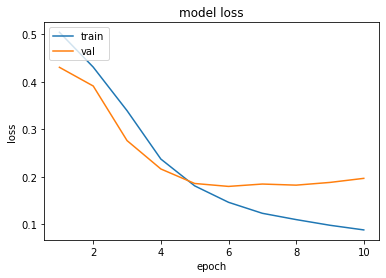

In [21]:
# 시각화
epochs = range(1, len(history.history['acc']) + 1)
plt.plot(epochs, history.history['loss'])
plt.plot(epochs, history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [22]:
model_result1 = model_FT.wv.most_similar("..")
print(model_result1)

[('예상', 0.21608756482601166), ('원', 0.20601990818977356), ('며', 0.20489303767681122), ('재', 0.20476073026657104), ('보고', 0.1930733025074005), ('갑자기', 0.19113248586654663), ('칭찬', 0.18357959389686584), ('살', 0.1788511723279953), ('강요', 0.1767072081565857), ('재촉', 0.17611657083034515)]


In [23]:
print(type(model_result1))
print(type(model_result1[0]))
print(model_result1[0])
word, _ = model_result1[0]
print(word)

<class 'list'>
<class 'tuple'>
('예상', 0.21608756482601166)
예상


In [24]:
import numpy as np

sample = ["요즘 심장이 뛰고, 기분이 좋아"]
sample.append("오늘 엄마가 나한테 욕을 했어")
sample.append("큰 주제 4개 중에 지금 2개 했는데 페이지가 50페이지가 넘어가는데 뒤에 어떻게하지")
sample.append("새아빠가 맛있는 걸 사줬네")
sample.append(A[1])
sample.append(A[0])
sample.append(A[4])
sample.append(A[14])
sample.append(A[23])
sample.append(A[35])
sample.append(A[42])
sample.append(A[74])

tagged_list=[]
for i in range(len(sample)):
    tagged= mecab.pos(sample[i])
    tagged_list.append(tagged)

removed_list=[]
tag_list=[]

for i in range(len(tagged_list)):
    for j in range(len(tagged_list[i])):
        tag, pos = tagged_list[i][j]
        tag_list.append(tag)
        
    removed_list.append(tag_list)
    tag_list=[]

samplelist = []
templist=[]
for i in range(len(removed_list)):
    for word in removed_list[i]:
        if word not in word_to_index: # OOV를 가장 유사한 단어로 대체해서 정수 인코딩
            similars = model_FT.wv.most_similar(word)
            word, _ = similars[0]
        templist.append(word_to_index[word])
        
    samplelist.append(templist)
    templist=[]
    
#print(samplelist)
padded_list=[]
for i in range(len(samplelist)):
    samplearray = np.array([samplelist[i]])
    samplepadded = pad_sequences(samplearray, maxlen=50)
    padded_list.append(samplepadded)
#print(padded_list)

print(tokenizer.word_index)
#print(model.predict(test))
for i in range(len(padded_list)):
    print('result about "{0}" : {1}' .format(sample[i], model.predict(padded_list[i])))


X_sample = pad_sequences(encoded_sentences[40870:40875])
y_sample = onehot_BigT[40870:40875]

A = loaded_data['사람문장2']
print(encoded_sentences[40870])
print()

for i in range(len(X_sample)):
    print('result about "{0}" : {1}\t정답 : {2}' .format(raw_input[i+40870], model.predict(np.array([X_sample[i]])), y_sample[i]))

{'싫음': 0, '기쁨': 1}
result about "요즘 심장이 뛰고, 기분이 좋아" : [[0.76952744 0.19039783]]
result about "오늘 엄마가 나한테 욕을 했어" : [[0.9896038  0.01134896]]
result about "큰 주제 4개 중에 지금 2개 했는데 페이지가 50페이지가 넘어가는데 뒤에 어떻게하지" : [[0.99487627 0.00661451]]
result about "새아빠가 맛있는 걸 사줬네" : [[0.31393918 0.628816  ]]
result about "건강할 때 관리 좀 잘할걸 하는 생각이 들더라고." : [[0.33594817 0.6124997 ]]
result about "아 지금 정말 신이 나." : [[0.04069453 0.94155645]]
result about "빚도 다 갚았으니 당분간은 아무 생각도 안 하며 살고 싶어." : [[0.99510336 0.00624701]]
result about "살아서도 아주 예뻐하던 손자들인데 꼭 보고 싶다고 하니 마음에 걸렸는데 다행이야." : [[0.04362473 0.94195634]]
result about "로또를 준 친구에게 일정 부분 나눠주고 나머지는 저축하려고해." : [[0.62670875 0.34200072]]
result about "사실 내가 열심히 공부한 것을 부모님께서 아셨나 봐. 결과보다는 과정이 중요하다고 하셨어." : [[0.93820006 0.06142268]]
result about "그 친구가 고백해서 사귀기로 했어. 이제 나도 커플이라 기뻐." : [[0.02033699 0.9681556 ]]
result about "응. 빨리 켜 보고 싶어" : [[0.9896904  0.01199532]]
[16, 3, 150, 9, 109, 2711, 5, 556, 57, 131, 1, 967, 217, 72, 452, 422, 564, 123, 64, 33, 57, 13, 123, 73, 3, 2

In [25]:
print(samplelist[2])

inv_map = {v: k for k, v in word_to_index.items()}

llll = []
for num in samplelist[2]:
    llll.append(inv_map[num])
    
print(llll)

[208, 2922, 268, 1196, 183, 8, 143, 108, 1196, 21, 13, 6995, 3, 878, 6995, 3, 1746, 13, 454, 8, 148, 6, 22]
['큰', '주제', '운동', '개', '중', '에', '지금', '불안', '개', '했', '는데', '페이', '가', '걸리', '페이', '가', '넘어가', '는데', '뒤', '에', '어떻게', '하', '지']


In [26]:
print(samplelist[3])

llll = []
for num in samplelist[3]:
    llll.append(inv_map[num])
    
print(llll)

[159, 3, 1302, 7, 129, 138, 201, 38]
['아빠', '가', '맛있', '는', '걸', '사', '줬', '네']


위에 보면 "4", "2", "페이지", "50" 이라는 단어가 없지만 가장 유사한 단어로 대체하여 정수 인코딩을 하여 문장을 구성하였다. 물론 위의 예시는 유사한 단어로 변환하지 못했지만 단어사전의 개수가 많고, 훈련 데이터가 방대하다면 좋은 결과를 낼 수 있지 않을까 기대한다.

In [27]:
model_result1 = model_FT.wv.most_similar("4")
print(model_result1)
model_result1 = model_FT.wv.most_similar("2")
print(model_result1)
model_result1 = model_FT.wv.most_similar("페이지")
print(model_result1)
model_result1 = model_FT.wv.most_similar("새아빠")
print(model_result1)

[('운동', 0.23230203986167908), ('진학', 0.21799828112125397), ('배우', 0.19359396398067474), ('꾸', 0.1843709945678711), ('도록', 0.18139849603176117), ('들어오', 0.18093045055866241), ('어울리', 0.17931154370307922), ('아직', 0.17651426792144775), ('먹', 0.17574092745780945), ('연애', 0.17526094615459442)]
[('불안', 0.2897757291793823), ('입원', 0.24126741290092468), ('초조', 0.2368047684431076), ('달', 0.23450462520122528), ('두절', 0.2156704068183899), ('수술', 0.2148212194442749), ('길', 0.21444514393806458), ('헤어질까', 0.2067531943321228), ('달째', 0.20505237579345703), ('갈까', 0.2000051587820053)]
[('페이', 0.9829546809196472), ('라이드', 0.9811785221099854), ('흔들거려', 0.9796357750892639), ('부쳐져', 0.9783858060836792), ('시니어', 0.9779066443443298), ('건축주', 0.9764745831489563), ('쌍방', 0.975399374961853), ('뽐냈', 0.9751263856887817), ('화면', 0.9748027920722961), ('주재료', 0.9741999506950378)]
[('아빠', 0.9972373247146606), ('엄마', 0.8753243684768677), ('누나', 0.802870512008667), ('오빠', 0.7745485901832581), ('새엄마', 0.7678338289260864

# OOV 방지를 위해 BPE 이용

서브워드 분리(Subword segmenation) 작업은 하나의 단어는 더 작은 단위의 의미있는 여러 서브워드들(Ex: birthplace = birth + place)의 조합으로 구성된 경우가 많기 때문에, 하나의 단어를 여러 서브워드로 분리해서 단어를 인코딩 및 임베딩하겠다는 의도를 가진다. 이는 OOV나 희귀 단어, 신조어와 같은 문제를 완화시킬 수 있다.

In [28]:
newkeys_list = []
chars = ""
keys = list(vocab.keys())
values = list(vocab.values())

for key in keys:
    for char in key:
        chars += char + " "
        
    chars += "</w>"
    newkeys_list.append(chars)
    
    chars = ""
    
print(newkeys_list)

['아 내 </w>', '가 </w>', '드 디 어 </w>', '출 산 </w>', '하 </w>', '게 </w>', '되 </w>', '어 서 </w>', '정 말 </w>', '신 </w>', '이 </w>', '나 </w>', '. </w>', '당 뇨 </w>', '랑 </w>', '합 병 증 </w>', '때 문 </w>', '에 </w>', '먹 </w>', '어 야 </w>', '할 </w>', '약 </w>', '열 </w>', '가 지 </w>', '넘 어 가 </w>', '니 까 </w>', '스 트 레 스 </w>', '야 </w>', '고 등 학 교 </w>', '올 라 오 </w>', '니 </w>', '중 학 교 </w>', '때 </w>', '보 다 </w>', '수 업 </w>', '갑 자 기 </w>', '어 려 워 져 서 </w>', '당 황 </w>', '스 러 워 </w>', '재 취 업 </w>', '돼 서 </w>', '받 </w>', '된 </w>', '첫 </w>', '월 급 </w>', '으 로 </w>', '온 </w>', '가 족 </w>', '외 식 </w>', '을 </w>', '예 정 </w>', '너 무 </w>', '행 복 </w>', '해 </w>', '빚 </w>', '다 </w>', '갚 </w>', '이 제 야 </w>', '안 도 감 </w>', '들 </w>', '어 </w>', '이 제 </w>', '곧 </w>', '은 퇴 </w>', '시 기 </w>', '었 </w>', '내 </w>', '먼 저 </w>', '를 </w>', '고 </w>', '육 </w>', '개 월 </w>', '후 </w>', '남 편 </w>', '도 </w>', '그 러 면 </w>', '둘 </w>', '하 루 </w>', '종 일 </w>', '함 께 </w>', '있 </w>', '겠 </w>', '네 </w>', '생 각 </w>', '만 </w>', '해 도 </w>', '숨 </w>', '막 

In [29]:
print(len(newkeys_list))
print(len(values))

new_dict = {}

for i in range(len(newkeys_list)):
    new_dict[newkeys_list[i]] = values[i]
    
print(new_dict)

12415
12415
{'아 내 </w>': 1726, '가 </w>': 20130, '드 디 어 </w>': 315, '출 산 </w>': 223, '하 </w>': 15036, '게 </w>': 5519, '되 </w>': 2627, '어 서 </w>': 2566, '정 말 </w>': 1887, '신 </w>': 264, '이 </w>': 27837, '나 </w>': 12823, '. </w>': 49180, '당 뇨 </w>': 181, '랑 </w>': 1011, '합 병 증 </w>': 46, '때 문 </w>': 1704, '에 </w>': 13035, '먹 </w>': 1023, '어 야 </w>': 194, '할 </w>': 1836, '약 </w>': 215, '열 </w>': 138, '가 지 </w>': 206, '넘 어 가 </w>': 24, '니 까 </w>': 593, '스 트 레 스 </w>': 632, '야 </w>': 4245, '고 등 학 교 </w>': 109, '올 라 오 </w>': 11, '니 </w>': 1535, '중 학 교 </w>': 31, '때 </w>': 1381, '보 다 </w>': 770, '수 업 </w>': 101, '갑 자 기 </w>': 688, '어 려 워 져 서 </w>': 20, '당 황 </w>': 1069, '스 러 워 </w>': 1747, '재 취 업 </w>': 24, '돼 서 </w>': 380, '받 </w>': 2665, '된 </w>': 537, '첫 </w>': 95, '월 급 </w>': 116, '으 로 </w>': 2163, '온 </w>': 186, '가 족 </w>': 951, '외 식 </w>': 42, '을 </w>': 16959, '예 정 </w>': 34, '너 무 </w>': 7989, '행 복 </w>': 259, '해 </w>': 6818, '빚 </w>': 108, '다 </w>': 2493, '갚 </w>': 154, '이 제 야 </w>': 47

In [30]:
def get_stats(dictionary):
    # 유니그램의 pair들의 빈도수를 카운트
    pairs = collections.defaultdict(int)
    for word, freq in dictionary.items():
        symbols = word.split()
        for i in range(len(symbols)-1):
            pairs[symbols[i],symbols[i+1]] += freq
#     print('현재 pair들의 빈도수 :', dict(pairs))
    return pairs

def merge_dictionary(pair, v_in):
    v_out = {}
    bigram = re.escape(' '.join(pair))
    p = re.compile(r'(?<!\S)' + bigram + r'(?!\S)')
    for word in v_in:
        w_out = p.sub(''.join(pair), word)
        v_out[w_out] = v_in[word]
    return v_out

bpe_codes = {}
bpe_codes_reverse = {}


In [31]:
import re, collections
from IPython.display import display, Markdown, Latex

bpe_codes = {}
bpe_codes_reverse = {}
i = 0

while True:
    if i%1000==0:
        display(Markdown("### Iteration {}".format(i + 1)))
    pairs = get_stats(new_dict)
    if len(pairs)==0:
        print("Done!")
        break;
    best = max(pairs, key=pairs.get)
    new_dict = merge_dictionary(best, new_dict)

    bpe_codes[best] = i
    bpe_codes_reverse[best[0] + best[1]] = best
    i += 1
    
    #print("new merge: {}".format(best))
    #print("dictionary: {}".format(new_dict))

### Iteration 1

### Iteration 1001

### Iteration 2001

### Iteration 3001

### Iteration 4001

### Iteration 5001

### Iteration 6001

### Iteration 7001

### Iteration 8001

### Iteration 9001

### Iteration 10001

### Iteration 11001

### Iteration 12001

### Iteration 13001

### Iteration 14001

### Iteration 15001

Done!


In [32]:
def get_pairs(word):
    """Return set of symbol pairs in a word.
    Word is represented as a tuple of symbols (symbols being variable-length strings).
    """
    pairs = set()
    prev_char = word[0]
    for char in word[1:]:
        pairs.add((prev_char, char))
        prev_char = char
    return pairs


def encode(orig):
    """Encode word based on list of BPE merge operations, which are applied consecutively"""

    word = tuple(orig) + ('</w>',)
    display(Markdown("__word split into characters:__ <tt>{}</tt>".format(word)))

    pairs = get_pairs(word)    

    if not pairs:
        return orig

    iteration = 0
    while True:
        iteration += 1
        display(Markdown("__Iteration {}:__".format(iteration)))

        print("bigrams in the word: {}".format(pairs))
        bigram = min(pairs, key = lambda pair: bpe_codes.get(pair, float('inf')))
        print("candidate for merging: {}".format(bigram))
        if bigram not in bpe_codes:
            display(Markdown("__Candidate not in BPE merges, algorithm stops.__"))
            break
        first, second = bigram
        new_word = []
        i = 0
        while i < len(word):
            try:
                j = word.index(first, i)
                new_word.extend(word[i:j])
                i = j
            except:
                new_word.extend(word[i:])
                break

            if word[i] == first and i < len(word)-1 and word[i+1] == second:
                new_word.append(first+second)
                i += 2
            else:
                new_word.append(word[i])
                i += 1
        new_word = tuple(new_word)
        word = new_word
        print("word after merging: {}".format(word))
        if len(word) == 1:
            break
        else:
            pairs = get_pairs(word)

    # 특별 토큰인 </w>는 출력하지 않는다.
    if word[-1] == '</w>':
        word = word[:-1]
    elif word[-1].endswith('</w>'):
        word = word[:-1] + (word[-1].replace('</w>',''),)

    return word

In [33]:
sets = encode("지긋지긋해")
print(type(sets))

__word split into characters:__ <tt>('지', '긋', '지', '긋', '해', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('지', '긋'), ('해', '</w>'), ('긋', '지'), ('긋', '해')}
candidate for merging: ('해', '</w>')
word after merging: ('지', '긋', '지', '긋', '해</w>')


__Iteration 2:__

bigrams in the word: {('지', '긋'), ('긋', '지'), ('긋', '해</w>')}
candidate for merging: ('지', '긋')
word after merging: ('지긋', '지긋', '해</w>')


__Iteration 3:__

bigrams in the word: {('지긋', '해</w>'), ('지긋', '지긋')}
candidate for merging: ('지긋', '지긋')
word after merging: ('지긋지긋', '해</w>')


__Iteration 4:__

bigrams in the word: {('지긋지긋', '해</w>')}
candidate for merging: ('지긋지긋', '해</w>')


__Candidate not in BPE merges, algorithm stops.__

<class 'tuple'>


In [34]:
sample = ["요즘 심장이 뛰고, 기분이 좋아"]
sample.append("오늘 엄마가 나한테 욕을 했어")
sample.append("큰 주제 4개 중에 지금 2개 했는데 페이지가 50페이지가 넘어가는데 뒤에 어떻게하지")
sample.append("새아빠가 맛있는 걸 사줬네")
sample.append("엄마한테 미안해서 말하기 싫어. 나를 미워할까봐 무서워")
sample.append("나는 내가 괴롭지 아니할 지라도 항상 고개를 숙이고 다녀")
sample.append("뭔소리? 기아 대권도전하려면 아직 깜깜 멀었다 ㅡㅡ")
sample.append("얘는 또부상당한겨 ㅋ 부상안당한날이없구만")
sample.append("지난 해에 범죄로 확정된 건은 15건이고 미해결된게 1700여건이면 문제 심각한거같은데")
sample.append(A[1])
sample.append(A[0])
sample.append(A[4])
sample.append(A[14])
sample.append(A[23])
sample.append(A[35])
sample.append(A[42])
sample.append(A[74])

tagged_list=[]
for i in range(len(sample)):
    tagged= mecab.pos(sample[i])
    tagged_list.append(tagged)

removed_list=[]
tag_list=[]

for i in range(len(tagged_list)):
    for j in range(len(tagged_list[i])):
        tag, pos = tagged_list[i][j]
        tag_list.append(tag)
        
    removed_list.append(tag_list)
    tag_list=[]

samplelist = []
templist=[]
for i in range(len(removed_list)):
    for word in removed_list[i]:
        if word not in word_to_index: # OOV를 가장 유사한 단어로 대체해서 정수 인코딩
            similars = model_FT.wv.most_similar(word)
            tag, value = similars[0]
            if value < 0.8:  # 유사성이 심하게 낮을 때 BPE로 subword로 분리해버린 다음에 인코딩
                words = encode(word)
                for word in words:
                    if word in word_to_index:
                        templist.append(word_to_index[word])
                    
            else:
                templist.append(word_to_index[tag])
        
        else:        
            templist.append(word_to_index[word])
        
    samplelist.append(templist)
    templist=[]
    
#print(samplelist)
padded_list=[]
for i in range(len(samplelist)):
    samplearray = np.array([samplelist[i]])
    samplepadded = pad_sequences(samplearray, maxlen=50)
    padded_list.append(samplepadded)
#print(padded_list)

print(tokenizer.word_index)
#print(model.predict(test))
for i in range(len(padded_list)):
    print('result about "{0}" : {1}' .format(sample[i], model.predict(padded_list[i])))


X_sample = pad_sequences(encoded_sentences[40870:40875])
y_sample = onehot_BigT[40870:40875]

A = loaded_data['사람문장2']
print(encoded_sentences[40870])
print()

for i in range(len(X_sample)):
    print('result about "{0}" : {1}\t정답 : {2}' .format(raw_input[i+40870], model.predict(np.array([X_sample[i]])), y_sample[i]))

__word split into characters:__ <tt>('4', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('4', '</w>')}
candidate for merging: ('4', '</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('2', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('2', '</w>')}
candidate for merging: ('2', '</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('5', '0', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('0', '</w>'), ('5', '0')}
candidate for merging: ('0', '</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('기', '아', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('기', '아'), ('아', '</w>')}
candidate for merging: ('아', '</w>')
word after merging: ('기', '아</w>')


__Iteration 2:__

bigrams in the word: {('기', '아</w>')}
candidate for merging: ('기', '아</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('대', '권', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('권', '</w>'), ('대', '권')}
candidate for merging: ('권', '</w>')
word after merging: ('대', '권</w>')


__Iteration 2:__

bigrams in the word: {('대', '권</w>')}
candidate for merging: ('대', '권</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('ㅡ', 'ㅡ', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('ㅡ', '</w>'), ('ㅡ', 'ㅡ')}
candidate for merging: ('ㅡ', '</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('한', '겨', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('한', '겨'), ('겨', '</w>')}
candidate for merging: ('겨', '</w>')
word after merging: ('한', '겨</w>')


__Iteration 2:__

bigrams in the word: {('한', '겨</w>')}
candidate for merging: ('한', '겨</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('ㅋ', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('ㅋ', '</w>')}
candidate for merging: ('ㅋ', '</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('1', '5', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('1', '5'), ('5', '</w>')}
candidate for merging: ('1', '5')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('1', '7', '0', '0', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('0', '</w>'), ('1', '7'), ('0', '0'), ('7', '0')}
candidate for merging: ('0', '</w>')


__Candidate not in BPE merges, algorithm stops.__

{'싫음': 0, '기쁨': 1}
result about "요즘 심장이 뛰고, 기분이 좋아" : [[0.76952744 0.19039783]]
result about "오늘 엄마가 나한테 욕을 했어" : [[0.9896038  0.01134896]]
result about "큰 주제 4개 중에 지금 2개 했는데 페이지가 50페이지가 넘어가는데 뒤에 어떻게하지" : [[0.99436057 0.00719497]]
result about "새아빠가 맛있는 걸 사줬네" : [[0.31393918 0.628816  ]]
result about "엄마한테 미안해서 말하기 싫어. 나를 미워할까봐 무서워" : [[0.99753785 0.00354806]]
result about "나는 내가 괴롭지 아니할 지라도 항상 고개를 숙이고 다녀" : [[0.9936775  0.00817662]]
result about "뭔소리? 기아 대권도전하려면 아직 깜깜 멀었다 ㅡㅡ" : [[0.9634536  0.03856242]]
result about "얘는 또부상당한겨 ㅋ 부상안당한날이없구만" : [[0.9878001  0.01371562]]
result about "지난 해에 범죄로 확정된 건은 15건이고 미해결된게 1700여건이면 문제 심각한거같은데" : [[0.9947578  0.00681719]]
result about "건강할 때 관리 좀 잘할걸 하는 생각이 들더라고." : [[0.33594817 0.6124997 ]]
result about "아 지금 정말 신이 나." : [[0.04069453 0.94155645]]
result about "빚도 다 갚았으니 당분간은 아무 생각도 안 하며 살고 싶어." : [[0.99510336 0.00624701]]
result about "살아서도 아주 예뻐하던 손자들인데 꼭 보고 싶다고 하니 마음에 걸렸는데 다행이야." : [[0.04362473 0.94195634]]
result about "로또를 준 친구에게 일정 부분 나눠주고 나머

In [35]:
print(samplelist[2])

inv_map = {v: k for k, v in word_to_index.items()}

llll = []
for num in samplelist[2]:
    llll.append(inv_map[num])
    
print(llll)

[208, 2922, 1196, 183, 8, 143, 1196, 21, 13, 6995, 3, 6995, 3, 1746, 13, 454, 8, 148, 6, 22]
['큰', '주제', '개', '중', '에', '지금', '개', '했', '는데', '페이', '가', '페이', '가', '넘어가', '는데', '뒤', '에', '어떻게', '하', '지']


In [36]:
print(samplelist[3])

llll = []
for num in samplelist[3]:
    llll.append(inv_map[num])
    
print(llll)

print(llll)

print(samplelist[4])

llll = []
for num in samplelist[4]:
    llll.append(inv_map[num])
    
print(llll)

print(samplelist[5])

llll = []
for num in samplelist[5]:
    llll.append(inv_map[num])
    
print(llll)

print(samplelist[6])

llll = []
for num in samplelist[6]:
    llll.append(inv_map[num])
    
print(llll)

print(samplelist[7])

llll = []
for num in samplelist[7]:
    llll.append(inv_map[num])
    
print(llll)

print(samplelist[8])

llll = []
for num in samplelist[8]:
    llll.append(inv_map[num])
    
print(llll)

[159, 3, 1302, 7, 129, 138, 201, 38]
['아빠', '가', '맛있', '는', '걸', '사', '줬', '네']
['아빠', '가', '맛있', '는', '걸', '사', '줬', '네']
[102, 75, 317, 35, 52, 6, 51, 140, 4, 1, 9, 11, 1217, 3829, 466]
['엄마', '한테', '미안', '해서', '말', '하', '기', '싫', '어', '.', '나', '를', '미워', '할까봐', '무서워']
[9, 7, 14, 3, 1067, 22, 231, 12396, 19, 219, 5683, 11, 7541, 10, 1379]
['나', '는', '내', '가', '괴롭', '지', '아니', '들이닥치', '도', '항상', '고개', '를', '숙이', '고', '다녀']
[11438, 445, 77, 51, 17, 131, 1779, 19, 4906, 1038, 163, 2522, 678, 32, 42]
['뭔', '소리', '?', '기', '아', '대', '권', '도', '전하', '려면', '아직', '깜깜', '멀', '었', '다']
[1926, 7, 252, 1686, 10348, 30, 7695, 3502, 31, 486, 127, 2, 29, 6889]
['얘', '는', '또', '부', '상당', '한', '겨', '부상', '안', '당한', '날', '이', '없', '구만']
[1230, 18, 8, 3712, 53, 4211, 188, 345, 23, 345, 2, 10, 10504, 188, 24, 894, 345, 2, 64, 232, 1374, 30, 63, 26, 158]
['지난', '해', '에', '범죄', '로', '확정', '된', '건', '은', '건', '이', '고', '하루살이', '된', '게', '여', '건', '이', '면', '문제', '심각', '한', '거', '같', '은데']


In [37]:
sample = ["요즘 심장이 뛰고, 기분이 좋아"]
sample.append("오늘 엄마가 나한테 욕을 했어")
sample.append("큰 주제 4개 중에 지금 2개 했는데 페이지가 50페이지가 넘어가는데 뒤에 어떻게하지")
sample.append("새아빠가 맛있는 걸 사줬네")
sample.append("엄마한테 미안해서 말하기 싫어. 나를 미워할까봐 무서워")
sample.append("나는 내가 괴롭지 아니할 지라도 항상 고개를 숙이고 다녀")
sample.append("뭔소리? 기아 대권도전하려면 아직 깜깜 멀었다 ㅡㅡ")
sample.append("얘는 또부상당한겨 ㅋ 부상안당한날이없구만")
sample.append("지난 해에 범죄로 확정된 건은 15건이고 미해결된게 1700여건이면 문제 심각한거같은데")
sample.append(A[1])
sample.append(A[0])
sample.append(A[4])
sample.append(A[14])
sample.append(A[23])
sample.append(A[35])
sample.append(A[42])
sample.append(A[74])

tagged_list=[]
for i in range(len(sample)):
    tagged= mecab.pos(sample[i])
    tagged_list.append(tagged)

removed_list=[]
tag_list=[]

for i in range(len(tagged_list)):
    for j in range(len(tagged_list[i])):
        tag, pos = tagged_list[i][j]
        tag_list.append(tag)
        
    removed_list.append(tag_list)
    tag_list=[]

samplelist = []
templist=[]
for i in range(len(removed_list)):
    for word in removed_list[i]:
        if word not in word_to_index:
            words = encode(word)
            for tag in words:
                if tag in word_to_index:
                    templist.append(word_to_index[tag])
                    
        else:        
            templist.append(word_to_index[word])
        
    samplelist.append(templist)
    templist=[]
    
#print(samplelist)
padded_list=[]
for i in range(len(samplelist)):
    samplearray = np.array([samplelist[i]])
    samplepadded = pad_sequences(samplearray, maxlen=50)
    padded_list.append(samplepadded)
#print(padded_list)

print(tokenizer.word_index)
#print(model.predict(test))
for i in range(len(padded_list)):
    print('result about "{0}" : {1}' .format(sample[i], model.predict(padded_list[i])))


X_sample = pad_sequences(encoded_sentences[40870:40875])
y_sample = onehot_BigT[40870:40875]

A = loaded_data['사람문장2']
print(encoded_sentences[40870])
print()

for i in range(len(X_sample)):
    print('result about "{0}" : {1}\t정답 : {2}' .format(raw_input[i+40870], model.predict(np.array([X_sample[i]])), y_sample[i]))

__word split into characters:__ <tt>('4', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('4', '</w>')}
candidate for merging: ('4', '</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('2', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('2', '</w>')}
candidate for merging: ('2', '</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('페', '이', '지', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('지', '</w>'), ('페', '이'), ('이', '지')}
candidate for merging: ('지', '</w>')
word after merging: ('페', '이', '지</w>')


__Iteration 2:__

bigrams in the word: {('페', '이'), ('이', '지</w>')}
candidate for merging: ('페', '이')
word after merging: ('페이', '지</w>')


__Iteration 3:__

bigrams in the word: {('페이', '지</w>')}
candidate for merging: ('페이', '지</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('5', '0', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('0', '</w>'), ('5', '0')}
candidate for merging: ('0', '</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('페', '이', '지', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('지', '</w>'), ('페', '이'), ('이', '지')}
candidate for merging: ('지', '</w>')
word after merging: ('페', '이', '지</w>')


__Iteration 2:__

bigrams in the word: {('페', '이'), ('이', '지</w>')}
candidate for merging: ('페', '이')
word after merging: ('페이', '지</w>')


__Iteration 3:__

bigrams in the word: {('페이', '지</w>')}
candidate for merging: ('페이', '지</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('새', '아', '빠', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('아', '빠'), ('빠', '</w>'), ('새', '아')}
candidate for merging: ('빠', '</w>')
word after merging: ('새', '아', '빠</w>')


__Iteration 2:__

bigrams in the word: {('아', '빠</w>'), ('새', '아')}
candidate for merging: ('아', '빠</w>')
word after merging: ('새', '아빠</w>')


__Iteration 3:__

bigrams in the word: {('새', '아빠</w>')}
candidate for merging: ('새', '아빠</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('아', '니', '할', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('할', '</w>'), ('니', '할'), ('아', '니')}
candidate for merging: ('할', '</w>')
word after merging: ('아', '니', '할</w>')


__Iteration 2:__

bigrams in the word: {('아', '니'), ('니', '할</w>')}
candidate for merging: ('아', '니')
word after merging: ('아니', '할</w>')


__Iteration 3:__

bigrams in the word: {('아니', '할</w>')}
candidate for merging: ('아니', '할</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('지', '라', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('지', '라'), ('라', '</w>')}
candidate for merging: ('라', '</w>')
word after merging: ('지', '라</w>')


__Iteration 2:__

bigrams in the word: {('지', '라</w>')}
candidate for merging: ('지', '라</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('기', '아', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('기', '아'), ('아', '</w>')}
candidate for merging: ('아', '</w>')
word after merging: ('기', '아</w>')


__Iteration 2:__

bigrams in the word: {('기', '아</w>')}
candidate for merging: ('기', '아</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('대', '권', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('권', '</w>'), ('대', '권')}
candidate for merging: ('권', '</w>')
word after merging: ('대', '권</w>')


__Iteration 2:__

bigrams in the word: {('대', '권</w>')}
candidate for merging: ('대', '권</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('ㅡ', 'ㅡ', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('ㅡ', '</w>'), ('ㅡ', 'ㅡ')}
candidate for merging: ('ㅡ', '</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('한', '겨', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('한', '겨'), ('겨', '</w>')}
candidate for merging: ('겨', '</w>')
word after merging: ('한', '겨</w>')


__Iteration 2:__

bigrams in the word: {('한', '겨</w>')}
candidate for merging: ('한', '겨</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('ㅋ', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('ㅋ', '</w>')}
candidate for merging: ('ㅋ', '</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('1', '5', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('1', '5'), ('5', '</w>')}
candidate for merging: ('1', '5')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('미', '해', '결', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('해', '결'), ('결', '</w>'), ('미', '해')}
candidate for merging: ('결', '</w>')
word after merging: ('미', '해', '결</w>')


__Iteration 2:__

bigrams in the word: {('미', '해'), ('해', '결</w>')}
candidate for merging: ('해', '결</w>')
word after merging: ('미', '해결</w>')


__Iteration 3:__

bigrams in the word: {('미', '해결</w>')}
candidate for merging: ('미', '해결</w>')


__Candidate not in BPE merges, algorithm stops.__

__word split into characters:__ <tt>('1', '7', '0', '0', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('0', '</w>'), ('1', '7'), ('0', '0'), ('7', '0')}
candidate for merging: ('0', '</w>')


__Candidate not in BPE merges, algorithm stops.__

{'싫음': 0, '기쁨': 1}
result about "요즘 심장이 뛰고, 기분이 좋아" : [[0.76952744 0.19039783]]
result about "오늘 엄마가 나한테 욕을 했어" : [[0.9896038  0.01134896]]
result about "큰 주제 4개 중에 지금 2개 했는데 페이지가 50페이지가 넘어가는데 뒤에 어떻게하지" : [[0.9943868  0.00714219]]
result about "새아빠가 맛있는 걸 사줬네" : [[0.28556287 0.6574594 ]]
result about "엄마한테 미안해서 말하기 싫어. 나를 미워할까봐 무서워" : [[0.99753785 0.00354806]]
result about "나는 내가 괴롭지 아니할 지라도 항상 고개를 숙이고 다녀" : [[0.9929129  0.00911459]]
result about "뭔소리? 기아 대권도전하려면 아직 깜깜 멀었다 ㅡㅡ" : [[0.9634536  0.03856242]]
result about "얘는 또부상당한겨 ㅋ 부상안당한날이없구만" : [[0.9878001  0.01371562]]
result about "지난 해에 범죄로 확정된 건은 15건이고 미해결된게 1700여건이면 문제 심각한거같은데" : [[0.9889765  0.01334545]]
result about "건강할 때 관리 좀 잘할걸 하는 생각이 들더라고." : [[0.33594817 0.6124997 ]]
result about "아 지금 정말 신이 나." : [[0.04069453 0.94155645]]
result about "빚도 다 갚았으니 당분간은 아무 생각도 안 하며 살고 싶어." : [[0.99510336 0.00624701]]
result about "살아서도 아주 예뻐하던 손자들인데 꼭 보고 싶다고 하니 마음에 걸렸는데 다행이야." : [[0.04362473 0.94195634]]
result about "로또를 준 친구에게 일정 부분 나눠주고 나머

In [38]:
print(samplelist[2])

inv_map = {v: k for k, v in word_to_index.items()}

llll = []
for num in samplelist[2]:
    llll.append(inv_map[num])
    
print(llll)
print(samplelist[3])

llll = []
for num in samplelist[3]:
    llll.append(inv_map[num])
    
print(llll)

print(samplelist[4])

llll = []
for num in samplelist[4]:
    llll.append(inv_map[num])
    
print(llll)

print(samplelist[5])

llll = []
for num in samplelist[5]:
    llll.append(inv_map[num])
    
print(llll)

print(samplelist[6])

llll = []
for num in samplelist[6]:
    llll.append(inv_map[num])
    
print(llll)

print(samplelist[7])

llll = []
for num in samplelist[7]:
    llll.append(inv_map[num])
    
print(llll)

print(samplelist[8])

llll = []
for num in samplelist[8]:
    llll.append(inv_map[num])
    
print(llll)

[208, 2922, 1196, 183, 8, 143, 1196, 21, 13, 6995, 22, 3, 6995, 22, 3, 1746, 13, 454, 8, 148, 6, 22]
['큰', '주제', '개', '중', '에', '지금', '개', '했', '는데', '페이', '지', '가', '페이', '지', '가', '넘어가', '는데', '뒤', '에', '어떻게', '하', '지']
[841, 159, 3, 1302, 7, 129, 138, 201, 38]
['새', '아빠', '가', '맛있', '는', '걸', '사', '줬', '네']
[102, 75, 317, 35, 52, 6, 51, 140, 4, 1, 9, 11, 1217, 3829, 466]
['엄마', '한테', '미안', '해서', '말', '하', '기', '싫', '어', '.', '나', '를', '미워', '할까봐', '무서워']
[9, 7, 14, 3, 1067, 22, 231, 62, 22, 175, 19, 219, 5683, 11, 7541, 10, 1379]
['나', '는', '내', '가', '괴롭', '지', '아니', '할', '지', '라', '도', '항상', '고개', '를', '숙이', '고', '다녀']
[11438, 445, 77, 51, 17, 131, 1779, 19, 4906, 1038, 163, 2522, 678, 32, 42]
['뭔', '소리', '?', '기', '아', '대', '권', '도', '전하', '려면', '아직', '깜깜', '멀', '었', '다']
[1926, 7, 252, 1686, 10348, 30, 7695, 3502, 31, 486, 127, 2, 29, 6889]
['얘', '는', '또', '부', '상당', '한', '겨', '부상', '안', '당한', '날', '이', '없', '구만']
[1230, 18, 8, 3712, 53, 4211, 188, 345, 23, 345, 2, 10, 4380, 795,

In [39]:
print(bpe_codes)

{('.', '</w>'): 0, ('이', '</w>'): 1, ('가', '</w>'): 2, ('서', '</w>'): 3, ('어', '</w>'): 4, ('고', '</w>'): 5, ('하', '</w>'): 6, ('을', '</w>'): 7, ('는', '</w>'): 8, ('나', '</w>'): 9, ('에', '</w>'): 10, ('데', '</w>'): 11, ('들', '</w>'): 12, ('내', '</w>'): 13, ('를', '</w>'): 14, ('지', '</w>'): 15, ('게', '</w>'): 16, ('무', '</w>'): 17, ('해', '</w>'): 18, ('는', '데</w>'): 19, ('도', '</w>'): 20, ('너', '무</w>'): 21, ('구', '</w>'): 22, ('친', '구</w>'): 23, ('아', '</w>'): 24, ('했', '</w>'): 25, ('있', '</w>'): 26, ('야', '</w>'): 27, ('기', '</w>'): 28, ('로', '</w>'): 29, ('은', '</w>'): 30, ('안', '</w>'): 31, ('사', '</w>'): 32, ('리', '</w>'): 33, ('것', '</w>'): 34, ('한', '</w>'): 35, ('니', '</w>'): 36, ('같', '</w>'): 37, ('일', '</w>'): 38, ('말', '</w>'): 39, ('에', '서</w>'): 40, ('다', '</w>'): 41, ('없', '</w>'): 42, ('만', '</w>'): 43, ('자', '</w>'): 44, ('해', '서</w>'): 45, ('워', '</w>'): 46, ('었', '</w>'): 47, ('좋', '</w>'): 48, ('않', '</w>'): 49, ('정', '</w>'): 50, ('장', '</w>'): 51, ('원', '</w>'): 5

In [42]:
vocab["월드컵"]

1

In [43]:
bpe_codes[('내팽개쳐', '진</w>')]

15143

In [44]:
encode("내팽개쳐진")

__word split into characters:__ <tt>('내', '팽', '개', '쳐', '진', '</w>')</tt>

__Iteration 1:__

bigrams in the word: {('내', '팽'), ('쳐', '진'), ('진', '</w>'), ('팽', '개'), ('개', '쳐')}
candidate for merging: ('진', '</w>')
word after merging: ('내', '팽', '개', '쳐', '진</w>')


__Iteration 2:__

bigrams in the word: {('개', '쳐'), ('내', '팽'), ('팽', '개'), ('쳐', '진</w>')}
candidate for merging: ('내', '팽')
word after merging: ('내팽', '개', '쳐', '진</w>')


__Iteration 3:__

bigrams in the word: {('개', '쳐'), ('내팽', '개'), ('쳐', '진</w>')}
candidate for merging: ('내팽', '개')
word after merging: ('내팽개', '쳐', '진</w>')


__Iteration 4:__

bigrams in the word: {('쳐', '진</w>'), ('내팽개', '쳐')}
candidate for merging: ('내팽개', '쳐')
word after merging: ('내팽개쳐', '진</w>')


__Iteration 5:__

bigrams in the word: {('내팽개쳐', '진</w>')}
candidate for merging: ('내팽개쳐', '진</w>')
word after merging: ('내팽개쳐진</w>',)


('내팽개쳐진',)

In [46]:
## bqe_codes dictionary save

import pickle

with open('Emotional_BQE_Dict.pickle', 'wb') as fw:
    pickle.dump(bpe_codes, fw)

## model save

model.save('Emo_class_model.h5')

In [47]:
with open('Emotional_BQE_Dict.pickle', 'rb') as fr:
    test_dict = pickle.load(fr)
    
print(test_dict)

{('.', '</w>'): 0, ('이', '</w>'): 1, ('가', '</w>'): 2, ('서', '</w>'): 3, ('어', '</w>'): 4, ('고', '</w>'): 5, ('하', '</w>'): 6, ('을', '</w>'): 7, ('는', '</w>'): 8, ('나', '</w>'): 9, ('에', '</w>'): 10, ('데', '</w>'): 11, ('들', '</w>'): 12, ('내', '</w>'): 13, ('를', '</w>'): 14, ('지', '</w>'): 15, ('게', '</w>'): 16, ('무', '</w>'): 17, ('해', '</w>'): 18, ('는', '데</w>'): 19, ('도', '</w>'): 20, ('너', '무</w>'): 21, ('구', '</w>'): 22, ('친', '구</w>'): 23, ('아', '</w>'): 24, ('했', '</w>'): 25, ('있', '</w>'): 26, ('야', '</w>'): 27, ('기', '</w>'): 28, ('로', '</w>'): 29, ('은', '</w>'): 30, ('안', '</w>'): 31, ('사', '</w>'): 32, ('리', '</w>'): 33, ('것', '</w>'): 34, ('한', '</w>'): 35, ('니', '</w>'): 36, ('같', '</w>'): 37, ('일', '</w>'): 38, ('말', '</w>'): 39, ('에', '서</w>'): 40, ('다', '</w>'): 41, ('없', '</w>'): 42, ('만', '</w>'): 43, ('자', '</w>'): 44, ('해', '서</w>'): 45, ('워', '</w>'): 46, ('었', '</w>'): 47, ('좋', '</w>'): 48, ('않', '</w>'): 49, ('정', '</w>'): 50, ('장', '</w>'): 51, ('원', '</w>'): 5

In [48]:
X_sample

array([[    0,     0,     0,    16,     3,   150,     9,   109,  2711,
            5,   556,    57,   131,     1,   967,   217,    72,   452,
          422,   564,   123,    64,    33,    57,    13,   123,    73,
            3,    29,     4,     1],
       [    0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,    96,   181,
            2,   374,     4,     1],
       [   49,  1542,    27, 12413,     5,     6,     7,   114,   334,
           23,  1547,    12,     2,  2357,     6,   987,    91,     2,
          658,     9,    19,  2357,     5,     6,   349,  2100,     5,
           39,    43,     4,     1],
       [    0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,  1376,  1035,     2,   321,    12,    45,     9,
           11,   234,    30,    44,    54,   272,    35,   348,     6,
           10,   236,    18,     1],


In [62]:
from tensorflow.keras.models import load_model

test_model = load_model('Emo_class_model.h5')
test_model.predict(np.array([X_sample[0]]))

array([[0.996202  , 0.00526732]], dtype=float32)

In [63]:
with open('Emotional_WordToIndex.pickle', 'wb') as fw:
    pickle.dump(word_to_index, fw)

In [64]:
model_FT.save('Emo_FT.model')